In [ ]:
# This variation uses cross valudation isntead of permutaions of the significance testing. No dimentionality reduction. Takes a long time to run.

'this notebook goes through the process of collecting data and etc '

In [6]:
import numpy as np
#from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
#from sklearn.preprocessing import StandardScaler
import scipy.stats as stats
import seaborn as sns
#from dataClasses import Trial,Neuron
from sklearn.feature_selection import RFECV
from sklearn import svm
from sklearn.model_selection import cross_validate, GridSearchCV, StratifiedKFold
from sklearn.metrics import confusion_matrix,classification_report
#import intertools 
# Import Libraries
import torch
import torch.nn as nn
from torch.autograd import Variable
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim

from imblearn.over_sampling import SMOTE
from sklearn.utils.class_weight import compute_class_weight

from imblearn.under_sampling import RandomUnderSampler
import pandas as pd
import boto3
import json
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score
from scipy import stats
import numpy as np
from sklearn.metrics import confusion_matrix
from imblearn.pipeline import Pipeline

In [2]:
s3 = boto3.client('s3') 
bucket_name = 'sussexwork'

In [3]:
class RNNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim):
        super(RNNModel, self).__init__()
        
        # Defining the RNN layer
        self.rnn = nn.RNN(input_dim, hidden_dim, layer_dim, batch_first=True)
        
        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)
    
    def forward(self, x):
        # x: (batch_size, seq_len, input_size)
        
        # RNN forward pass
        out, _ = self.rnn(x)
        
        # Use only the last time step's output
        out = out[:, -1]  # Take the output from the last sequence step
        
        # Fully connected layer
        out = self.fc(out)
        
        return out


In [4]:
def get_data_ready(brain_area, type_of_analysis):
    all_trials=np.load("processed_data/"+ brain_area + "_all_trials.npy",allow_pickle=True)
    trial_list=np.empty((all_trials.shape[0],3))
    trial_dff=np.empty((all_trials.shape[0],41)) 
    trial_licks=np.empty((all_trials.shape[0],41))
    # Here we get the data based on the conditions that we want (i.e: if it is is lick, or go) 
    
    for trial in range(all_trials.shape[0]):
        
        trial_list[trial,0]=all_trials[trial].neuron_num
    
        
        if type_of_analysis=="GO":
            # for labelling go nogo
            if (all_trials[trial].trial_type)=="go":
                trial_list[trial,1]=1
            elif (all_trials[trial].trial_type)=="nogo":
                trial_list[trial,1]=0
            else:
                print("gone wrong on neuron ",all_trials[trial].neuron_num )
        elif type_of_analysis=="LICK":    
            #for labelling lick nolick
            if (all_trials[trial].trial_outcome)=="FA":
                trial_list[trial,1]=1
            elif (all_trials[trial].trial_outcome)=="Hit":
                trial_list[trial,1]=1
            elif (all_trials[trial].trial_outcome)=="Miss":
                trial_list[trial,1]=0
            elif (all_trials[trial].trial_outcome)=="CR":
                trial_list[trial,1]=0
            else:
                print("gone wrong on neuron ",all_trials[trial].neuron_num )
        else:
            print("Type of analysis can only be 'GO' or 'LICK'")
        
        trial_list[trial,2]=all_trials[trial].mouse_id
        if (all_trials[trial].trial_outcome)=="FA" or (all_trials[trial].trial_outcome)=="Hit":
            trial_dff[trial,0:41]=all_trials[trial].dff 
            #rebase  dff 
            trial_licks[trial,:]=all_trials[trial].licks
            lick_start=np.argmax(trial_licks[trial,:]==1,axis=0)
            trial_dff_rel_licks=np.zeros(trial_licks.shape[1])
            new_start=lick_start-4
            if new_start>=0:                    
                # move the array of licks left so that timeseries starst at lick time
                trial_dff_rel_licks[0:trial_licks.shape[1]-new_start]=all_trials[trial].dff[new_start: ]
                ## need to mske the last few timesteps on the new series = final timestep on original series
                trial_dff_rel_licks[trial_licks.shape[1]-new_start :]=all_trials[trial].dff[-1]
            else: 
                # move the array of licks right so that timeseries starst at lick time
                trial_dff_rel_licks[0-new_start :]=all_trials[trial].dff[0:all_trials[trial].dff.shape[0]+new_start]
                ## need to mske the first few timesteps on the new series = first timestep on original series
                trial_dff_rel_licks[0:-new_start]=all_trials[trial].dff[ 0 ]
                #trial_dff[trial,41:82]=trial_dff_rel_licks
        else:
            trial_dff[trial,0:41]=all_trials[trial].dff 
            #trial_dff[trial,41:82]=all_trials[trial].dff
    return trial_list, trial_dff


Brain Area: S1, Analysis Type: GO
Num of neurons before filter= 289

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 65.62%, p-value = 0.0450


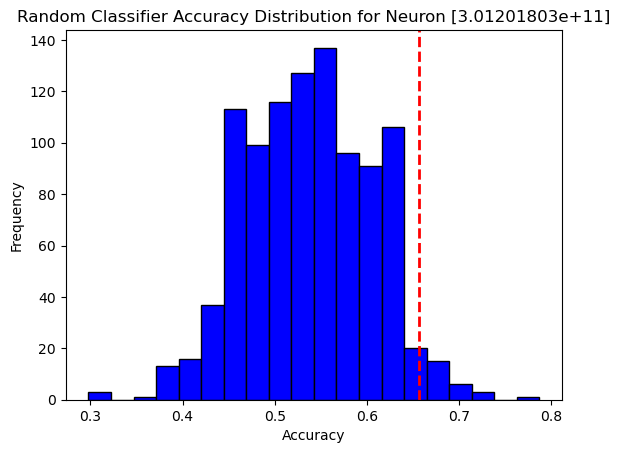

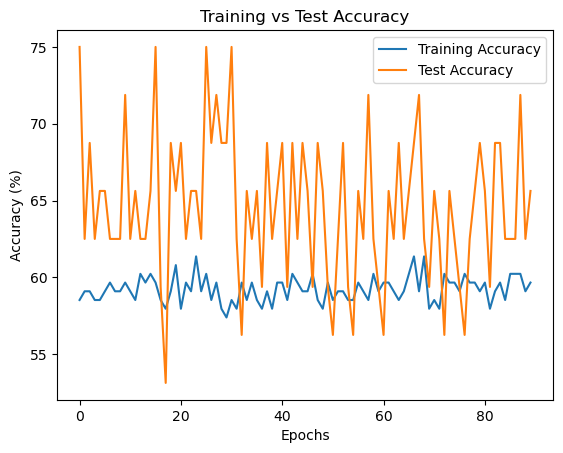

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 65.62%, p-value = 0.0610


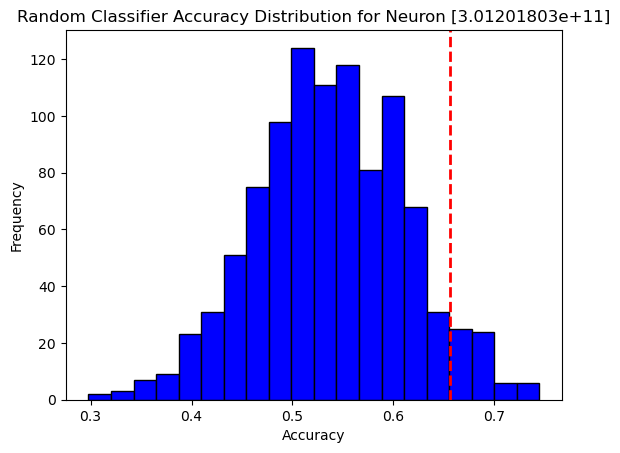

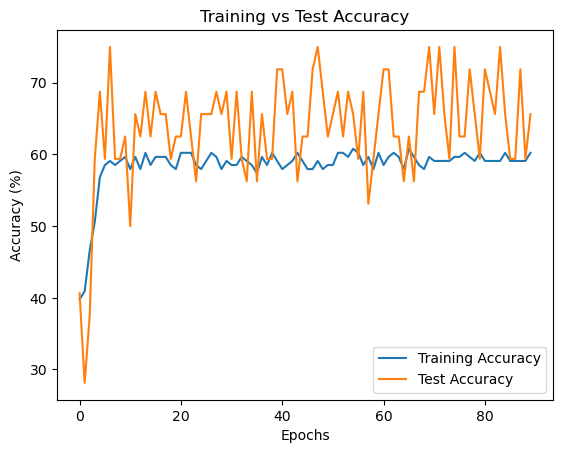

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 56.25%, p-value = 0.3480


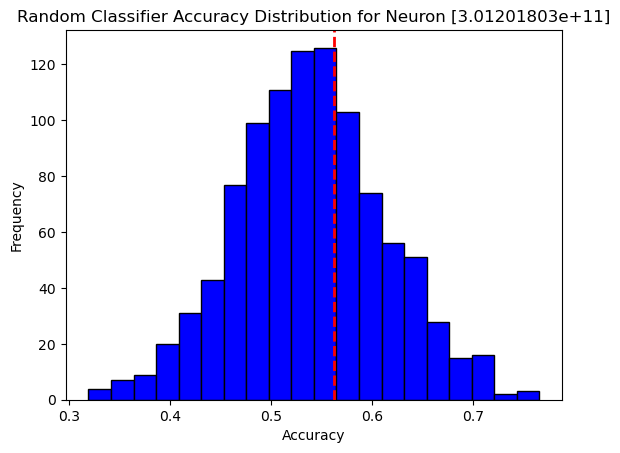

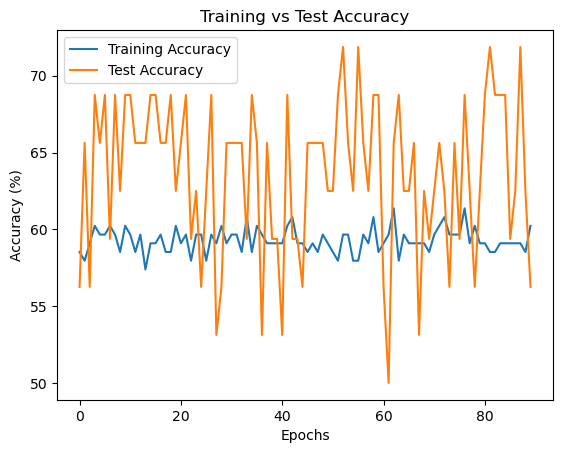

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 46.88%, p-value = 0.7940


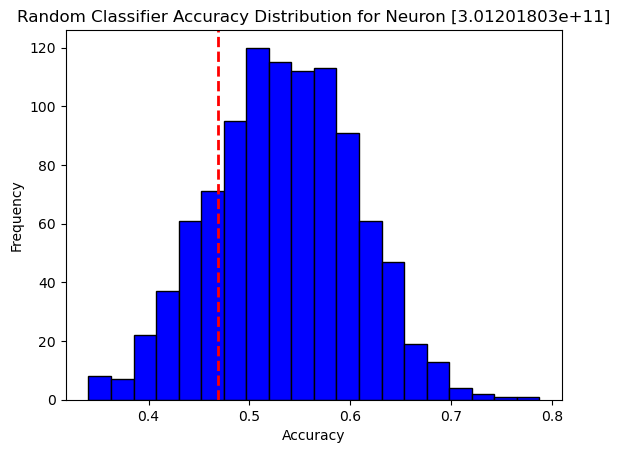

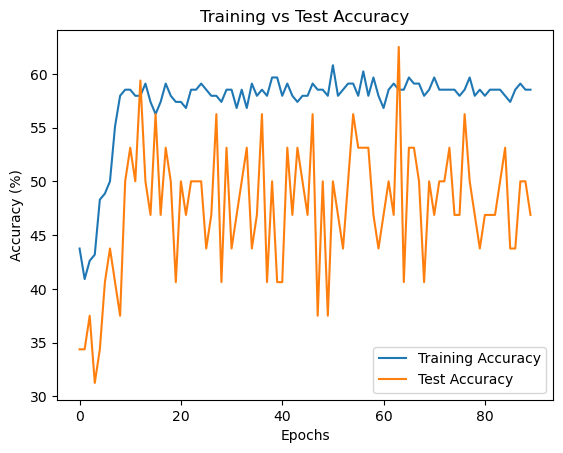

Confusion Matrix:
 [[20 10]
 [14  3]]
Class-specific Accuracy: [0.66666667 0.17647059]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 62.50%, p-value = 0.3950


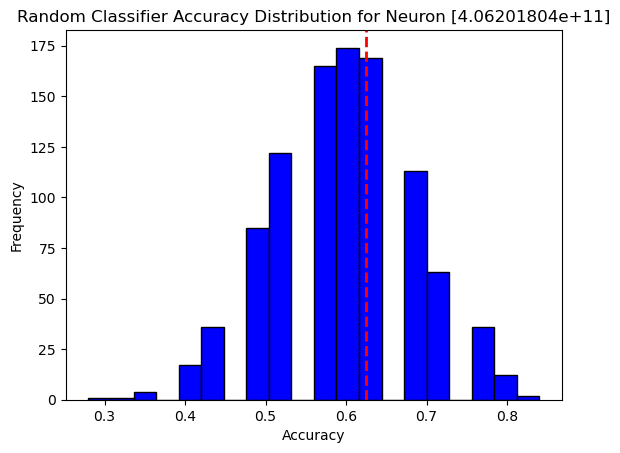

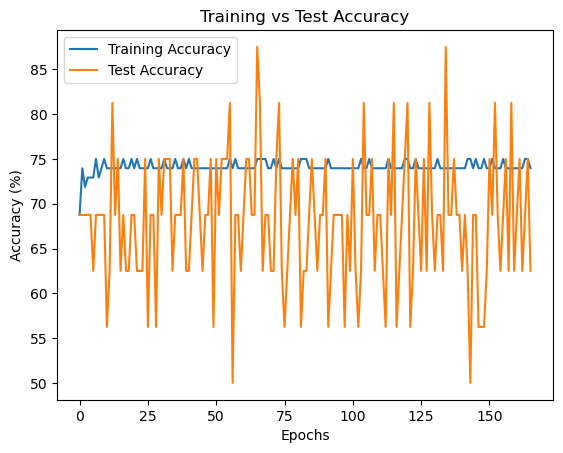

Confusion Matrix:
 [[ 0  7]
 [ 1 17]]
Class-specific Accuracy: [0.         0.94444444]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 62.50%, p-value = 0.4270


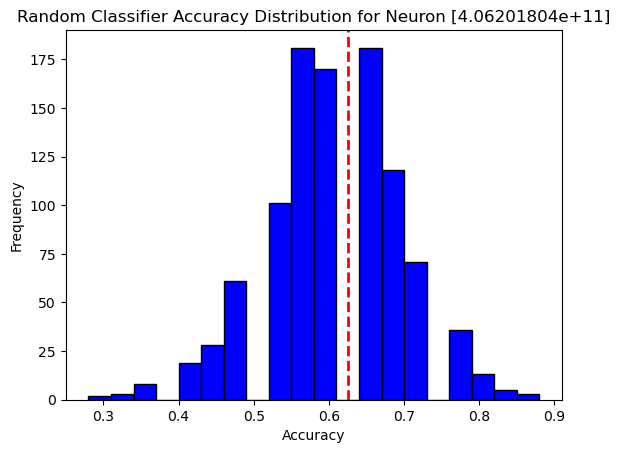

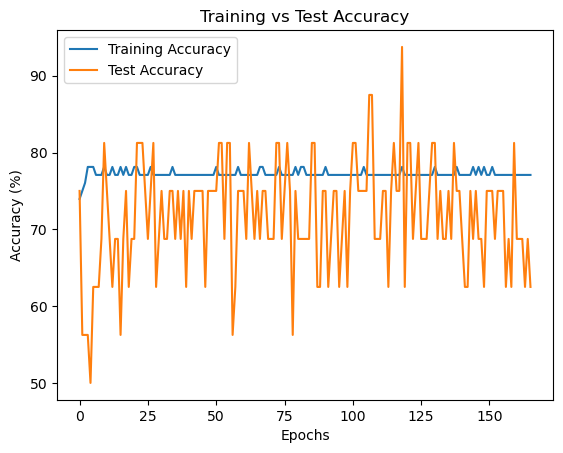

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 68.75%, p-value = 0.1080


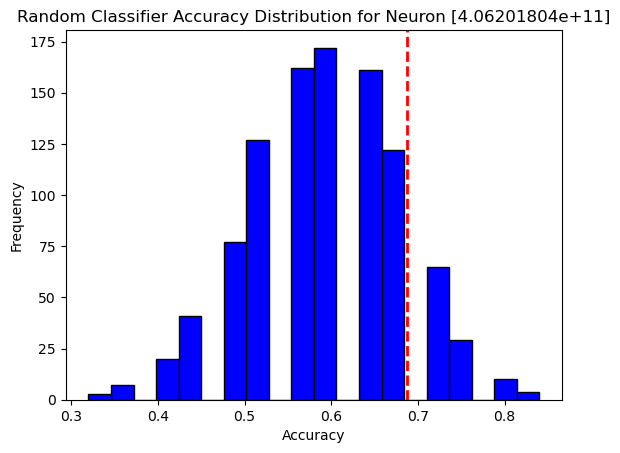

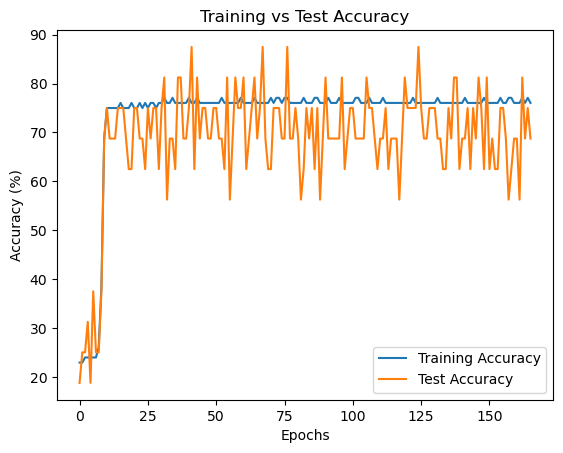

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 50.00%, p-value = 0.8620


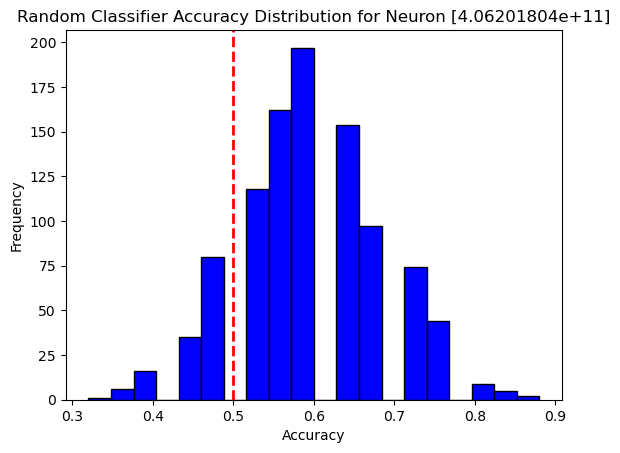

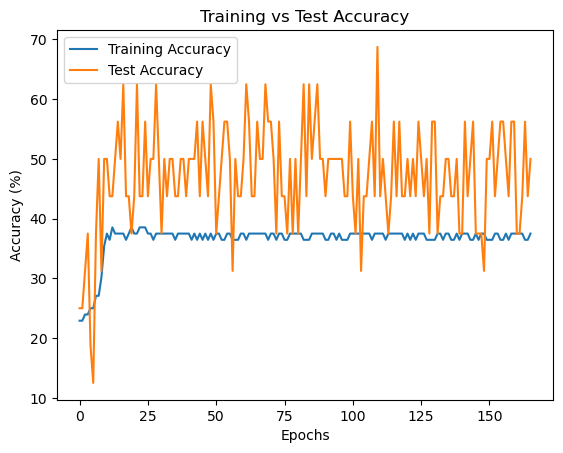

Confusion Matrix:
 [[ 6  1]
 [12  6]]
Class-specific Accuracy: [0.85714286 0.33333333]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX


KeyboardInterrupt: 

In [8]:
''' instead of permuattions which are too computationally heavy, we use cross-validattion of the null-hypothesis '''


# Number of random classifiers (null hypothesis testing)
num_permutations = 1000

# Brain areas and analysis types
results = []
brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"]

combinations = [('S1', 'GO'), ('S1', 'LICK'), ('S1naive', 'GO'), ('S1naive', 'LICK'), ('PPC', 'GO'), ('PPC', 'LICK')]

# Iterate through each combination
for comb in combinations:
    brain_area = comb[0]
    type_of_analysis = comb[1]
    print(f"Brain Area: {brain_area}, Analysis Type: {type_of_analysis}")
    trial_list, trial_dff = get_data_ready(brain_area, type_of_analysis)

    neuron_list = np.unique(trial_list[:, 0]).reshape(-1, 1)
    print("Num of neurons before filter=", neuron_list.shape[0])

    for neuron in neuron_list:
        print("\n", neuron, "XXXXXXXXXXXXXXXXXXXX")
        
        # Extract neuron-specific data
        neuron_data_list = trial_list[trial_list[:, 0] == neuron].copy()
        neuron_data_dff = trial_dff[trial_list[:, 0] == neuron].copy()

        X = neuron_data_dff.copy()
        y = neuron_data_list[:, 1]

        X = X.reshape(X.shape[0], X.shape[1], 1)

        #### Train-test split
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Convert to tensors
        Xtrain = torch.from_numpy(X_train).float()
        ytrain = torch.from_numpy(y_train).long()
        Xtest = torch.from_numpy(X_test).float()
        ytest = torch.from_numpy(y_test).long()

        # Batch size, epochs, and iterations
        batch_size = 16
        n_iters = 1000
        num_epochs = int(n_iters // (len(X_train) // batch_size))

        train = TensorDataset(Xtrain, ytrain)
        test = TensorDataset(Xtest, ytest)

        train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test, batch_size=batch_size, shuffle=True, drop_last=True)

        # Create the RNN model
        input_dim = X.shape[-1]
        hidden_dim = 4
        layer_dim = 1
        output_dim = 1

        model = RNNModel(input_dim, hidden_dim, layer_dim, output_dim)

        # Loss function and optimizer WITHOUT weights
        error = nn.BCEWithLogitsLoss()
        learning_rate = 0.001
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

        # Training loop for the original model
        train_accuracy_list = []
        test_accuracy_list = []
        test_loss_list = []

        for epoch in range(num_epochs):
            model.train()
            total_train, correct_train = 0, 0

            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                outputs = model(X_batch).squeeze()
                loss = error(outputs, y_batch.float())
                loss.backward()
                optimizer.step()

                probabilities = torch.sigmoid(outputs)
                predicted = (probabilities > 0.5).long()
                correct_train += (predicted.squeeze() == y_batch).sum().item()
                total_train += y_batch.size(0)

            train_accuracy = 100 * correct_train / total_train
            train_accuracy_list.append(train_accuracy)
            scheduler.step()

            # Evaluate on test set
            model.eval()
            total_test, correct_test = 0, 0
            with torch.no_grad():
                for X_test_batch, y_test_batch in test_loader:
                    outputs = model(X_test_batch).squeeze()
                    probabilities = torch.sigmoid(outputs)
                    predicted = (probabilities > 0.5).long()
                    correct_test += (predicted == y_test_batch).sum().item()
                    total_test += y_test_batch.size(0)
                    loss_test = error(outputs, y_test_batch.float())
                    test_loss_list.append(loss_test)

            test_accuracy = 100 * correct_test / float(total_test)
            test_accuracy_list.append(test_accuracy)

        # Save the original model's test accuracy
        original_test_accuracy = test_accuracy

        # Random classifier: Match class distribution in the test set
        class_distribution = np.mean(y_test)  # proportion of class 1

        random_accuracies = []
        for _ in range(num_permutations):
            y_random = np.random.choice([0, 1], size=len(y_test), p=[1 - class_distribution, class_distribution])
            random_accuracy = accuracy_score(y_test, y_random)
            random_accuracies.append(random_accuracy)

        # Calculate p-value using a t-test (testing original model vs. random classifiers)
        random_accuracies = np.array(random_accuracies)
        p_value = np.mean(random_accuracies >= original_test_accuracy/100)

        # Store results
        results.append({
            'Brain Area': brain_area,
            'Analysis Type': type_of_analysis,
            'Neuron': neuron,
            'Train Accuracy': train_accuracy_list,
            'Test Accuracy': original_test_accuracy,
            'p value': p_value
        })

        print(f"Neuron {neuron}: Test Accuracy = {original_test_accuracy:.2f}%, p-value = {p_value:.4f}")

        # Visualize random classifier accuracy distribution
        plt.hist(random_accuracies, bins=20, color='blue', edgecolor='black')
        plt.axvline(original_test_accuracy/100, color='red', linestyle='dashed', linewidth=2)
        plt.title(f'Random Classifier Accuracy Distribution for Neuron {neuron}')
        plt.xlabel('Accuracy')
        plt.ylabel('Frequency')
        plt.show()

        # Plot training vs test accuracy to examine potential overfitting or bias
        plt.plot(train_accuracy_list, label='Training Accuracy')
        plt.plot(test_accuracy_list, label='Test Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy (%)')
        plt.title('Training vs Test Accuracy')
        plt.legend()
        plt.show()
        
        # Check class-specific accuracy on the test set
        
        # Predict on the test set and calculate confusion matrix
        model.eval()
        with torch.no_grad():
            outputs = model(Xtest).squeeze()
            probabilities = torch.sigmoid(outputs)
            predictions = (probabilities > 0.5).long()
            
        conf_matrix = confusion_matrix(ytest, predictions)
        print("Confusion Matrix:\n", conf_matrix)
        
        # Calculate class-specific accuracy
        class_accuracy = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
        print("Class-specific Accuracy:", class_accuracy)


        # Save neuron results to S3 (for long-running jobs)
        neuron_results = results[-1]
        neuron_results['Neuron'] = neuron_results['Neuron'][0]
        filename = f"neuron_{neuron}.json"
        neuron_data = json.dumps(neuron_results)
        s3.put_object(Bucket=bucket_name, Key=filename, Body=neuron_data)


Brain Area: S1, Analysis Type: GO
Num of neurons before filter= 289

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 62.50%, p-value = 0.1070


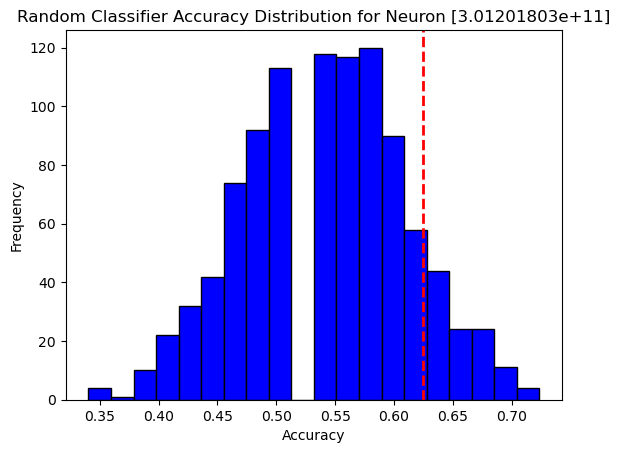

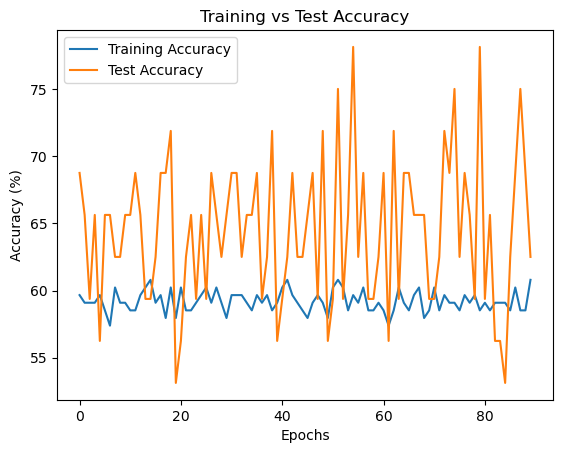

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 56.25%, p-value = 0.3560


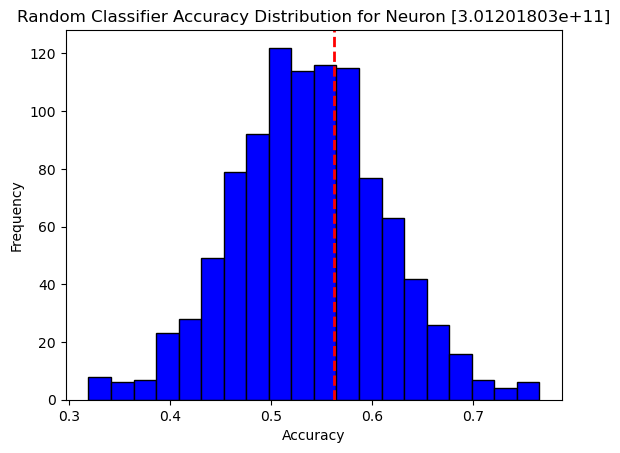

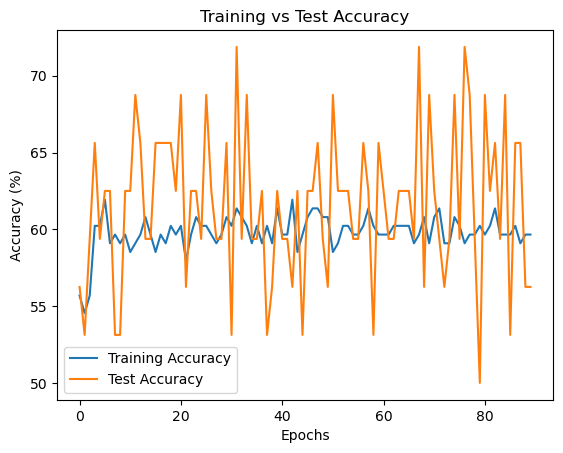

Confusion Matrix:
 [[29  1]
 [17  0]]
Class-specific Accuracy: [0.96666667 0.        ]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 59.38%, p-value = 0.2590


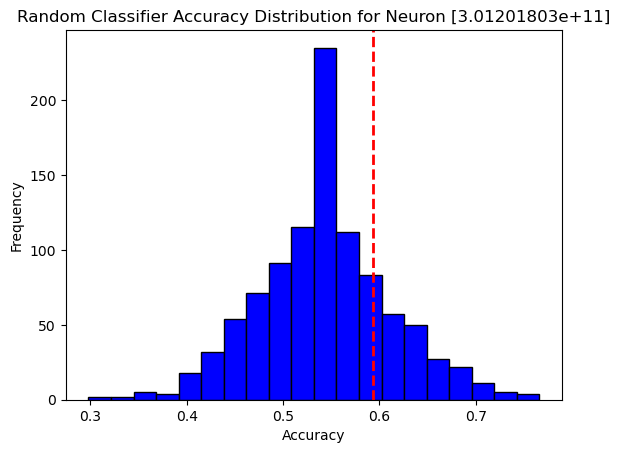

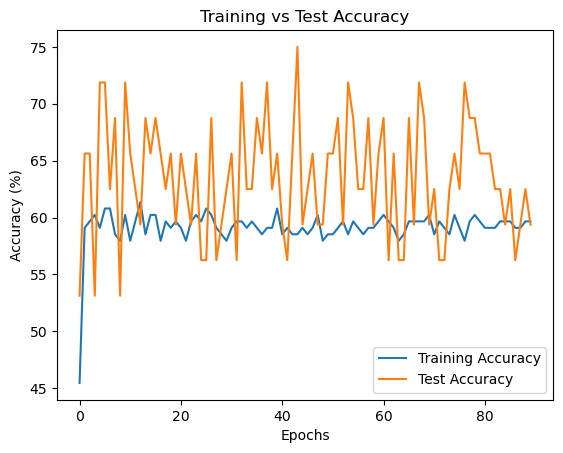

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 62.50%, p-value = 0.1070


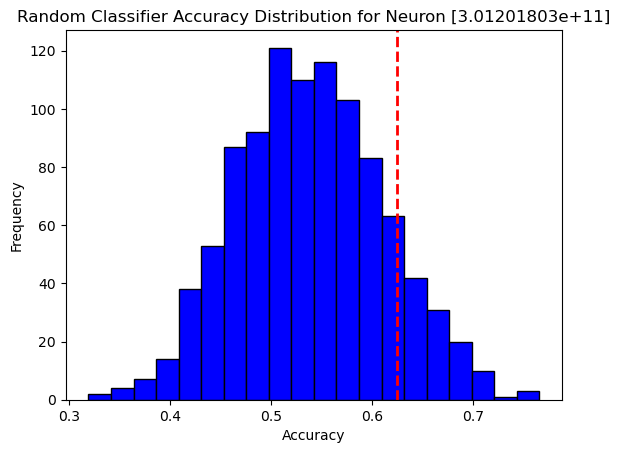

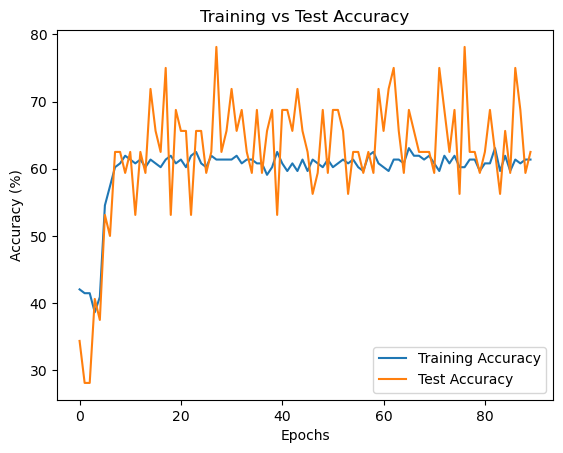

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 62.50%, p-value = 0.3740


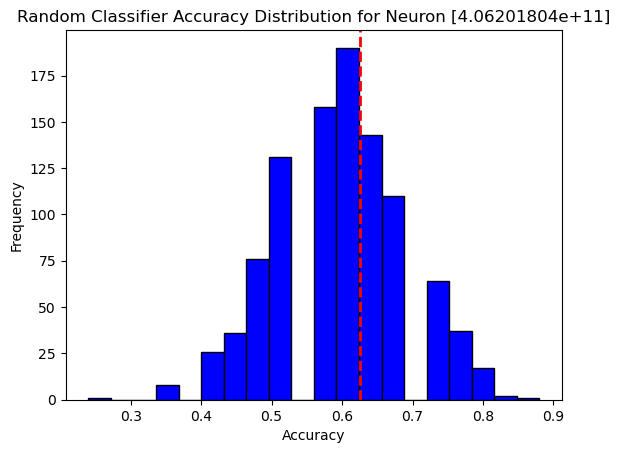

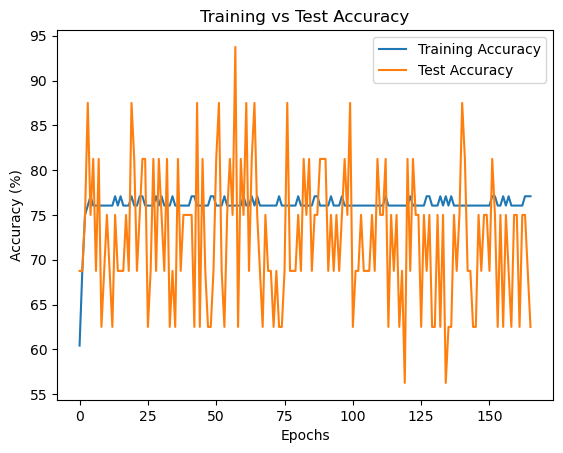

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 68.75%, p-value = 0.1110


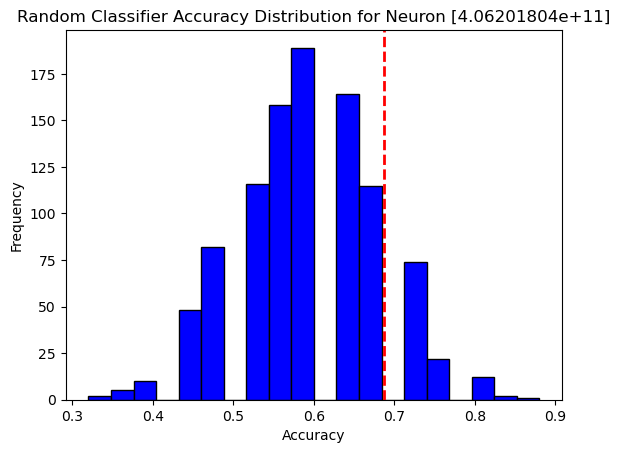

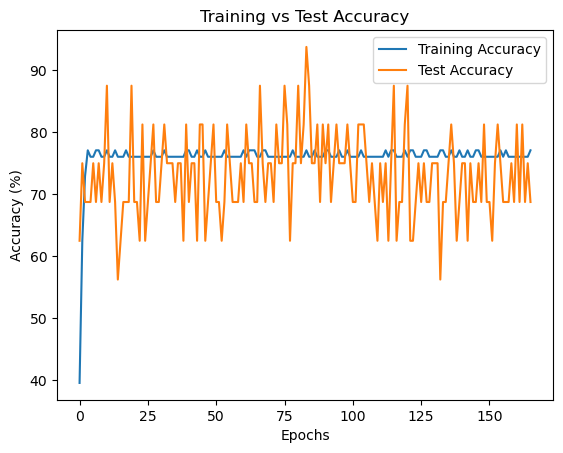

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 75.00%, p-value = 0.0460


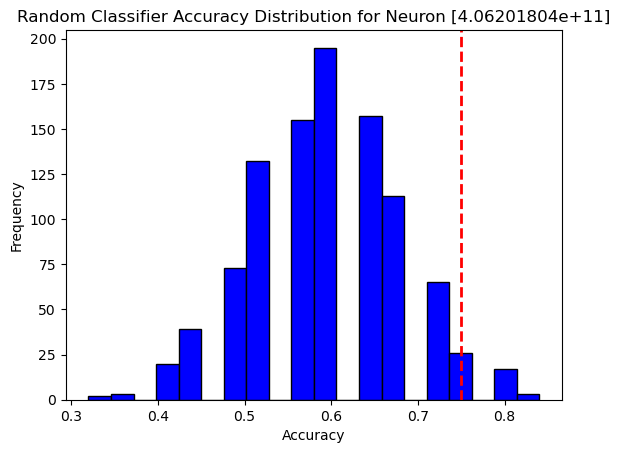

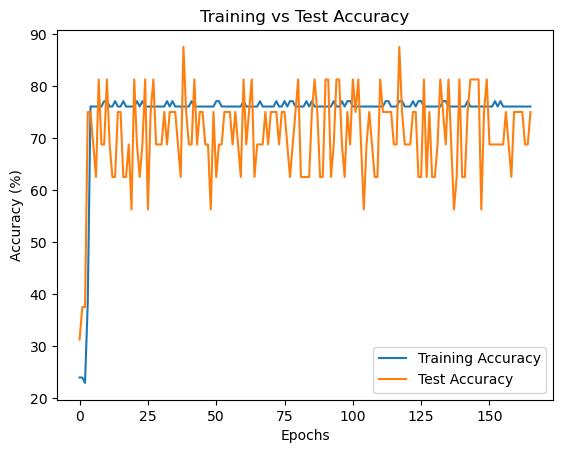

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 75.00%, p-value = 0.0570


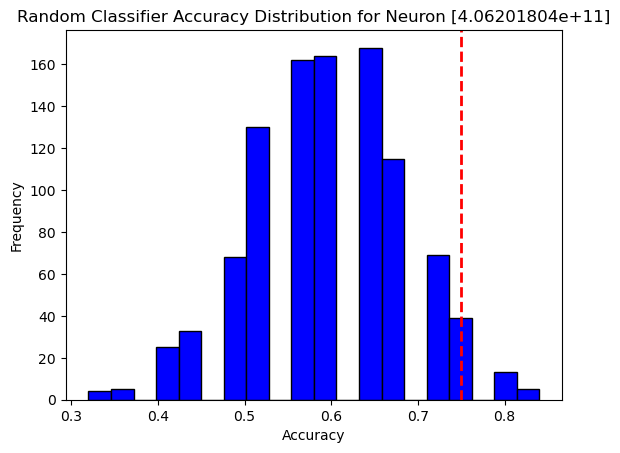

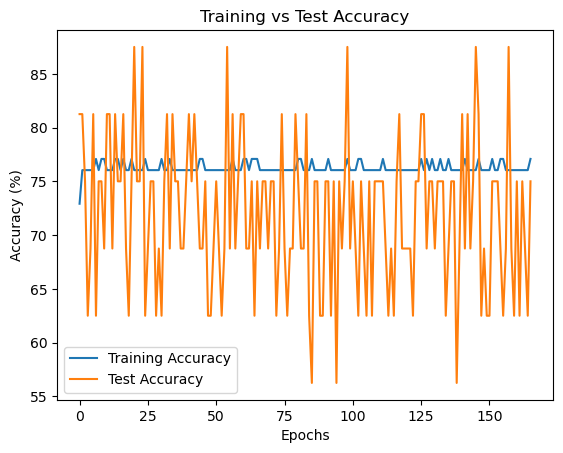

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 31.25%, p-value = 1.0000


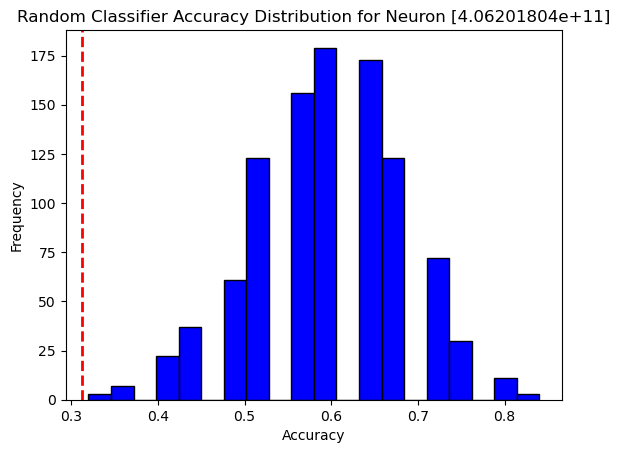

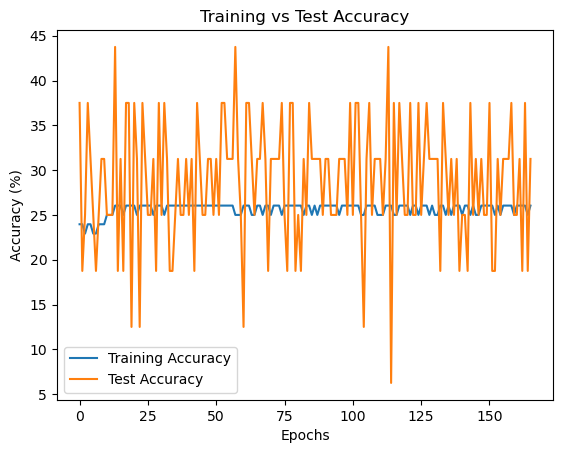

Confusion Matrix:
 [[ 7  0]
 [18  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 53.75%, p-value = 0.2950


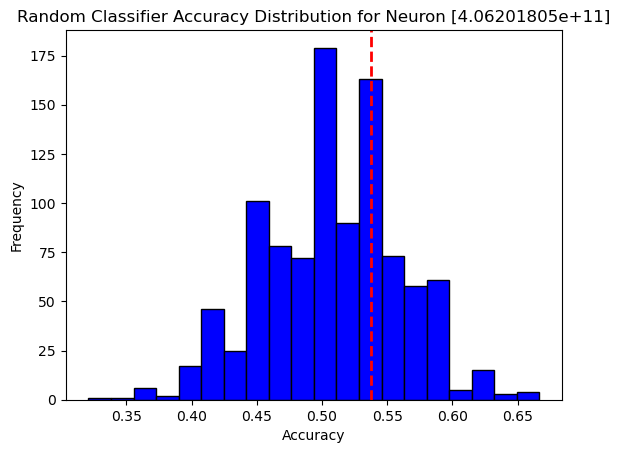

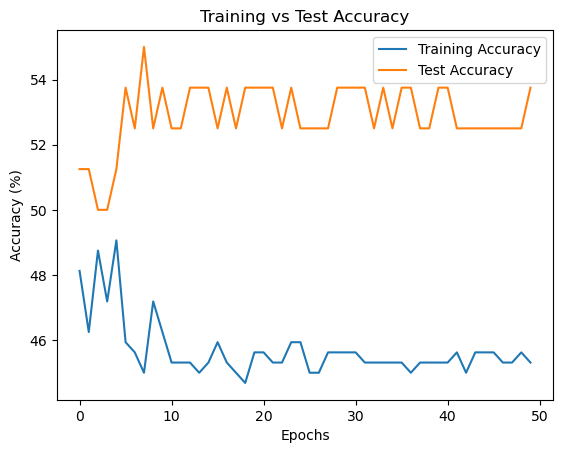

Confusion Matrix:
 [[27  9]
 [29 16]]
Class-specific Accuracy: [0.75       0.35555556]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 43.75%, p-value = 0.8950


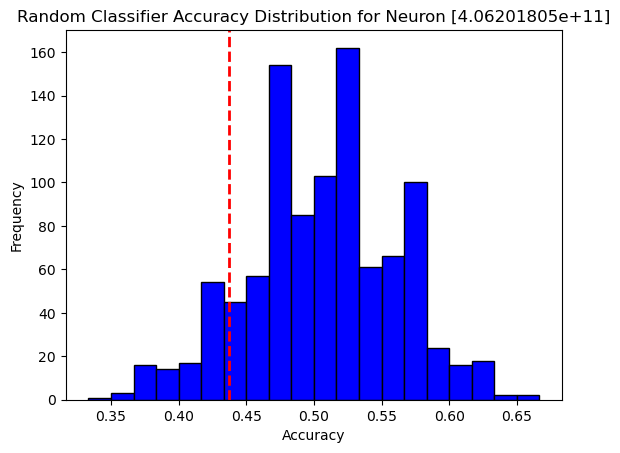

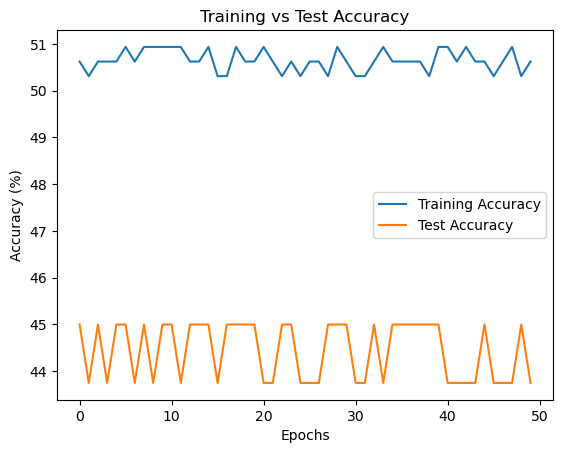

Confusion Matrix:
 [[36  0]
 [45  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 52.50%, p-value = 0.3960


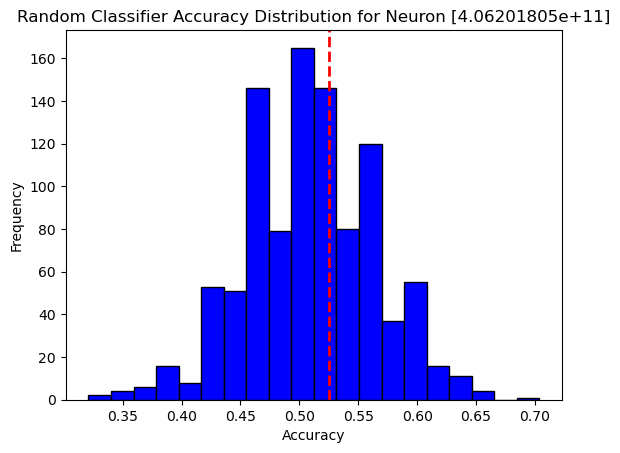

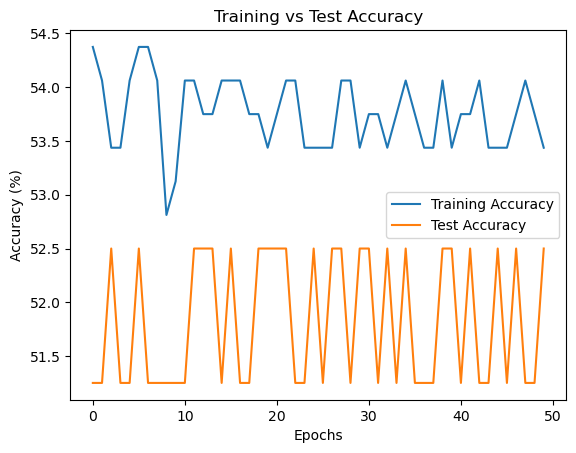

Confusion Matrix:
 [[23 13]
 [26 19]]
Class-specific Accuracy: [0.63888889 0.42222222]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 56.25%, p-value = 0.1510


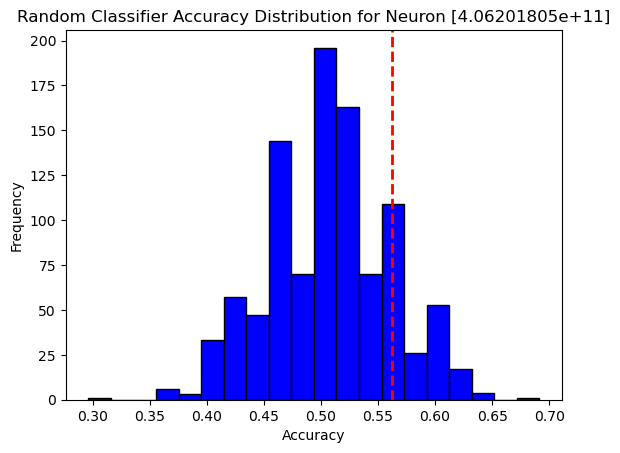

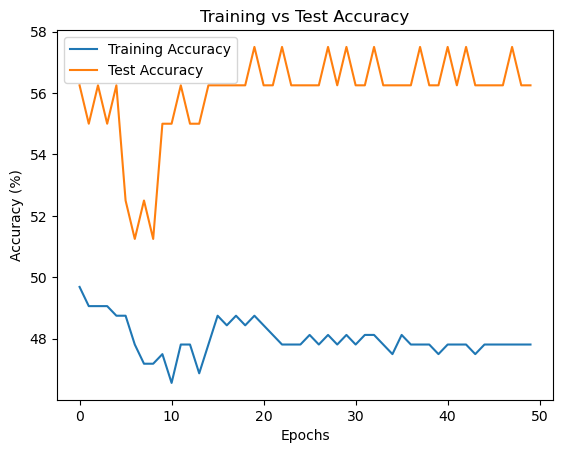

Confusion Matrix:
 [[ 9 27]
 [ 8 37]]
Class-specific Accuracy: [0.25       0.82222222]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 46.88%, p-value = 0.6290


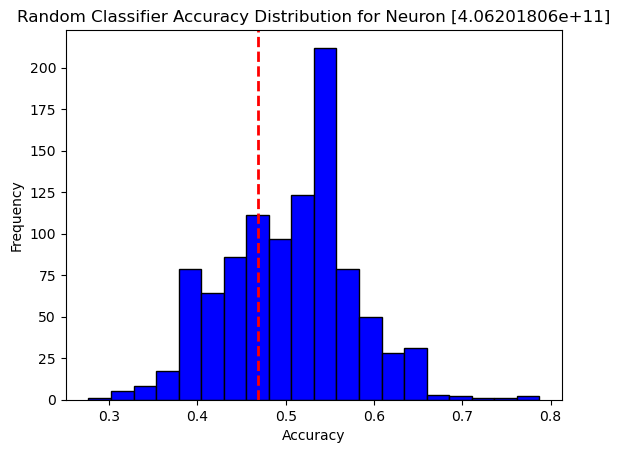

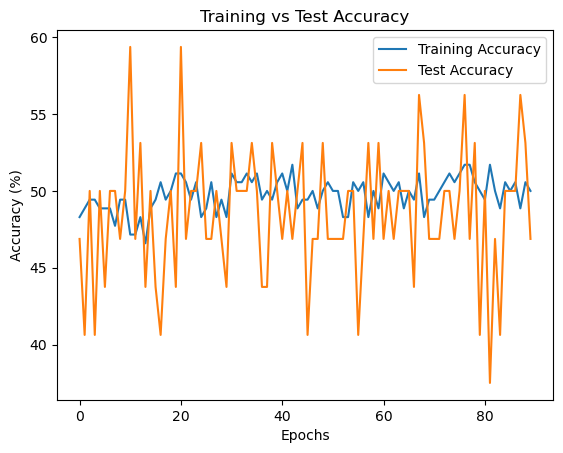

Confusion Matrix:
 [[21  0]
 [24  2]]
Class-specific Accuracy: [1.         0.07692308]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 56.25%, p-value = 0.2180


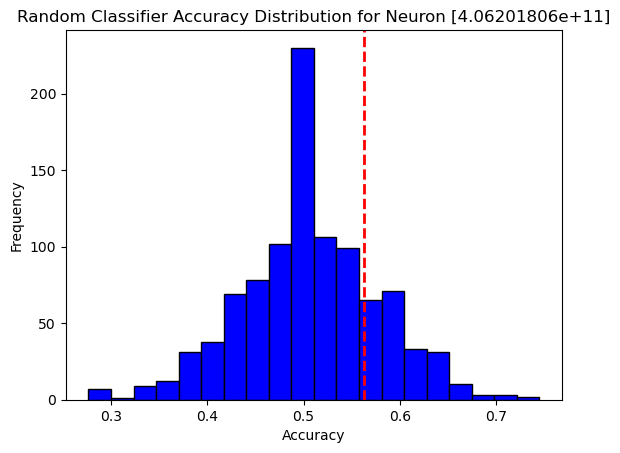

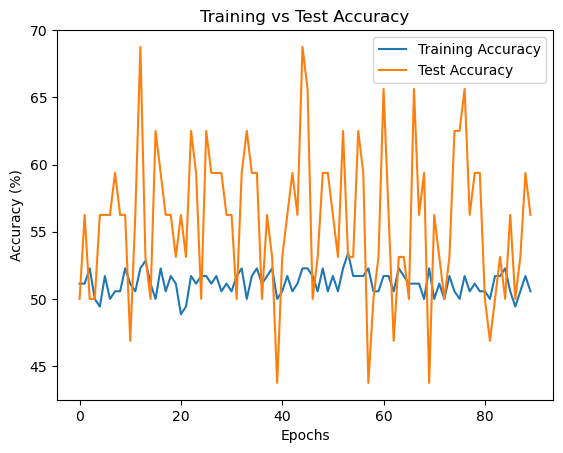

Confusion Matrix:
 [[ 0 21]
 [ 0 26]]
Class-specific Accuracy: [0. 1.]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 56.25%, p-value = 0.2040


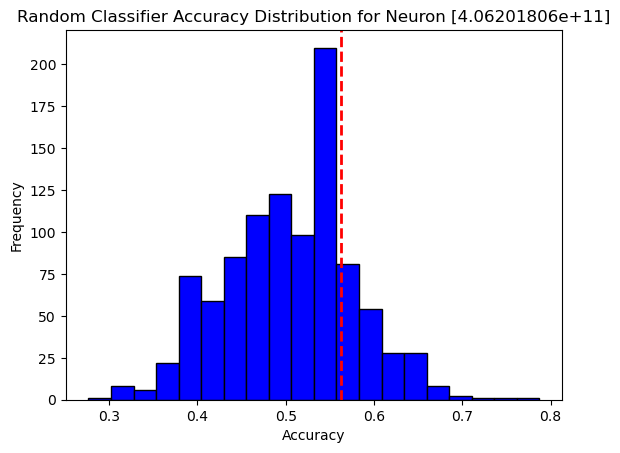

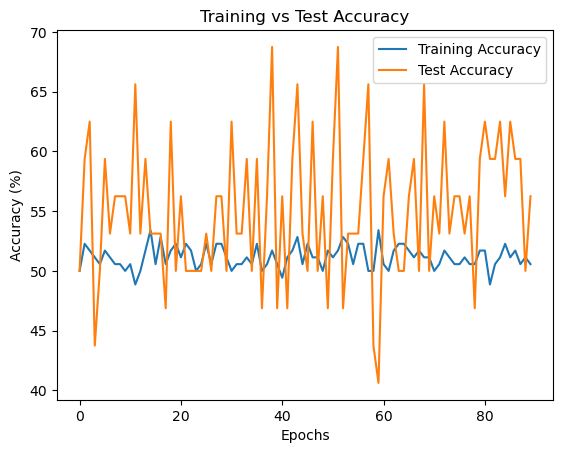

Confusion Matrix:
 [[ 0 21]
 [ 0 26]]
Class-specific Accuracy: [0. 1.]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 56.25%, p-value = 0.2210


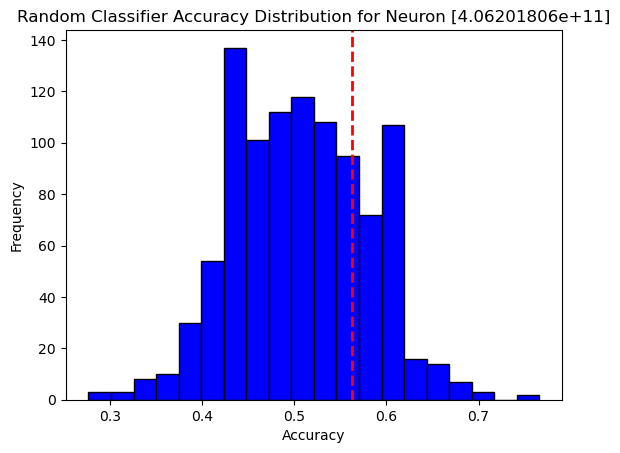

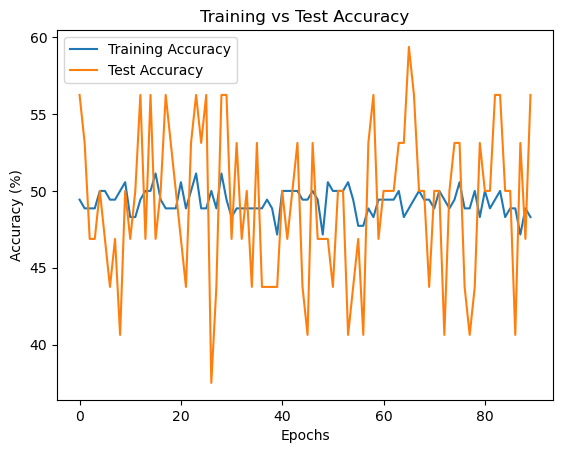

Confusion Matrix:
 [[21  0]
 [24  2]]
Class-specific Accuracy: [1.         0.07692308]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 51.04%, p-value = 0.3860


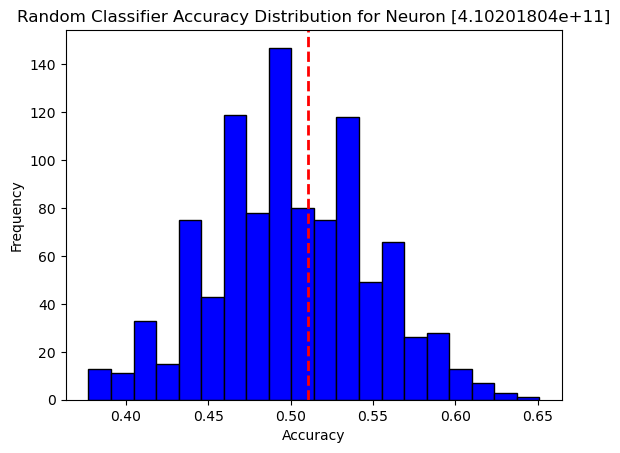

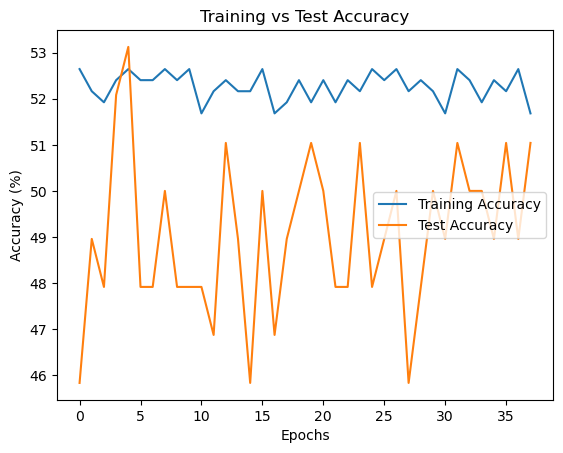

Confusion Matrix:
 [[52  0]
 [54  0]]
Class-specific Accuracy: [1. 0.]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 52.08%, p-value = 0.3160


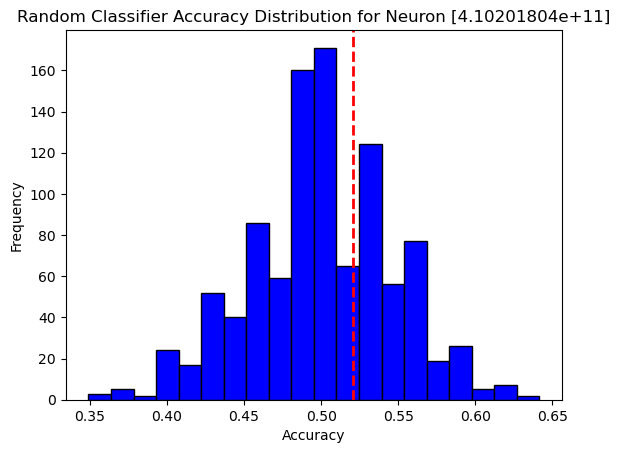

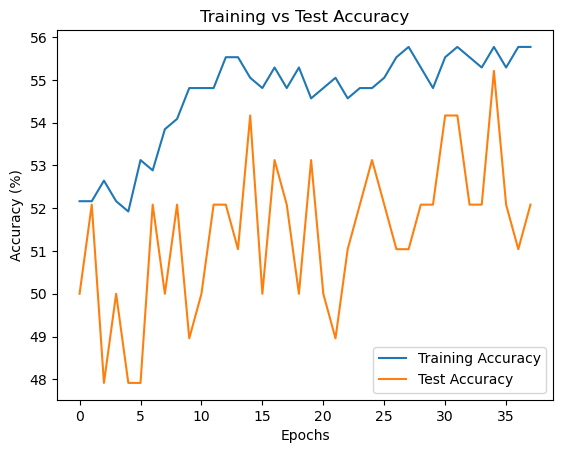

Confusion Matrix:
 [[47  5]
 [46  8]]
Class-specific Accuracy: [0.90384615 0.14814815]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 51.04%, p-value = 0.4070


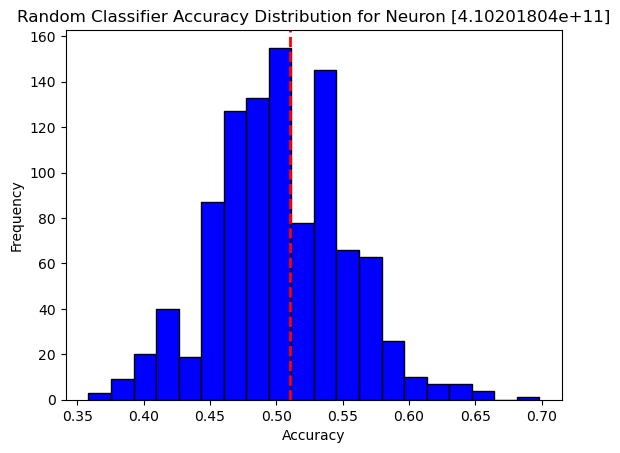

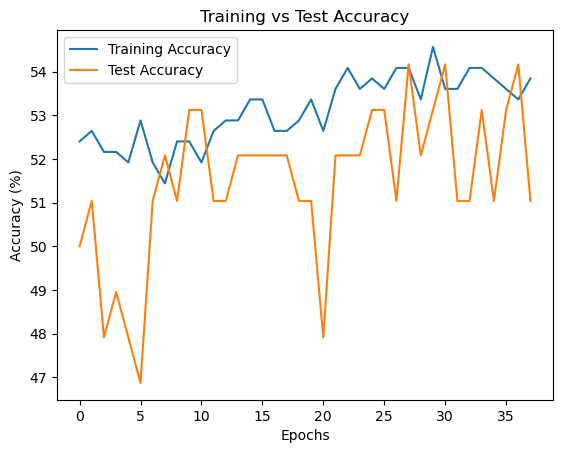

Confusion Matrix:
 [[47  5]
 [46  8]]
Class-specific Accuracy: [0.90384615 0.14814815]

 [4.10201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+11]: Test Accuracy = 57.50%, p-value = 0.1100


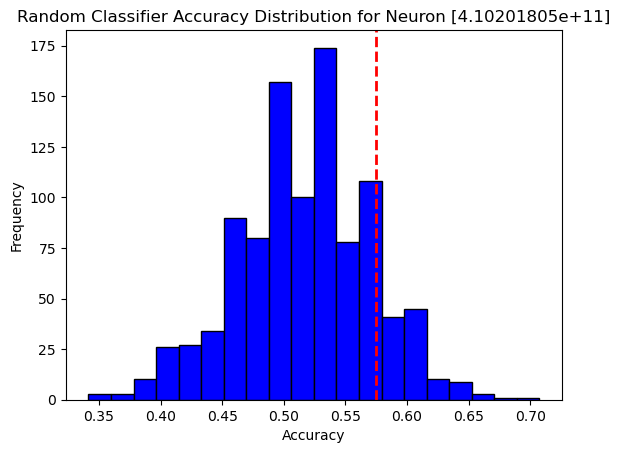

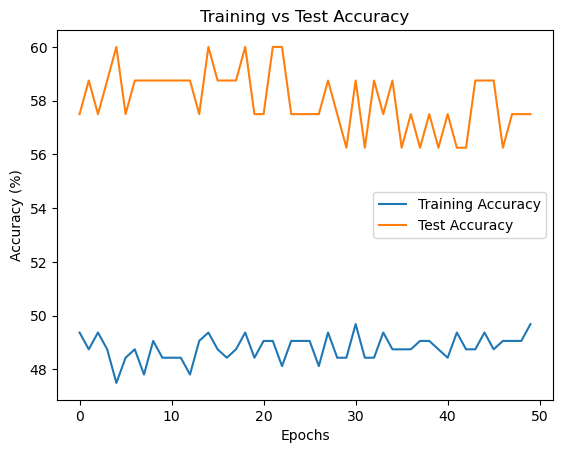

Confusion Matrix:
 [[ 0 34]
 [ 1 47]]
Class-specific Accuracy: [0.         0.97916667]

 [4.10201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+11]: Test Accuracy = 58.75%, p-value = 0.0770


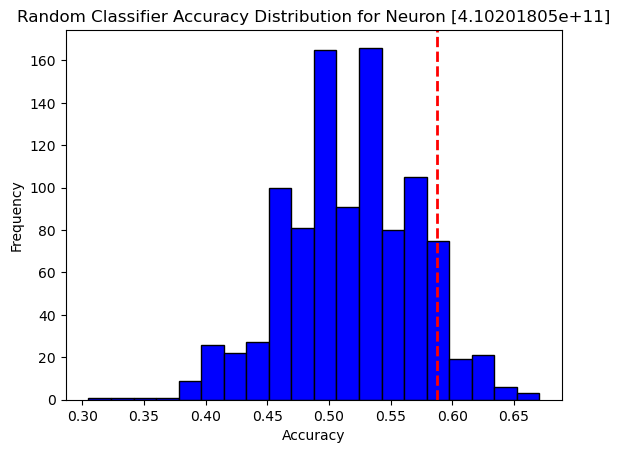

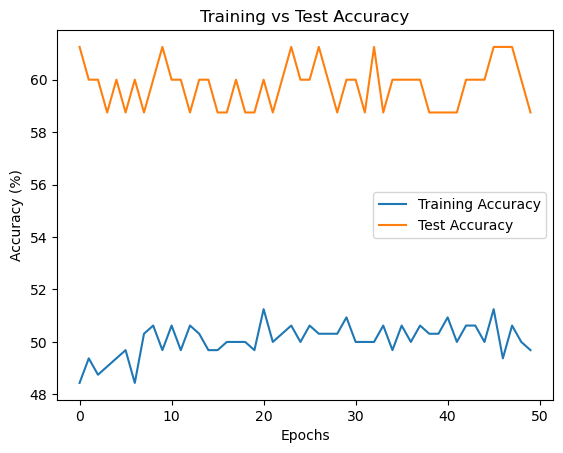

Confusion Matrix:
 [[ 3 31]
 [ 2 46]]
Class-specific Accuracy: [0.08823529 0.95833333]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 55.00%, p-value = 0.6630


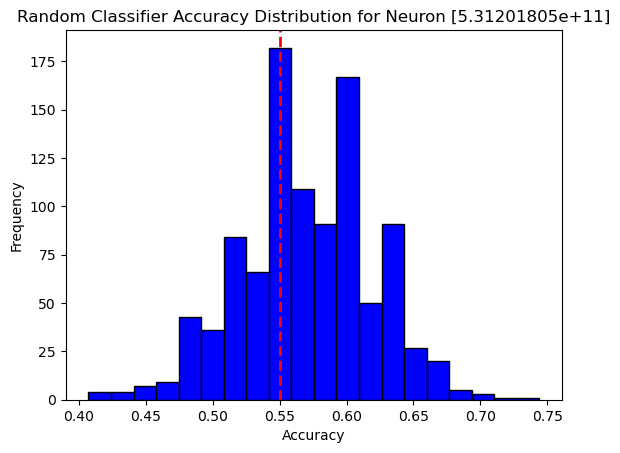

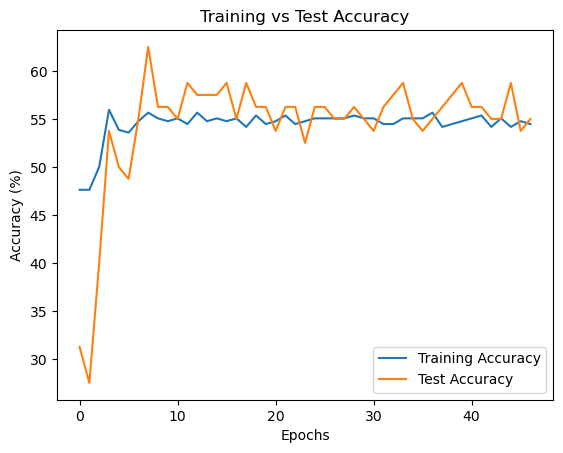

Confusion Matrix:
 [[45 14]
 [24  3]]
Class-specific Accuracy: [0.76271186 0.11111111]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 62.50%, p-value = 0.1320


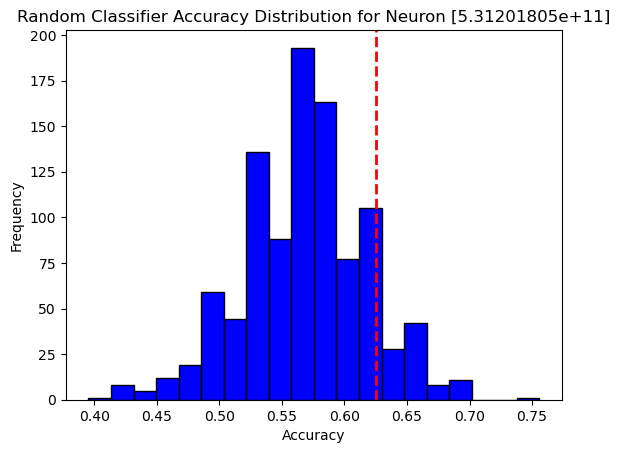

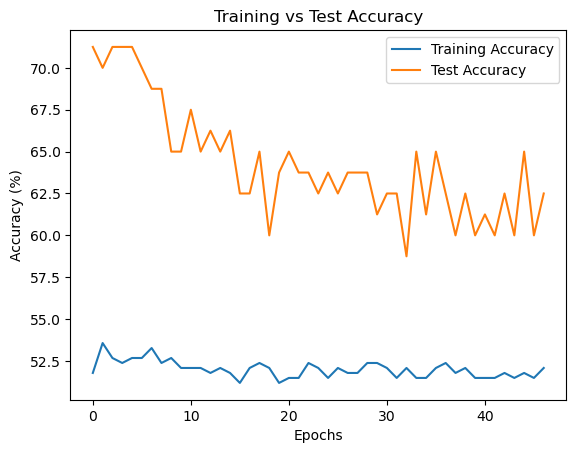

Confusion Matrix:
 [[49 10]
 [23  4]]
Class-specific Accuracy: [0.83050847 0.14814815]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 31.25%, p-value = 1.0000


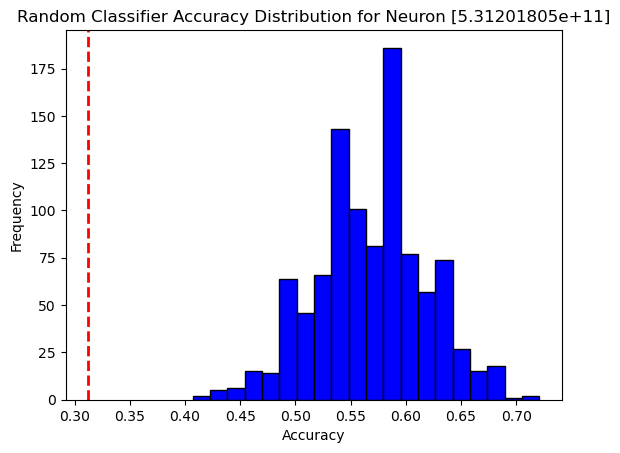

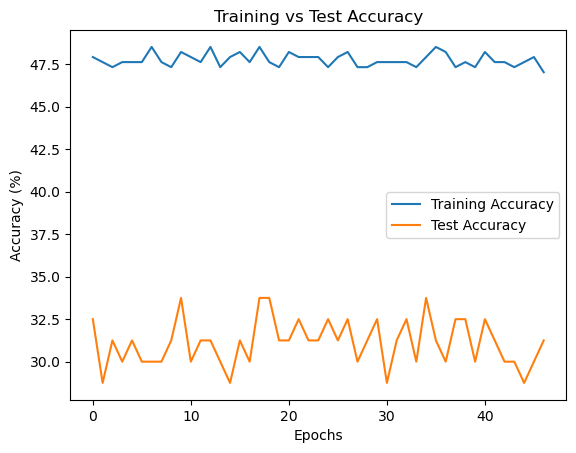

Confusion Matrix:
 [[ 0 59]
 [ 0 27]]
Class-specific Accuracy: [0. 1.]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 56.25%, p-value = 0.5510


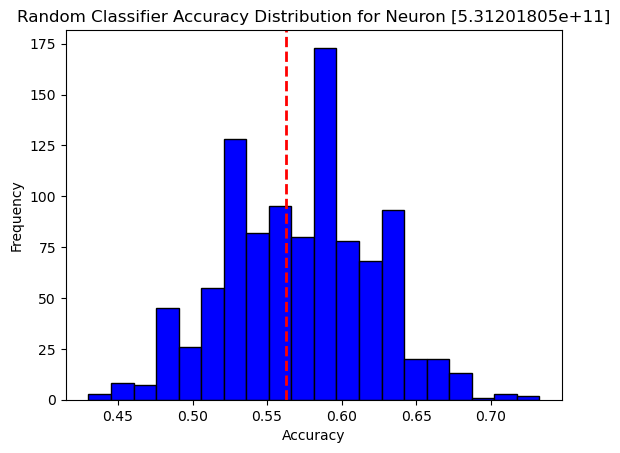

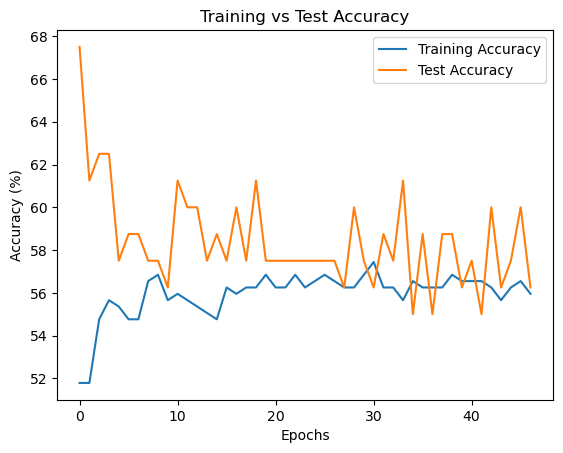

Confusion Matrix:
 [[43 16]
 [20  7]]
Class-specific Accuracy: [0.72881356 0.25925926]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 75.00%, p-value = 0.0000


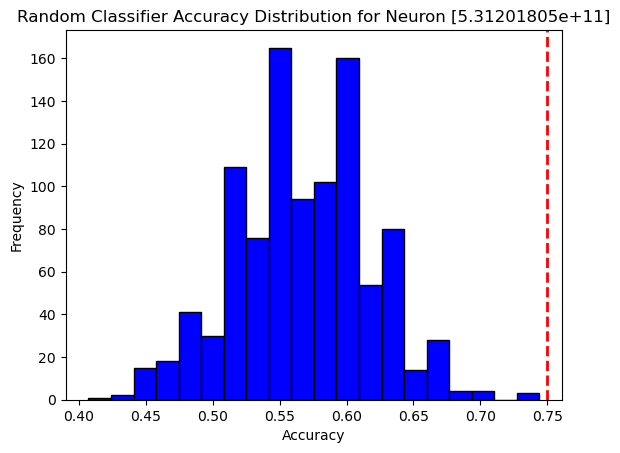

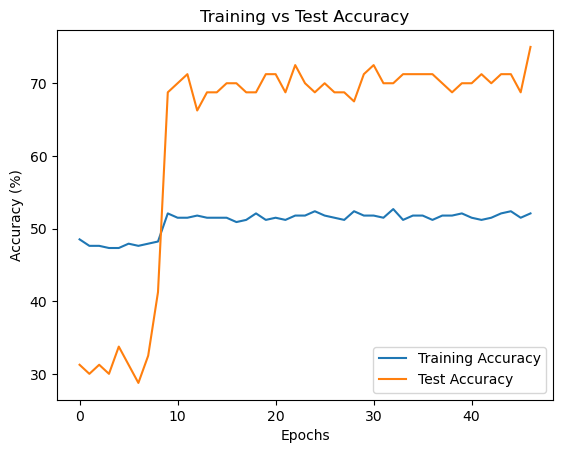

Confusion Matrix:
 [[59  0]
 [25  2]]
Class-specific Accuracy: [1.         0.07407407]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 60.00%, p-value = 0.2640


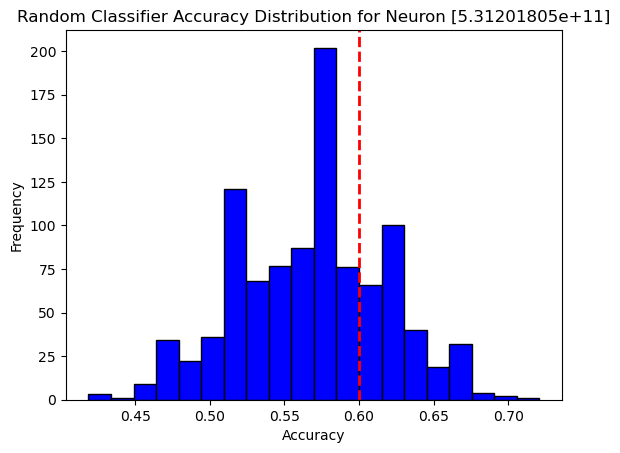

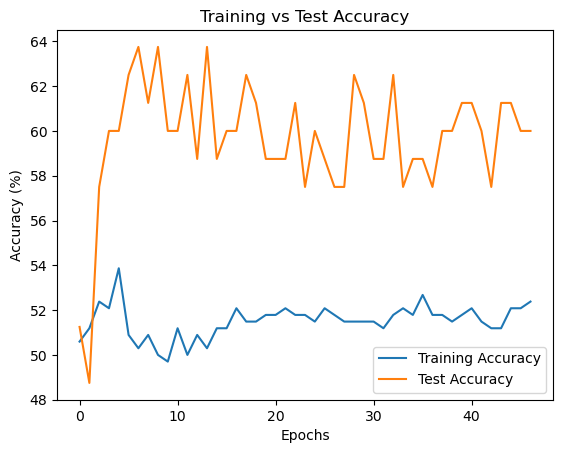

Confusion Matrix:
 [[43 16]
 [19  8]]
Class-specific Accuracy: [0.72881356 0.2962963 ]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 58.33%, p-value = 0.1080


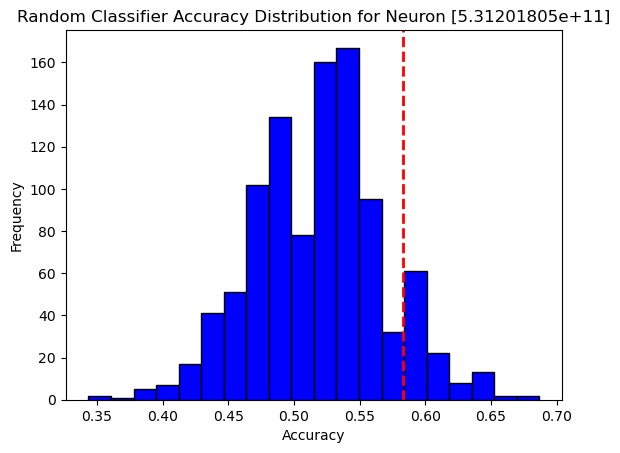

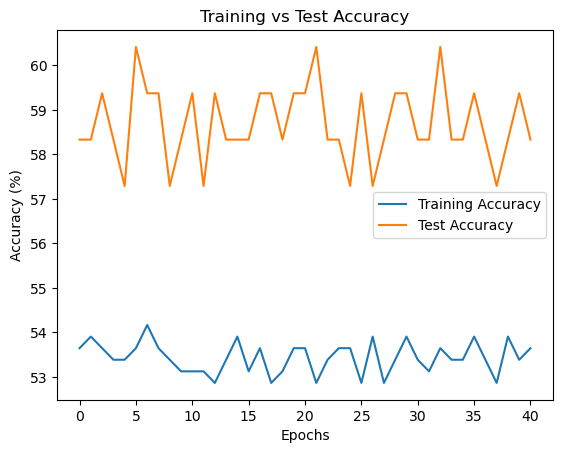

Confusion Matrix:
 [[58  0]
 [41  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 56.25%, p-value = 0.1870


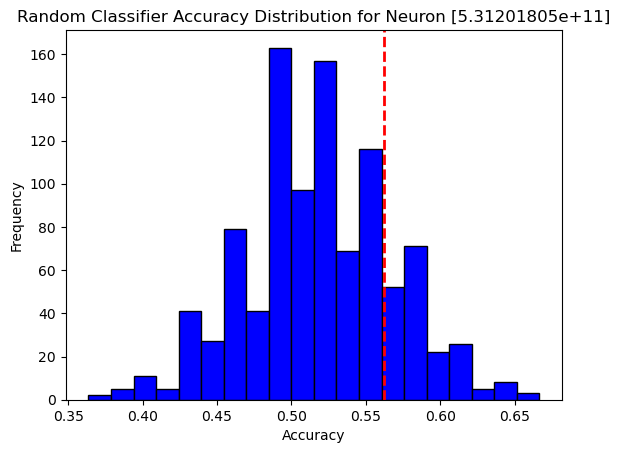

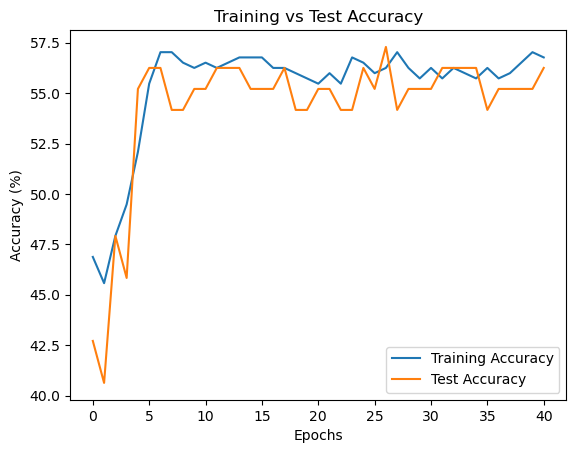

Confusion Matrix:
 [[37 21]
 [23 18]]
Class-specific Accuracy: [0.63793103 0.43902439]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 64.58%, p-value = 0.0010


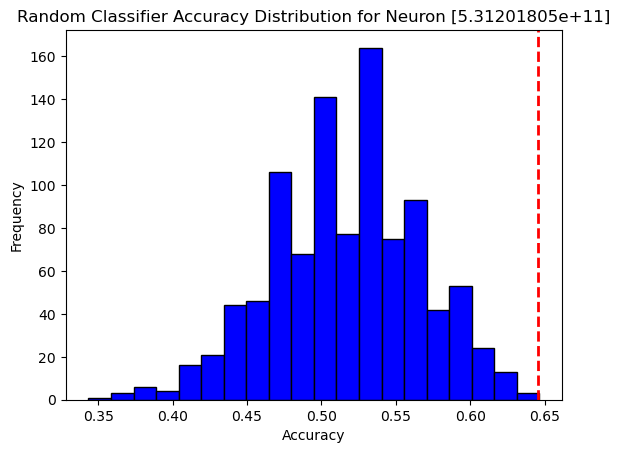

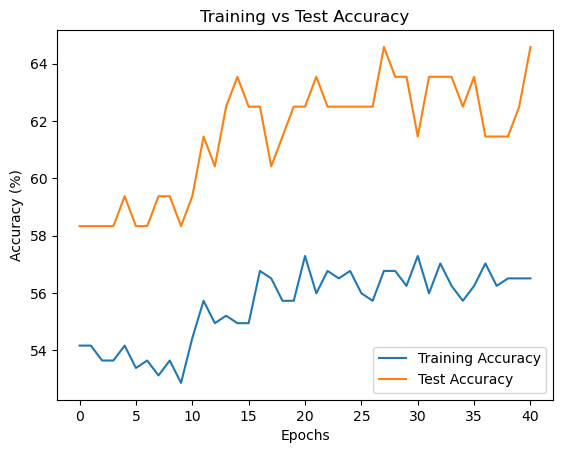

Confusion Matrix:
 [[56  2]
 [35  6]]
Class-specific Accuracy: [0.96551724 0.14634146]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 48.96%, p-value = 0.6760


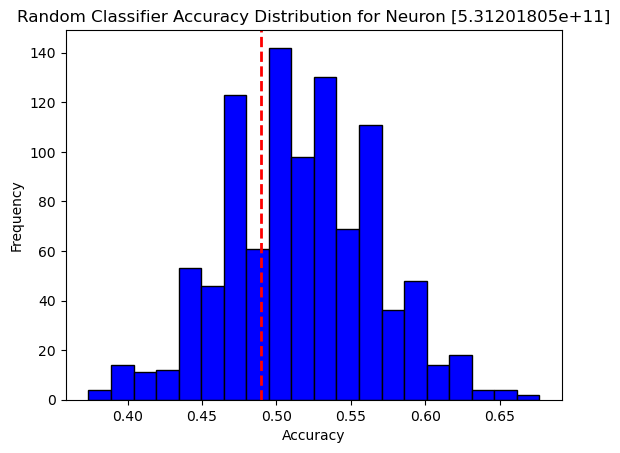

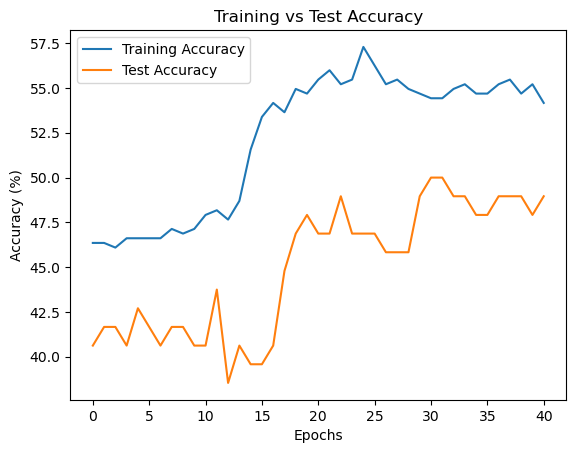

Confusion Matrix:
 [[47 11]
 [39  2]]
Class-specific Accuracy: [0.81034483 0.04878049]

 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 48.96%, p-value = 0.6930


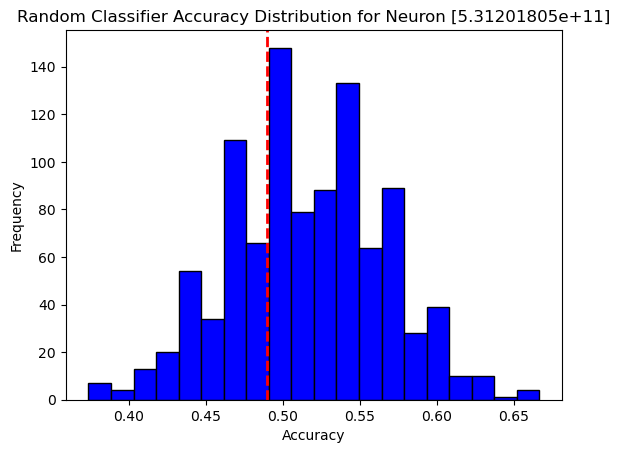

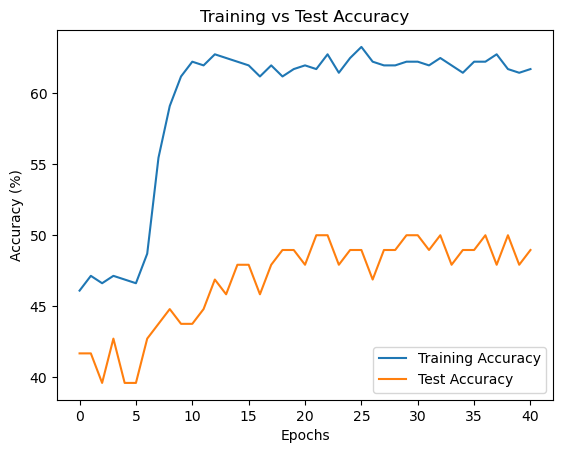

Confusion Matrix:
 [[43 15]
 [35  6]]
Class-specific Accuracy: [0.74137931 0.14634146]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 51.04%, p-value = 0.3840


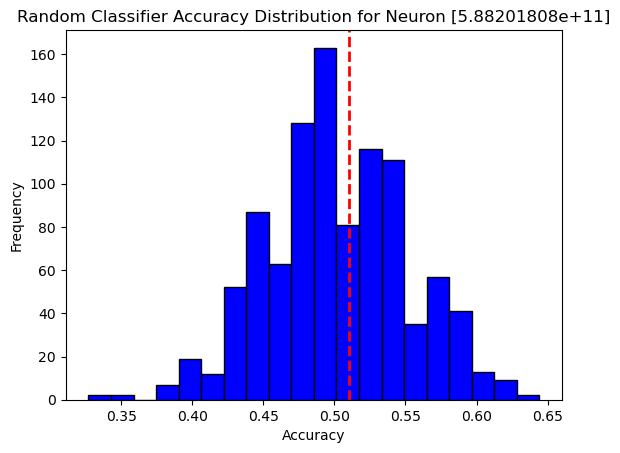

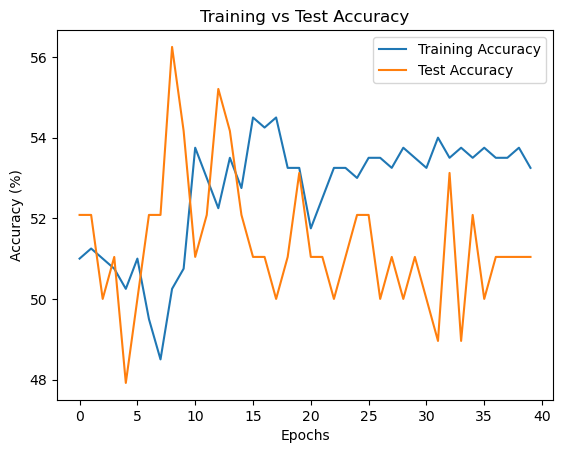

Confusion Matrix:
 [[43 10]
 [41 10]]
Class-specific Accuracy: [0.81132075 0.19607843]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 55.21%, p-value = 0.1350


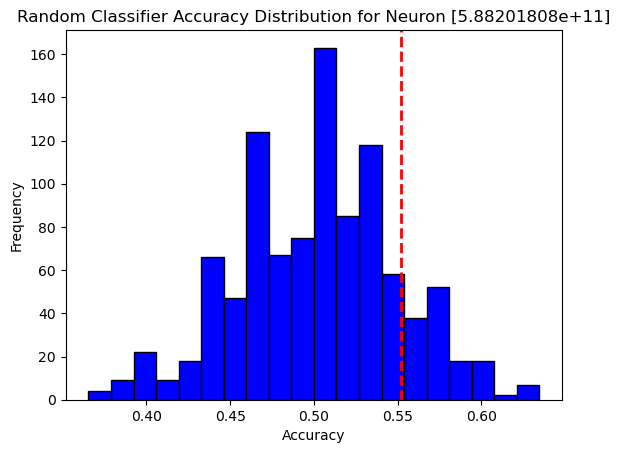

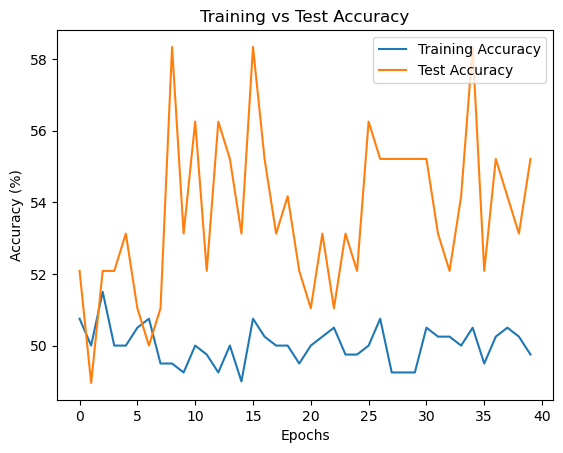

Confusion Matrix:
 [[51  2]
 [46  5]]
Class-specific Accuracy: [0.96226415 0.09803922]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 53.12%, p-value = 0.2380


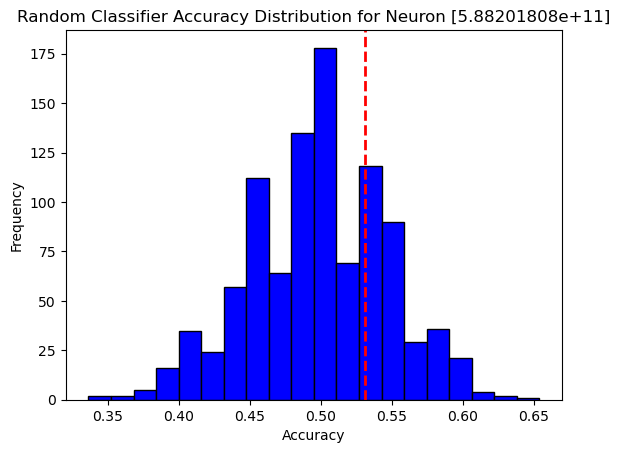

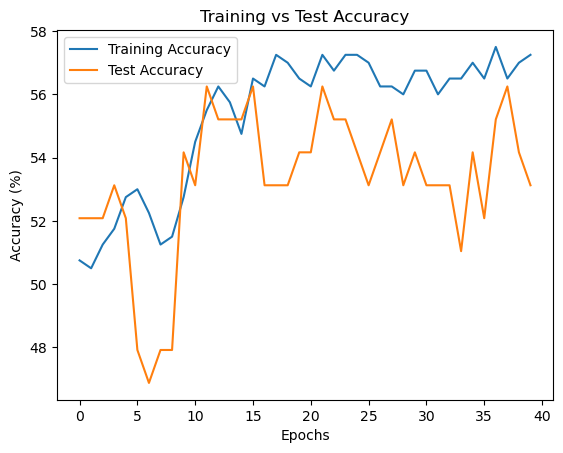

Confusion Matrix:
 [[38 15]
 [33 18]]
Class-specific Accuracy: [0.71698113 0.35294118]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 51.04%, p-value = 0.3750


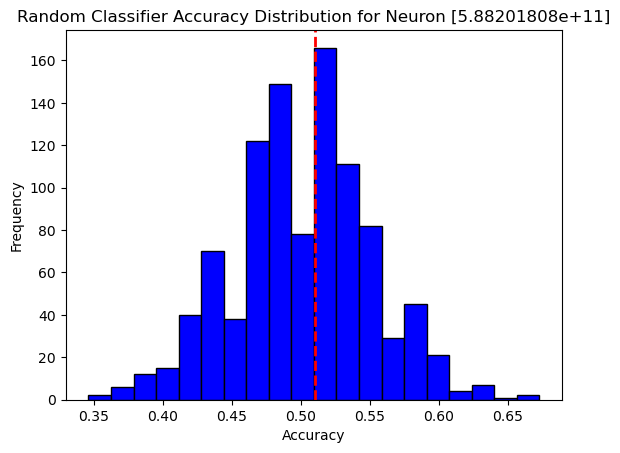

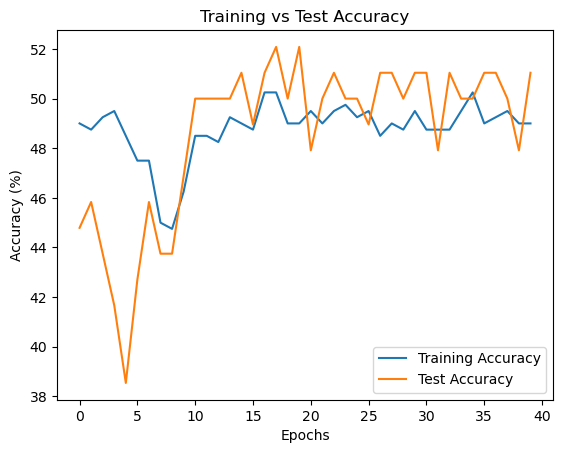

Confusion Matrix:
 [[43 10]
 [42  9]]
Class-specific Accuracy: [0.81132075 0.17647059]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 46.88%, p-value = 0.7810


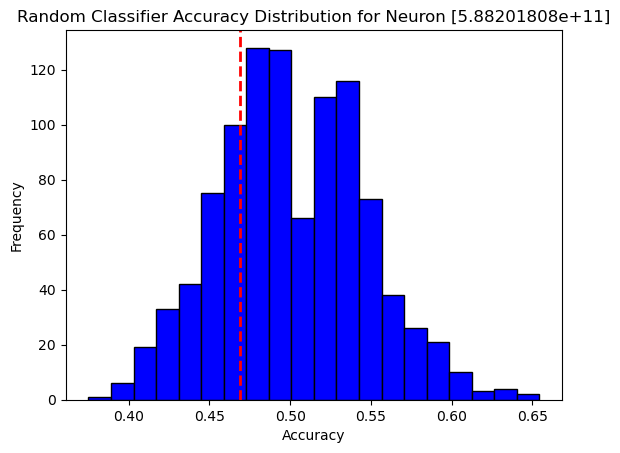

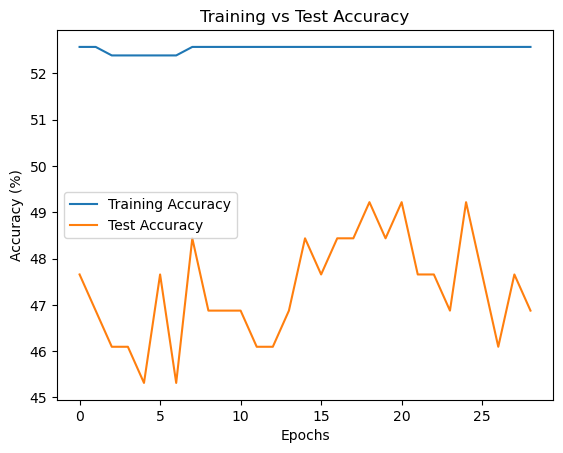

Confusion Matrix:
 [[65  0]
 [71  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 48.44%, p-value = 0.6760


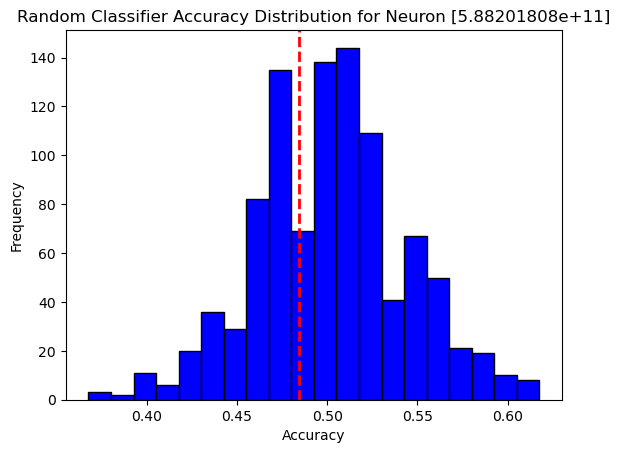

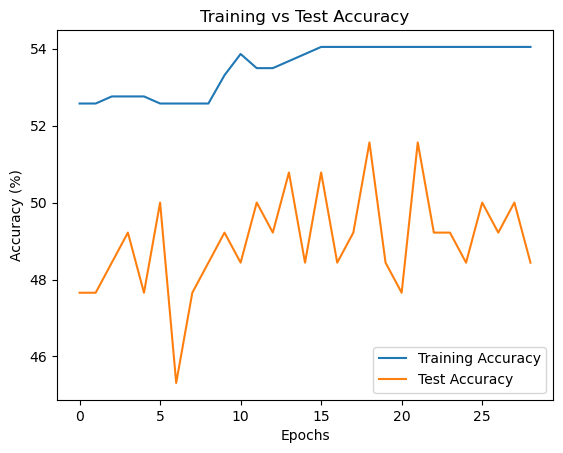

Confusion Matrix:
 [[65  0]
 [69  2]]
Class-specific Accuracy: [1.         0.02816901]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 45.83%, p-value = 0.8540


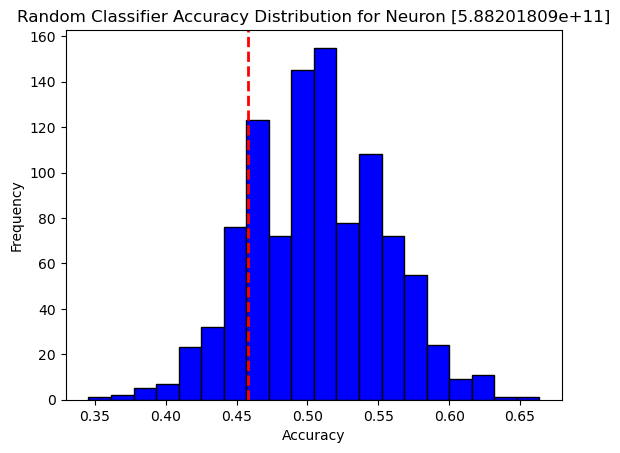

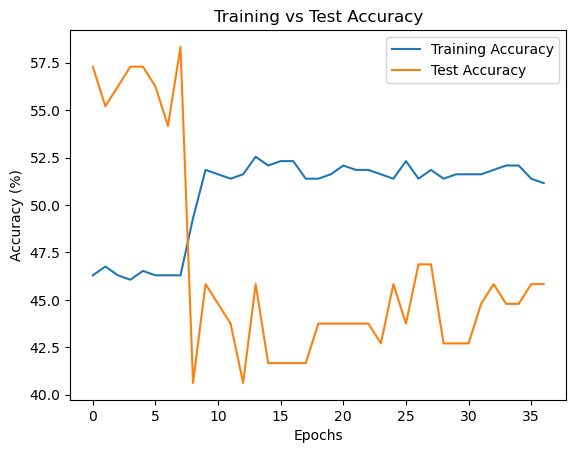

Confusion Matrix:
 [[45  4]
 [57  4]]
Class-specific Accuracy: [0.91836735 0.06557377]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 48.96%, p-value = 0.6600


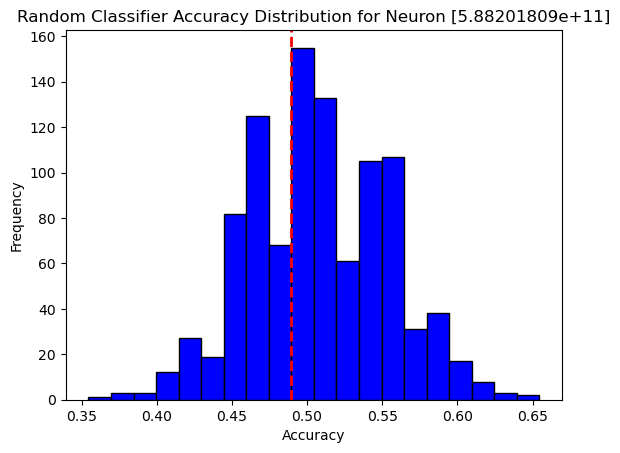

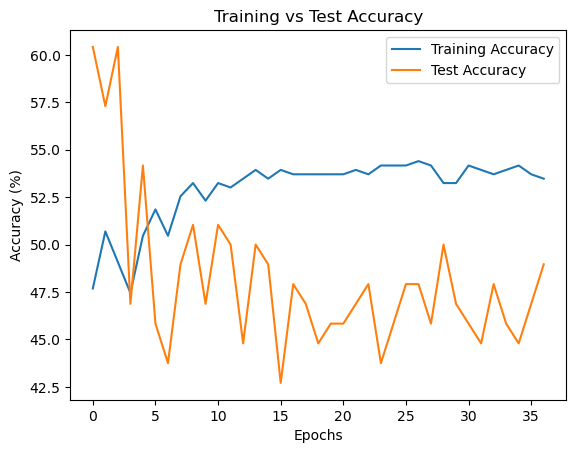

Confusion Matrix:
 [[40  9]
 [49 12]]
Class-specific Accuracy: [0.81632653 0.19672131]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 45.83%, p-value = 0.8530


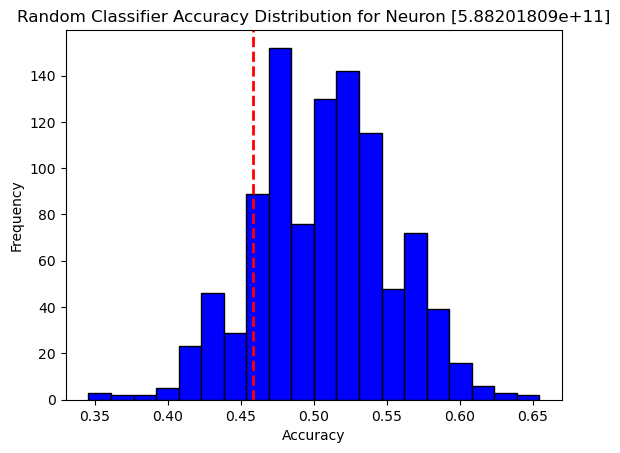

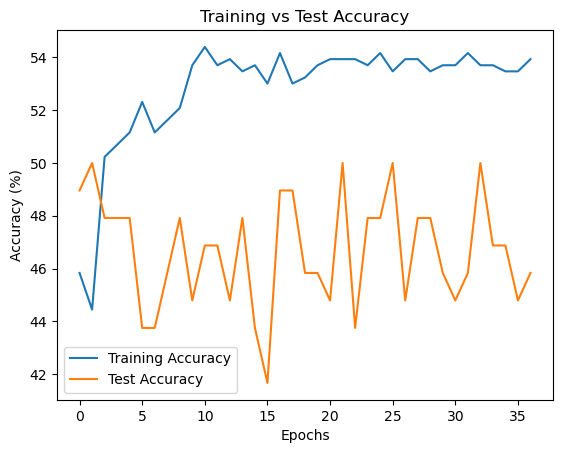

Confusion Matrix:
 [[39 10]
 [49 12]]
Class-specific Accuracy: [0.79591837 0.19672131]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 44.79%, p-value = 0.8950


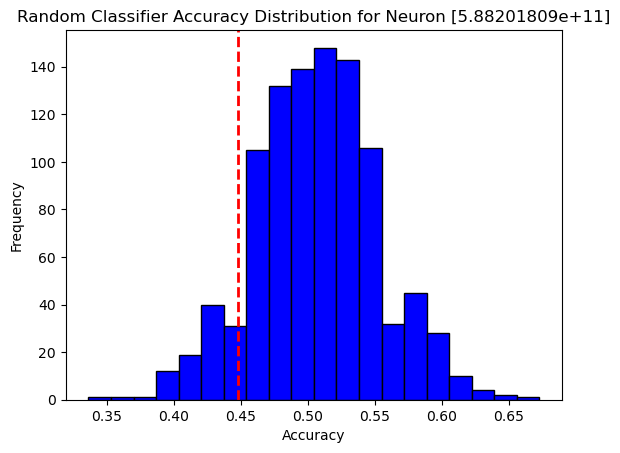

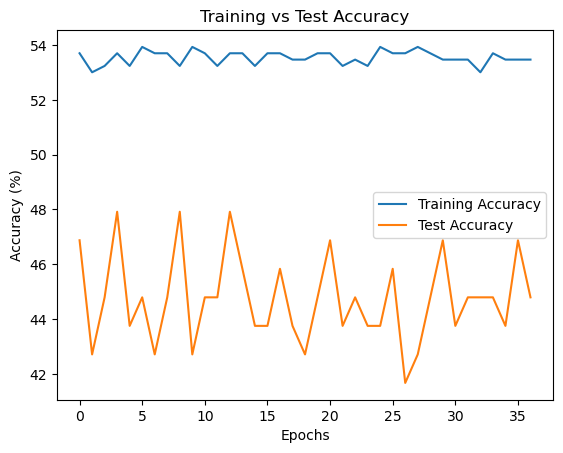

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 54.46%, p-value = 0.1600


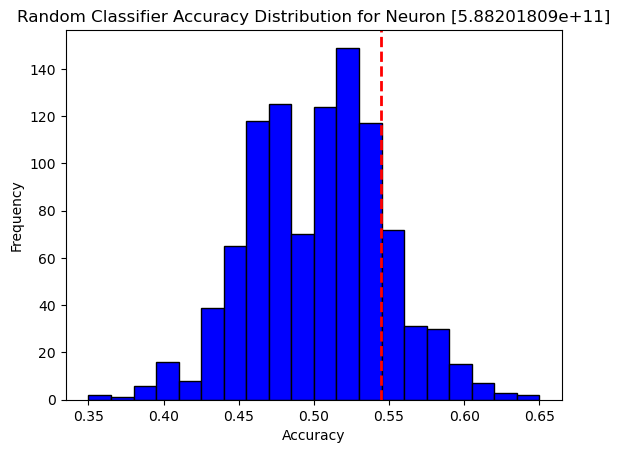

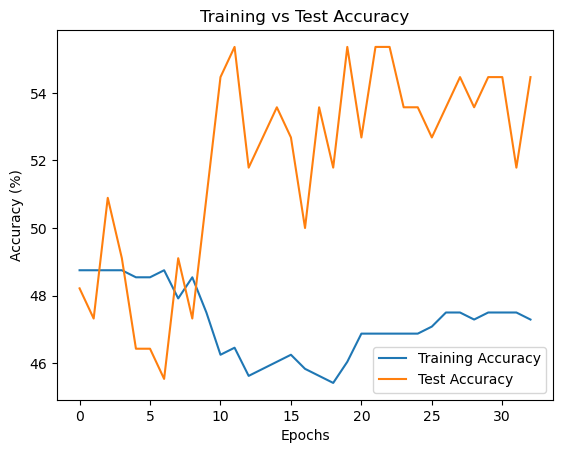

Confusion Matrix:
 [[40 22]
 [34 24]]
Class-specific Accuracy: [0.64516129 0.4137931 ]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 50.00%, p-value = 0.5440


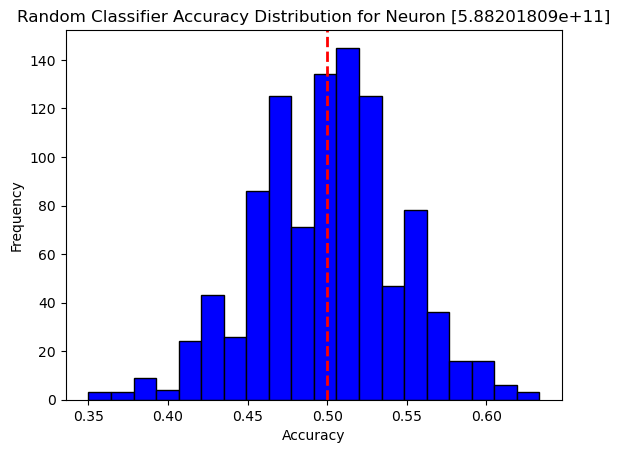

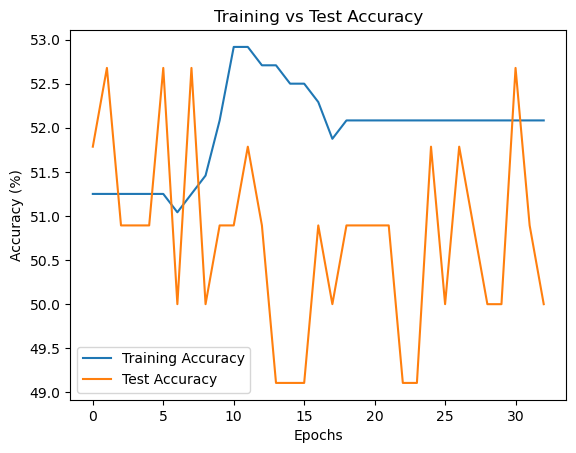

Confusion Matrix:
 [[57  5]
 [54  4]]
Class-specific Accuracy: [0.91935484 0.06896552]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 52.68%, p-value = 0.2710


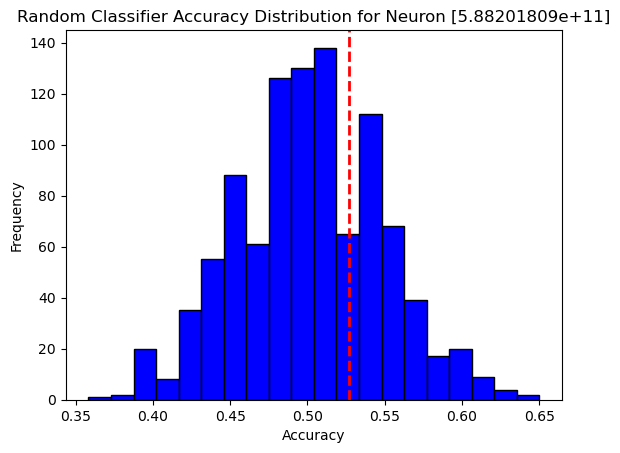

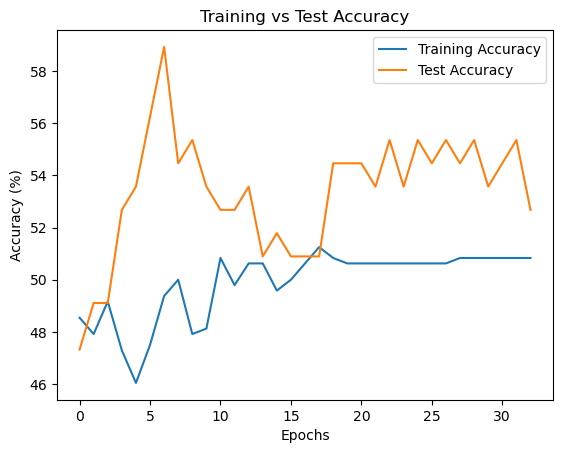

Confusion Matrix:
 [[46 16]
 [39 19]]
Class-specific Accuracy: [0.74193548 0.32758621]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 53.75%, p-value = 0.2580


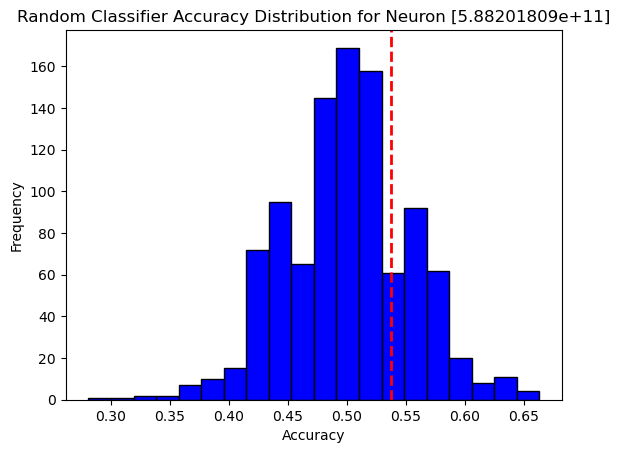

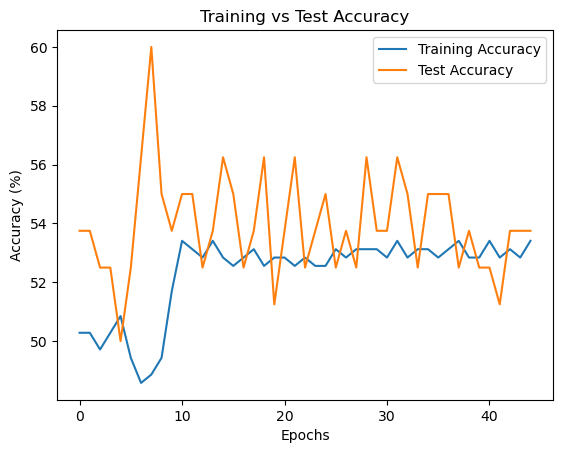

Confusion Matrix:
 [[28 19]
 [22 20]]
Class-specific Accuracy: [0.59574468 0.47619048]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 45.31%, p-value = 0.8050


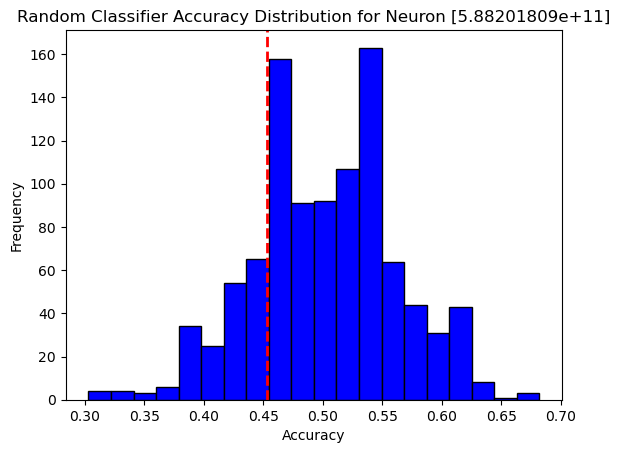

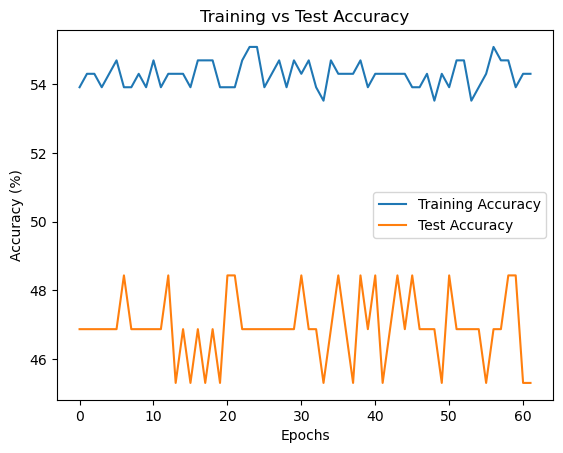

Confusion Matrix:
 [[31  0]
 [35  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 51.04%, p-value = 0.3770


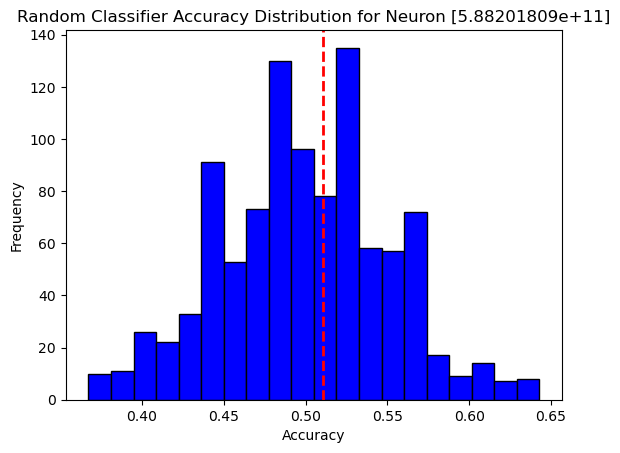

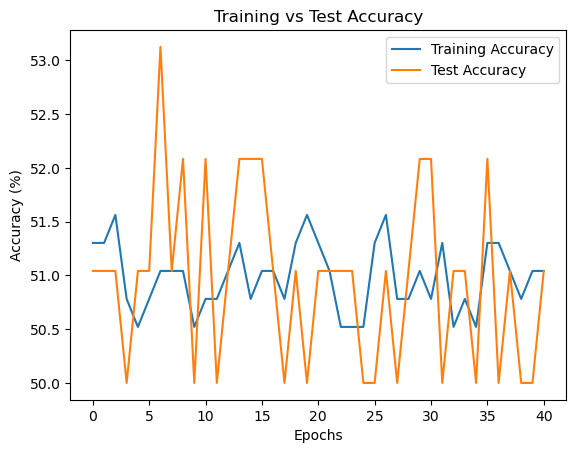

Confusion Matrix:
 [[50  0]
 [48  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 47.92%, p-value = 0.6880


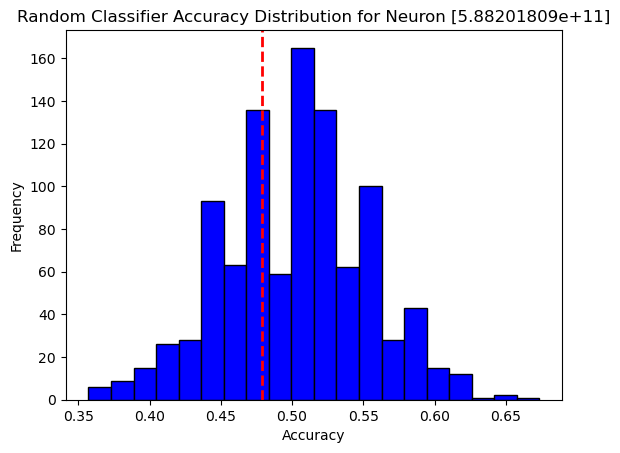

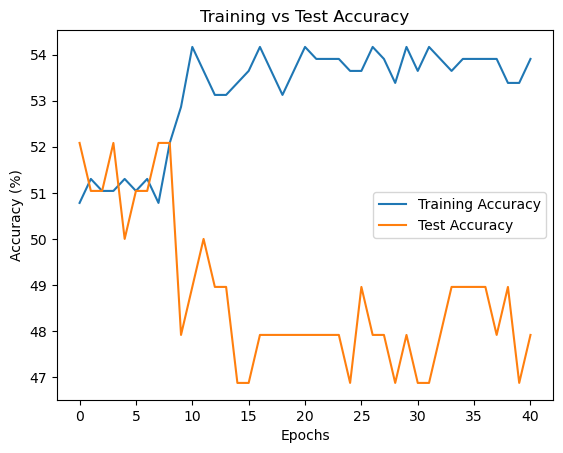

Confusion Matrix:
 [[42  8]
 [43  5]]
Class-specific Accuracy: [0.84       0.10416667]

 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 61.46%, p-value = 0.0090


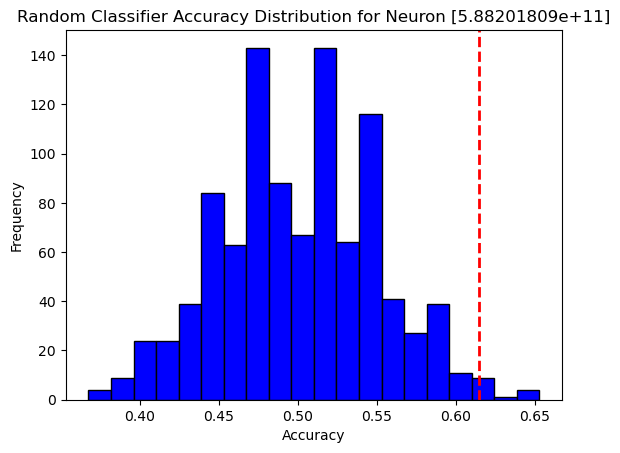

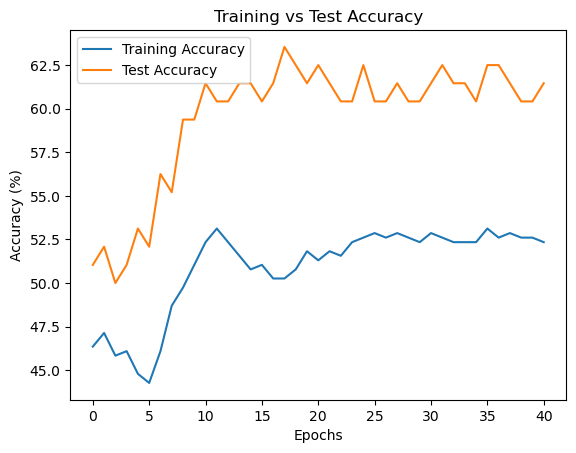

Confusion Matrix:
 [[26 24]
 [14 34]]
Class-specific Accuracy: [0.52       0.70833333]

 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 56.25%, p-value = 0.1810


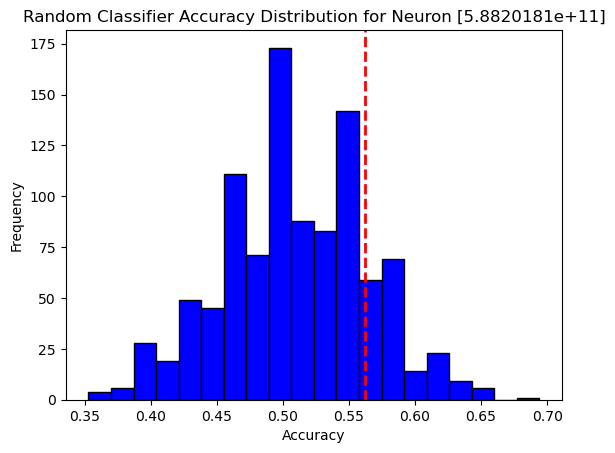

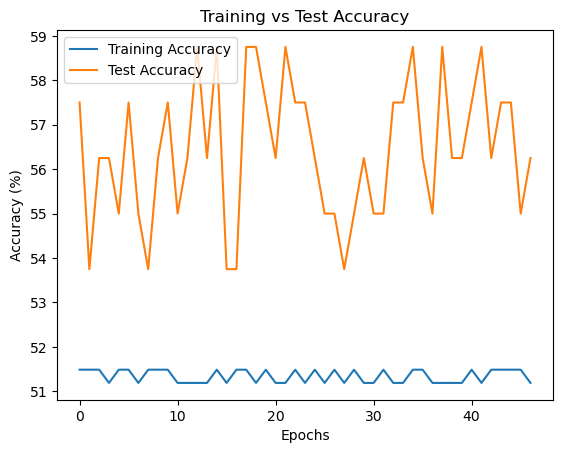

Confusion Matrix:
 [[48  0]
 [37  0]]
Class-specific Accuracy: [1. 0.]

 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 55.36%, p-value = 0.1740


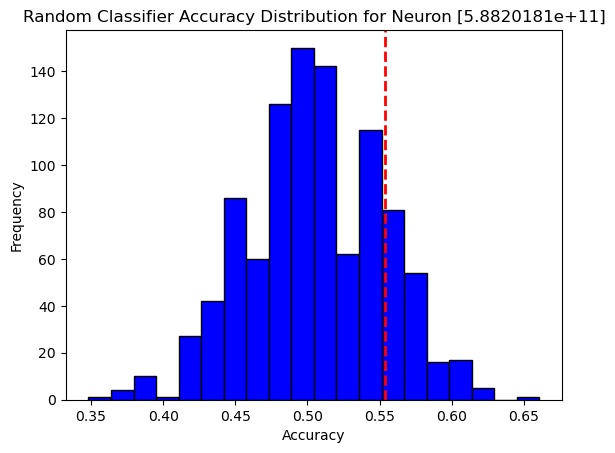

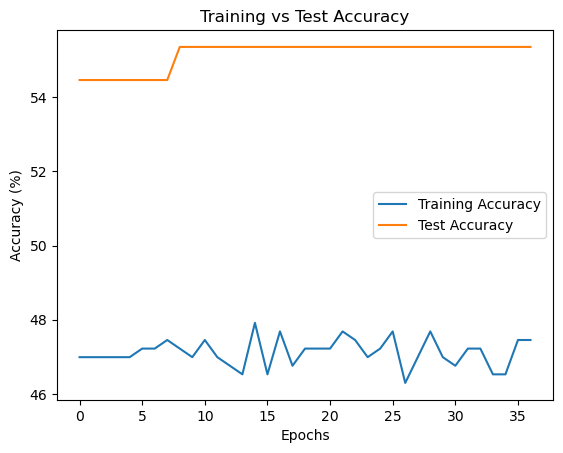

Confusion Matrix:
 [[ 1 50]
 [ 0 61]]
Class-specific Accuracy: [0.01960784 1.        ]

 [7.56201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+11]: Test Accuracy = 50.00%, p-value = 0.5110


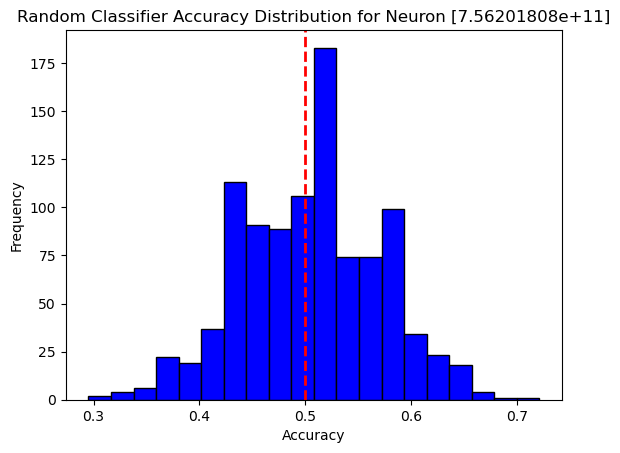

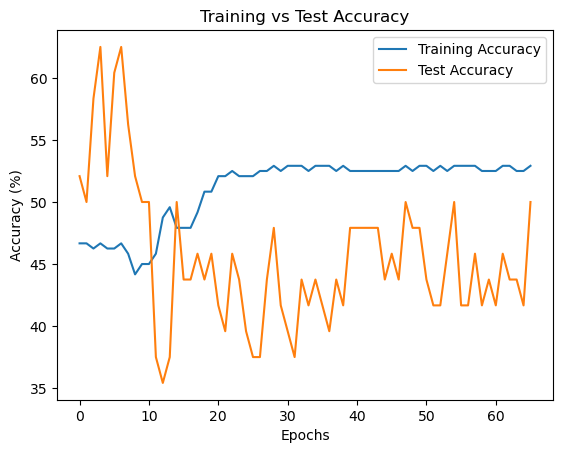

Confusion Matrix:
 [[ 4 30]
 [ 4 23]]
Class-specific Accuracy: [0.11764706 0.85185185]

 [7.56201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+11]: Test Accuracy = 66.67%, p-value = 0.0070


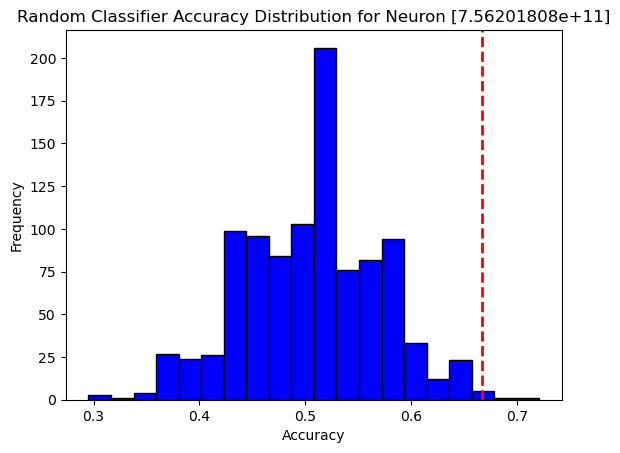

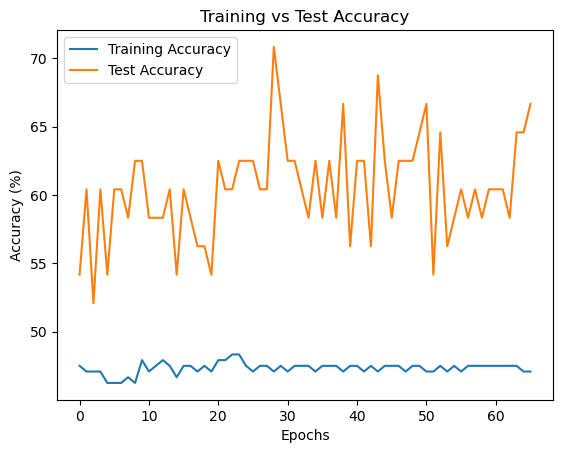

Confusion Matrix:
 [[29  5]
 [19  8]]
Class-specific Accuracy: [0.85294118 0.2962963 ]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 50.00%, p-value = 0.4830


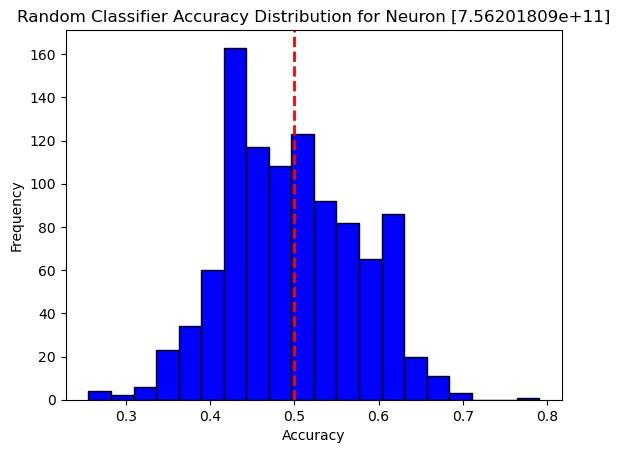

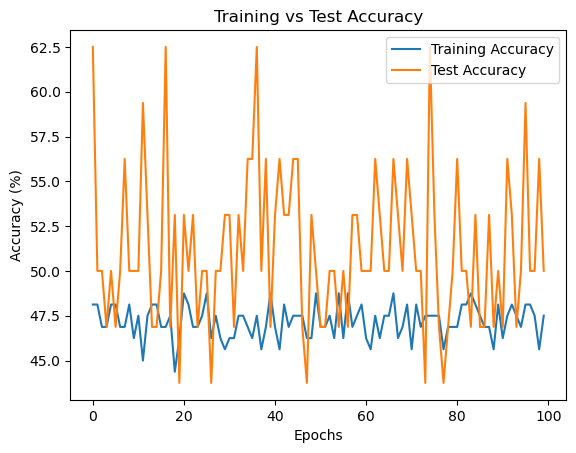

Confusion Matrix:
 [[22  0]
 [21  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 50.00%, p-value = 0.4930


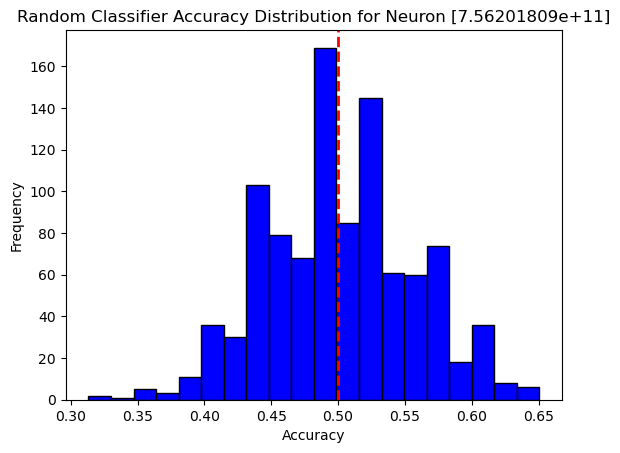

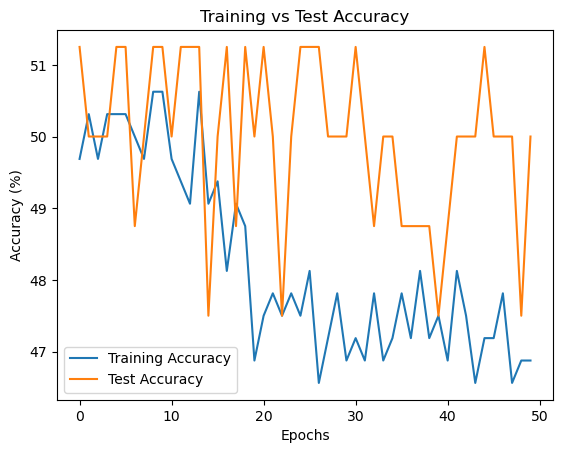

Confusion Matrix:
 [[ 1 40]
 [ 2 40]]
Class-specific Accuracy: [0.02439024 0.95238095]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 52.50%, p-value = 0.3260


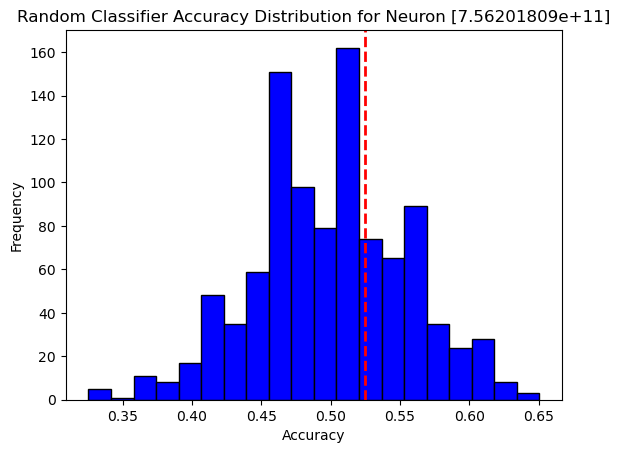

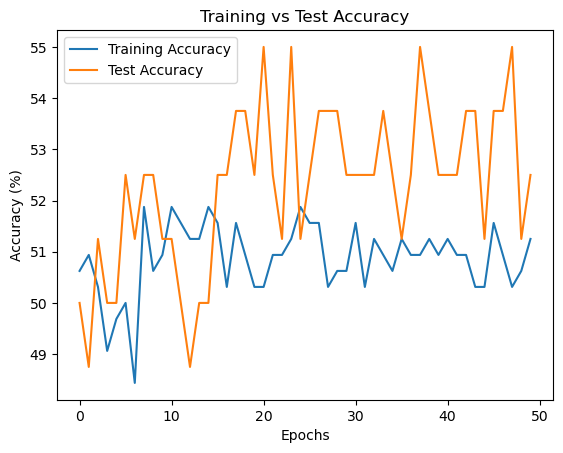

Confusion Matrix:
 [[35  6]
 [33  9]]
Class-specific Accuracy: [0.85365854 0.21428571]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 48.75%, p-value = 0.5520


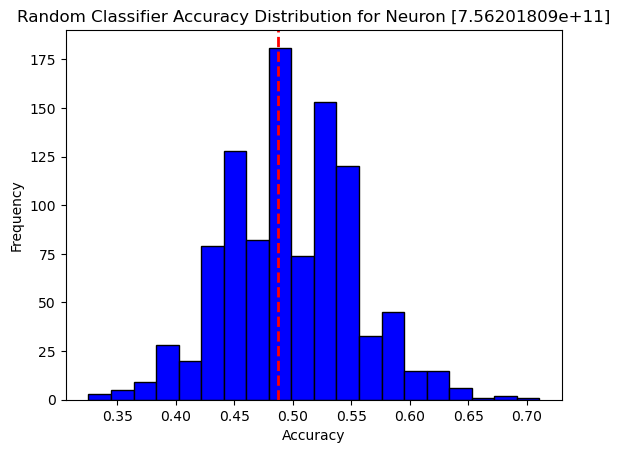

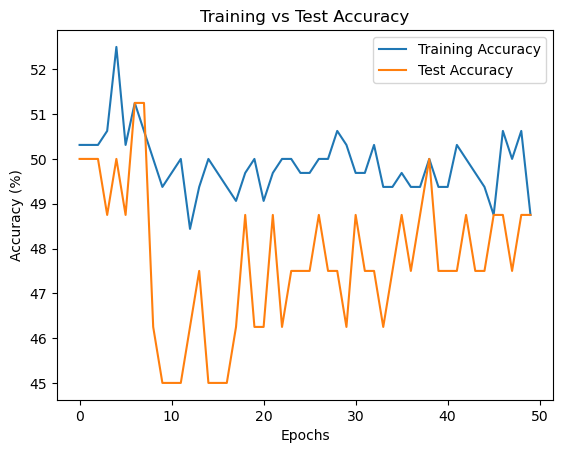

Confusion Matrix:
 [[ 4 37]
 [ 6 36]]
Class-specific Accuracy: [0.09756098 0.85714286]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 50.00%, p-value = 0.4660


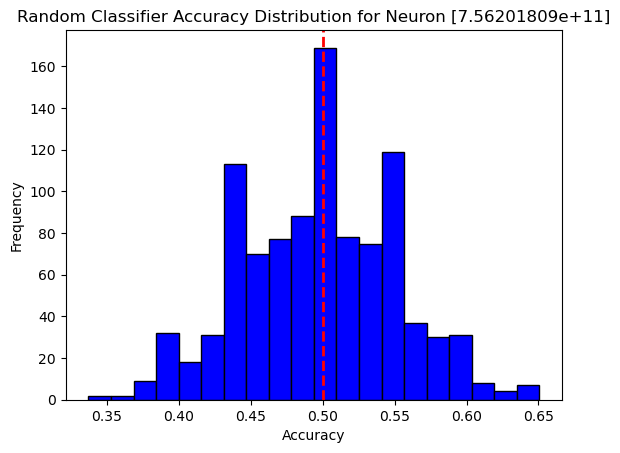

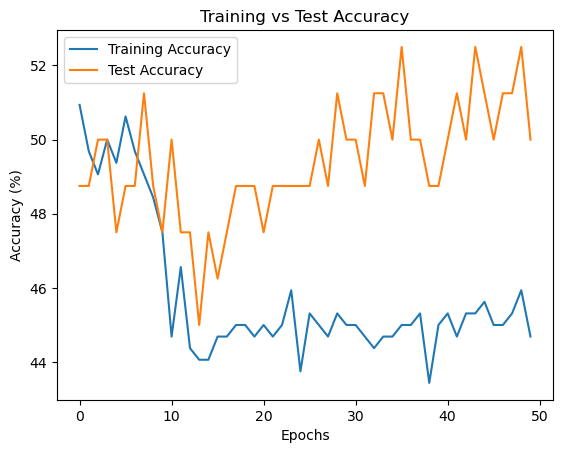

Confusion Matrix:
 [[24 17]
 [24 18]]
Class-specific Accuracy: [0.58536585 0.42857143]

 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 50.00%, p-value = 0.4890


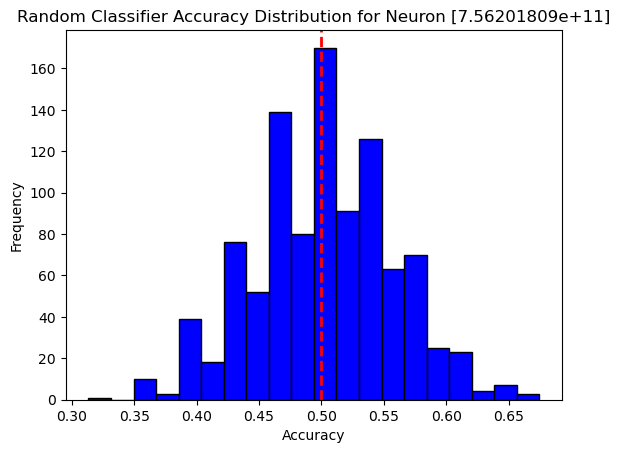

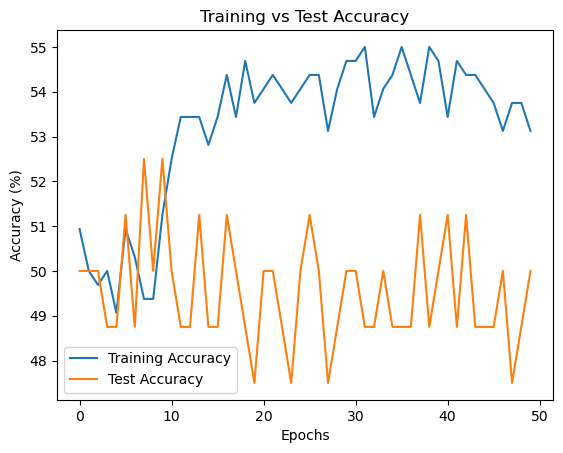

Confusion Matrix:
 [[35  6]
 [36  6]]
Class-specific Accuracy: [0.85365854 0.14285714]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 50.89%, p-value = 0.4480


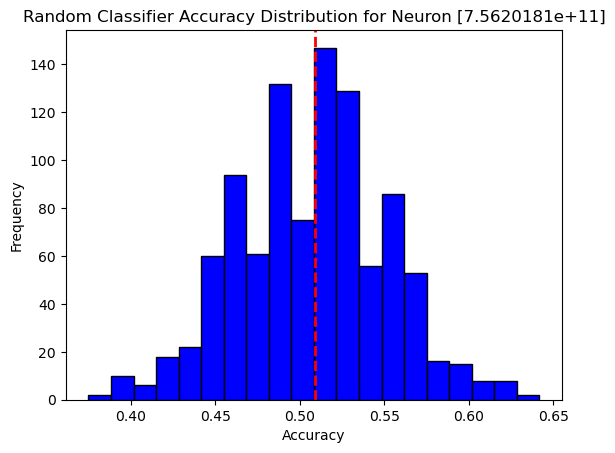

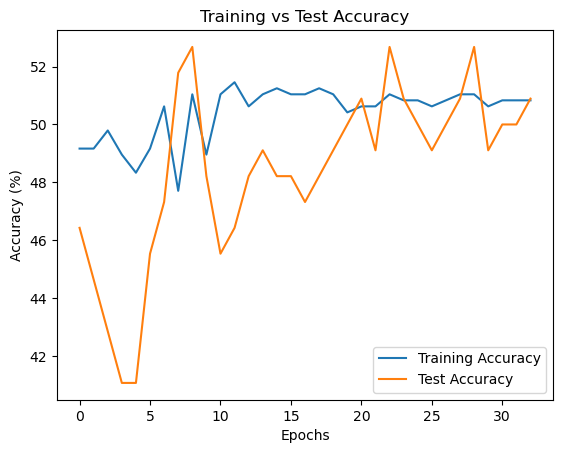

Confusion Matrix:
 [[50 17]
 [42 11]]
Class-specific Accuracy: [0.74626866 0.20754717]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.54%, p-value = 0.8710


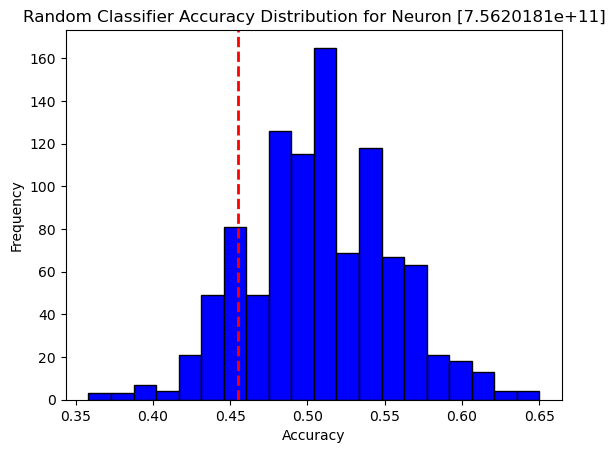

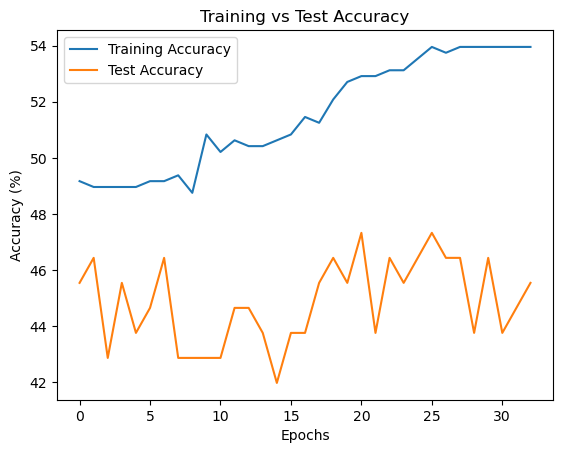

Confusion Matrix:
 [[13 54]
 [12 41]]
Class-specific Accuracy: [0.19402985 0.77358491]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 49.11%, p-value = 0.6880


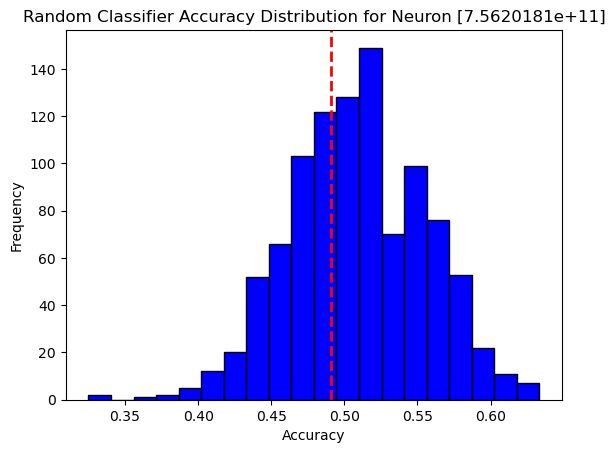

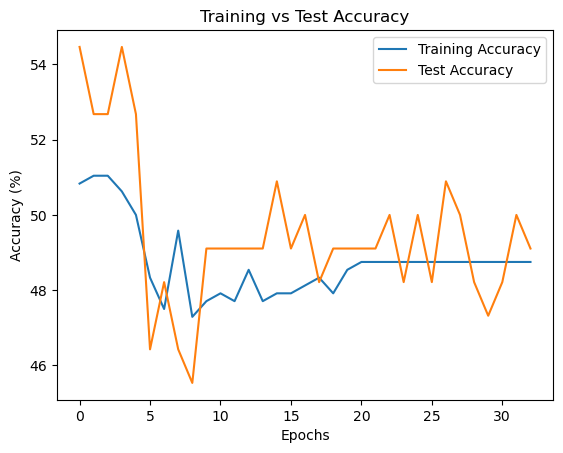

Confusion Matrix:
 [[46 21]
 [40 13]]
Class-specific Accuracy: [0.68656716 0.24528302]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.83%, p-value = 0.8030


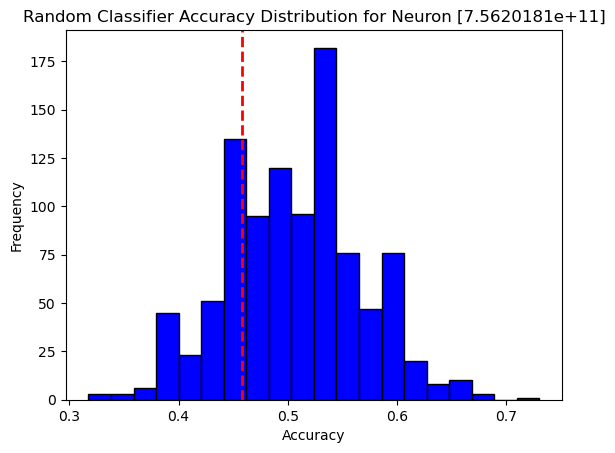

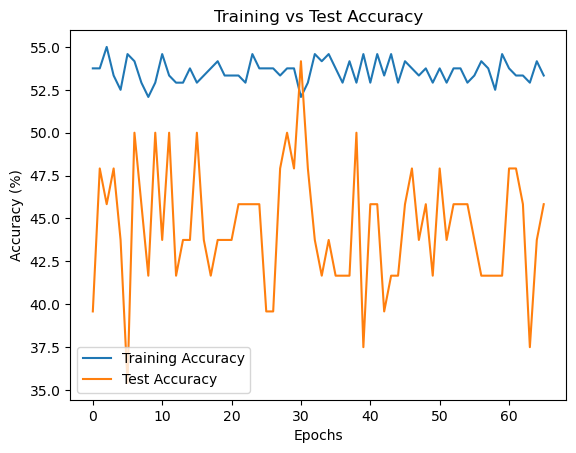

Confusion Matrix:
 [[ 0 35]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 43.75%, p-value = 0.8530


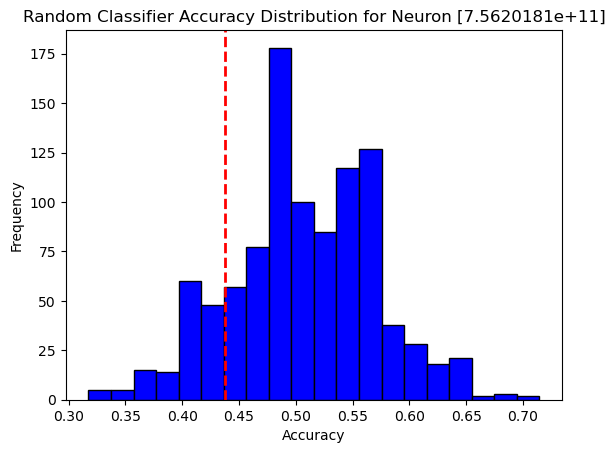

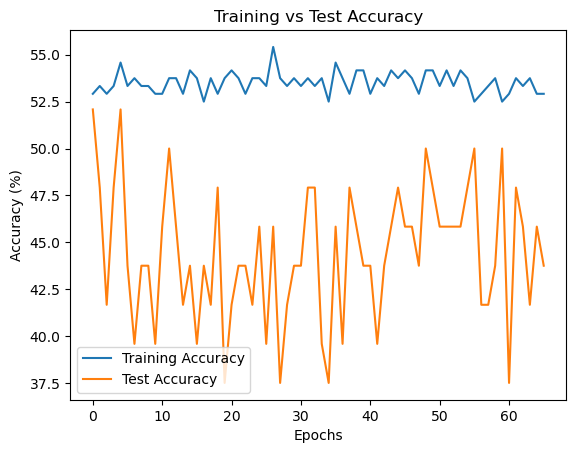

Confusion Matrix:
 [[ 0 35]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 41.67%, p-value = 0.9130


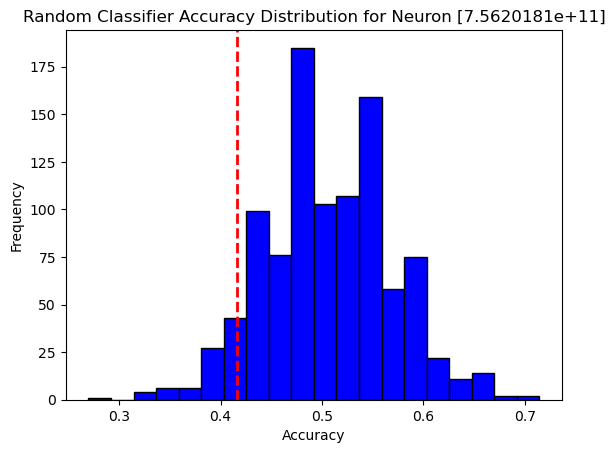

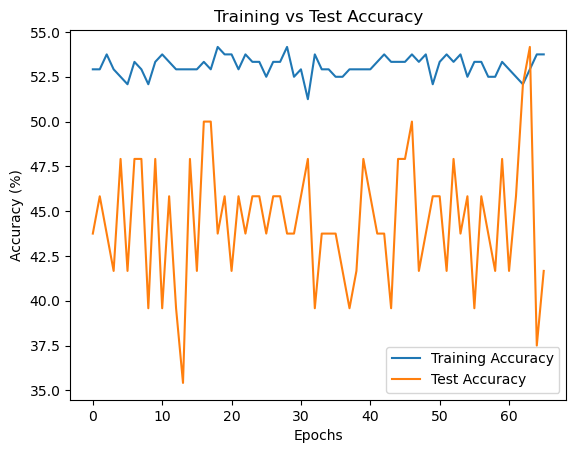

Confusion Matrix:
 [[ 0 35]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 56.25%, p-value = 0.2220


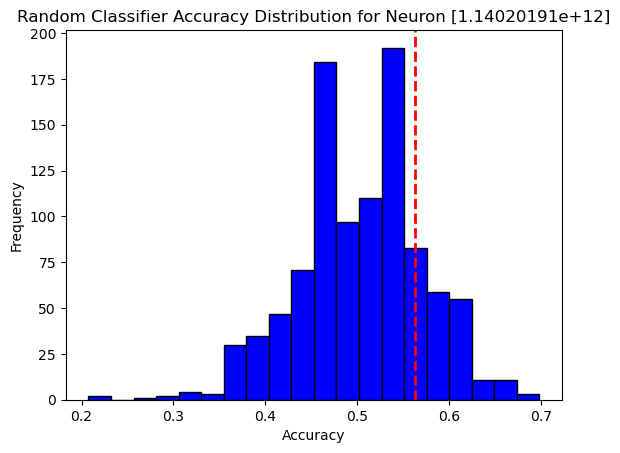

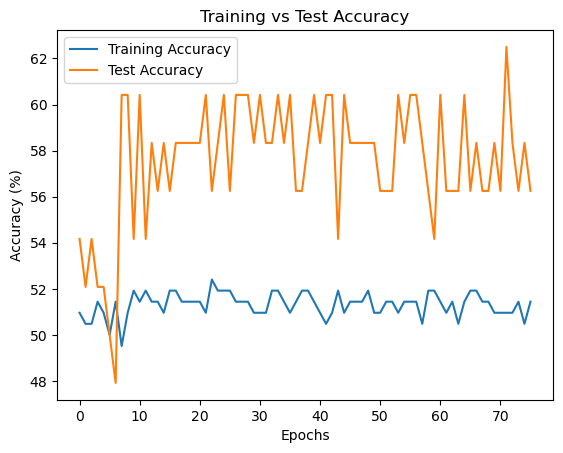

Confusion Matrix:
 [[ 4 21]
 [ 1 27]]
Class-specific Accuracy: [0.16       0.96428571]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 65.62%, p-value = 0.0020


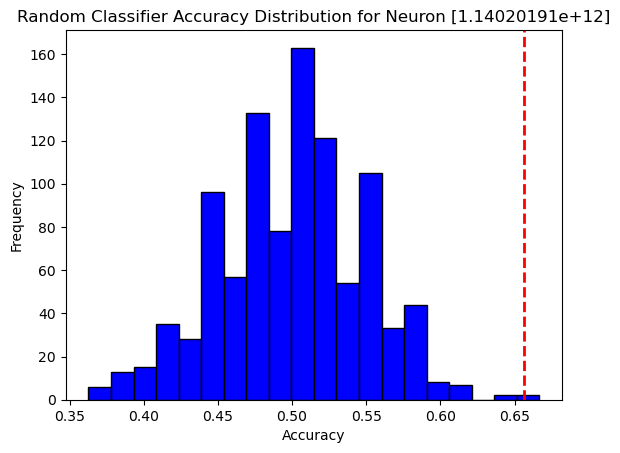

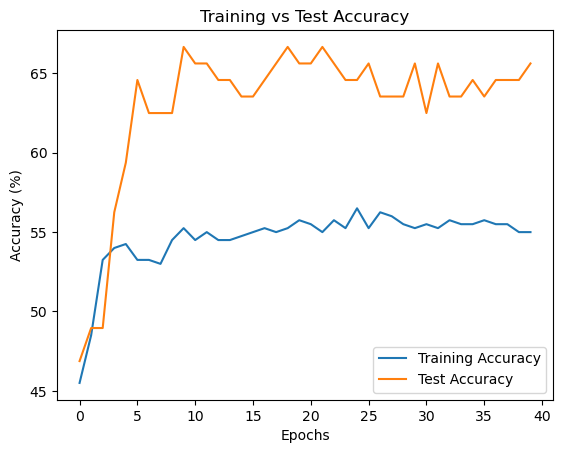

Confusion Matrix:
 [[46  7]
 [29 20]]
Class-specific Accuracy: [0.86792453 0.40816327]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 51.04%, p-value = 0.3850


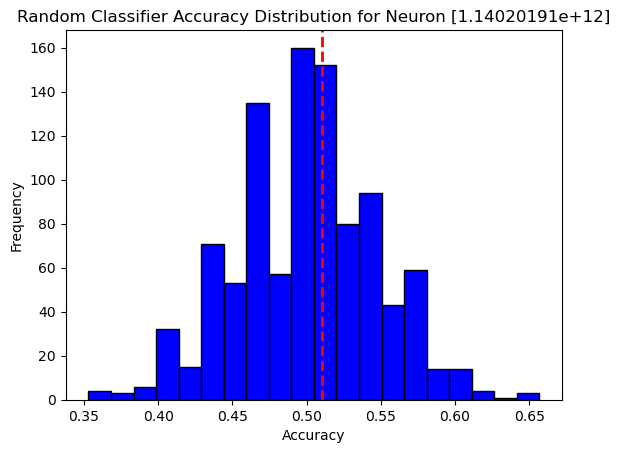

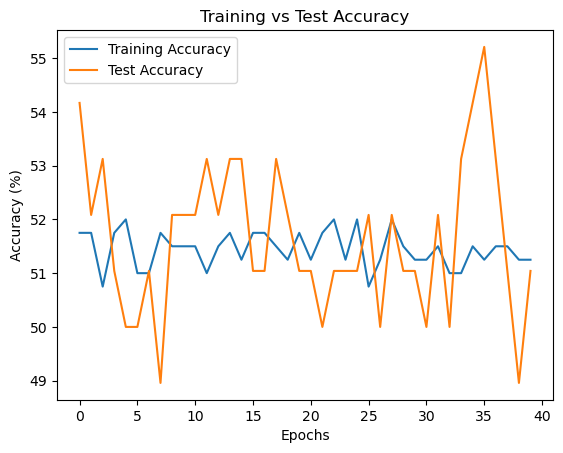

Confusion Matrix:
 [[53  0]
 [49  0]]
Class-specific Accuracy: [1. 0.]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 50.00%, p-value = 0.5270


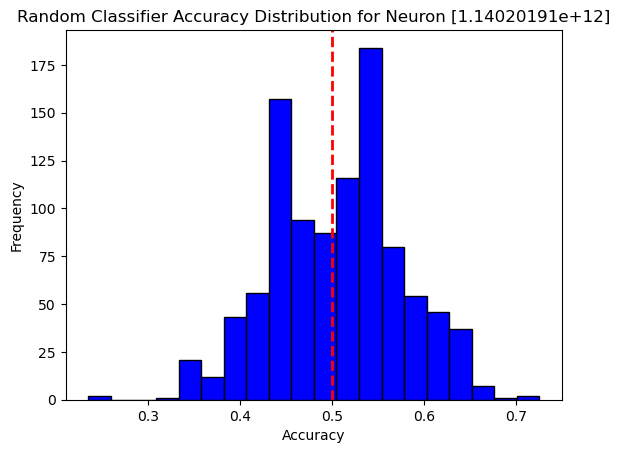

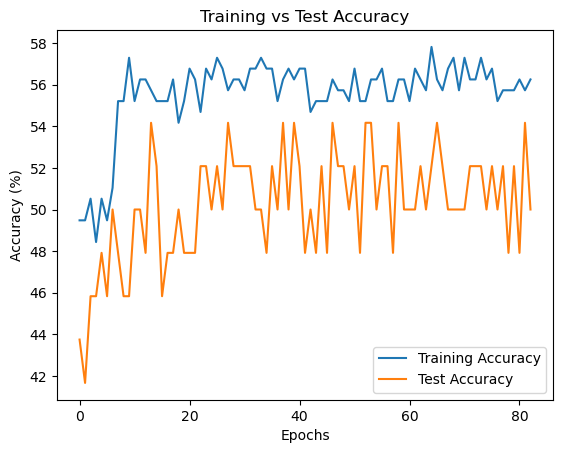

Confusion Matrix:
 [[17  6]
 [19  9]]
Class-specific Accuracy: [0.73913043 0.32142857]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 48.44%, p-value = 0.6770


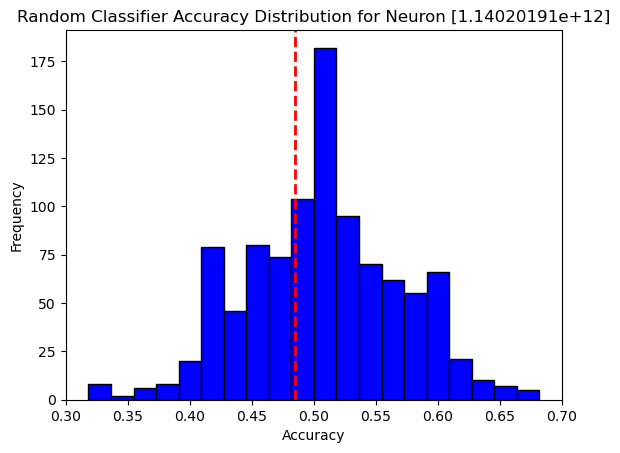

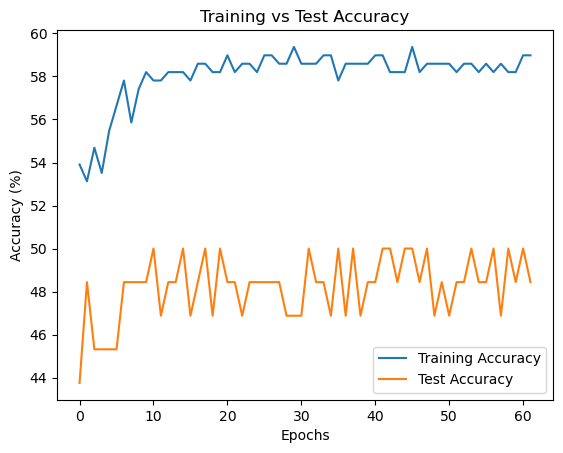

Confusion Matrix:
 [[25  5]
 [29  7]]
Class-specific Accuracy: [0.83333333 0.19444444]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 46.88%, p-value = 0.7580


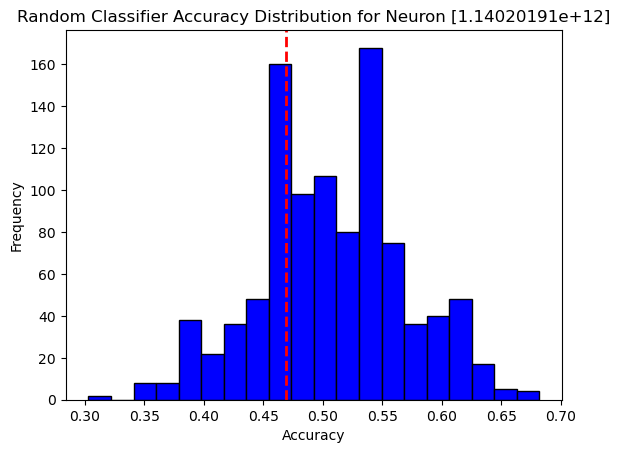

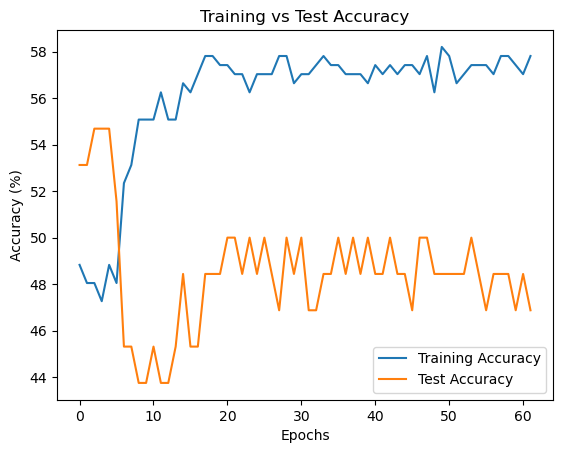

Confusion Matrix:
 [[17 13]
 [21 15]]
Class-specific Accuracy: [0.56666667 0.41666667]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 43.75%, p-value = 0.8800


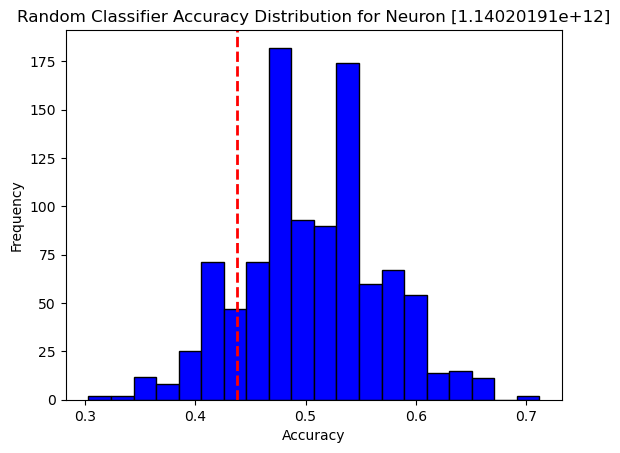

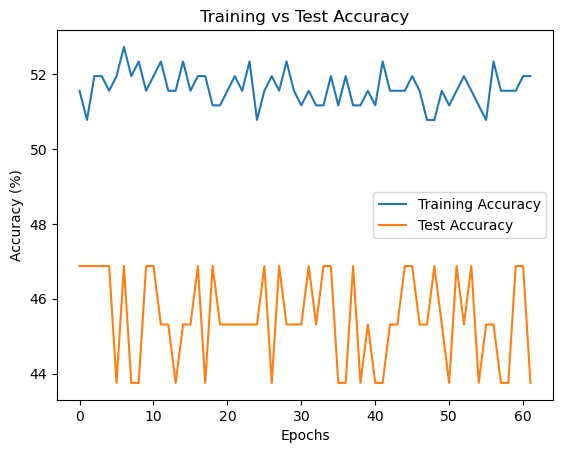

Confusion Matrix:
 [[30  0]
 [36  0]]
Class-specific Accuracy: [1. 0.]

 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 62.50%, p-value = 0.0150


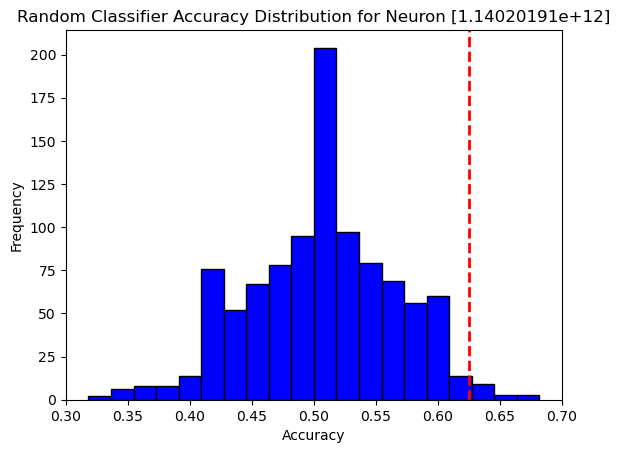

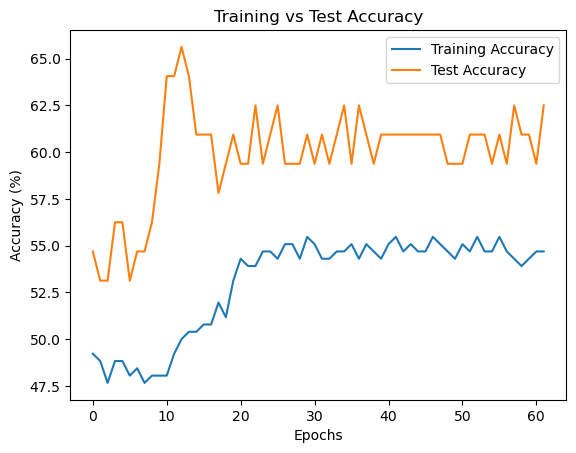

Confusion Matrix:
 [[12 18]
 [ 8 28]]
Class-specific Accuracy: [0.4        0.77777778]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 75.00%, p-value = 0.0000


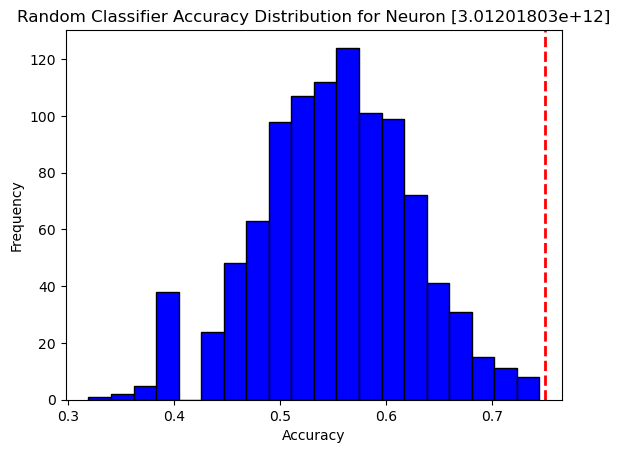

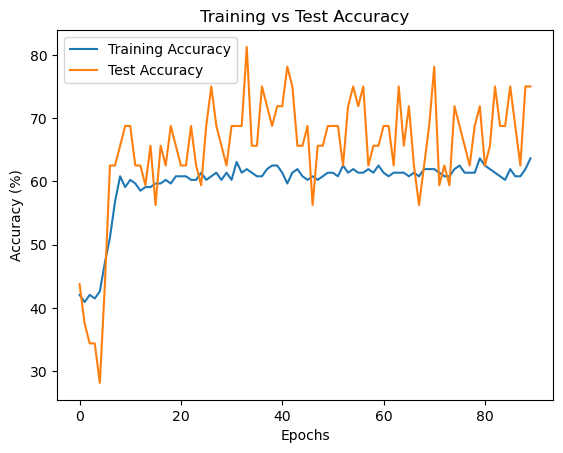

Confusion Matrix:
 [[29  1]
 [14  3]]
Class-specific Accuracy: [0.96666667 0.17647059]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 62.50%, p-value = 0.0970


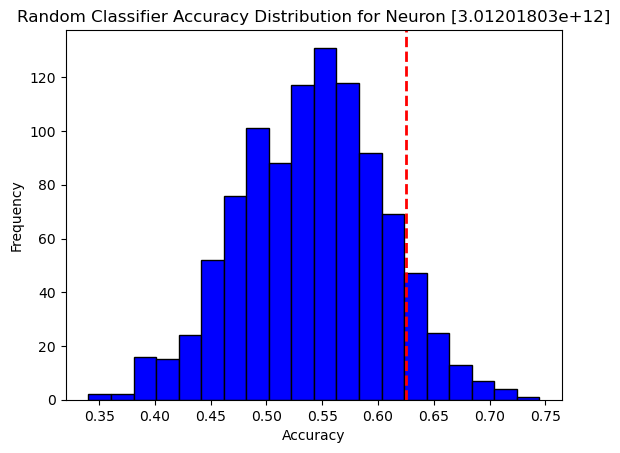

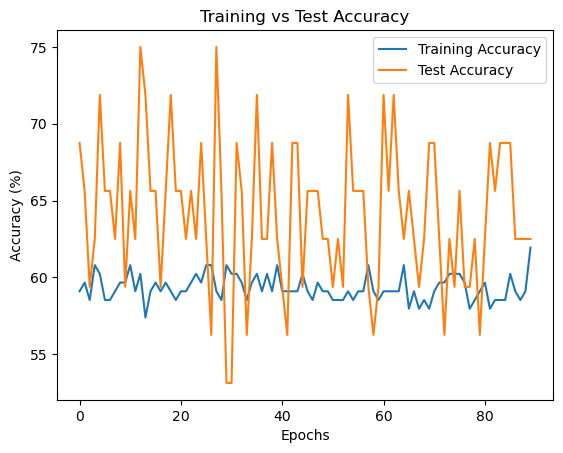

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 59.38%, p-value = 0.2390


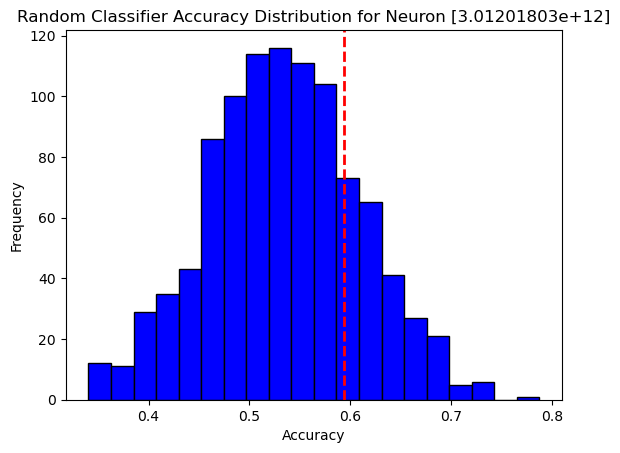

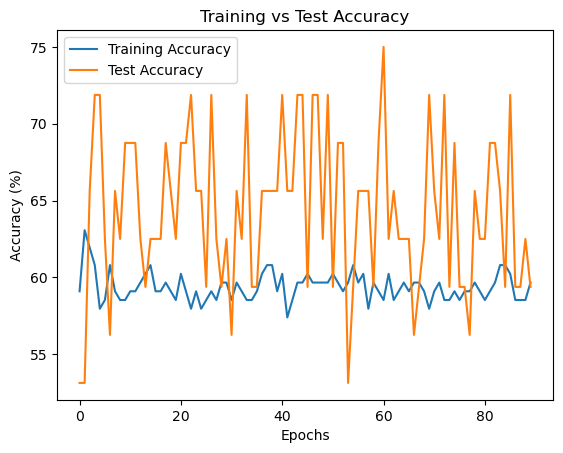

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 34.38%, p-value = 0.9940


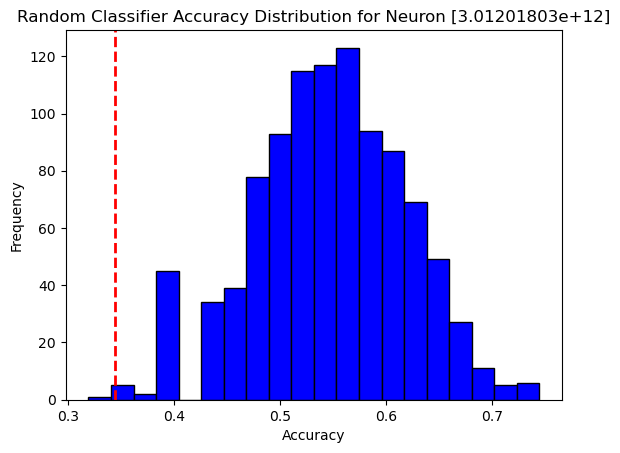

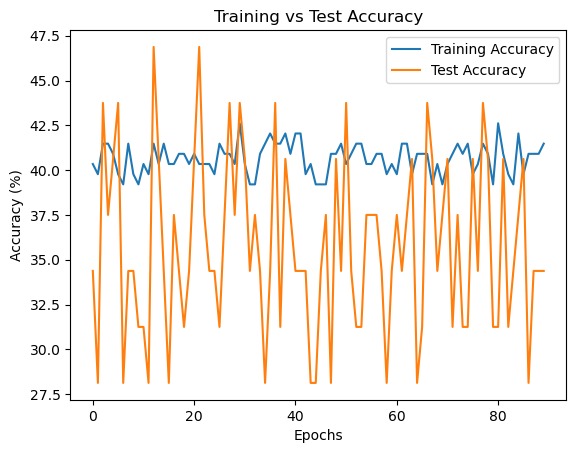

Confusion Matrix:
 [[ 0 30]
 [ 0 17]]
Class-specific Accuracy: [0. 1.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 43.75%, p-value = 0.9390


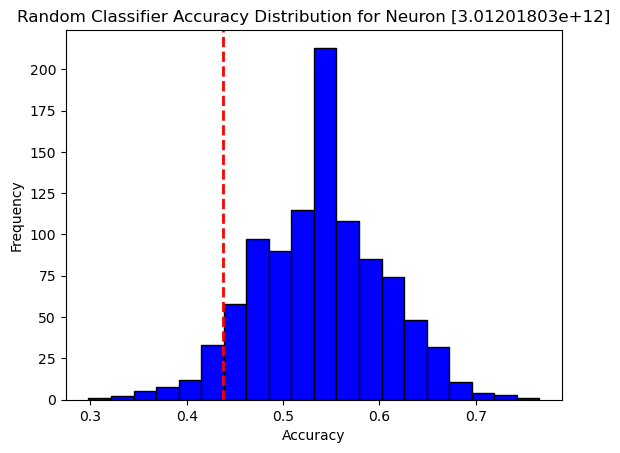

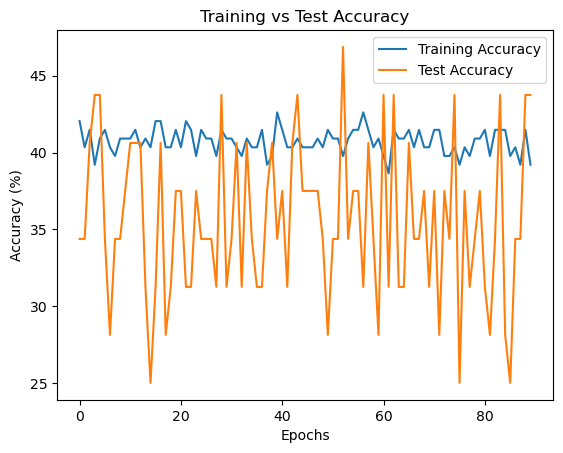

Confusion Matrix:
 [[ 0 30]
 [ 0 17]]
Class-specific Accuracy: [0. 1.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 65.62%, p-value = 0.0550


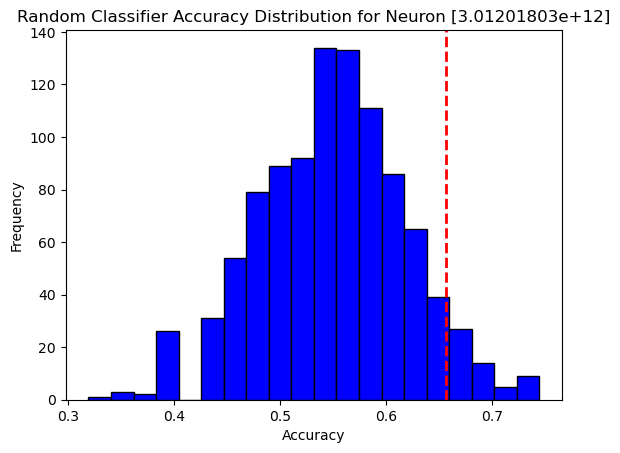

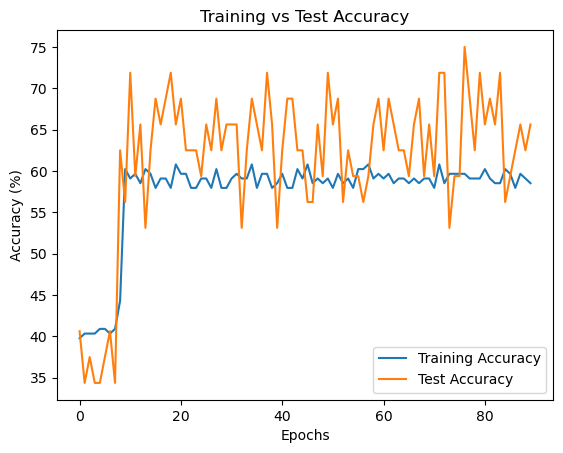

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 40.62%, p-value = 0.9580


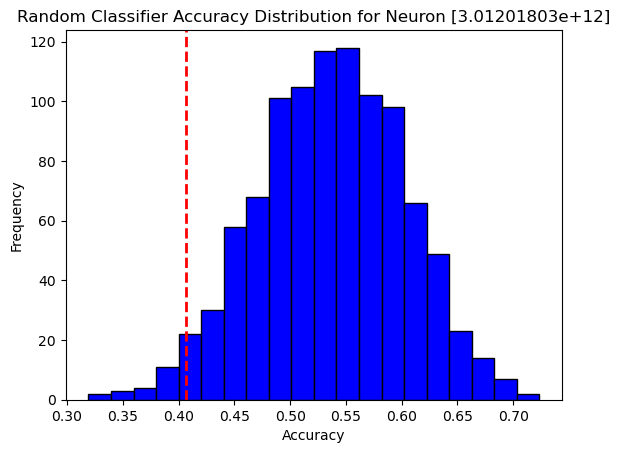

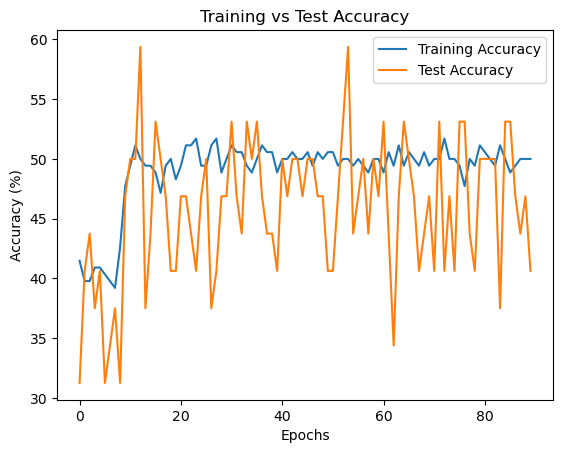

Confusion Matrix:
 [[16 14]
 [11  6]]
Class-specific Accuracy: [0.53333333 0.35294118]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 56.25%, p-value = 0.3460


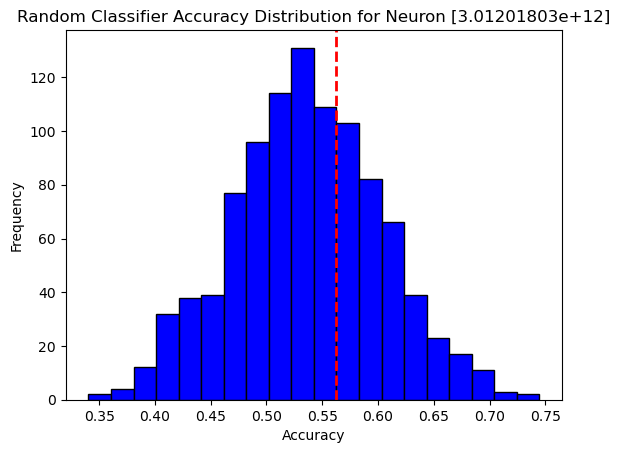

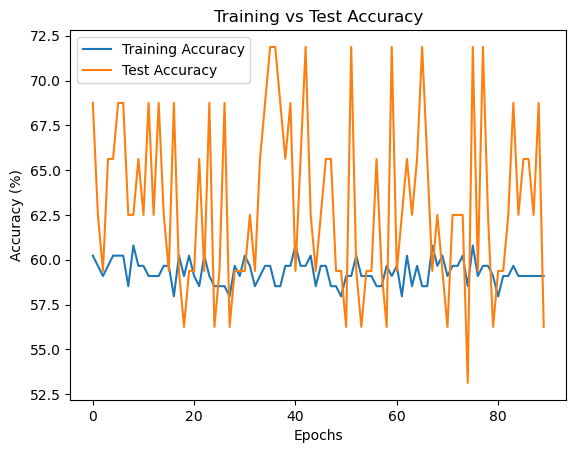

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 65.62%, p-value = 0.0640


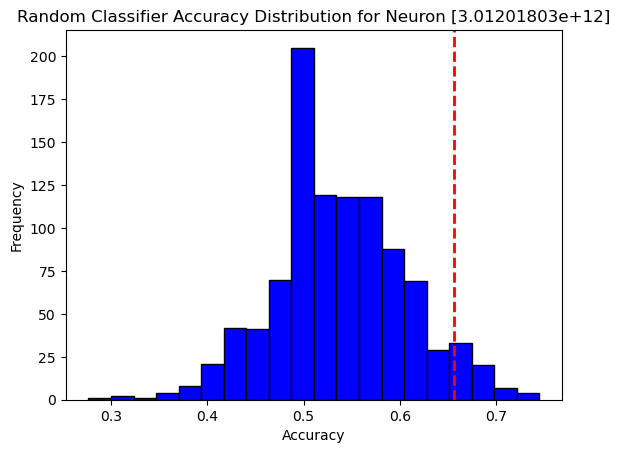

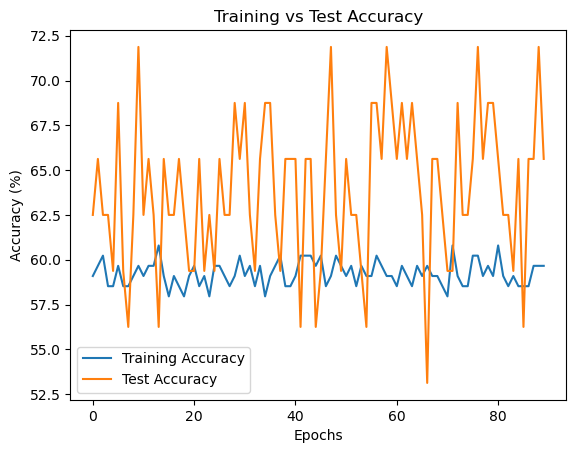

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 68.75%, p-value = 0.0200


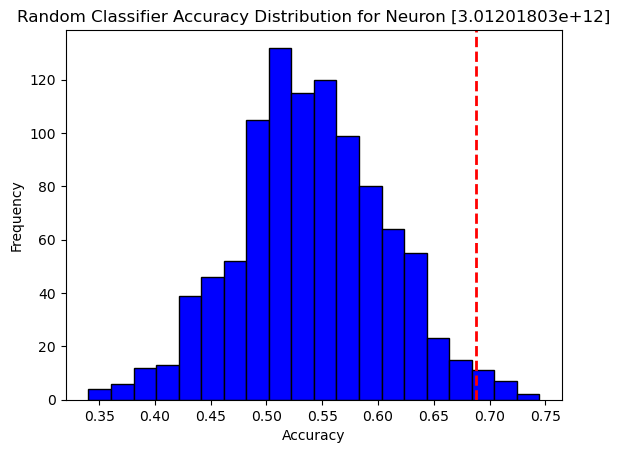

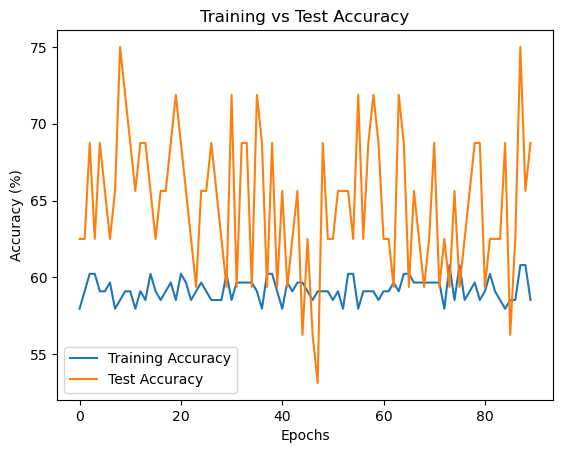

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 53.12%, p-value = 0.5860


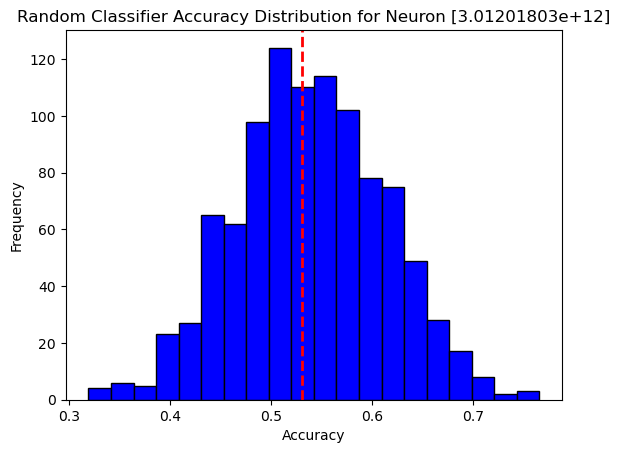

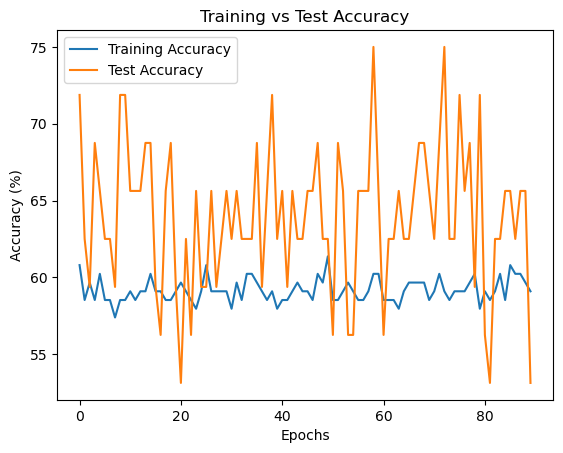

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 31.25%, p-value = 0.9990


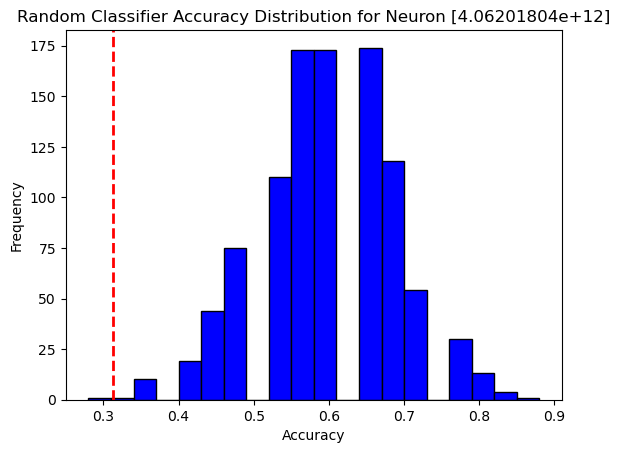

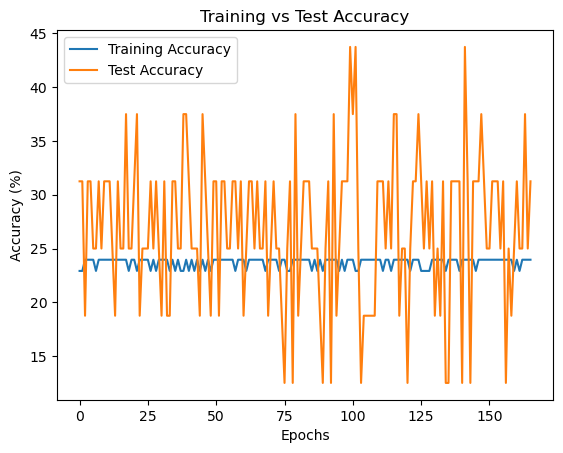

Confusion Matrix:
 [[ 7  0]
 [18  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 68.75%, p-value = 0.1260


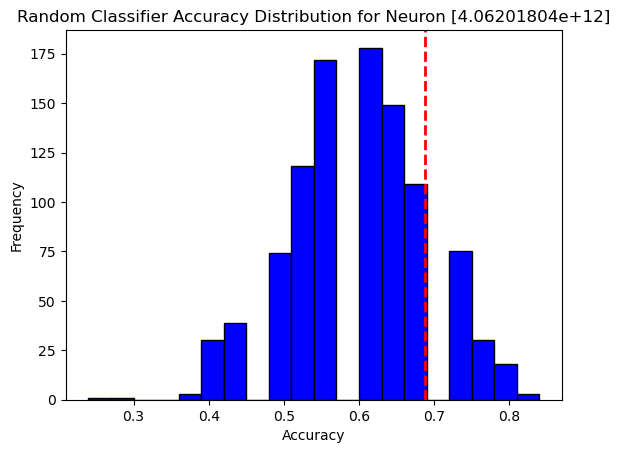

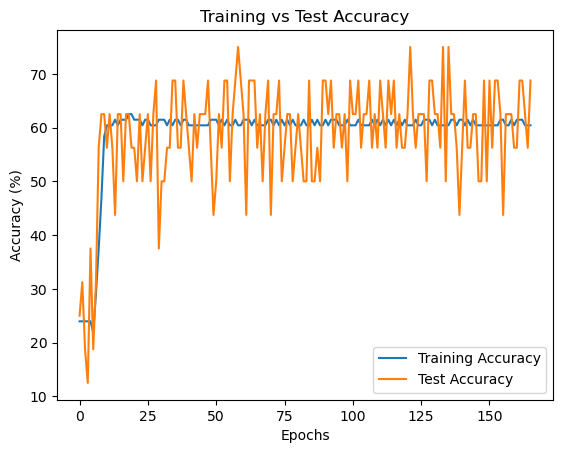

Confusion Matrix:
 [[ 0  7]
 [ 3 15]]
Class-specific Accuracy: [0.         0.83333333]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 75.00%, p-value = 0.0510


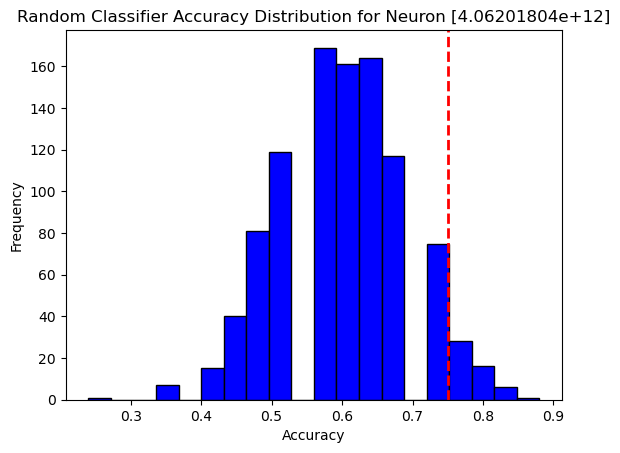

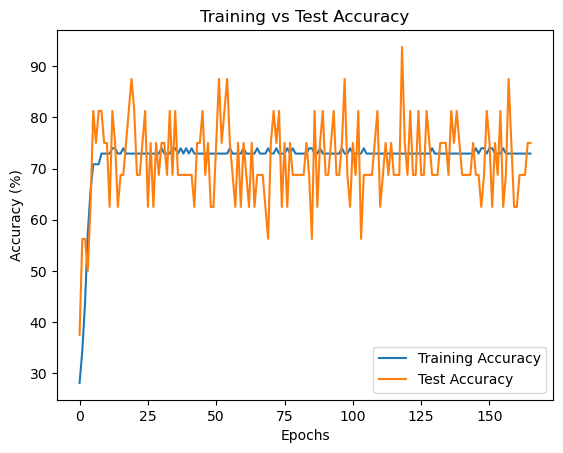

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 68.75%, p-value = 0.1180


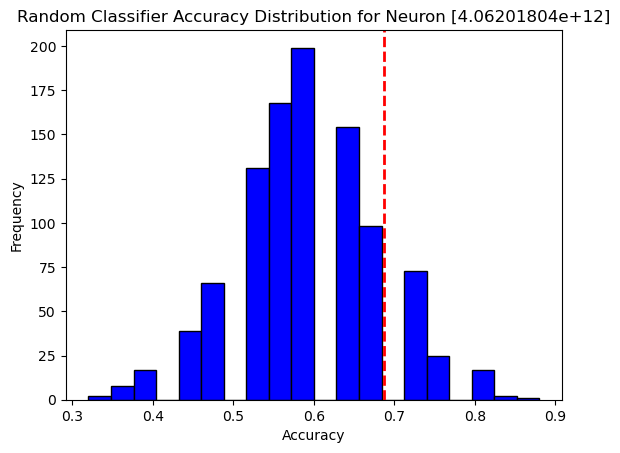

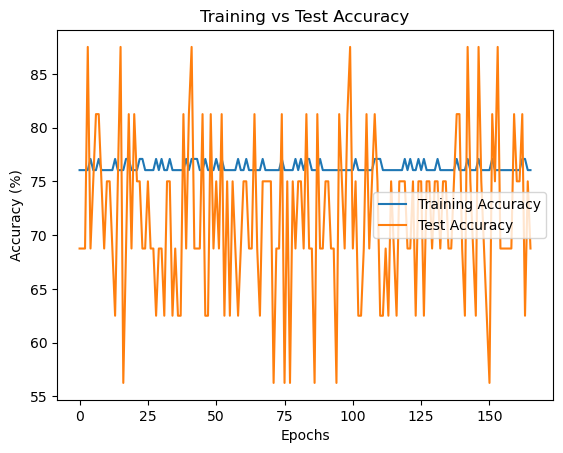

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 68.75%, p-value = 0.1190


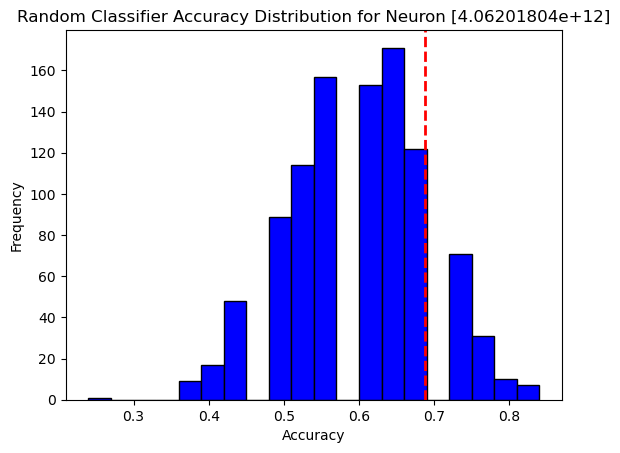

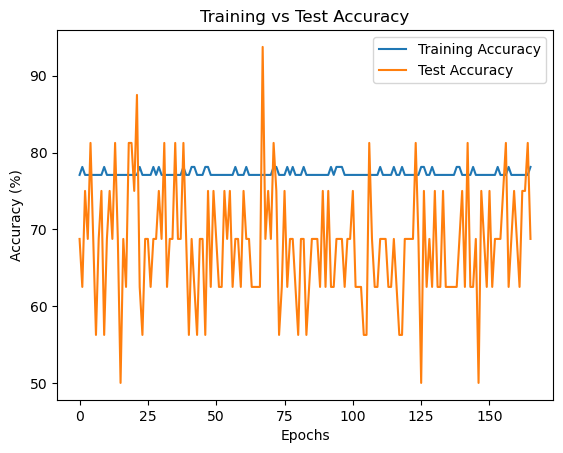

Confusion Matrix:
 [[ 0  7]
 [ 1 17]]
Class-specific Accuracy: [0.         0.94444444]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 75.00%, p-value = 0.0340


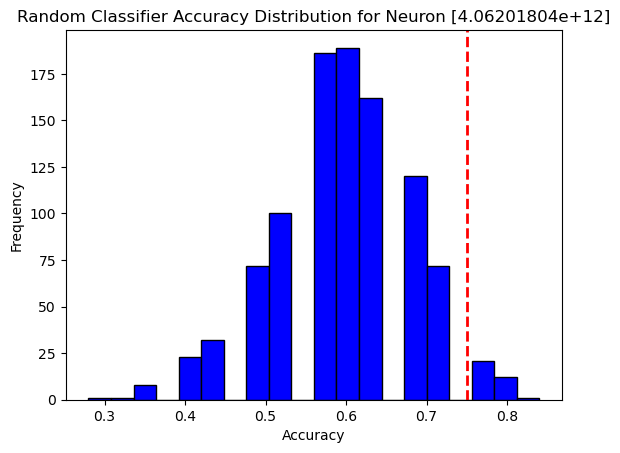

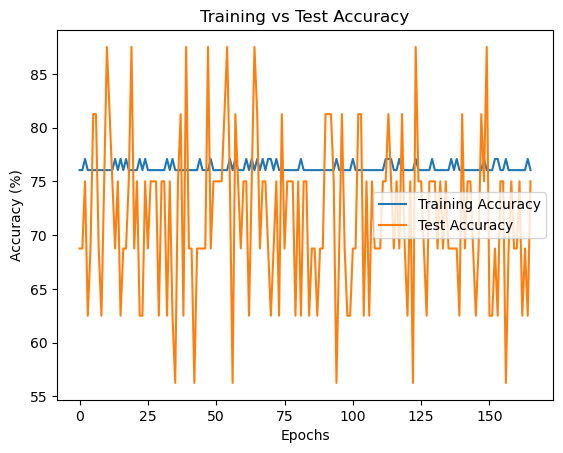

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 62.50%, p-value = 0.3980


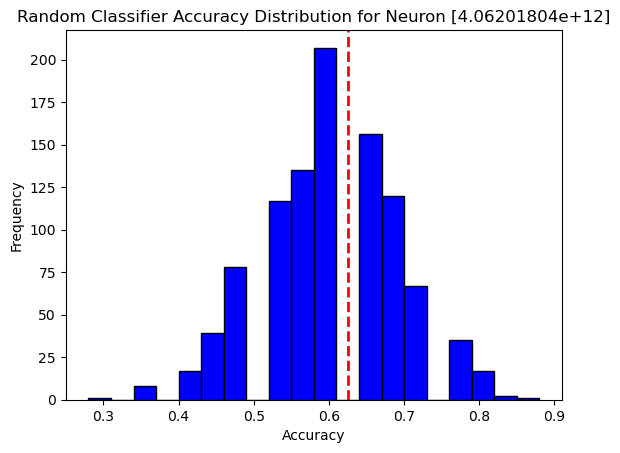

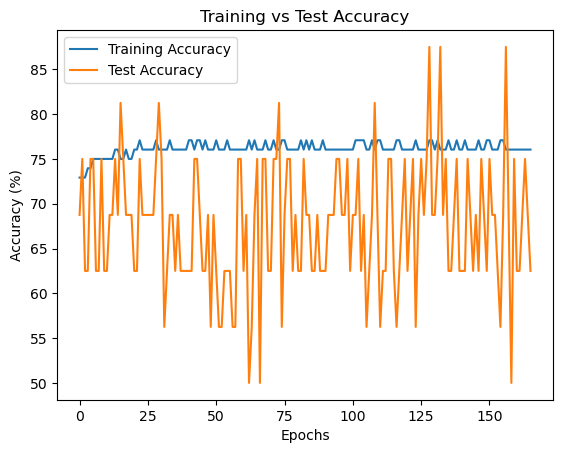

Confusion Matrix:
 [[ 0  7]
 [ 1 17]]
Class-specific Accuracy: [0.         0.94444444]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 45.00%, p-value = 0.8640


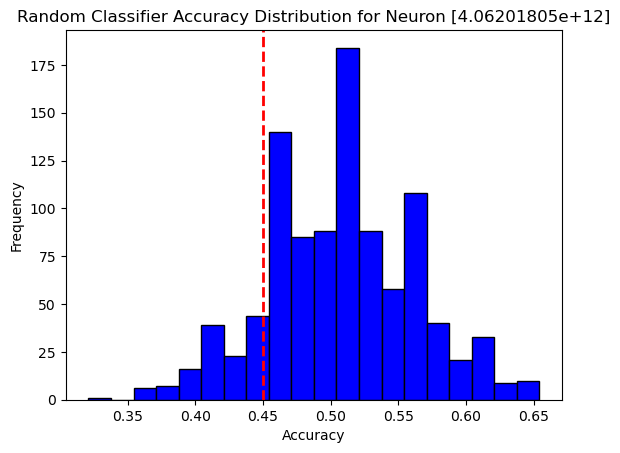

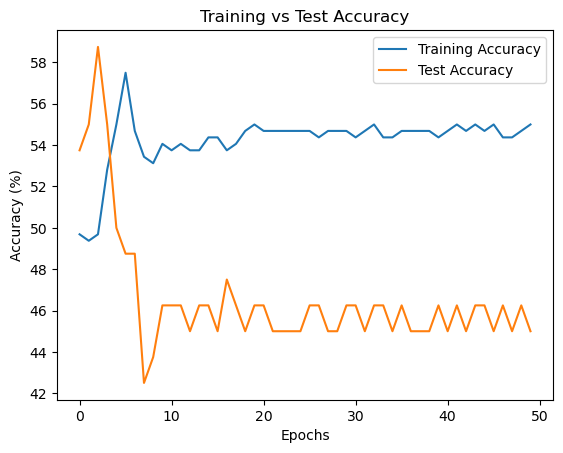

Confusion Matrix:
 [[24 12]
 [32 13]]
Class-specific Accuracy: [0.66666667 0.28888889]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 55.00%, p-value = 0.2020


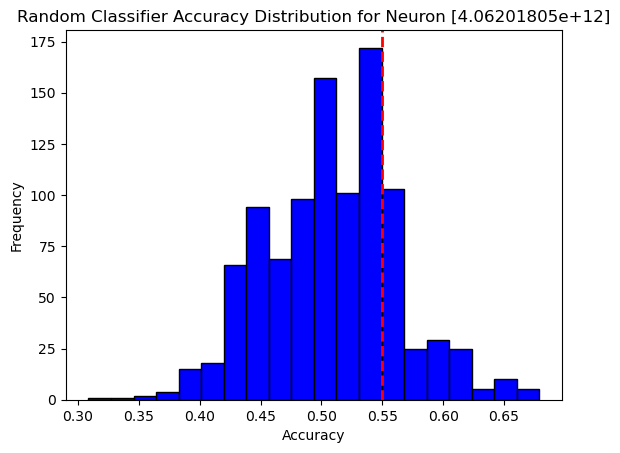

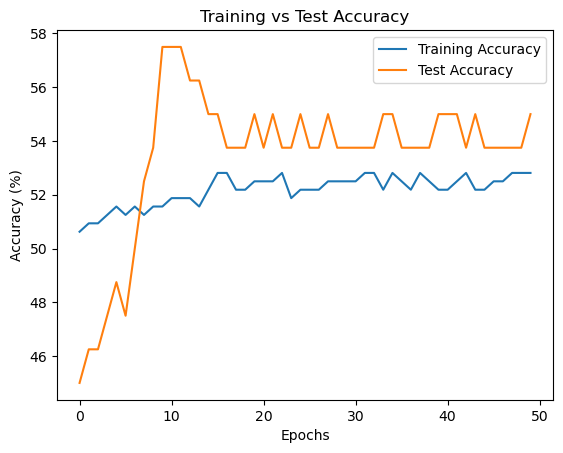

Confusion Matrix:
 [[32  4]
 [33 12]]
Class-specific Accuracy: [0.88888889 0.26666667]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 52.50%, p-value = 0.3710


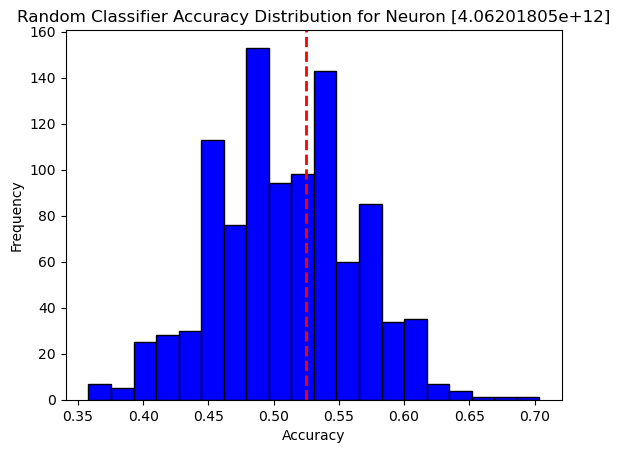

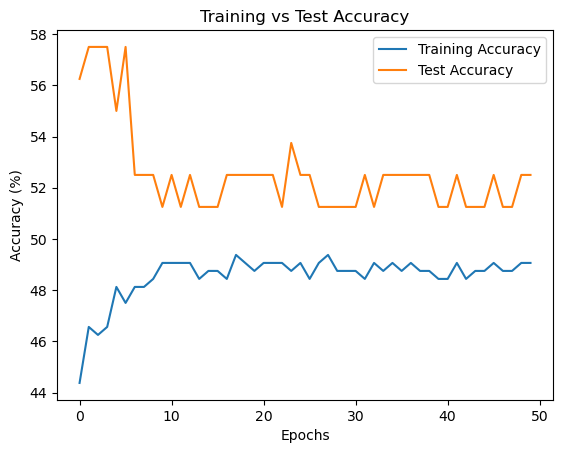

Confusion Matrix:
 [[21 15]
 [24 21]]
Class-specific Accuracy: [0.58333333 0.46666667]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 50.00%, p-value = 0.5500


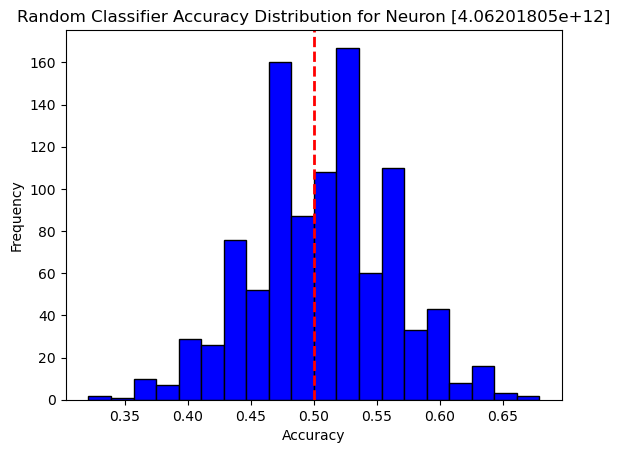

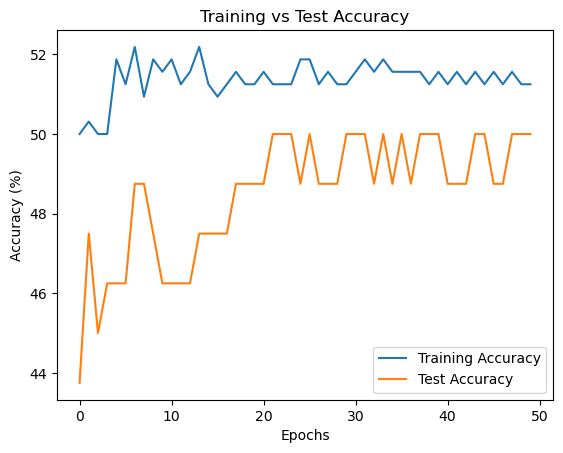

Confusion Matrix:
 [[30  6]
 [35 10]]
Class-specific Accuracy: [0.83333333 0.22222222]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 46.25%, p-value = 0.8010


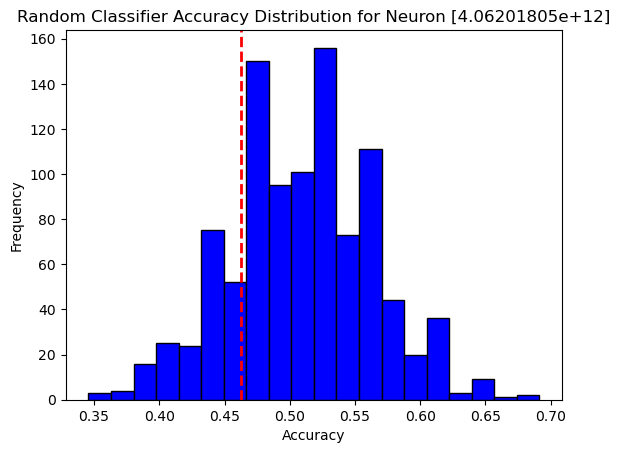

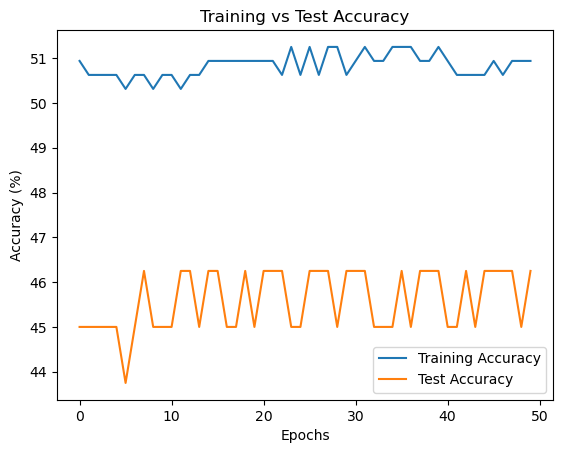

Confusion Matrix:
 [[36  0]
 [44  1]]
Class-specific Accuracy: [1.         0.02222222]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 45.00%, p-value = 0.8410


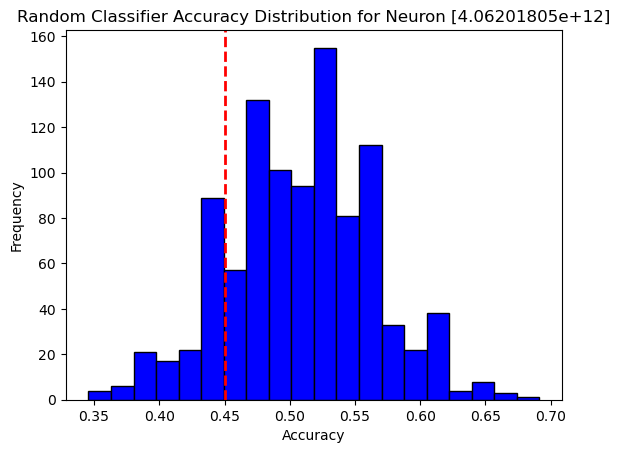

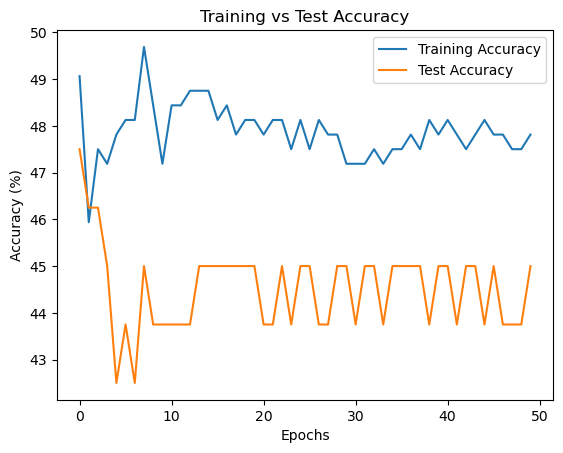

Confusion Matrix:
 [[26 10]
 [35 10]]
Class-specific Accuracy: [0.72222222 0.22222222]

 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 52.50%, p-value = 0.3770


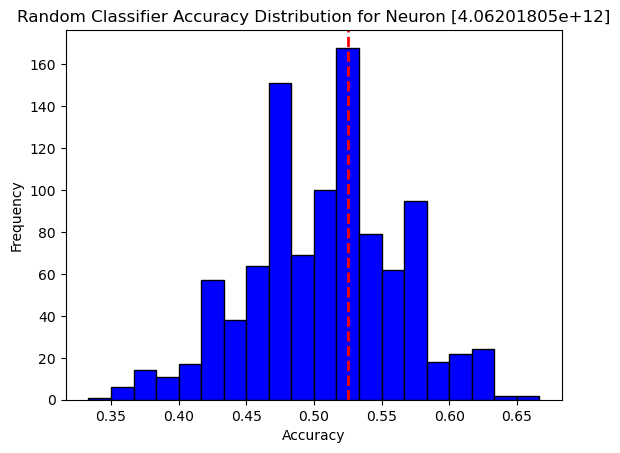

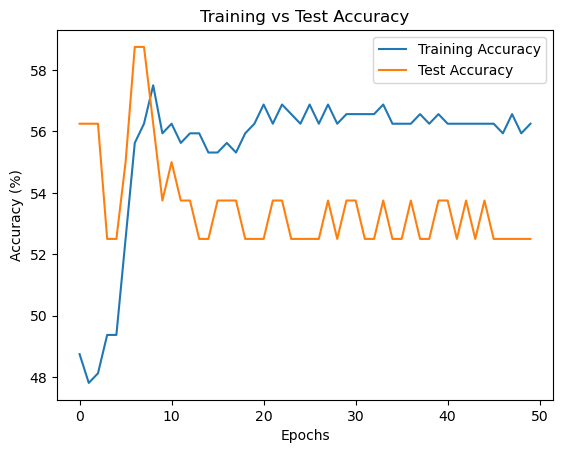

Confusion Matrix:
 [[17 19]
 [19 26]]
Class-specific Accuracy: [0.47222222 0.57777778]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 43.75%, p-value = 0.8220


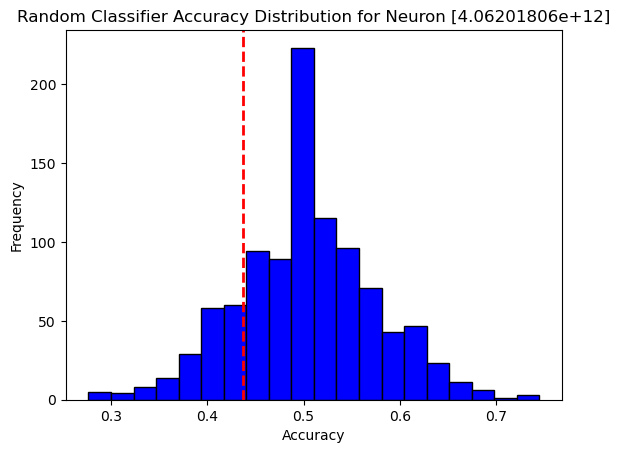

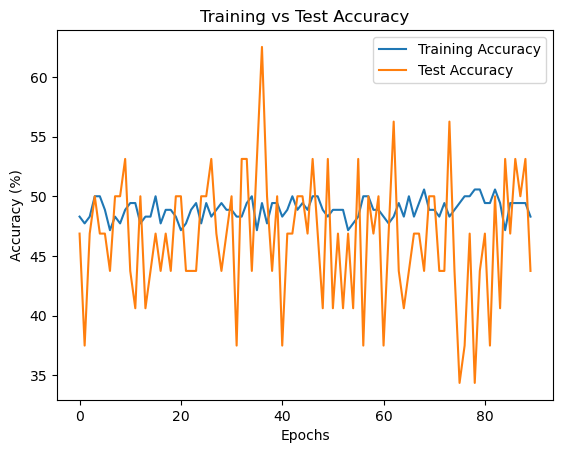

Confusion Matrix:
 [[21  0]
 [25  1]]
Class-specific Accuracy: [1.         0.03846154]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 56.25%, p-value = 0.2200


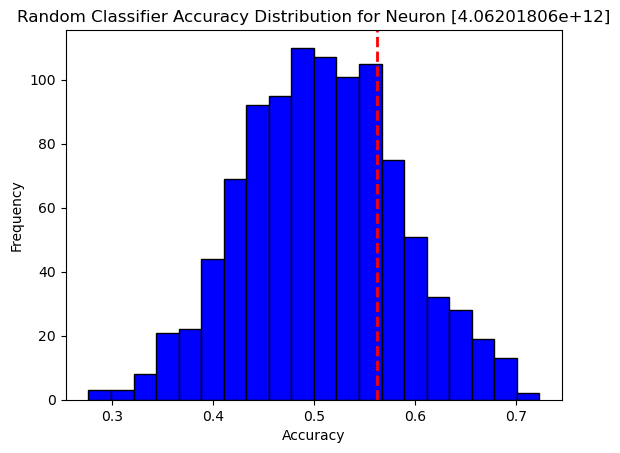

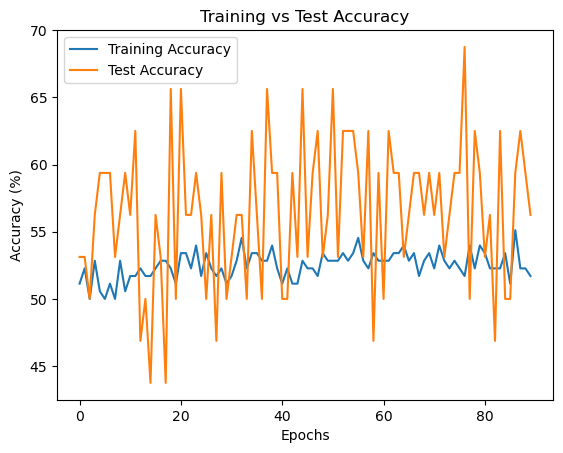

Confusion Matrix:
 [[ 1 20]
 [ 0 26]]
Class-specific Accuracy: [0.04761905 1.        ]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 59.38%, p-value = 0.1500


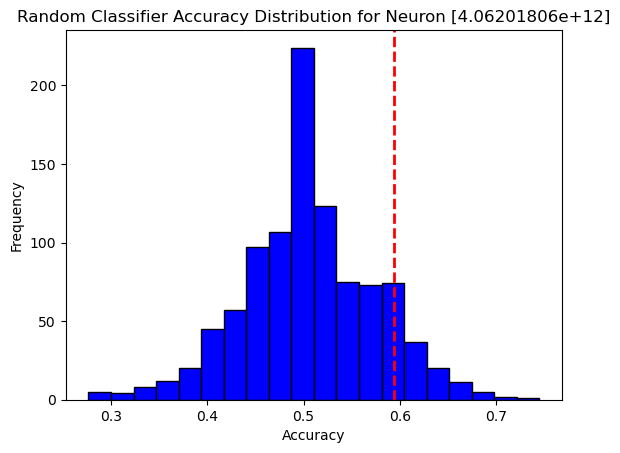

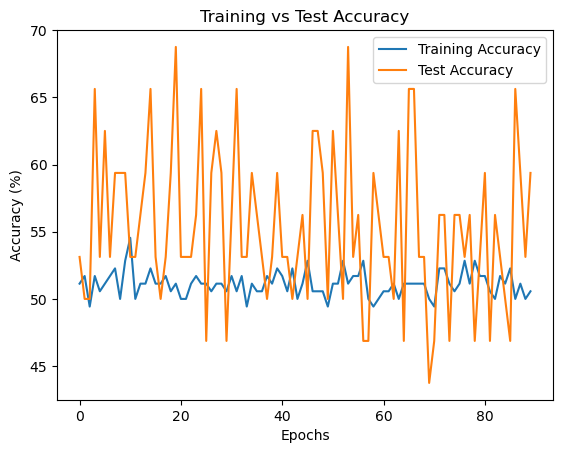

Confusion Matrix:
 [[ 0 21]
 [ 0 26]]
Class-specific Accuracy: [0. 1.]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 50.00%, p-value = 0.5550


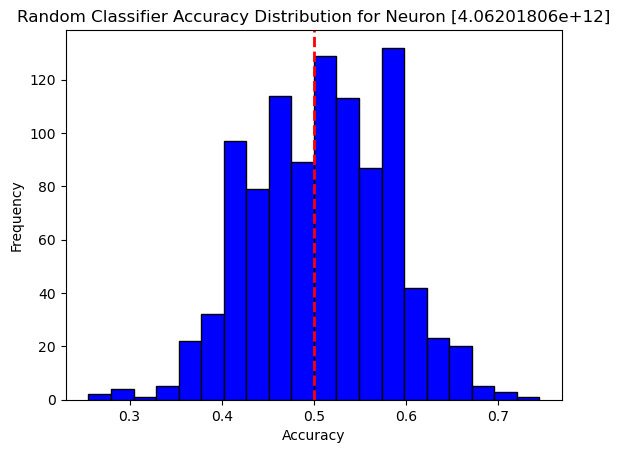

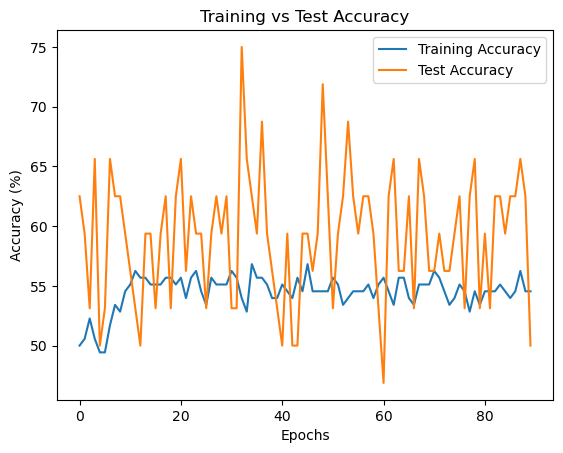

Confusion Matrix:
 [[ 5 16]
 [ 3 23]]
Class-specific Accuracy: [0.23809524 0.88461538]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 56.25%, p-value = 0.2000


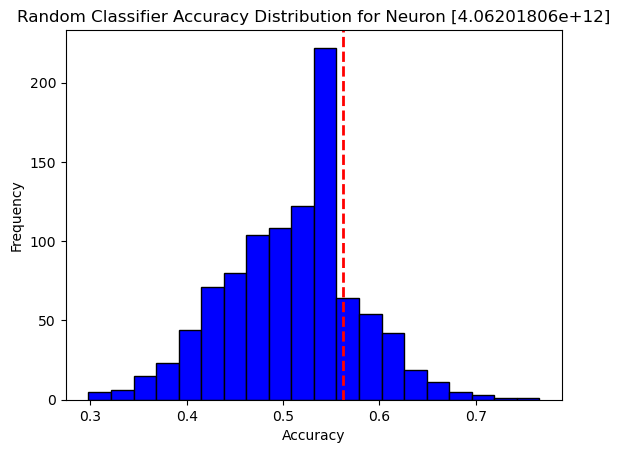

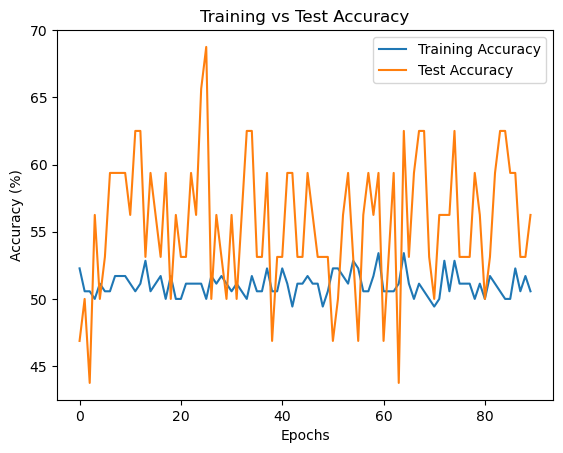

Confusion Matrix:
 [[ 0 21]
 [ 0 26]]
Class-specific Accuracy: [0. 1.]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 40.62%, p-value = 0.8770


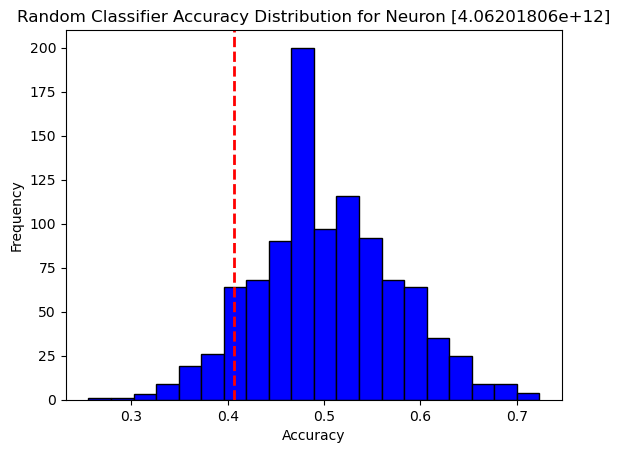

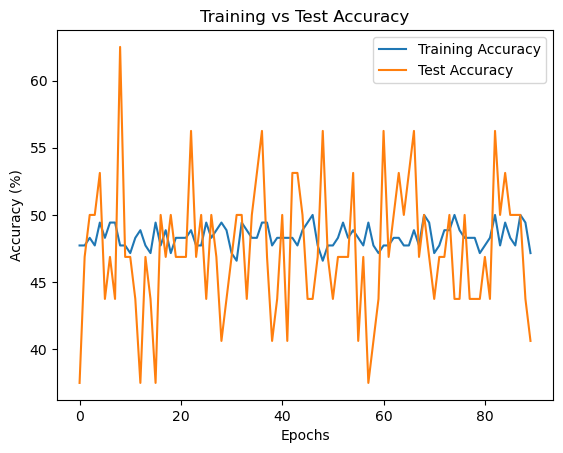

Confusion Matrix:
 [[10 11]
 [14 12]]
Class-specific Accuracy: [0.47619048 0.46153846]

 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 50.00%, p-value = 0.5330


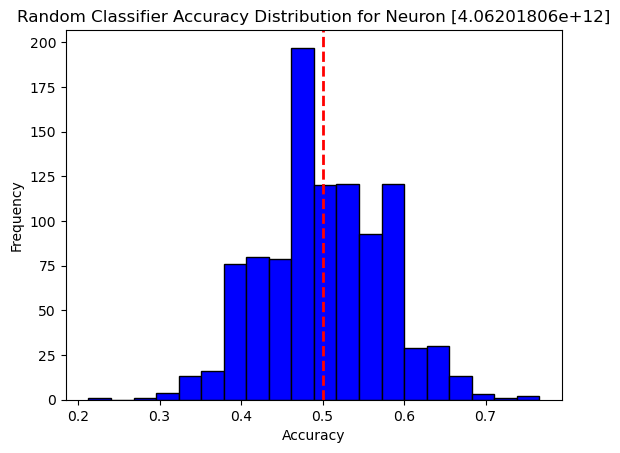

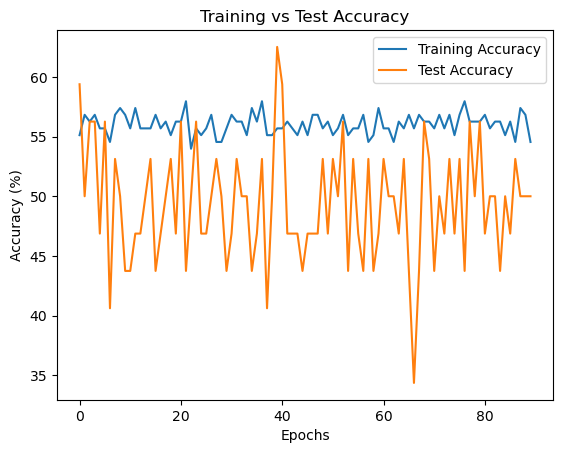

Confusion Matrix:
 [[ 3 18]
 [ 6 20]]
Class-specific Accuracy: [0.14285714 0.76923077]

 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 50.00%, p-value = 0.5520


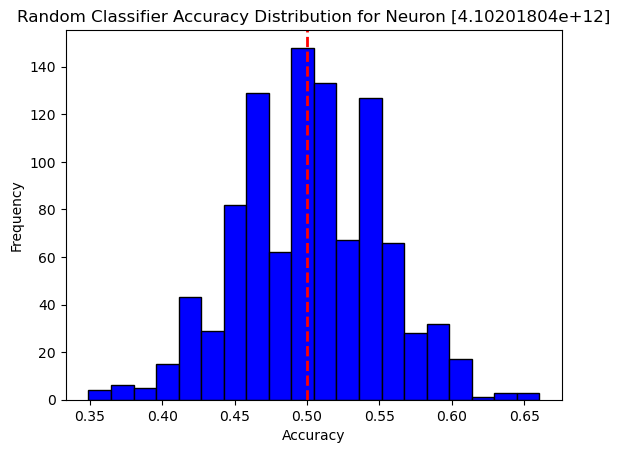

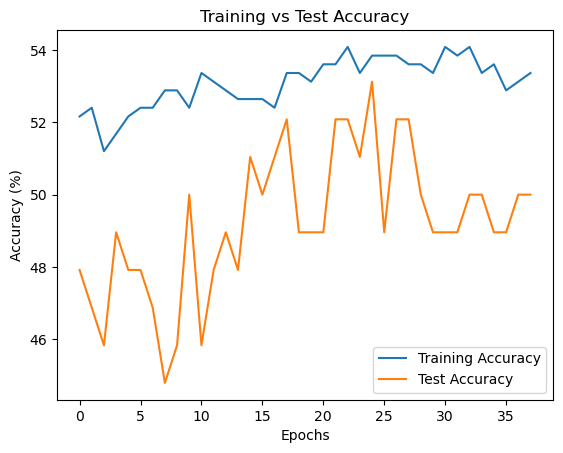

Confusion Matrix:
 [[46  6]
 [47  7]]
Class-specific Accuracy: [0.88461538 0.12962963]

 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 50.00%, p-value = 0.5500


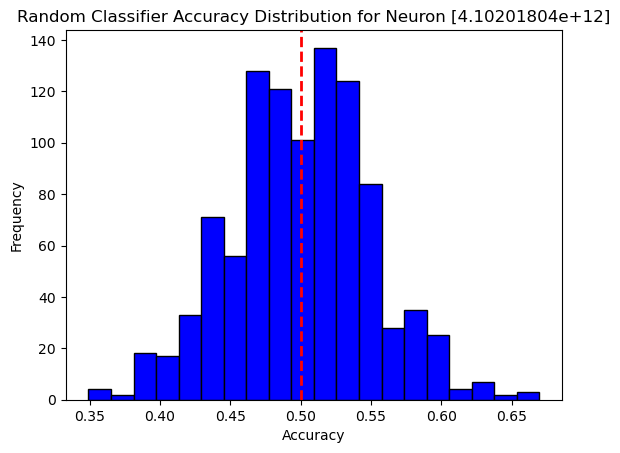

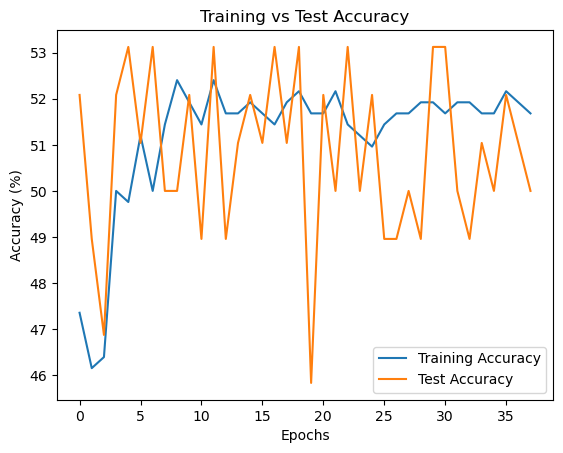

Confusion Matrix:
 [[49  3]
 [49  5]]
Class-specific Accuracy: [0.94230769 0.09259259]

 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 46.88%, p-value = 0.7800


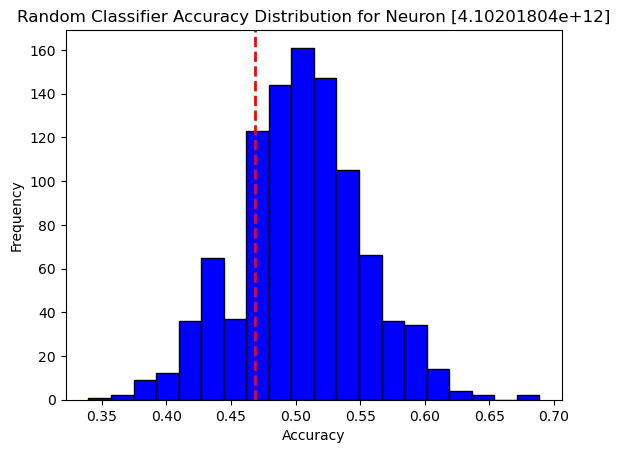

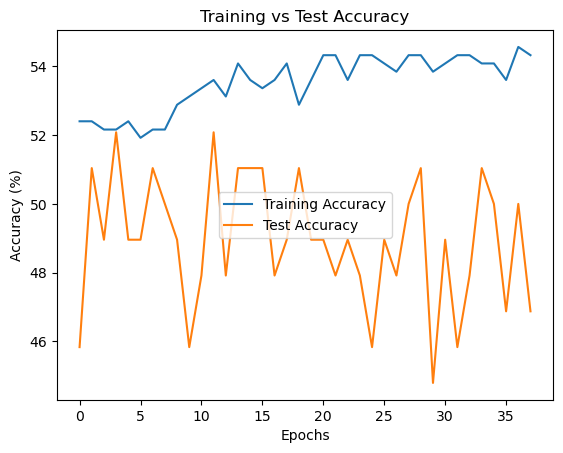

Confusion Matrix:
 [[42 10]
 [44 10]]
Class-specific Accuracy: [0.80769231 0.18518519]

 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 47.50%, p-value = 0.7900


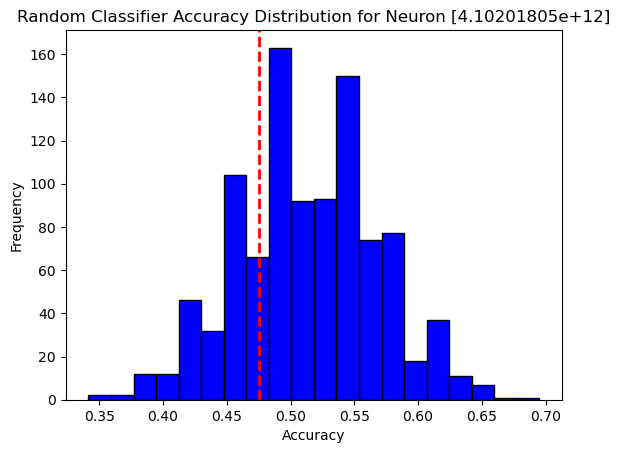

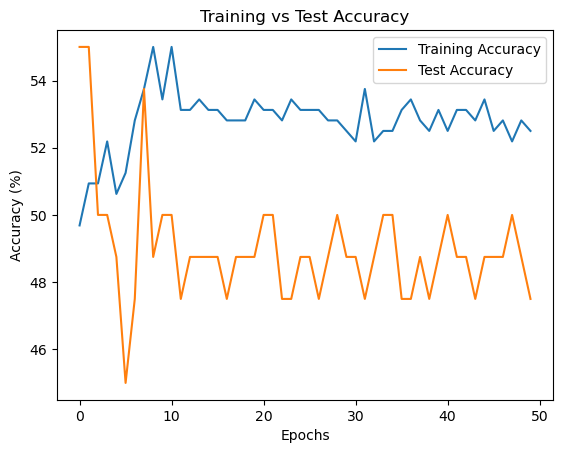

Confusion Matrix:
 [[22 12]
 [30 18]]
Class-specific Accuracy: [0.64705882 0.375     ]

 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 41.25%, p-value = 0.9670


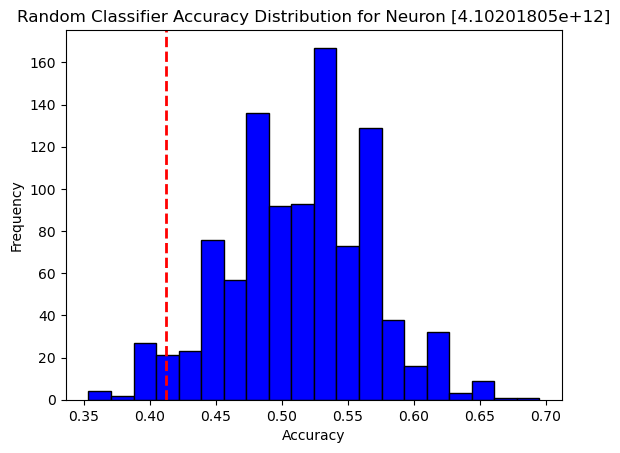

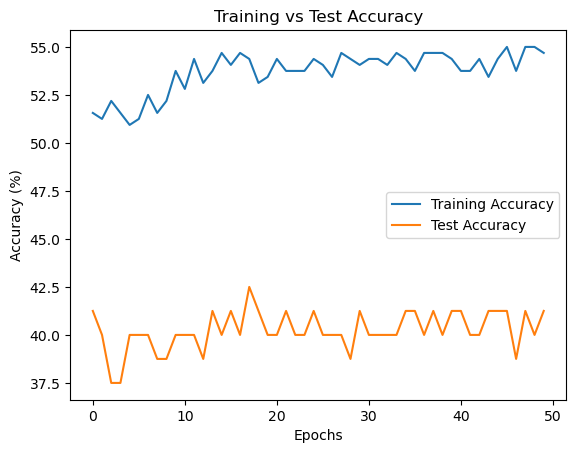

Confusion Matrix:
 [[23 11]
 [38 10]]
Class-specific Accuracy: [0.67647059 0.20833333]

 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 51.25%, p-value = 0.4530


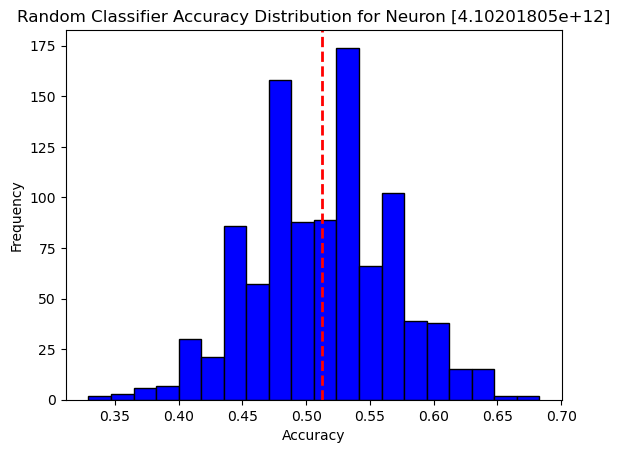

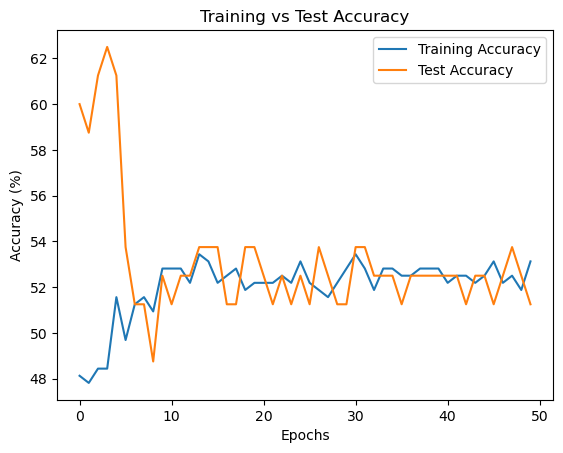

Confusion Matrix:
 [[26  8]
 [31 17]]
Class-specific Accuracy: [0.76470588 0.35416667]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 70.00%, p-value = 0.0030


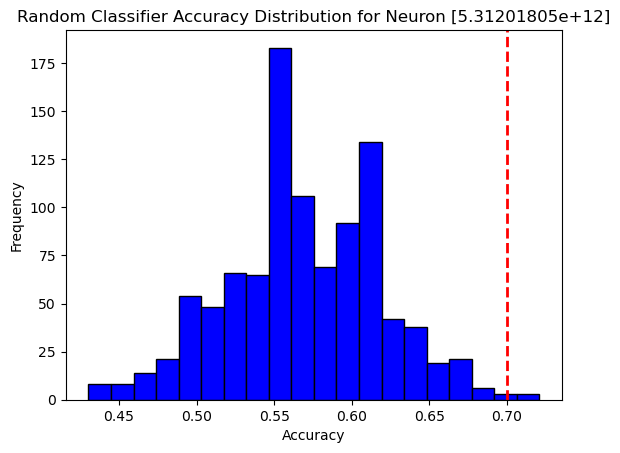

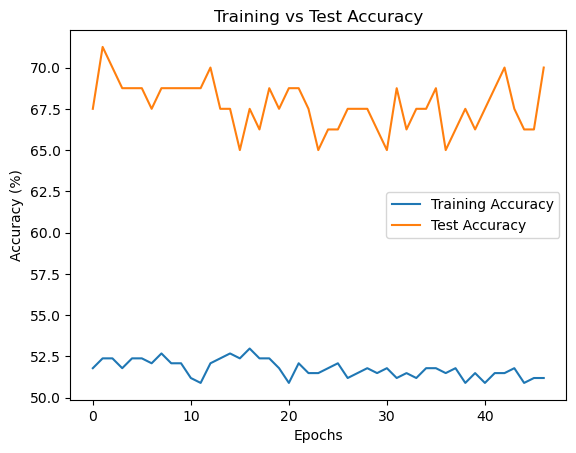

Confusion Matrix:
 [[57  2]
 [26  1]]
Class-specific Accuracy: [0.96610169 0.03703704]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 61.25%, p-value = 0.2110


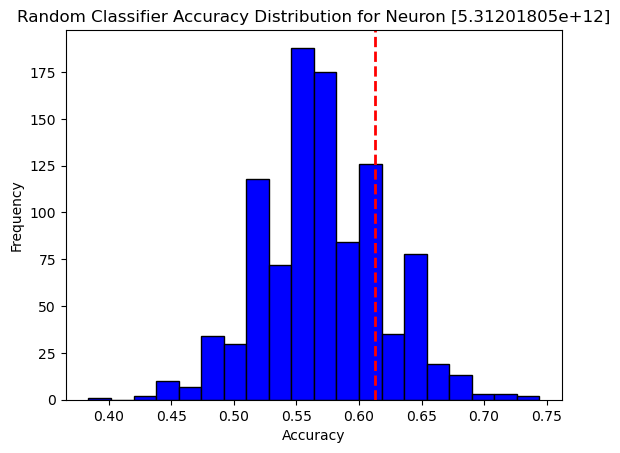

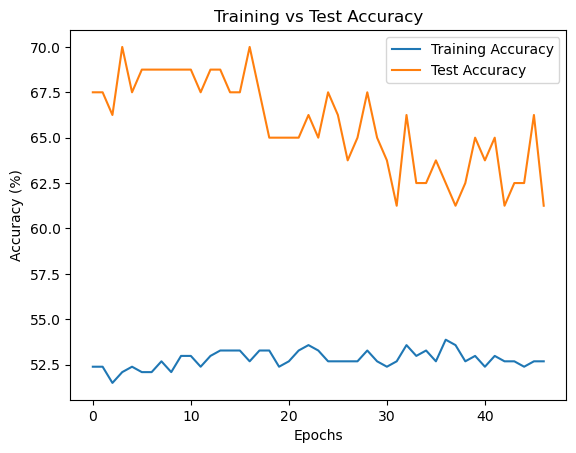

Confusion Matrix:
 [[55  4]
 [27  0]]
Class-specific Accuracy: [0.93220339 0.        ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 68.75%, p-value = 0.0050


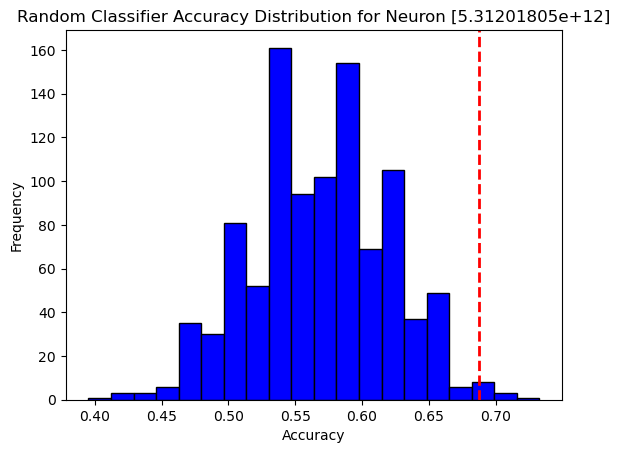

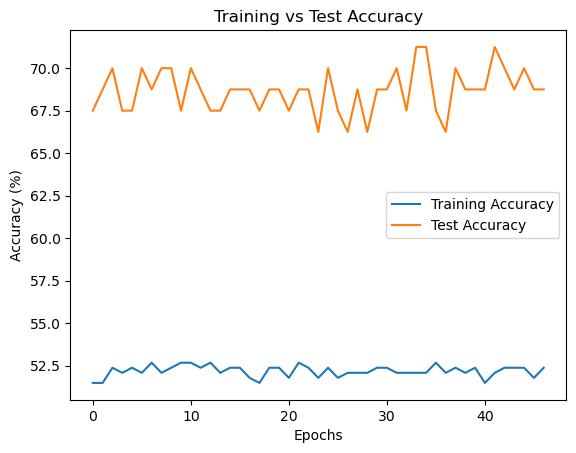

Confusion Matrix:
 [[59  0]
 [27  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.00%, p-value = 0.2820


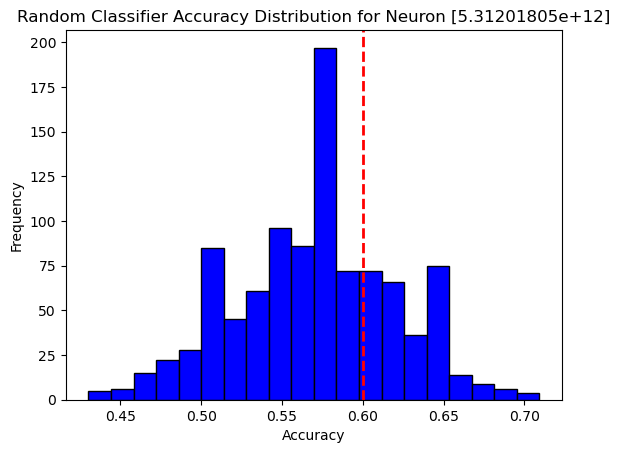

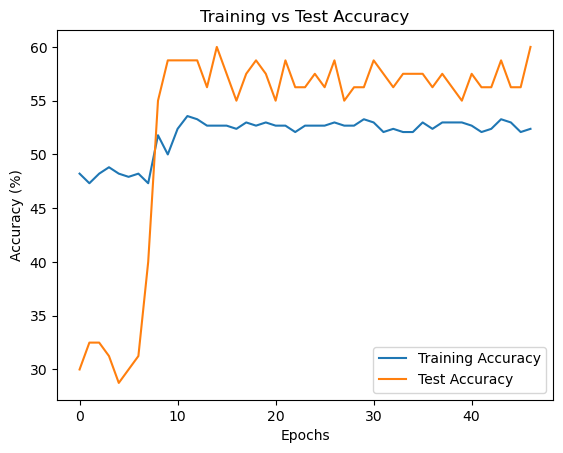

Confusion Matrix:
 [[48 11]
 [26  1]]
Class-specific Accuracy: [0.81355932 0.03703704]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 63.75%, p-value = 0.0910


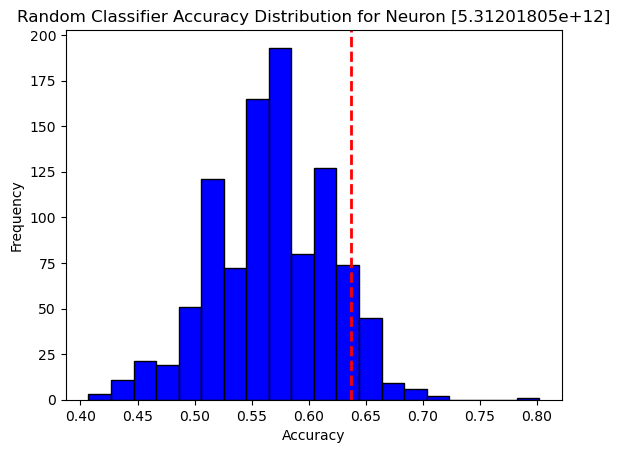

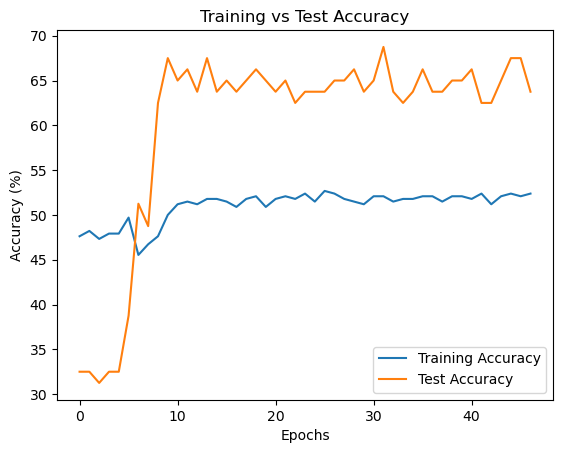

Confusion Matrix:
 [[56  3]
 [27  0]]
Class-specific Accuracy: [0.94915254 0.        ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.00%, p-value = 0.3090


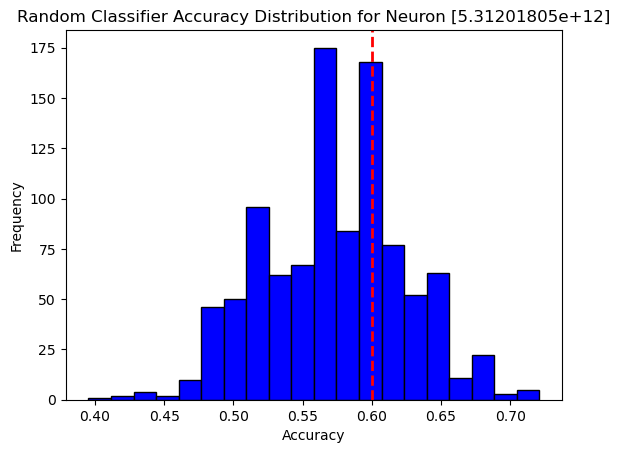

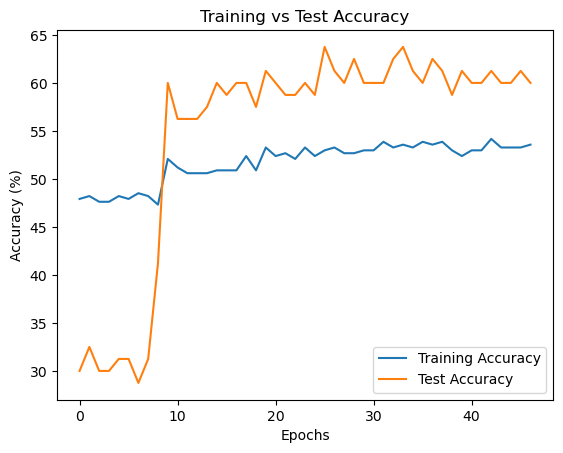

Confusion Matrix:
 [[50  9]
 [25  2]]
Class-specific Accuracy: [0.84745763 0.07407407]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 47.50%, p-value = 0.9750


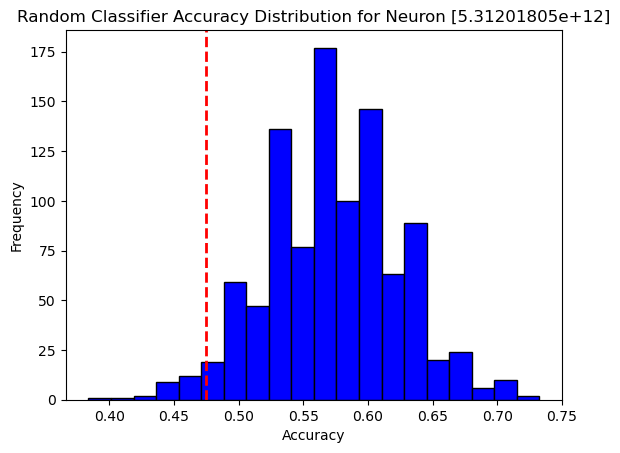

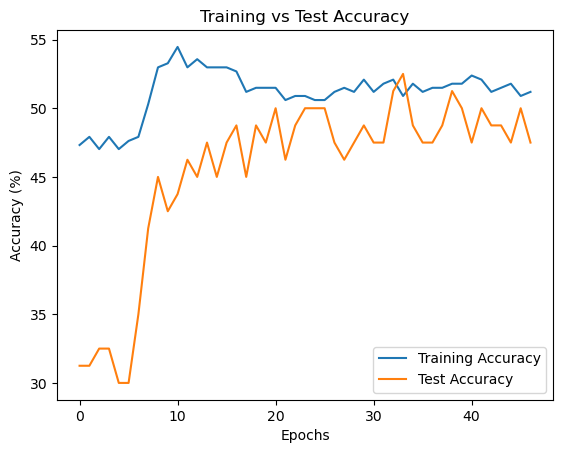

Confusion Matrix:
 [[30 29]
 [15 12]]
Class-specific Accuracy: [0.50847458 0.44444444]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 35.00%, p-value = 1.0000


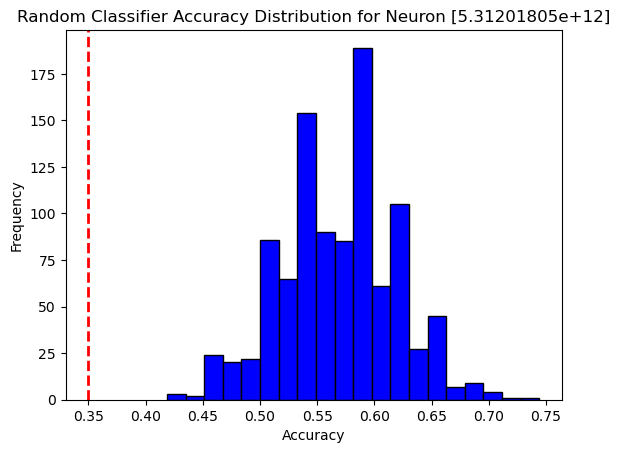

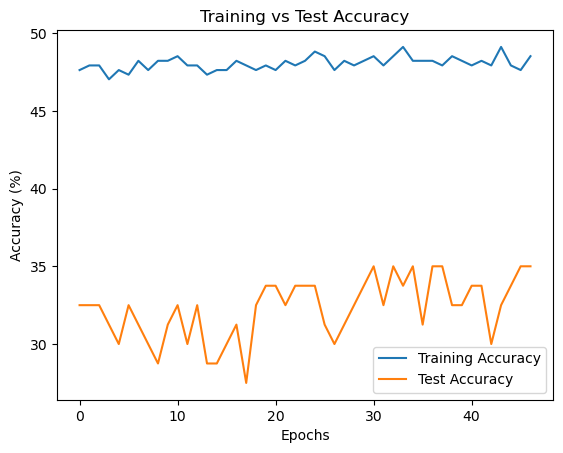

Confusion Matrix:
 [[ 3 56]
 [ 1 26]]
Class-specific Accuracy: [0.05084746 0.96296296]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 51.25%, p-value = 0.8580


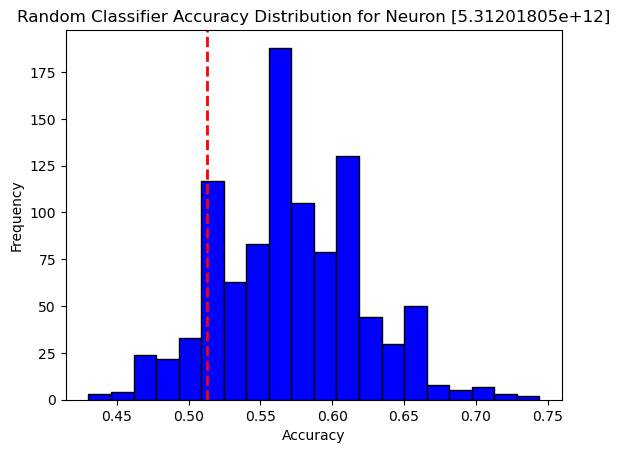

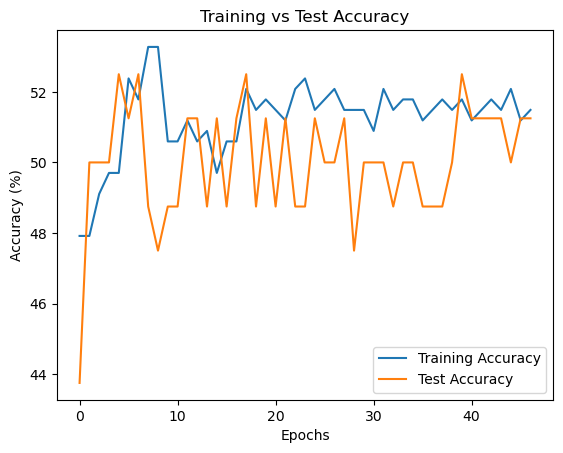

Confusion Matrix:
 [[33 26]
 [17 10]]
Class-specific Accuracy: [0.55932203 0.37037037]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.75%, p-value = 0.3580


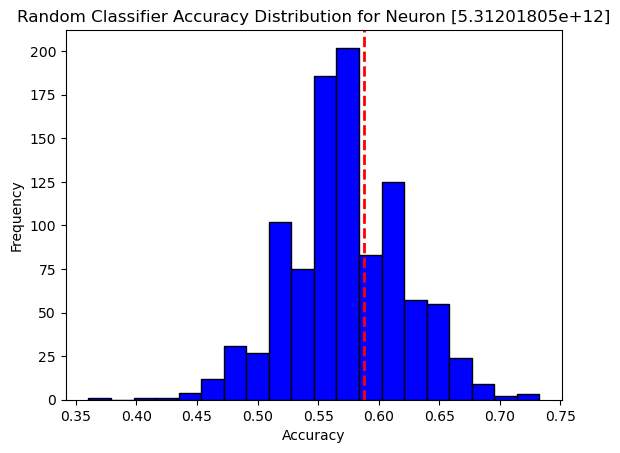

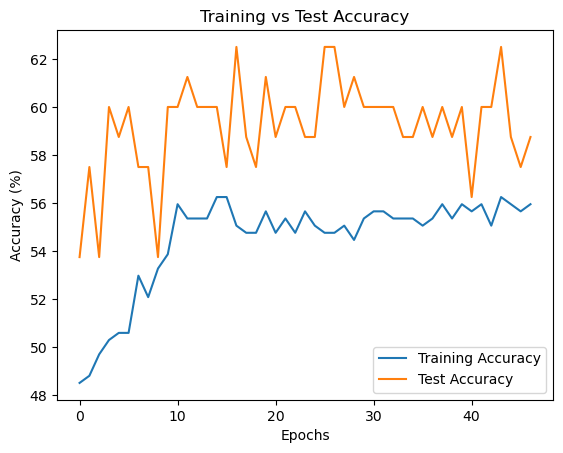

Confusion Matrix:
 [[46 13]
 [22  5]]
Class-specific Accuracy: [0.77966102 0.18518519]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 63.75%, p-value = 0.0880


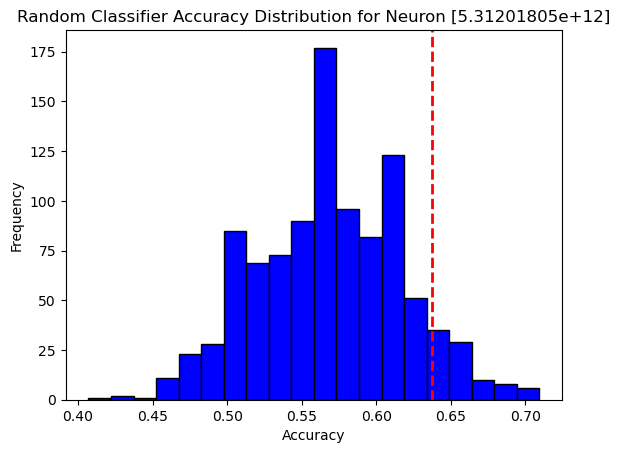

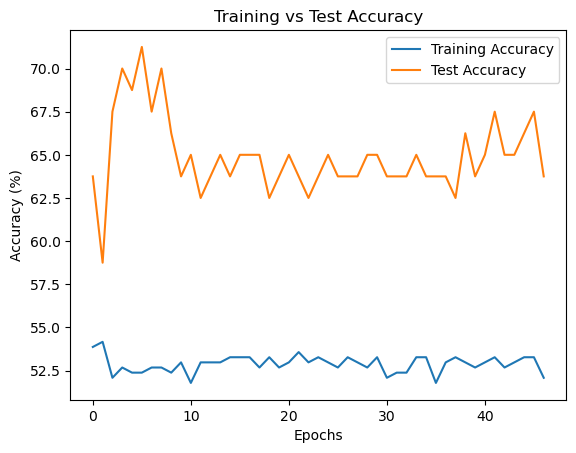

Confusion Matrix:
 [[56  3]
 [27  0]]
Class-specific Accuracy: [0.94915254 0.        ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 68.75%, p-value = 0.0100


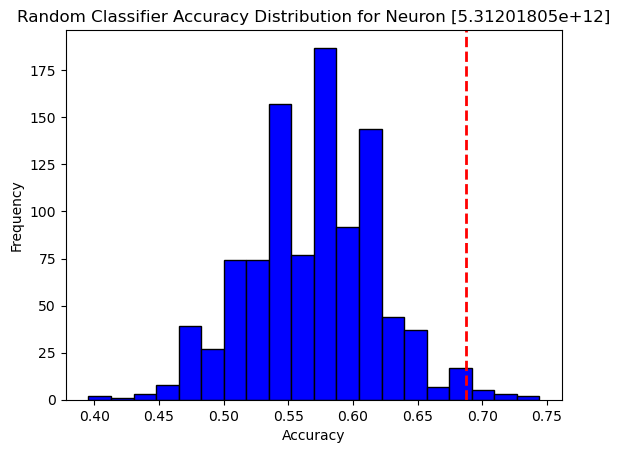

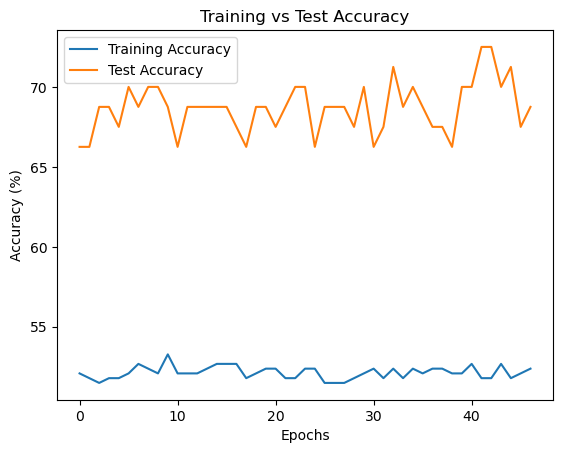

Confusion Matrix:
 [[59  0]
 [27  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 68.75%, p-value = 0.0010


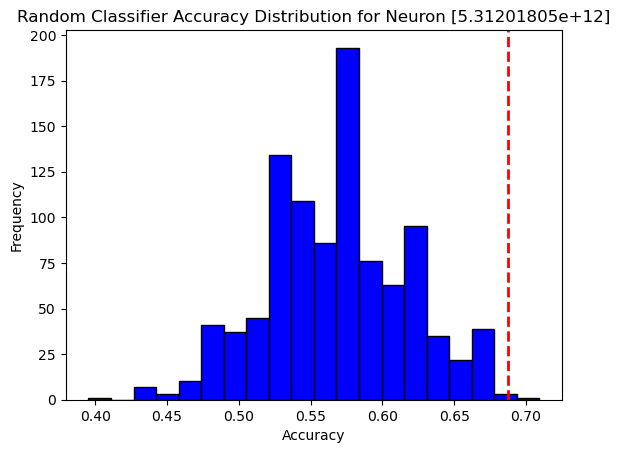

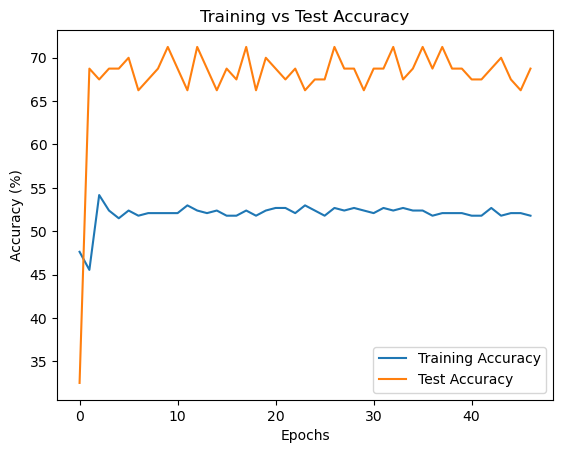

Confusion Matrix:
 [[59  0]
 [27  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 62.50%, p-value = 0.1420


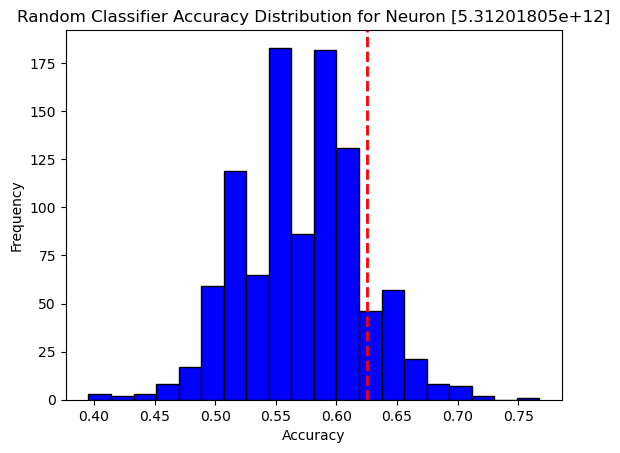

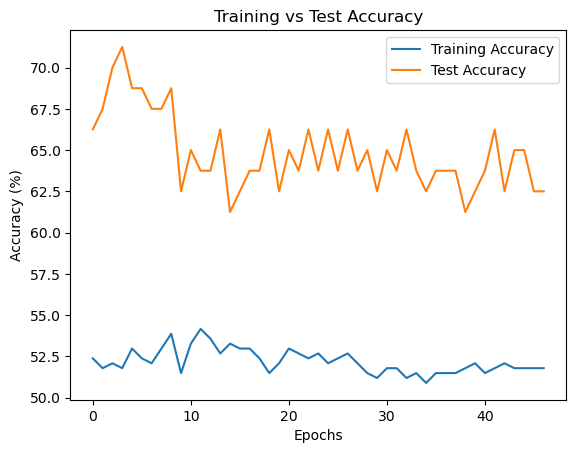

Confusion Matrix:
 [[50  9]
 [22  5]]
Class-specific Accuracy: [0.84745763 0.18518519]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 46.25%, p-value = 0.9820


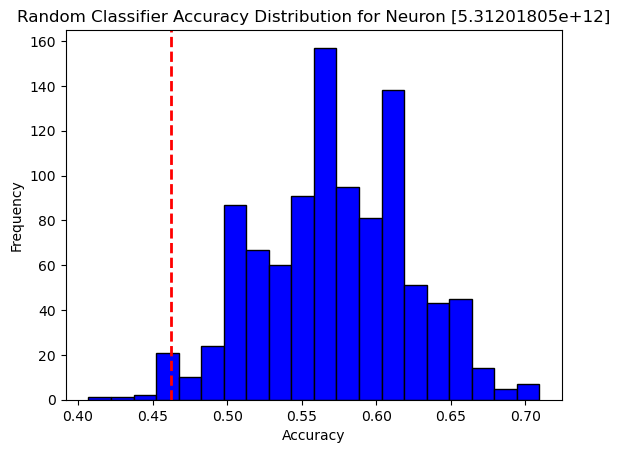

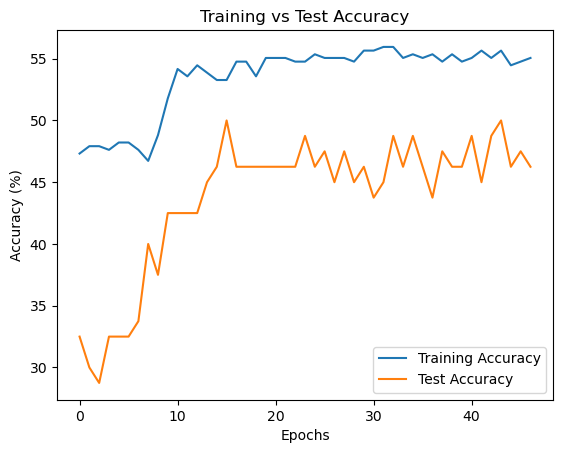

Confusion Matrix:
 [[24 35]
 [11 16]]
Class-specific Accuracy: [0.40677966 0.59259259]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 40.62%, p-value = 0.9860


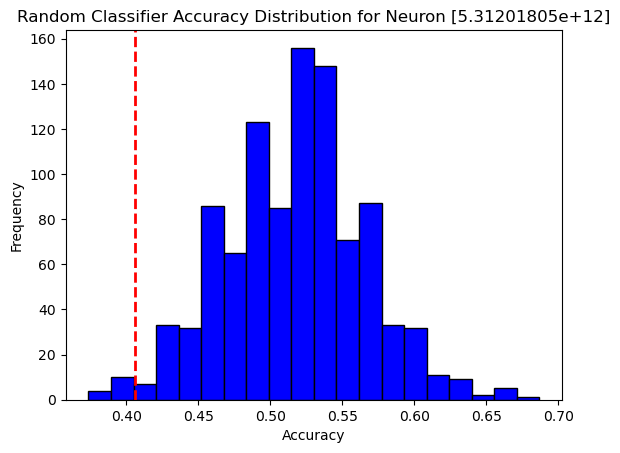

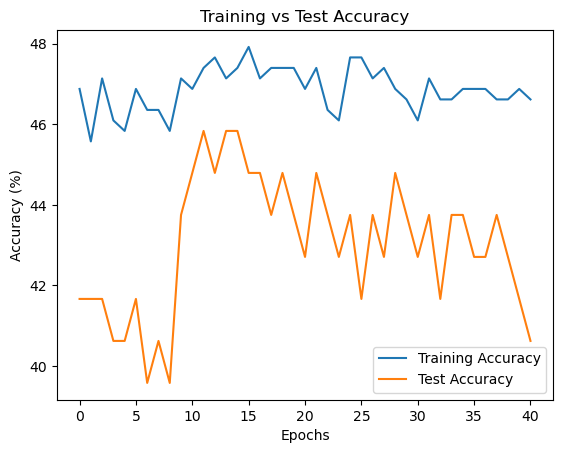

Confusion Matrix:
 [[12 46]
 [11 30]]
Class-specific Accuracy: [0.20689655 0.73170732]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 59.38%, p-value = 0.0700


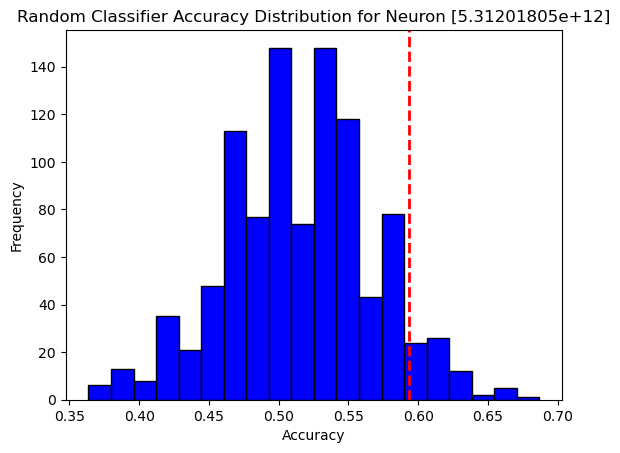

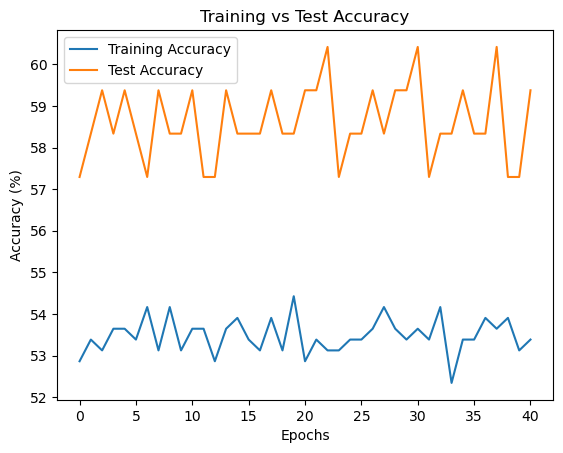

Confusion Matrix:
 [[58  0]
 [41  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 50.00%, p-value = 0.6180


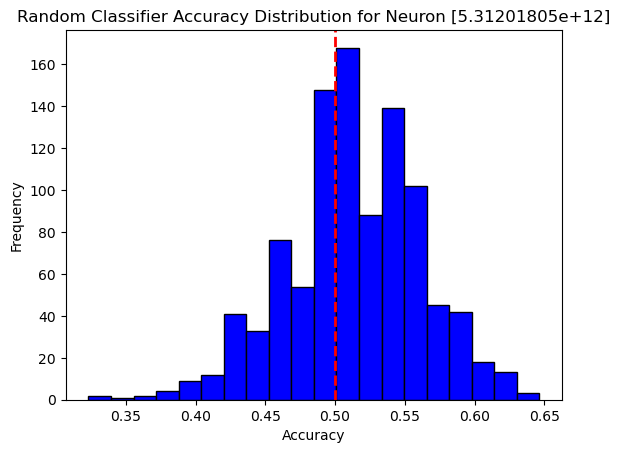

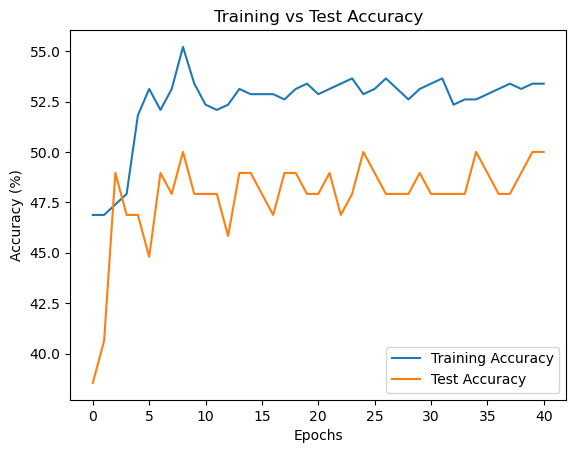

Confusion Matrix:
 [[39 19]
 [32  9]]
Class-specific Accuracy: [0.67241379 0.2195122 ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.33%, p-value = 0.0920


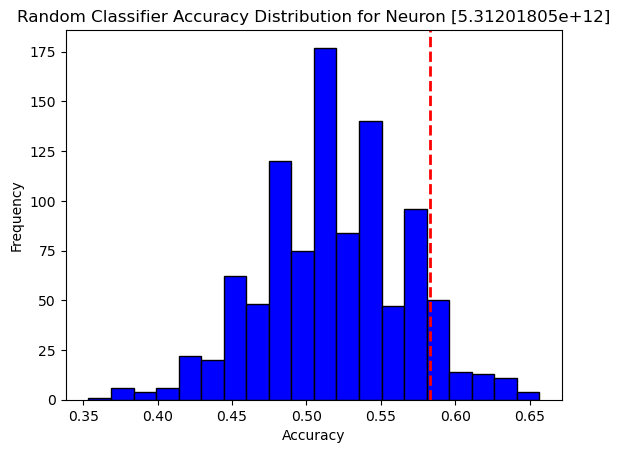

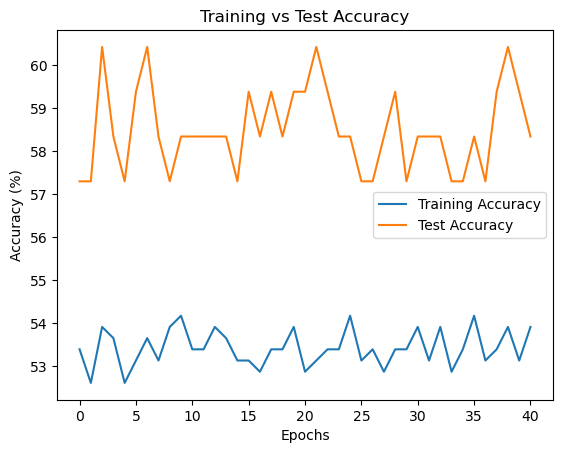

Confusion Matrix:
 [[58  0]
 [41  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 48.96%, p-value = 0.7180


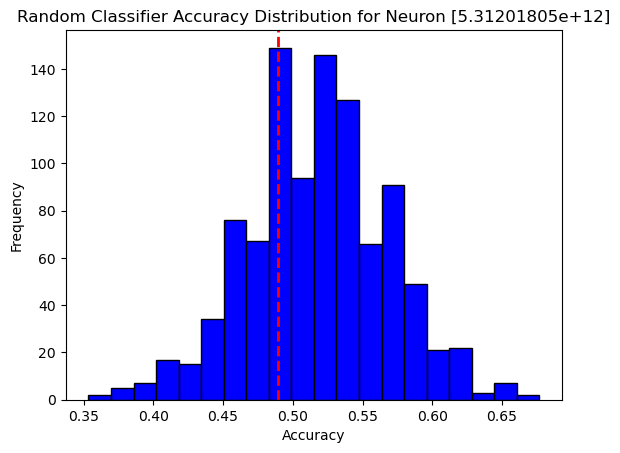

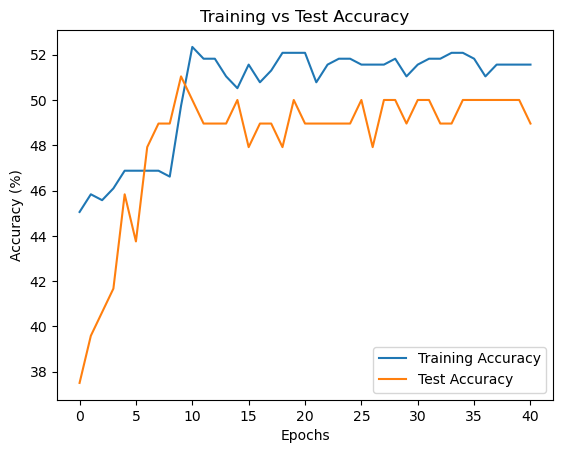

Confusion Matrix:
 [[33 25]
 [25 16]]
Class-specific Accuracy: [0.56896552 0.3902439 ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 59.38%, p-value = 0.0670


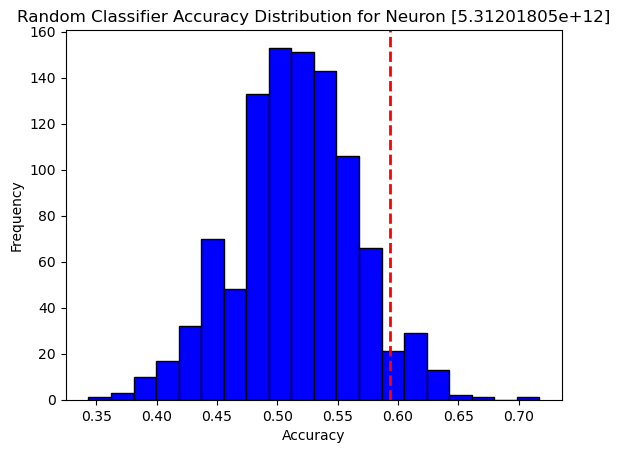

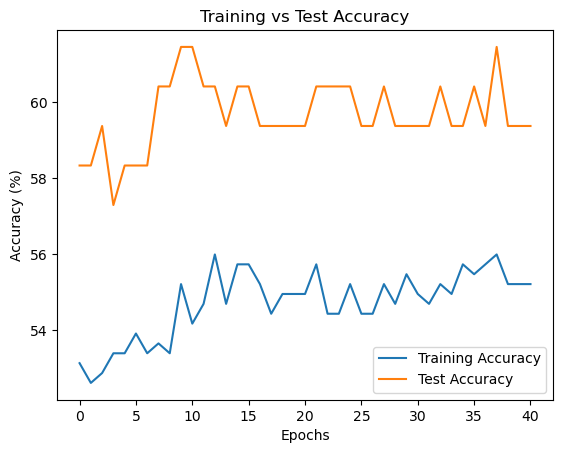

Confusion Matrix:
 [[49  9]
 [31 10]]
Class-specific Accuracy: [0.84482759 0.24390244]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 59.38%, p-value = 0.0600


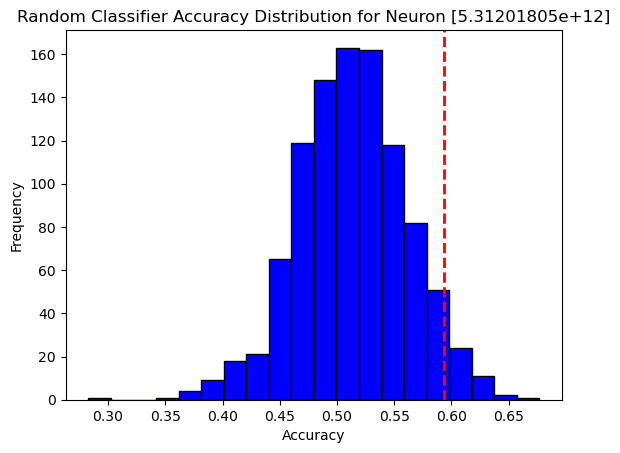

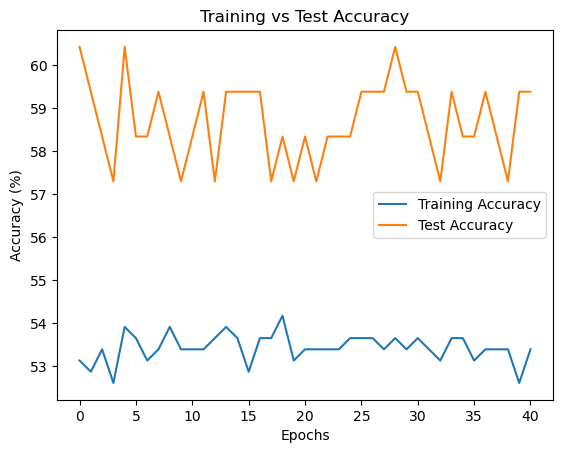

Confusion Matrix:
 [[58  0]
 [41  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 53.12%, p-value = 0.3560


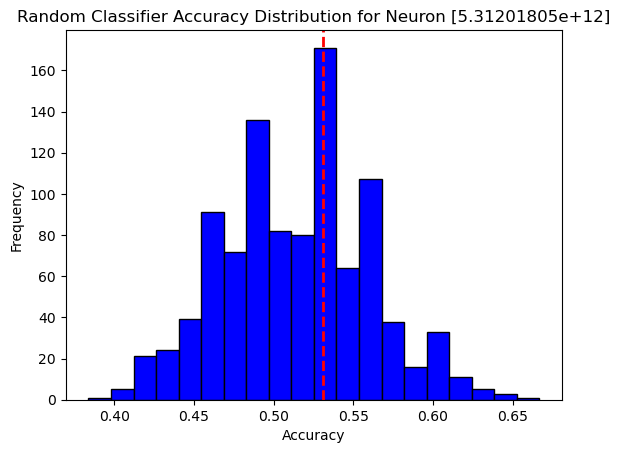

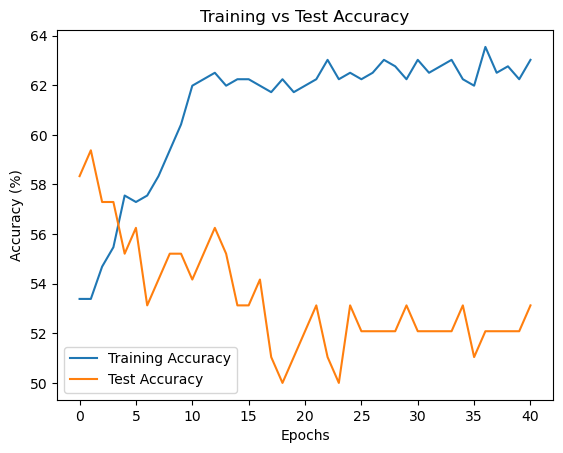

Confusion Matrix:
 [[41 17]
 [31 10]]
Class-specific Accuracy: [0.70689655 0.24390244]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.42%, p-value = 0.0390


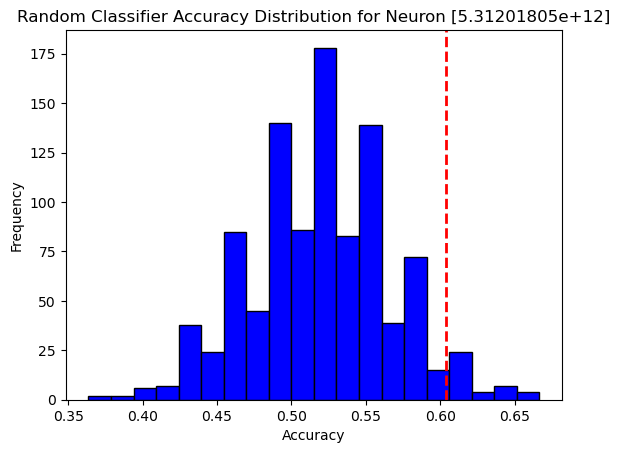

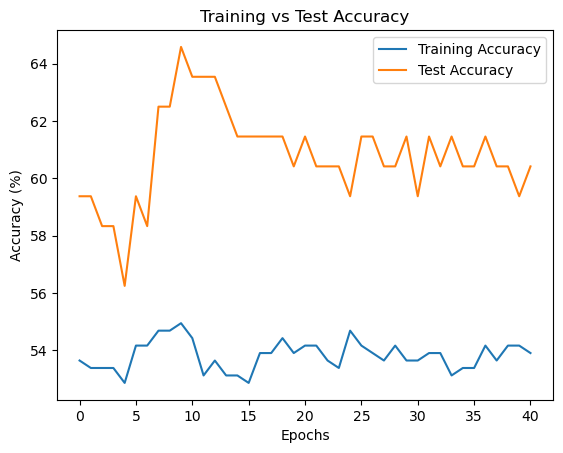

Confusion Matrix:
 [[49  9]
 [30 11]]
Class-specific Accuracy: [0.84482759 0.26829268]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.42%, p-value = 0.0460


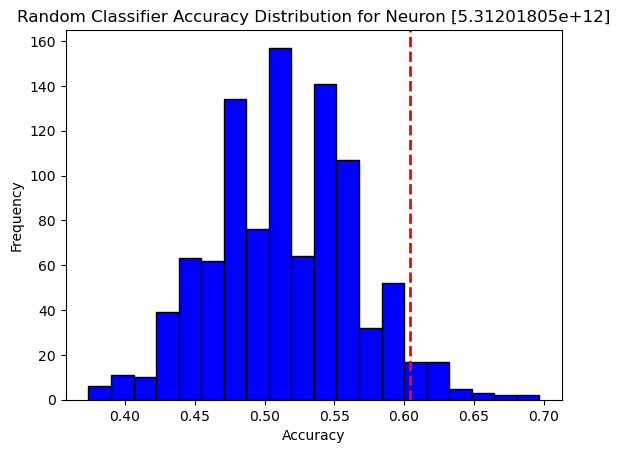

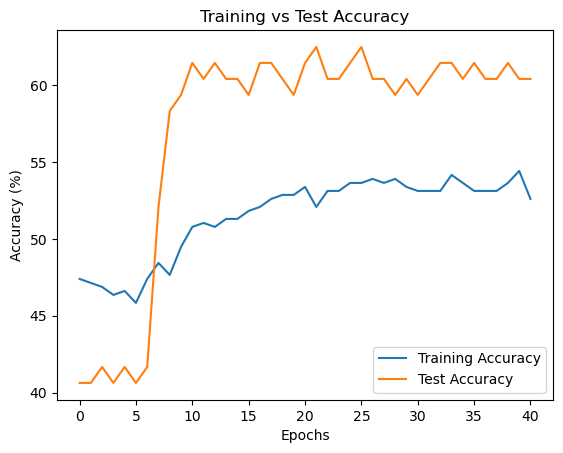

Confusion Matrix:
 [[57  1]
 [38  3]]
Class-specific Accuracy: [0.98275862 0.07317073]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.33%, p-value = 0.1050


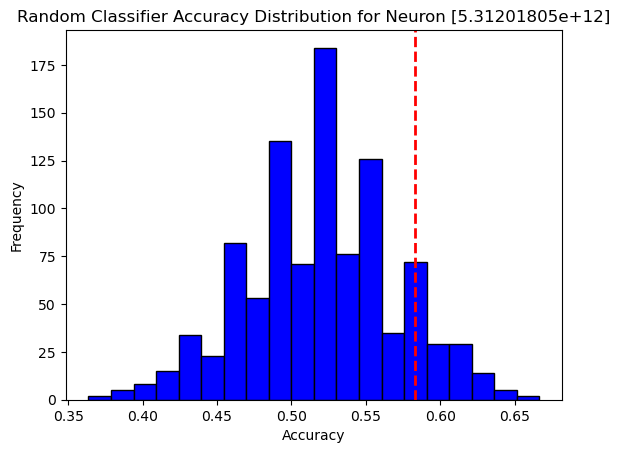

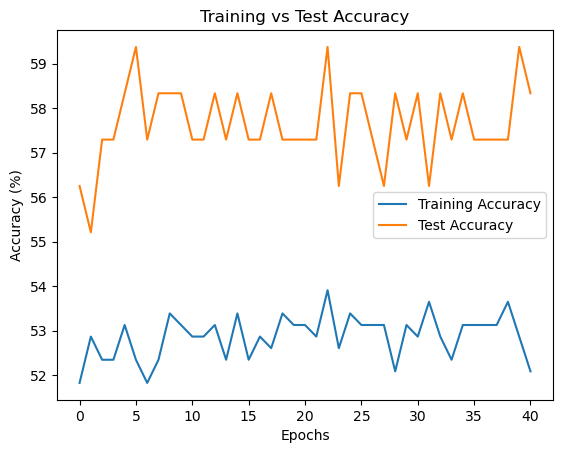

Confusion Matrix:
 [[57  1]
 [41  0]]
Class-specific Accuracy: [0.98275862 0.        ]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 59.38%, p-value = 0.0580


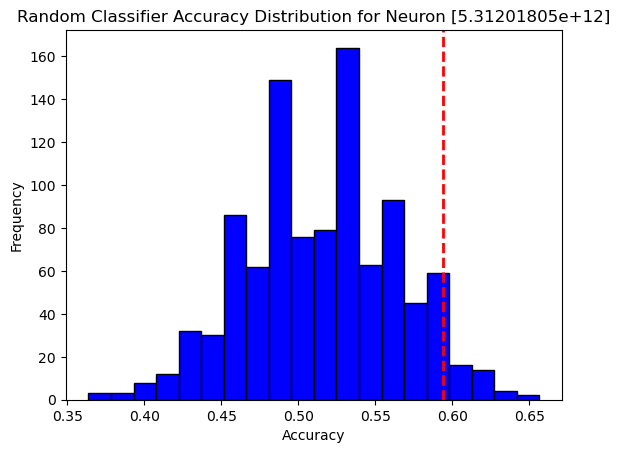

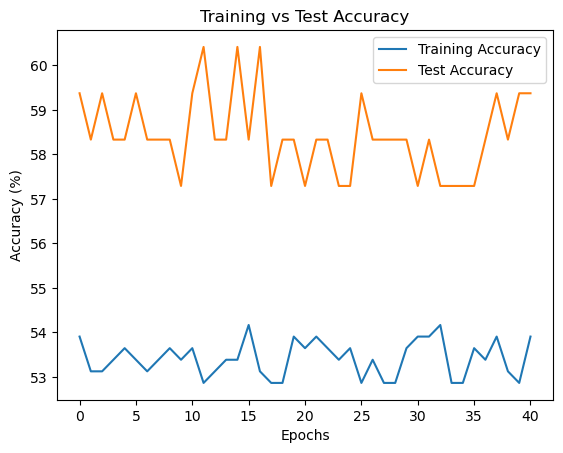

Confusion Matrix:
 [[58  0]
 [41  0]]
Class-specific Accuracy: [1. 0.]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 65.62%, p-value = 0.0000


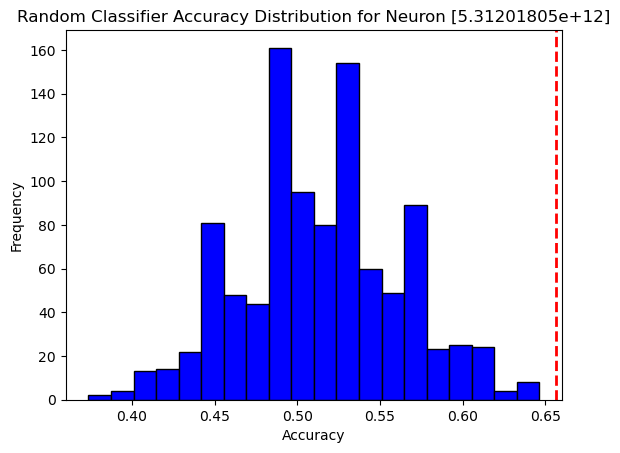

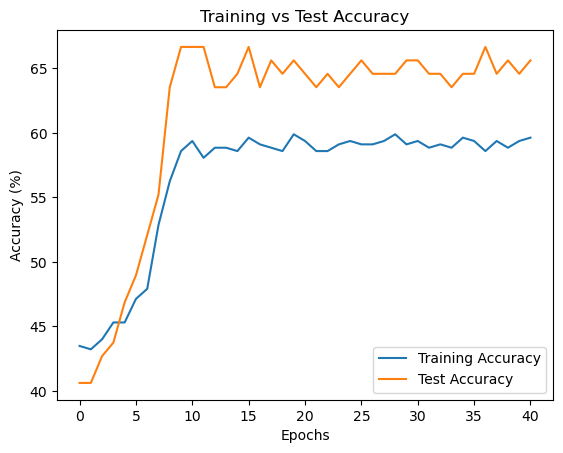

Confusion Matrix:
 [[47 11]
 [24 17]]
Class-specific Accuracy: [0.81034483 0.41463415]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.33%, p-value = 0.0860


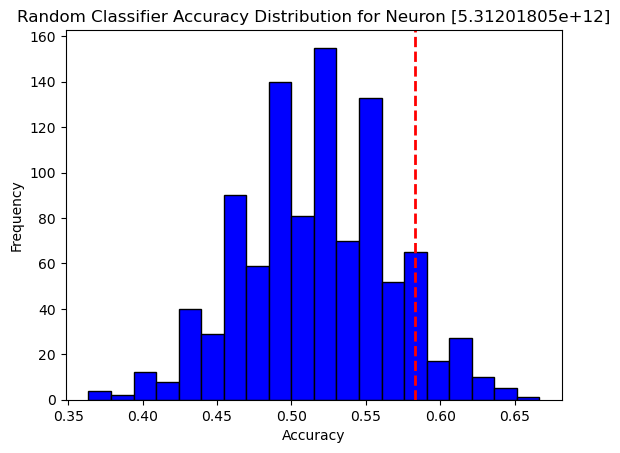

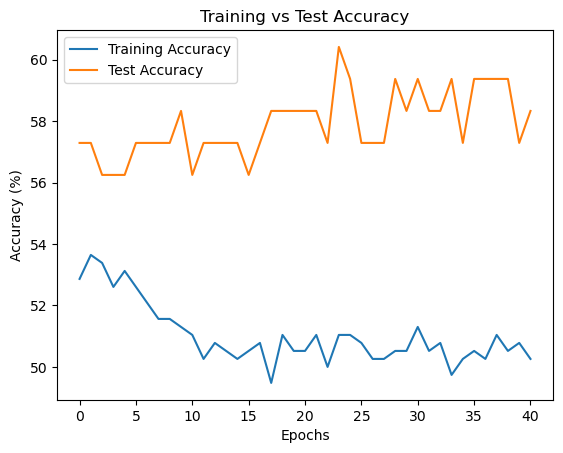

Confusion Matrix:
 [[50  8]
 [33  8]]
Class-specific Accuracy: [0.86206897 0.19512195]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 53.12%, p-value = 0.3720


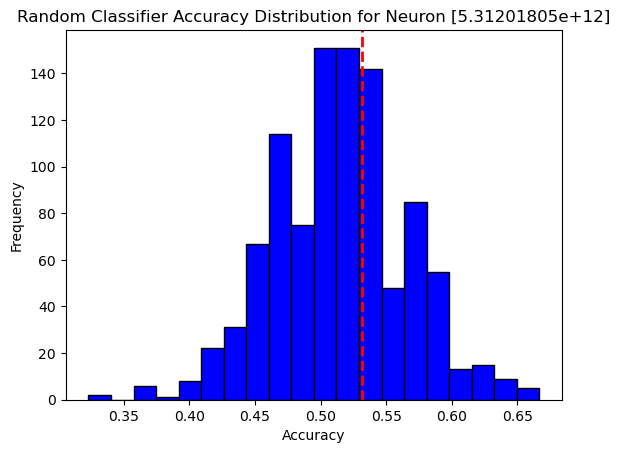

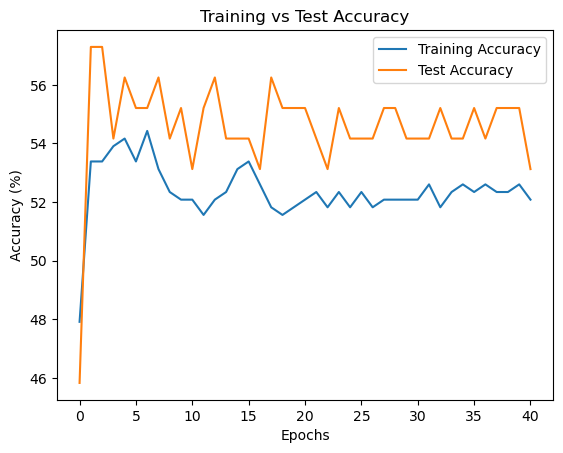

Confusion Matrix:
 [[44 14]
 [31 10]]
Class-specific Accuracy: [0.75862069 0.24390244]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.33%, p-value = 0.0960


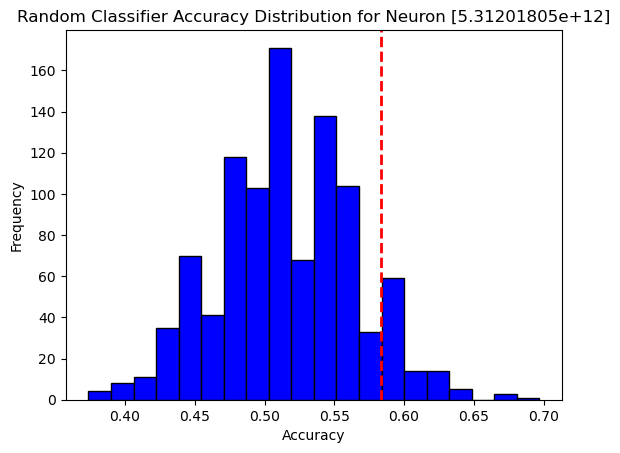

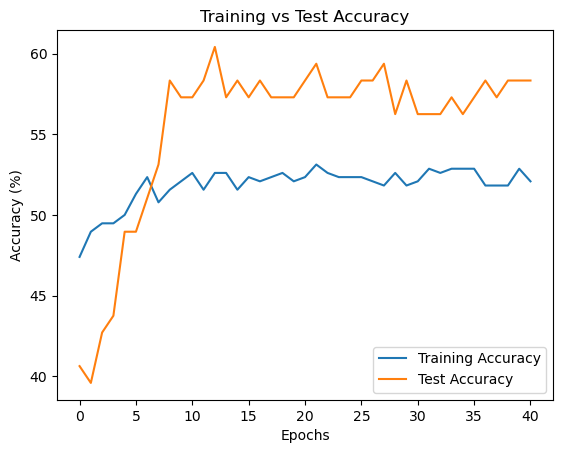

Confusion Matrix:
 [[53  5]
 [37  4]]
Class-specific Accuracy: [0.9137931  0.09756098]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 51.04%, p-value = 0.5430


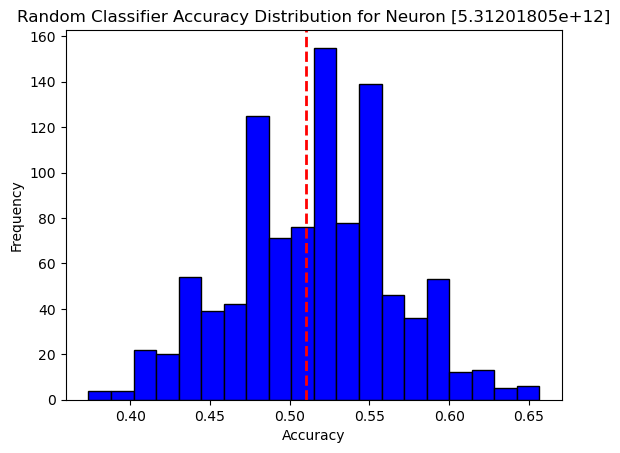

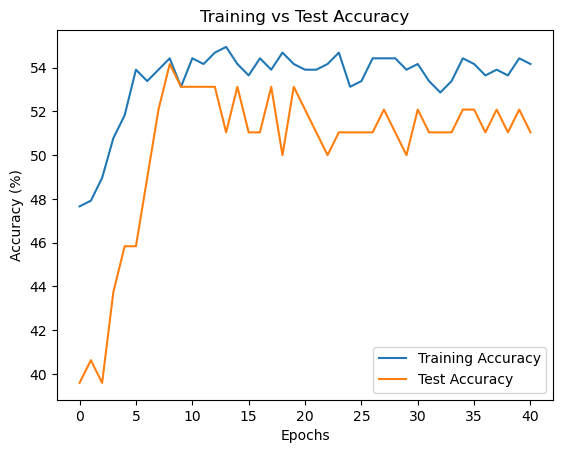

Confusion Matrix:
 [[44 14]
 [34  7]]
Class-specific Accuracy: [0.75862069 0.17073171]

 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 51.04%, p-value = 0.5430


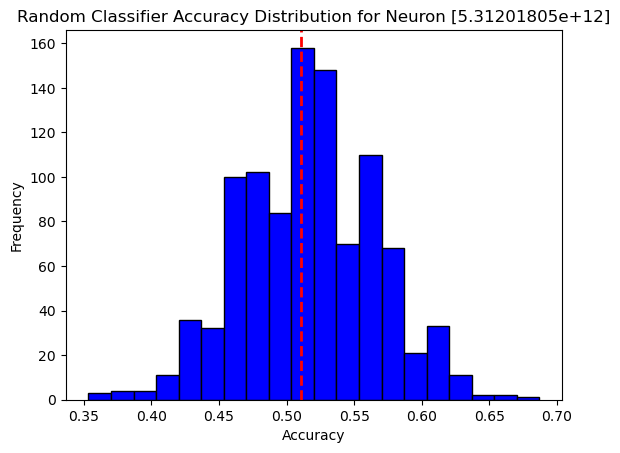

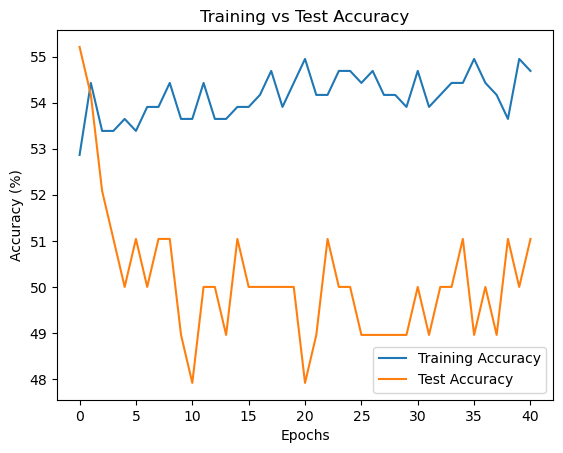

Confusion Matrix:
 [[36 22]
 [28 13]]
Class-specific Accuracy: [0.62068966 0.31707317]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 55.21%, p-value = 0.1360


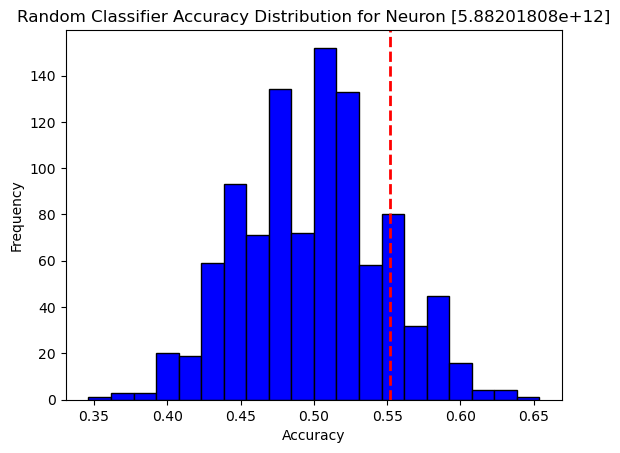

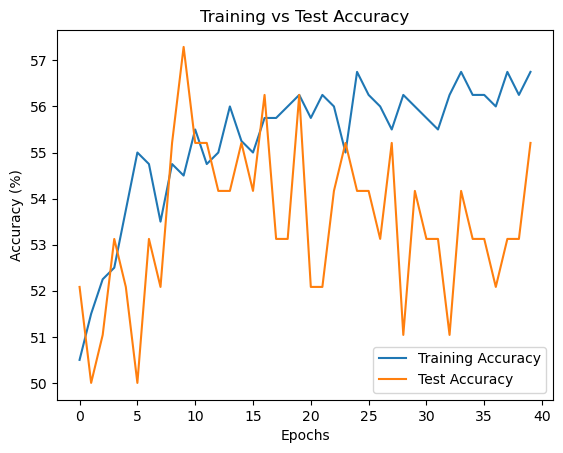

Confusion Matrix:
 [[39 14]
 [34 17]]
Class-specific Accuracy: [0.73584906 0.33333333]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 52.08%, p-value = 0.3170


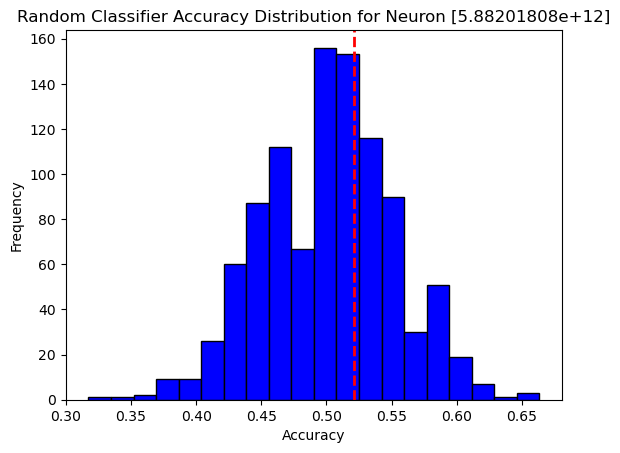

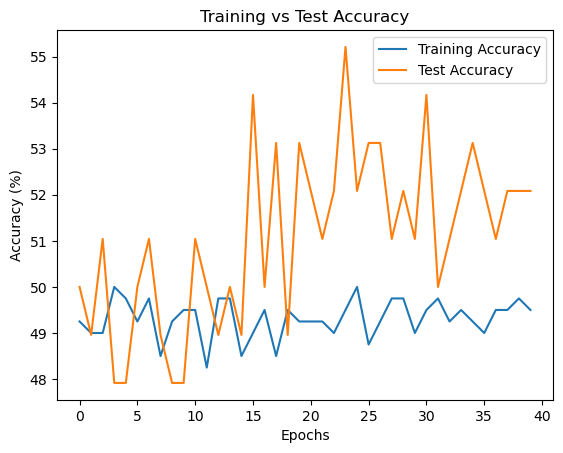

Confusion Matrix:
 [[ 3 50]
 [ 0 51]]
Class-specific Accuracy: [0.05660377 1.        ]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 55.21%, p-value = 0.1330


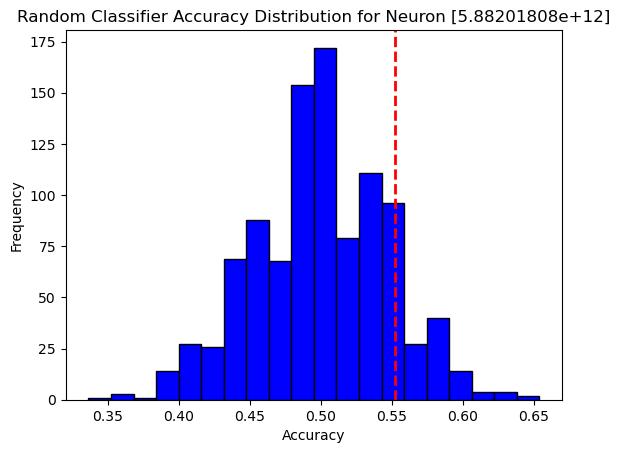

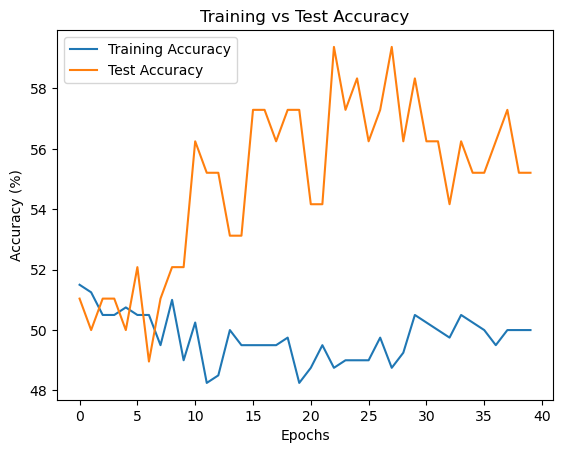

Confusion Matrix:
 [[49  4]
 [42  9]]
Class-specific Accuracy: [0.9245283  0.17647059]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 51.04%, p-value = 0.3690


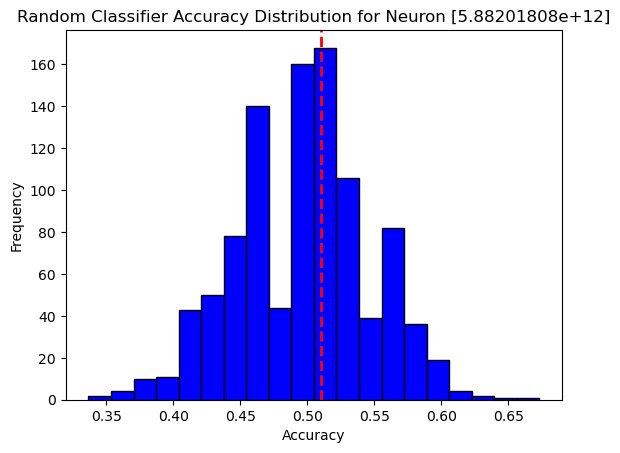

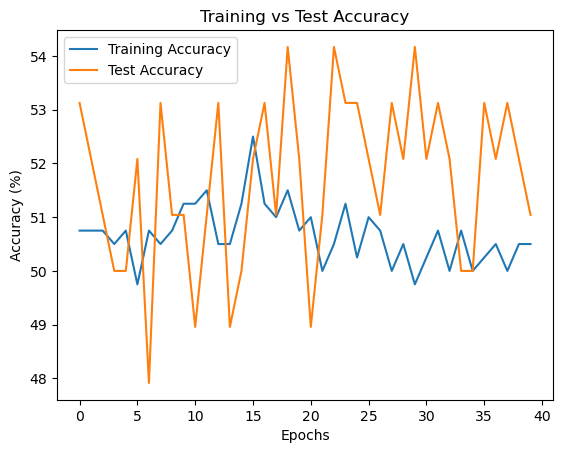

Confusion Matrix:
 [[52  1]
 [49  2]]
Class-specific Accuracy: [0.98113208 0.03921569]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 51.04%, p-value = 0.3660


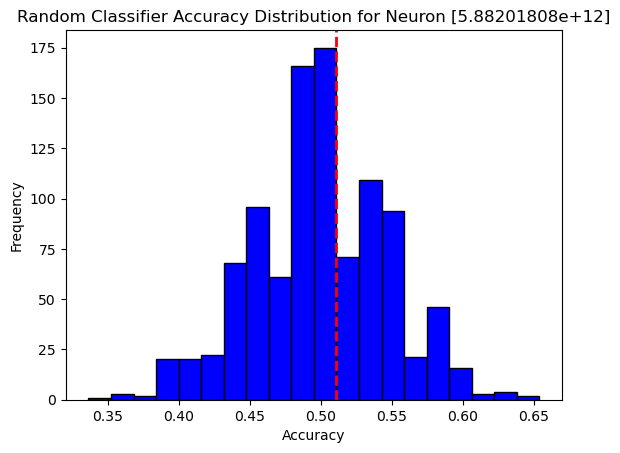

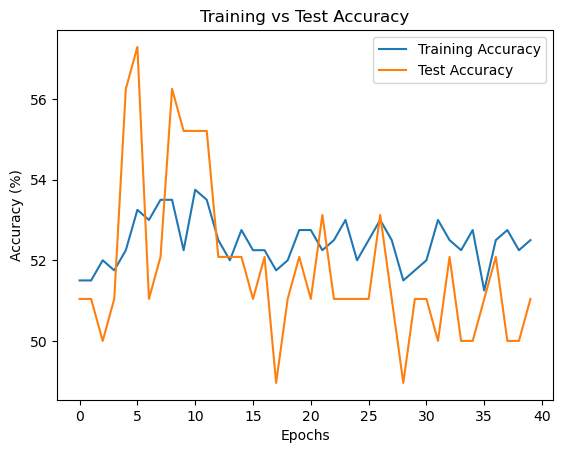

Confusion Matrix:
 [[35 18]
 [33 18]]
Class-specific Accuracy: [0.66037736 0.35294118]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 56.25%, p-value = 0.0990


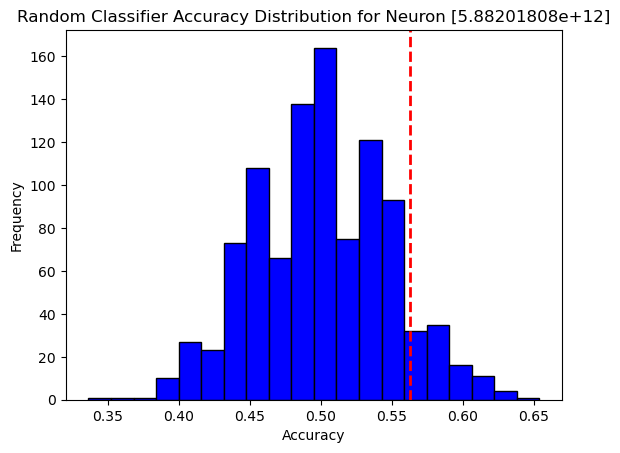

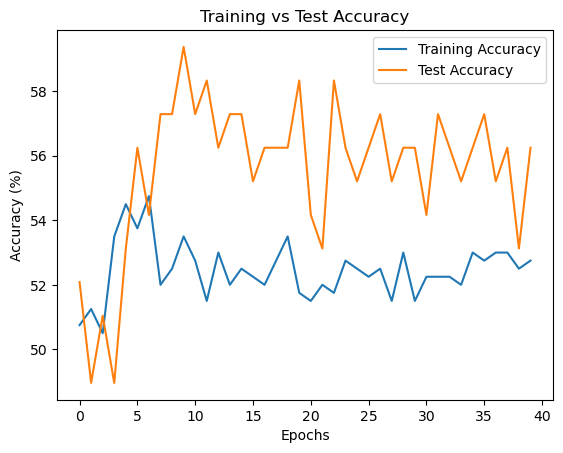

Confusion Matrix:
 [[36 17]
 [29 22]]
Class-specific Accuracy: [0.67924528 0.43137255]

 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 53.12%, p-value = 0.2370


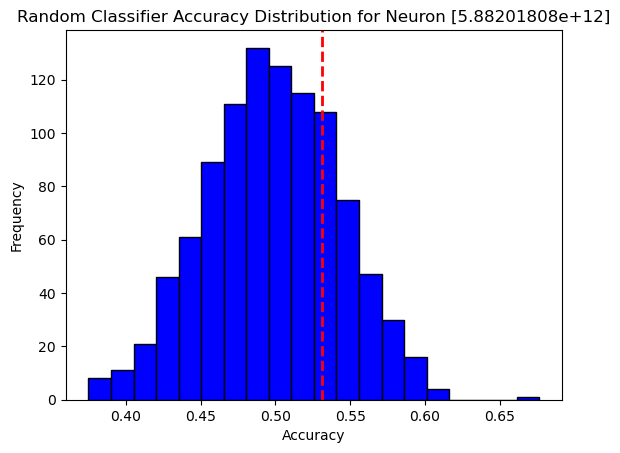

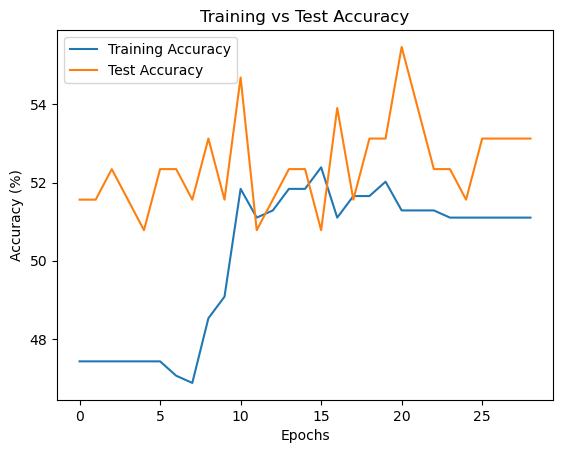

Confusion Matrix:
 [[27 38]
 [25 46]]
Class-specific Accuracy: [0.41538462 0.64788732]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 41.67%, p-value = 0.9730


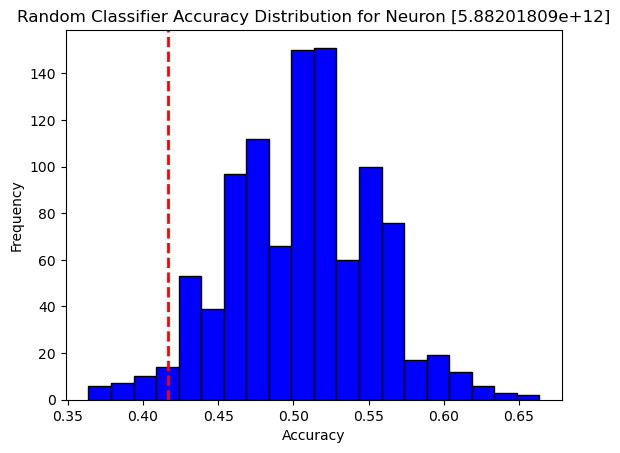

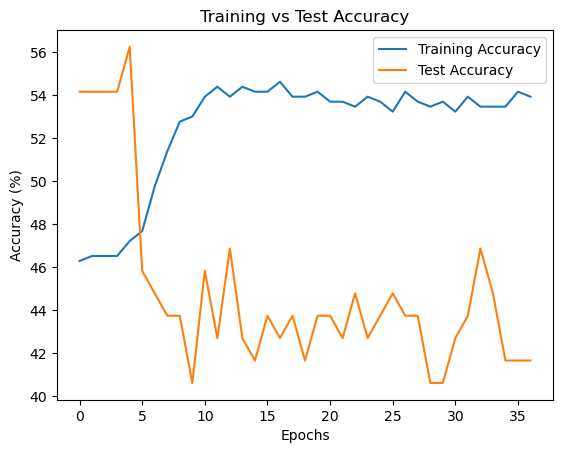

Confusion Matrix:
 [[45  4]
 [58  3]]
Class-specific Accuracy: [0.91836735 0.04918033]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 42.71%, p-value = 0.9560


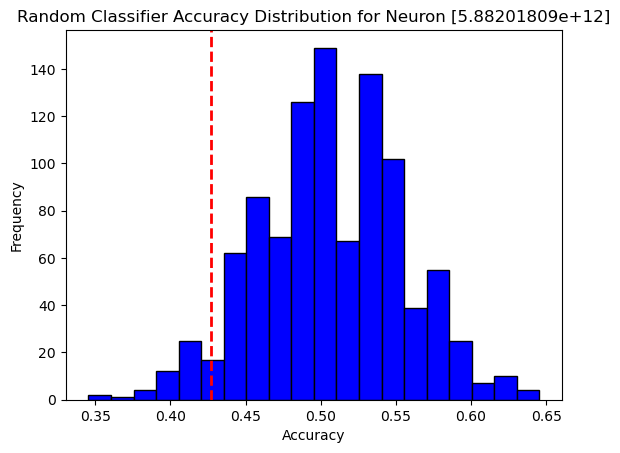

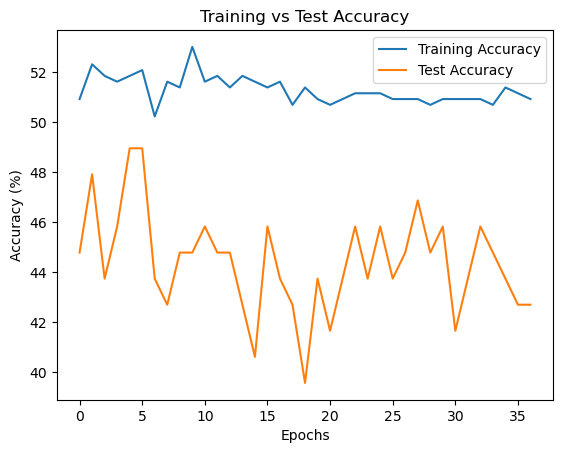

Confusion Matrix:
 [[36 13]
 [48 13]]
Class-specific Accuracy: [0.73469388 0.21311475]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8640


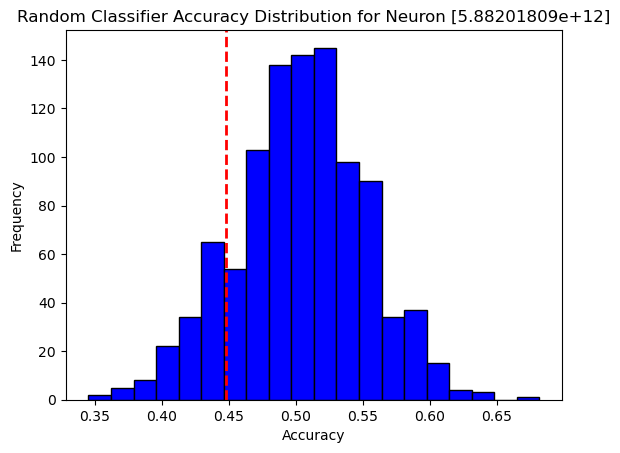

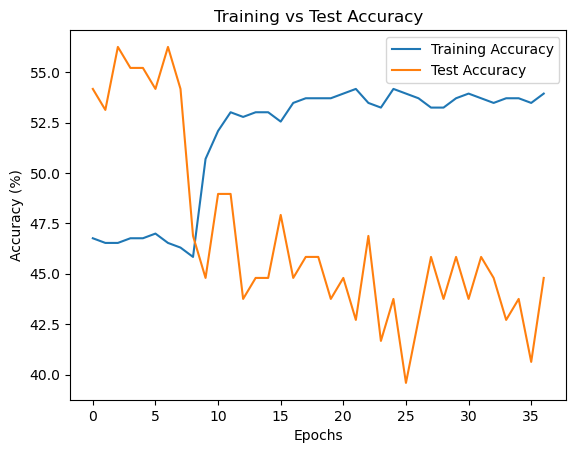

Confusion Matrix:
 [[47  2]
 [59  2]]
Class-specific Accuracy: [0.95918367 0.03278689]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8720


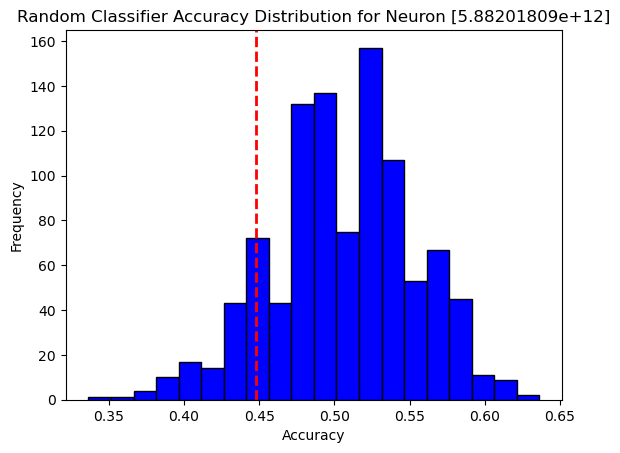

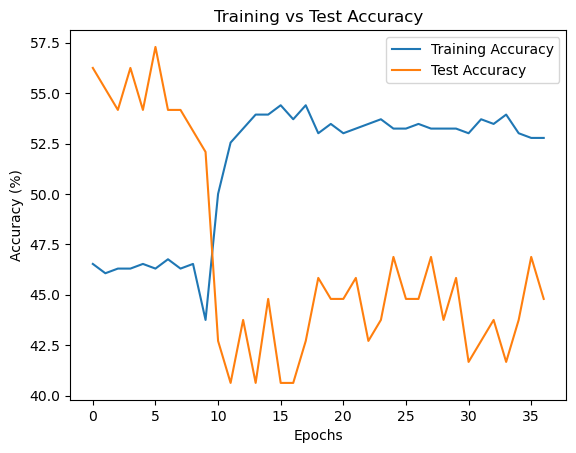

Confusion Matrix:
 [[48  1]
 [60  1]]
Class-specific Accuracy: [0.97959184 0.01639344]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8720


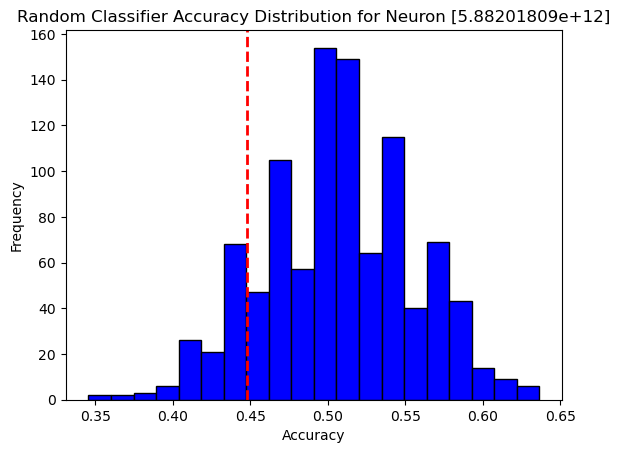

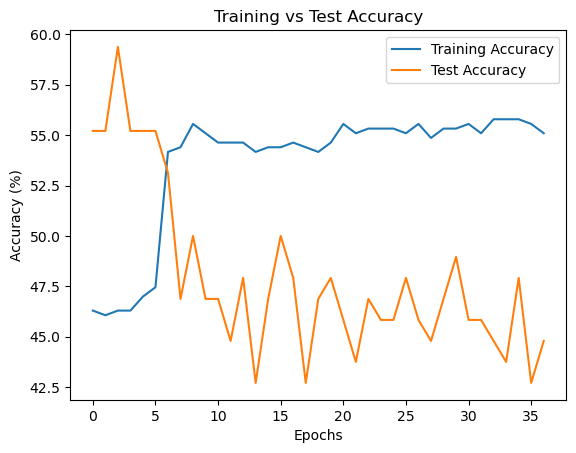

Confusion Matrix:
 [[45  4]
 [55  6]]
Class-specific Accuracy: [0.91836735 0.09836066]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 42.71%, p-value = 0.9500


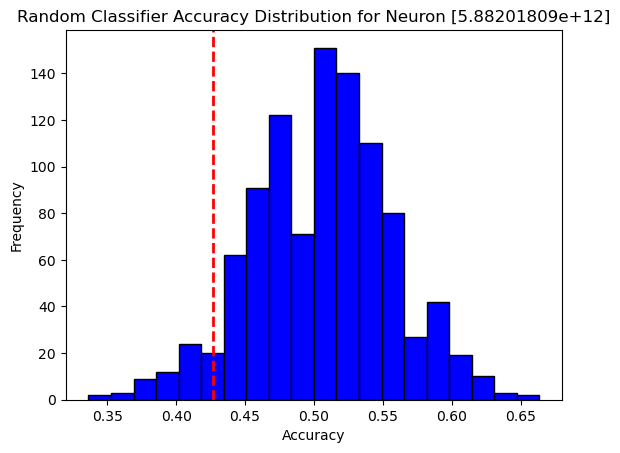

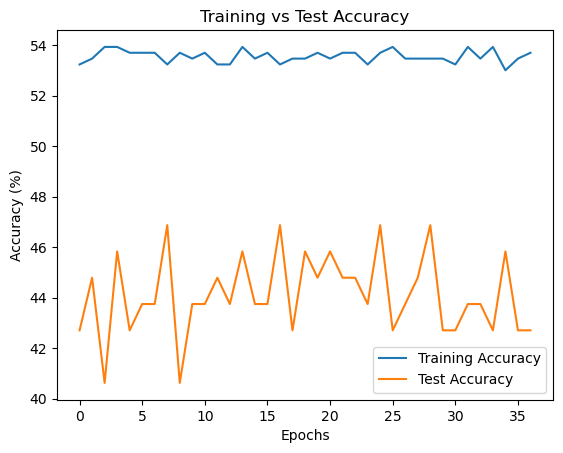

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 45.83%, p-value = 0.8420


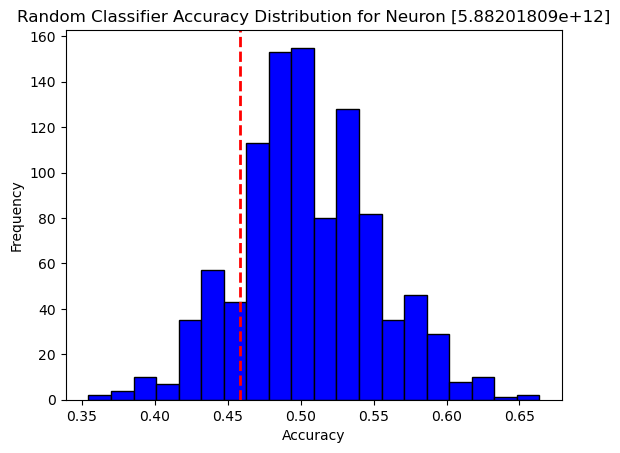

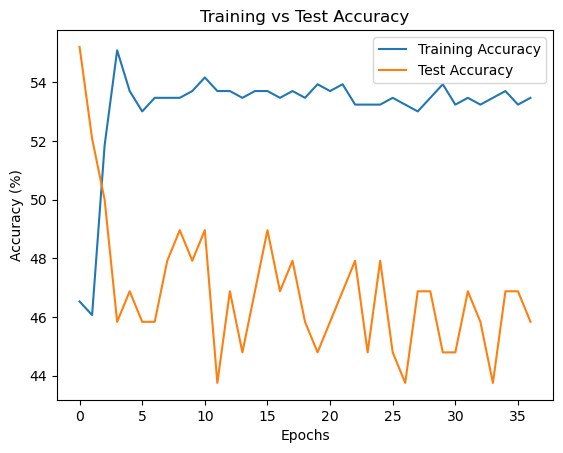

Confusion Matrix:
 [[44  5]
 [54  7]]
Class-specific Accuracy: [0.89795918 0.1147541 ]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 40.62%, p-value = 0.9820


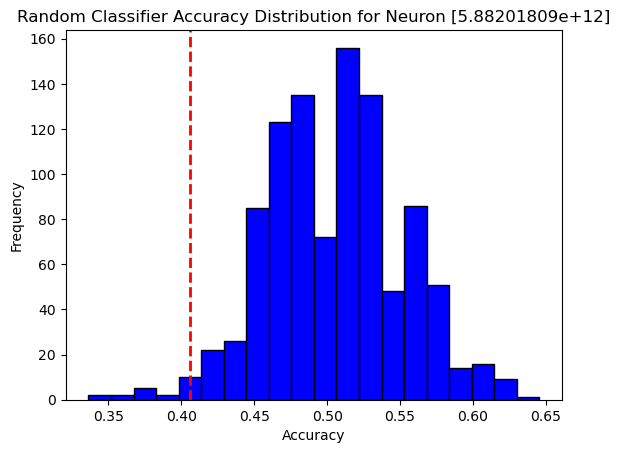

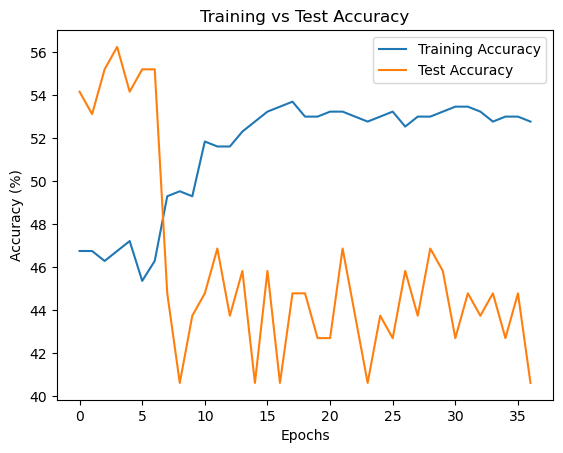

Confusion Matrix:
 [[46  3]
 [59  2]]
Class-specific Accuracy: [0.93877551 0.03278689]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.88%, p-value = 0.7600


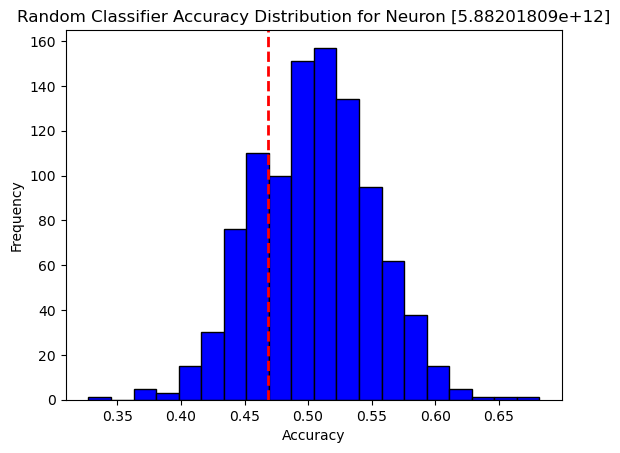

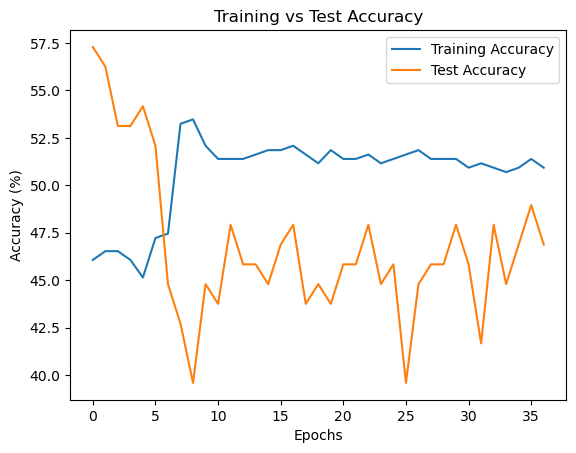

Confusion Matrix:
 [[36 13]
 [47 14]]
Class-specific Accuracy: [0.73469388 0.2295082 ]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 40.62%, p-value = 0.9870


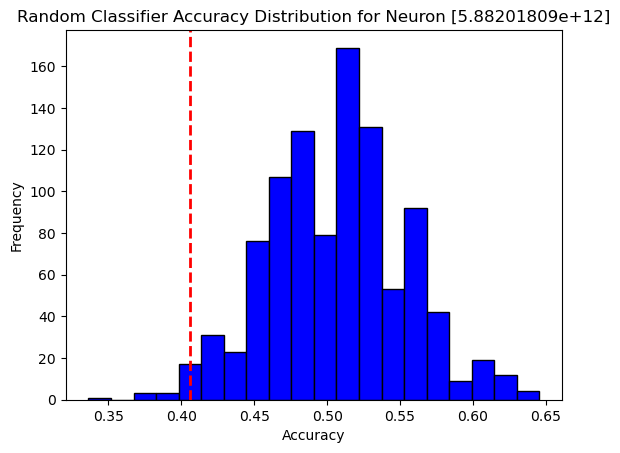

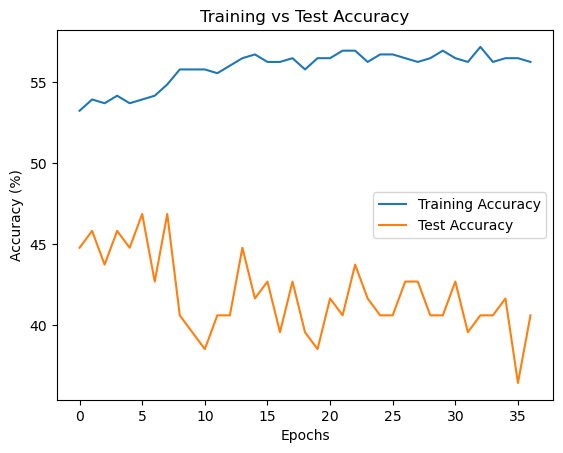

Confusion Matrix:
 [[42  7]
 [57  4]]
Class-specific Accuracy: [0.85714286 0.06557377]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8760


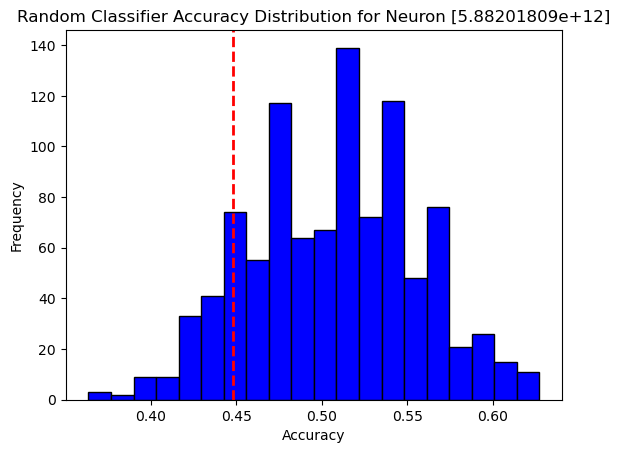

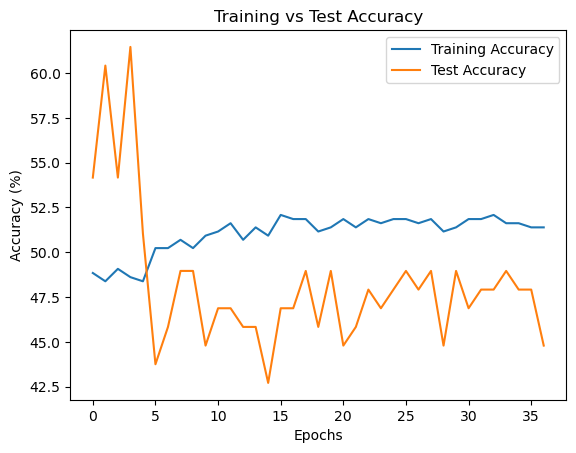

Confusion Matrix:
 [[39 10]
 [48 13]]
Class-specific Accuracy: [0.79591837 0.21311475]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.00%, p-value = 0.5960


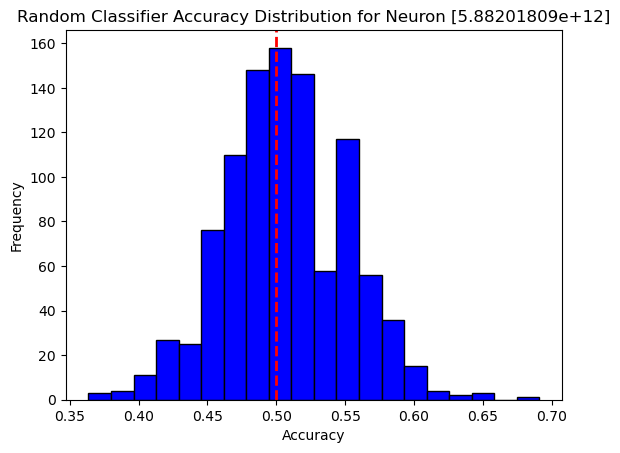

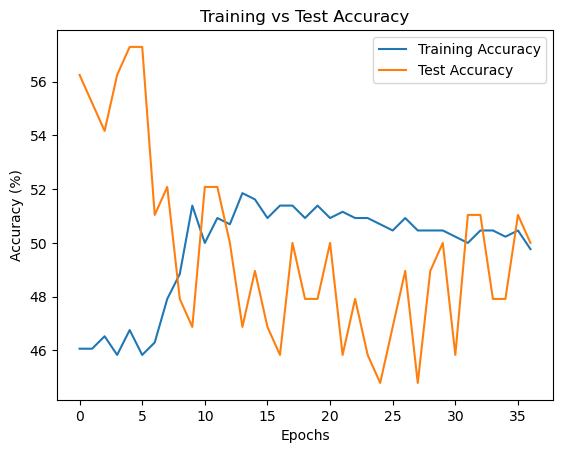

Confusion Matrix:
 [[33 16]
 [41 20]]
Class-specific Accuracy: [0.67346939 0.32786885]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 42.71%, p-value = 0.9600


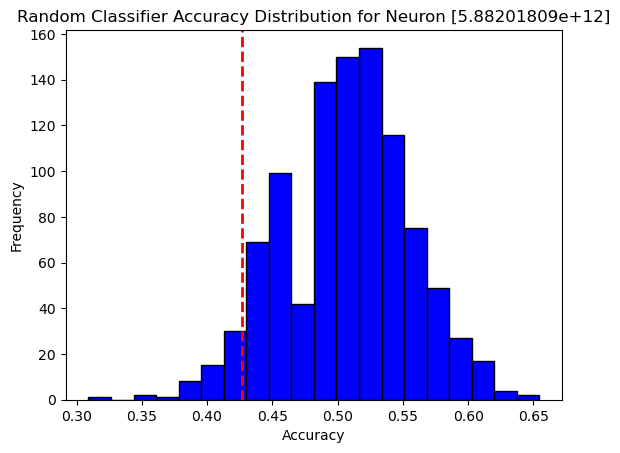

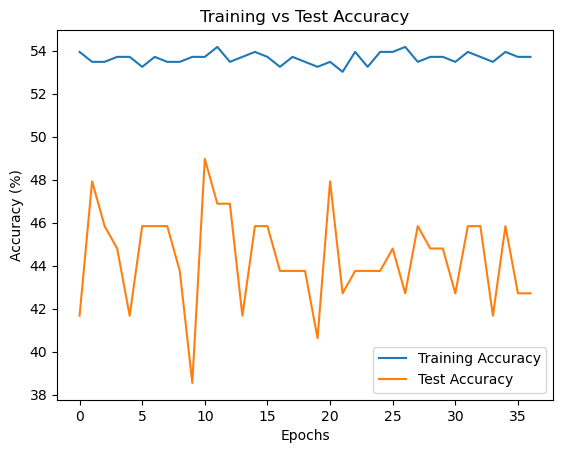

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 45.83%, p-value = 0.8330


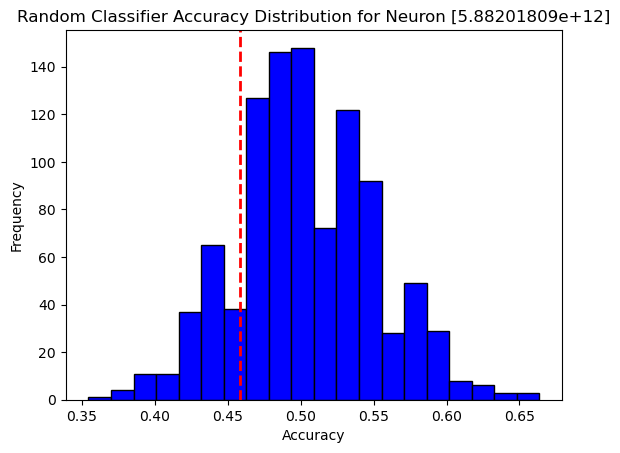

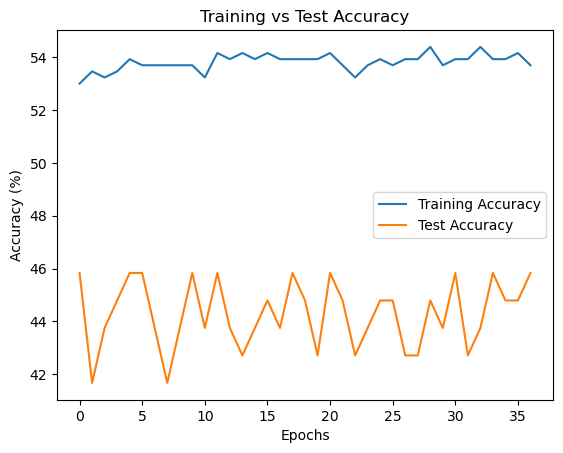

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.96%, p-value = 0.6980


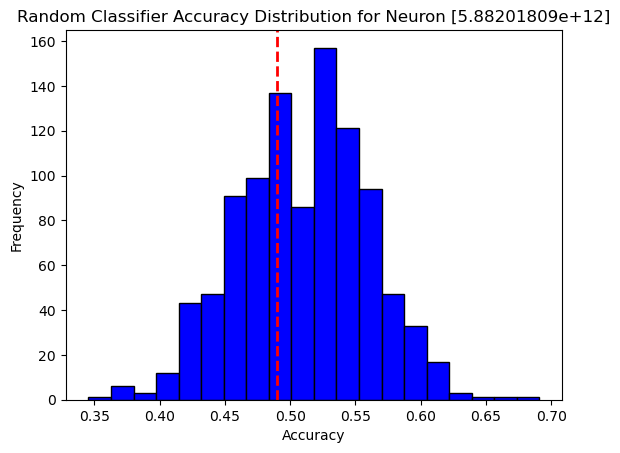

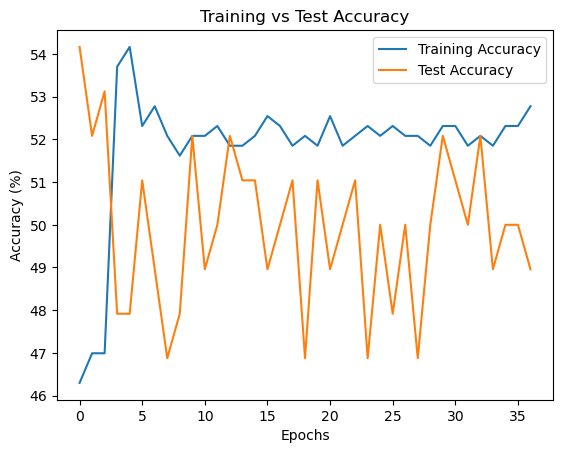

Confusion Matrix:
 [[43  6]
 [49 12]]
Class-specific Accuracy: [0.87755102 0.19672131]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 43.75%, p-value = 0.9240


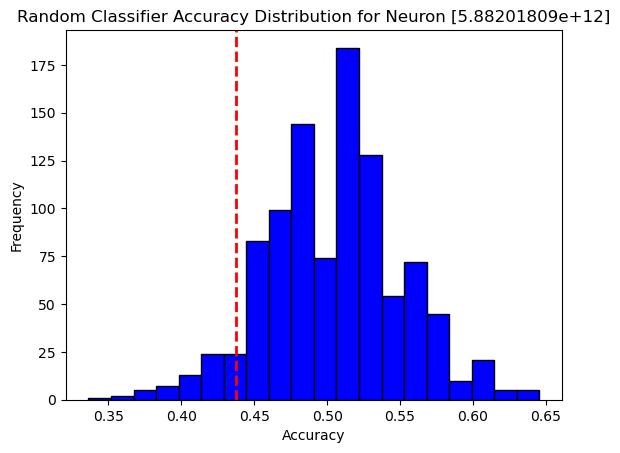

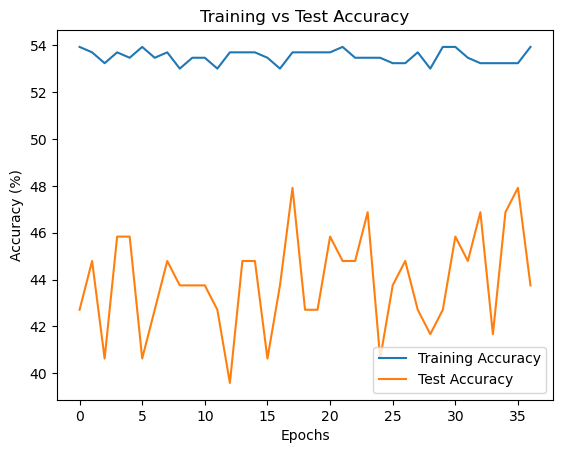

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 45.83%, p-value = 0.8380


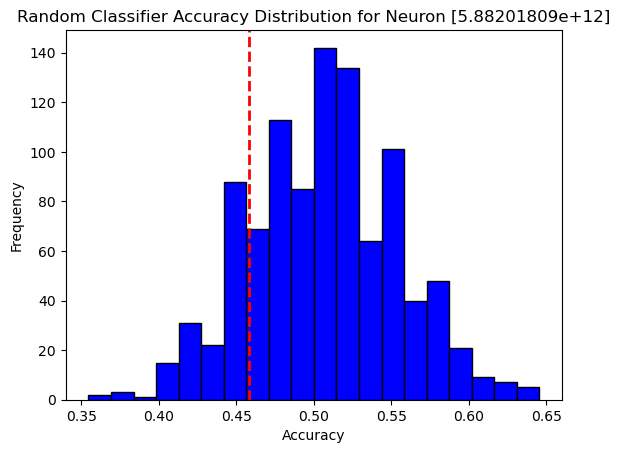

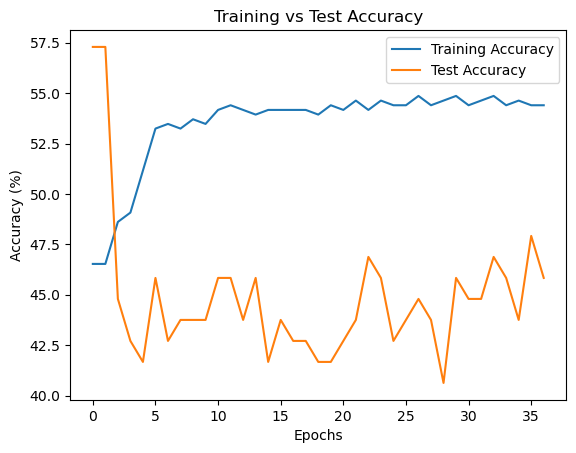

Confusion Matrix:
 [[45  4]
 [57  4]]
Class-specific Accuracy: [0.91836735 0.06557377]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 56.25%, p-value = 0.1280


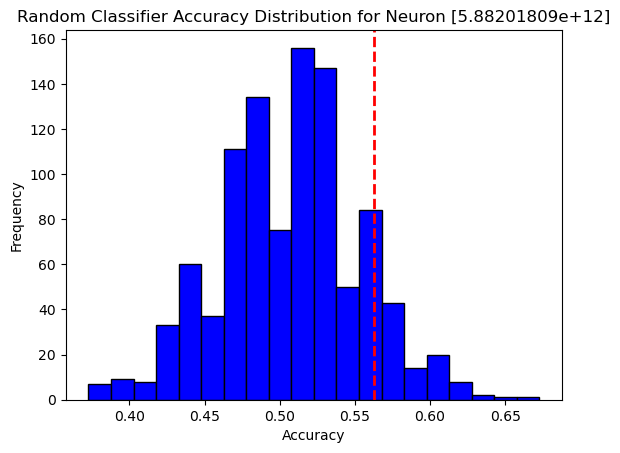

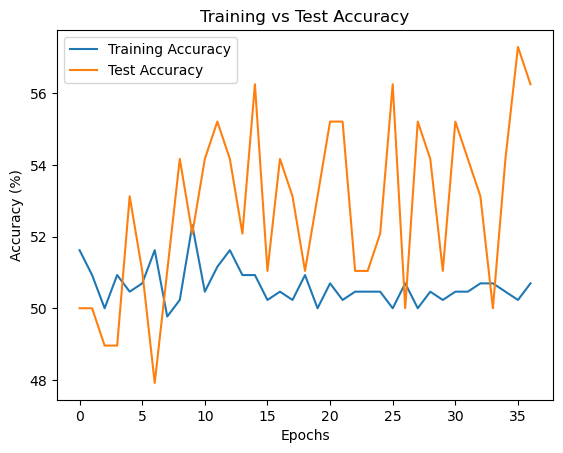

Confusion Matrix:
 [[48  1]
 [50 11]]
Class-specific Accuracy: [0.97959184 0.18032787]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.96%, p-value = 0.6700


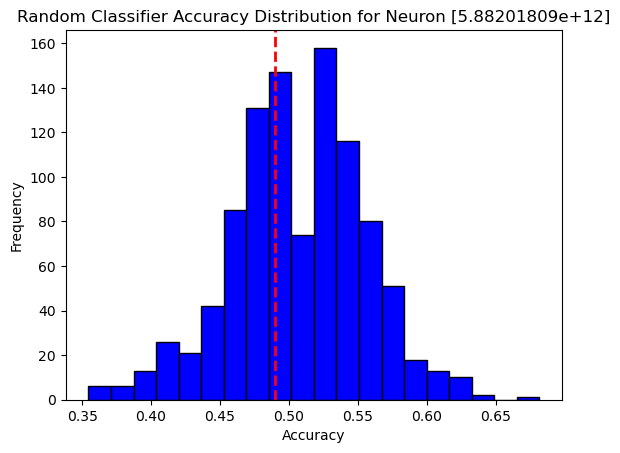

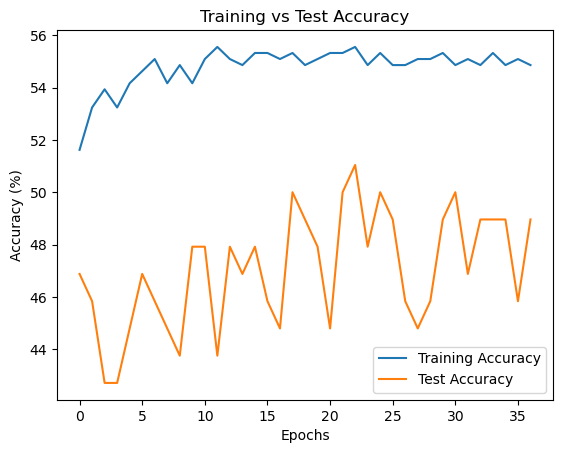

Confusion Matrix:
 [[41  8]
 [49 12]]
Class-specific Accuracy: [0.83673469 0.19672131]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 43.75%, p-value = 0.9230


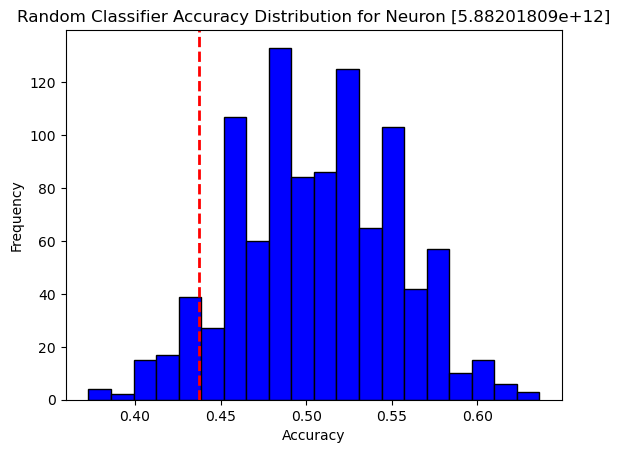

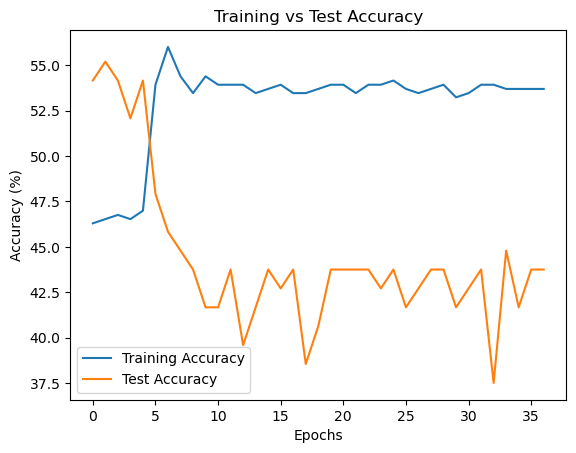

Confusion Matrix:
 [[47  2]
 [61  0]]
Class-specific Accuracy: [0.95918367 0.        ]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8790


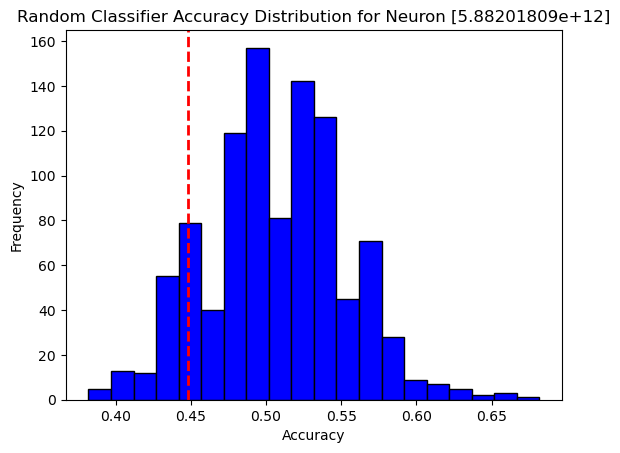

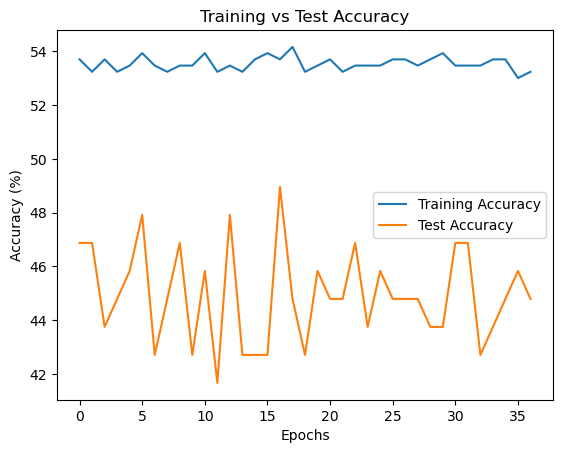

Confusion Matrix:
 [[49  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 42.71%, p-value = 0.9690


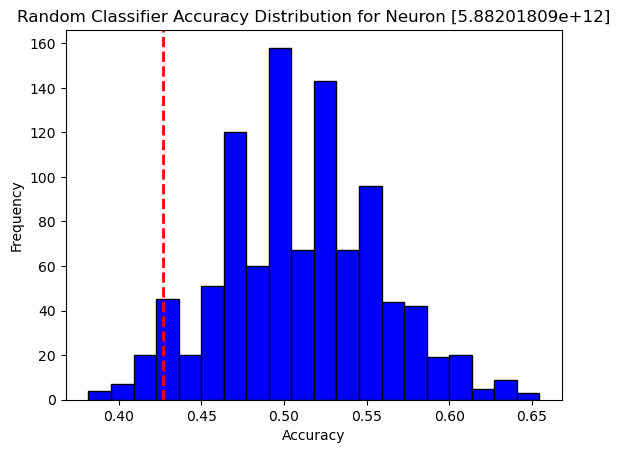

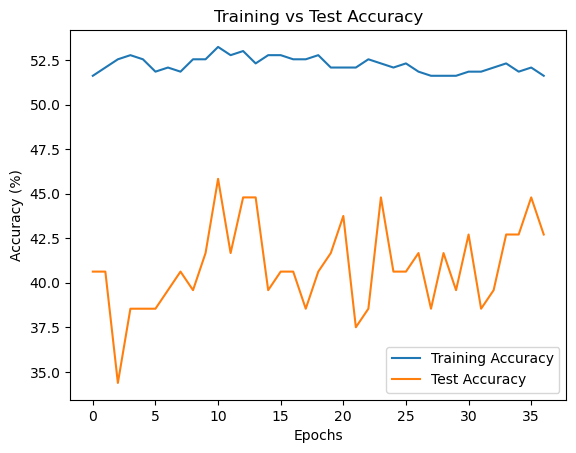

Confusion Matrix:
 [[32 17]
 [47 14]]
Class-specific Accuracy: [0.65306122 0.2295082 ]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.00%, p-value = 0.5820


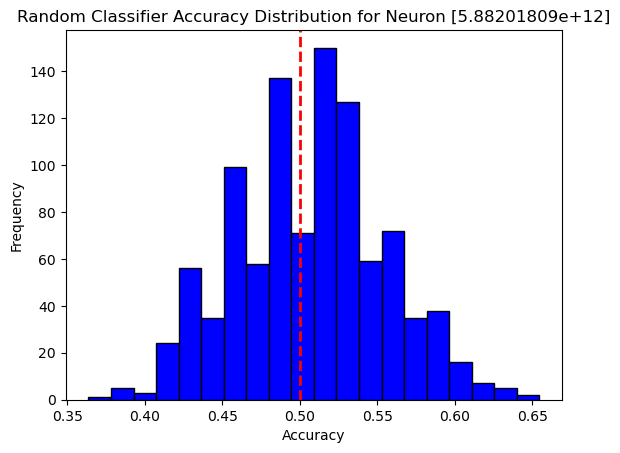

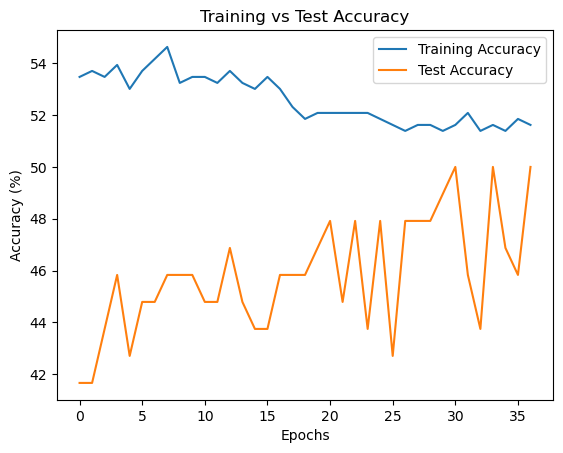

Confusion Matrix:
 [[43  6]
 [53  8]]
Class-specific Accuracy: [0.87755102 0.13114754]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.79%, p-value = 0.8870


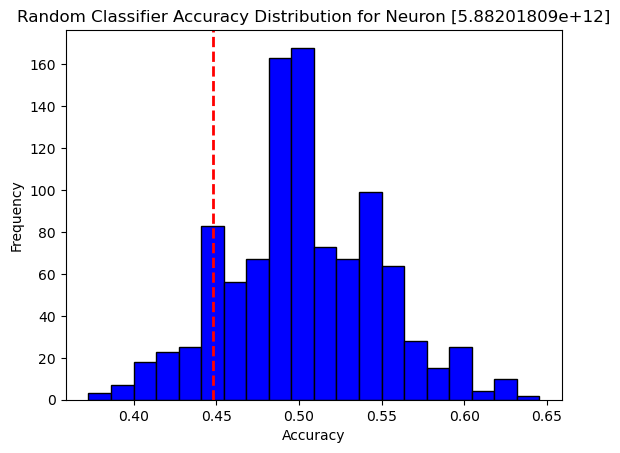

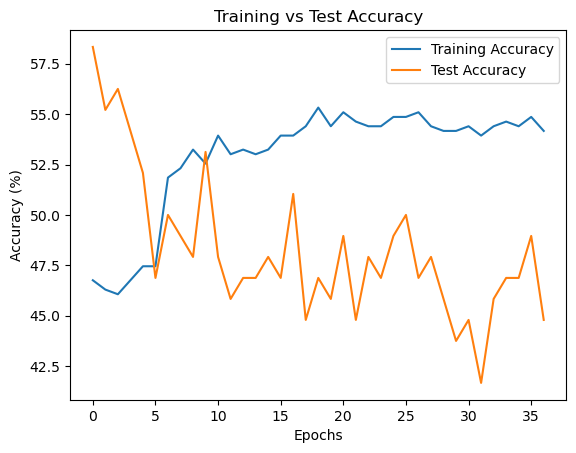

Confusion Matrix:
 [[45  4]
 [55  6]]
Class-specific Accuracy: [0.91836735 0.09836066]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 47.92%, p-value = 0.7160


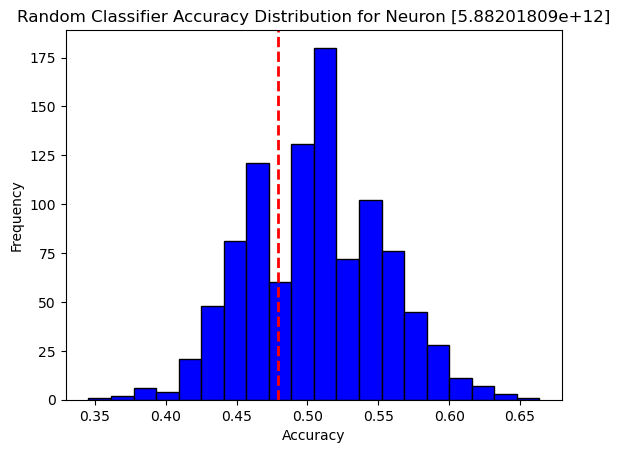

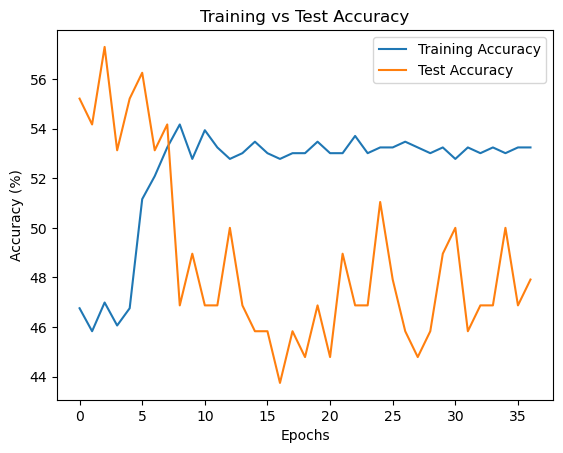

Confusion Matrix:
 [[49  0]
 [58  3]]
Class-specific Accuracy: [1.         0.04918033]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.21%, p-value = 0.6870


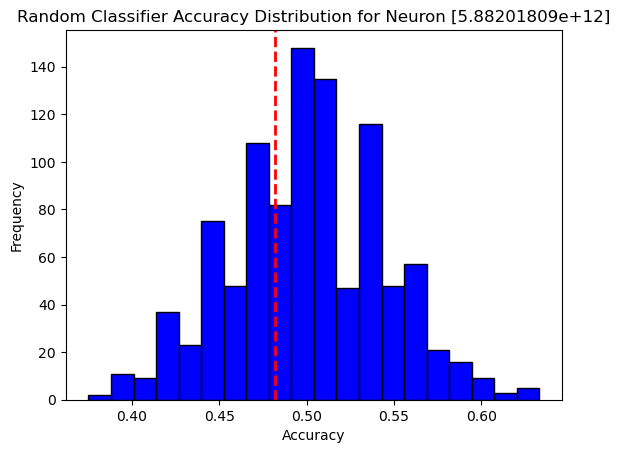

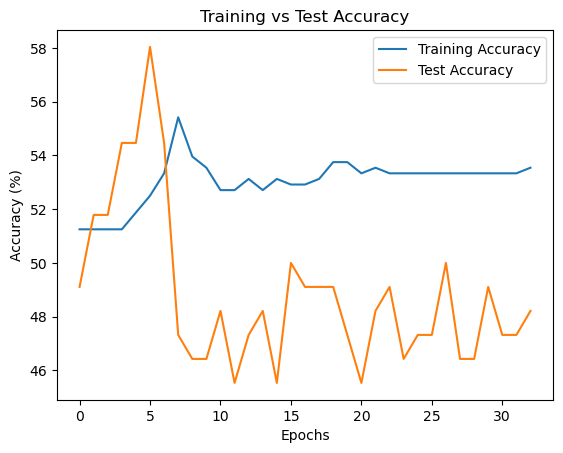

Confusion Matrix:
 [[36 26]
 [37 21]]
Class-specific Accuracy: [0.58064516 0.36206897]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.89%, p-value = 0.4000


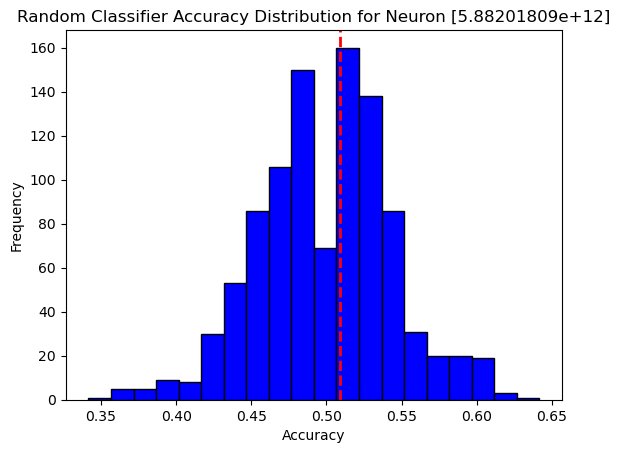

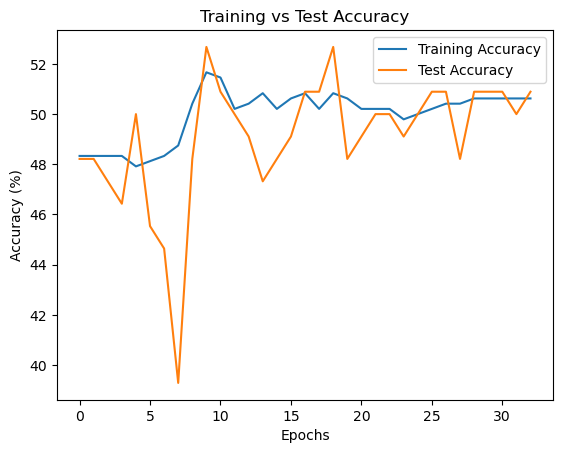

Confusion Matrix:
 [[38 24]
 [35 23]]
Class-specific Accuracy: [0.61290323 0.39655172]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 56.25%, p-value = 0.0940


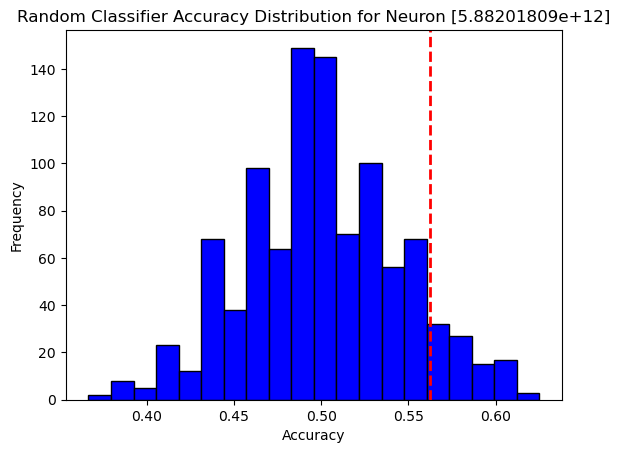

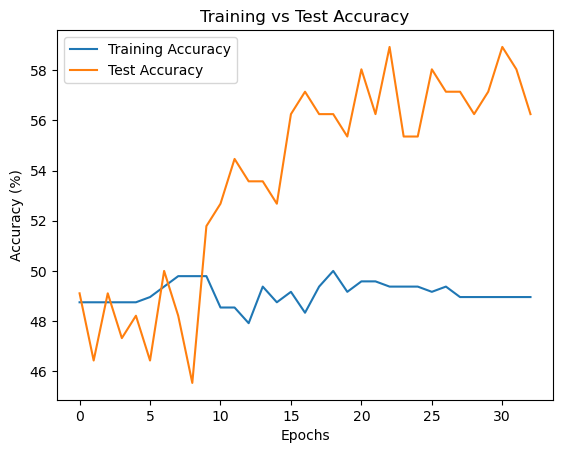

Confusion Matrix:
 [[37 25]
 [27 31]]
Class-specific Accuracy: [0.59677419 0.53448276]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 58.04%, p-value = 0.0390


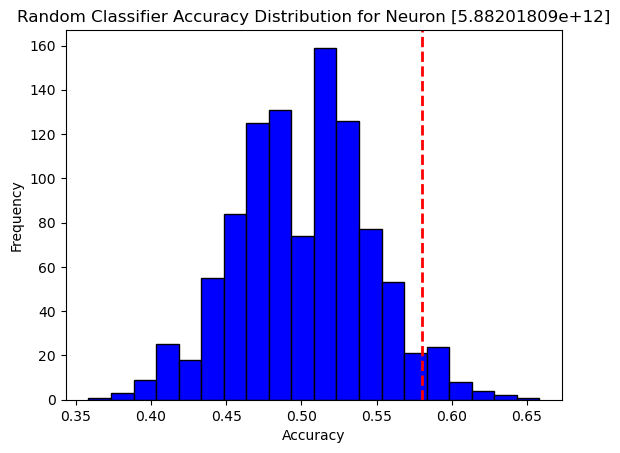

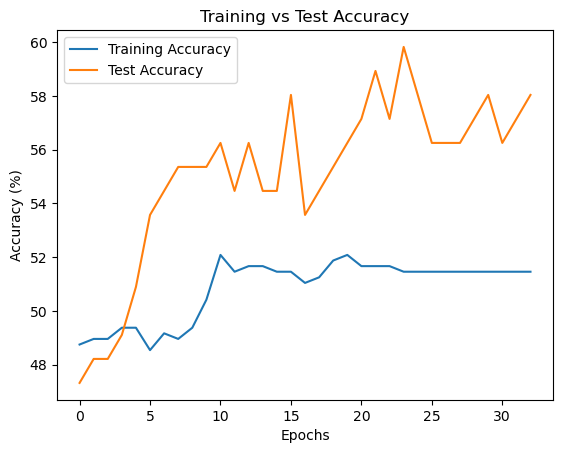

Confusion Matrix:
 [[26 36]
 [16 42]]
Class-specific Accuracy: [0.41935484 0.72413793]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.89%, p-value = 0.3960


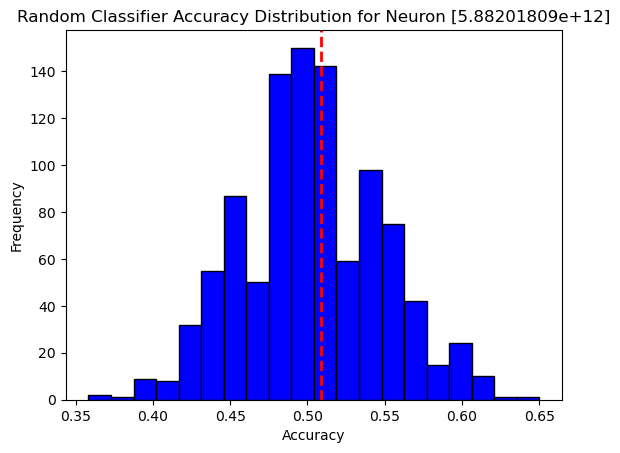

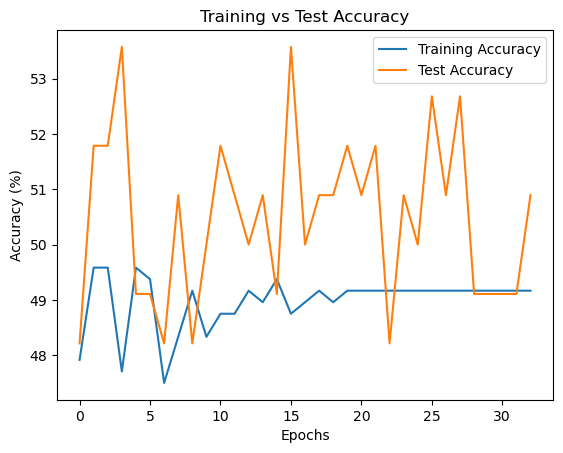

Confusion Matrix:
 [[47 15]
 [44 14]]
Class-specific Accuracy: [0.75806452 0.24137931]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.75%, p-value = 0.5810


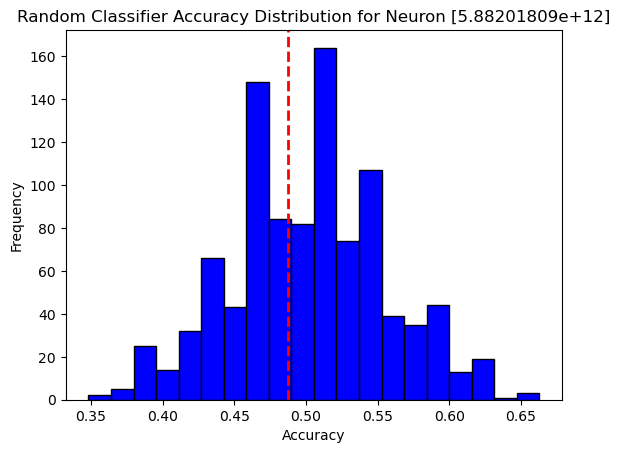

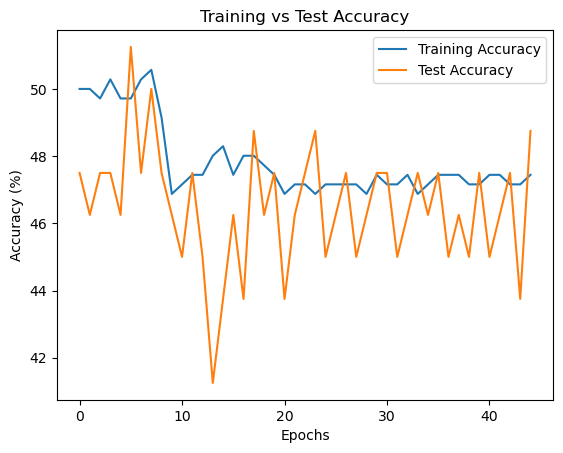

Confusion Matrix:
 [[ 5 42]
 [ 6 36]]
Class-specific Accuracy: [0.10638298 0.85714286]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.88%, p-value = 0.7460


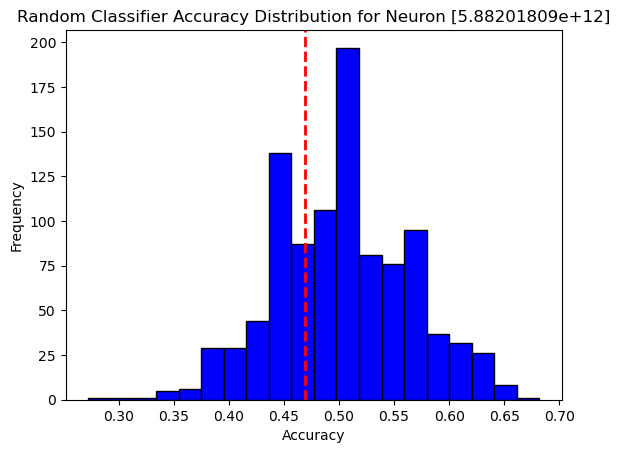

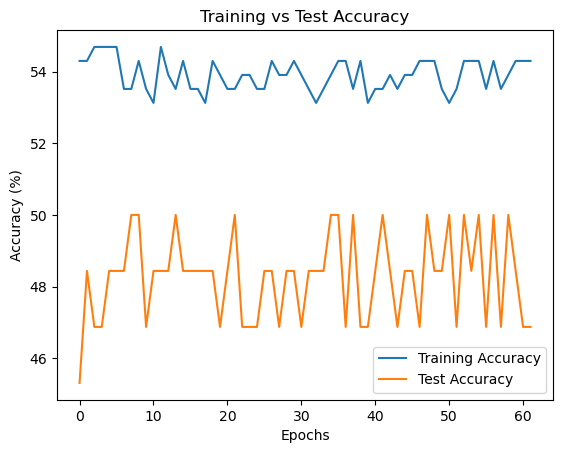

Confusion Matrix:
 [[31  0]
 [34  1]]
Class-specific Accuracy: [1.         0.02857143]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.88%, p-value = 0.7190


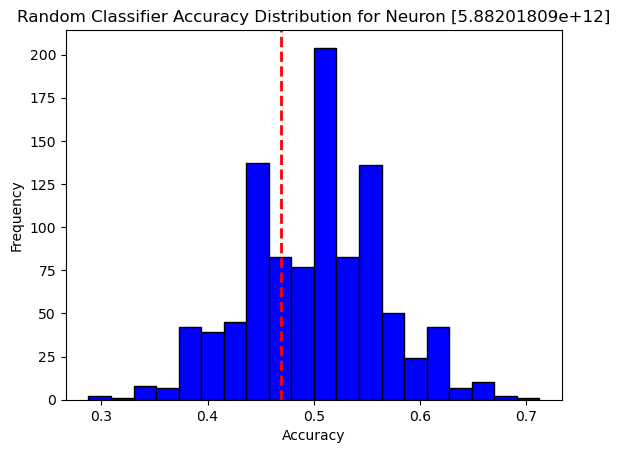

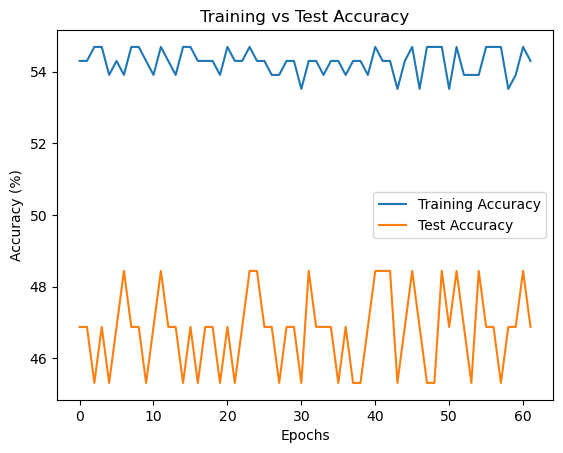

Confusion Matrix:
 [[31  0]
 [35  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.00%, p-value = 0.5720


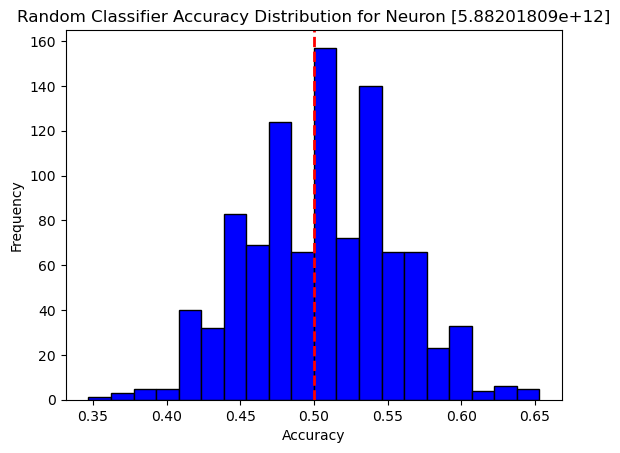

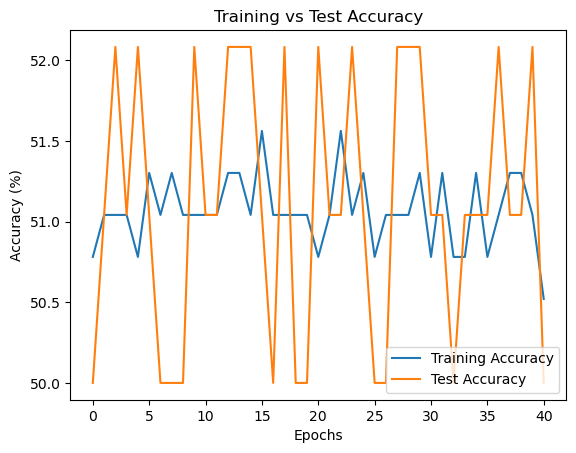

Confusion Matrix:
 [[50  0]
 [48  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 50.00%, p-value = 0.5390


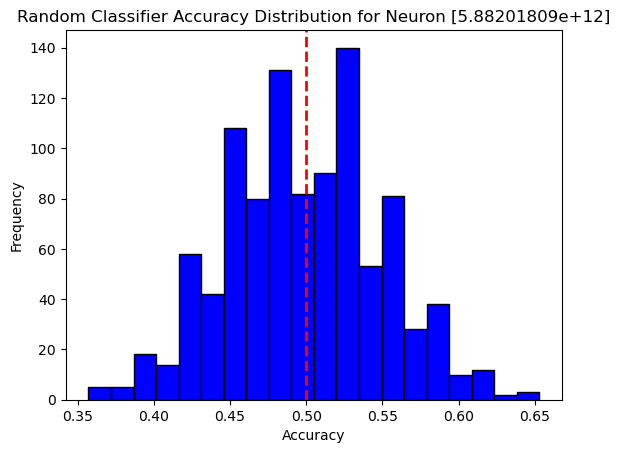

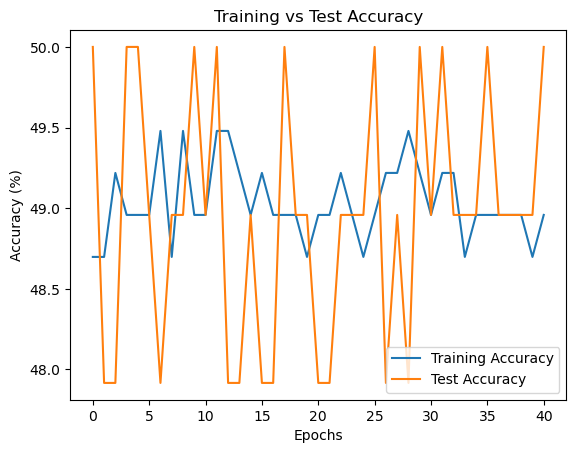

Confusion Matrix:
 [[ 0 50]
 [ 0 48]]
Class-specific Accuracy: [0. 1.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 51.04%, p-value = 0.3900


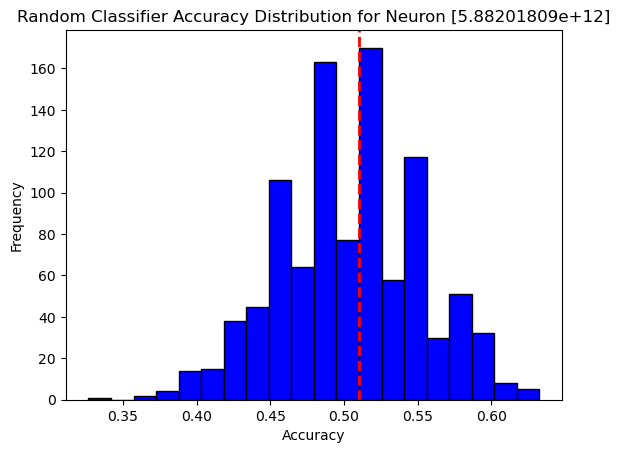

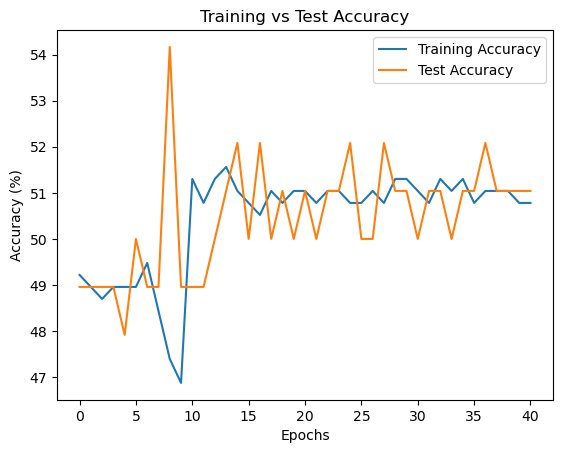

Confusion Matrix:
 [[50  0]
 [48  0]]
Class-specific Accuracy: [1. 0.]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 53.12%, p-value = 0.2340


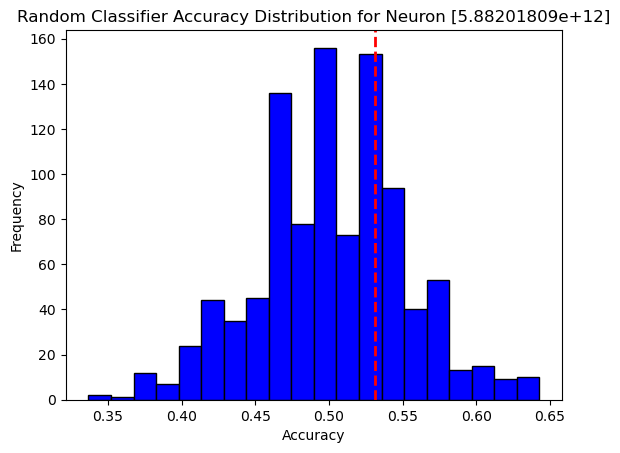

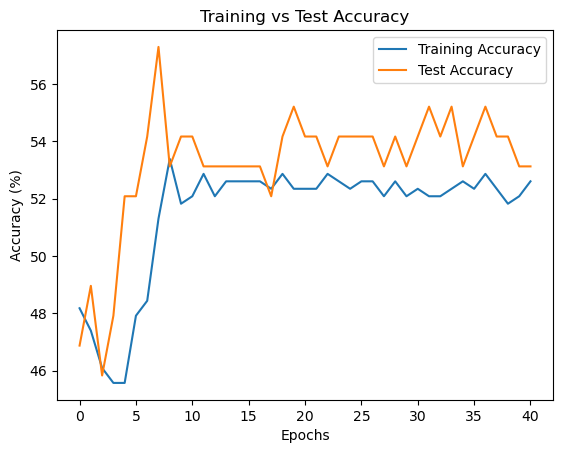

Confusion Matrix:
 [[27 23]
 [22 26]]
Class-specific Accuracy: [0.54       0.54166667]

 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 52.08%, p-value = 0.3080


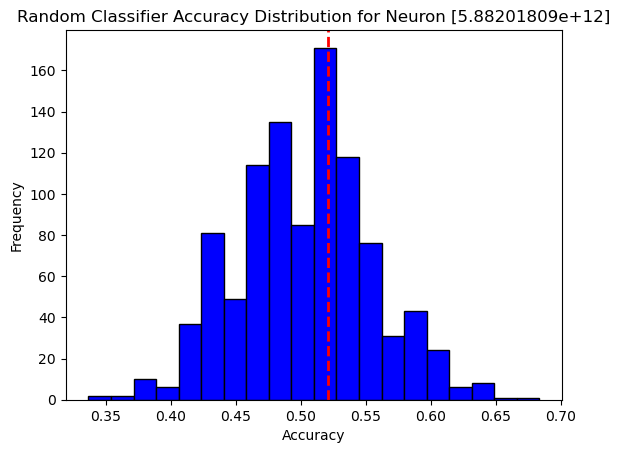

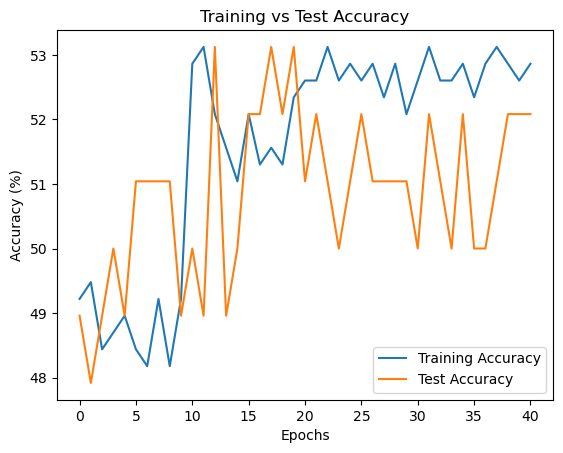

Confusion Matrix:
 [[47  3]
 [45  3]]
Class-specific Accuracy: [0.94   0.0625]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 56.25%, p-value = 0.1600


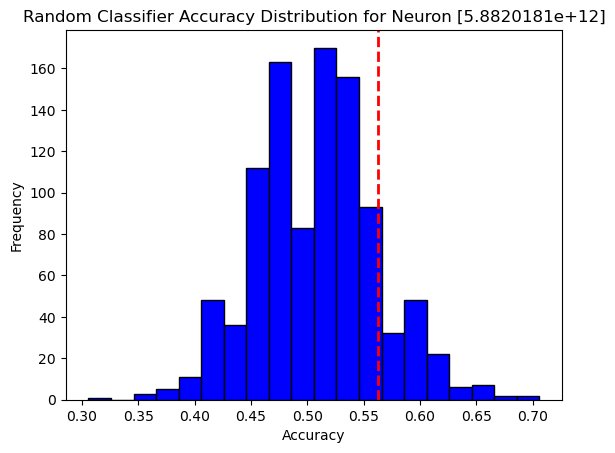

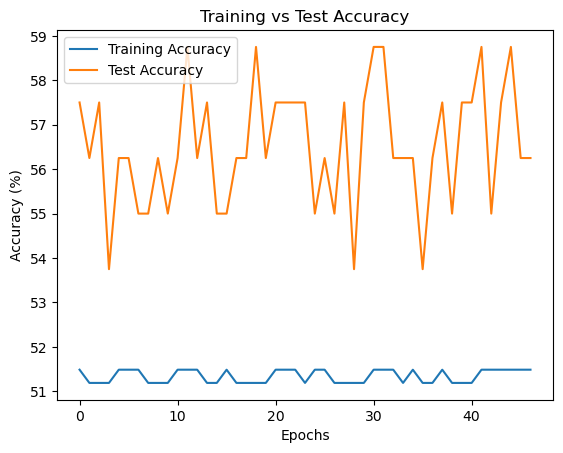

Confusion Matrix:
 [[48  0]
 [37  0]]
Class-specific Accuracy: [1. 0.]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 42.50%, p-value = 0.9280


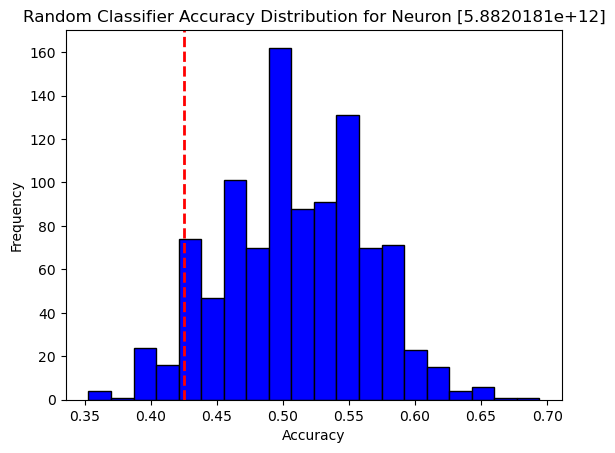

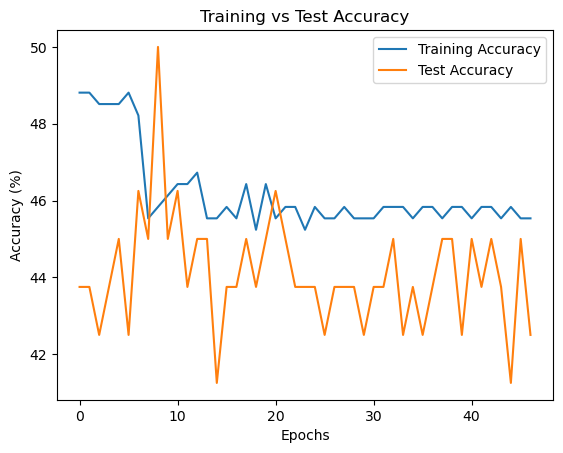

Confusion Matrix:
 [[10 38]
 [10 27]]
Class-specific Accuracy: [0.20833333 0.72972973]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 56.25%, p-value = 0.1680


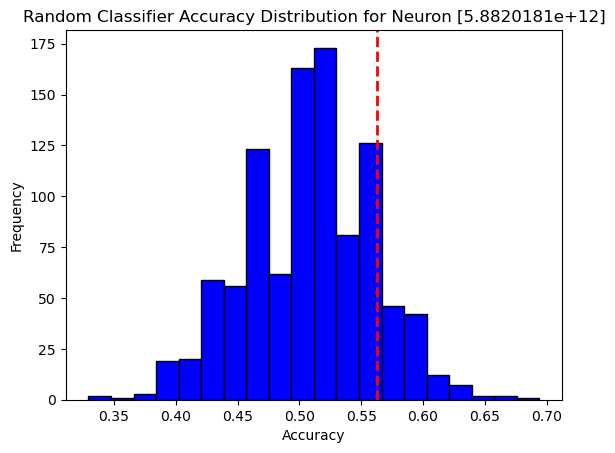

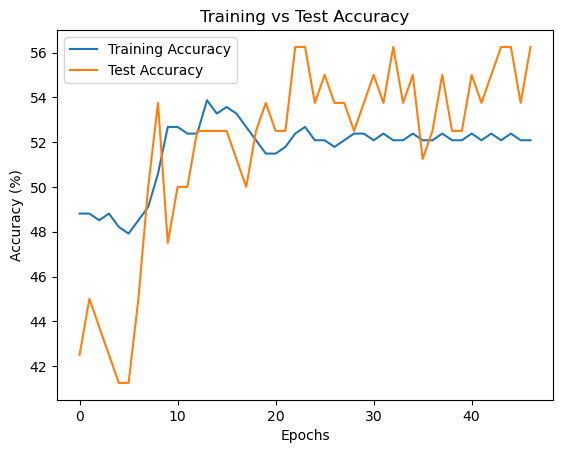

Confusion Matrix:
 [[31 17]
 [22 15]]
Class-specific Accuracy: [0.64583333 0.40540541]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 50.00%, p-value = 0.5720


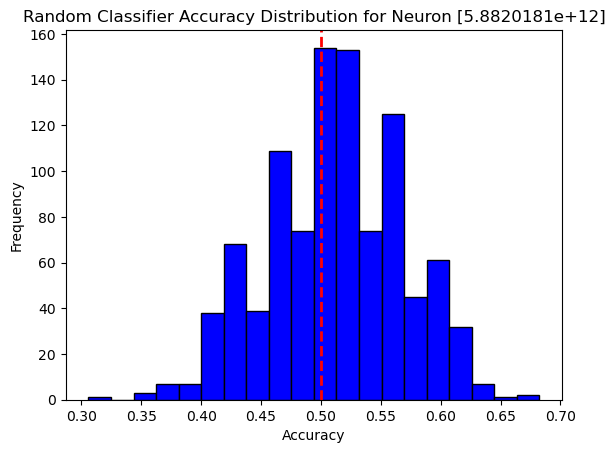

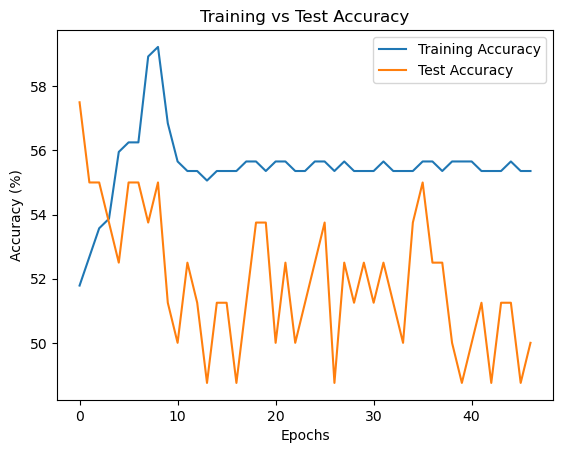

Confusion Matrix:
 [[36 12]
 [30  7]]
Class-specific Accuracy: [0.75       0.18918919]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 47.50%, p-value = 0.7200


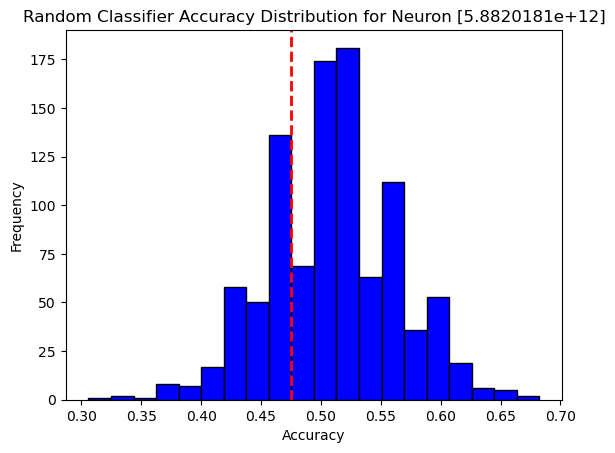

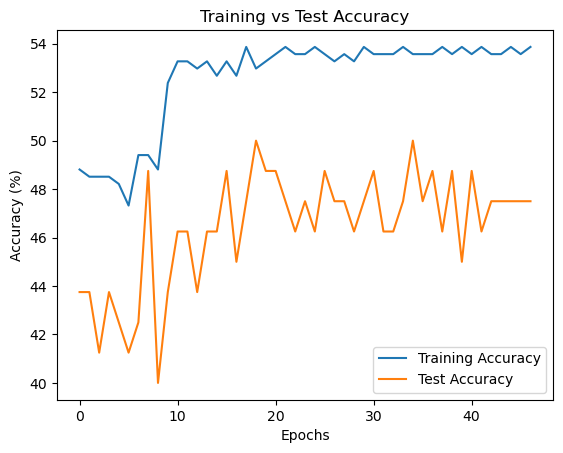

Confusion Matrix:
 [[36 12]
 [33  4]]
Class-specific Accuracy: [0.75       0.10810811]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 45.54%, p-value = 0.8520


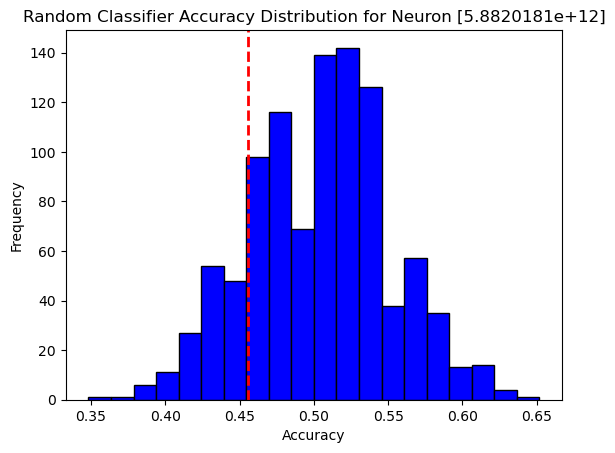

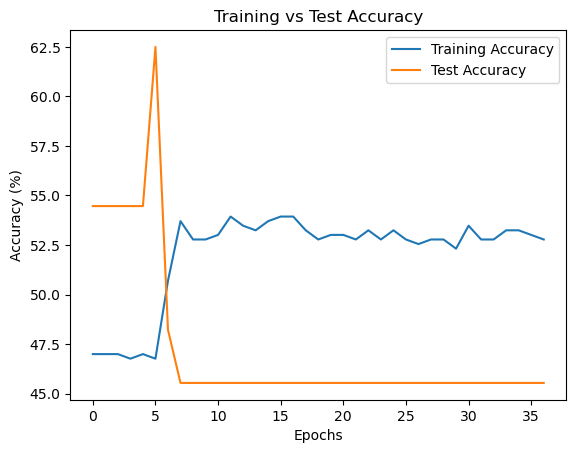

Confusion Matrix:
 [[51  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 44.64%, p-value = 0.9240


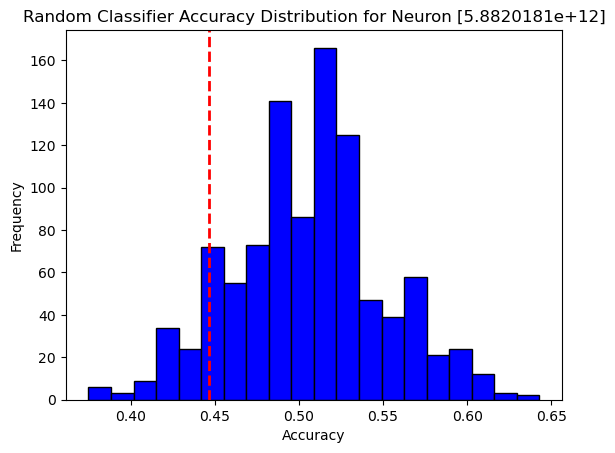

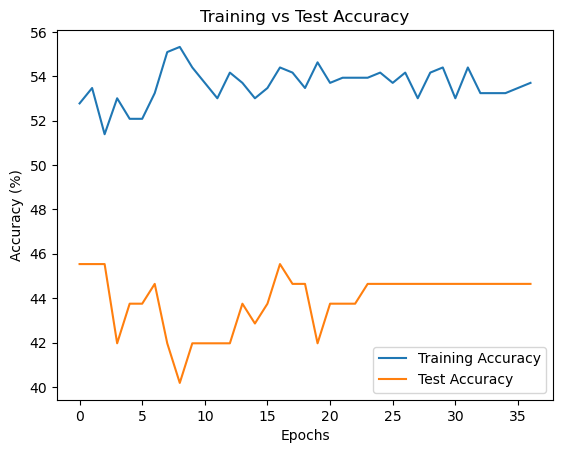

Confusion Matrix:
 [[28 23]
 [39 22]]
Class-specific Accuracy: [0.54901961 0.36065574]

 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 45.54%, p-value = 0.8810


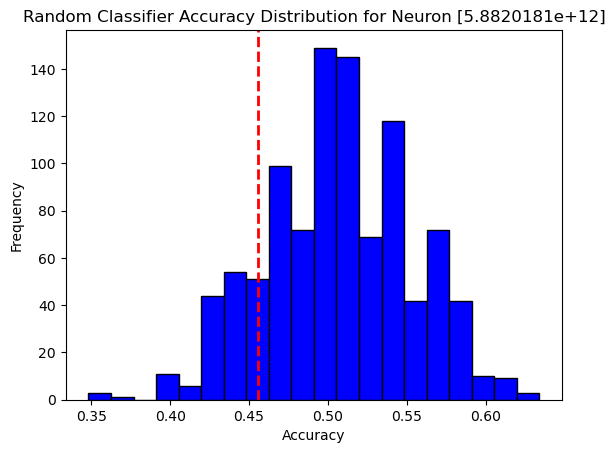

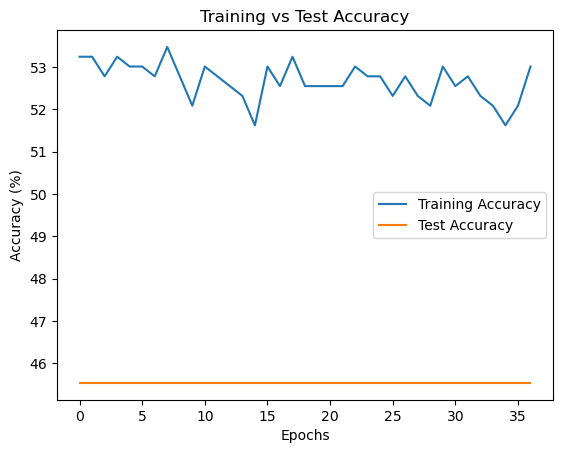

Confusion Matrix:
 [[51  0]
 [61  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 54.17%, p-value = 0.2450


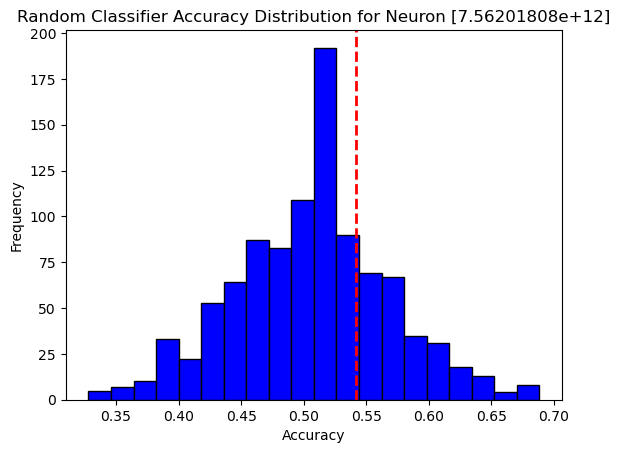

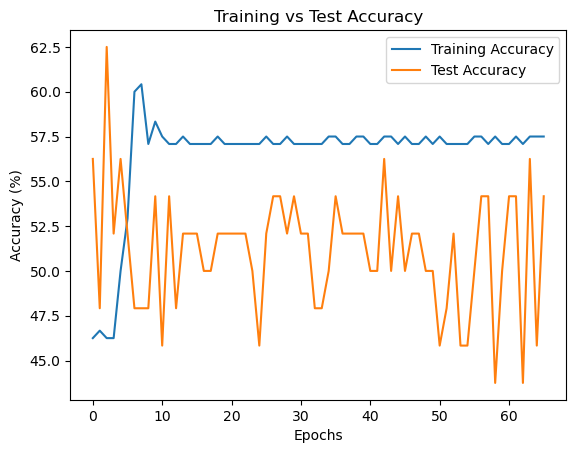

Confusion Matrix:
 [[ 5 29]
 [ 1 26]]
Class-specific Accuracy: [0.14705882 0.96296296]

 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 41.67%, p-value = 0.9130


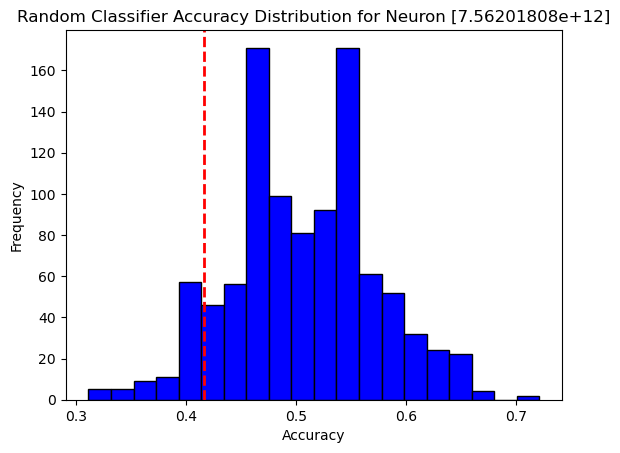

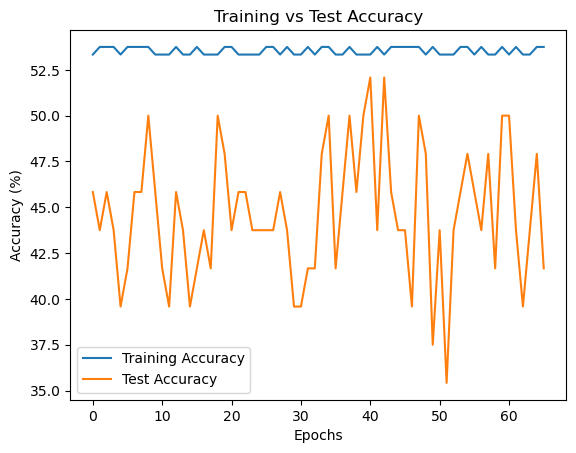

Confusion Matrix:
 [[ 0 34]
 [ 0 27]]
Class-specific Accuracy: [0. 1.]

 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 39.58%, p-value = 0.9570


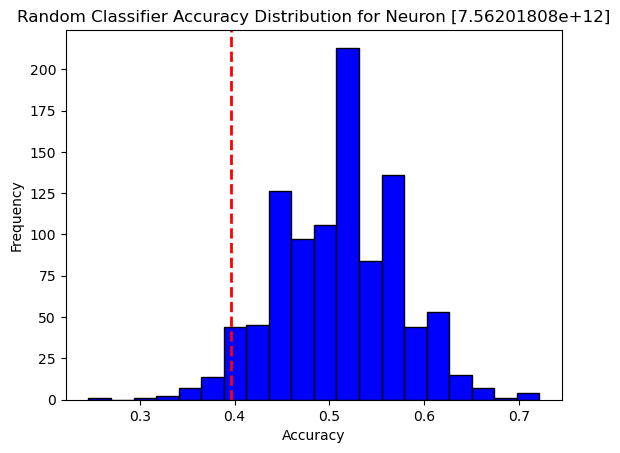

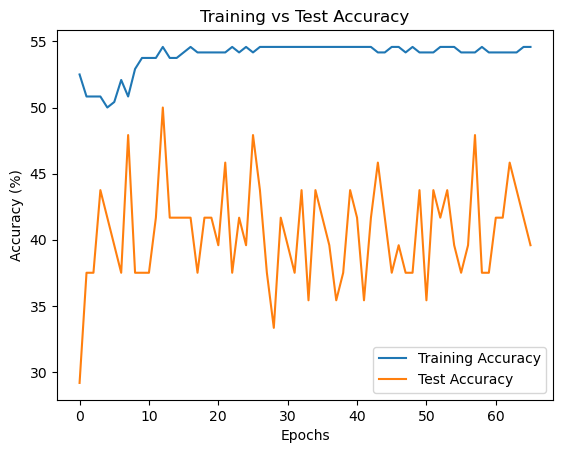

Confusion Matrix:
 [[ 4 30]
 [ 6 21]]
Class-specific Accuracy: [0.11764706 0.77777778]

 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 52.08%, p-value = 0.4180


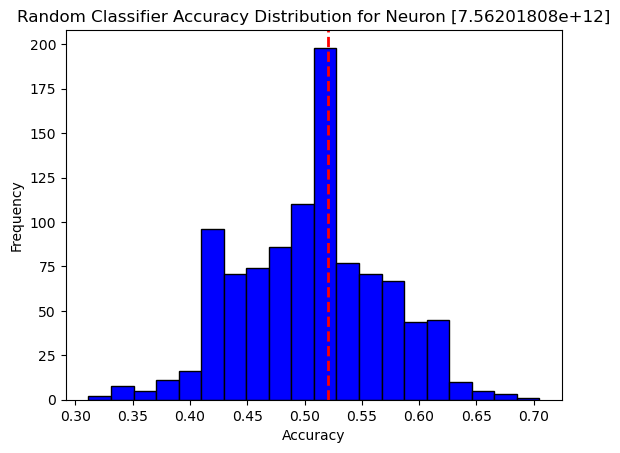

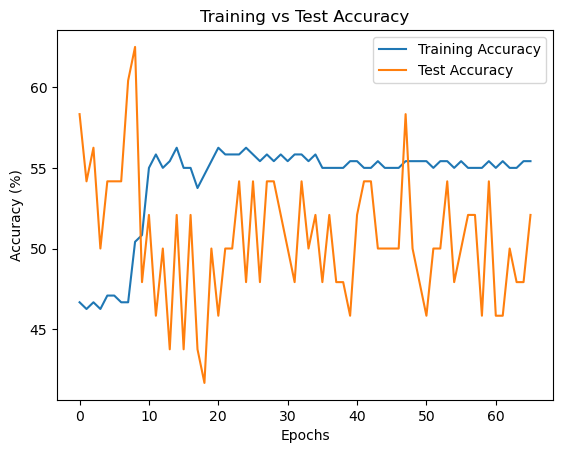

Confusion Matrix:
 [[12 22]
 [ 8 19]]
Class-specific Accuracy: [0.35294118 0.7037037 ]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 43.75%, p-value = 0.8150


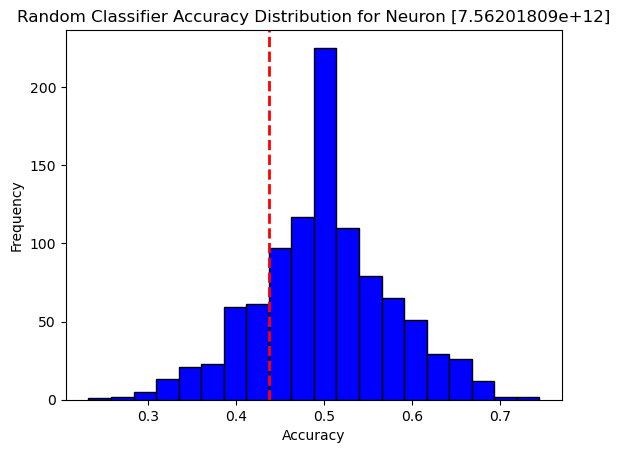

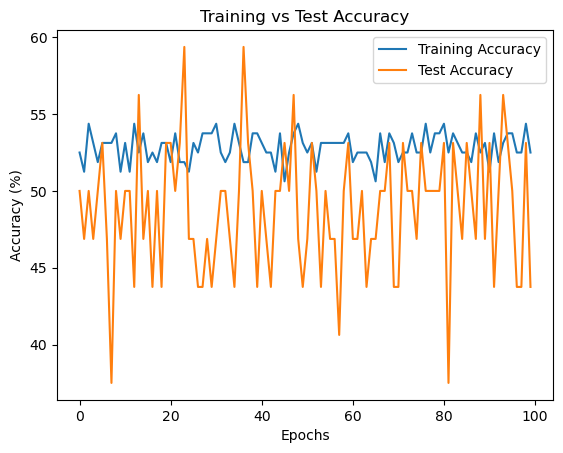

Confusion Matrix:
 [[ 0 22]
 [ 0 21]]
Class-specific Accuracy: [0. 1.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 50.00%, p-value = 0.4880


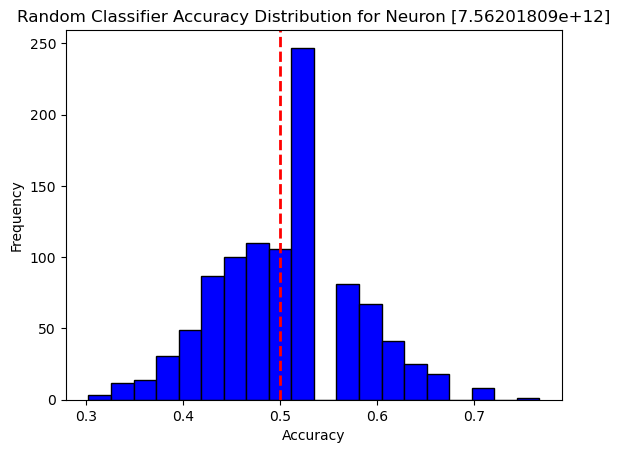

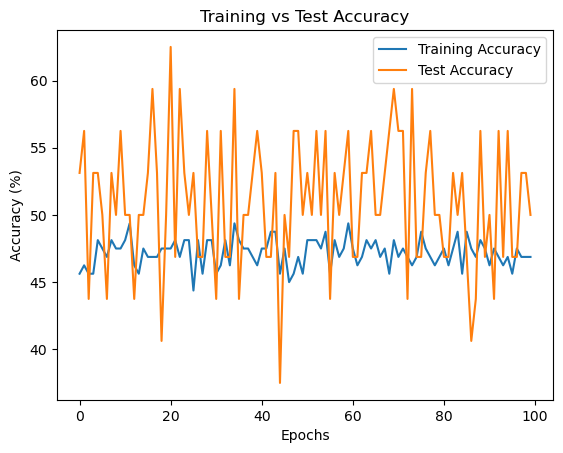

Confusion Matrix:
 [[22  0]
 [21  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 56.25%, p-value = 0.2080


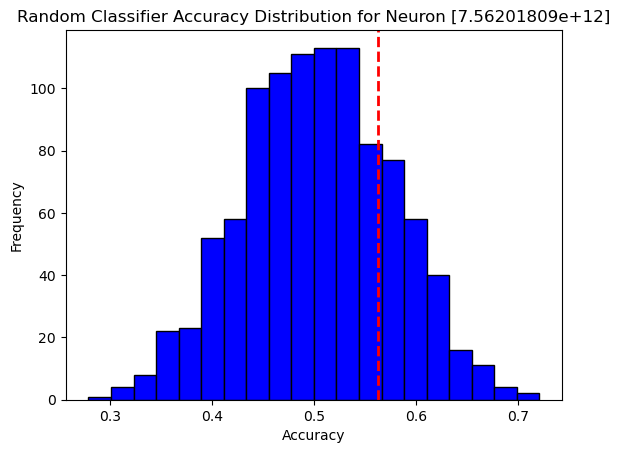

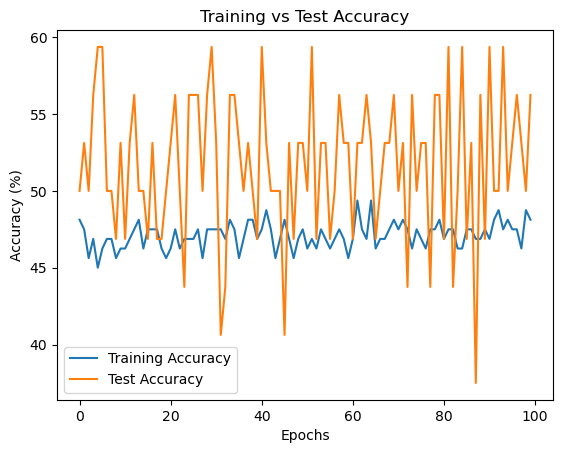

Confusion Matrix:
 [[22  0]
 [21  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 38.75%, p-value = 0.9800


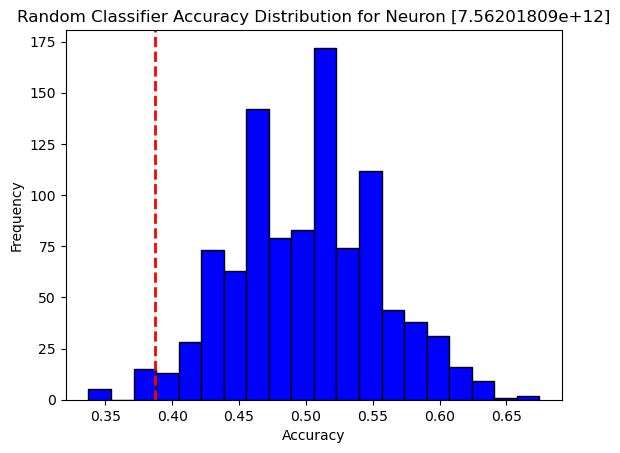

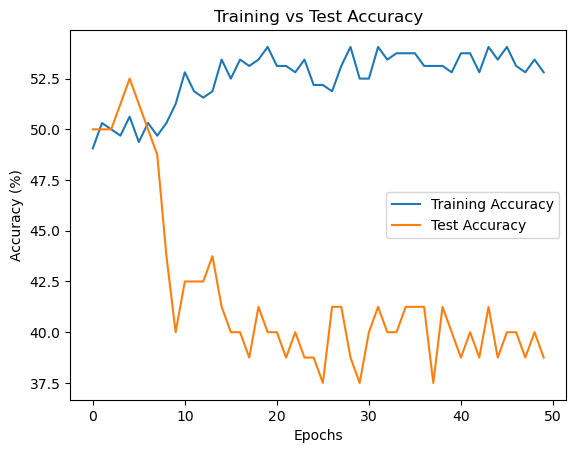

Confusion Matrix:
 [[11 30]
 [20 22]]
Class-specific Accuracy: [0.26829268 0.52380952]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 50.00%, p-value = 0.5170


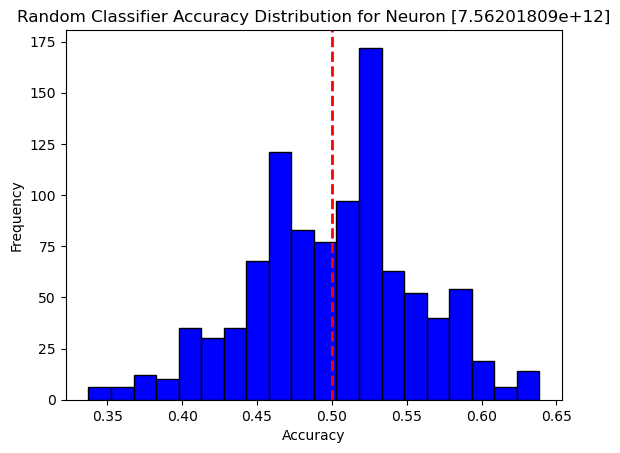

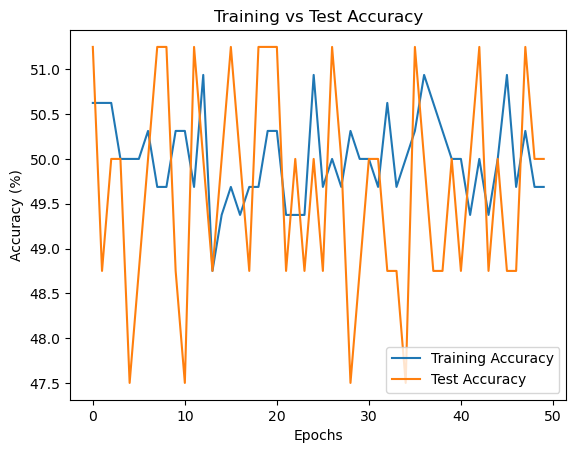

Confusion Matrix:
 [[41  0]
 [42  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 48.75%, p-value = 0.5830


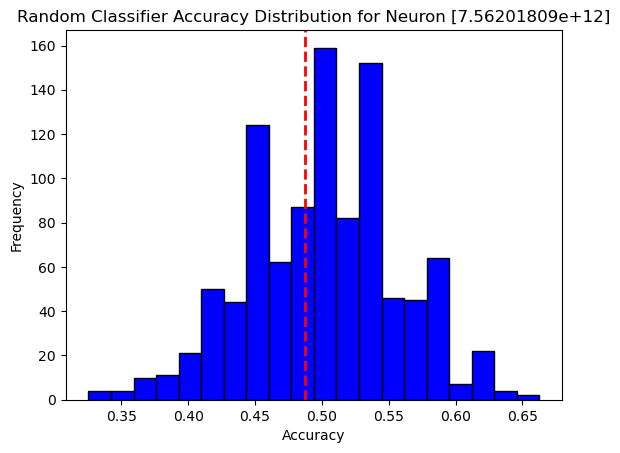

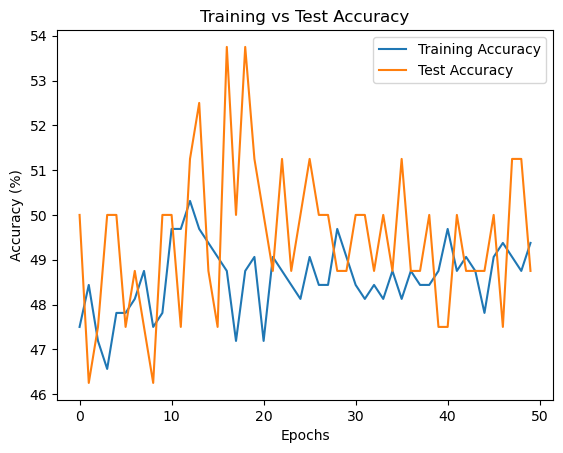

Confusion Matrix:
 [[20 21]
 [21 21]]
Class-specific Accuracy: [0.48780488 0.5       ]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 47.50%, p-value = 0.6640


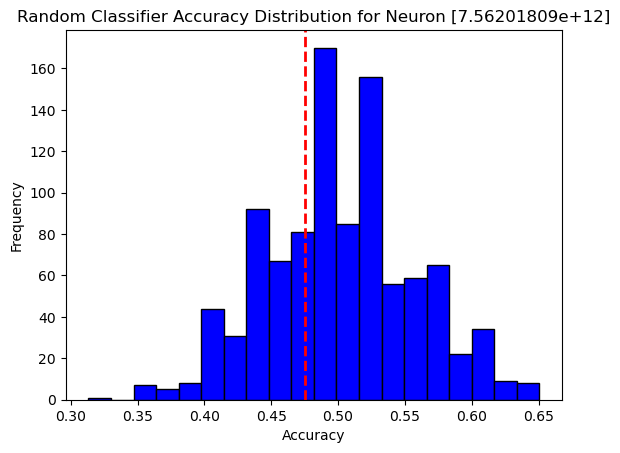

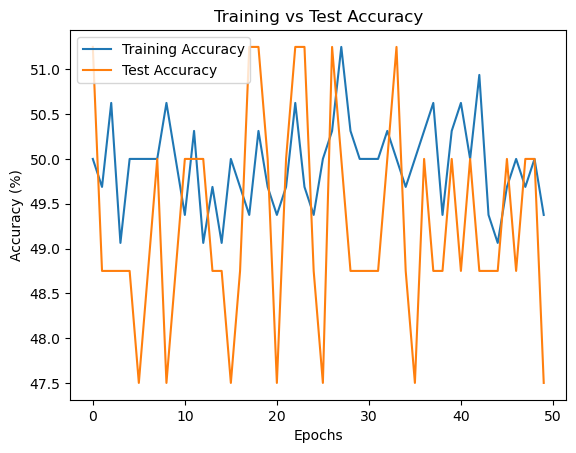

Confusion Matrix:
 [[41  0]
 [42  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 56.25%, p-value = 0.1330


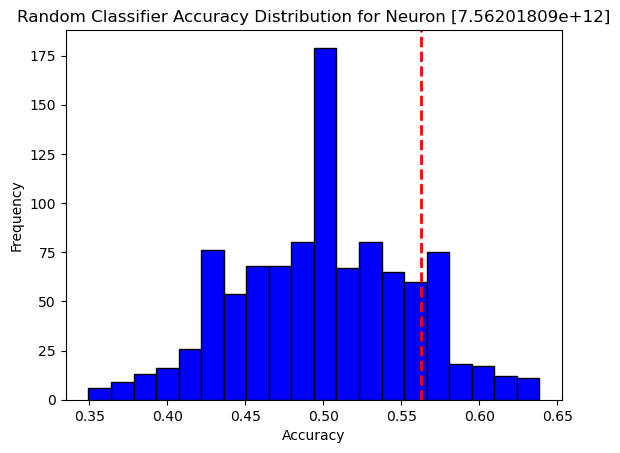

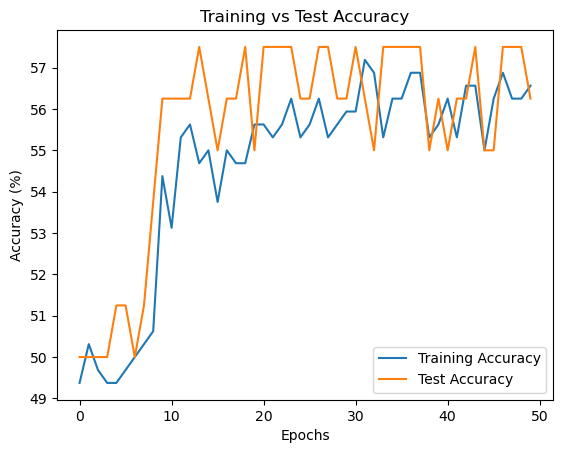

Confusion Matrix:
 [[10 31]
 [ 5 37]]
Class-specific Accuracy: [0.24390244 0.88095238]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 52.50%, p-value = 0.3370


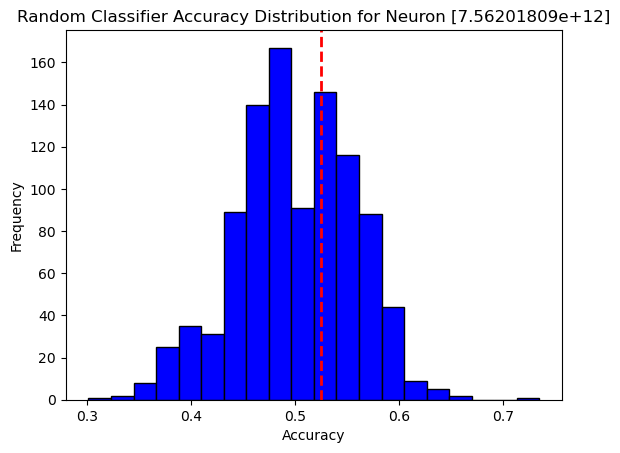

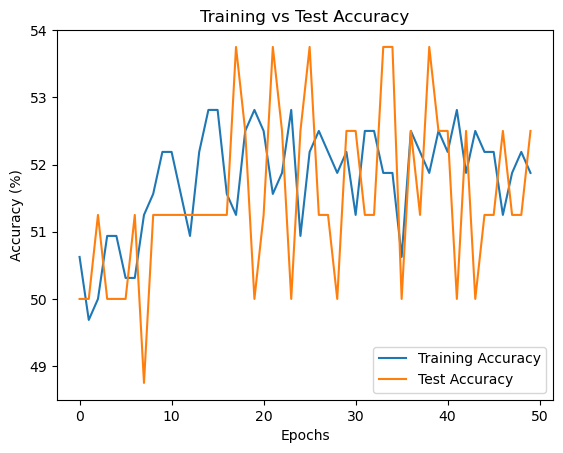

Confusion Matrix:
 [[10 31]
 [ 9 33]]
Class-specific Accuracy: [0.24390244 0.78571429]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 48.75%, p-value = 0.5930


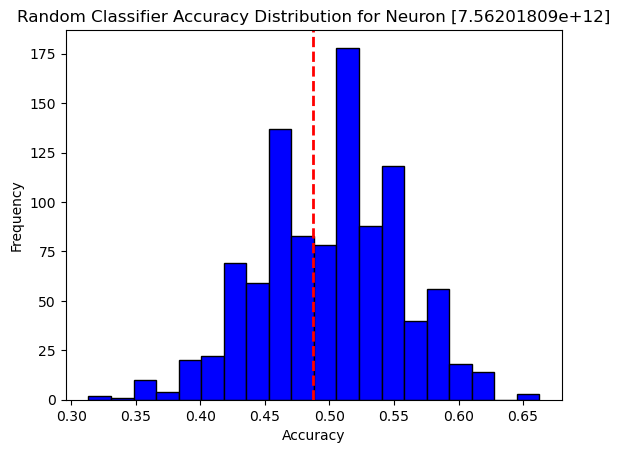

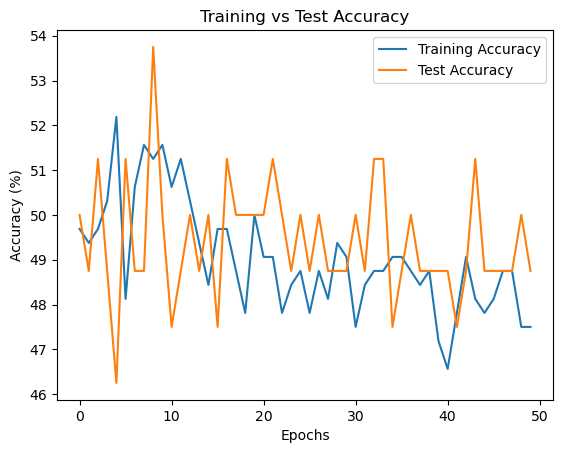

Confusion Matrix:
 [[25 16]
 [26 16]]
Class-specific Accuracy: [0.6097561  0.38095238]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 57.81%, p-value = 0.1380


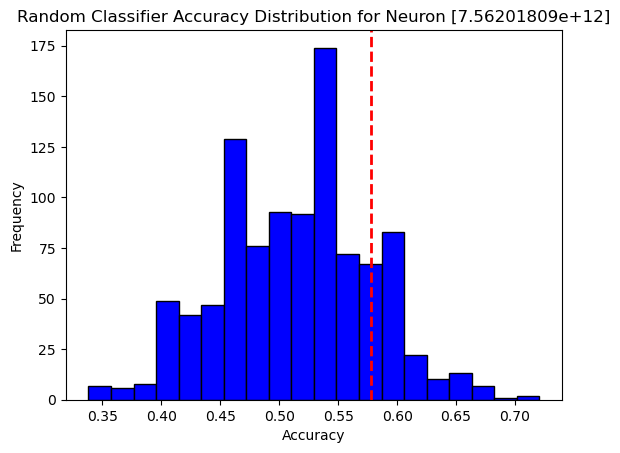

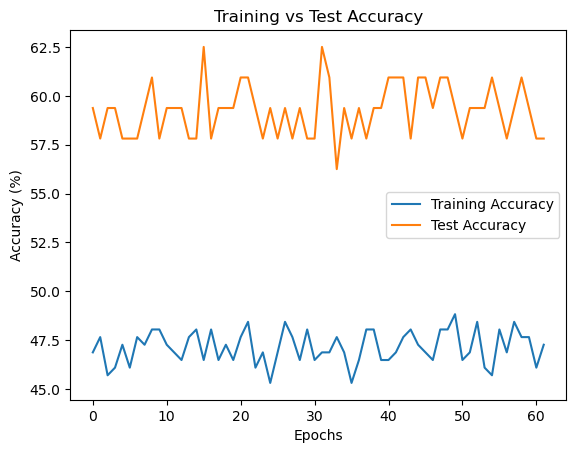

Confusion Matrix:
 [[ 0 28]
 [ 0 40]]
Class-specific Accuracy: [0. 1.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 39.06%, p-value = 0.9780


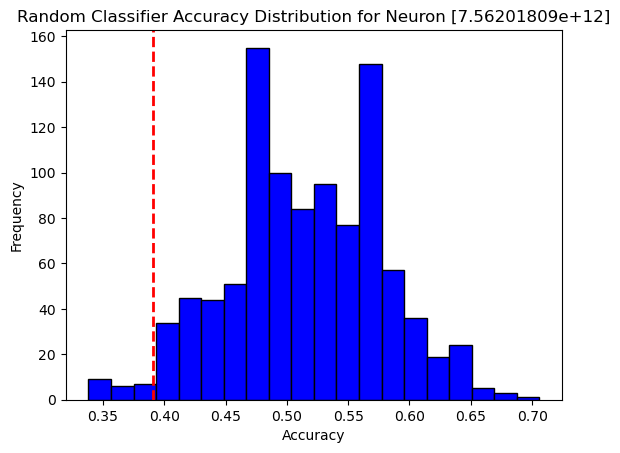

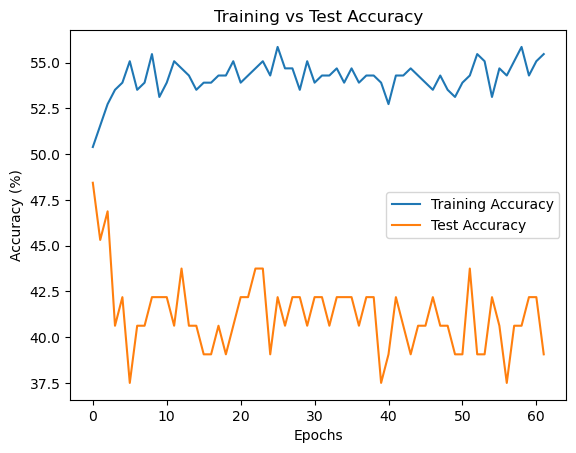

Confusion Matrix:
 [[24  4]
 [36  4]]
Class-specific Accuracy: [0.85714286 0.1       ]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 42.19%, p-value = 0.9320


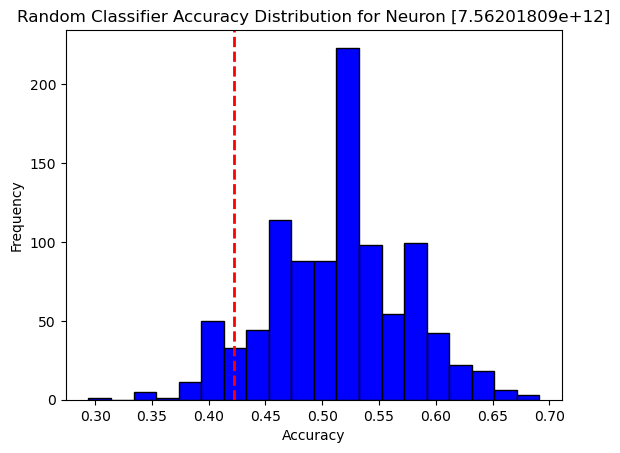

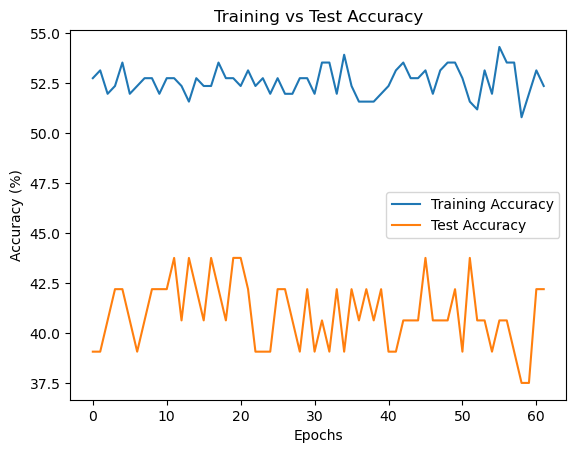

Confusion Matrix:
 [[28  0]
 [40  0]]
Class-specific Accuracy: [1. 0.]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 40.62%, p-value = 0.9740


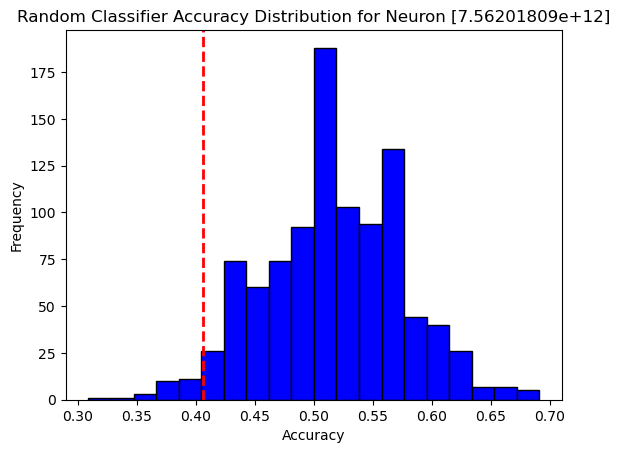

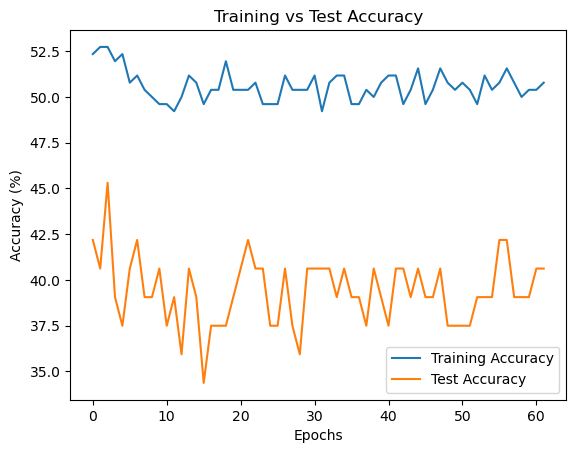

Confusion Matrix:
 [[22  6]
 [35  5]]
Class-specific Accuracy: [0.78571429 0.125     ]

 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 60.94%, p-value = 0.0620


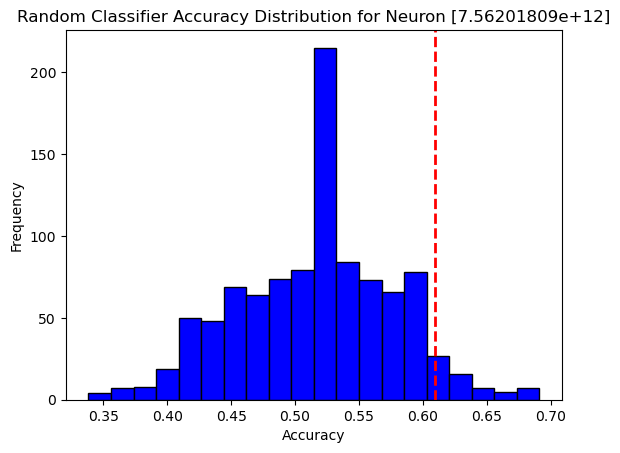

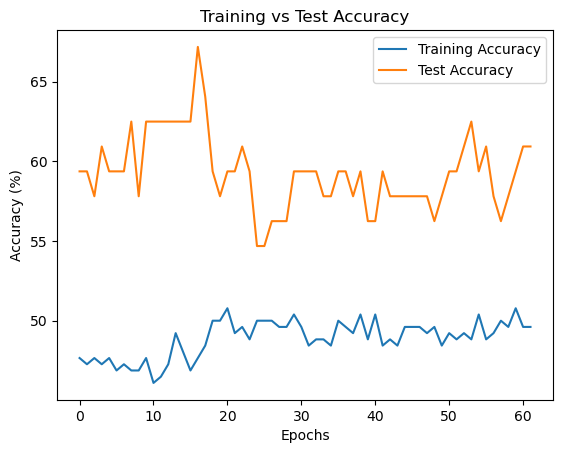

Confusion Matrix:
 [[ 6 22]
 [ 6 34]]
Class-specific Accuracy: [0.21428571 0.85      ]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 54.46%, p-value = 0.1870


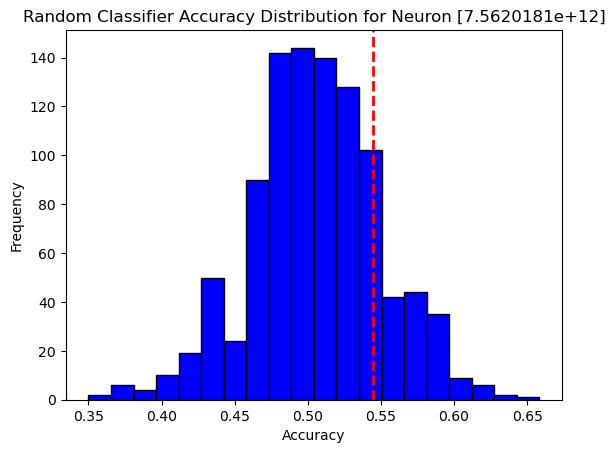

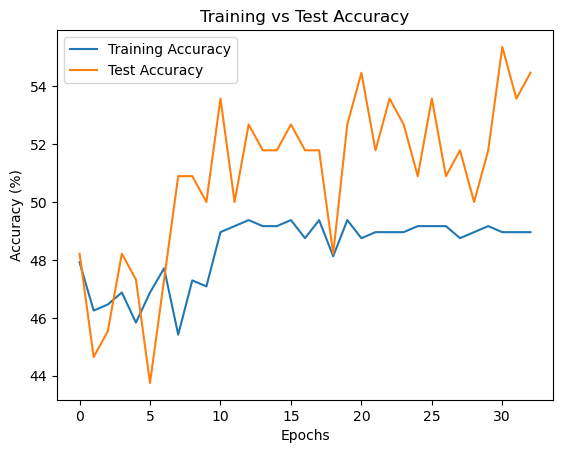

Confusion Matrix:
 [[58  9]
 [48  5]]
Class-specific Accuracy: [0.86567164 0.09433962]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.89%, p-value = 0.4230


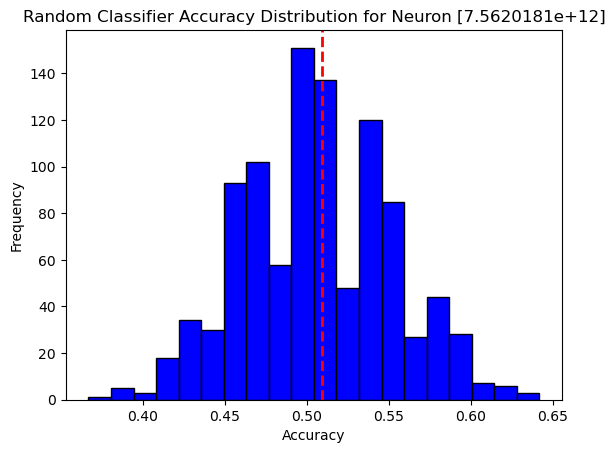

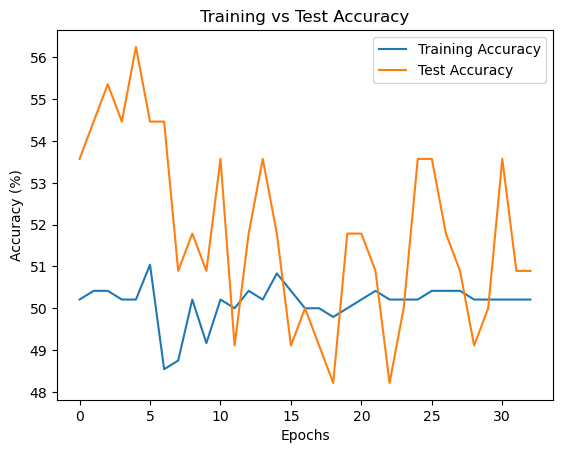

Confusion Matrix:
 [[51 16]
 [42 11]]
Class-specific Accuracy: [0.76119403 0.20754717]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 53.57%, p-value = 0.2760


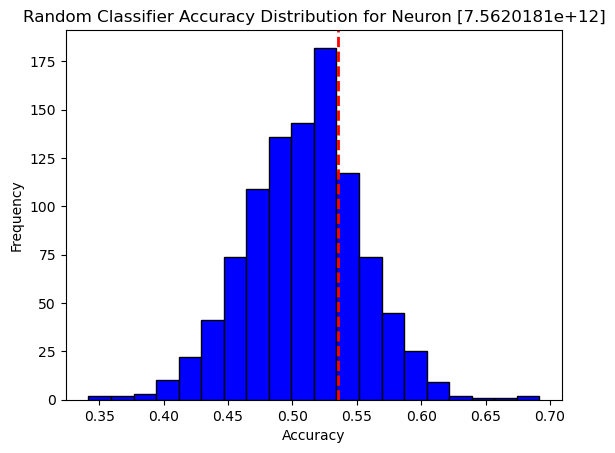

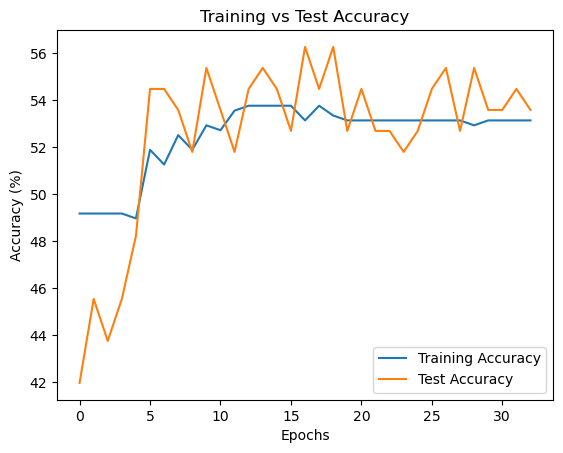

Confusion Matrix:
 [[39 28]
 [28 25]]
Class-specific Accuracy: [0.58208955 0.47169811]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 0.9480


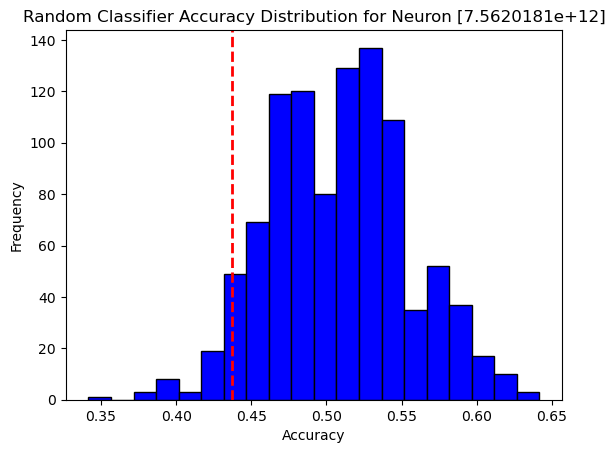

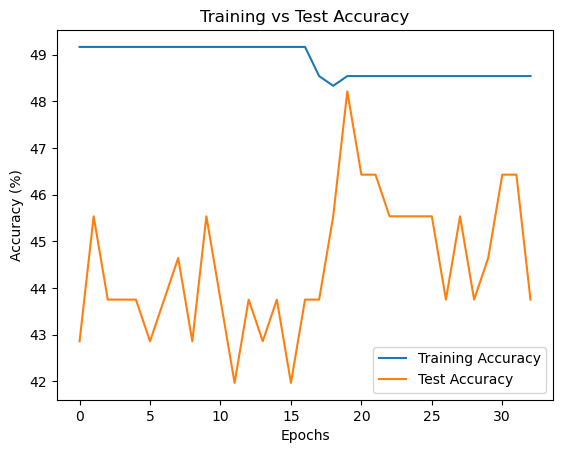

Confusion Matrix:
 [[ 3 64]
 [ 1 52]]
Class-specific Accuracy: [0.04477612 0.98113208]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 39.58%, p-value = 0.9700


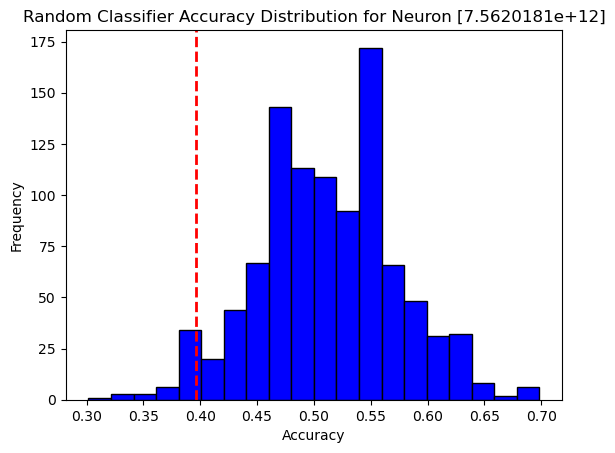

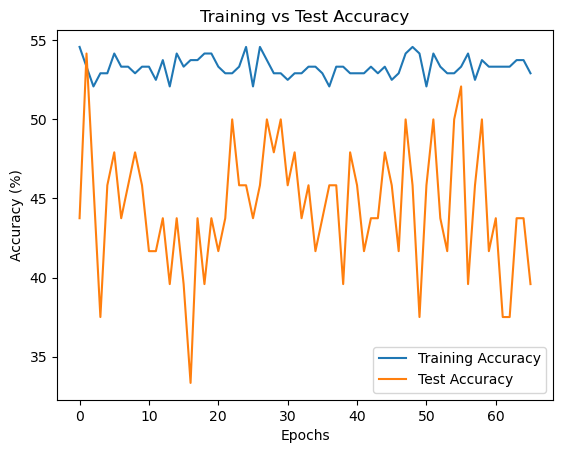

Confusion Matrix:
 [[ 0 35]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 56.25%, p-value = 0.1790


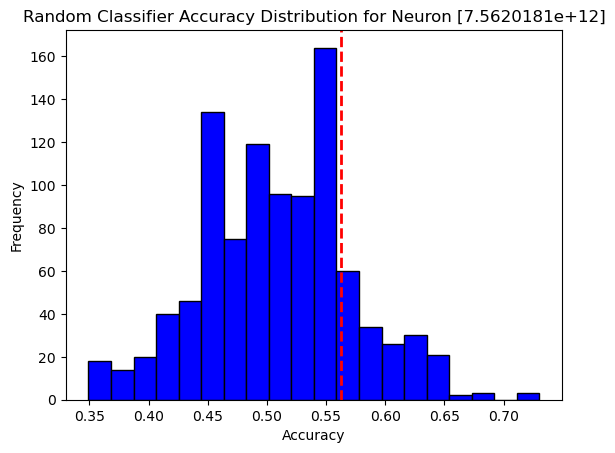

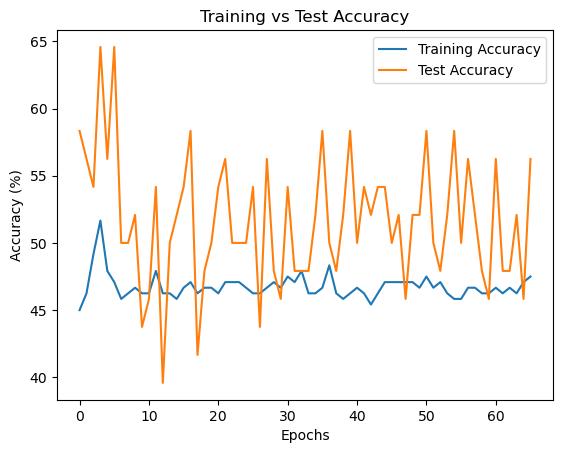

Confusion Matrix:
 [[ 8 27]
 [ 3 25]]
Class-specific Accuracy: [0.22857143 0.89285714]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 41.67%, p-value = 0.9240


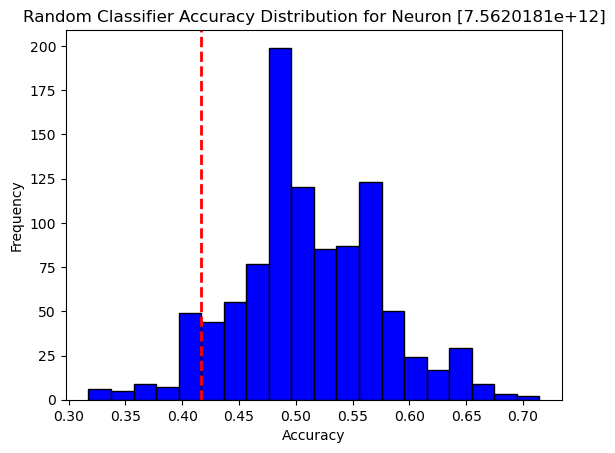

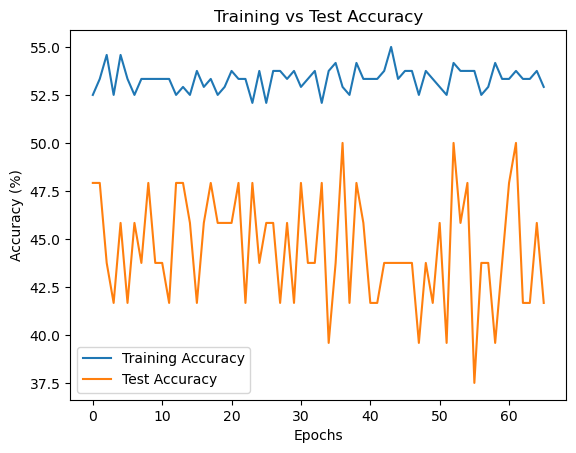

Confusion Matrix:
 [[ 0 35]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.08%, p-value = 0.4410


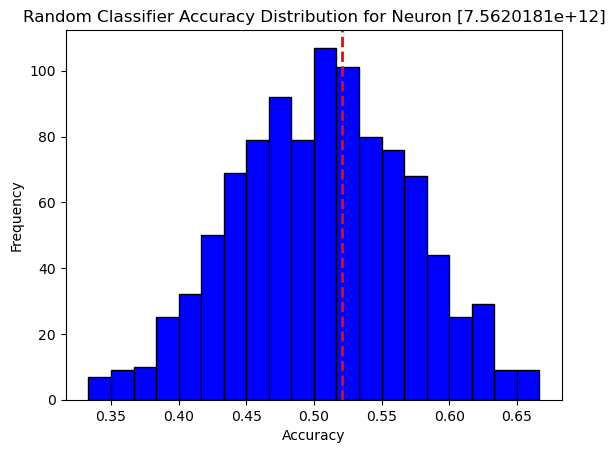

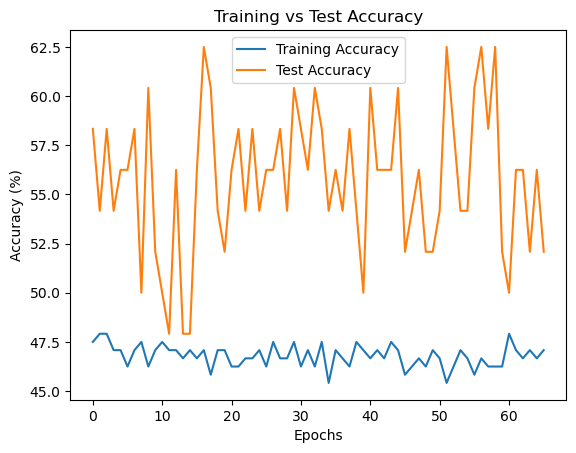

Confusion Matrix:
 [[35  0]
 [28  0]]
Class-specific Accuracy: [1. 0.]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.08%, p-value = 0.4240


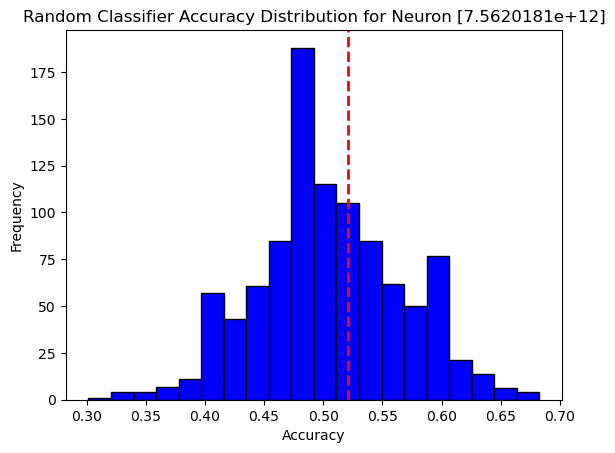

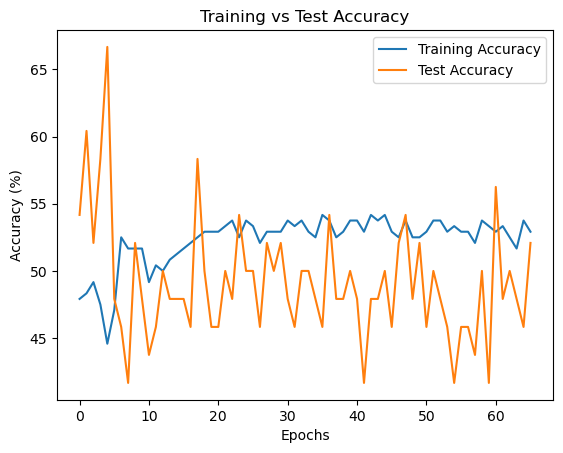

Confusion Matrix:
 [[ 3 32]
 [ 0 28]]
Class-specific Accuracy: [0.08571429 1.        ]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6490


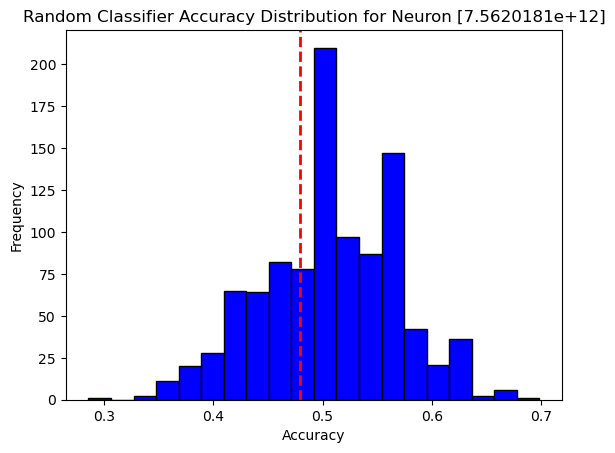

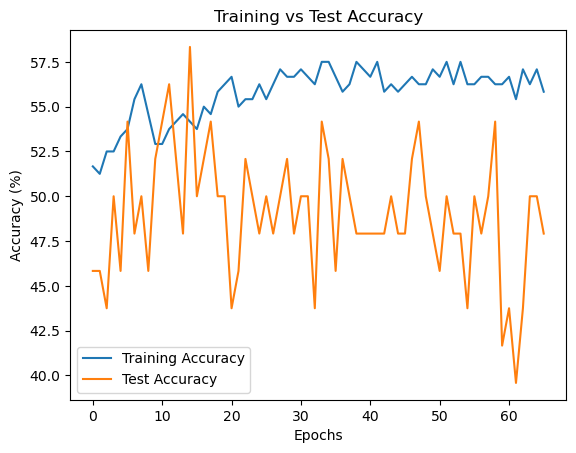

Confusion Matrix:
 [[ 6 29]
 [ 3 25]]
Class-specific Accuracy: [0.17142857 0.89285714]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6480


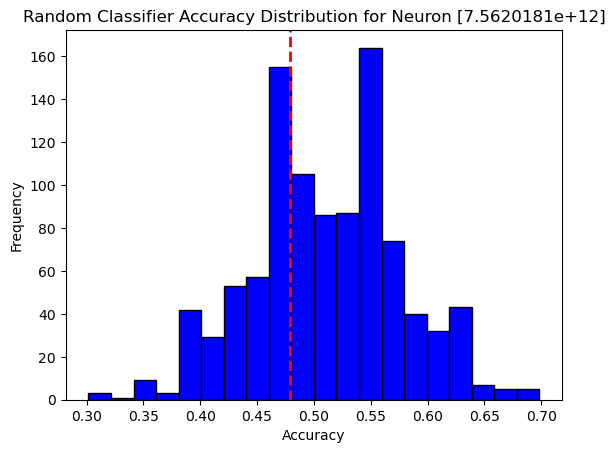

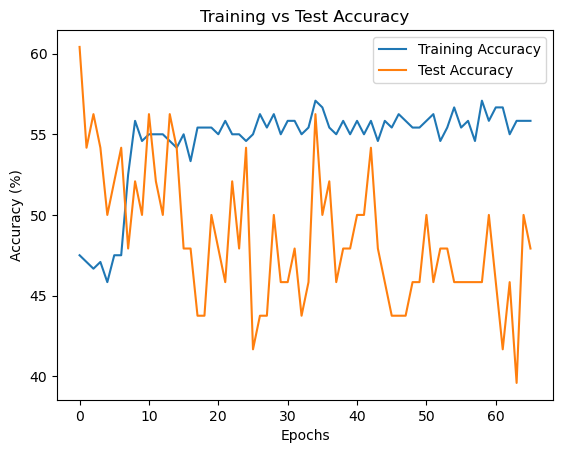

Confusion Matrix:
 [[21 14]
 [19  9]]
Class-specific Accuracy: [0.6        0.32142857]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 0.8780


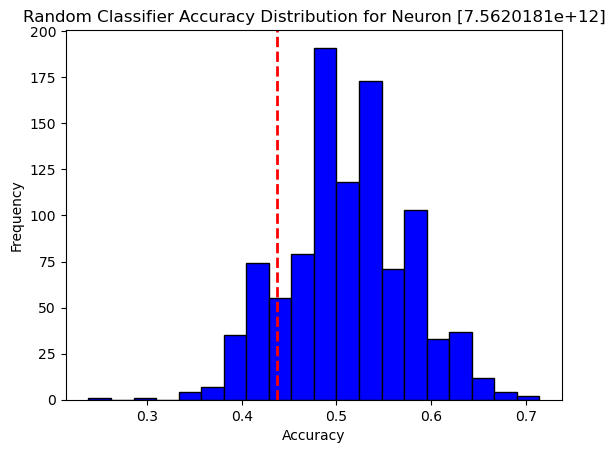

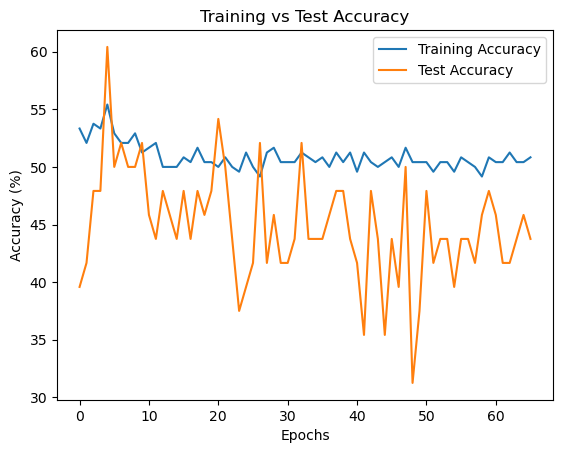

Confusion Matrix:
 [[ 3 32]
 [ 3 25]]
Class-specific Accuracy: [0.08571429 0.89285714]

 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 41.67%, p-value = 0.9070


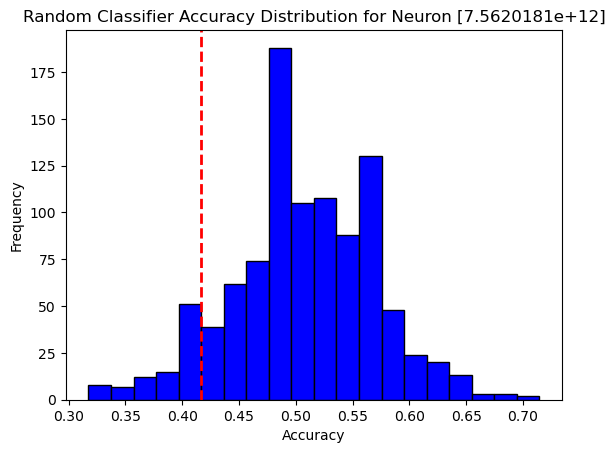

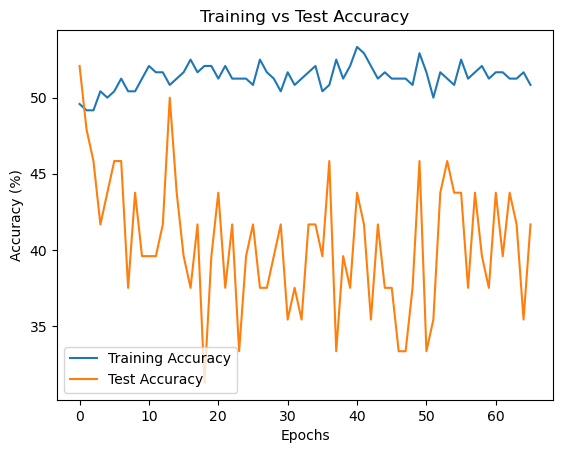

Confusion Matrix:
 [[ 7 28]
 [10 18]]
Class-specific Accuracy: [0.2        0.64285714]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 45.83%, p-value = 0.7420


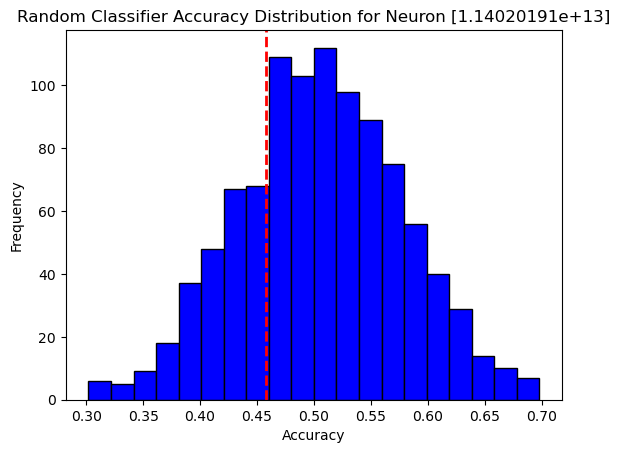

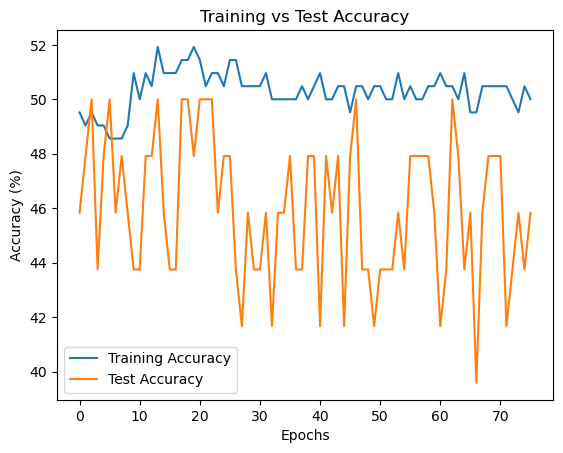

Confusion Matrix:
 [[23  2]
 [27  1]]
Class-specific Accuracy: [0.92       0.03571429]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 47.92%, p-value = 0.6390


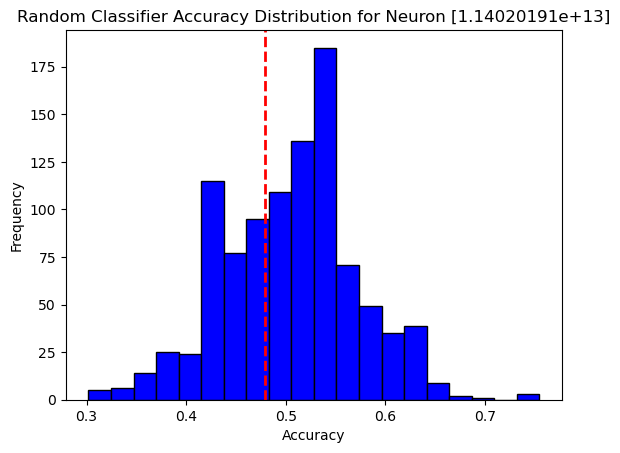

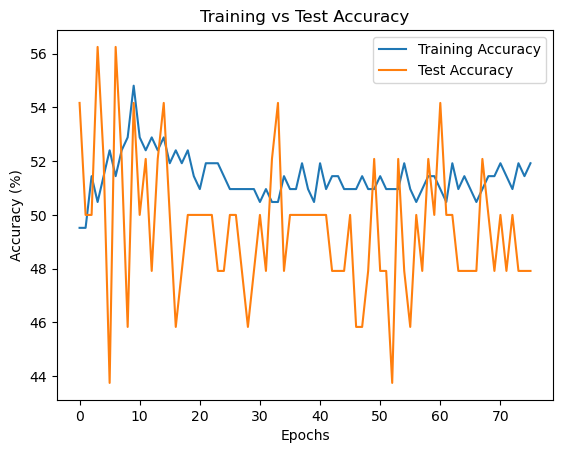

Confusion Matrix:
 [[11 14]
 [13 15]]
Class-specific Accuracy: [0.44       0.53571429]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 43.75%, p-value = 0.8220


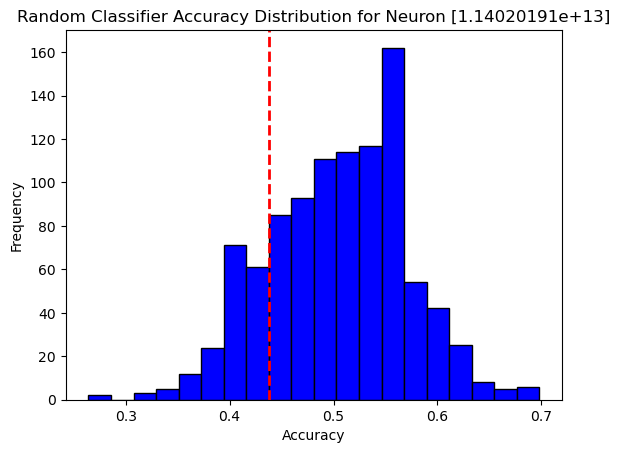

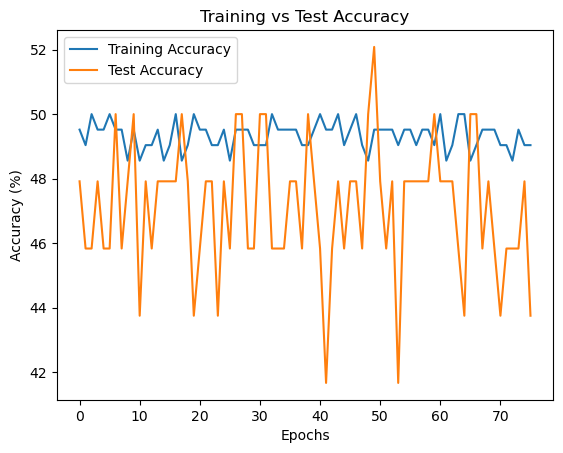

Confusion Matrix:
 [[25  0]
 [28  0]]
Class-specific Accuracy: [1. 0.]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 43.75%, p-value = 0.7970


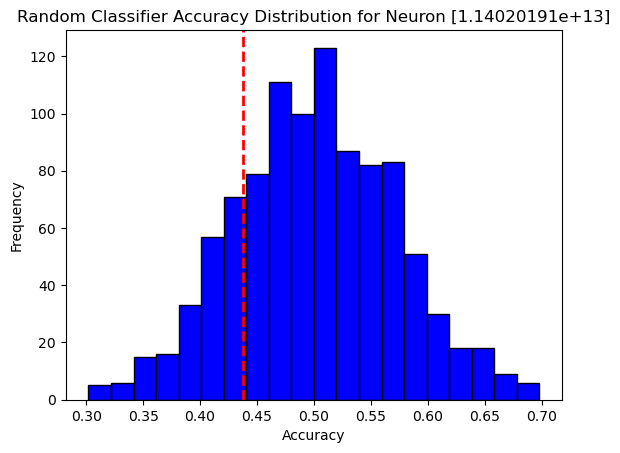

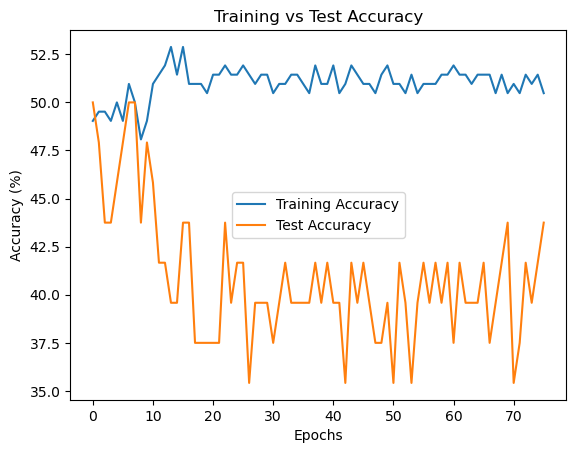

Confusion Matrix:
 [[20  5]
 [27  1]]
Class-specific Accuracy: [0.8        0.03571429]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 50.00%, p-value = 0.4900


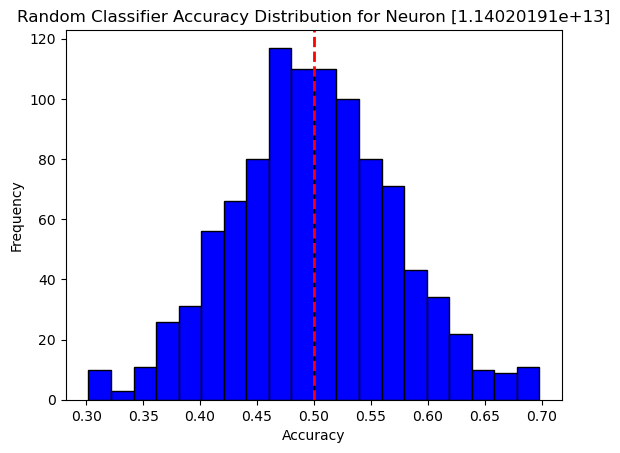

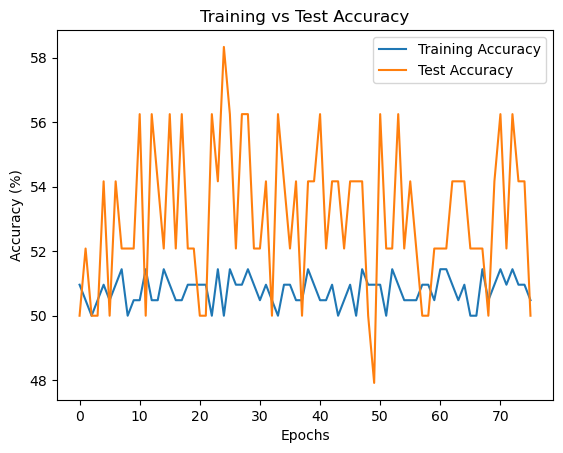

Confusion Matrix:
 [[ 0 25]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 56.25%, p-value = 0.2160


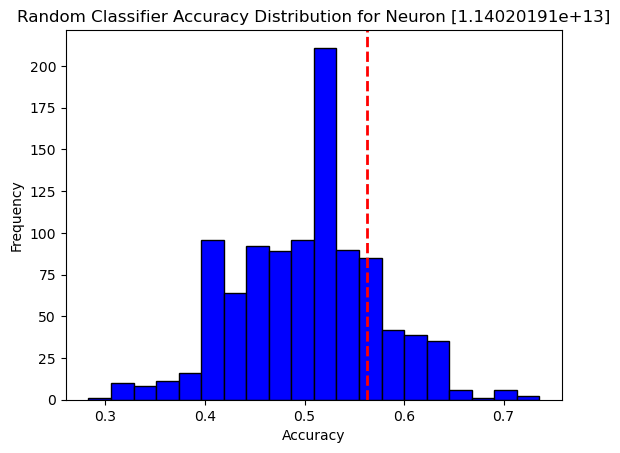

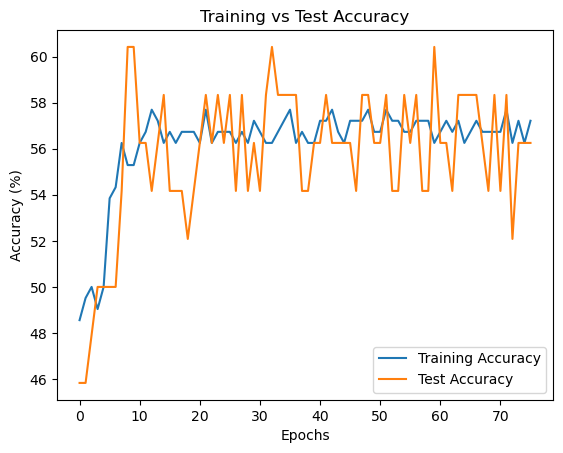

Confusion Matrix:
 [[24  1]
 [22  6]]
Class-specific Accuracy: [0.96       0.21428571]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 50.00%, p-value = 0.5020


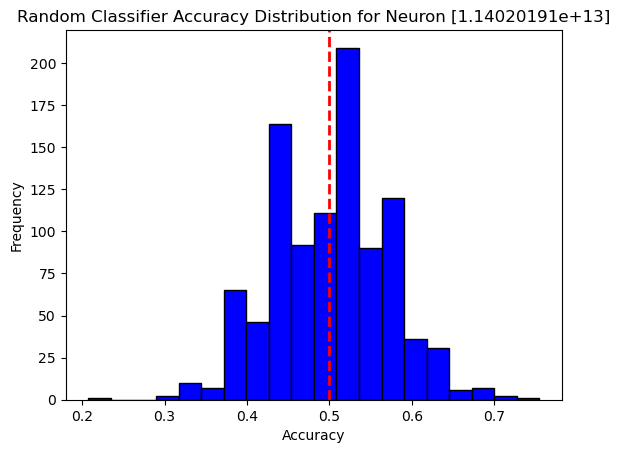

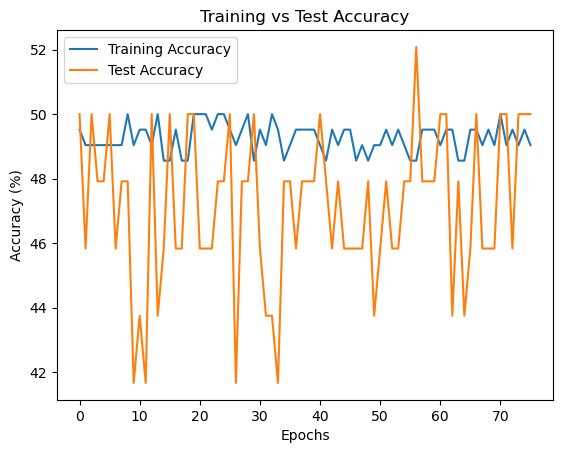

Confusion Matrix:
 [[25  0]
 [28  0]]
Class-specific Accuracy: [1. 0.]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 64.58%, p-value = 0.0170


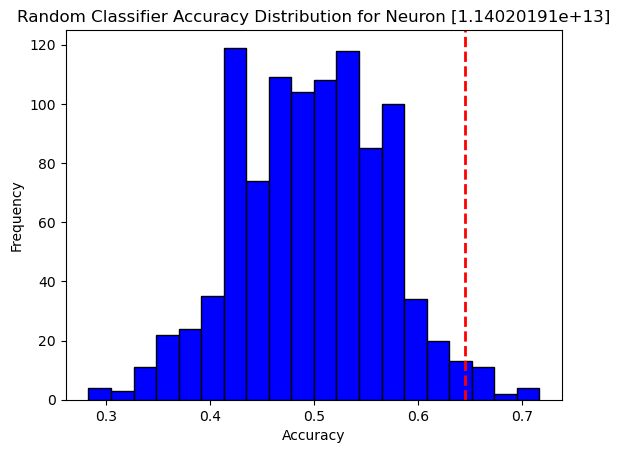

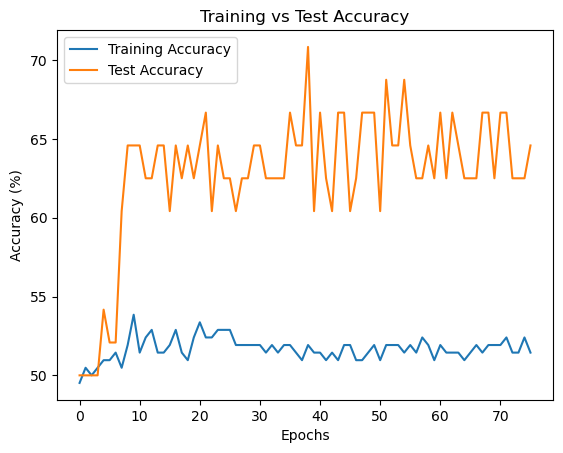

Confusion Matrix:
 [[21  4]
 [15 13]]
Class-specific Accuracy: [0.84       0.46428571]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 52.08%, p-value = 0.4070


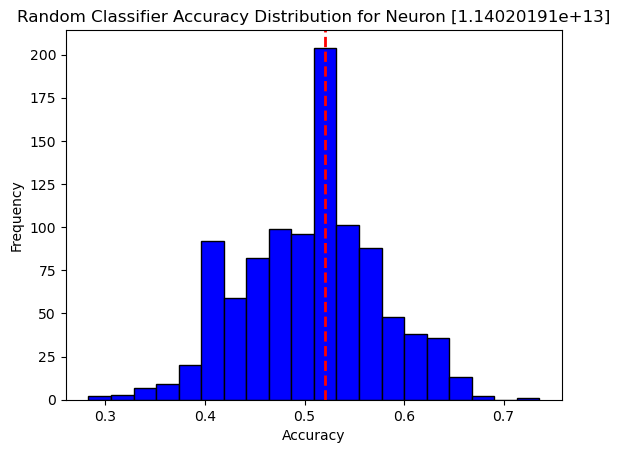

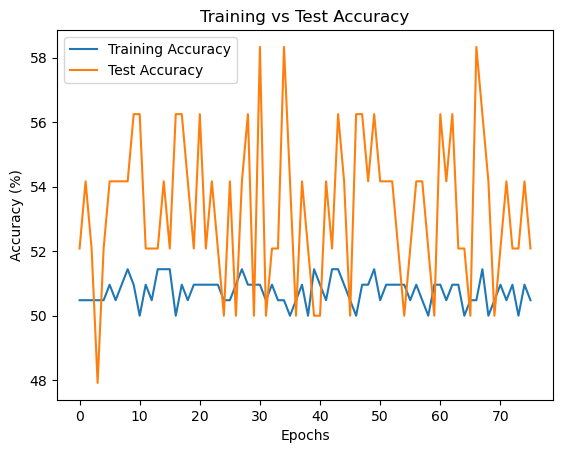

Confusion Matrix:
 [[ 0 25]
 [ 0 28]]
Class-specific Accuracy: [0. 1.]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 55.21%, p-value = 0.1420


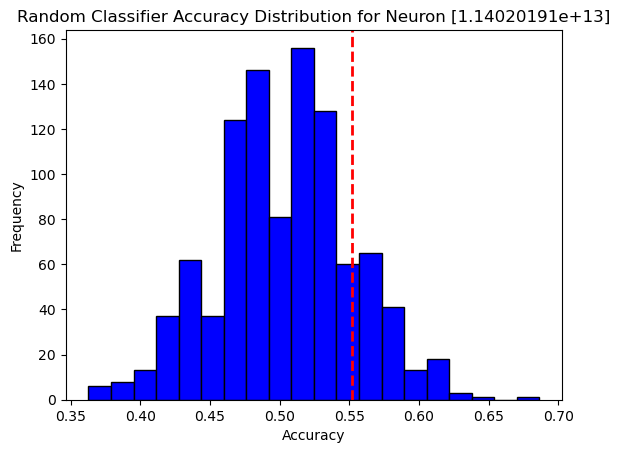

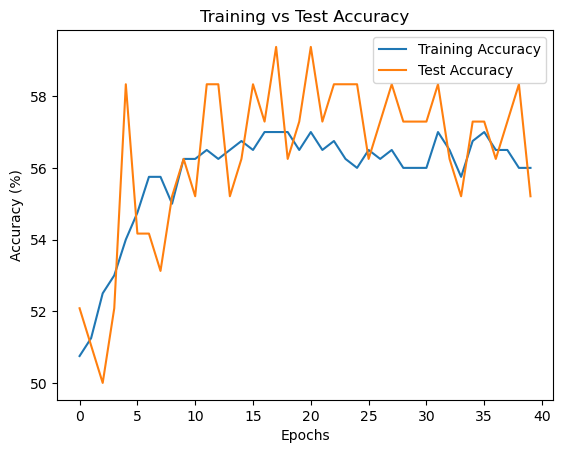

Confusion Matrix:
 [[33 20]
 [24 25]]
Class-specific Accuracy: [0.62264151 0.51020408]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 57.29%, p-value = 0.0750


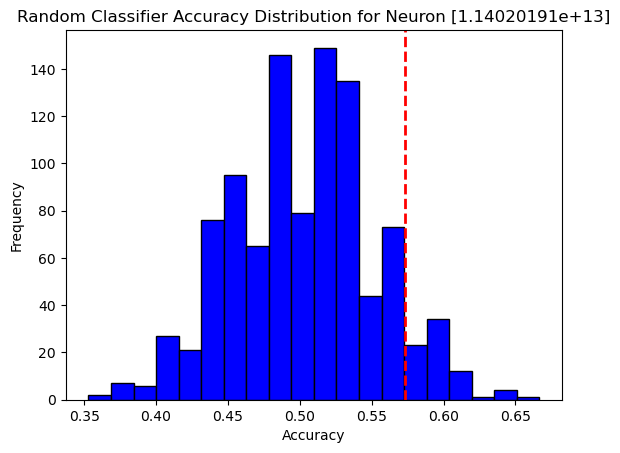

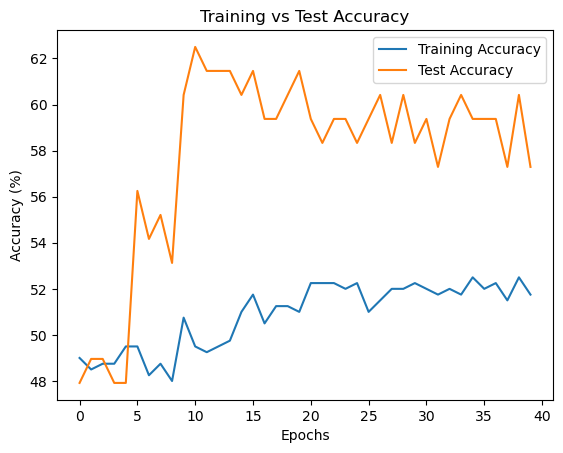

Confusion Matrix:
 [[46  7]
 [34 15]]
Class-specific Accuracy: [0.86792453 0.30612245]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 56.25%, p-value = 0.1210


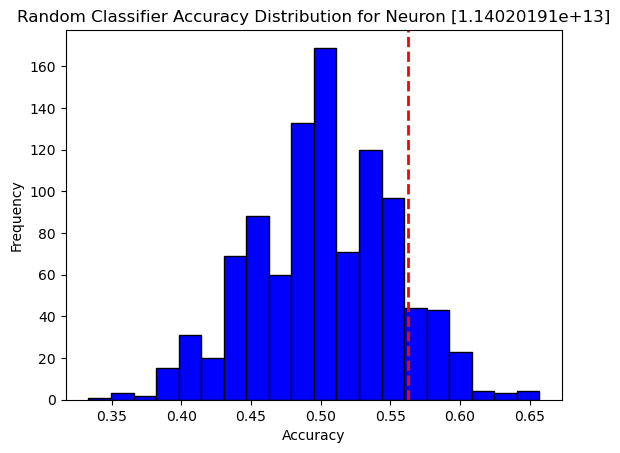

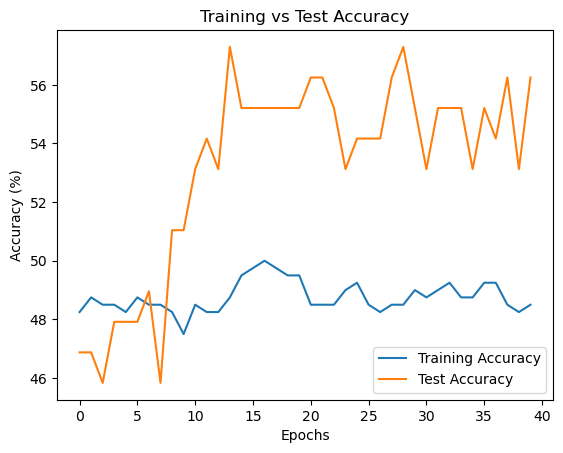

Confusion Matrix:
 [[11 42]
 [ 4 45]]
Class-specific Accuracy: [0.20754717 0.91836735]

 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX


KeyboardInterrupt: 

In [10]:
'''This time we apply weighted loss for the class imbalance'''


# Number of random classifiers (null hypothesis testing)
num_permutations = 1000

# Brain areas and analysis types
results_weighted = []

brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"] 
brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"]

combinations = [('S1', 'GO'), ('S1', 'LICK'), ('S1naive', 'GO'), ('S1naive', 'LICK'), ('PPC', 'GO'), ('PPC', 'LICK')]

# Iterate through each combination
for comb in combinations:
    brain_area = comb[0]
    type_of_analysis = comb[1]
    print(f"Brain Area: {brain_area}, Analysis Type: {type_of_analysis}")
    trial_list, trial_dff = get_data_ready(brain_area, type_of_analysis)

    neuron_list = np.unique(trial_list[:, 0]).reshape(-1, 1)
    print("Num of neurons before filter=", neuron_list.shape[0])

    for neuron in neuron_list:
        print("\n", neuron, "XXXXXXXXXXXXXXXXXXXX")
        
        # Extract neuron-specific data
        neuron_data_list = trial_list[trial_list[:, 0] == neuron].copy()
        neuron_data_dff = trial_dff[trial_list[:, 0] == neuron].copy()

        X = neuron_data_dff.copy()
        y = neuron_data_list[:, 1]
        
        #Make sure there is at least one example of each class 
        unique_classes = np.unique(y)
    
        if len(unique_classes) < 2:
            print(f"Skipping neuron {neuron} due to insufficient class diversity")
            continue 

        
        X = X.reshape(X.shape[0], X.shape[1], 1)

        #### Train-test split
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Convert to tensors
        Xtrain = torch.from_numpy(X_train).float()
        ytrain = torch.from_numpy(y_train).long()
        Xtest = torch.from_numpy(X_test).float()
        ytest = torch.from_numpy(y_test).long()

        # Batch size, epochs, and iterations
        batch_size = 16
        n_iters = 1000
        num_epochs = int(n_iters // (len(X_train) // batch_size))
        
        #Compute Class weghts for the training label
    
        try:
            class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)

            # Convert class weights to a tensor for PyTorch
            class_weights = torch.tensor(class_weights, dtype=torch.float)

        # If class_weights has fewer than two dimensions, skip this neuron
            if len(class_weights) < 2:
                print(f"Skipping neuron {neuron} due to invalid class weights")
                continue

        except ValueError as e:
            print(f"Error computing class weights for neuron {neuron}: {e}")
            continue  # Skip this neuron if class weights can't be computed

        train = TensorDataset(Xtrain, ytrain)
        test = TensorDataset(Xtest, ytest)

        train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test, batch_size=batch_size, shuffle=True, drop_last=True)

        # Create the RNN model
        input_dim = X.shape[-1]
        hidden_dim = 4
        layer_dim = 1
        output_dim = 1

        model = RNNModel(input_dim, hidden_dim, layer_dim, output_dim)

        # Loss function and optimizer WITH weights
        error = nn.BCEWithLogitsLoss(pos_weight=class_weights[1])#applying class weights
        learning_rate = 0.001
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

        # Training loop for the original model
        train_accuracy_list = []
        test_accuracy_list = []
        test_loss_list = []

        for epoch in range(num_epochs):
            model.train()
            total_train, correct_train = 0, 0

            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                outputs = model(X_batch).squeeze()
                loss = error(outputs, y_batch.float())
                loss.backward()
                optimizer.step()

                probabilities = torch.sigmoid(outputs)
                predicted = (probabilities > 0.5).long()
                correct_train += (predicted.squeeze() == y_batch).sum().item()
                total_train += y_batch.size(0)

            train_accuracy = 100 * correct_train / total_train
            train_accuracy_list.append(train_accuracy)
            scheduler.step()

            # Evaluate on test set
            model.eval()
            total_test, correct_test = 0, 0
            with torch.no_grad():
                for X_test_batch, y_test_batch in test_loader:
                    outputs = model(X_test_batch).squeeze()
                    probabilities = torch.sigmoid(outputs)
                    predicted = (probabilities > 0.5).long()
                    correct_test += (predicted == y_test_batch).sum().item()
                    total_test += y_test_batch.size(0)
                    loss_test = error(outputs, y_test_batch.float())
                    test_loss_list.append(loss_test)

            test_accuracy = 100 * correct_test / float(total_test)
            test_accuracy_list.append(test_accuracy)

        # Save the original model's test accuracy
        original_test_accuracy = test_accuracy

        # Random classifier: Match class distribution in the test set
        class_distribution = np.mean(y_test)  # proportion of class 1

        random_accuracies = []
        for _ in range(num_permutations):
            y_random = np.random.choice([0, 1], size=len(y_test), p=[1 - class_distribution, class_distribution])
            random_accuracy = accuracy_score(y_test, y_random)
            random_accuracies.append(random_accuracy)

        # Calculate p-value using a t-test (testing original model vs. random classifiers)
        random_accuracies = np.array(random_accuracies)
        p_value = np.mean(random_accuracies >= original_test_accuracy/100)


        # Store results
        results_weighted.append({
            'Brain Area': brain_area,
            'Analysis Type': type_of_analysis,
            'Neuron': neuron,
            'Train Accuracy': train_accuracy_list,
            'Test Accuracy': original_test_accuracy,
            'p value': p_value
        })

        print(f"Neuron {neuron}: Test Accuracy = {original_test_accuracy:.2f}%, p-value = {p_value:.4f}")

        # Visualize random classifier accuracy distribution
        plt.hist(random_accuracies, bins=20, color='blue', edgecolor='black')
        plt.axvline(original_test_accuracy/100, color='red', linestyle='dashed', linewidth=2)
        plt.title(f'Random Classifier Accuracy Distribution for Neuron {neuron}')
        plt.xlabel('Accuracy')
        plt.ylabel('Frequency')
        plt.show()

        # Plot training vs test accuracy to examine potential overfitting or bias
        plt.plot(train_accuracy_list, label='Training Accuracy')
        plt.plot(test_accuracy_list, label='Test Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy (%)')
        plt.title('Training vs Test Accuracy')
        plt.legend()
        plt.show()
        
        # Check class-specific accuracy on the test set
        
        # Predict on the test set and calculate confusion matrix
        model.eval()
        with torch.no_grad():
            outputs = model(Xtest).squeeze()
            probabilities = torch.sigmoid(outputs)
            predictions = (probabilities > 0.5).long()
            
        conf_matrix = confusion_matrix(ytest, predictions)
        print("Confusion Matrix:\n", conf_matrix)
        
        # Calculate class-specific accuracy
        class_accuracy = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
        print("Class-specific Accuracy:", class_accuracy)



/tmp/ipykernel_128/3086776226.py:43: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas


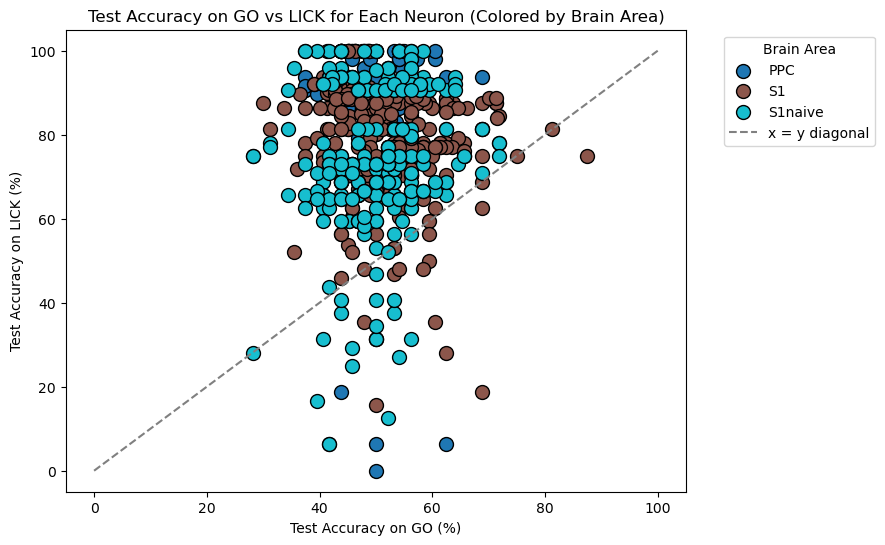

In [19]:
#lets plot what we have 
# Dictionaries to store test accuracies, brain areas, and p-values by neuron
go_accuracies = {}
lick_accuracies = {}
brain_areas = {}

# Populate dictionaries with test accuracies and brain area
for result in results_weighted:
    neuron = result['Neuron']
    if isinstance(neuron, np.ndarray):  # If neuron is a NumPy array, convert to a scalar value
        neuron = neuron.item()  # Extract the value from the NumPy array
    
    # Store test accuracy for "GO" and "LICK"
    if result['Analysis Type'] == 'GO':
        go_accuracies[neuron] = result['Test Accuracy']
    elif result['Analysis Type'] == 'LICK':
        lick_accuracies[neuron] = result['Test Accuracy']
    
    # Store brain area information
    if neuron not in brain_areas:
        brain_areas[neuron] = result['Brain Area']

# Now only include neurons that have both "GO" and "LICK" test accuracies
go_test_accuracies = []
lick_test_accuracies = []
neuron_brain_areas = []

for neuron in go_accuracies:
    if neuron in lick_accuracies:  # Only include neurons with both GO and LICK data
        go_test_accuracies.append(go_accuracies[neuron])
        lick_test_accuracies.append(lick_accuracies[neuron])
        neuron_brain_areas.append(brain_areas[neuron])  # Track brain area for each neuron

# Convert lists to numpy arrays for compatibility with plotting
go_test_accuracies = np.array(go_test_accuracies)
lick_test_accuracies = np.array(lick_test_accuracies)
neuron_brain_areas = np.array(neuron_brain_areas)

# Define unique brain areas for color coding
unique_brain_areas = np.unique(neuron_brain_areas)
colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas

# Plotting the scatter plot with color coding by brain area
plt.figure(figsize=(8, 6))
for i, brain_area in enumerate(unique_brain_areas):
    mask = neuron_brain_areas == brain_area
    plt.scatter(go_test_accuracies[mask], lick_test_accuracies[mask], label=brain_area,
                color=colors(i), s=100, edgecolor='k')

# Adding x=y diagonal line
plt.plot([0, 100], [0, 100], linestyle='--', color='gray', label='x = y diagonal')

# Adding labels and title
plt.xlabel('Test Accuracy on GO (%)')
plt.ylabel('Test Accuracy on LICK (%)')
plt.title('Test Accuracy on GO vs LICK for Each Neuron (Colored by Brain Area)')

# Adding legend for brain areas
plt.legend(title="Brain Area", bbox_to_anchor=(1.05, 1), loc='upper left')

# Show plot
plt.show()


In [20]:
import pandas as pd
# Convert the results to a Pandas DataFrame
df_results = pd.DataFrame(results_weighted)

# Save the DataFrame to a CSV file
df_results.to_csv('test_accuracies_weighted.csv', index=False)

In [10]:
df_results[df_results['Brain Area'] == 'S1']

,Brain Area,Analysis Type,Neuron,Test Accuracy
0,S1,GO,[301201803231.0],71.8750
1,S1,GO,[301201803232.0],68.7500
2,S1,GO,[301201803233.0],53.1250
3,S1,GO,[301201803237.0],59.3750
4,S1,GO,[406201804091.0],62.5000
...,...,...,...,...
573,S1,LICK,[11402019061471.0],70.3125
574,S1,LICK,[11402019061472.0],54.6875
575,S1,LICK,[11402019061473.0],71.8750
576,S1,LICK,[11402019061474.0],70.3125


In [ ]:
''' The data is very umbalanced therefore we need to consider resampling techniques and class weights . 
The first option is to oversample the minority class:
This involves replicating or generating synthetic samples from the minority class so that its sample count is comparable to the majority class.
The most common technique for this is SMOTE (Synthetic Minority Over-sampling Technique), which creates synthetic examples by interpolating between existing minority class examples.

The second option is to undersample the majority class:
This technique reduces the number of samples from the majority class to balance it with the minority class.
The downside is that you lose potentially useful information from the majority class.

Option 3 is to use a hybrid approach (SMOTE + undersampling)


As for class weights, we can adjust the loss function by assigning higher weights to the minority class so that misclassifications of minority class examples are penalized more heavily.
This ensures that the model gives more importance to the minority class without altering the dataset itself.
'''


Brain Area: S1, Analysis Type: GO
Num of neurons before filter= 289

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 62.50%, p-value = 0.0920


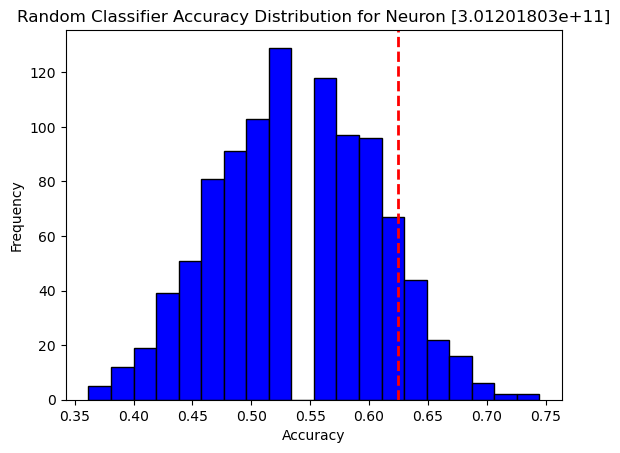

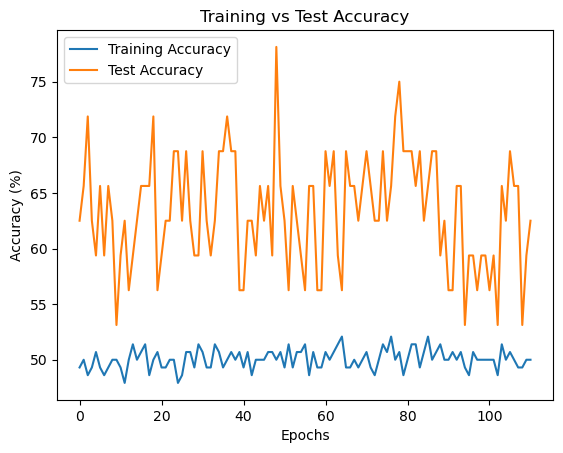

Confusion Matrix:
 [[30  0]
 [17  0]]
Class-specific Accuracy: [1. 0.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 28.12%, p-value = 1.0000


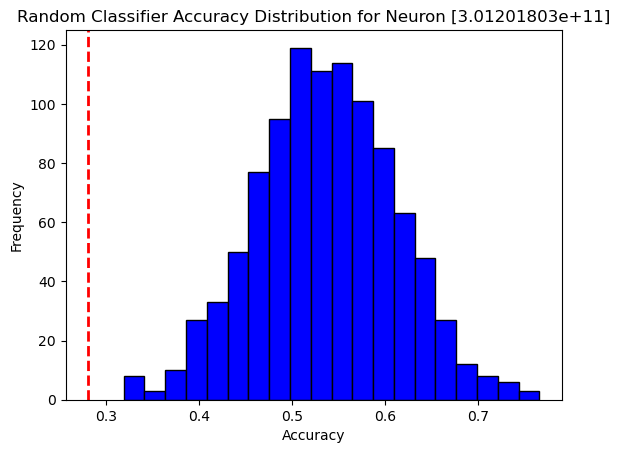

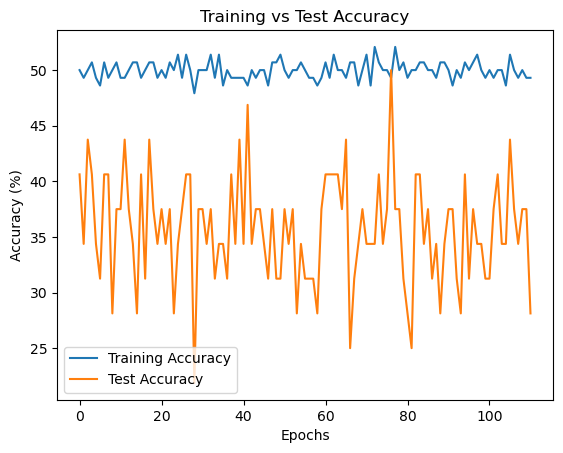

Confusion Matrix:
 [[ 0 30]
 [ 0 17]]
Class-specific Accuracy: [0. 1.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 37.50%, p-value = 0.9890


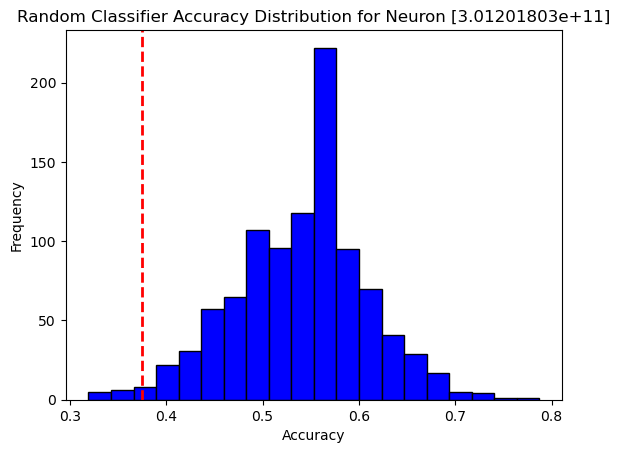

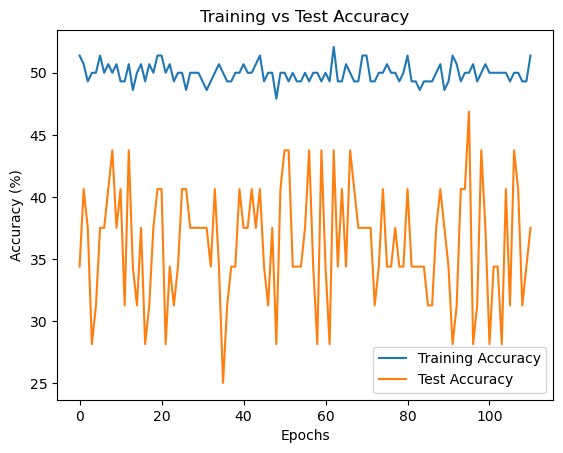

Confusion Matrix:
 [[ 0 30]
 [ 0 17]]
Class-specific Accuracy: [0. 1.]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 40.62%, p-value = 0.9680


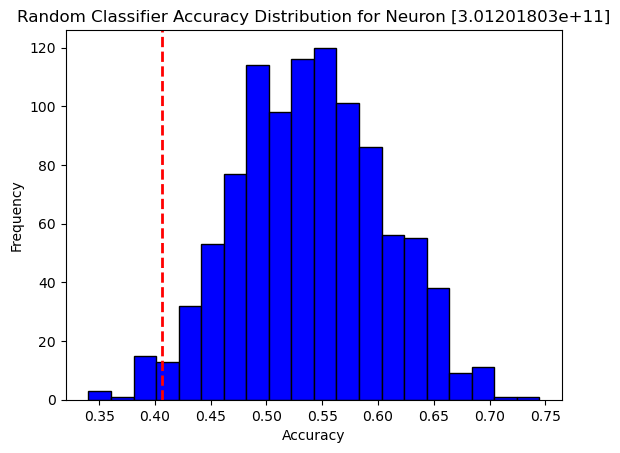

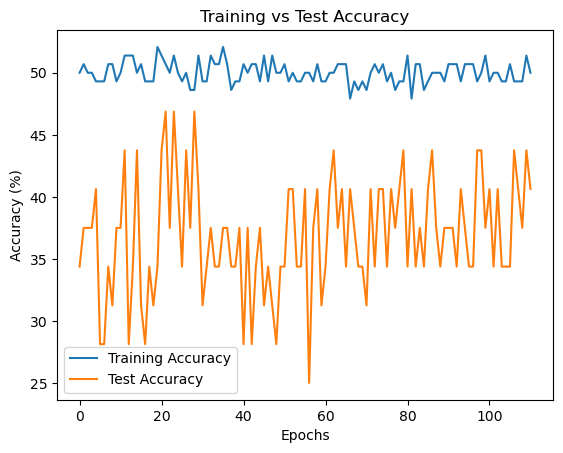

Confusion Matrix:
 [[ 0 30]
 [ 0 17]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 75.00%, p-value = 0.0510


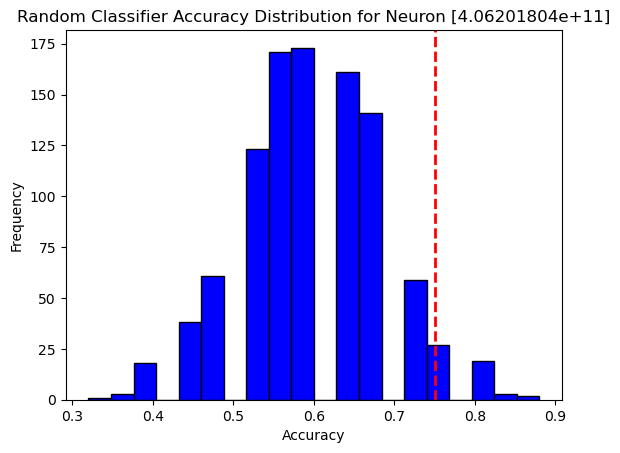

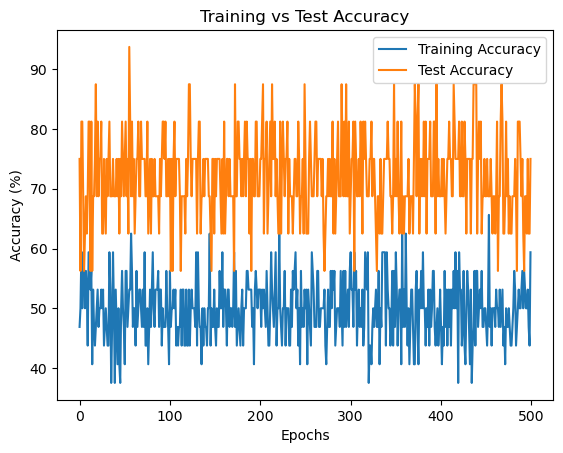

Confusion Matrix:
 [[ 0  7]
 [ 0 18]]
Class-specific Accuracy: [0. 1.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 18.75%, p-value = 1.0000


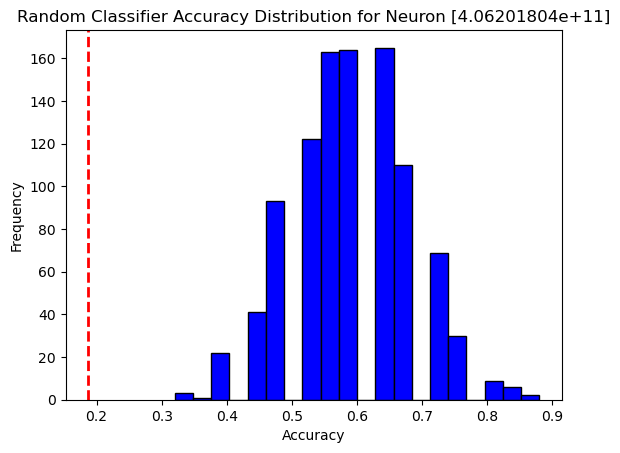

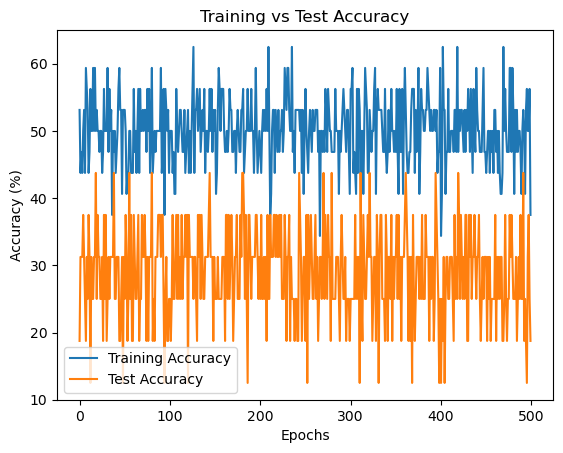

Confusion Matrix:
 [[ 7  0]
 [18  0]]
Class-specific Accuracy: [1. 0.]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX


KeyboardInterrupt: 

In [11]:
####using sampling technique instead of weighted loss
'''
If one class has more samples than the other, we randomly undersample the majority class to match the size of the minority class.
'''

# Number of random classifiers (null hypothesis testing)
num_permutations = 1000

# Brain areas and analysis types
results_sampled = []
brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"]

combinations = [('S1', 'GO'), ('S1', 'LICK'), ('S1naive', 'GO'), ('S1naive', 'LICK'), ('PPC', 'GO'), ('PPC', 'LICK')]

# Iterate through each combination
for comb in combinations:
    brain_area = comb[0]
    type_of_analysis = comb[1]
    print(f"Brain Area: {brain_area}, Analysis Type: {type_of_analysis}")
    trial_list, trial_dff = get_data_ready(brain_area, type_of_analysis)

    neuron_list = np.unique(trial_list[:, 0]).reshape(-1, 1)
    print("Num of neurons before filter=", neuron_list.shape[0])

    for neuron in neuron_list:
        print("\n", neuron, "XXXXXXXXXXXXXXXXXXXX")
        
        # Extract neuron-specific data
        neuron_data_list = trial_list[trial_list[:, 0] == neuron].copy()
        neuron_data_dff = trial_dff[trial_list[:, 0] == neuron].copy()

        X = neuron_data_dff.copy()
        y = neuron_data_list[:, 1]

        # Ensure there are at least two unique classes
        unique_classes = np.unique(y)
        if len(unique_classes) < 2:
            print(f"Skipping neuron {neuron} due to insufficient class diversity")
            continue 

        # Reshape X
        X = X.reshape(X.shape[0], X.shape[1], 1)

        #### Train-test split
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # **Apply Undersampling to deal with class imbalance in training data**
        class_0_indices = np.where(y_train == 0)[0]
        class_1_indices = np.where(y_train == 1)[0]

        if len(class_0_indices) > len(class_1_indices):  # If class 0 is larger, undersample it
            undersample_indices = np.random.choice(class_0_indices, size=len(class_1_indices), replace=False)
            balanced_indices = np.concatenate([undersample_indices, class_1_indices])
        else:  # If class 1 is larger, undersample it
            undersample_indices = np.random.choice(class_1_indices, size=len(class_0_indices), replace=False)
            balanced_indices = np.concatenate([class_0_indices, undersample_indices])

        # Create balanced training set
        X_train_balanced = X_train[balanced_indices]
        y_train_balanced = y_train[balanced_indices]

        # Convert to tensors
        Xtrain = torch.from_numpy(X_train_balanced).float()
        ytrain = torch.from_numpy(y_train_balanced).long()
        Xtest = torch.from_numpy(X_test).float()
        ytest = torch.from_numpy(y_test).long()

        # Batch size, epochs, and iterations
        batch_size = 16
        #check if we still have enough after undersapling 
        if len(X_train_balanced) < batch_size:
            print(f"Skipping neuron {neuron} due to insufficient samples after undersampling")
            continue
        
        n_iters = 1000
        num_epochs = int(n_iters // (len(X_train_balanced) // batch_size))

        train = TensorDataset(Xtrain, ytrain)
        test = TensorDataset(Xtest, ytest)

        train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test, batch_size=batch_size, shuffle=True, drop_last=True)

        # Create the RNN model
        input_dim = X.shape[-1]
        hidden_dim = 4
        layer_dim = 1
        output_dim = 1

        model = RNNModel(input_dim, hidden_dim, layer_dim, output_dim)

        # Loss function and optimizer
        error = nn.BCEWithLogitsLoss()  # No class weights, since undersampling handles imbalance
        learning_rate = 0.001
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

        # Training loop for the original model
        train_accuracy_list = []
        test_accuracy_list = []
        test_loss_list = []

        for epoch in range(num_epochs):
            model.train()
            total_train, correct_train = 0, 0

            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                outputs = model(X_batch).squeeze()
                loss = error(outputs, y_batch.float())
                loss.backward()
                optimizer.step()

                probabilities = torch.sigmoid(outputs)
                predicted = (probabilities > 0.5).long()
                correct_train += (predicted.squeeze() == y_batch).sum().item()
                total_train += y_batch.size(0)

            train_accuracy = 100 * correct_train / total_train
            train_accuracy_list.append(train_accuracy)
            scheduler.step()

            # Evaluate on test set
            model.eval()
            total_test, correct_test = 0, 0
            with torch.no_grad():
                for X_test_batch, y_test_batch in test_loader:
                    outputs = model(X_test_batch).squeeze()
                    probabilities = torch.sigmoid(outputs)
                    predicted = (probabilities > 0.5).long()
                    correct_test += (predicted == y_test_batch).sum().item()
                    total_test += y_test_batch.size(0)
                    loss_test = error(outputs, y_test_batch.float())
                    test_loss_list.append(loss_test)

            test_accuracy = 100 * correct_test / float(total_test)
            test_accuracy_list.append(test_accuracy)

        # Save the original model's test accuracy
        original_test_accuracy = test_accuracy

        # Random classifier: Match class distribution in the test set
        class_distribution = np.mean(y_test)  # proportion of class 1

        random_accuracies = []
        for _ in range(num_permutations):
            y_random = np.random.choice([0, 1], size=len(y_test), p=[1 - class_distribution, class_distribution])
            random_accuracy = accuracy_score(y_test, y_random)
            random_accuracies.append(random_accuracy)

        # Calculate p-value using a t-test (testing original model vs. random classifiers)
        random_accuracies = np.array(random_accuracies)
        p_value = np.mean(random_accuracies >= original_test_accuracy/100)

        # Store results
        results_sampled.append({
            'Brain Area': brain_area,
            'Analysis Type': type_of_analysis,
            'Neuron': neuron,
            'Train Accuracy': train_accuracy_list,
            'Test Accuracy': original_test_accuracy,
            'p value': p_value
        })

        print(f"Neuron {neuron}: Test Accuracy = {original_test_accuracy:.2f}%, p-value = {p_value:.4f}")

        # Visualize random classifier accuracy distribution
        plt.hist(random_accuracies, bins=20, color='blue', edgecolor='black')
        plt.axvline(original_test_accuracy/100, color='red', linestyle='dashed', linewidth=2)
        plt.title(f'Random Classifier Accuracy Distribution for Neuron {neuron}')
        plt.xlabel('Accuracy')
        plt.ylabel('Frequency')
        plt.show()

     # Plot training vs test accuracy to examine potential overfitting or bias
        plt.plot(train_accuracy_list, label='Training Accuracy')
        plt.plot(test_accuracy_list, label='Test Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy (%)')
        plt.title('Training vs Test Accuracy')
        plt.legend()
        plt.show()
        
        # Check class-specific accuracy on the test set
        
        # Predict on the test set and calculate confusion matrix
        model.eval()
        with torch.no_grad():
            outputs = model(Xtest).squeeze()
            probabilities = torch.sigmoid(outputs)
            predictions = (probabilities > 0.5).long()
            
        conf_matrix = confusion_matrix(ytest, predictions)
        print("Confusion Matrix:\n", conf_matrix)
        
        # Calculate class-specific accuracy
        class_accuracy = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
        print("Class-specific Accuracy:", class_accuracy)






/tmp/ipykernel_128/1513734945.py:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas


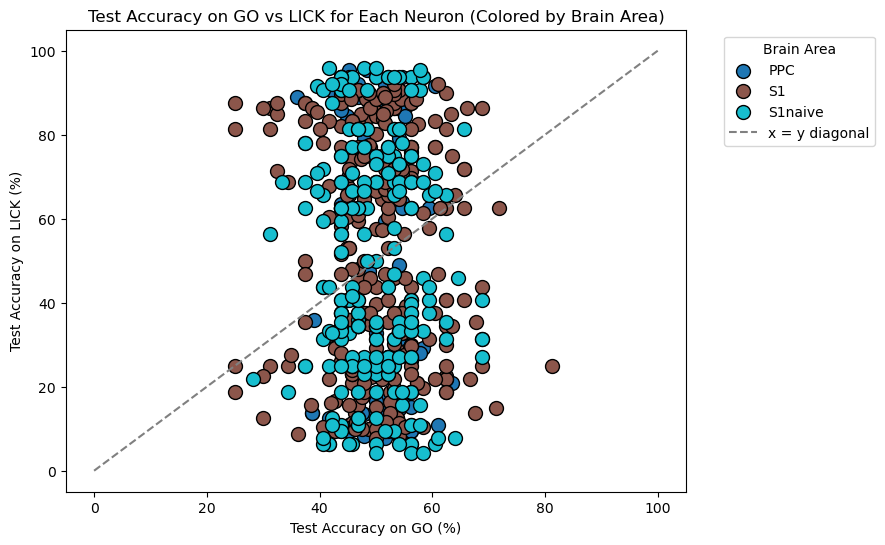

In [8]:
#lets plot what we have after sampling 
# Dictionaries to store test accuracies, brain areas, and p-values by neuron
go_accuracies = {}
lick_accuracies = {}
brain_areas = {}

# Populate dictionaries with test accuracies and brain area
for result in results_sampled:
    neuron = result['Neuron']
    if isinstance(neuron, np.ndarray):  # If neuron is a NumPy array, convert to a scalar value
        neuron = neuron.item()  # Extract the value from the NumPy array
    
    # Store test accuracy for "GO" and "LICK"
    if result['Analysis Type'] == 'GO':
        go_accuracies[neuron] = result['Test Accuracy']
    elif result['Analysis Type'] == 'LICK':
        lick_accuracies[neuron] = result['Test Accuracy']
    
    # Store brain area information
    if neuron not in brain_areas:
        brain_areas[neuron] = result['Brain Area']

# Now only include neurons that have both "GO" and "LICK" test accuracies
go_test_accuracies = []
lick_test_accuracies = []
neuron_brain_areas = []

for neuron in go_accuracies:
    if neuron in lick_accuracies:  # Only include neurons with both GO and LICK data
        go_test_accuracies.append(go_accuracies[neuron])
        lick_test_accuracies.append(lick_accuracies[neuron])
        neuron_brain_areas.append(brain_areas[neuron])  # Track brain area for each neuron

# Convert lists to numpy arrays for compatibility with plotting
go_test_accuracies = np.array(go_test_accuracies)
lick_test_accuracies = np.array(lick_test_accuracies)
neuron_brain_areas = np.array(neuron_brain_areas)

# Define unique brain areas for color coding
unique_brain_areas = np.unique(neuron_brain_areas)
colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas

# Plotting the scatter plot with color coding by brain area
plt.figure(figsize=(8, 6))
for i, brain_area in enumerate(unique_brain_areas):
    mask = neuron_brain_areas == brain_area
    plt.scatter(go_test_accuracies[mask], lick_test_accuracies[mask], label=brain_area,
                color=colors(i), s=100, edgecolor='k')

# Adding x=y diagonal line
plt.plot([0, 100], [0, 100], linestyle='--', color='gray', label='x = y diagonal')

# Adding labels and title
plt.xlabel('Test Accuracy on GO (%)')
plt.ylabel('Test Accuracy on LICK (%)')
plt.title('Test Accuracy on GO vs LICK for Each Neuron (Colored by Brain Area)')

# Adding legend for brain areas
plt.legend(title="Brain Area", bbox_to_anchor=(1.05, 1), loc='upper left')

# Show plot
plt.show()


In [9]:
#import pandas as pd
# Convert the results to a Pandas DataFrame
df_results = pd.DataFrame(results_sampled)

# Save the DataFrame to a CSV file
df_results.to_csv('test_accuracies_undersampled.csv', index=False)

Brain Area: S1, Analysis Type: GO
Num of neurons before filter= 289

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 34.38%, p-value = 0.9980


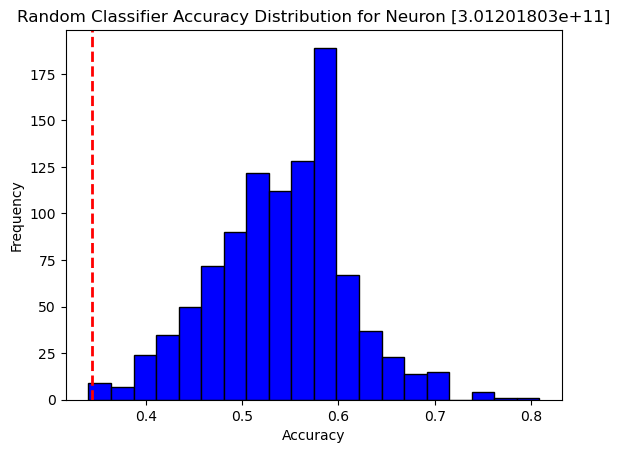


 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 62.50%, p-value = 0.0980


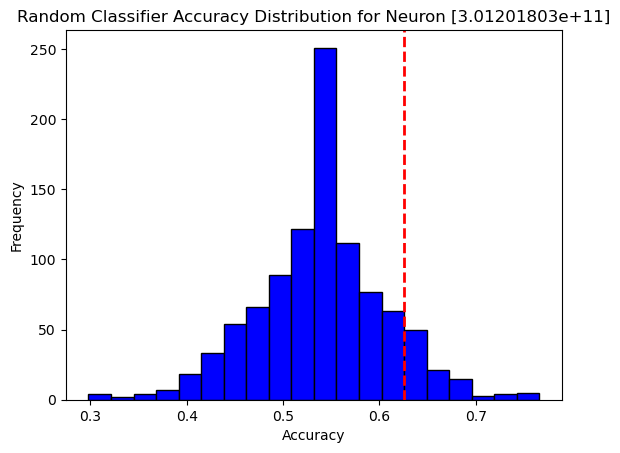


 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 31.25%, p-value = 0.9990


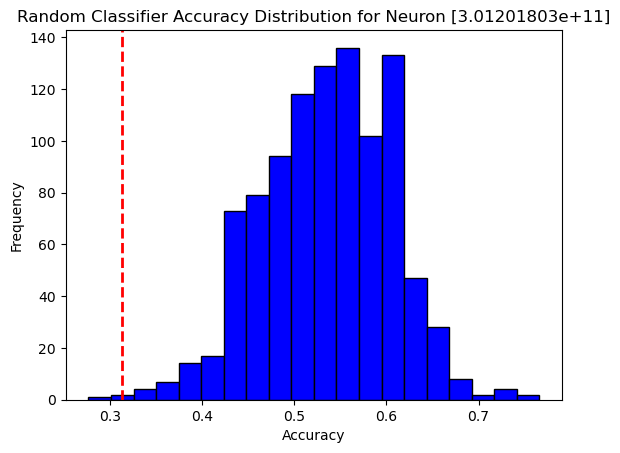


 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 68.75%, p-value = 0.0140


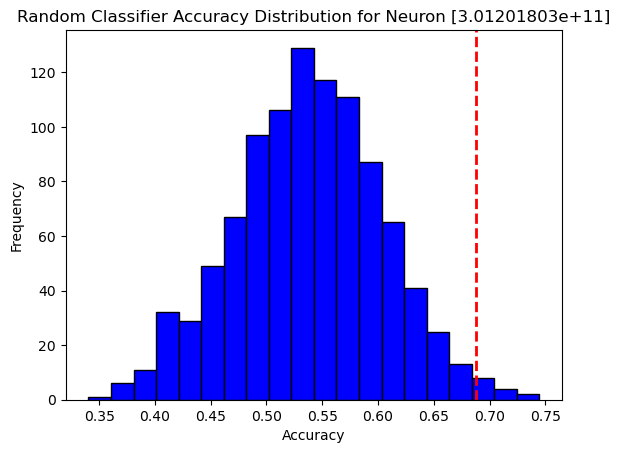


 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 31.25%, p-value = 1.0000


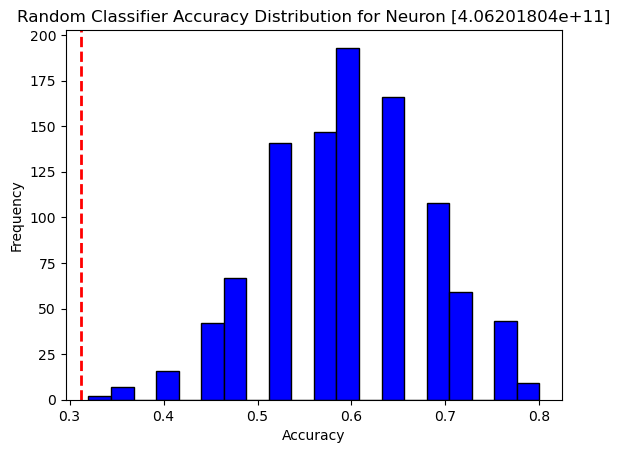


 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 75.00%, p-value = 0.0430


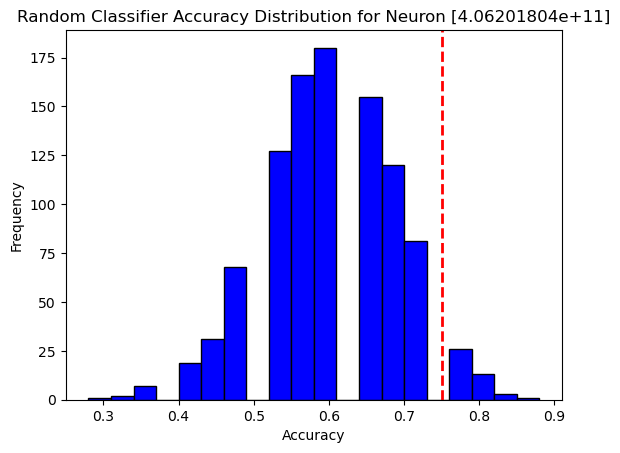


 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 25.00%, p-value = 1.0000


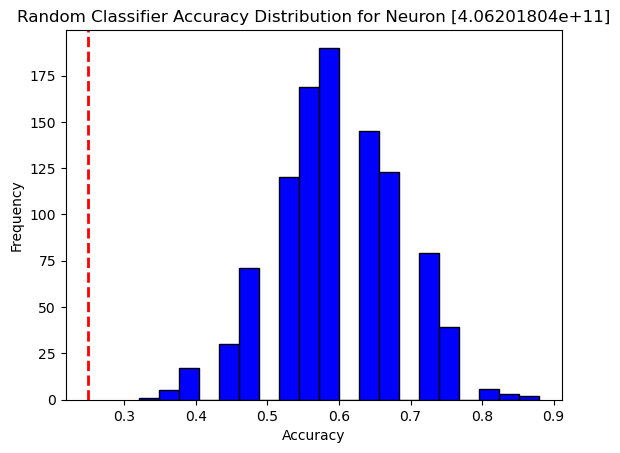


 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 25.00%, p-value = 1.0000


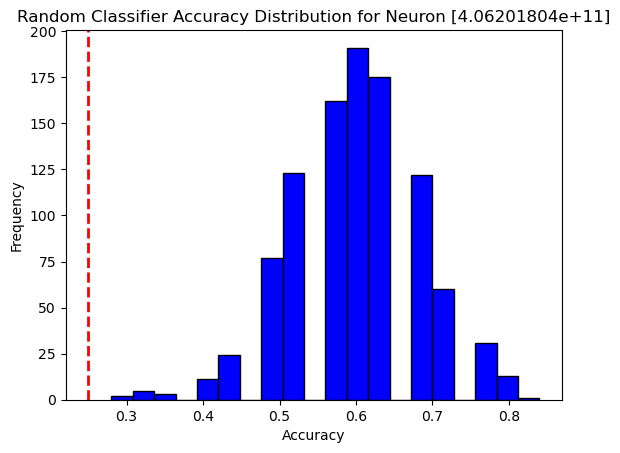


 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+11]: Test Accuracy = 25.00%, p-value = 1.0000


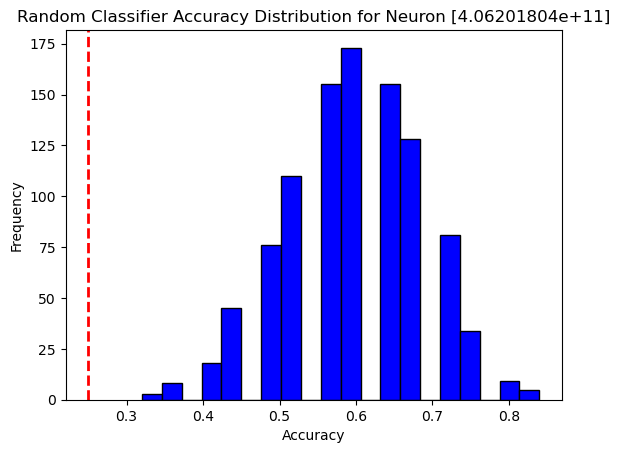


 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 43.75%, p-value = 0.9050


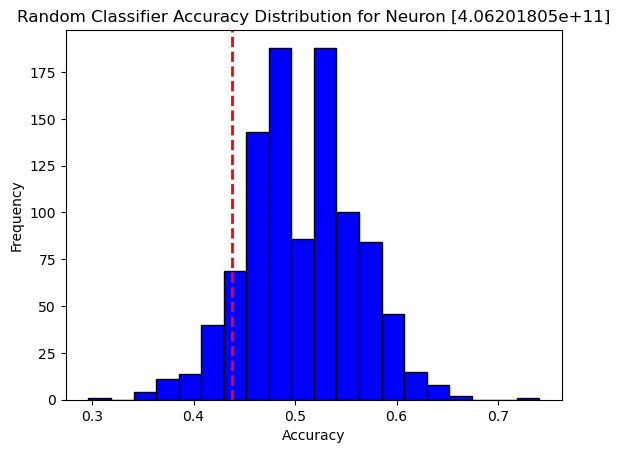


 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 55.00%, p-value = 0.2280


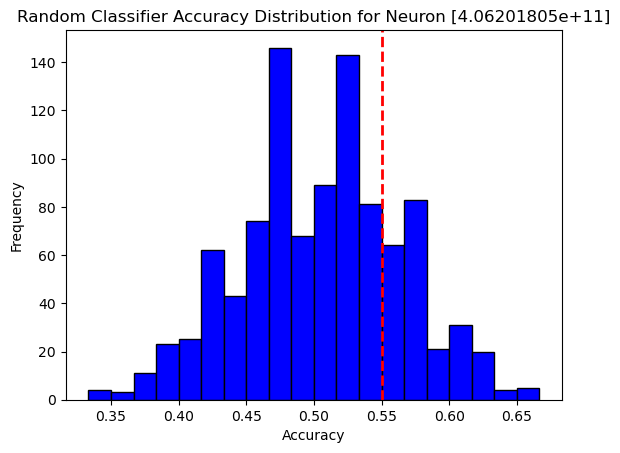


 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 55.00%, p-value = 0.2310


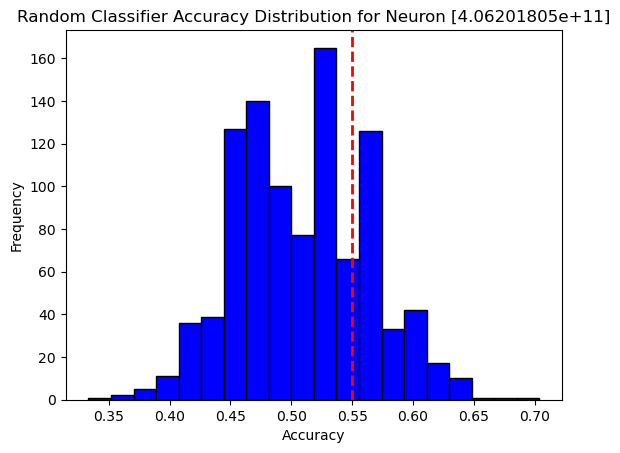


 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 52.50%, p-value = 0.3550


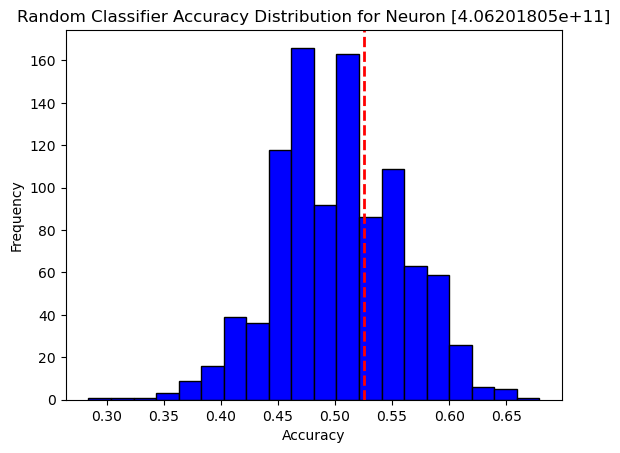


 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 43.75%, p-value = 0.8080


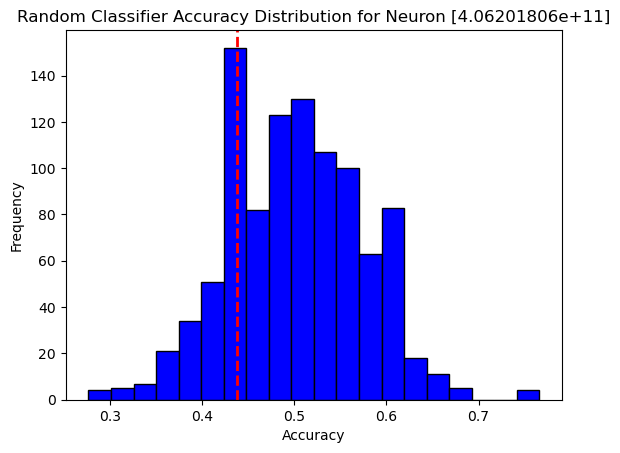


 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 50.00%, p-value = 0.5170


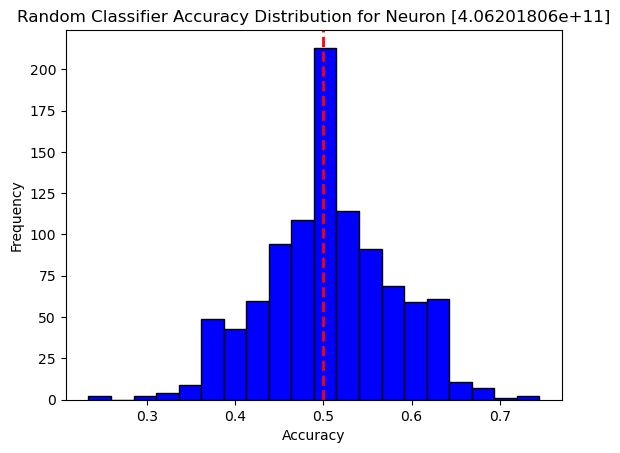


 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 40.62%, p-value = 0.8980


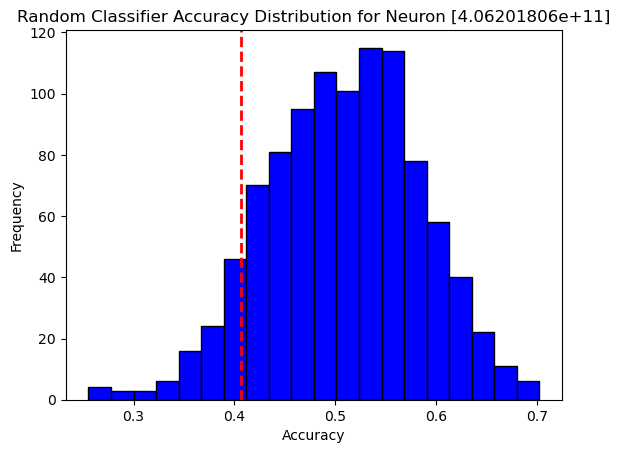


 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 56.25%, p-value = 0.2100


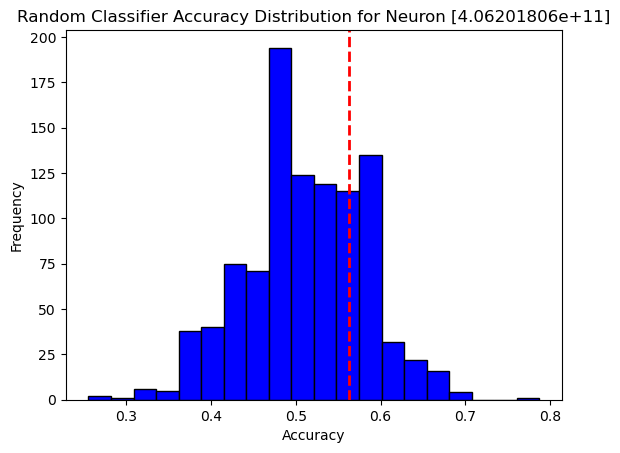


 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 45.83%, p-value = 0.8050


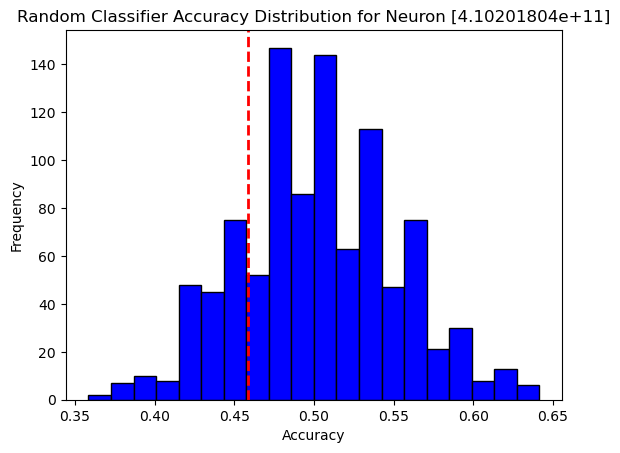


 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 51.04%, p-value = 0.4030


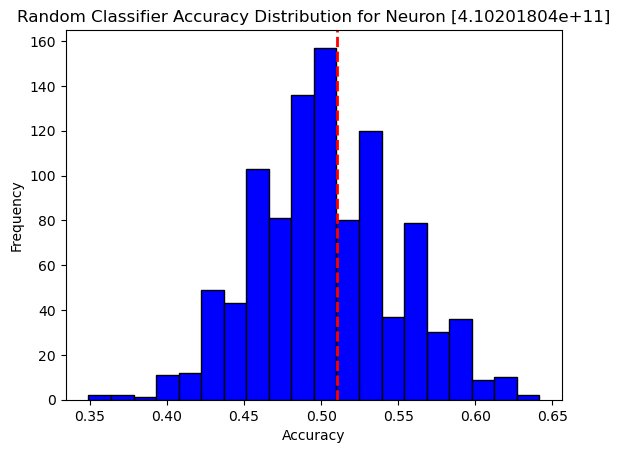


 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 45.83%, p-value = 0.8180


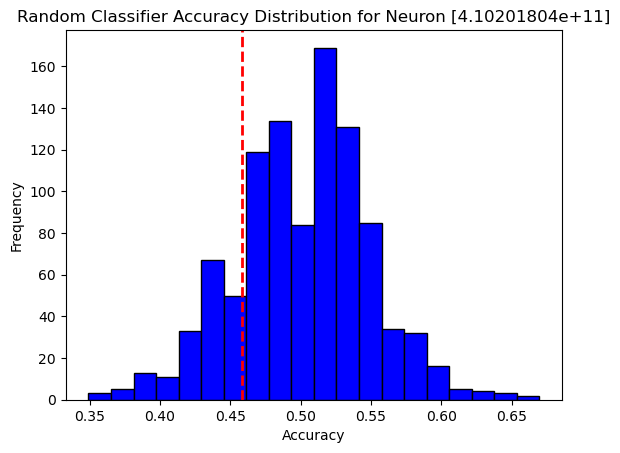


 [4.10201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+11]: Test Accuracy = 57.50%, p-value = 0.1270


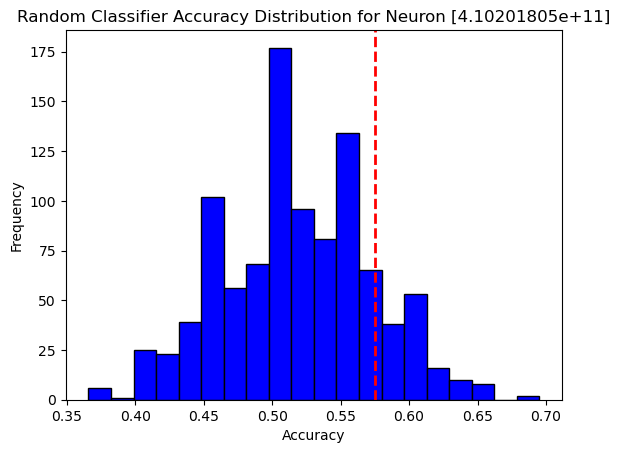


 [4.10201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+11]: Test Accuracy = 60.00%, p-value = 0.0580


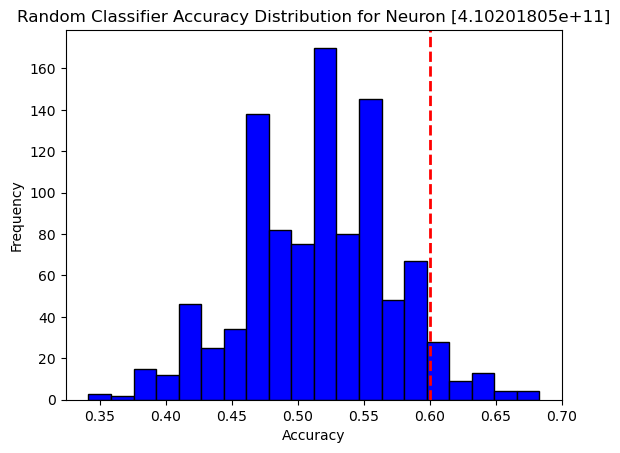


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 58.75%, p-value = 0.3710


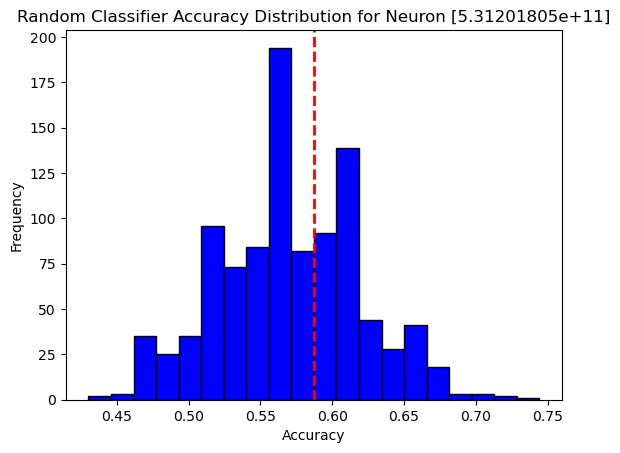


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 46.25%, p-value = 0.9850


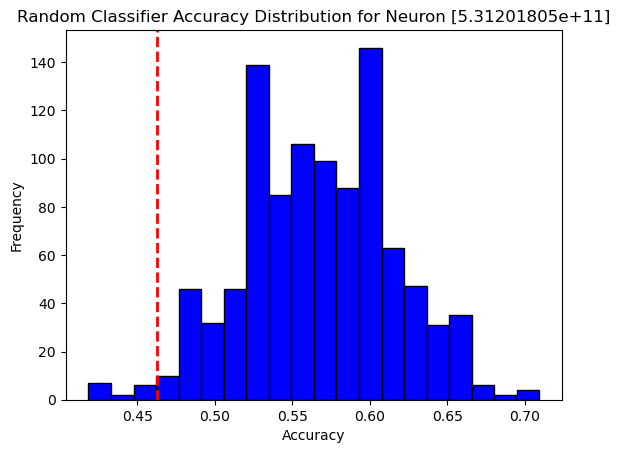


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 45.00%, p-value = 0.9920


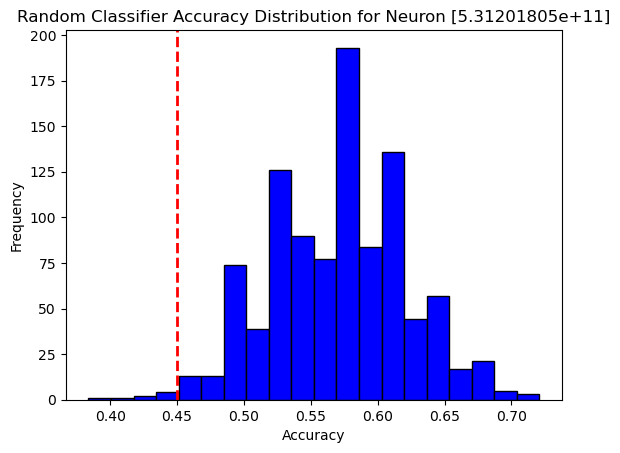


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 56.25%, p-value = 0.5750


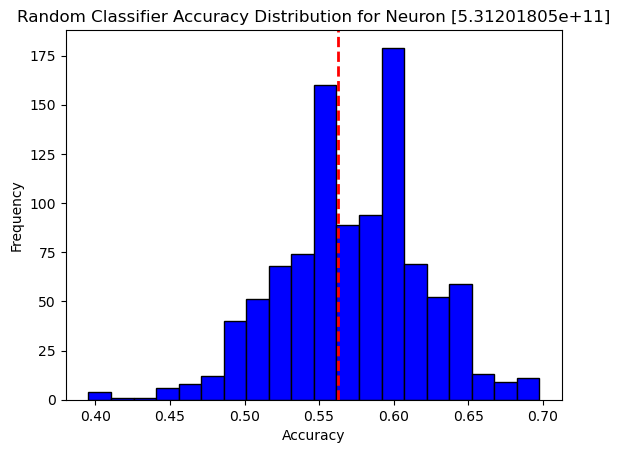


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 53.75%, p-value = 0.7350


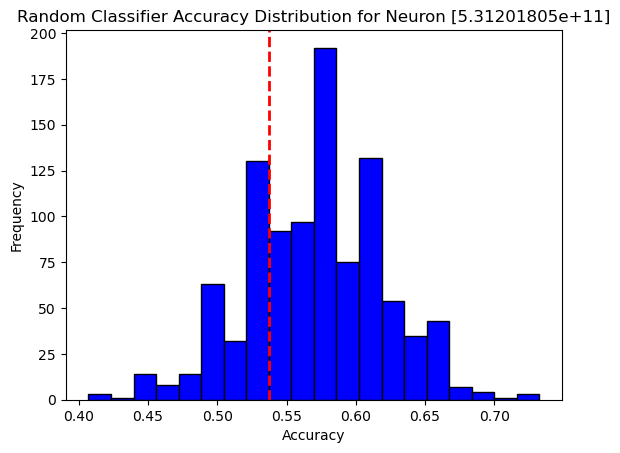


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 37.50%, p-value = 1.0000


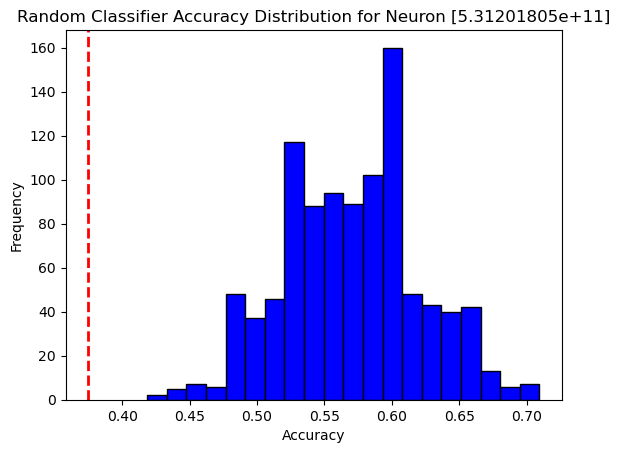


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 46.88%, p-value = 0.8190


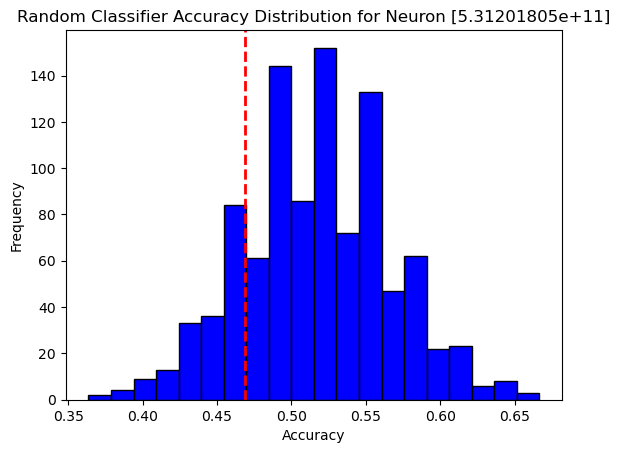


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 61.46%, p-value = 0.0220


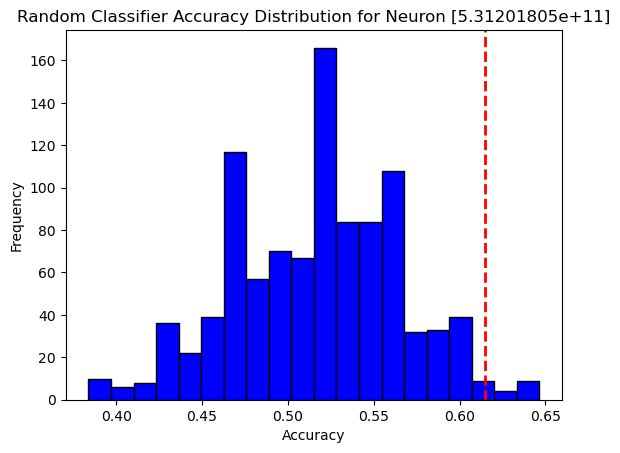


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 55.21%, p-value = 0.2460


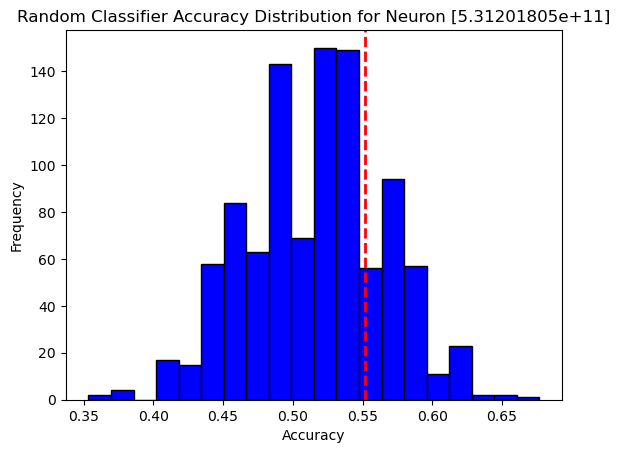


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 58.33%, p-value = 0.1000


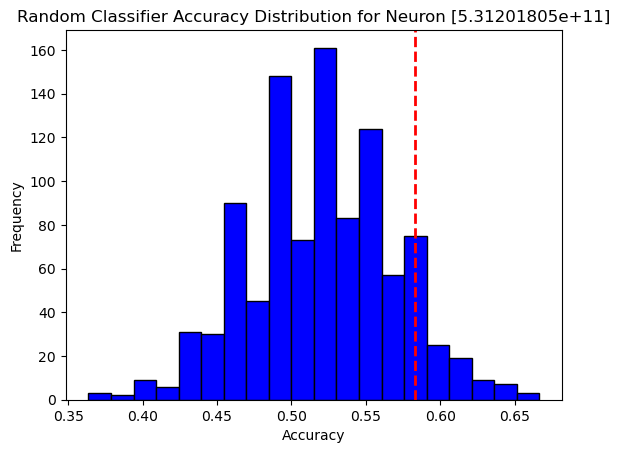


 [5.31201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+11]: Test Accuracy = 54.17%, p-value = 0.3120


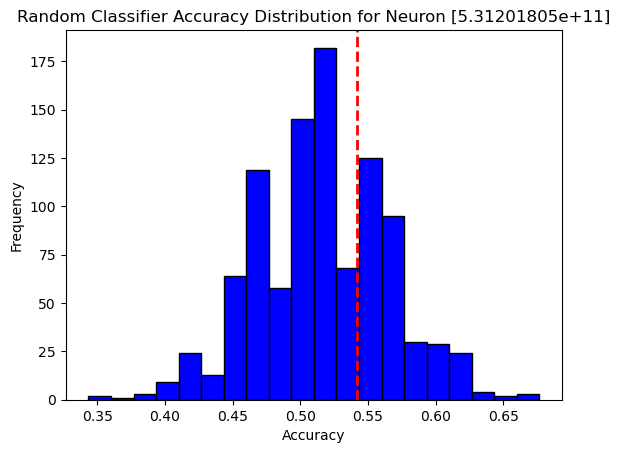


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 55.21%, p-value = 0.1250


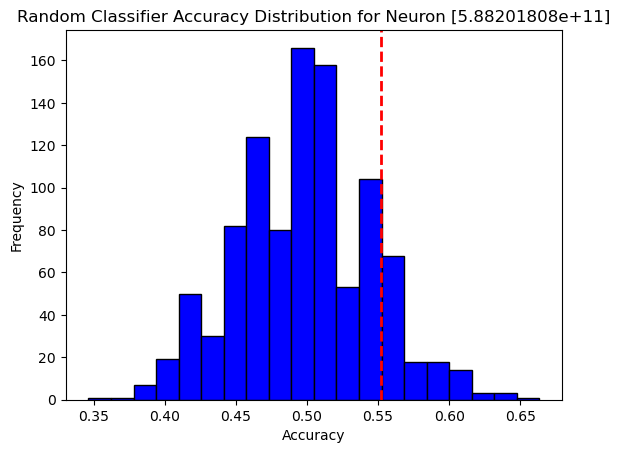


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 51.04%, p-value = 0.3970


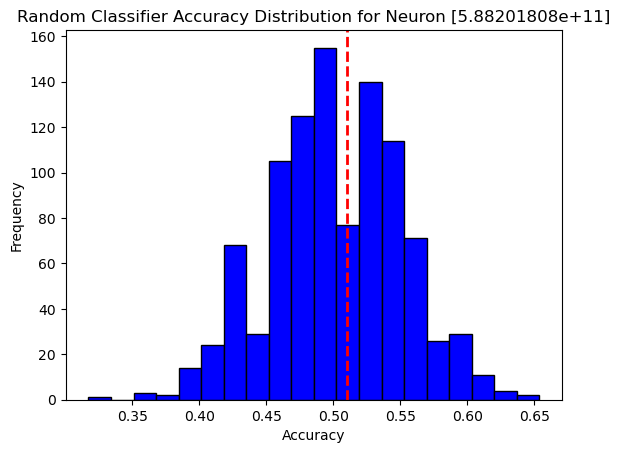


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 45.83%, p-value = 0.8260


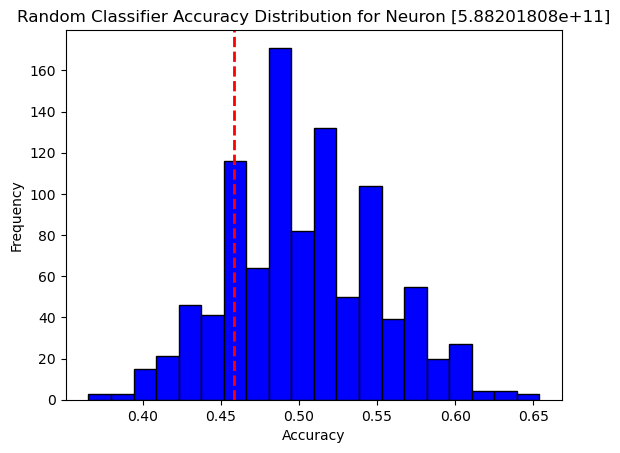


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 40.62%, p-value = 0.9720


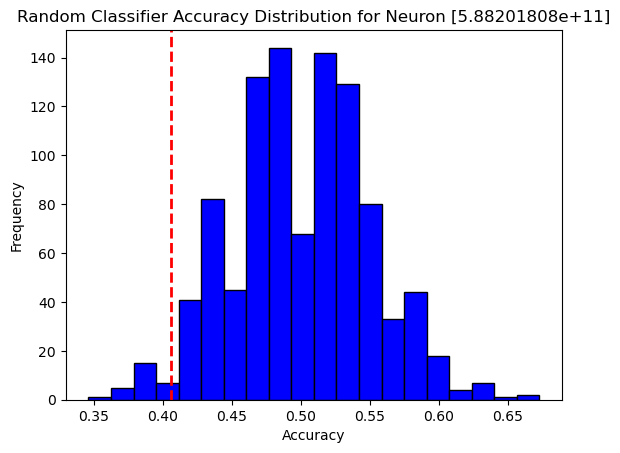


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 46.09%, p-value = 0.8380


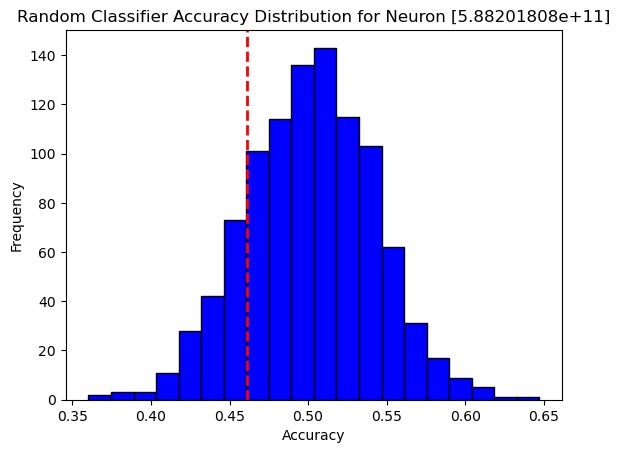


 [5.88201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+11]: Test Accuracy = 49.22%, p-value = 0.6220


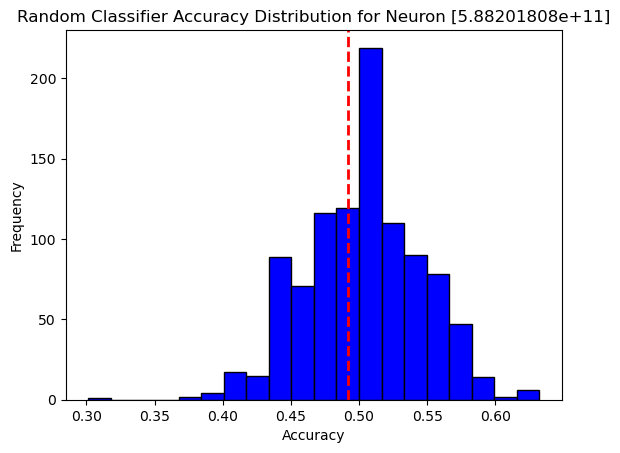


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 47.92%, p-value = 0.7380


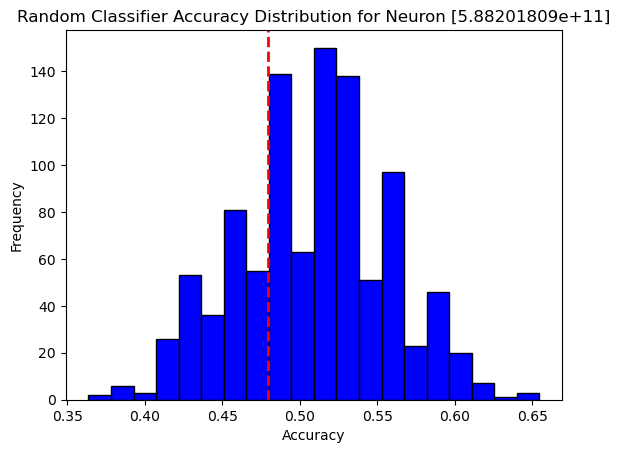


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 55.21%, p-value = 0.1590


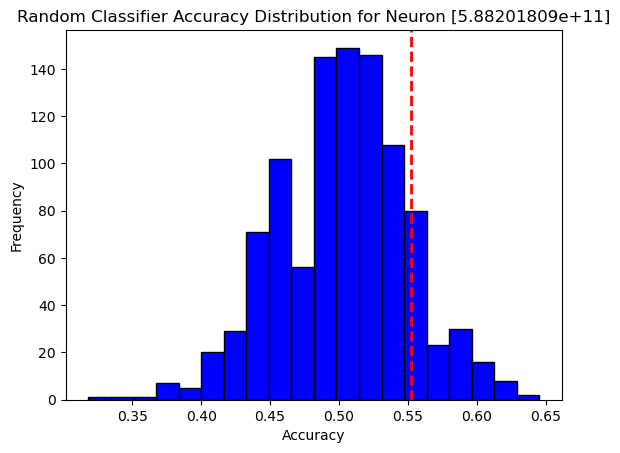


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 41.67%, p-value = 0.9810


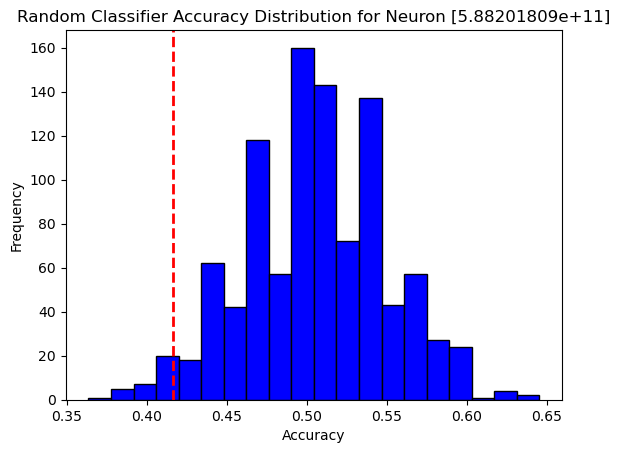


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 52.08%, p-value = 0.3930


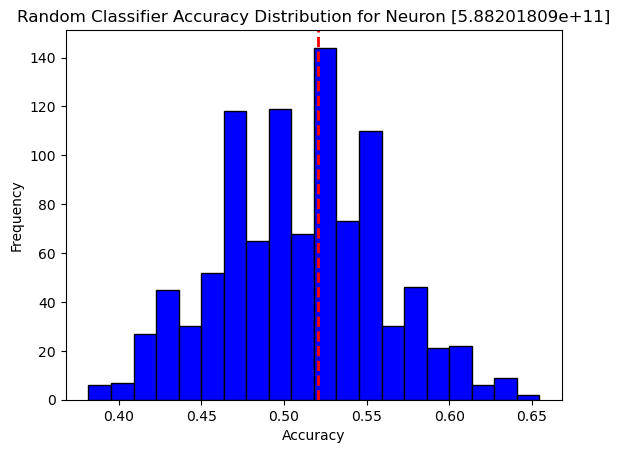


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 44.64%, p-value = 0.8910


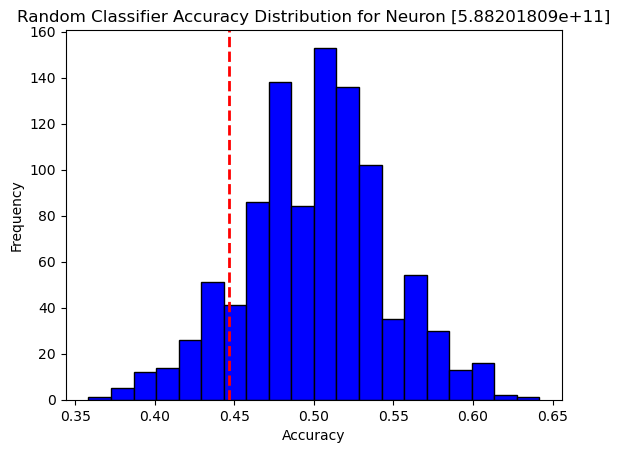


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 47.32%, p-value = 0.7450


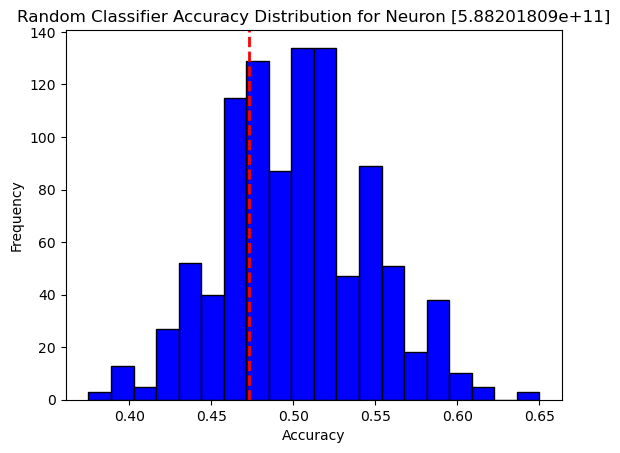


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 50.89%, p-value = 0.3910


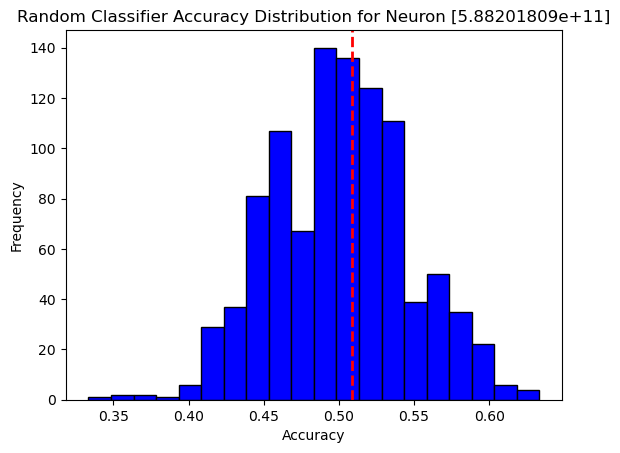


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 50.00%, p-value = 0.5400


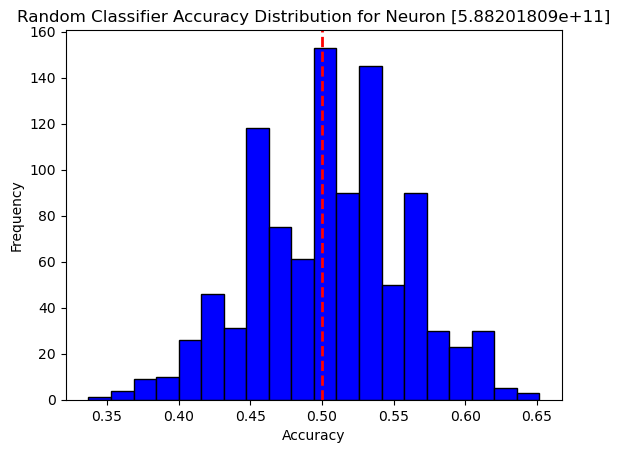


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 51.56%, p-value = 0.3690


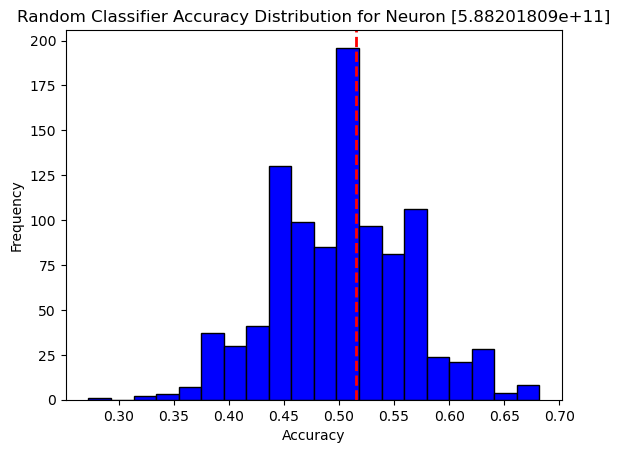


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 50.00%, p-value = 0.5550


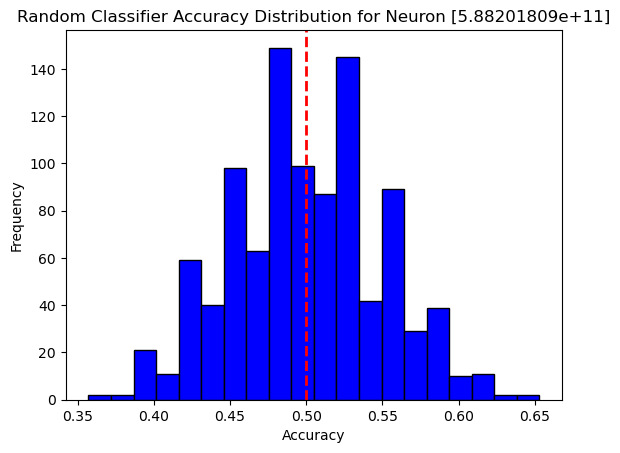


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 52.08%, p-value = 0.3140


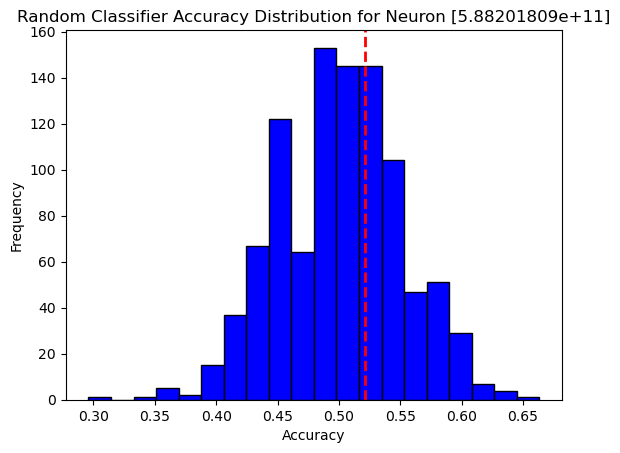


 [5.88201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+11]: Test Accuracy = 50.00%, p-value = 0.5480


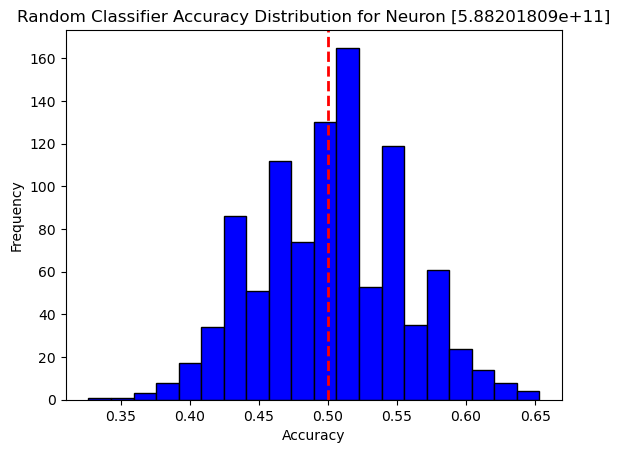


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 42.50%, p-value = 0.9310


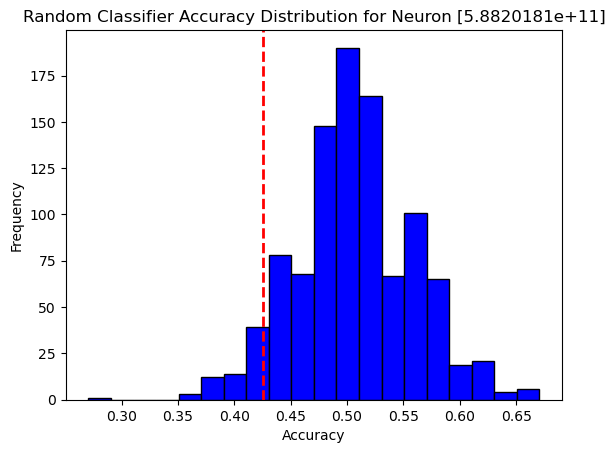


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 58.93%, p-value = 0.0410


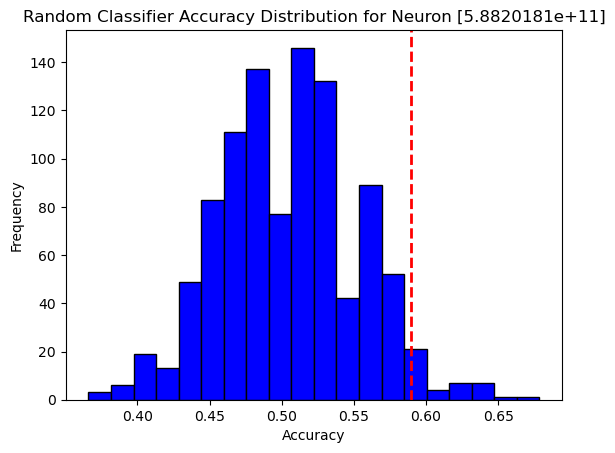


 [7.56201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+11]: Test Accuracy = 47.92%, p-value = 0.6360


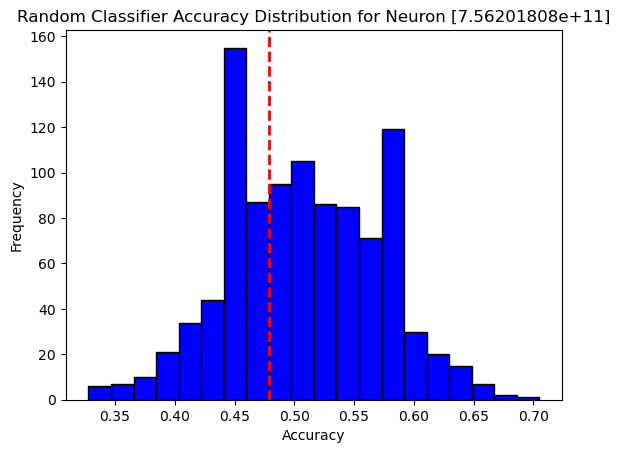


 [7.56201808e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+11]: Test Accuracy = 52.08%, p-value = 0.4420


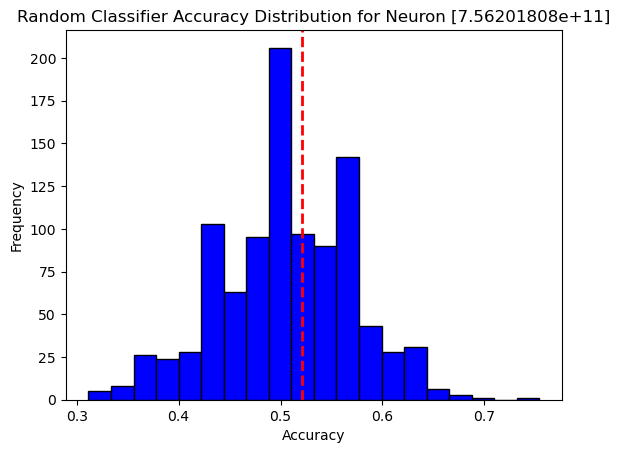


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 43.75%, p-value = 0.8040


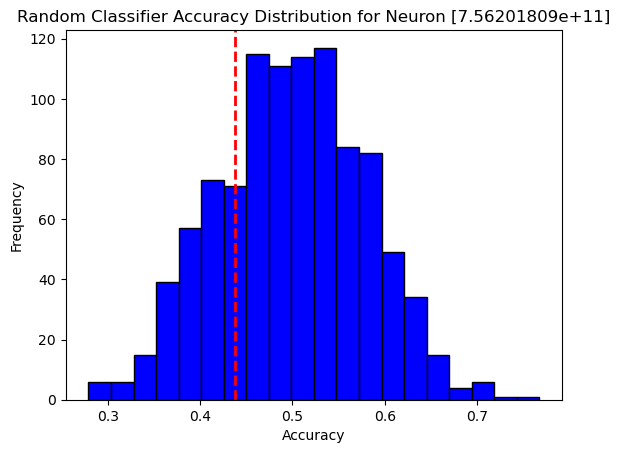


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 55.00%, p-value = 0.1960


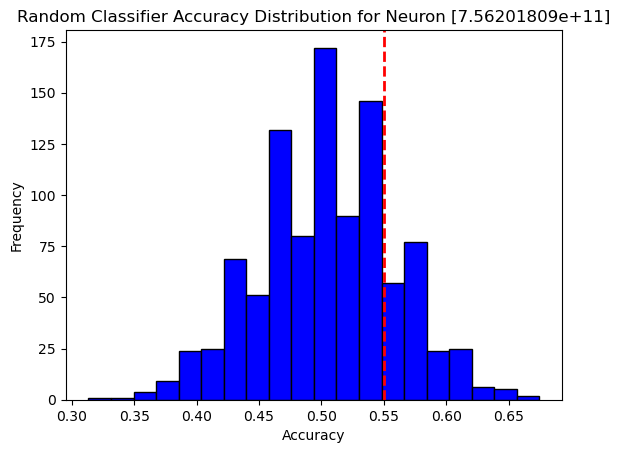


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 41.25%, p-value = 0.9290


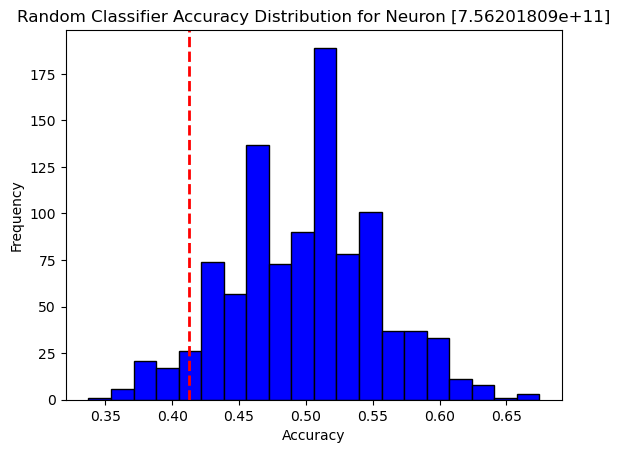


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 51.25%, p-value = 0.3920


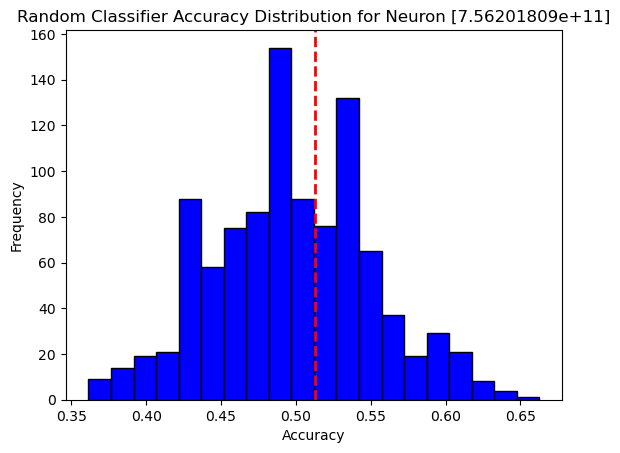


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 53.75%, p-value = 0.2680


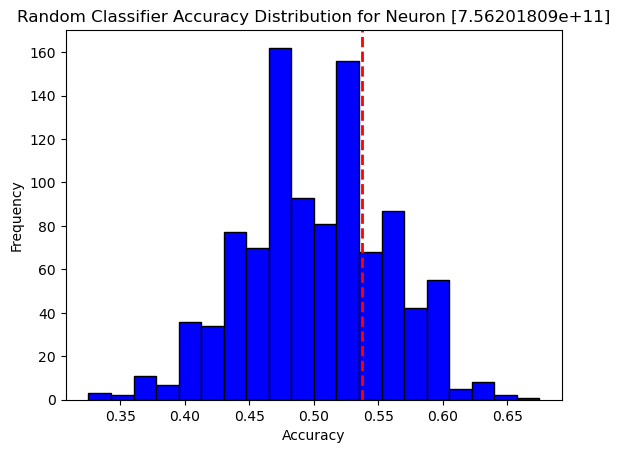


 [7.56201809e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+11]: Test Accuracy = 41.25%, p-value = 0.9460


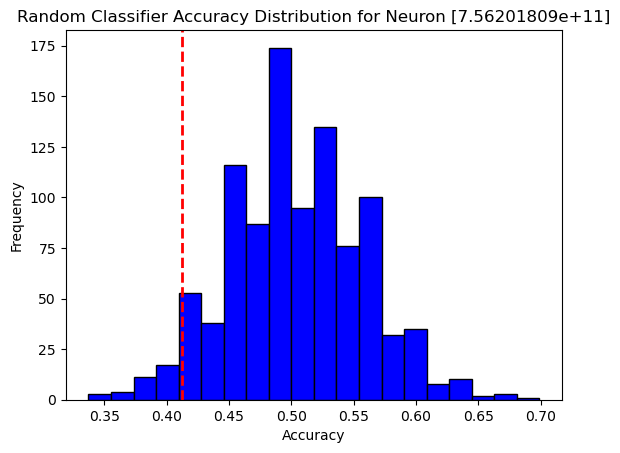


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 43.75%, p-value = 0.9350


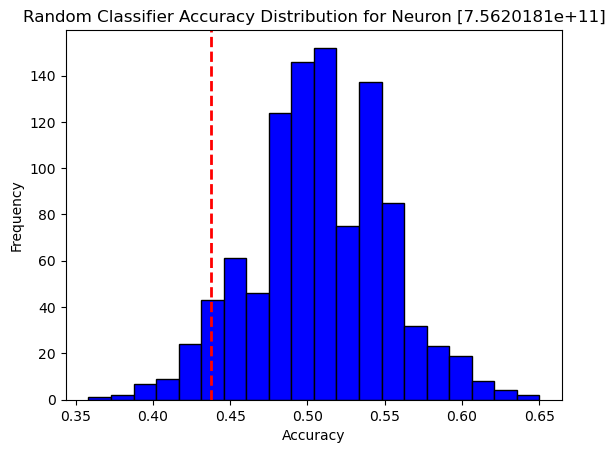


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 52.68%, p-value = 0.3090


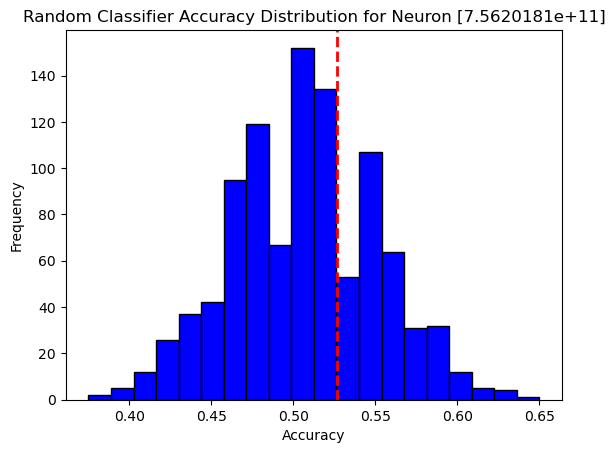


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 52.68%, p-value = 0.3040


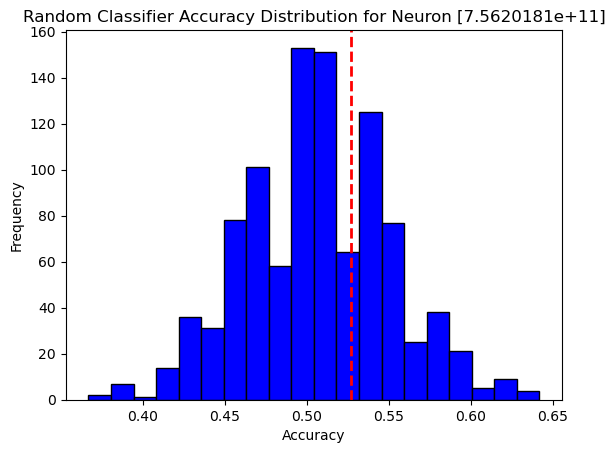


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 60.42%, p-value = 0.0510


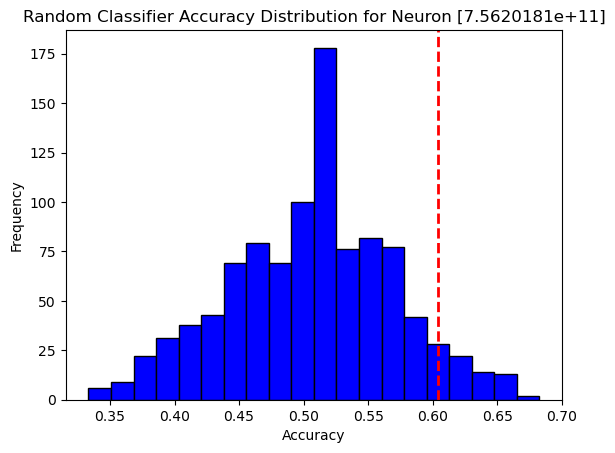


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 50.00%, p-value = 0.5420


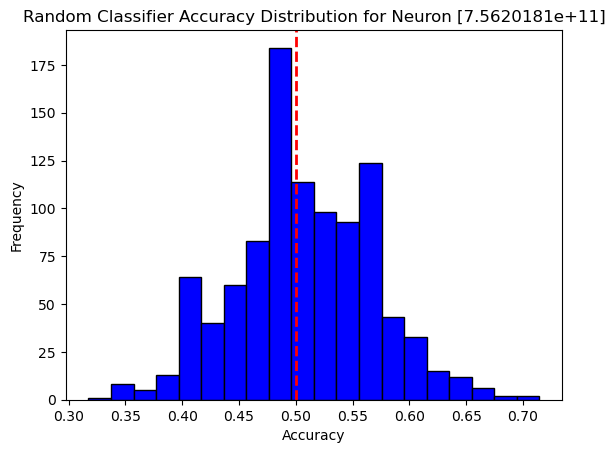


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 54.17%, p-value = 0.2310


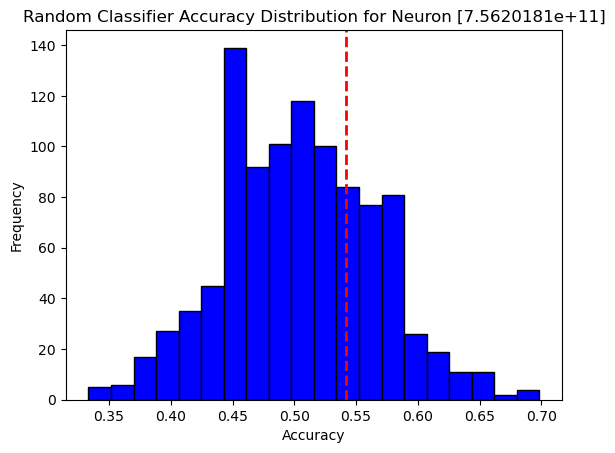


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 52.08%, p-value = 0.4280


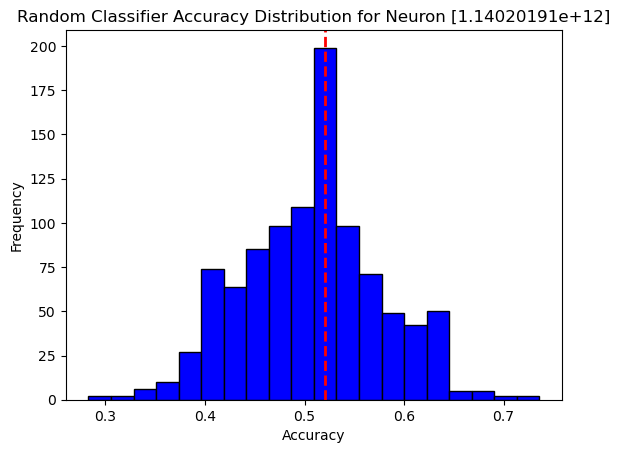


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 42.71%, p-value = 0.9350


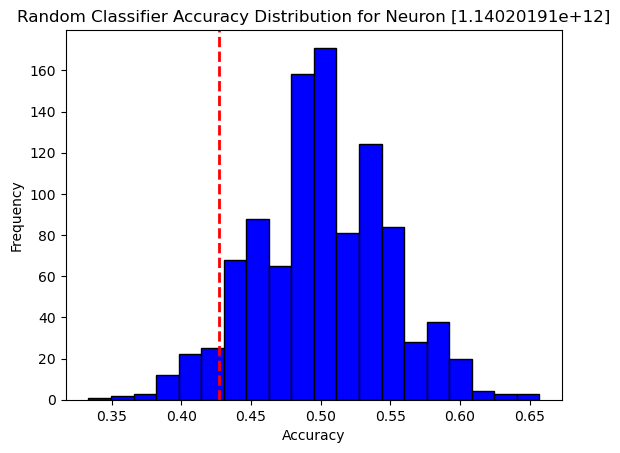


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 48.96%, p-value = 0.6320


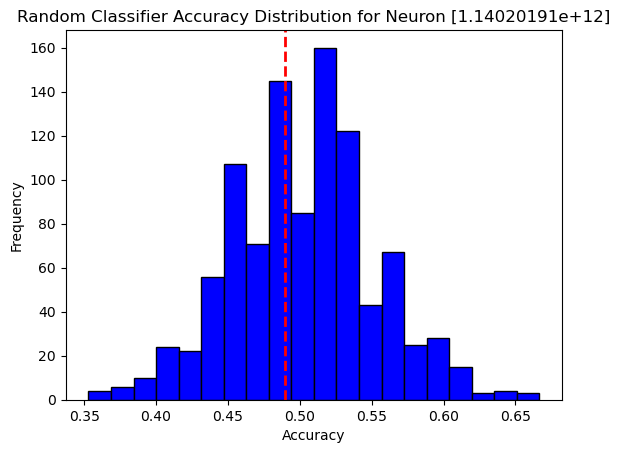


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 60.42%, p-value = 0.0850


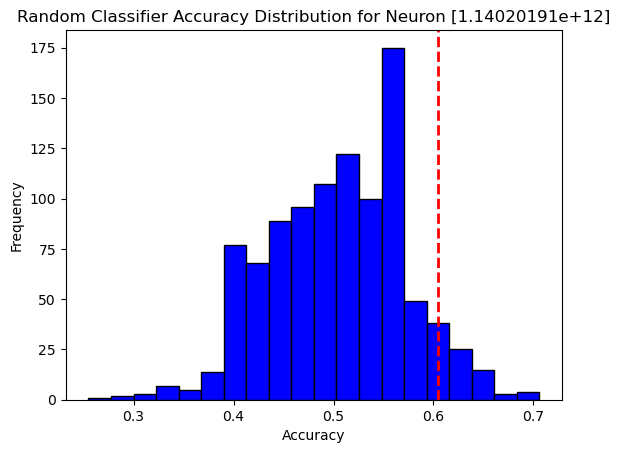


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 51.56%, p-value = 0.3740


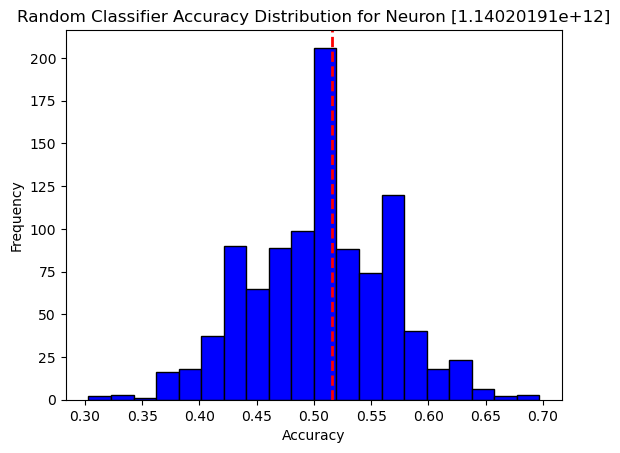


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 46.88%, p-value = 0.7480


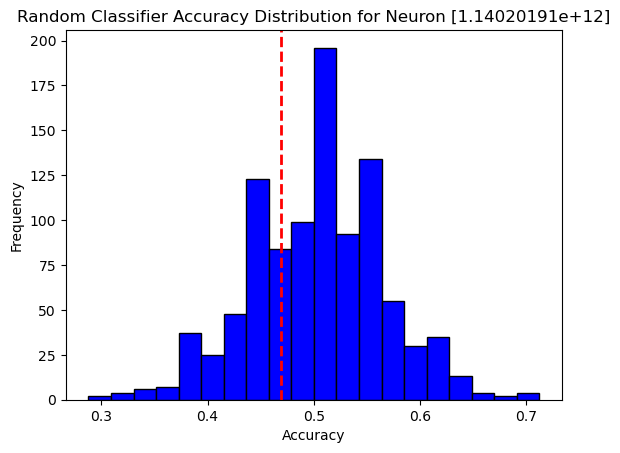


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 45.31%, p-value = 0.8310


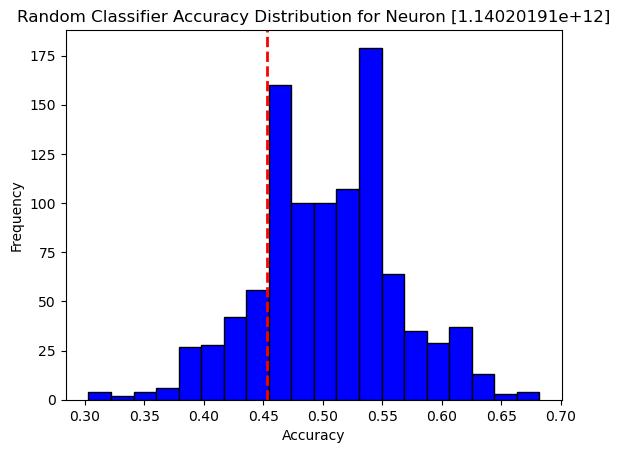


 [1.14020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+12]: Test Accuracy = 43.75%, p-value = 0.8810


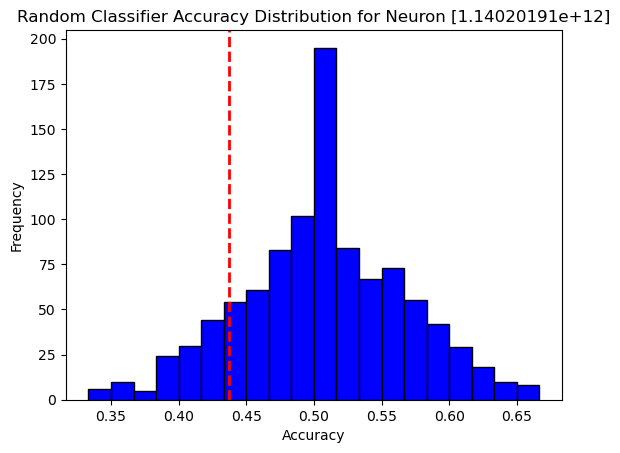


 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+12]: Test Accuracy = 46.88%, p-value = 0.8060


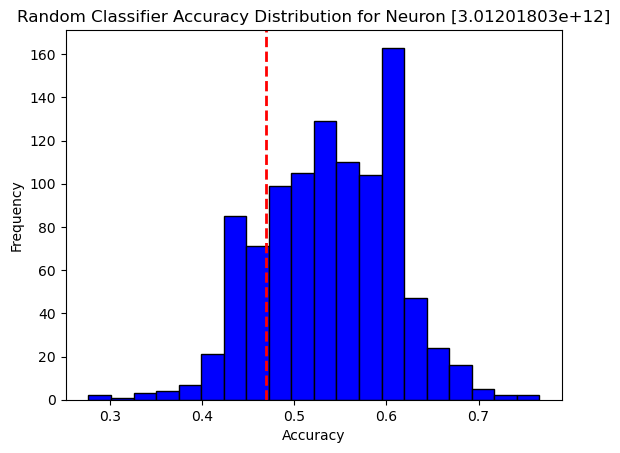


 [3.01201803e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 68.75%, p-value = 0.3910


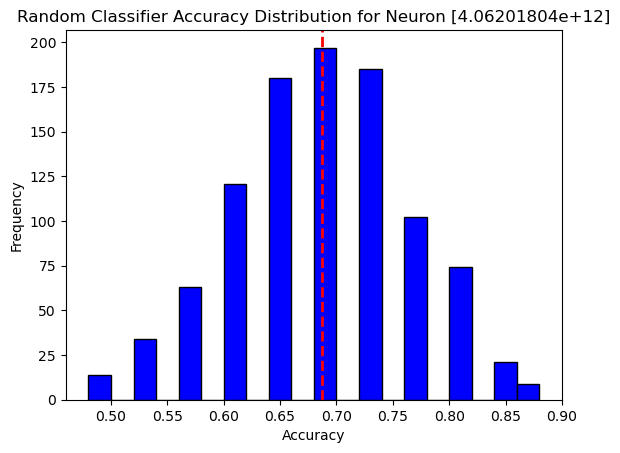


 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 75.00%, p-value = 0.2230


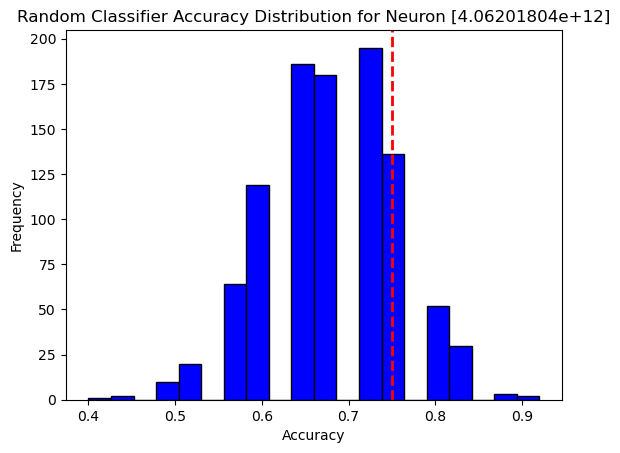


 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 12.50%, p-value = 1.0000


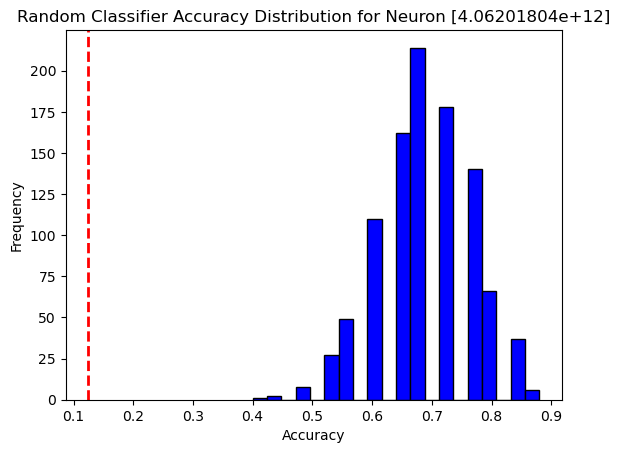


 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 18.75%, p-value = 1.0000


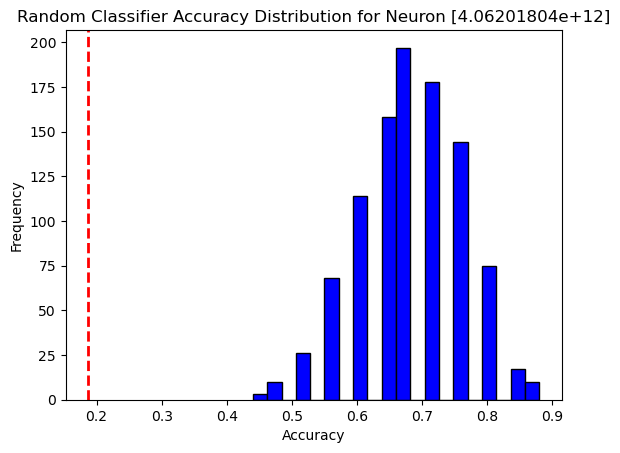


 [4.06201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201804e+12]: Test Accuracy = 31.25%, p-value = 1.0000


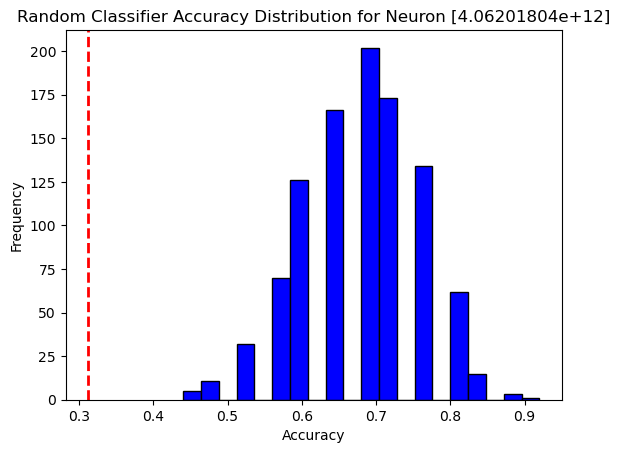


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 67.50%, p-value = 0.7350


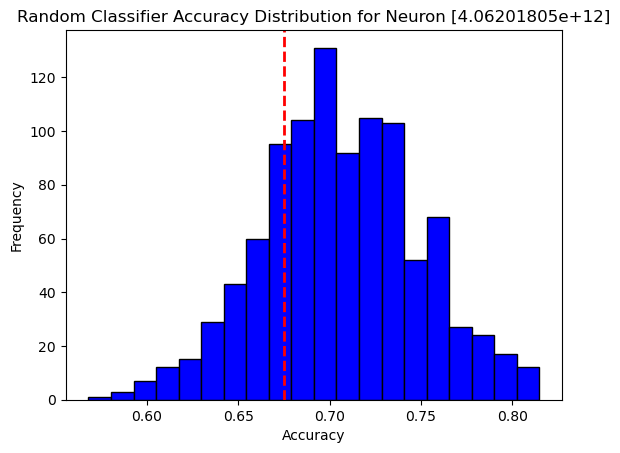


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 60.00%, p-value = 0.9910


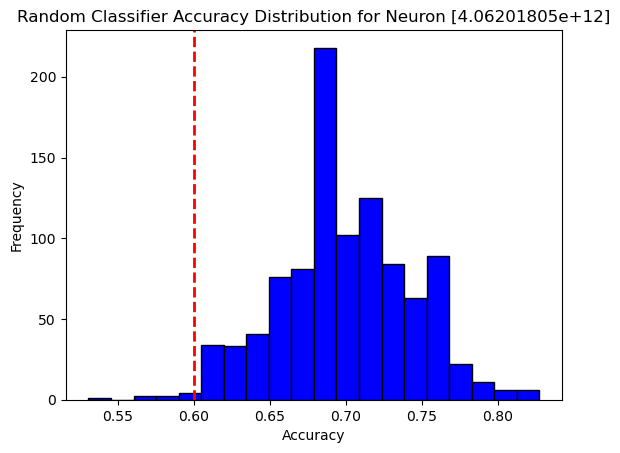


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 67.50%, p-value = 0.7110


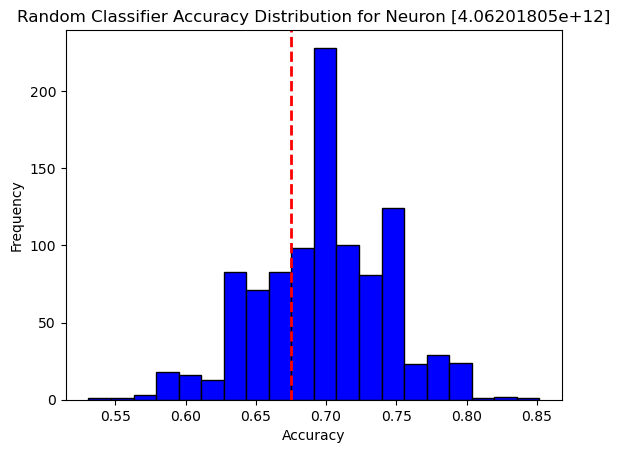


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 70.00%, p-value = 0.5180


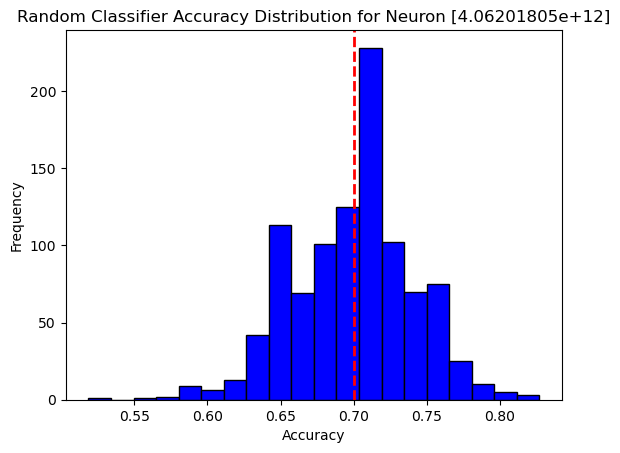


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 56.25%, p-value = 0.9990


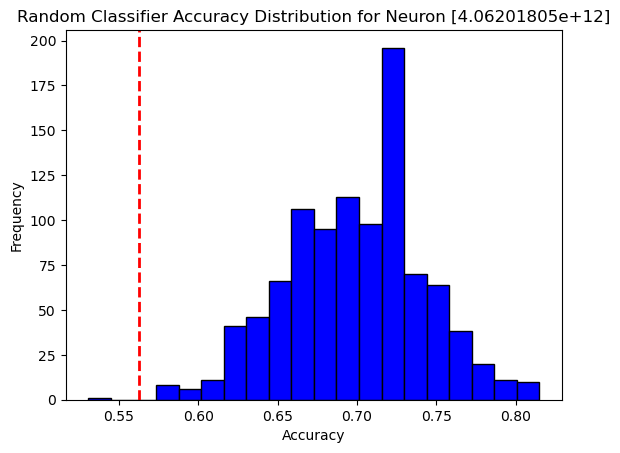


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 55.00%, p-value = 0.9980


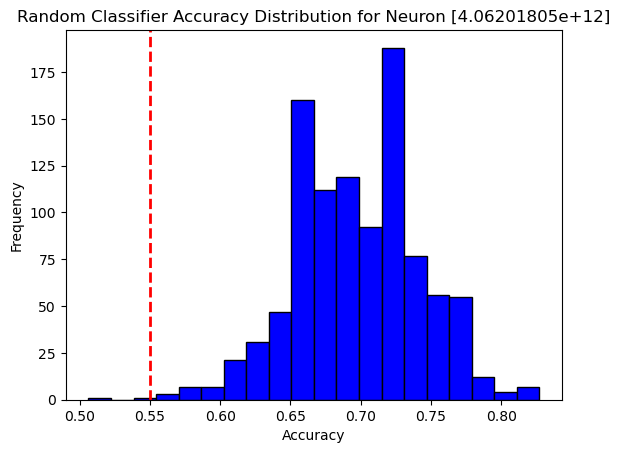


 [4.06201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+12]: Test Accuracy = 30.00%, p-value = 1.0000


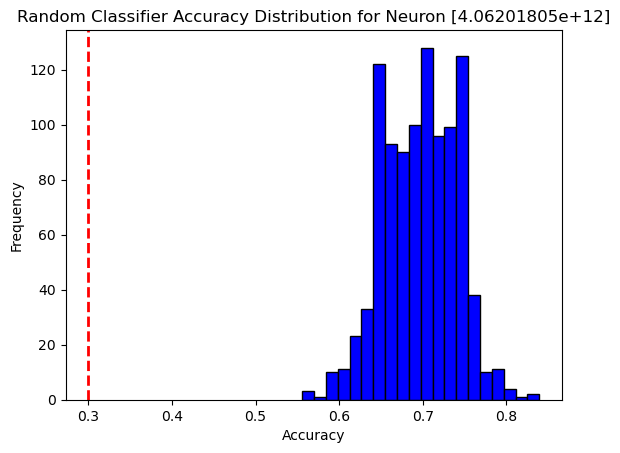


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 56.25%, p-value = 0.2230


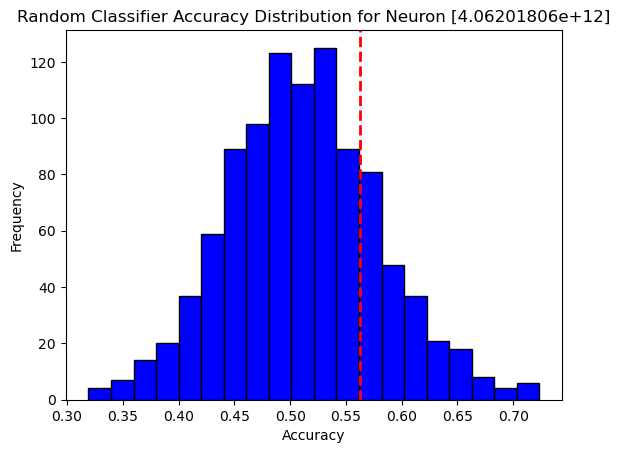


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 62.50%, p-value = 0.0400


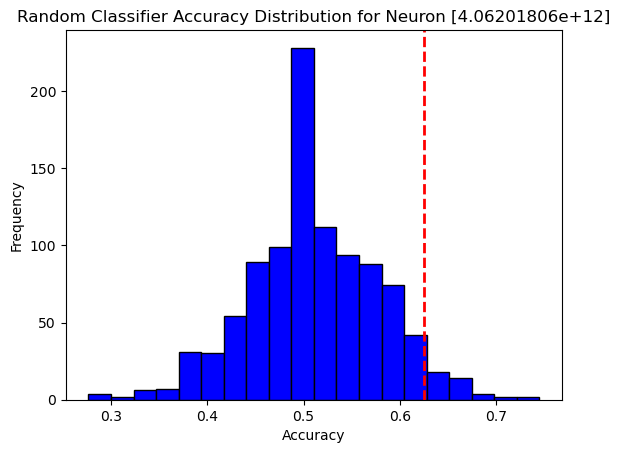


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 59.38%, p-value = 0.1560


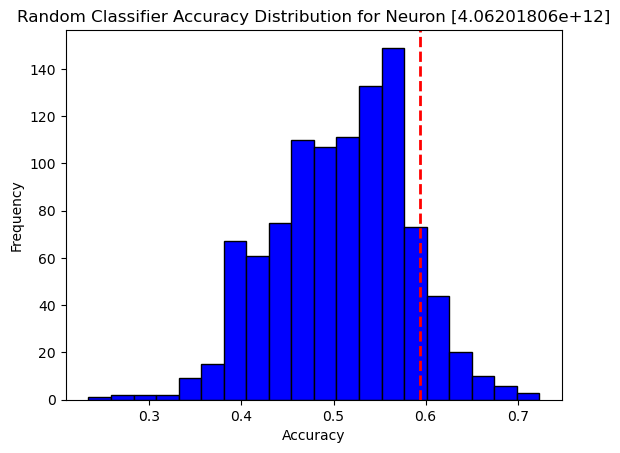


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 59.38%, p-value = 0.1580


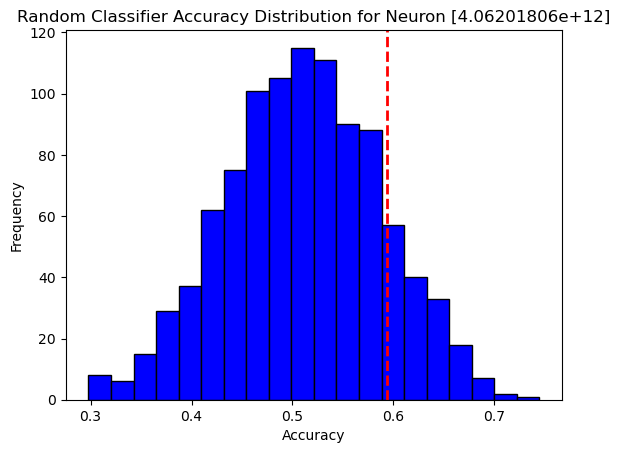


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 53.12%, p-value = 0.4480


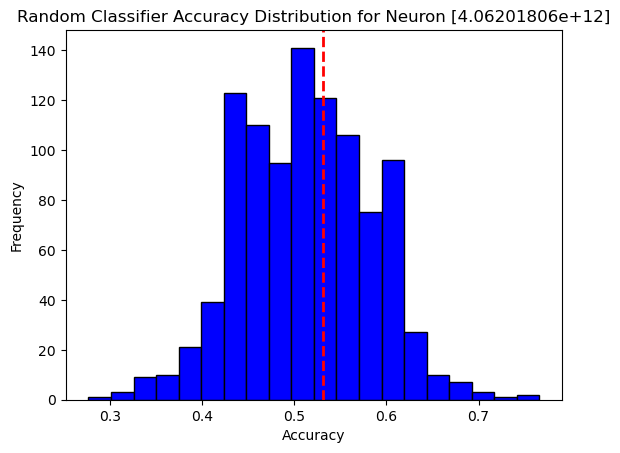


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 43.75%, p-value = 0.8380


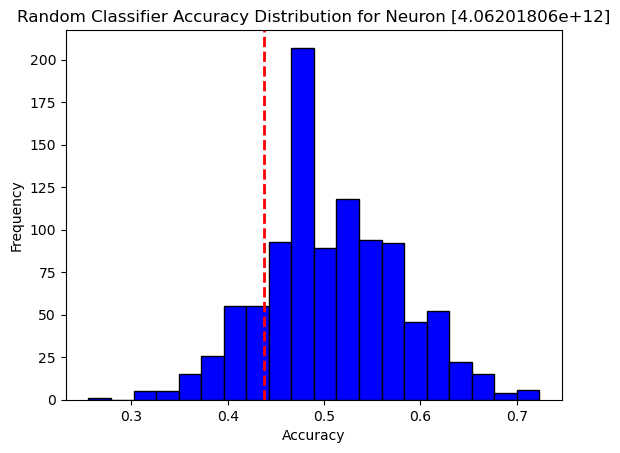


 [4.06201806e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+12]: Test Accuracy = 40.62%, p-value = 0.8980


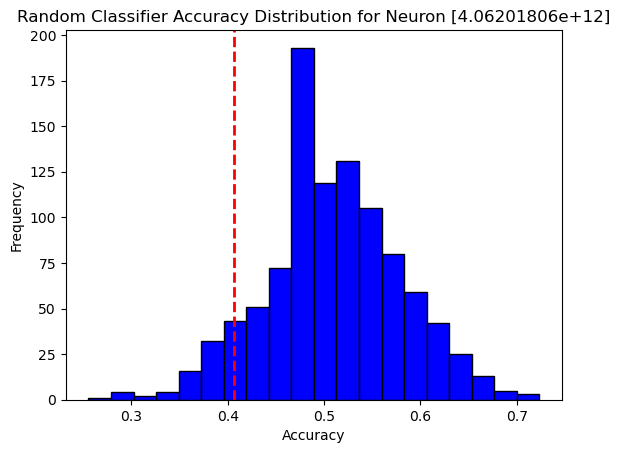


 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 59.38%, p-value = 0.9900


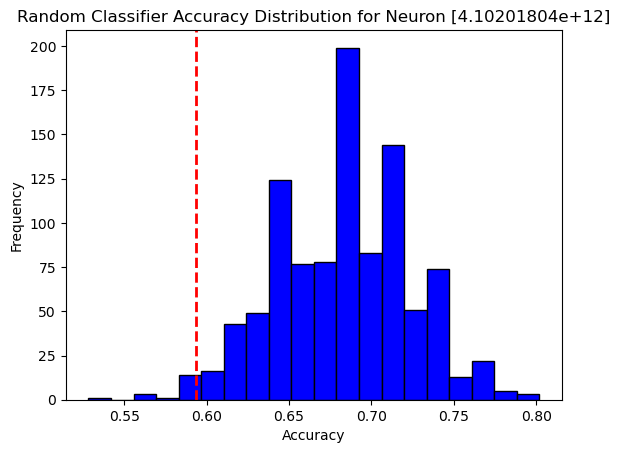


 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 62.50%, p-value = 0.9200


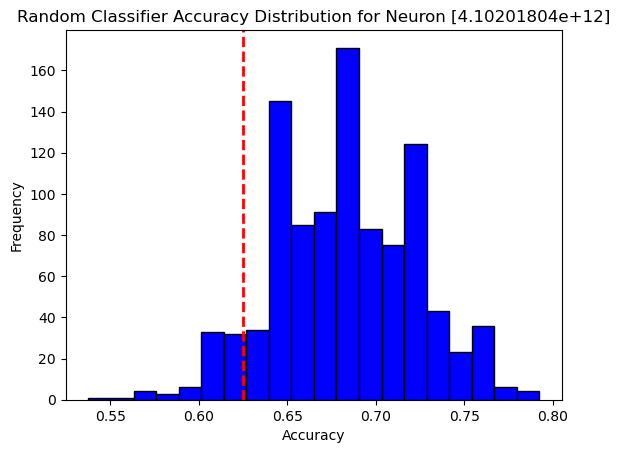


 [4.10201804e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+12]: Test Accuracy = 60.42%, p-value = 0.9680


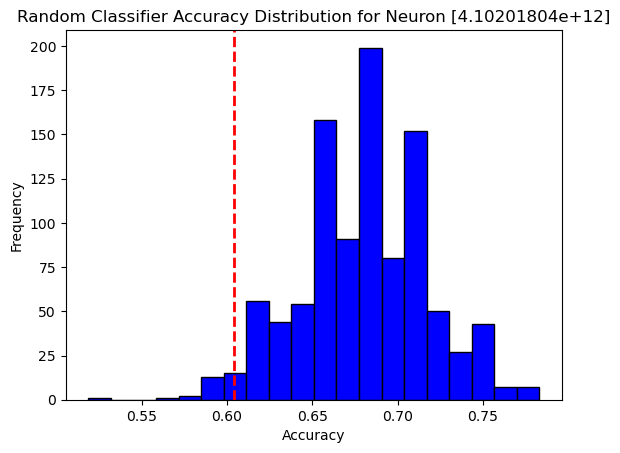


 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 33.75%, p-value = 1.0000


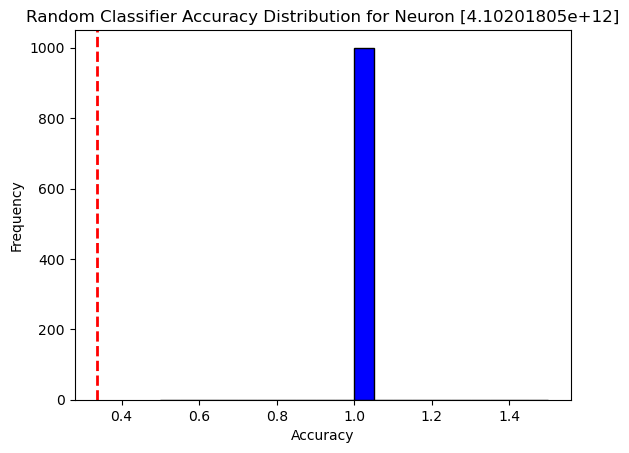


 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 78.75%, p-value = 1.0000


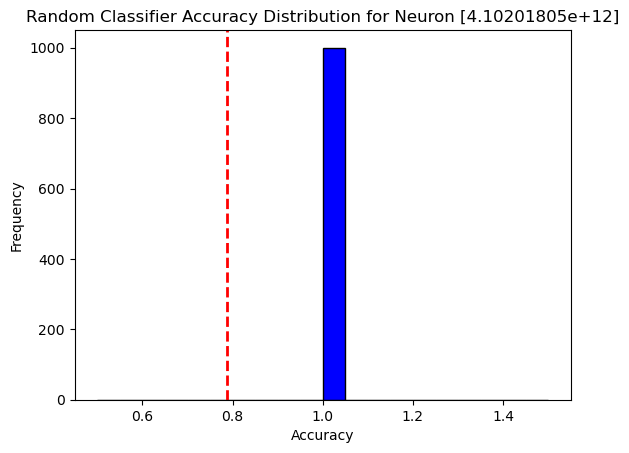


 [4.10201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+12]: Test Accuracy = 77.50%, p-value = 1.0000


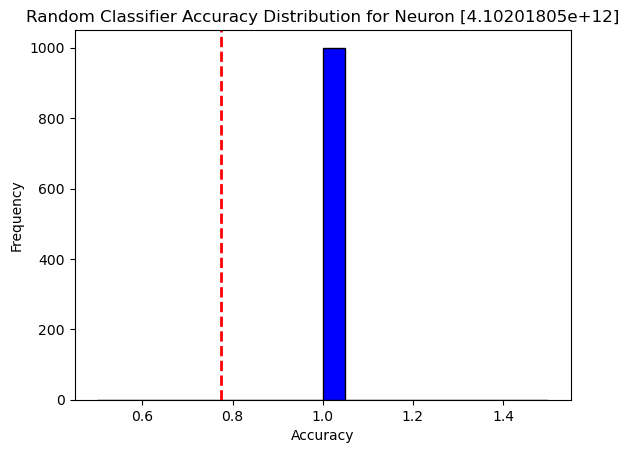


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 42.50%, p-value = 1.0000


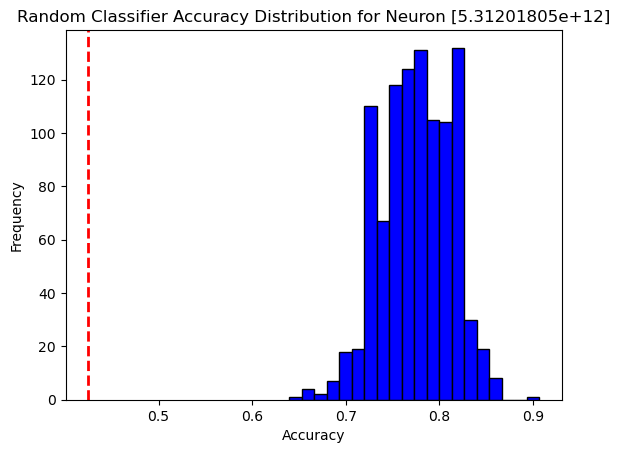


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 31.25%, p-value = 1.0000


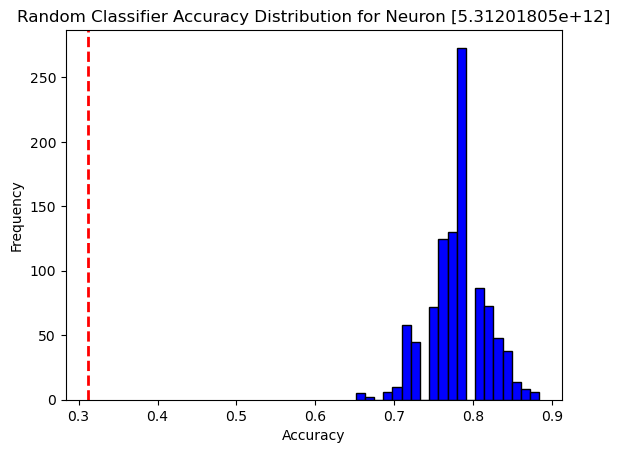


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.00%, p-value = 1.0000


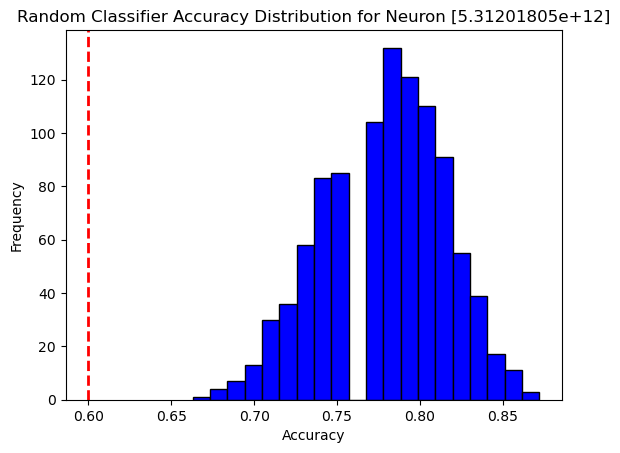


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 46.25%, p-value = 1.0000


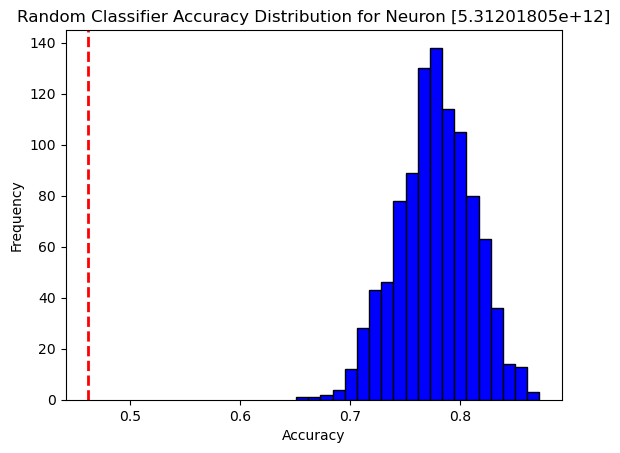


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 47.50%, p-value = 1.0000


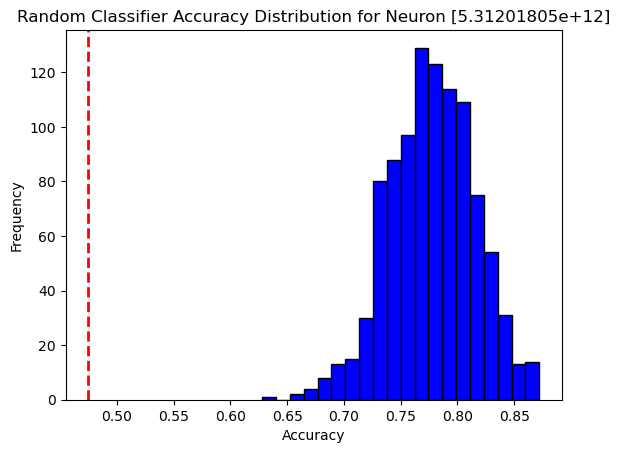


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 66.25%, p-value = 1.0000


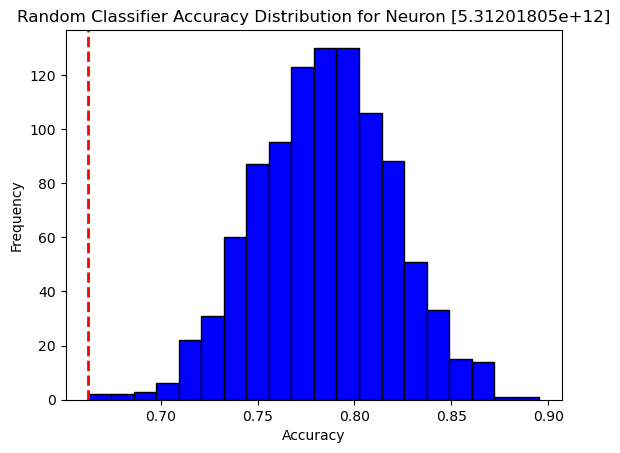


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 47.50%, p-value = 1.0000


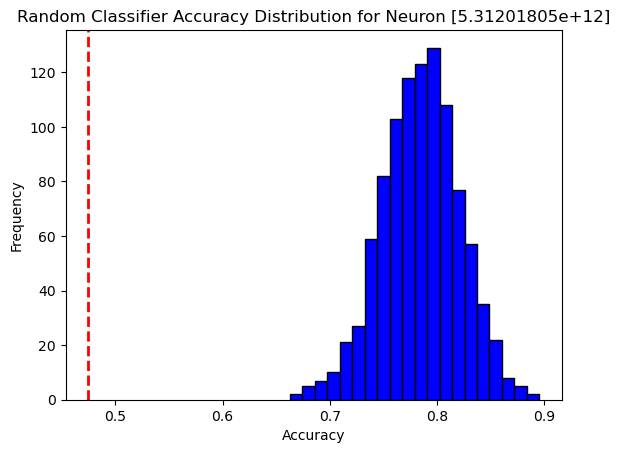


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 55.00%, p-value = 1.0000


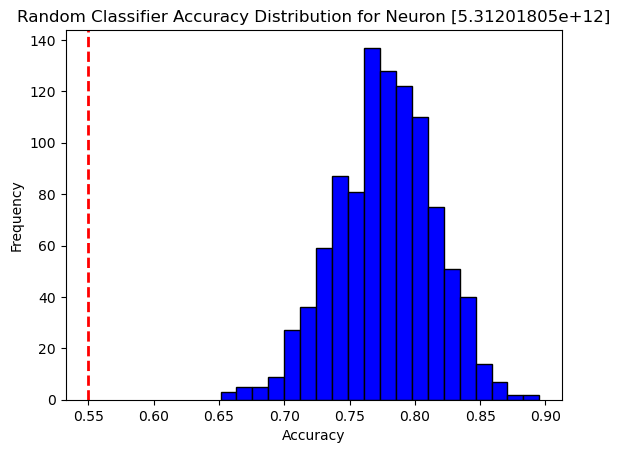


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 68.75%, p-value = 0.9880


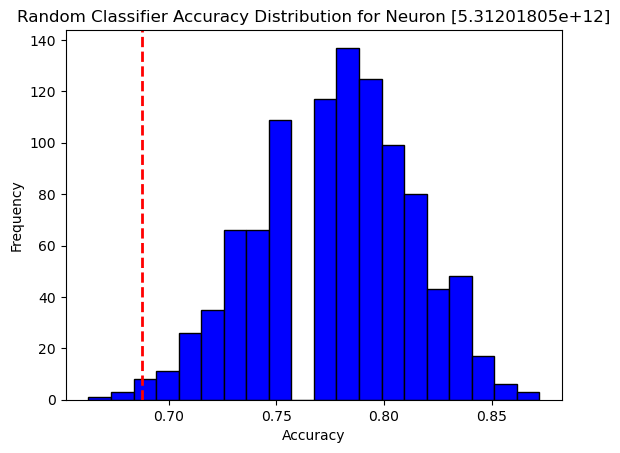


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 63.75%, p-value = 1.0000


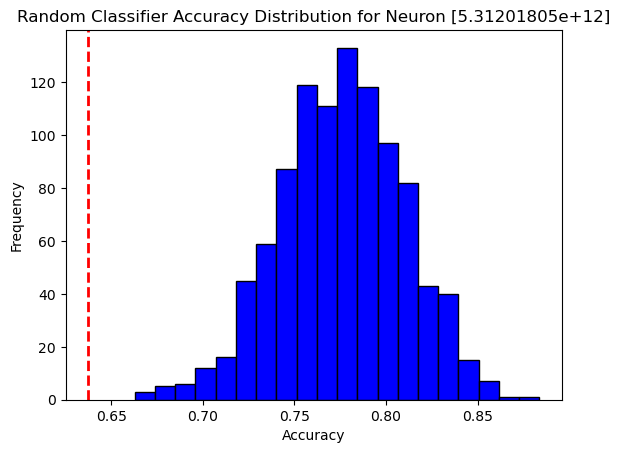


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 61.25%, p-value = 1.0000


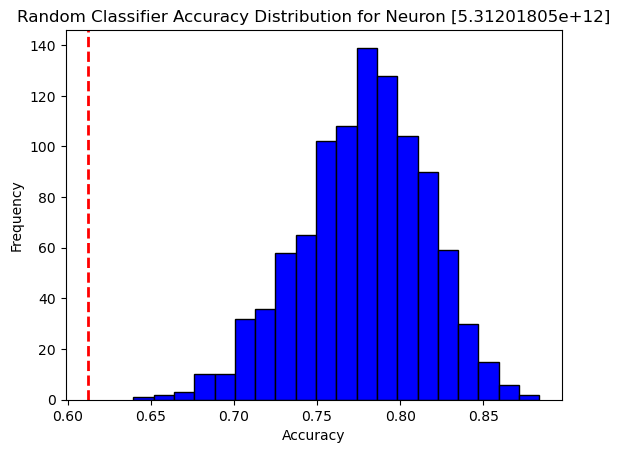


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 60.00%, p-value = 1.0000


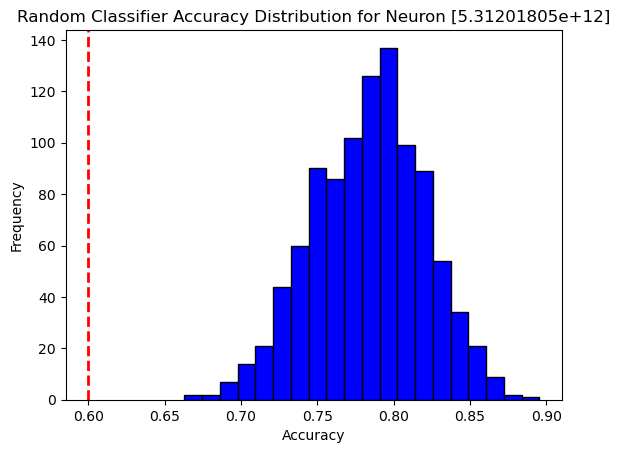


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 61.25%, p-value = 0.9990


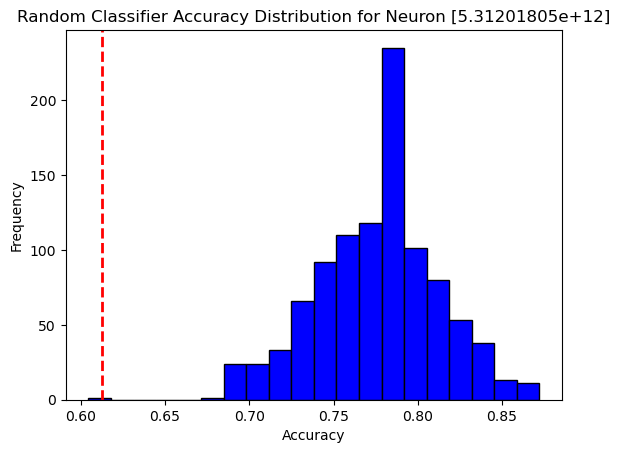


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 56.25%, p-value = 1.0000


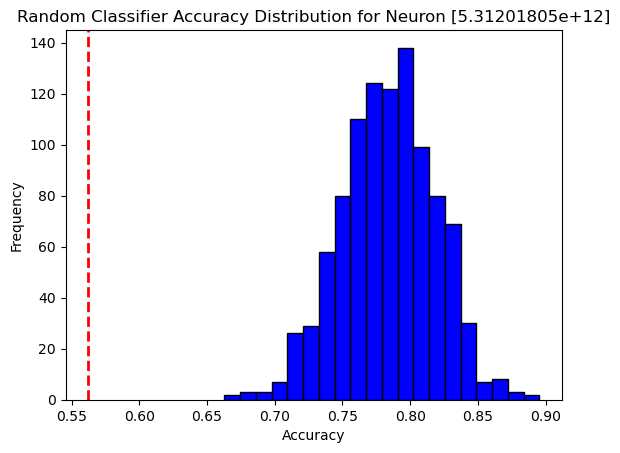


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 63.75%, p-value = 1.0000


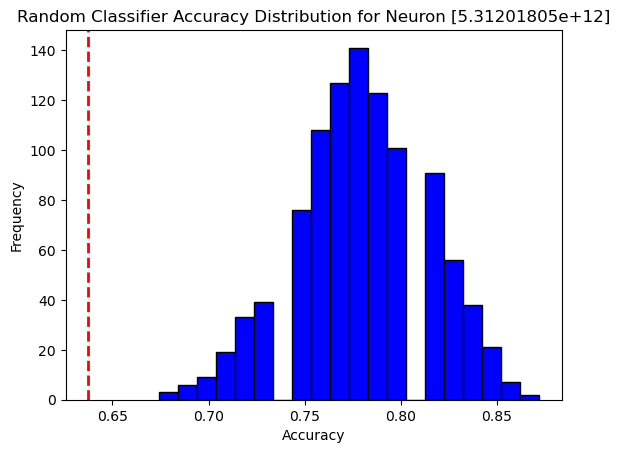


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 48.96%, p-value = 1.0000


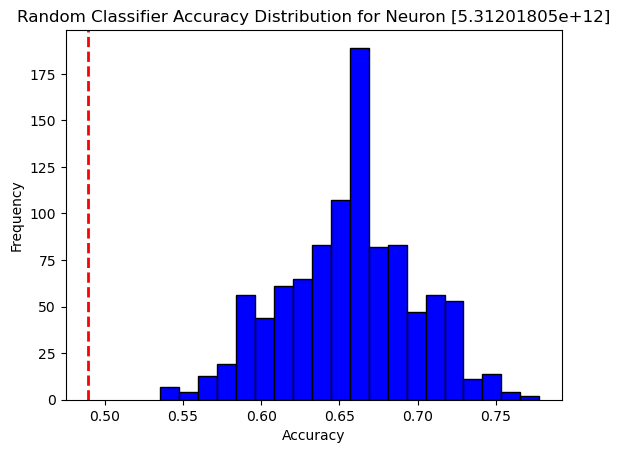


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 61.46%, p-value = 0.8480


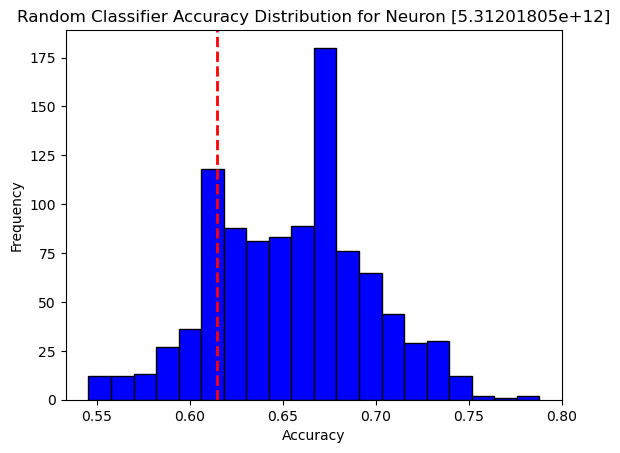


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 51.04%, p-value = 1.0000


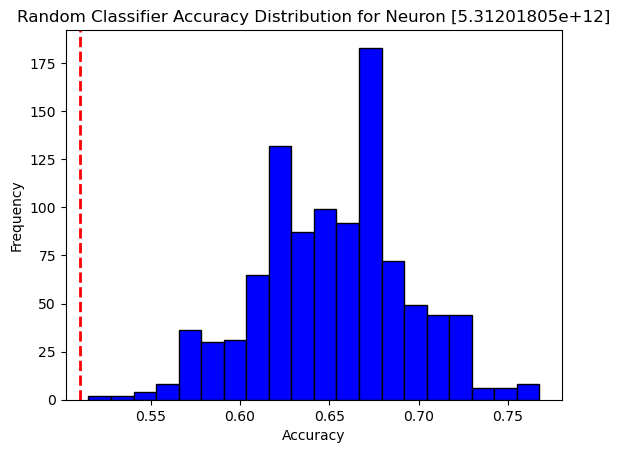


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 43.75%, p-value = 1.0000


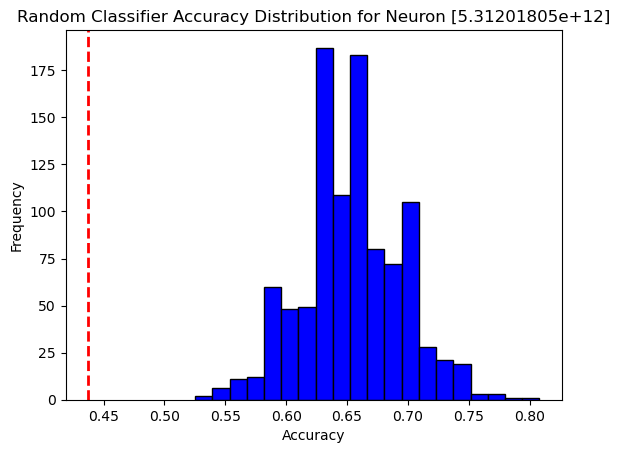


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 44.79%, p-value = 1.0000


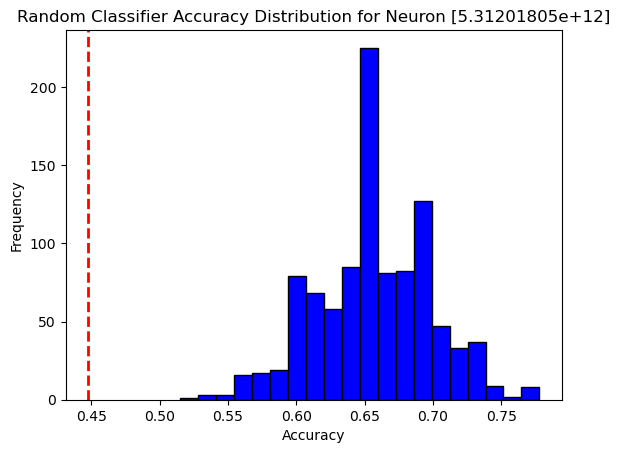


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 45.83%, p-value = 1.0000


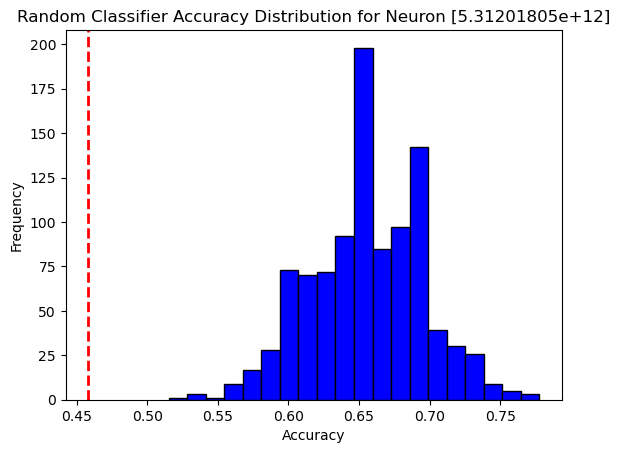


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 27.08%, p-value = 1.0000


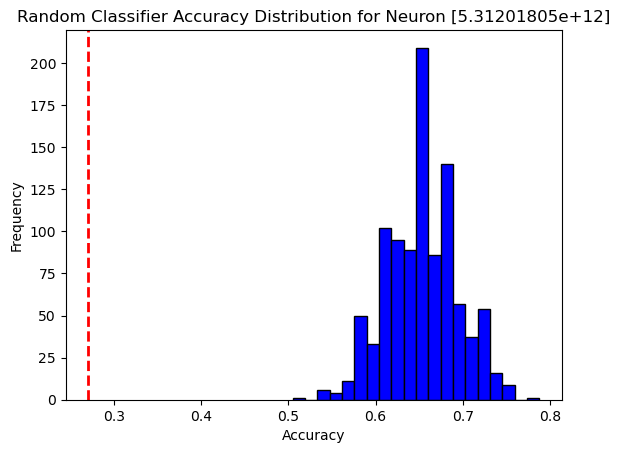


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 53.12%, p-value = 0.9990


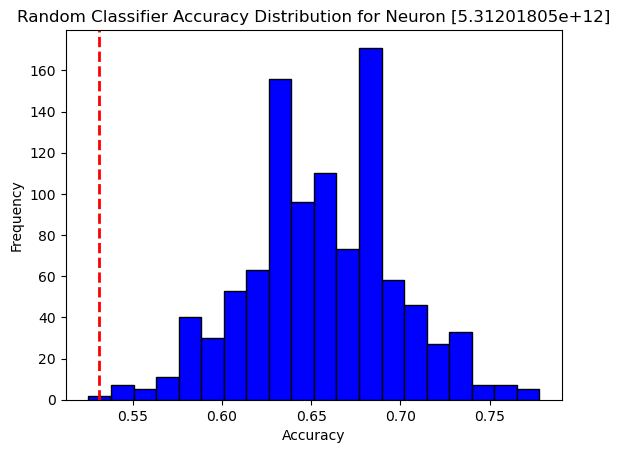


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 46.88%, p-value = 1.0000


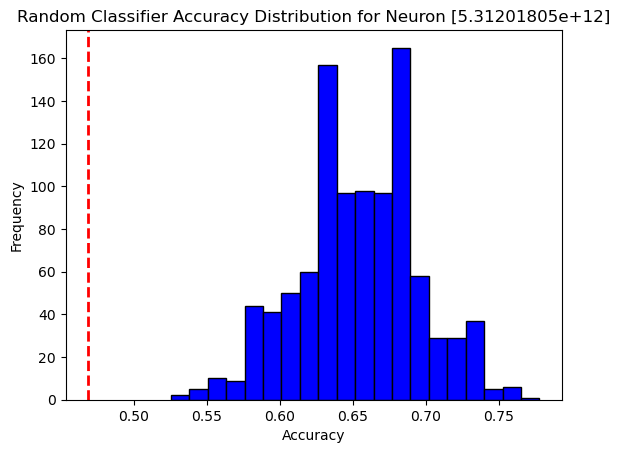


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 62.50%, p-value = 0.7810


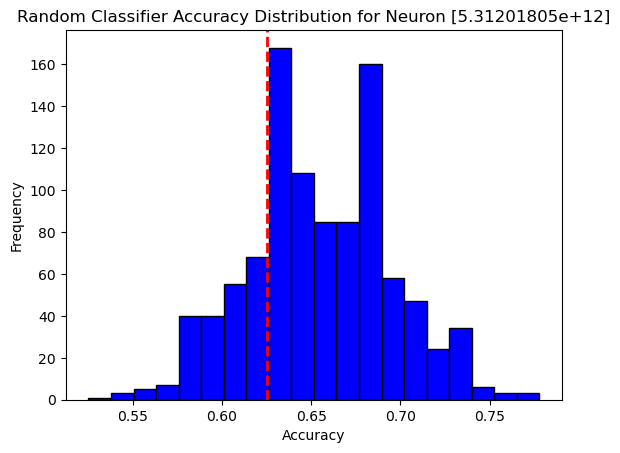


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 47.92%, p-value = 1.0000


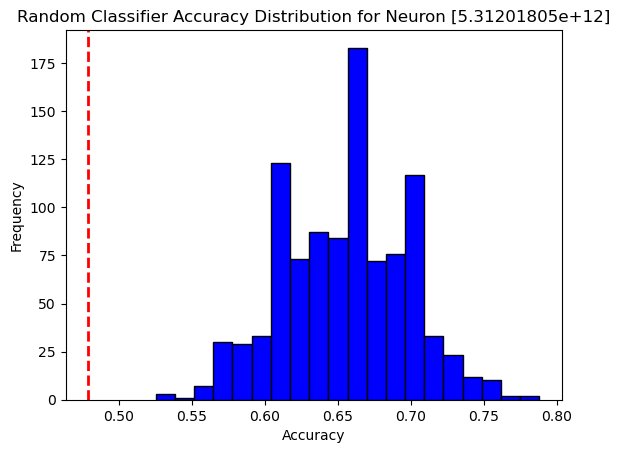


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 48.96%, p-value = 1.0000


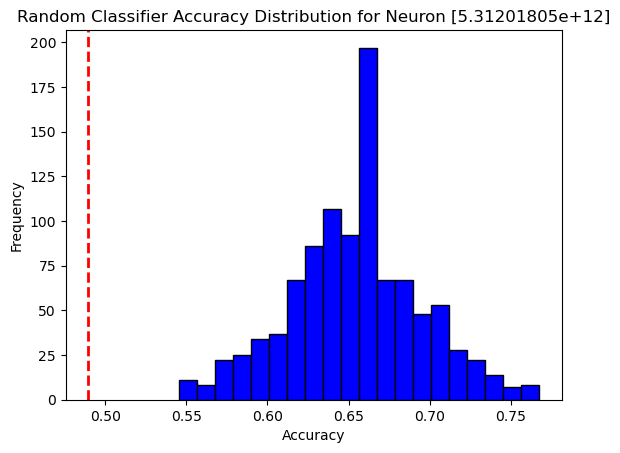


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 58.33%, p-value = 0.9580


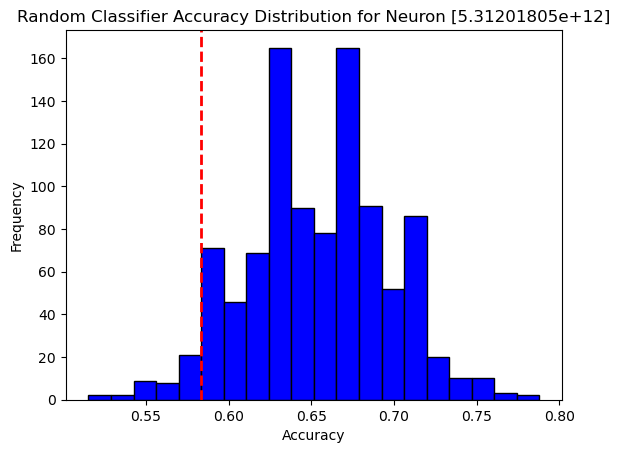


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 63.54%, p-value = 0.7060


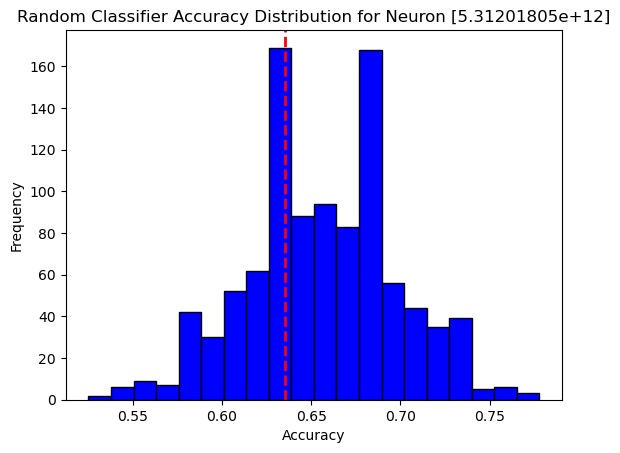


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 51.04%, p-value = 1.0000


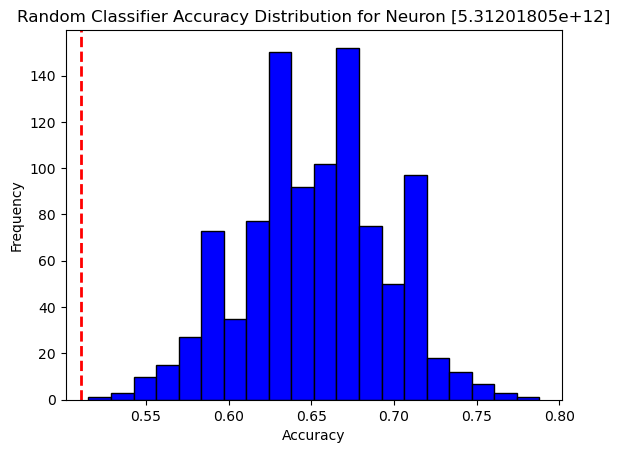


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 42.71%, p-value = 1.0000


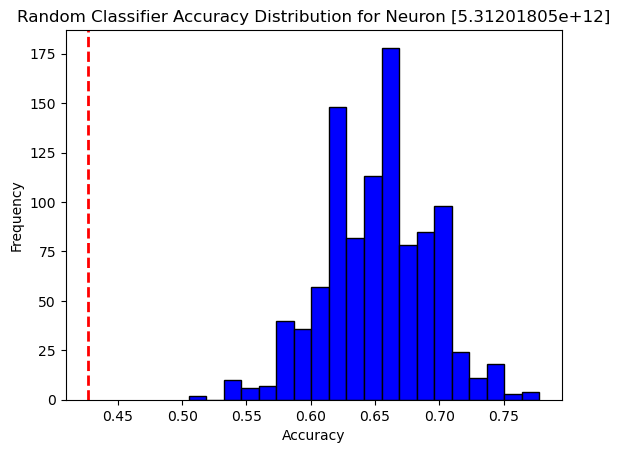


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 50.00%, p-value = 1.0000


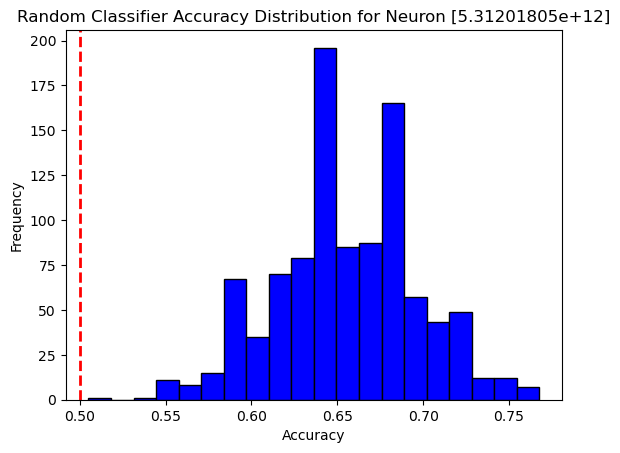


 [5.31201805e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.31201805e+12]: Test Accuracy = 45.83%, p-value = 1.0000


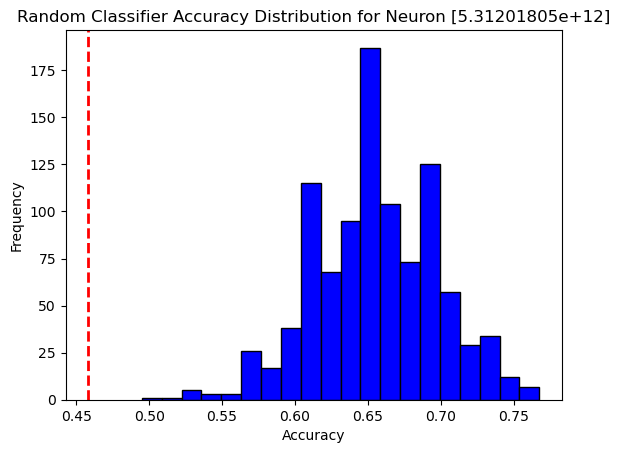


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 52.08%, p-value = 1.0000


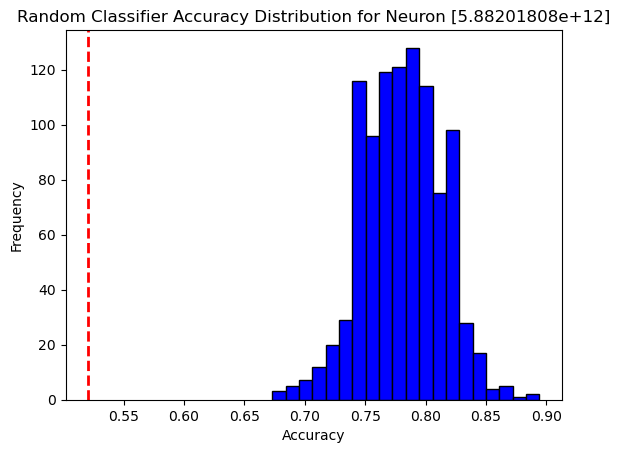


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 61.46%, p-value = 1.0000


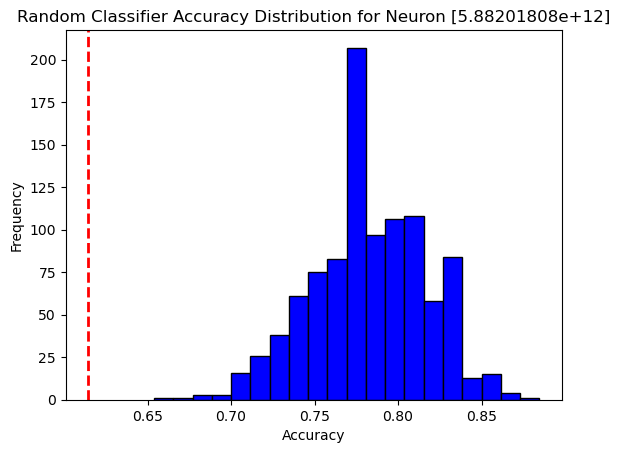


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 57.29%, p-value = 1.0000


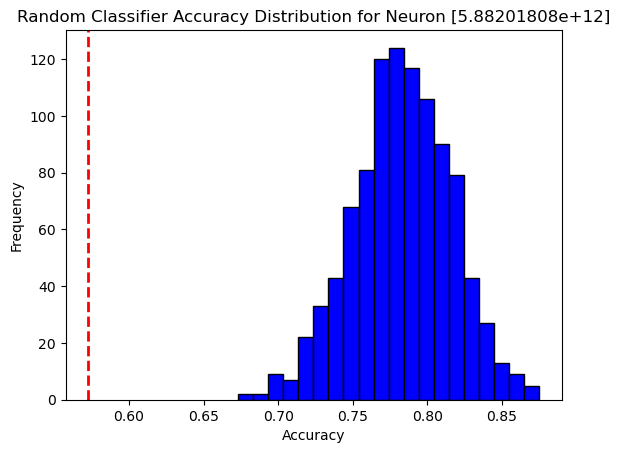


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 42.71%, p-value = 1.0000


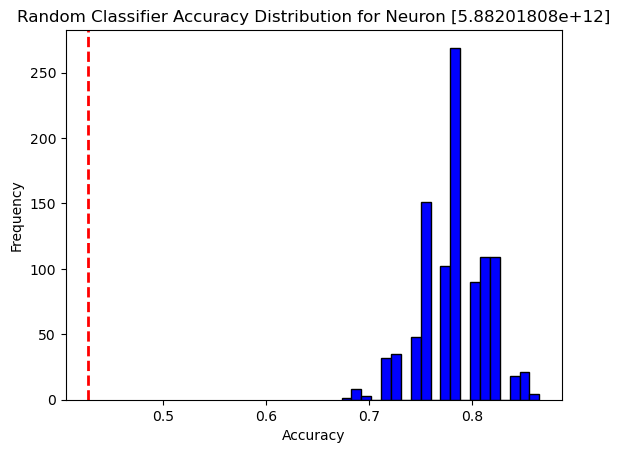


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 53.12%, p-value = 1.0000


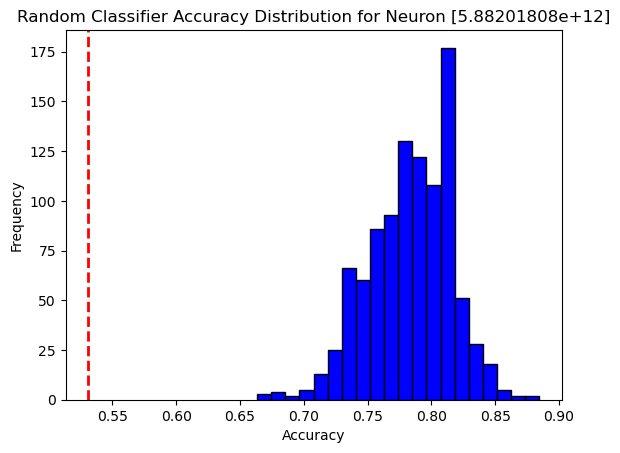


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 52.08%, p-value = 1.0000


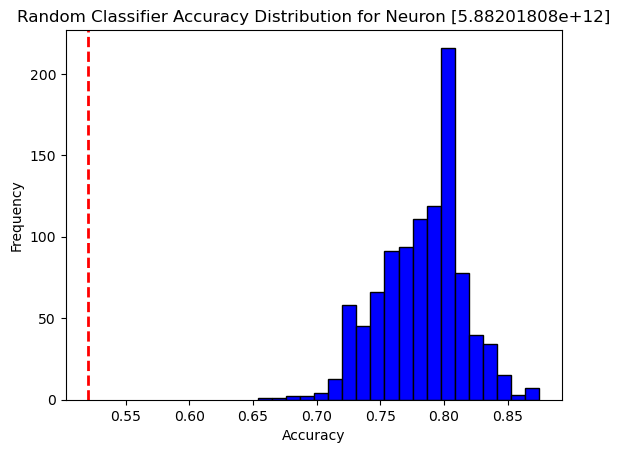


 [5.88201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201808e+12]: Test Accuracy = 60.16%, p-value = 1.0000


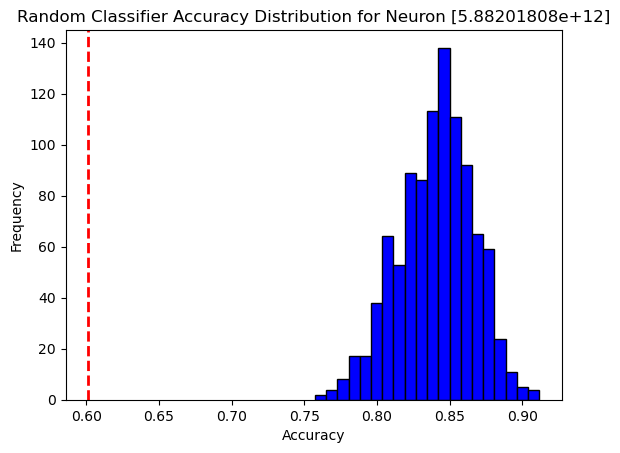


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 51.04%, p-value = 1.0000


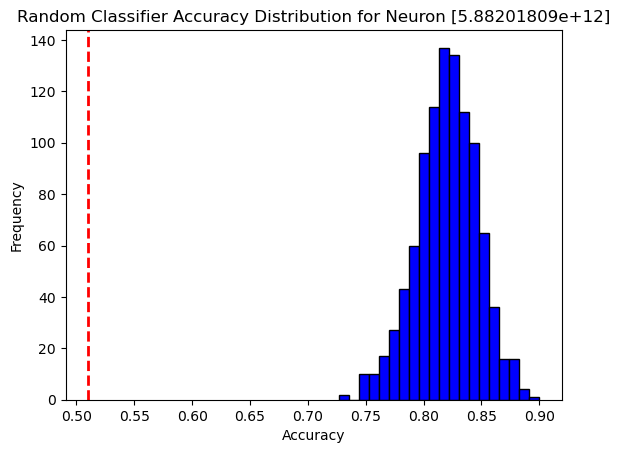


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 43.75%, p-value = 1.0000


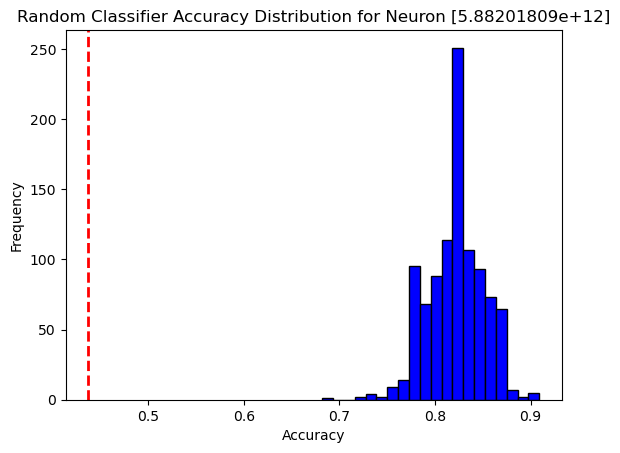


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 11.46%, p-value = 1.0000


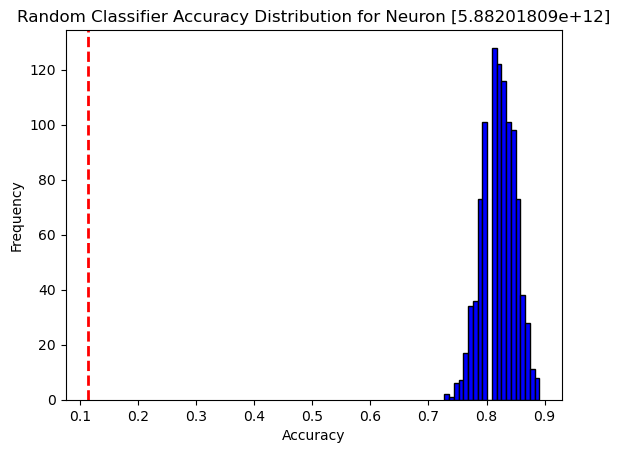


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.88%, p-value = 1.0000


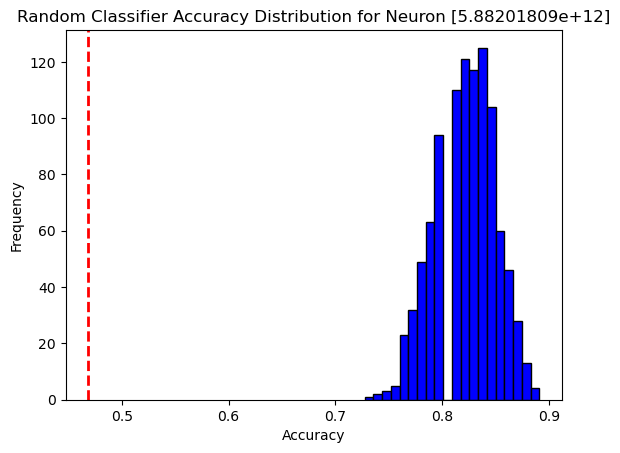


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 47.92%, p-value = 1.0000


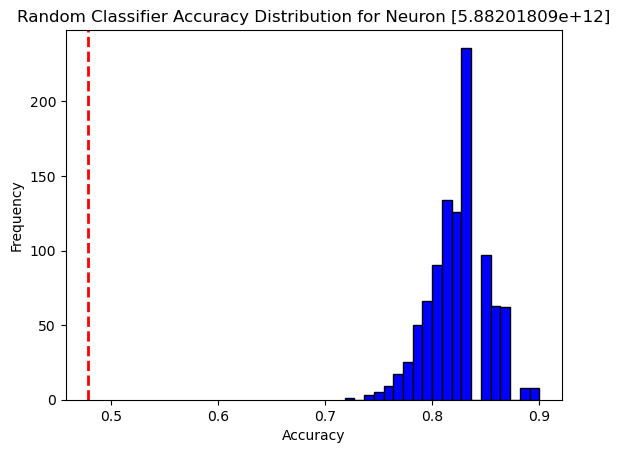


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 54.17%, p-value = 1.0000


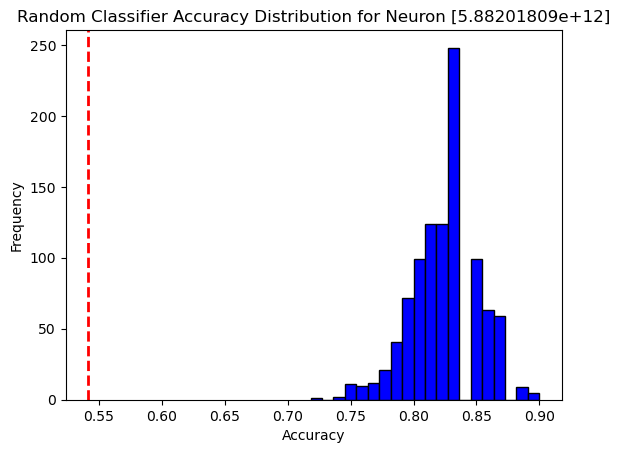


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 22.92%, p-value = 1.0000


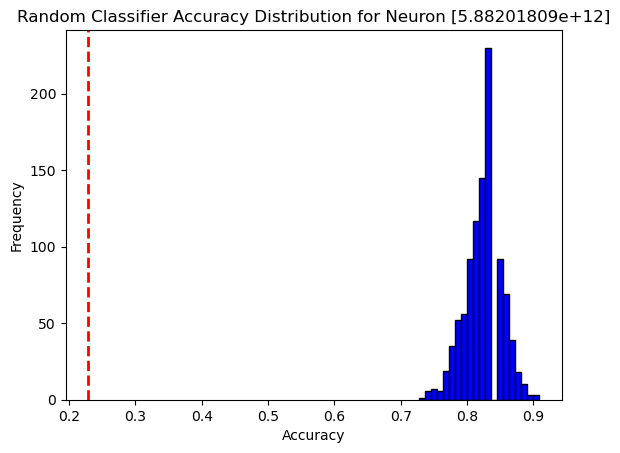


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 64.58%, p-value = 1.0000


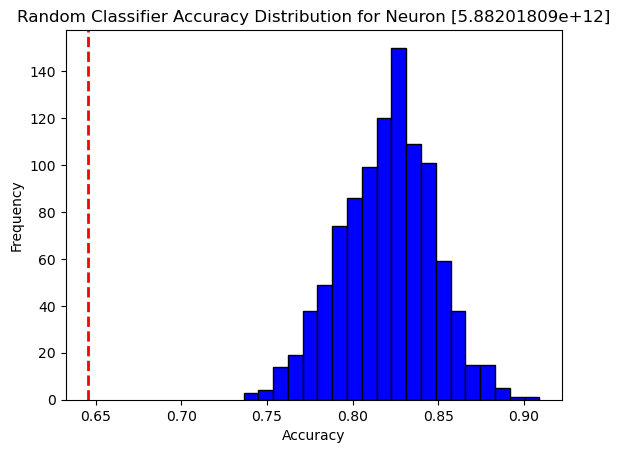


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 41.67%, p-value = 1.0000


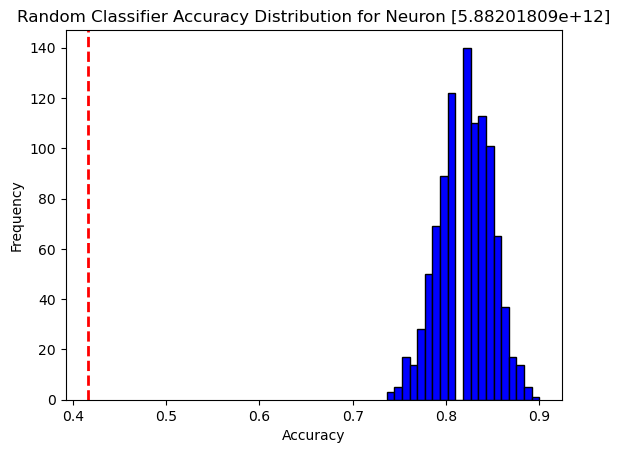


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 38.54%, p-value = 1.0000


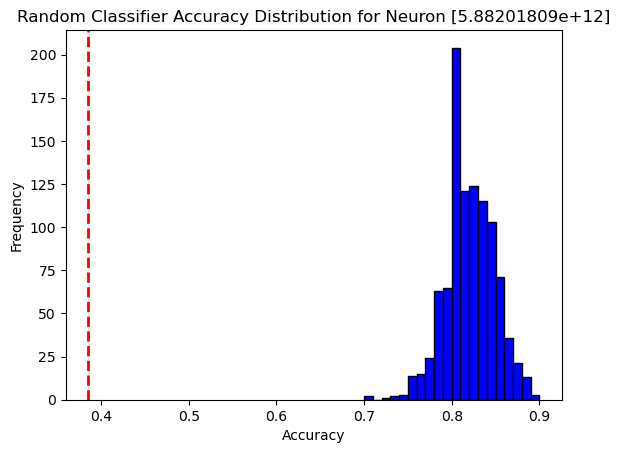


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 34.38%, p-value = 1.0000


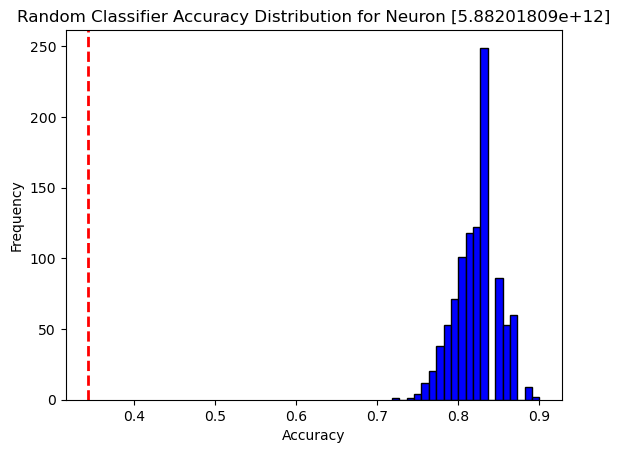


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 60.42%, p-value = 1.0000


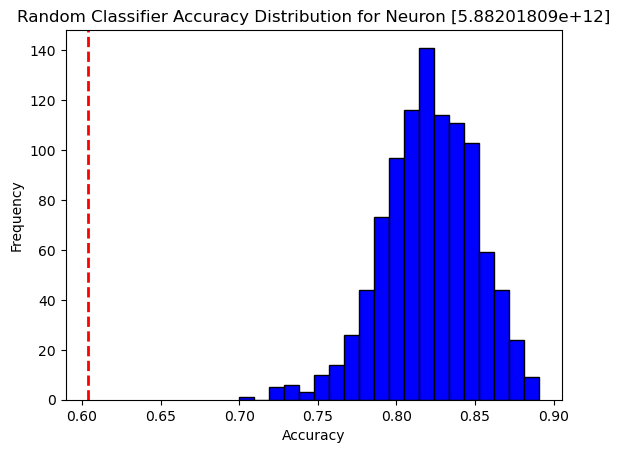


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 59.38%, p-value = 1.0000


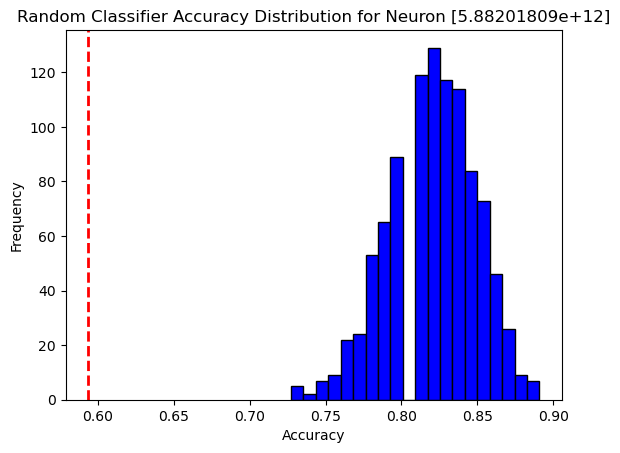


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 54.17%, p-value = 1.0000


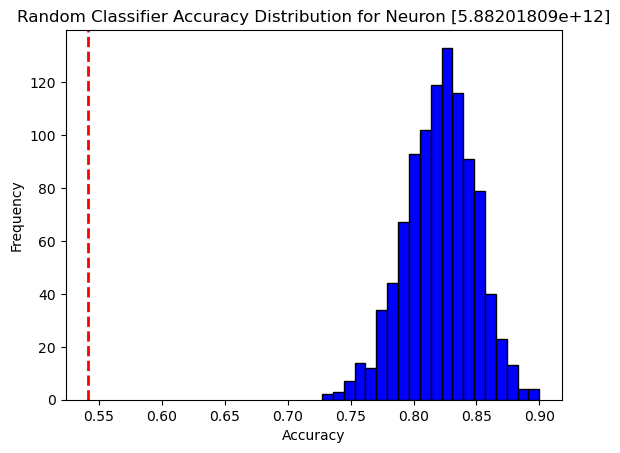


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 57.29%, p-value = 1.0000


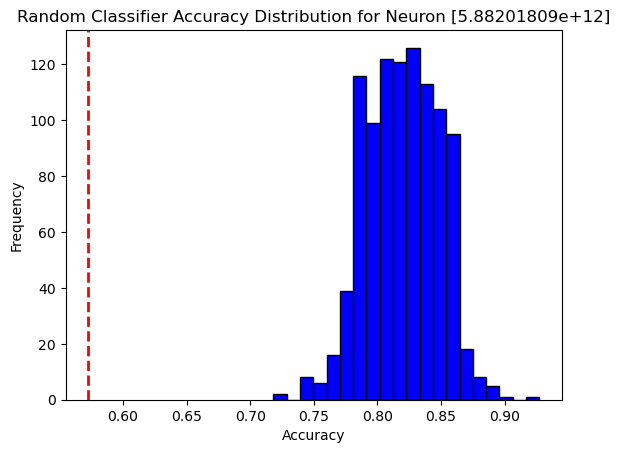


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 47.92%, p-value = 1.0000


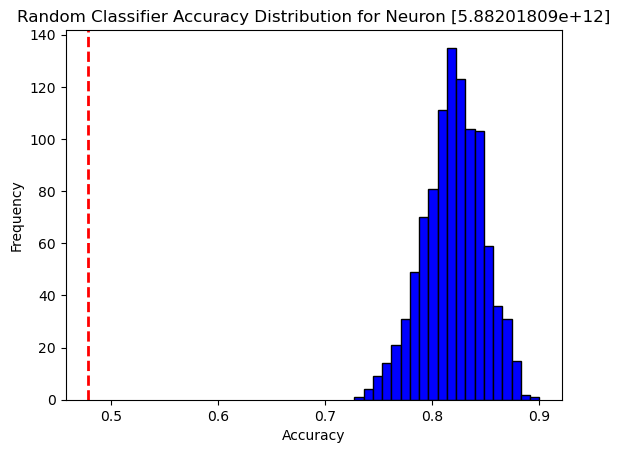


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 55.21%, p-value = 1.0000


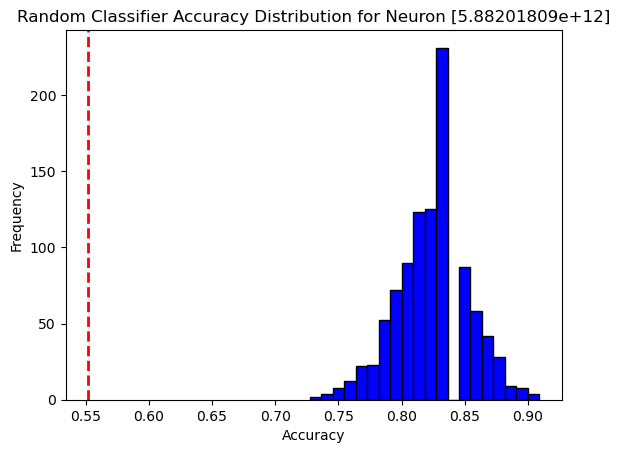


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 69.79%, p-value = 1.0000


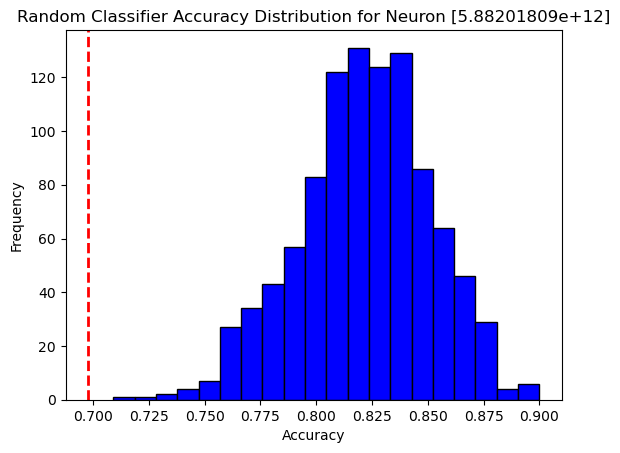


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 51.04%, p-value = 1.0000


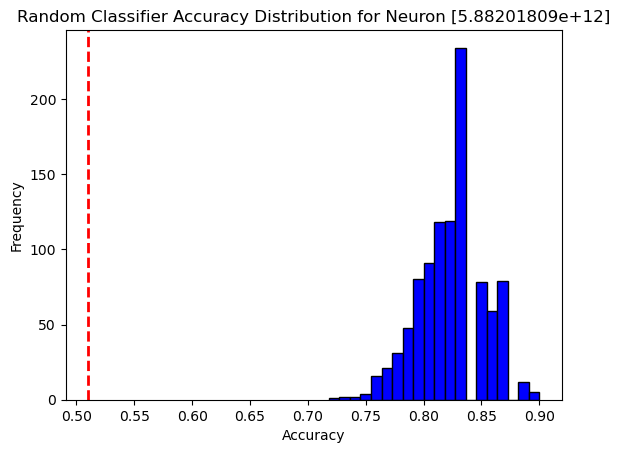


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 59.38%, p-value = 1.0000


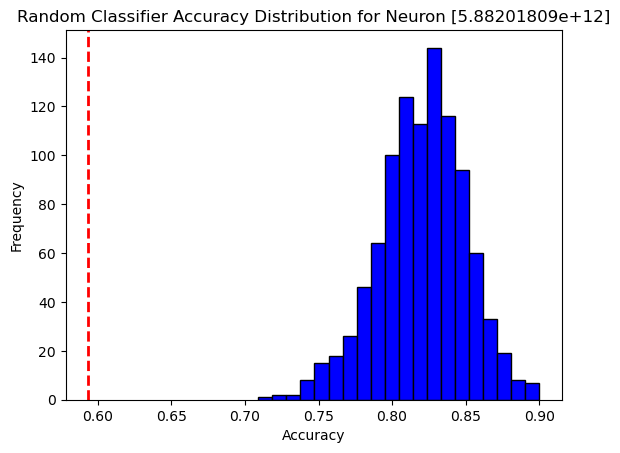


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 43.75%, p-value = 1.0000


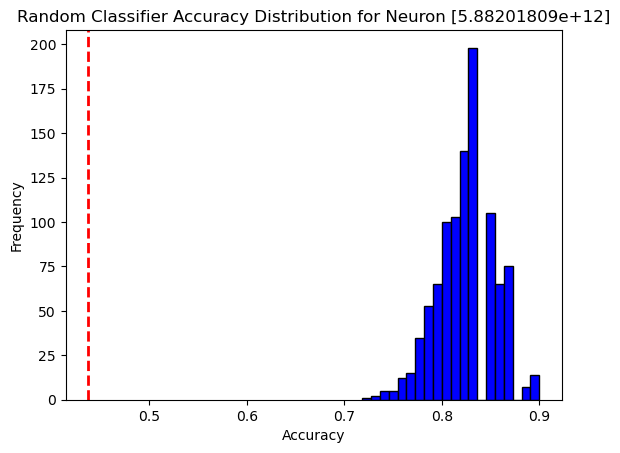


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.96%, p-value = 1.0000


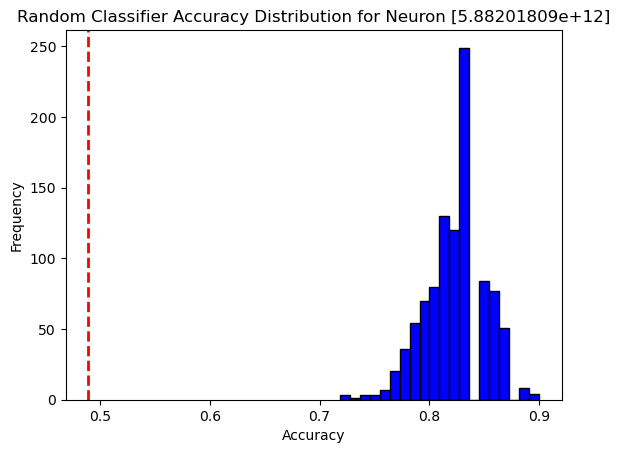


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 55.21%, p-value = 1.0000


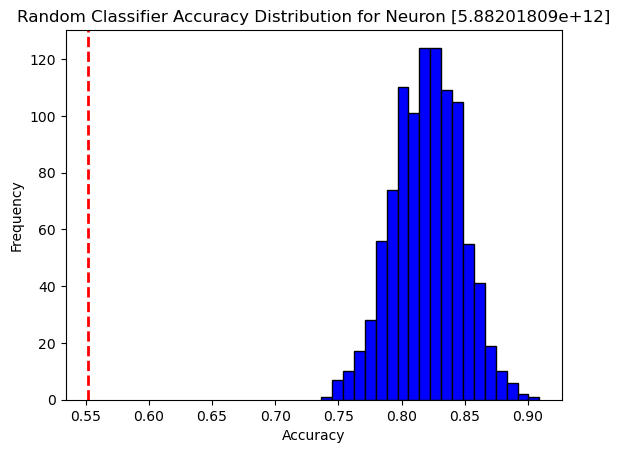


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 66.67%, p-value = 1.0000


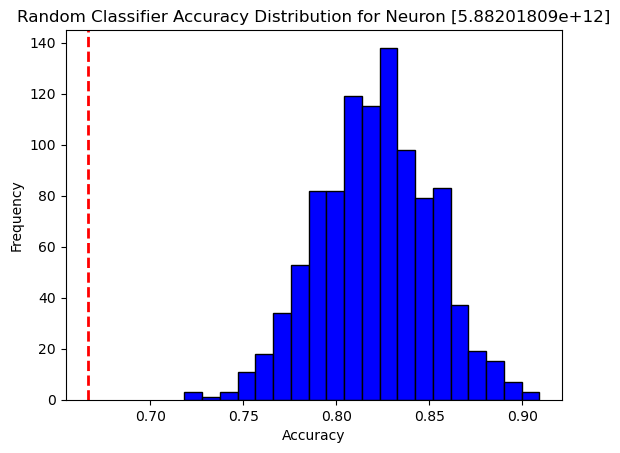


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 51.04%, p-value = 1.0000


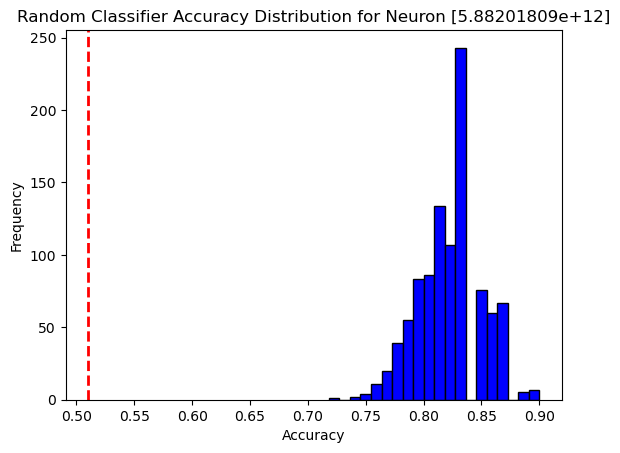


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 48.21%, p-value = 1.0000


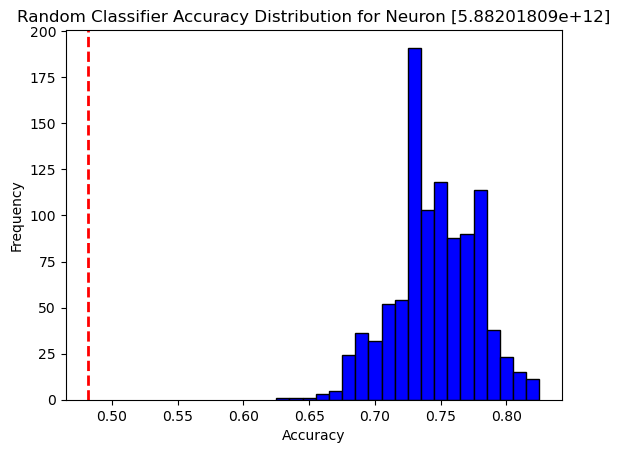


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 47.32%, p-value = 1.0000


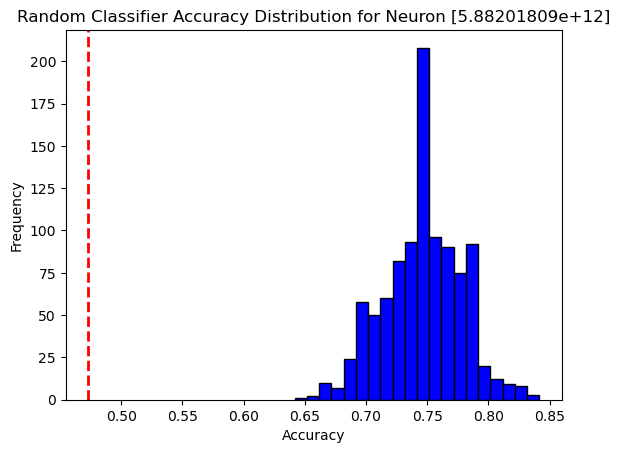


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.43%, p-value = 1.0000


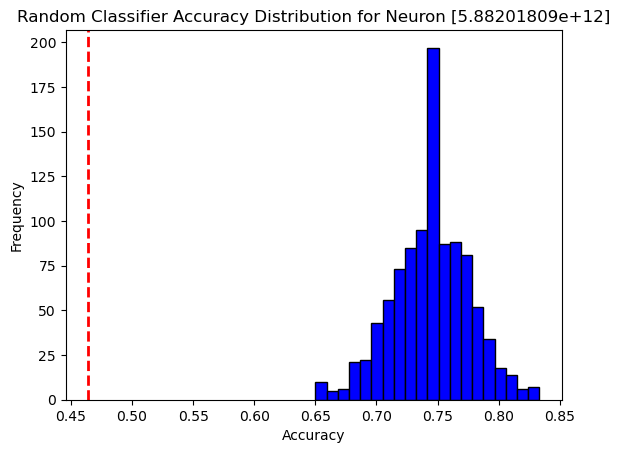


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 51.79%, p-value = 1.0000


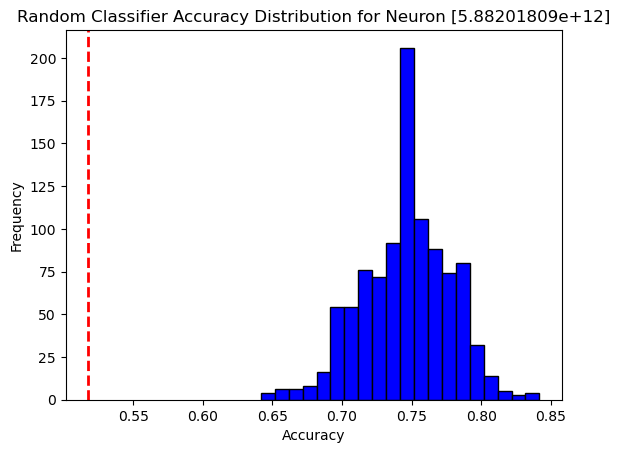


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 44.64%, p-value = 1.0000


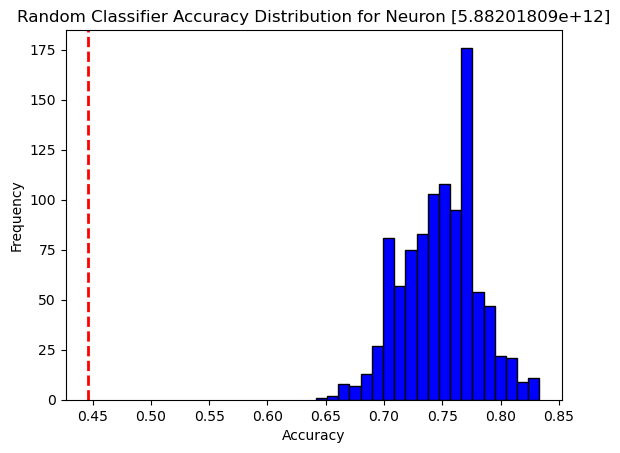


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 67.50%, p-value = 0.0040


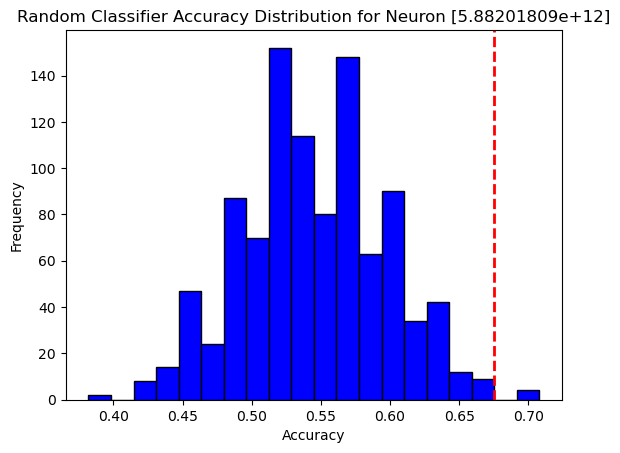


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 37.50%, p-value = 1.0000


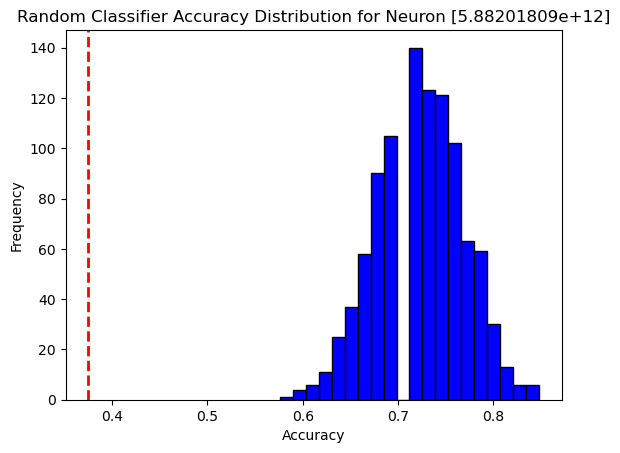


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 28.12%, p-value = 1.0000


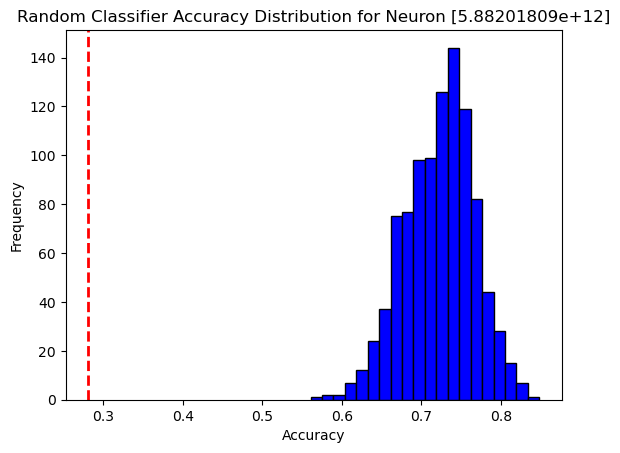


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 46.88%, p-value = 0.9730


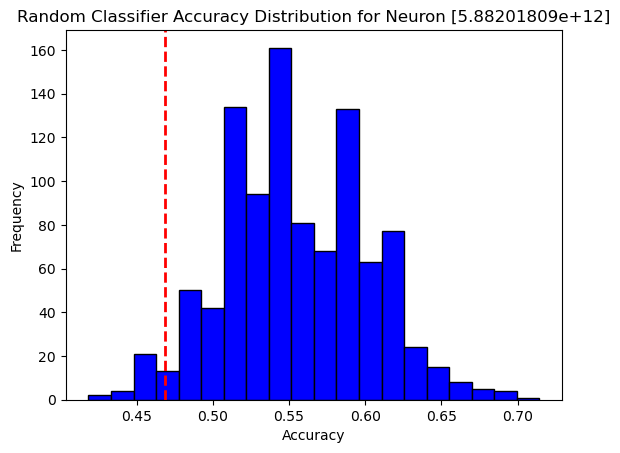


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 55.21%, p-value = 0.4710


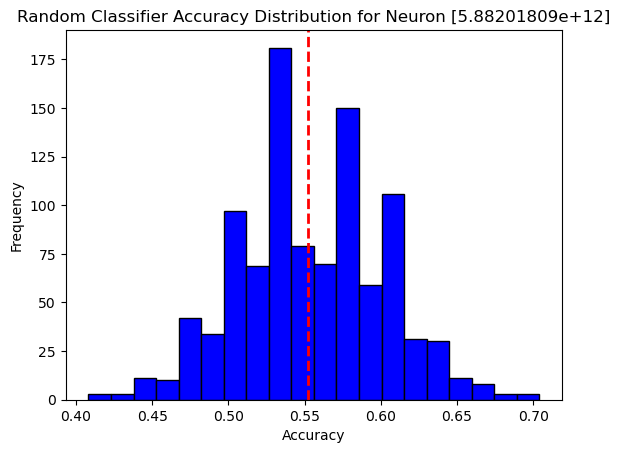


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 67.71%, p-value = 0.0010


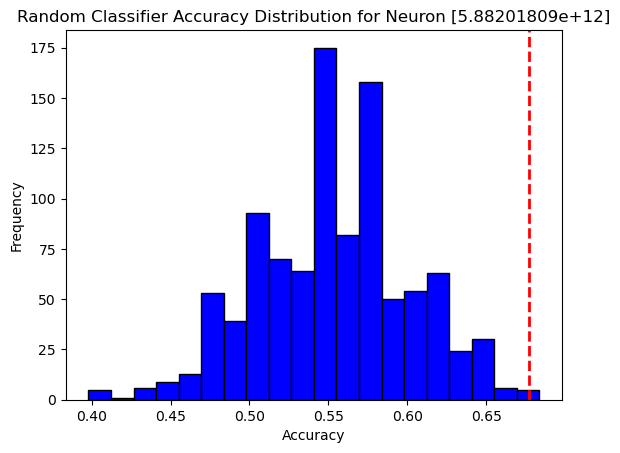


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 47.92%, p-value = 0.9550


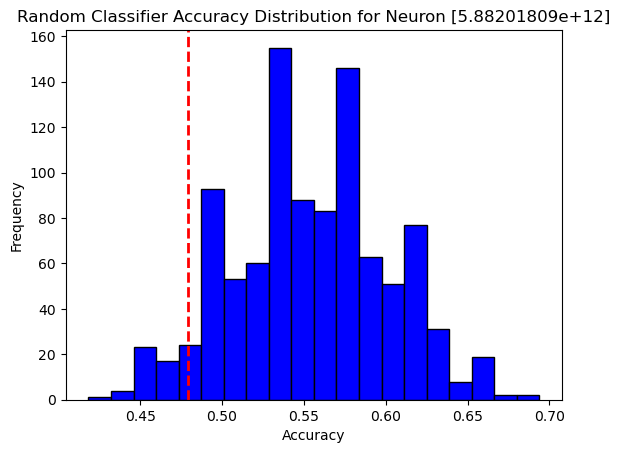


 [5.88201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.88201809e+12]: Test Accuracy = 58.33%, p-value = 0.2490


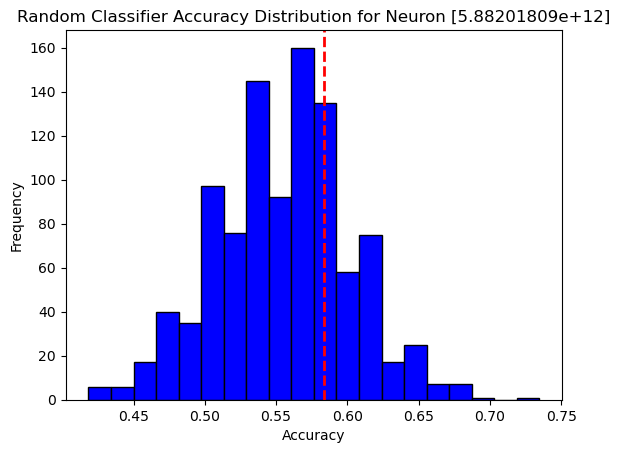


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 27.50%, p-value = 1.0000


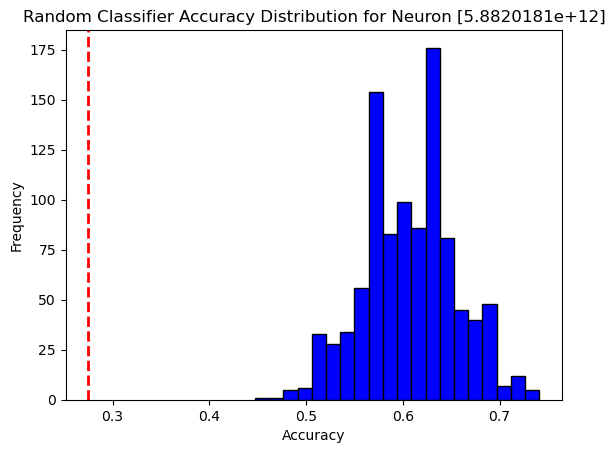


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 47.50%, p-value = 0.9950


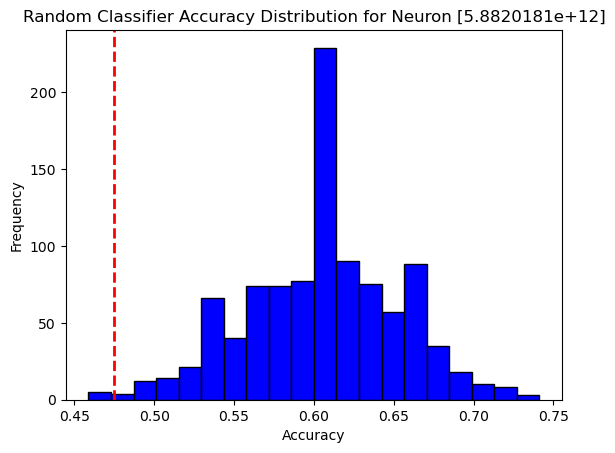


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 57.50%, p-value = 0.7610


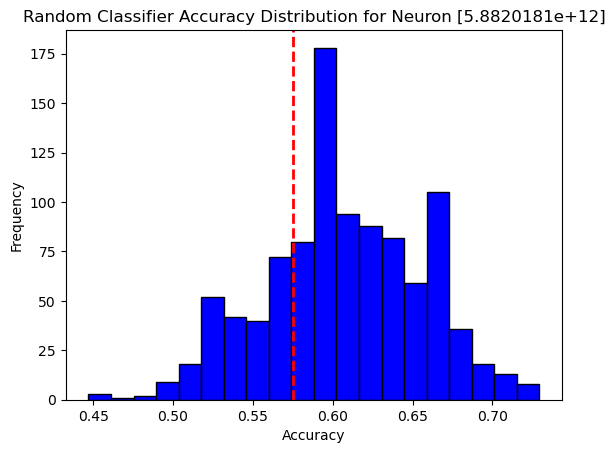


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 48.75%, p-value = 0.9890


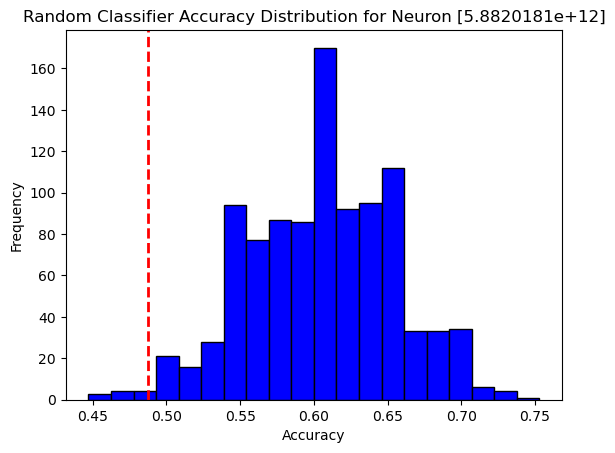


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 48.75%, p-value = 0.9930


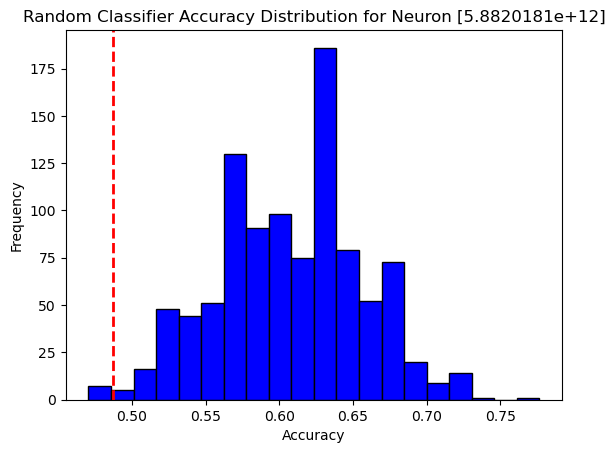


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 61.61%, p-value = 1.0000


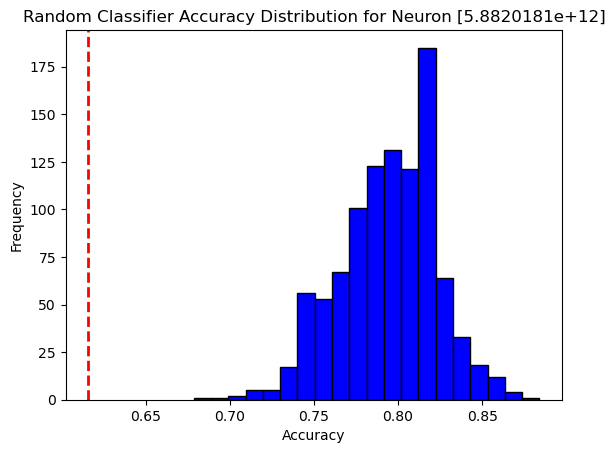


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 58.04%, p-value = 1.0000


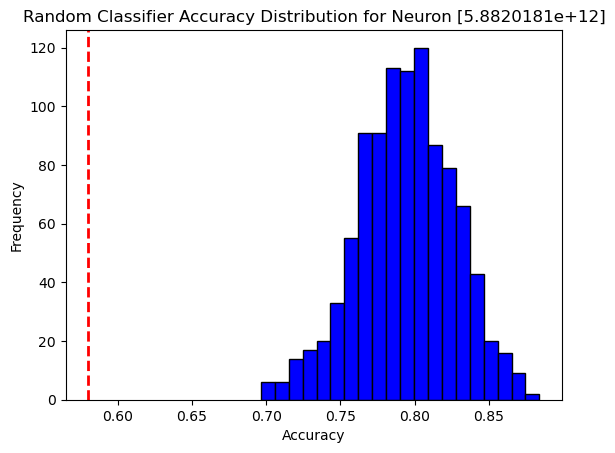


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 57.14%, p-value = 1.0000


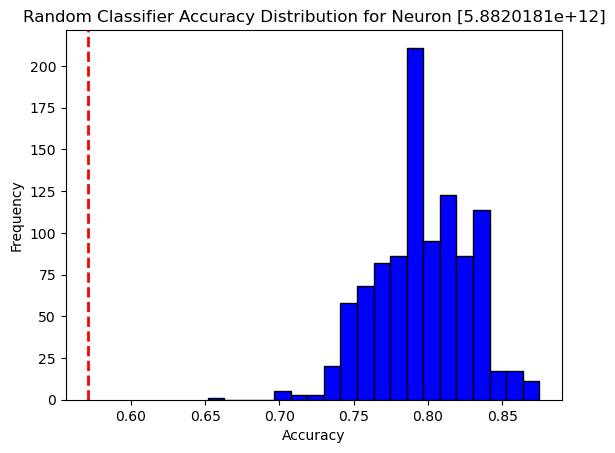


 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 54.17%, p-value = 0.5090


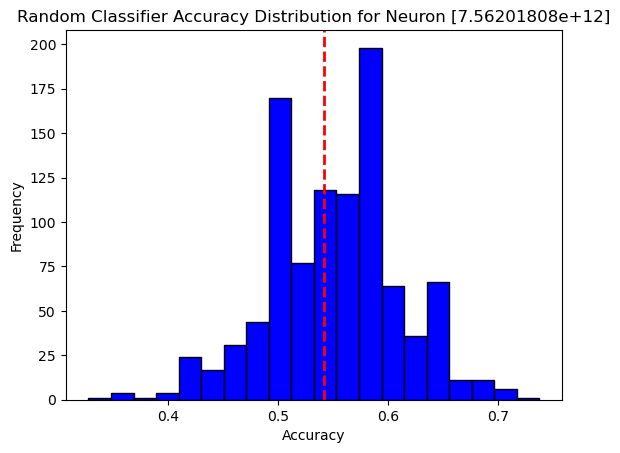


 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 39.58%, p-value = 0.9890


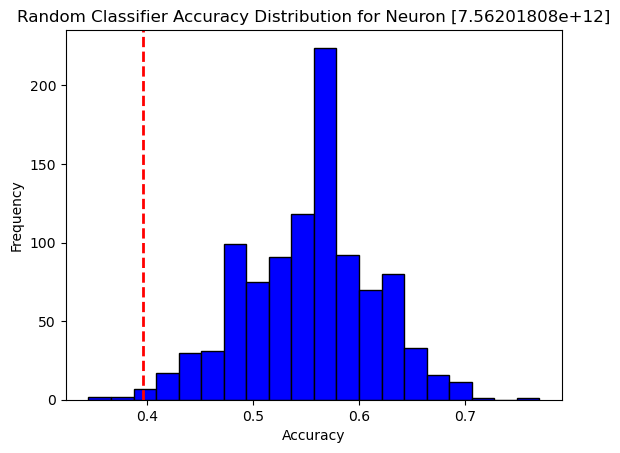


 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 37.50%, p-value = 1.0000


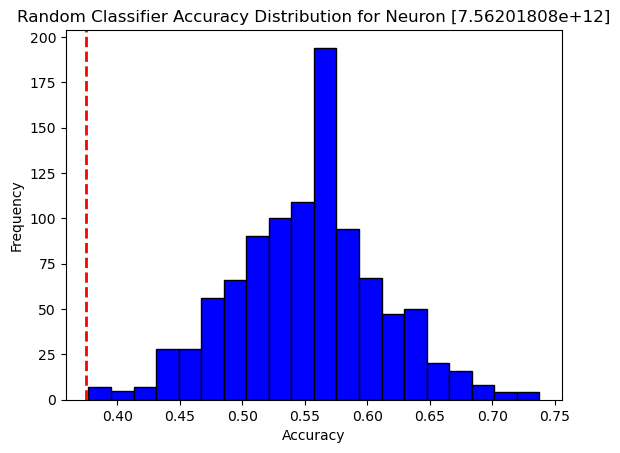


 [7.56201808e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201808e+12]: Test Accuracy = 29.17%, p-value = 1.0000


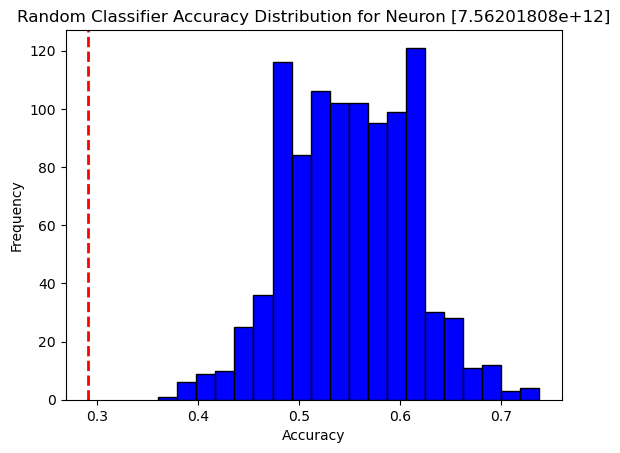


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 56.25%, p-value = 1.0000


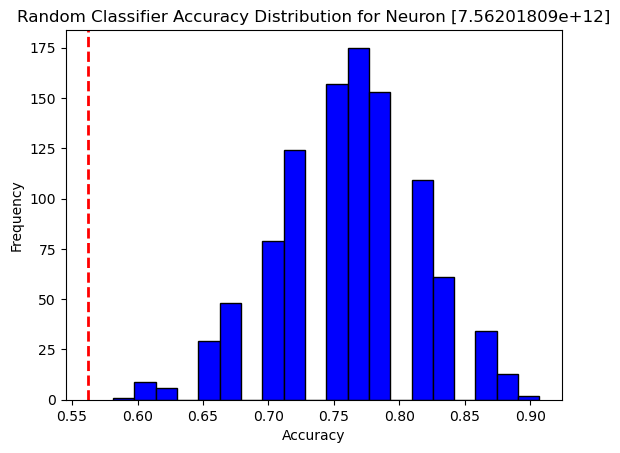


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 28.12%, p-value = 1.0000


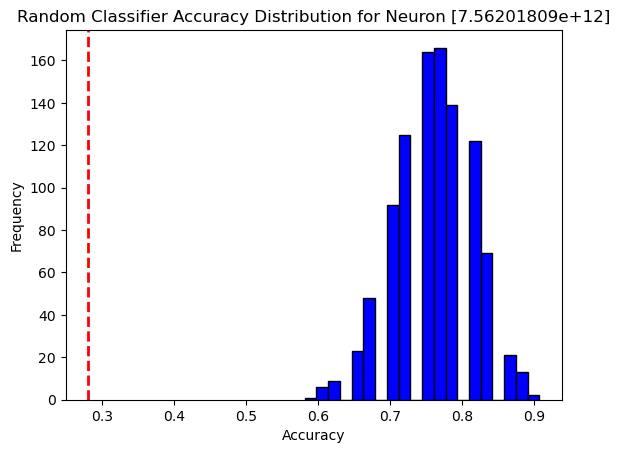


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 21.88%, p-value = 1.0000


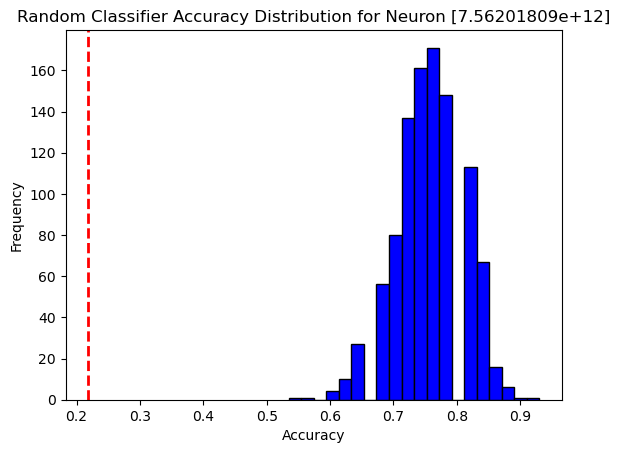


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 61.25%, p-value = 1.0000


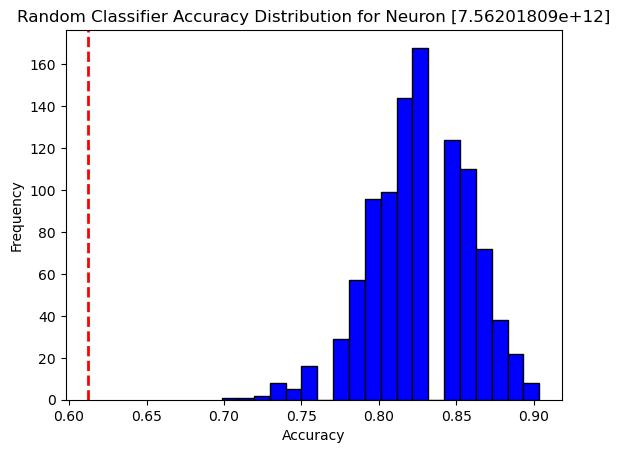


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 66.25%, p-value = 1.0000


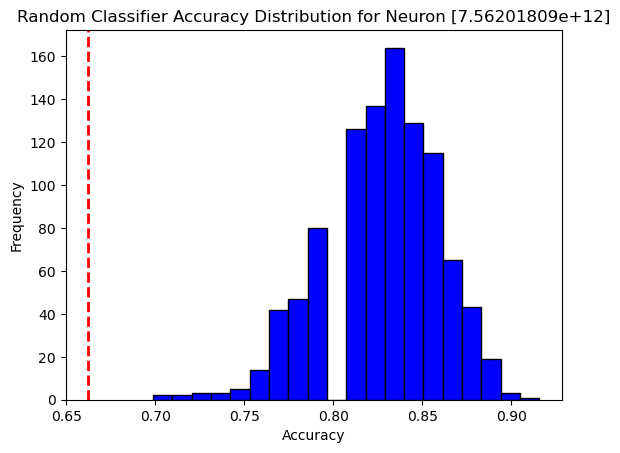


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 61.25%, p-value = 1.0000


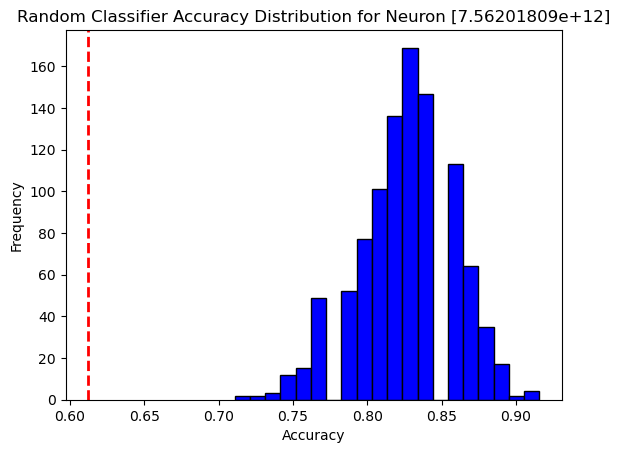


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 37.50%, p-value = 1.0000


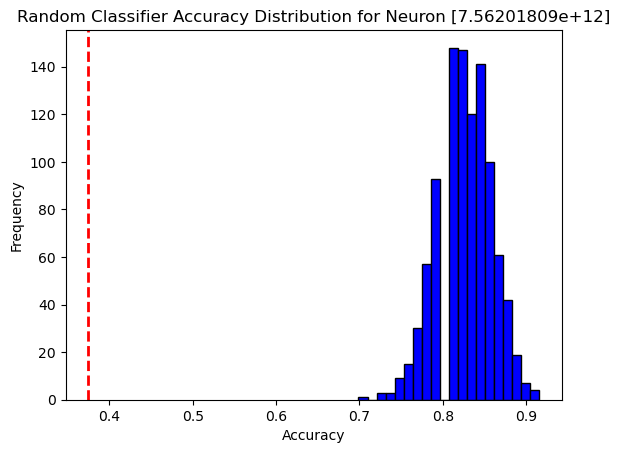


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 63.75%, p-value = 1.0000


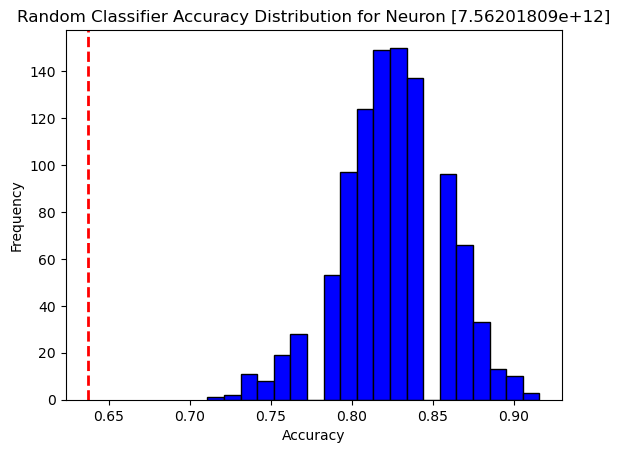


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 51.25%, p-value = 1.0000


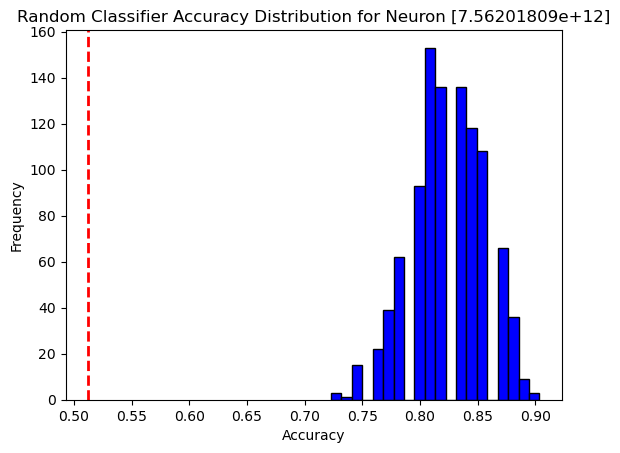


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 56.25%, p-value = 1.0000


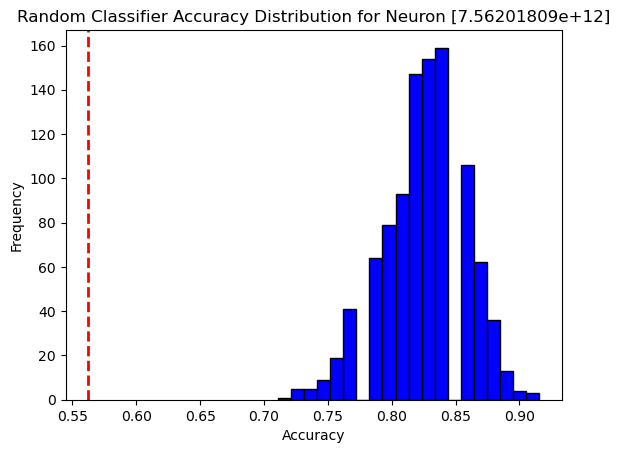


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 40.62%, p-value = 1.0000


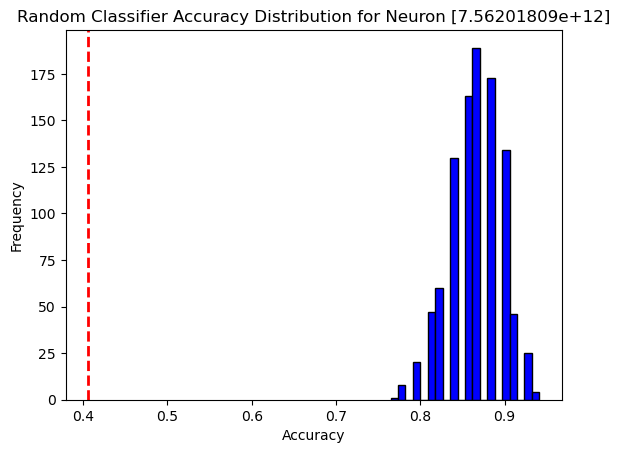


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 48.44%, p-value = 1.0000


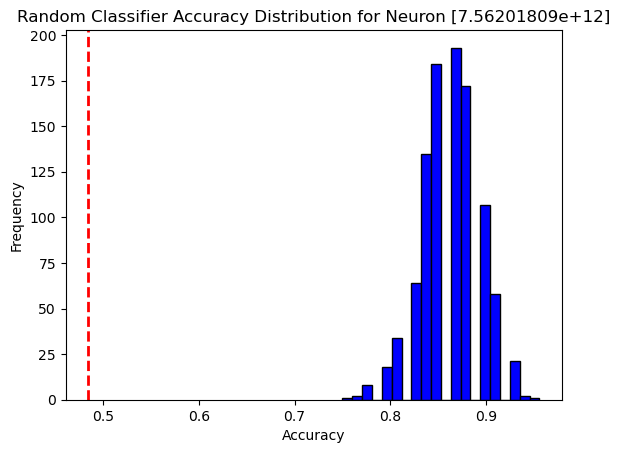


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 67.19%, p-value = 1.0000


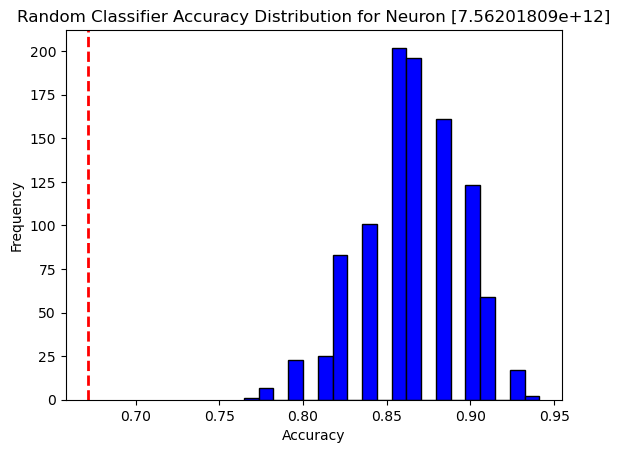


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 23.44%, p-value = 1.0000


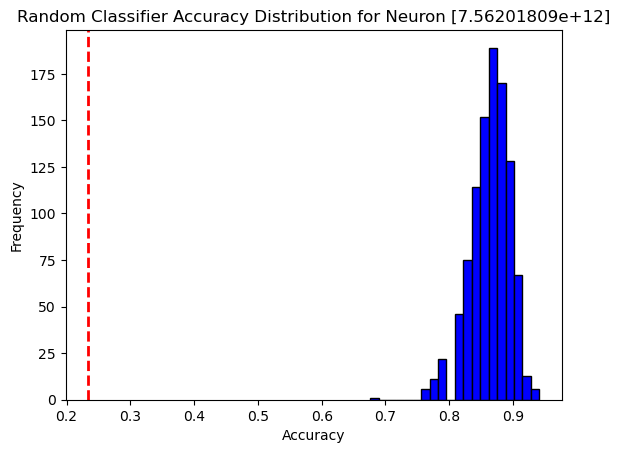


 [7.56201809e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.56201809e+12]: Test Accuracy = 76.56%, p-value = 0.9980


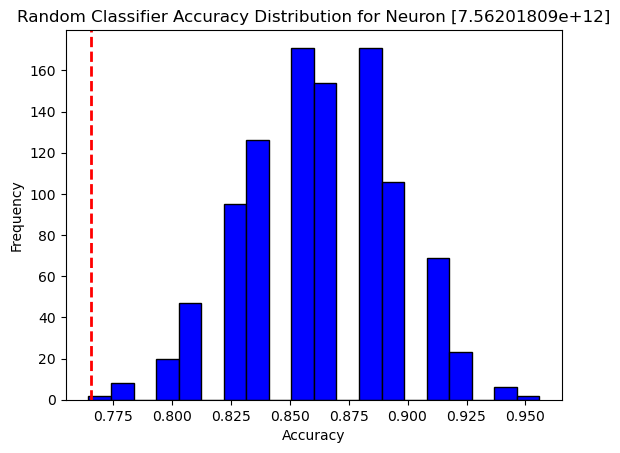


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 36.61%, p-value = 1.0000


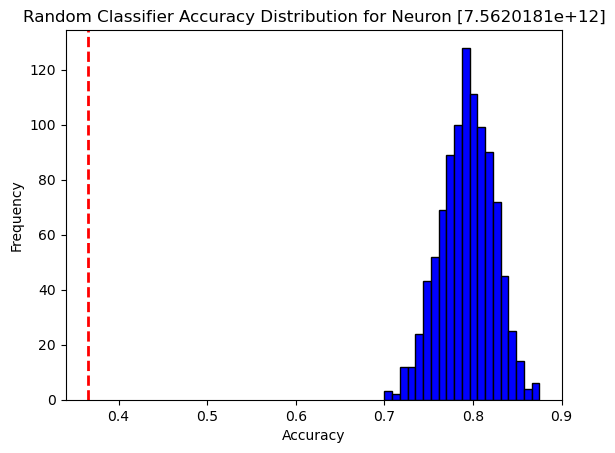


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 81.25%, p-value = 0.2620


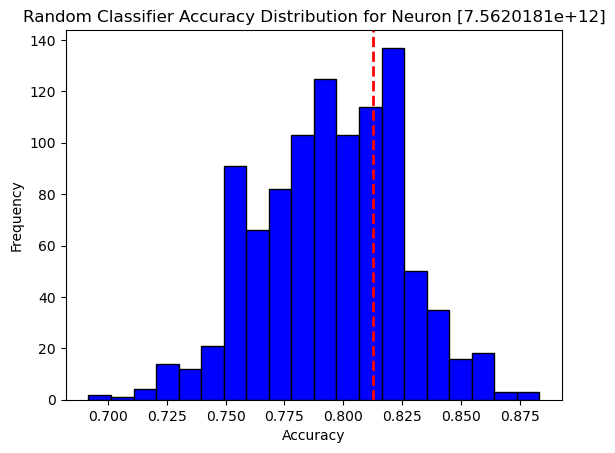


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 57.14%, p-value = 1.0000


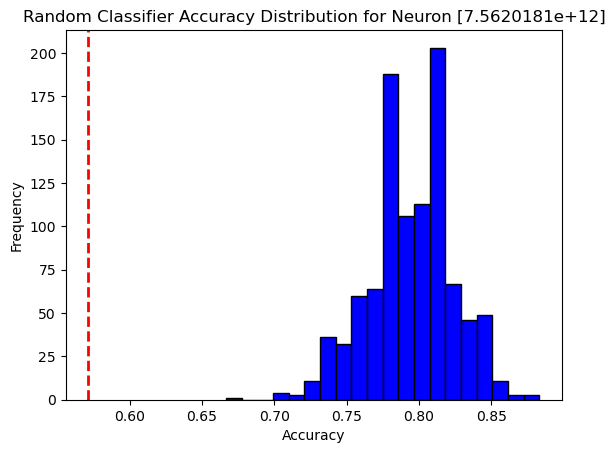


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 25.00%, p-value = 1.0000


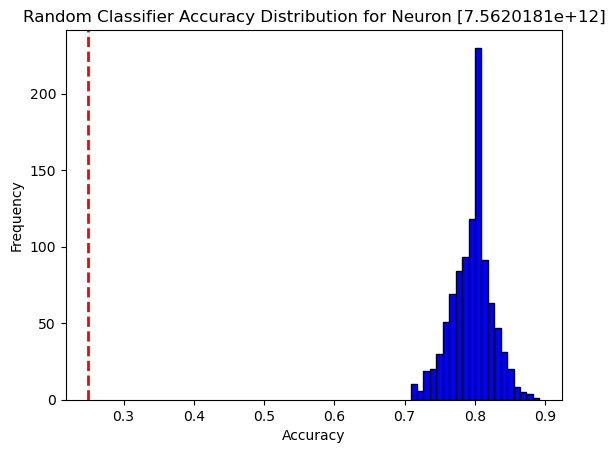


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 60.42%, p-value = 0.9970


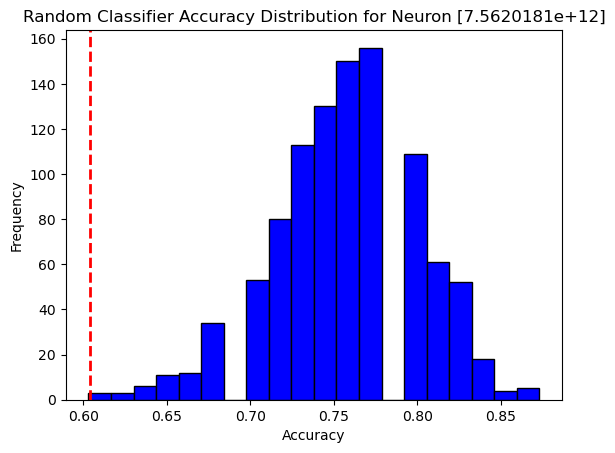


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 83.33%, p-value = 0.0320


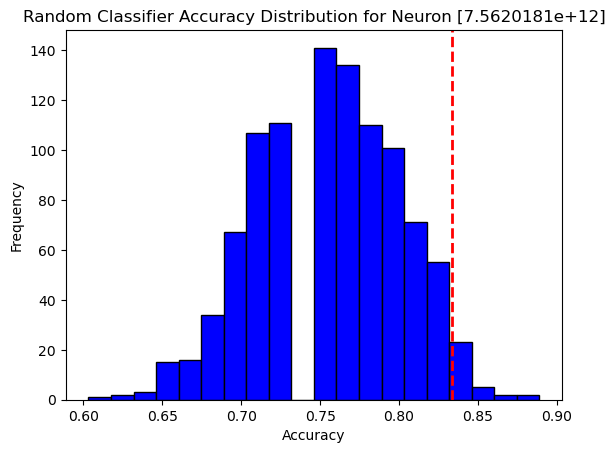


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 1.0000


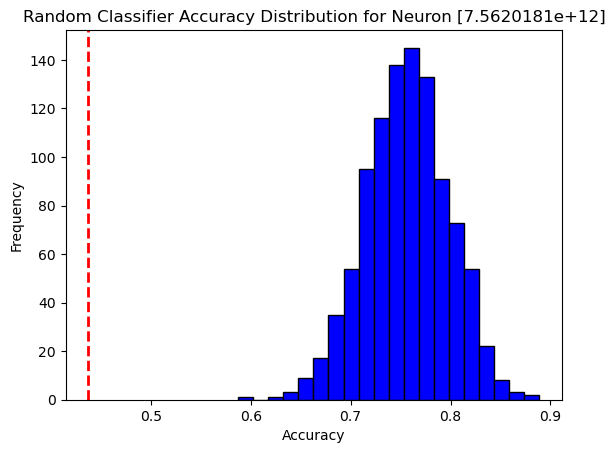


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 39.58%, p-value = 1.0000


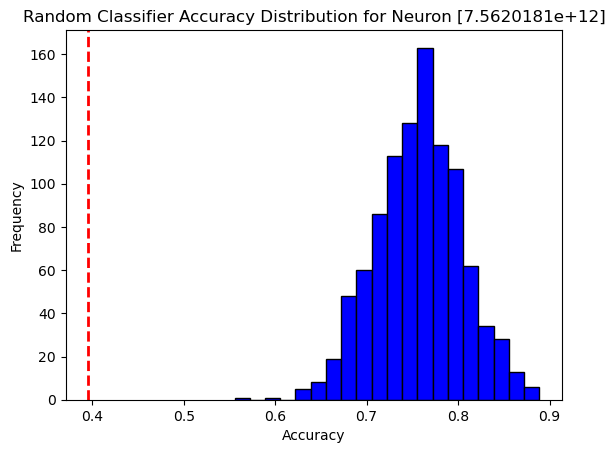


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 58.33%, p-value = 1.0000


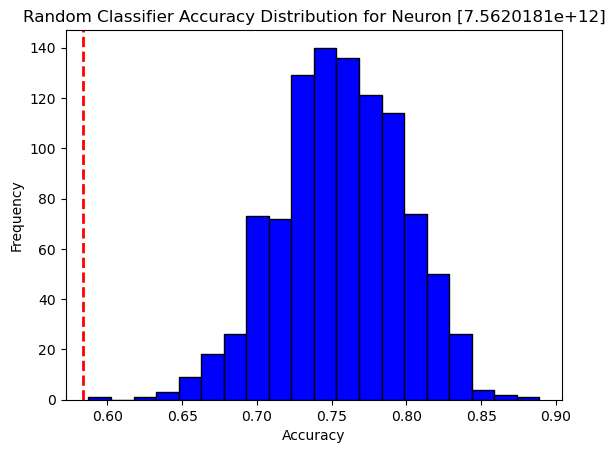


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 33.33%, p-value = 1.0000


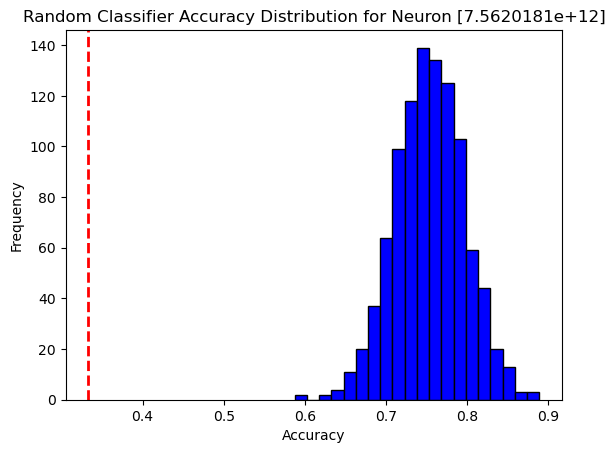


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.08%, p-value = 1.0000


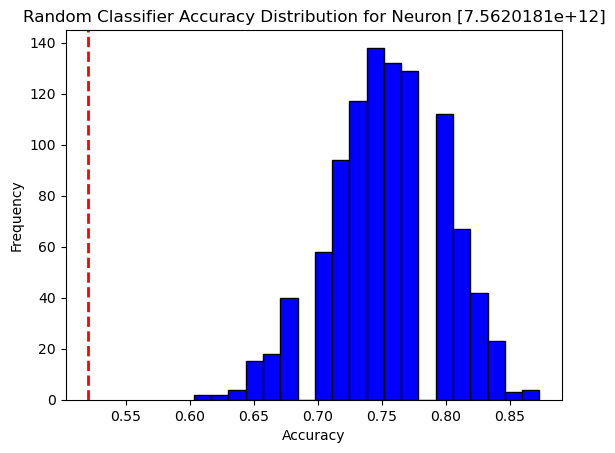


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 68.75%, p-value = 0.9330


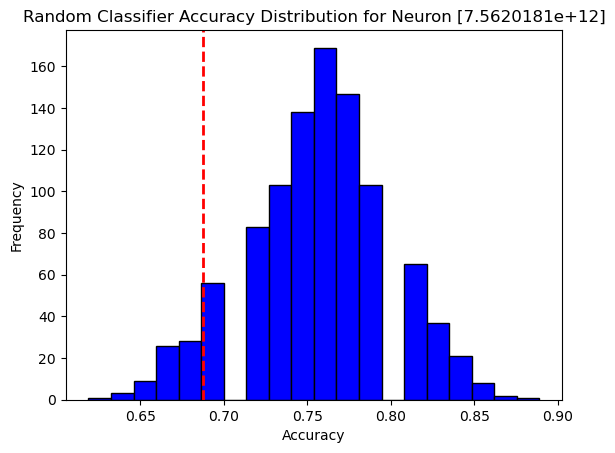


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 64.58%, p-value = 0.9930


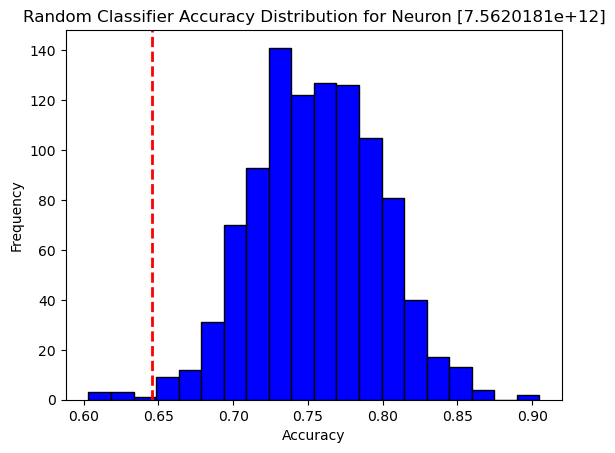


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 41.67%, p-value = 0.9290


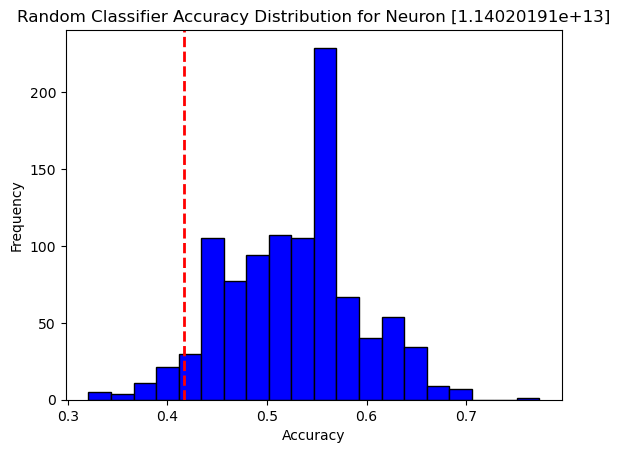


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 37.50%, p-value = 0.9920


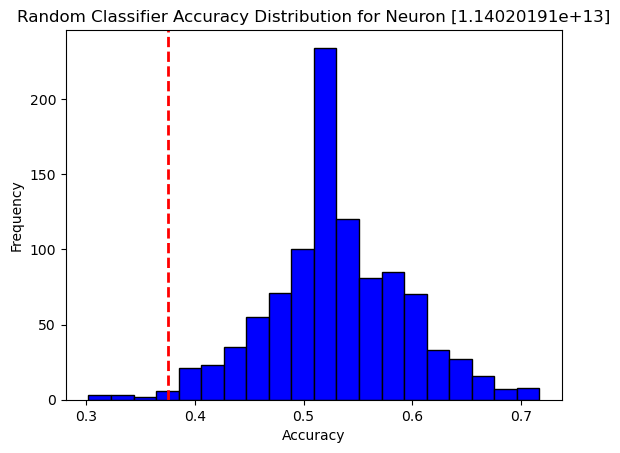


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 43.75%, p-value = 0.8960


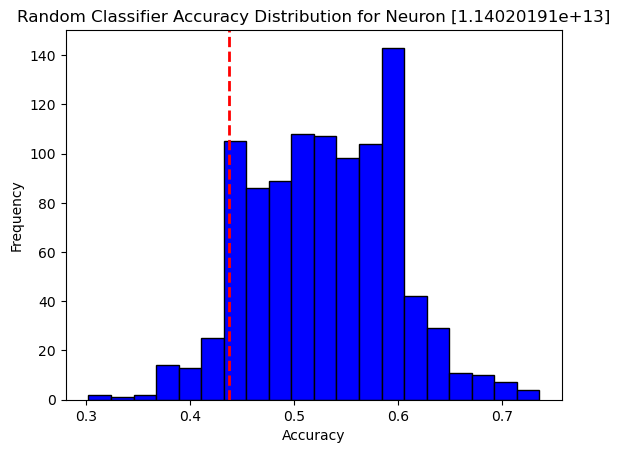


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 62.50%, p-value = 0.0680


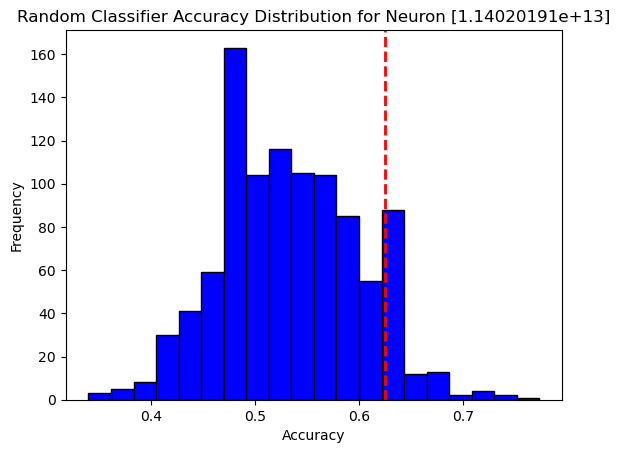


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 41.67%, p-value = 0.9420


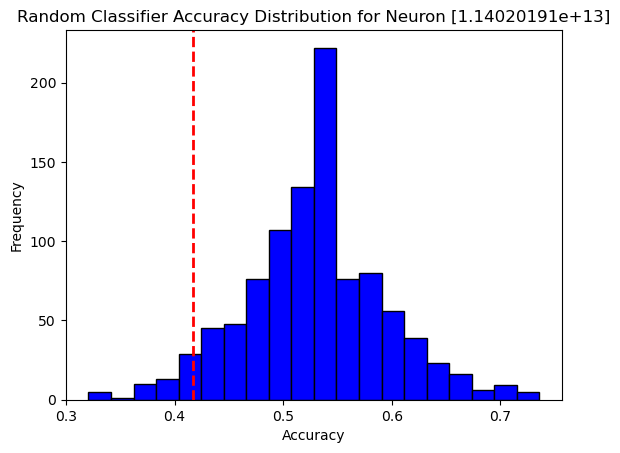


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 52.08%, p-value = 0.5680


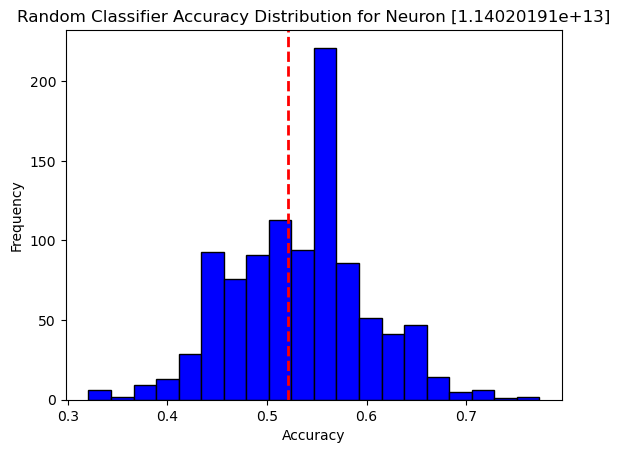


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 37.50%, p-value = 0.9890


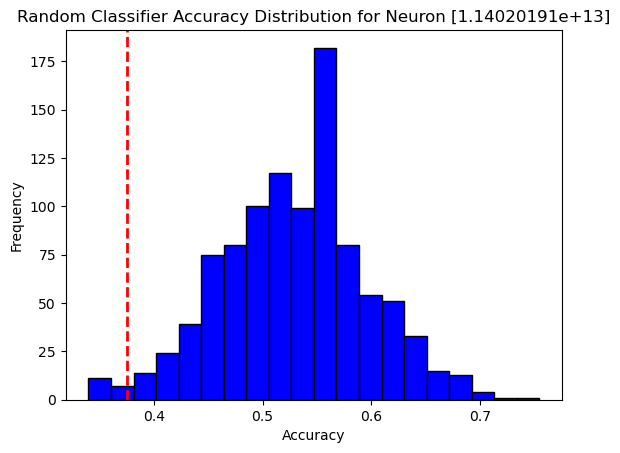


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 39.58%, p-value = 0.9810


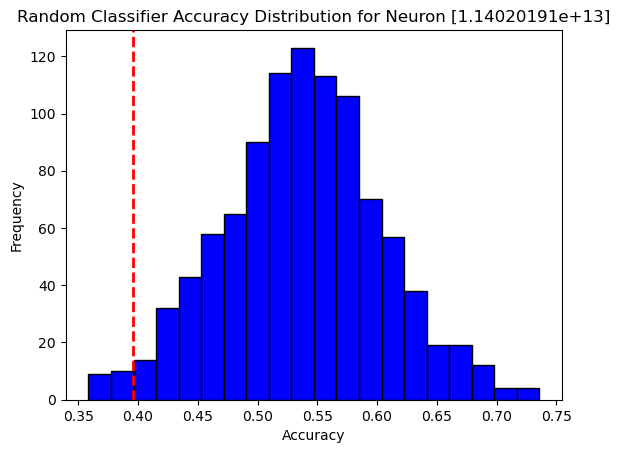


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 37.50%, p-value = 0.9950


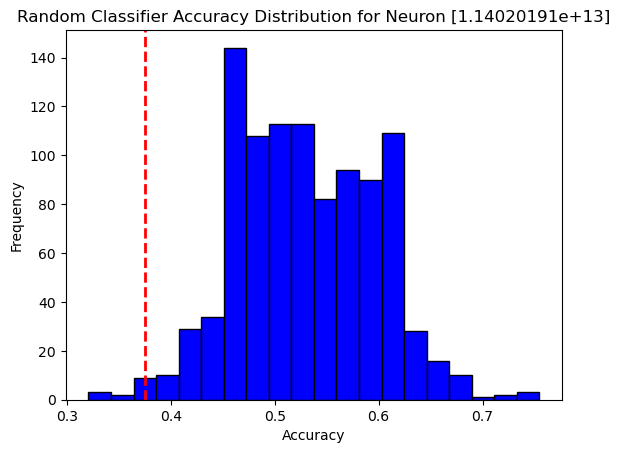


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 69.79%, p-value = 0.0740


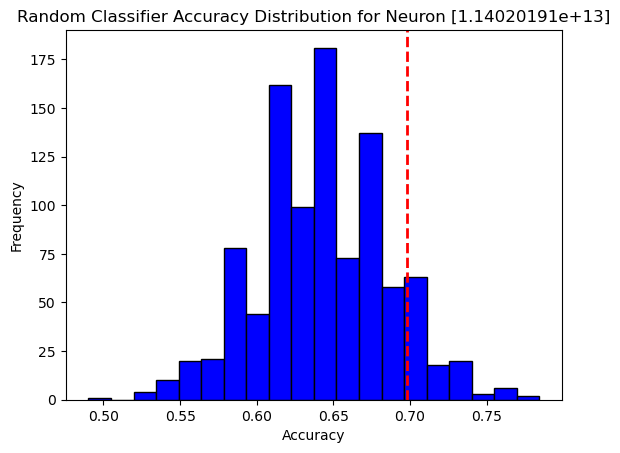


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 46.88%, p-value = 1.0000


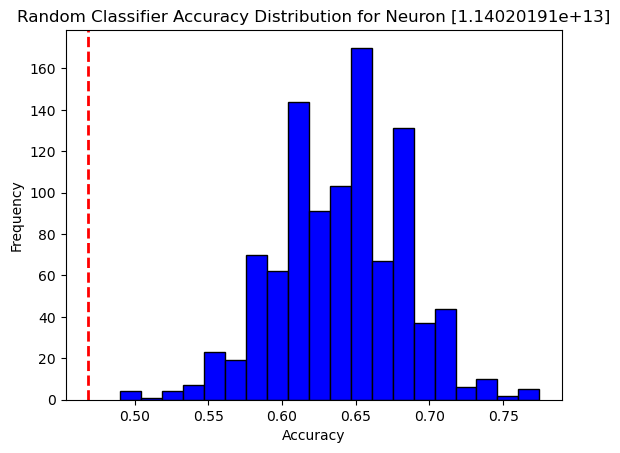


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 47.92%, p-value = 1.0000


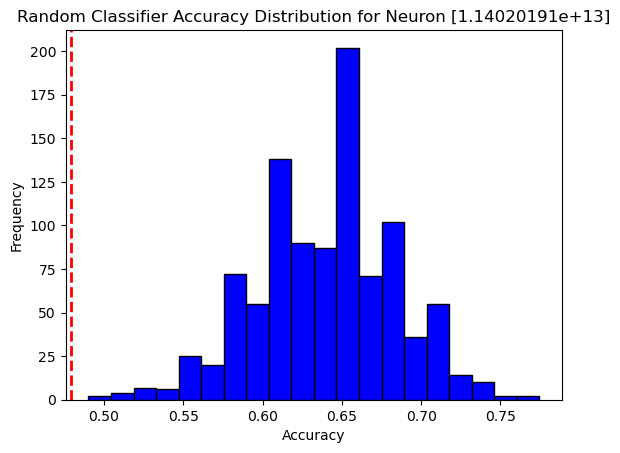


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 51.04%, p-value = 0.9980


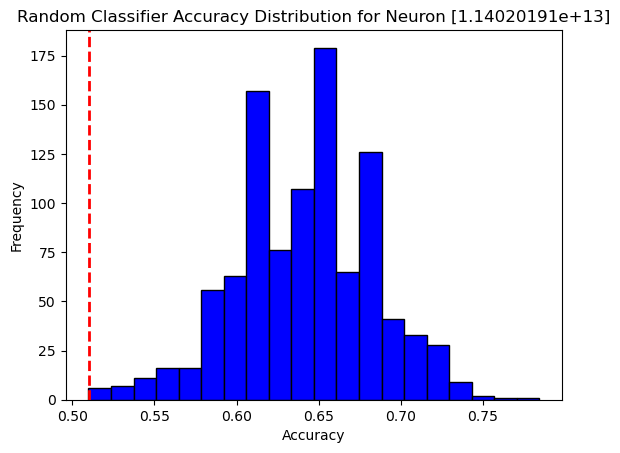


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 44.79%, p-value = 1.0000


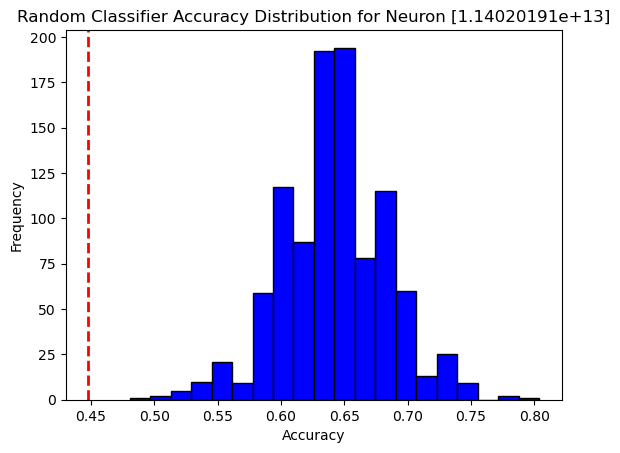


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 46.88%, p-value = 1.0000


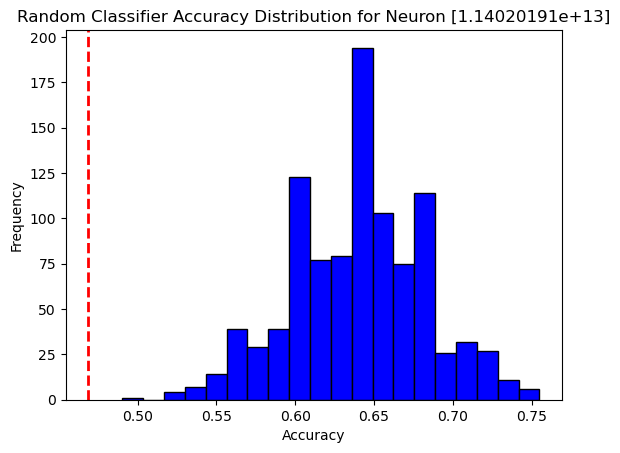


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 70.83%, p-value = 0.0340


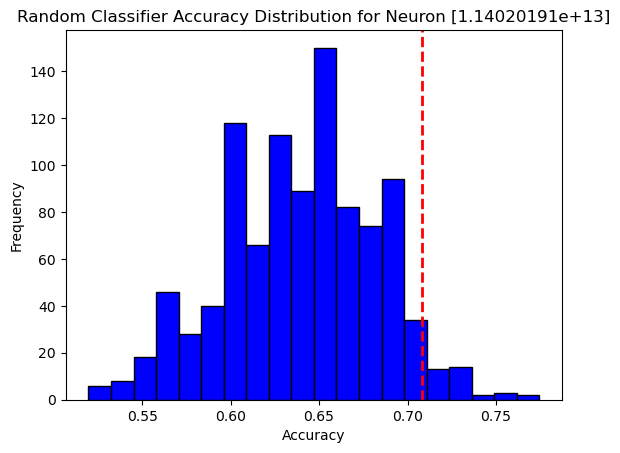


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 62.50%, p-value = 0.6690


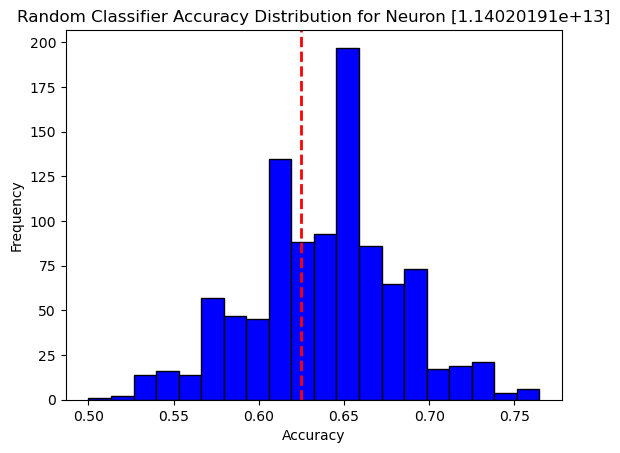


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 48.96%, p-value = 1.0000


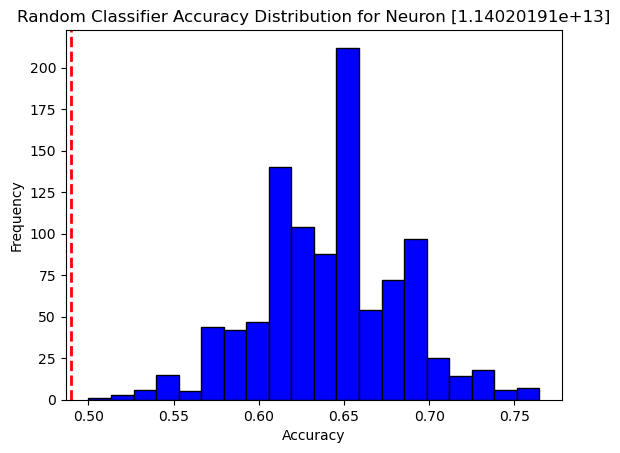


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 48.96%, p-value = 1.0000


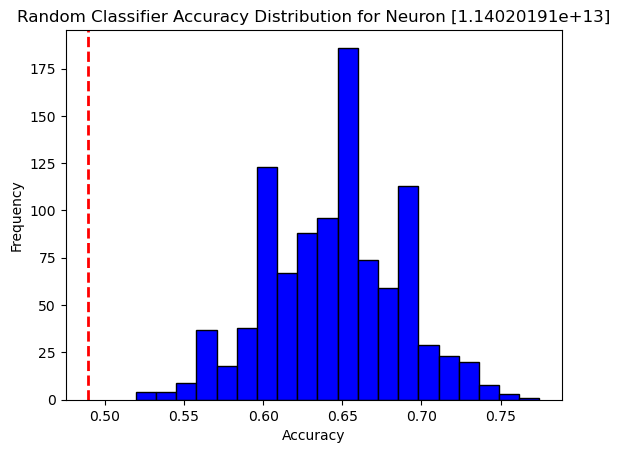


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 62.50%, p-value = 0.6710


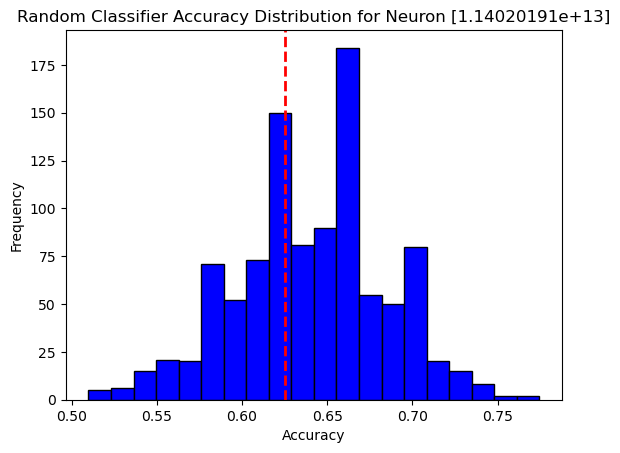


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 41.67%, p-value = 1.0000


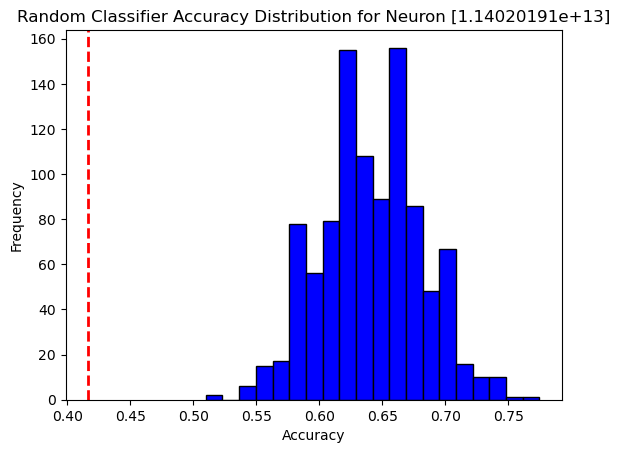


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 66.67%, p-value = 0.2440


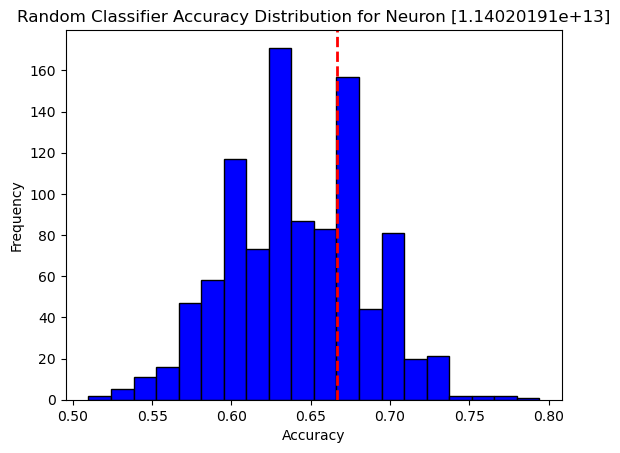


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 48.96%, p-value = 1.0000


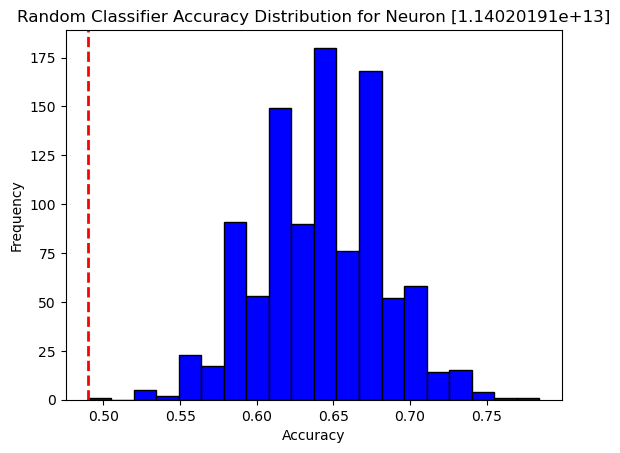


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 41.67%, p-value = 1.0000


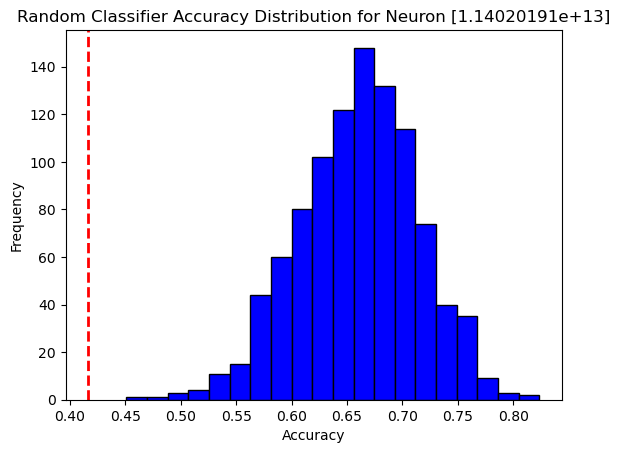


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 16.67%, p-value = 1.0000


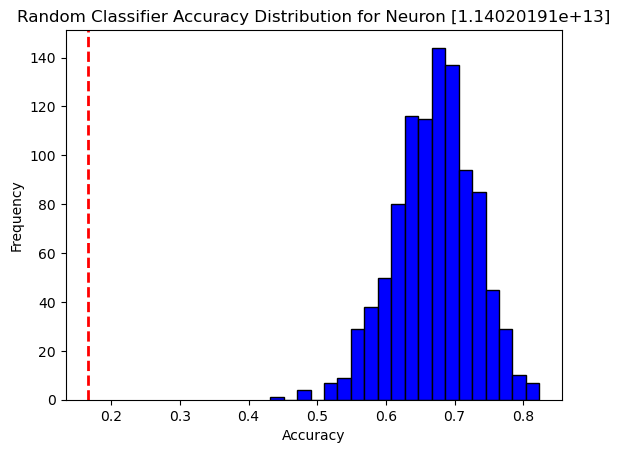


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 31.25%, p-value = 1.0000


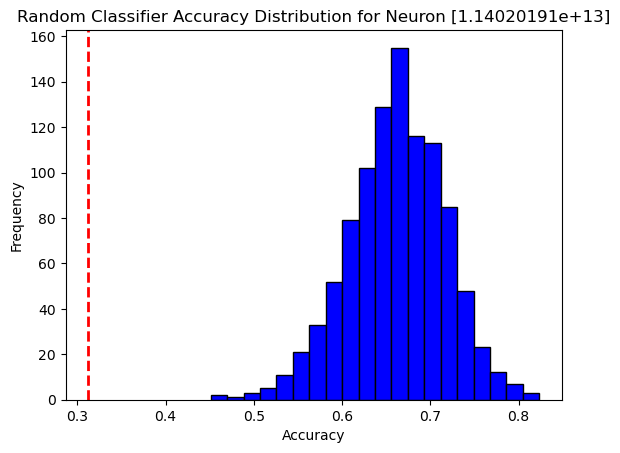


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 79.17%, p-value = 0.0070


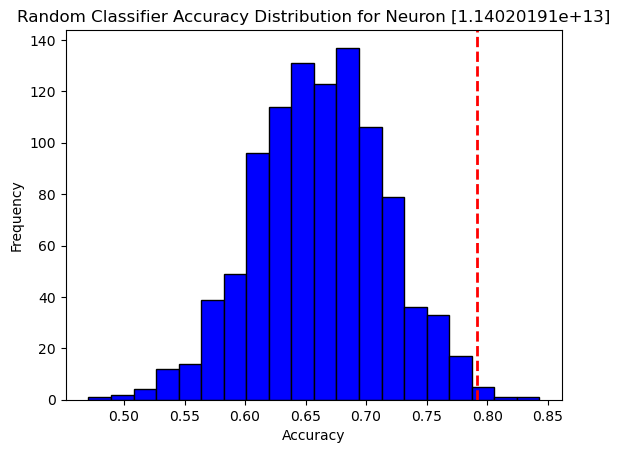


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 20.83%, p-value = 1.0000


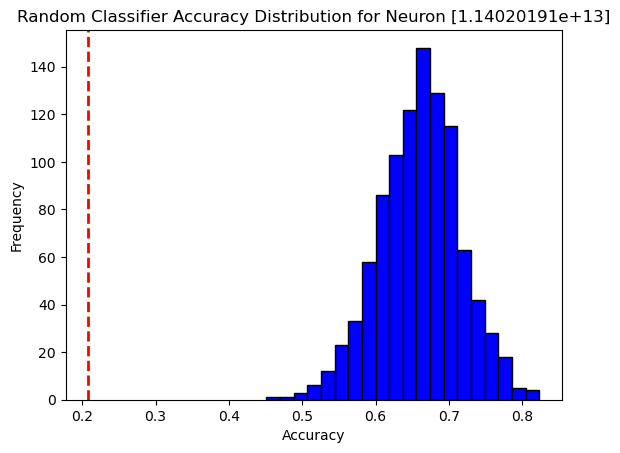


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 45.83%, p-value = 1.0000


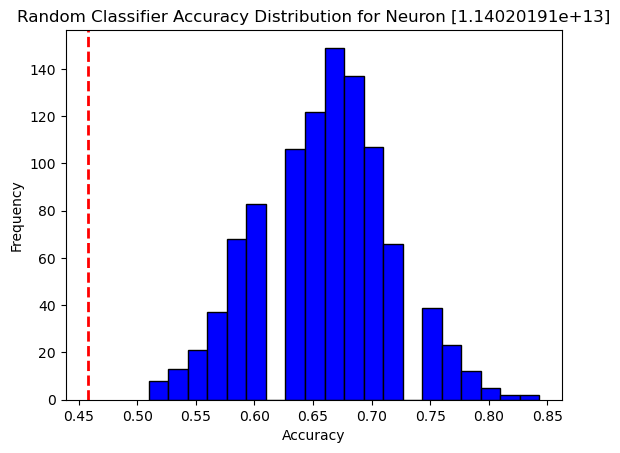


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 56.25%, p-value = 0.9640


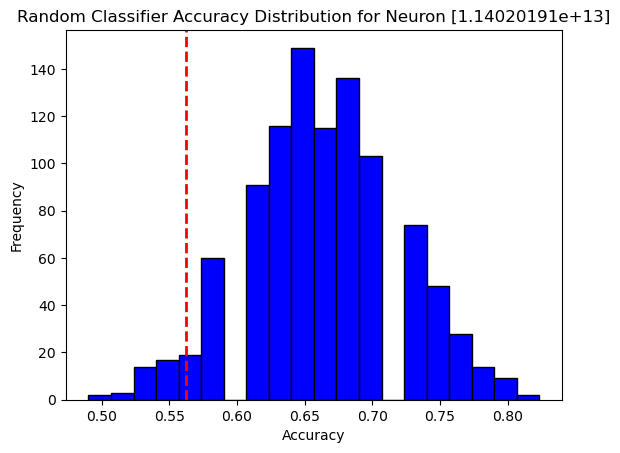


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 79.17%, p-value = 0.0060


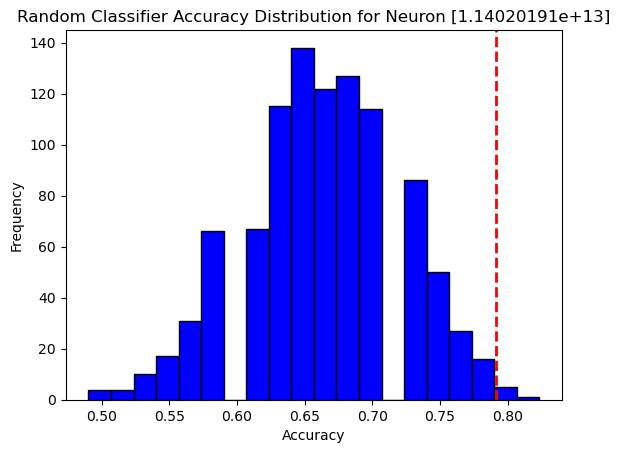


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 34.38%, p-value = 1.0000


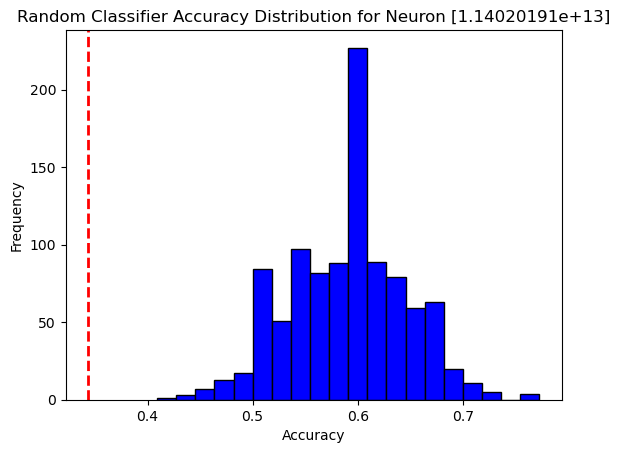


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 64.06%, p-value = 0.1560


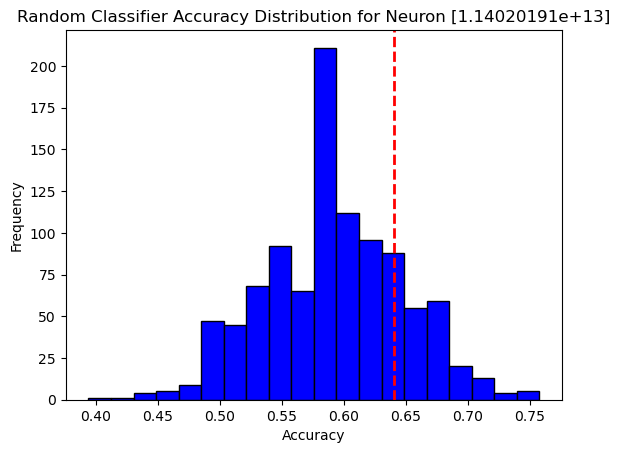


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 45.31%, p-value = 0.9920


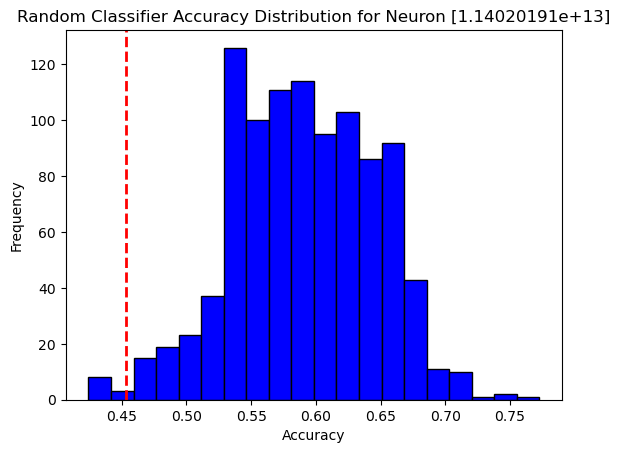


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 53.12%, p-value = 0.8150


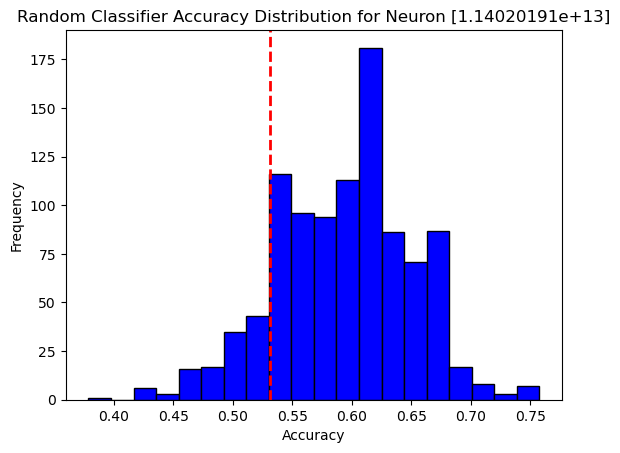


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 71.88%, p-value = 0.0110


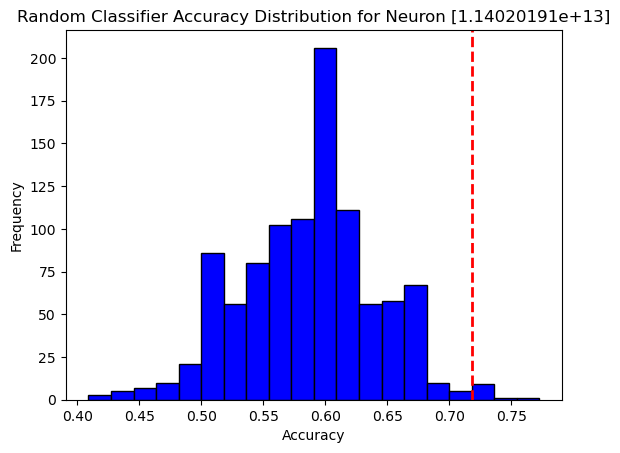


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 60.94%, p-value = 0.3460


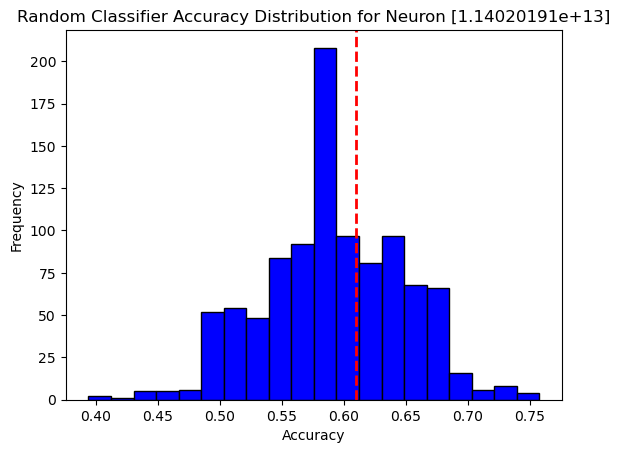


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 28.12%, p-value = 1.0000


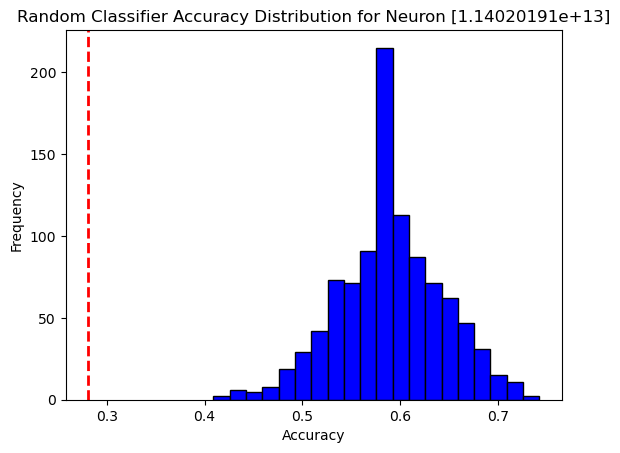


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 53.12%, p-value = 0.8440


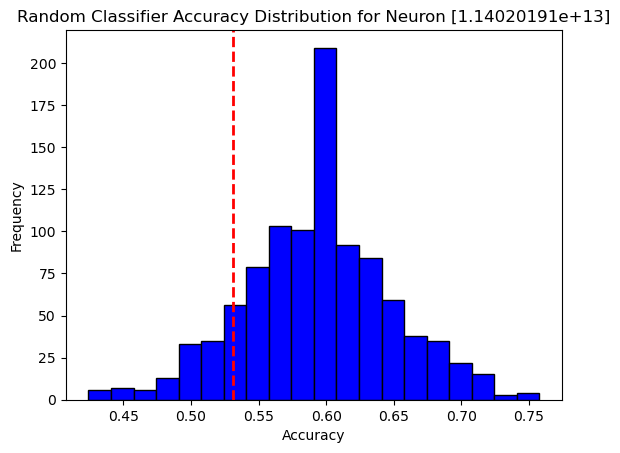


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 67.19%, p-value = 0.0540


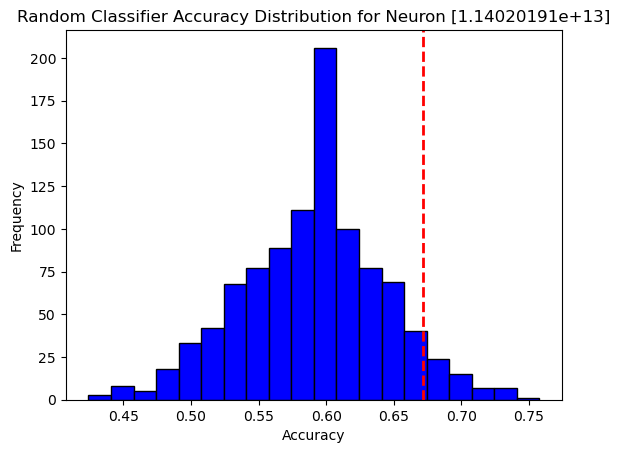


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 73.44%, p-value = 0.0030


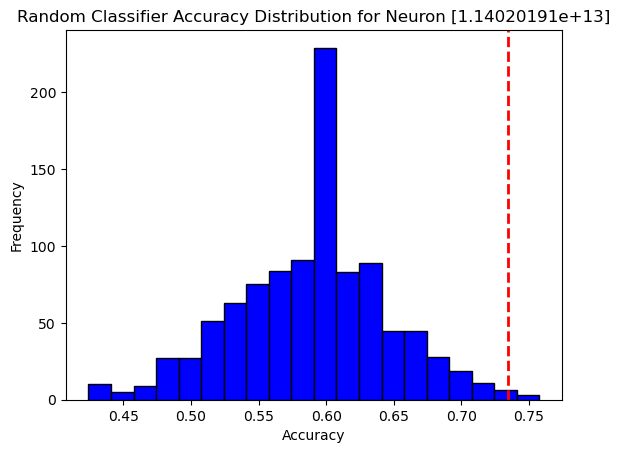


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 65.62%, p-value = 0.1210


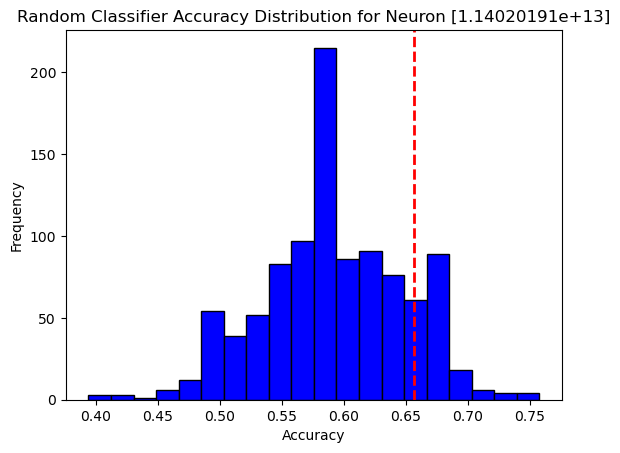


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 42.19%, p-value = 1.0000


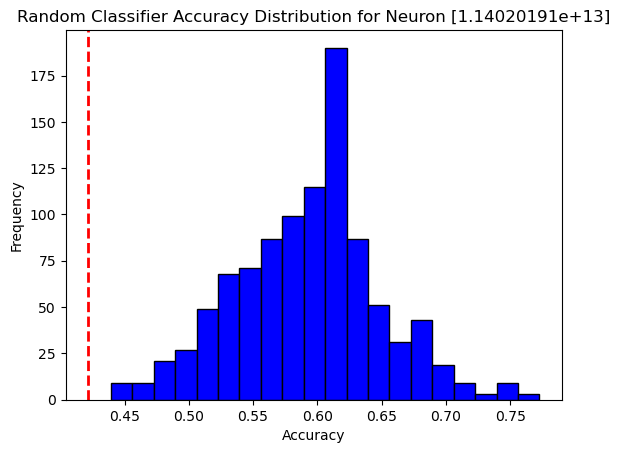


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 51.56%, p-value = 0.8910


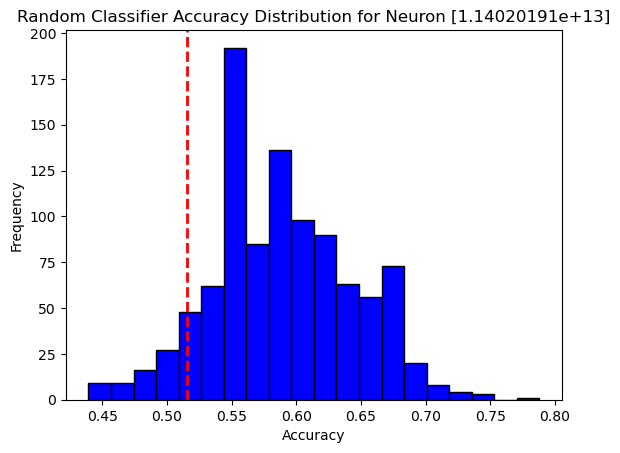


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 54.69%, p-value = 0.7410


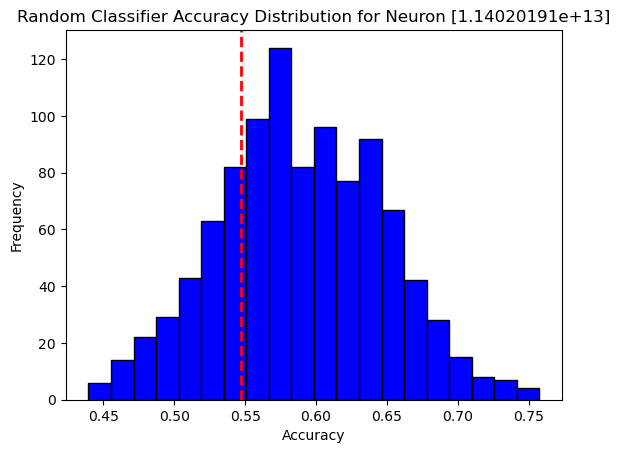


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 56.25%, p-value = 0.6790


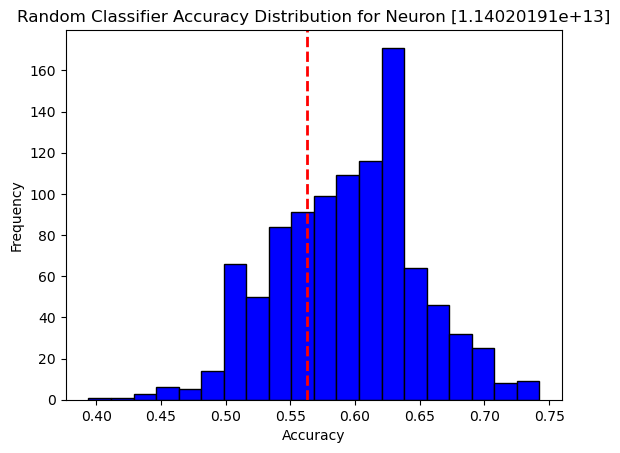


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 40.62%, p-value = 1.0000


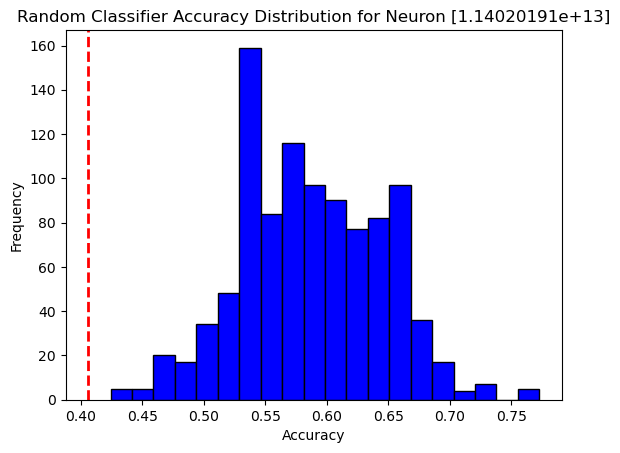


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 48.44%, p-value = 0.9690


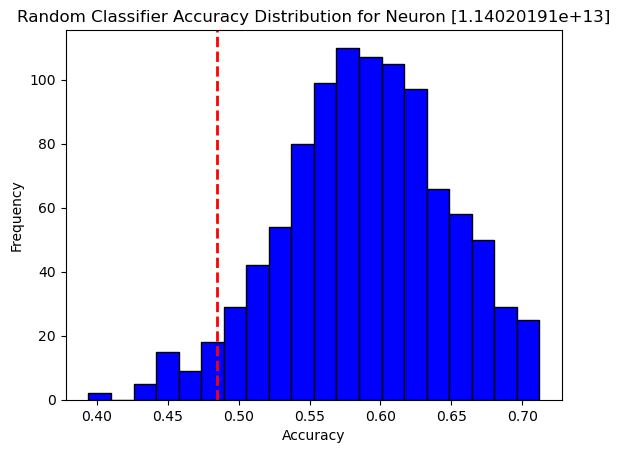


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 57.81%, p-value = 0.5390


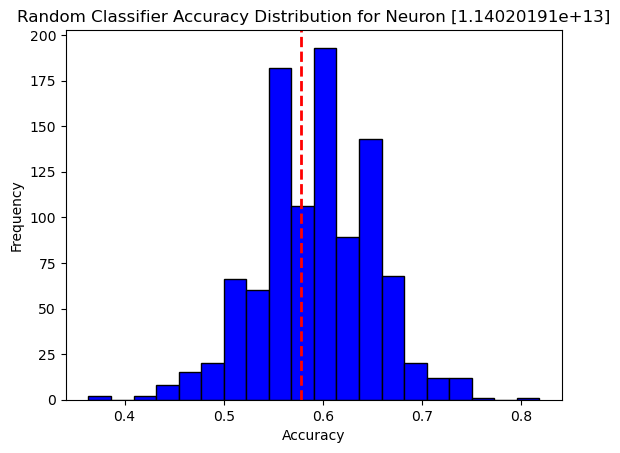


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 31.25%, p-value = 1.0000


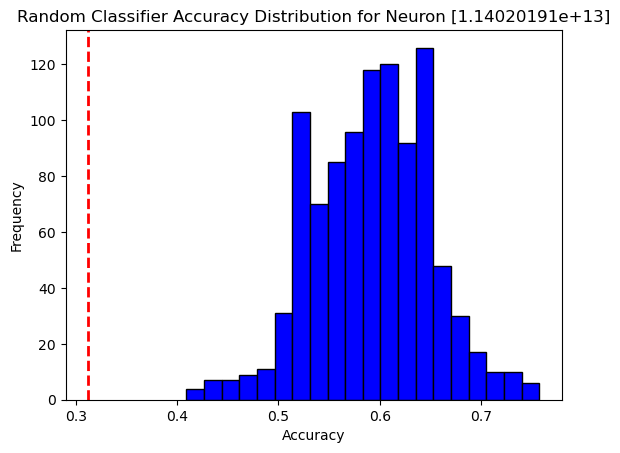


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 31.25%, p-value = 1.0000


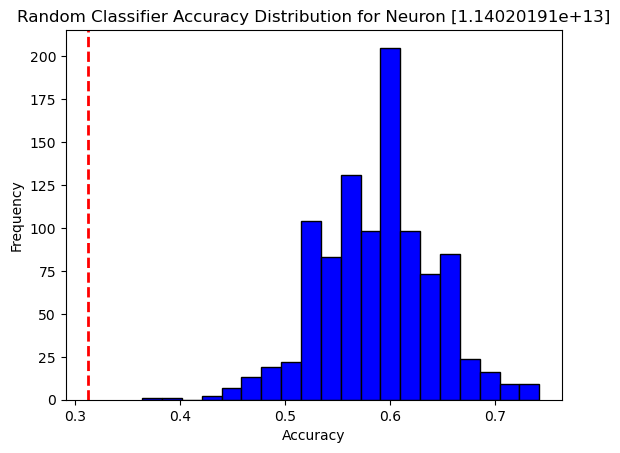


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 46.88%, p-value = 0.9810


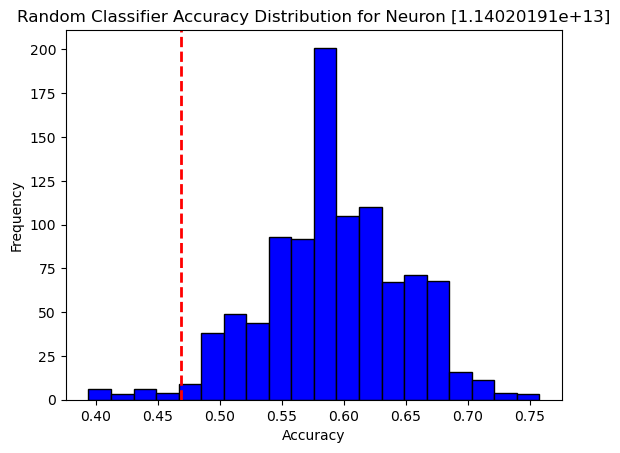


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 28.12%, p-value = 1.0000


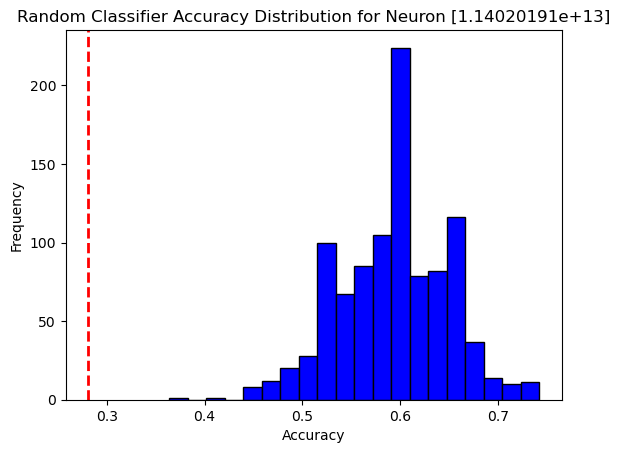


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 70.31%, p-value = 0.0210


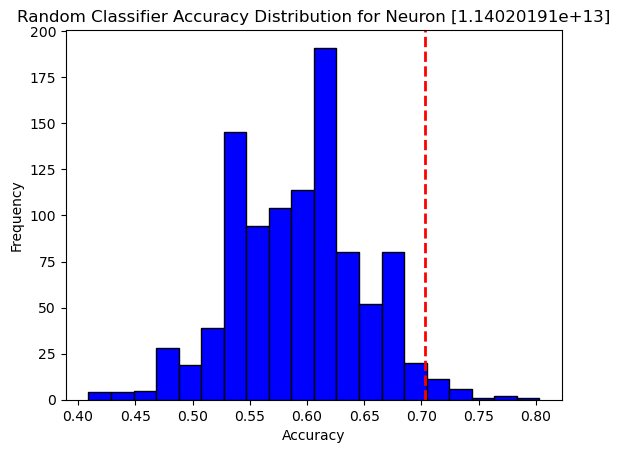


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 35.94%, p-value = 1.0000


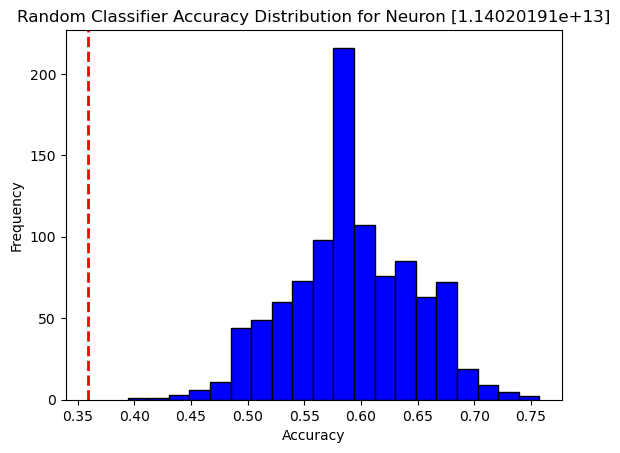


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 65.62%, p-value = 0.1030


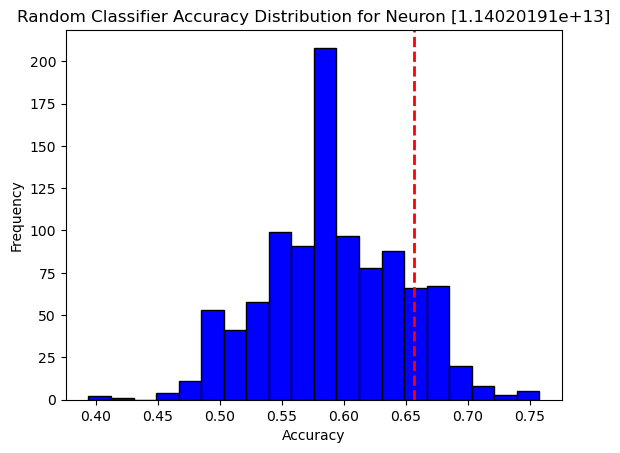


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 28.12%, p-value = 1.0000


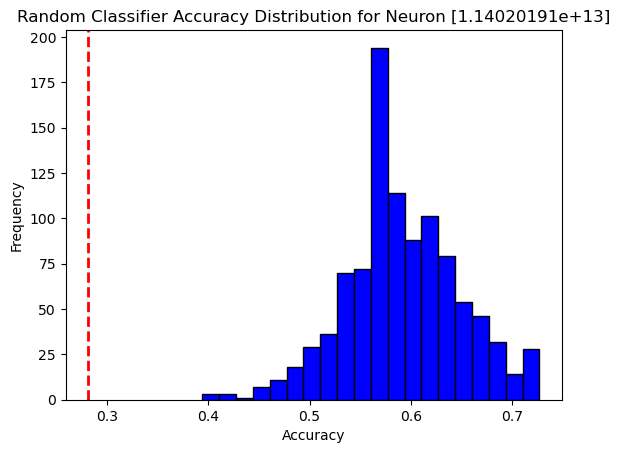


 [1.14020191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.14020191e+13]: Test Accuracy = 28.12%, p-value = 1.0000


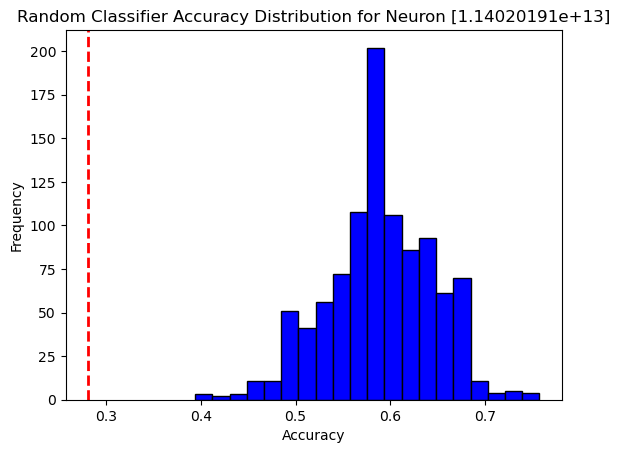

Brain Area: S1naive, Analysis Type: GO
Num of neurons before filter= 318

 [1.21820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+12]: Test Accuracy = 45.83%, p-value = 0.8080


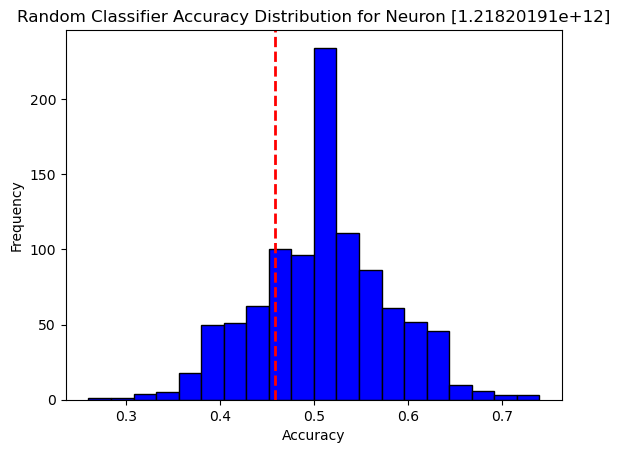


 [1.21820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+12]: Test Accuracy = 42.19%, p-value = 0.9360


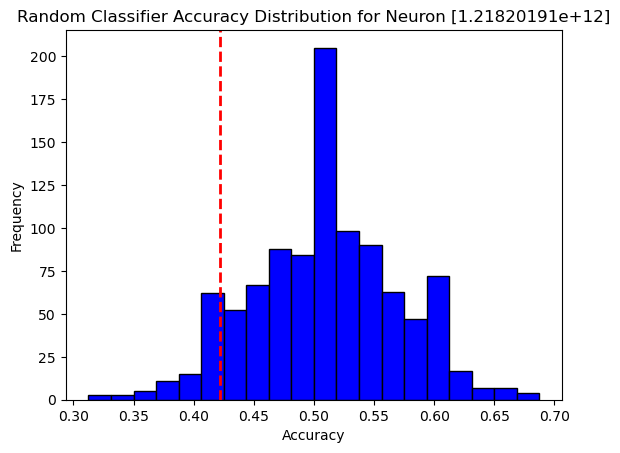


 [1.21820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+12]: Test Accuracy = 50.00%, p-value = 0.5550


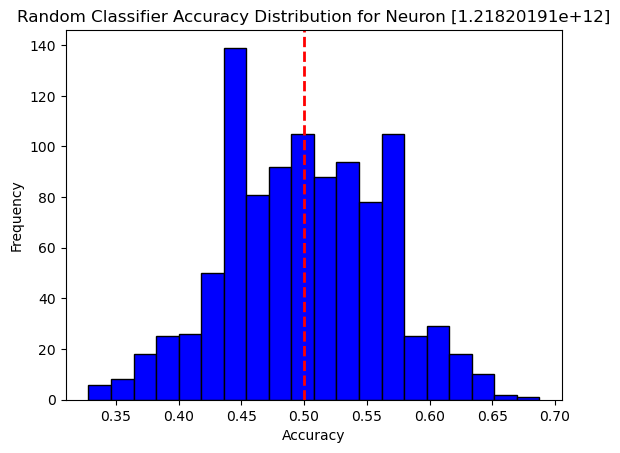


 [1.21820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+12]: Test Accuracy = 46.88%, p-value = 0.7500


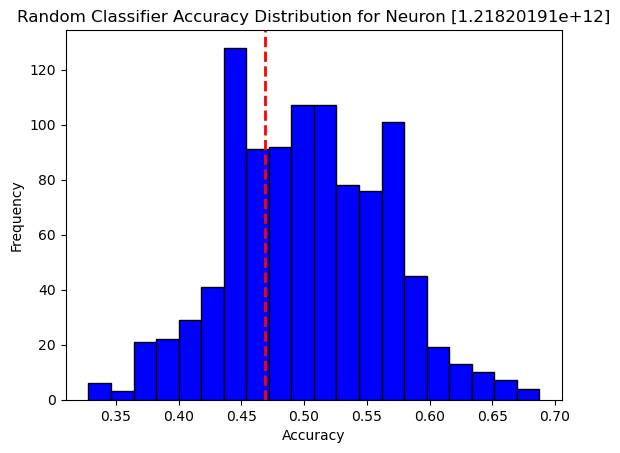


 [1.26020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26020191e+12]: Test Accuracy = 50.00%, p-value = 0.5510


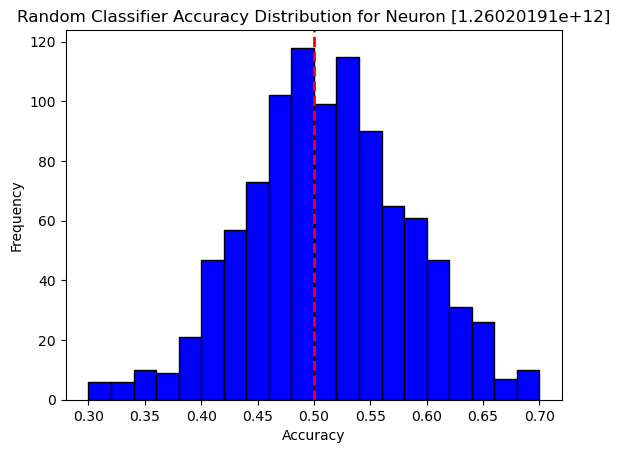


 [1.26020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26020191e+12]: Test Accuracy = 50.00%, p-value = 0.5440


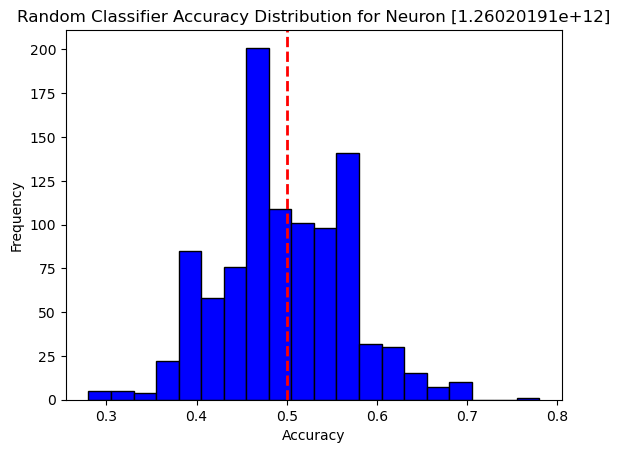


 [1.26020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26020191e+12]: Test Accuracy = 53.12%, p-value = 0.3940


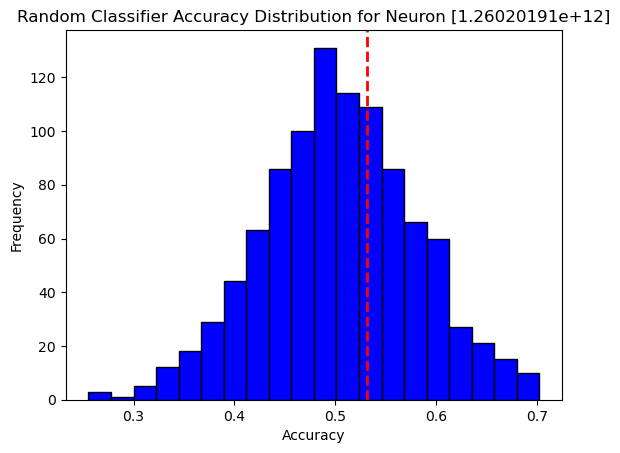


 [1.26020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26020191e+12]: Test Accuracy = 68.75%, p-value = 0.0000


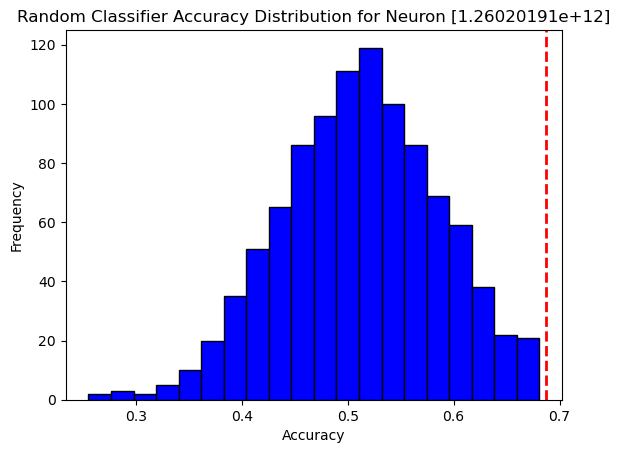


 [1.26020191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26020191e+12]: Test Accuracy = 56.25%, p-value = 0.1920


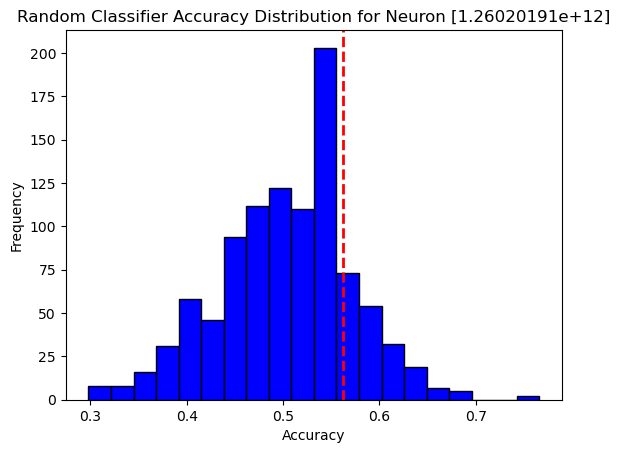


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 50.00%, p-value = 0.5690


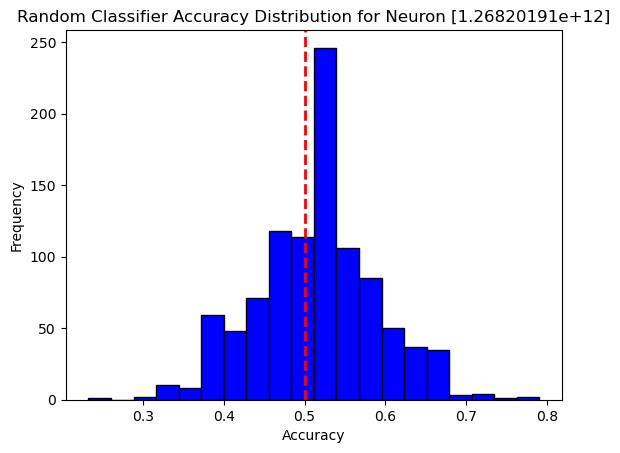


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 53.12%, p-value = 0.4570


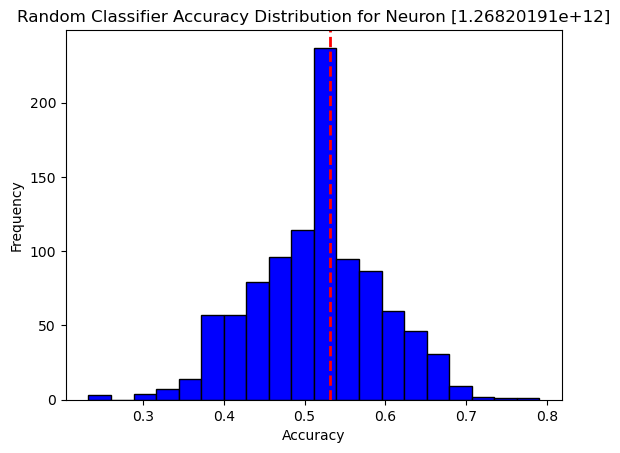


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 54.17%, p-value = 0.2410


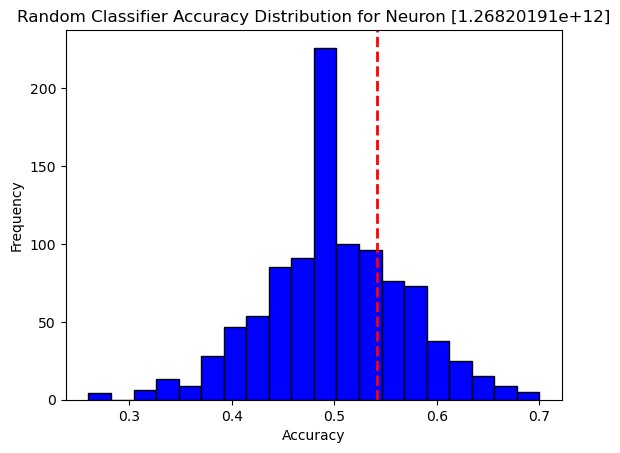


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 56.25%, p-value = 0.1510


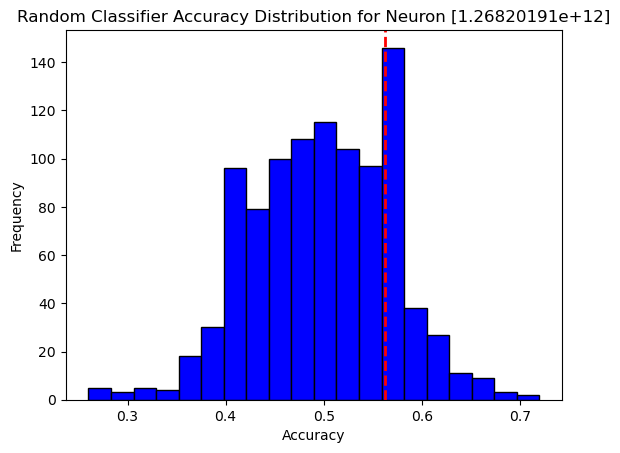


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 45.83%, p-value = 0.7640


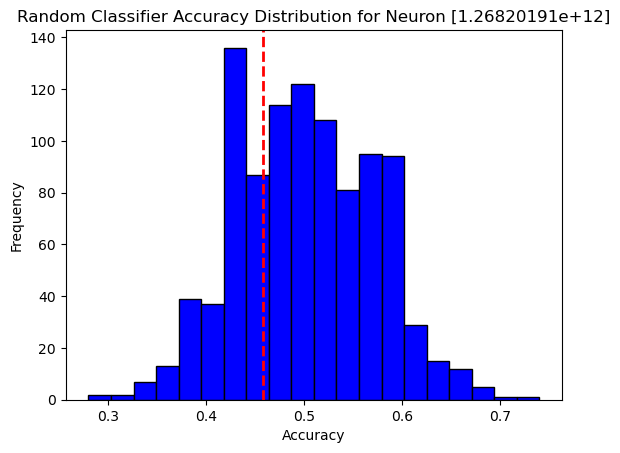


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 35.42%, p-value = 0.9820


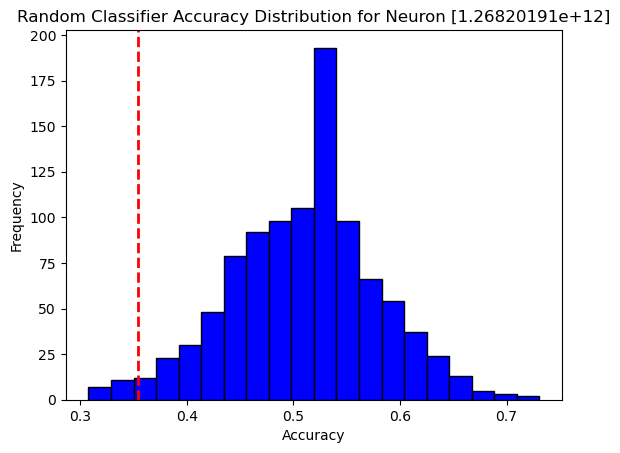


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 54.17%, p-value = 0.2700


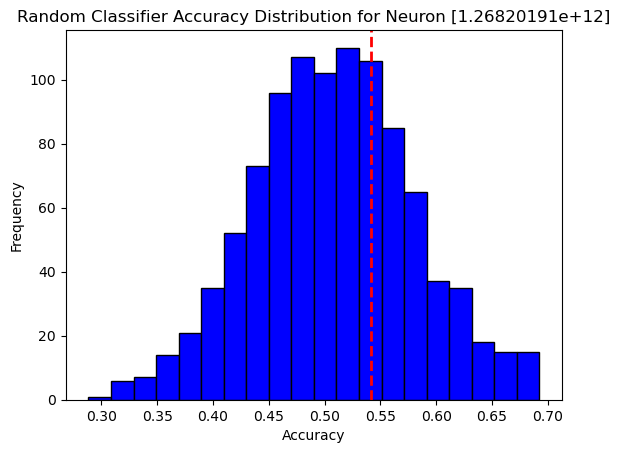


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 47.92%, p-value = 0.6890


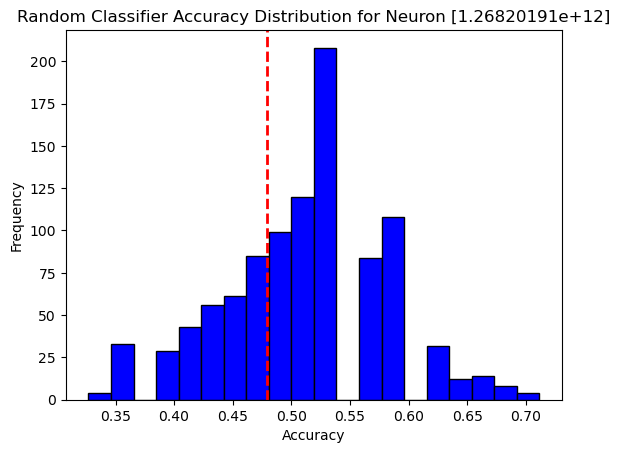


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 43.75%, p-value = 0.8610


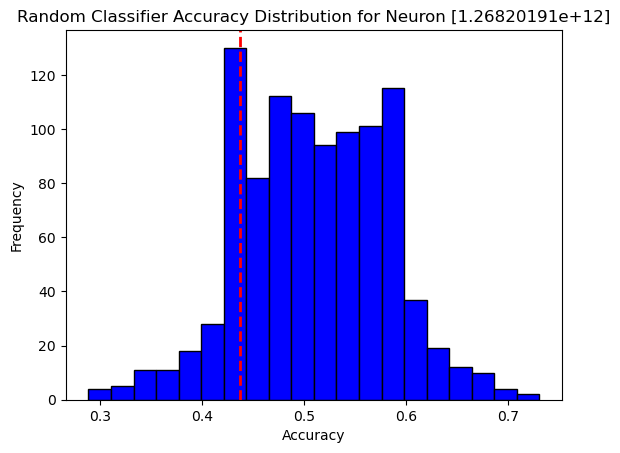


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 45.83%, p-value = 0.8110


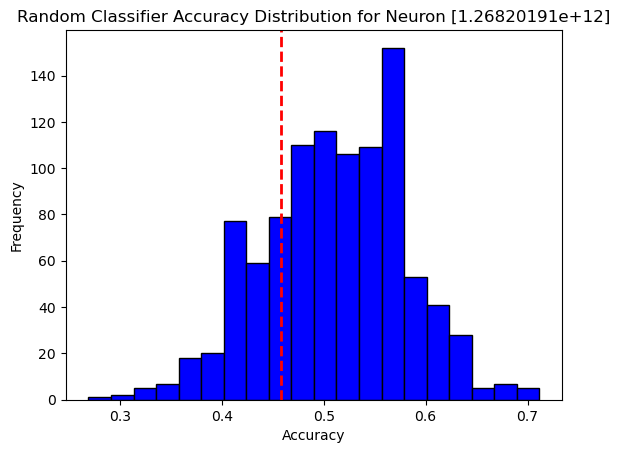


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 56.25%, p-value = 0.1880


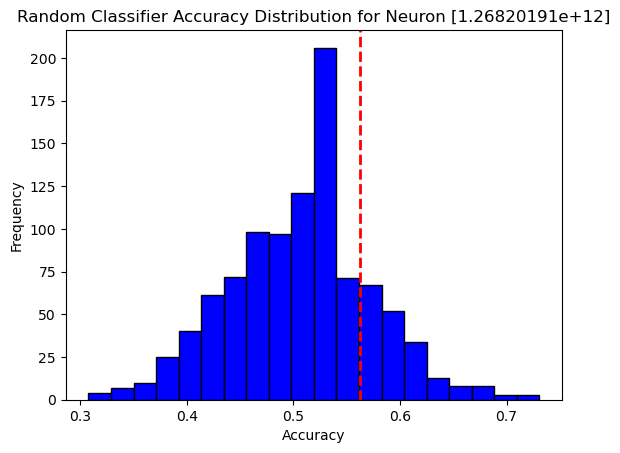


 [1.26820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.26820191e+12]: Test Accuracy = 43.75%, p-value = 0.8510


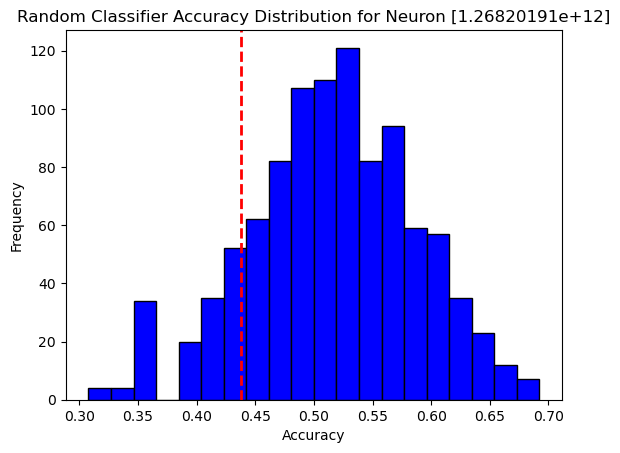


 [1.29820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.29820191e+12]: Test Accuracy = 46.88%, p-value = 0.7500


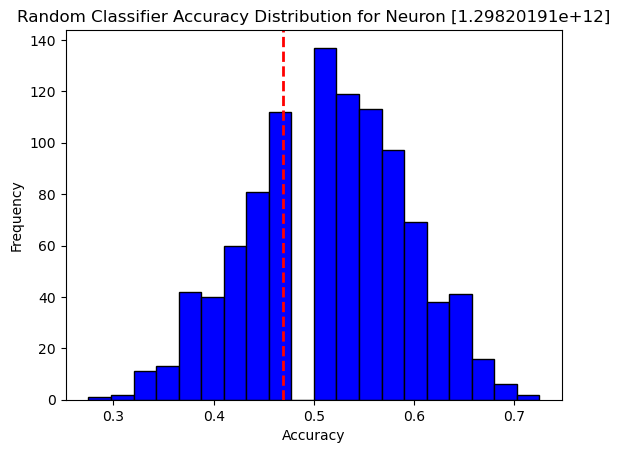


 [1.29820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.29820191e+12]: Test Accuracy = 50.00%, p-value = 0.6200


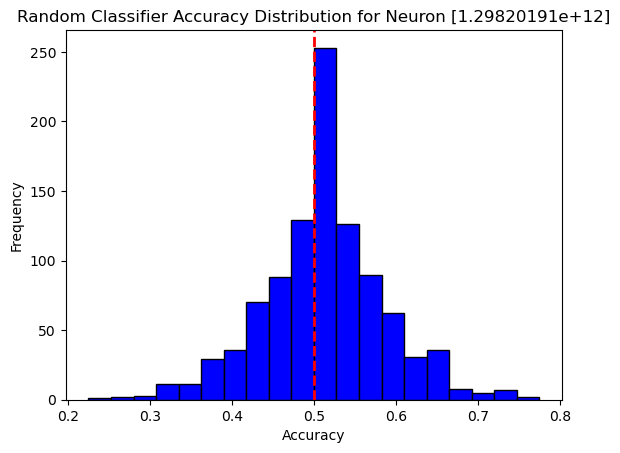


 [1.29820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.29820191e+12]: Test Accuracy = 31.25%, p-value = 1.0000


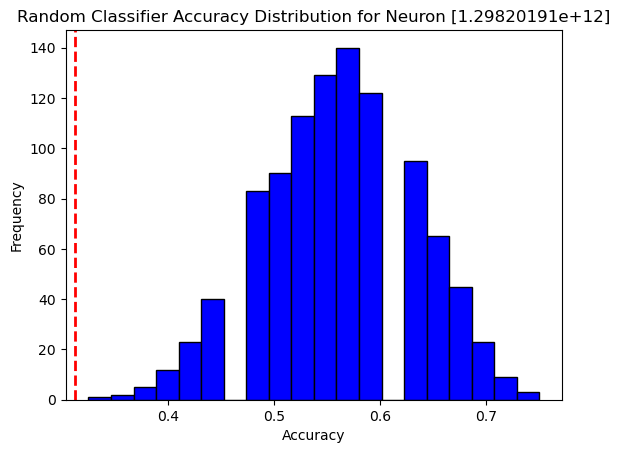


 [1.29820191e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [1.29820191e+12]: Test Accuracy = 51.56%, p-value = 0.4580


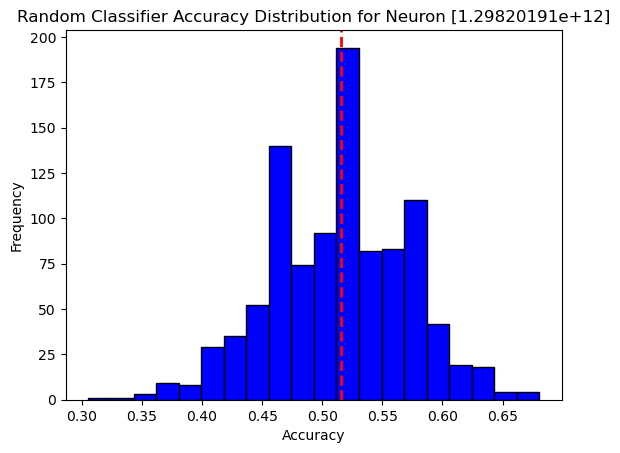


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 50.00%, p-value = 0.6090


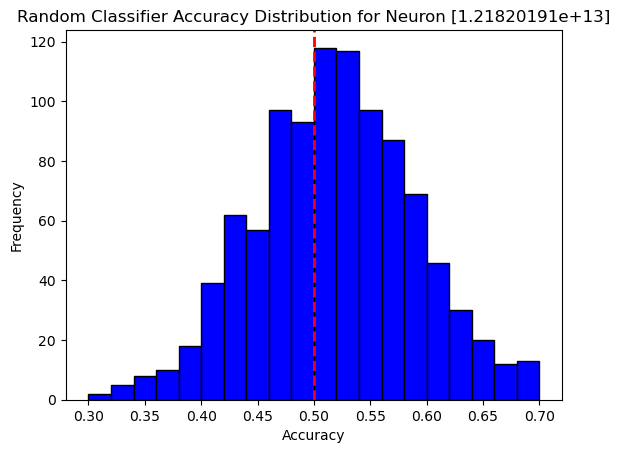


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 47.92%, p-value = 0.6970


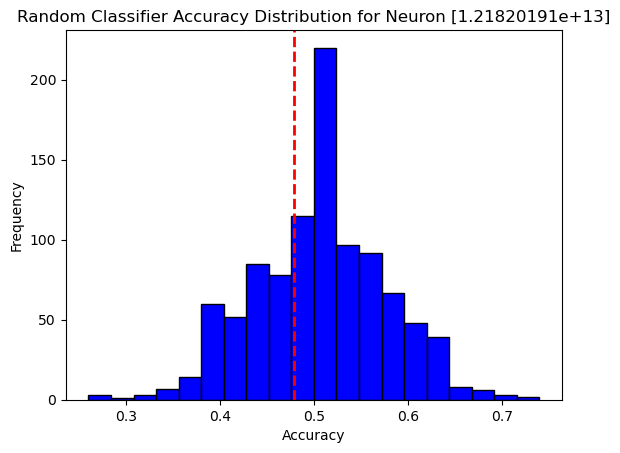


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 45.83%, p-value = 0.7990


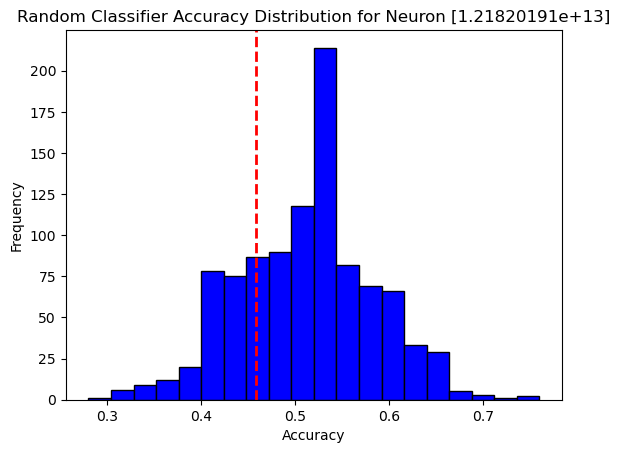


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 45.83%, p-value = 0.7690


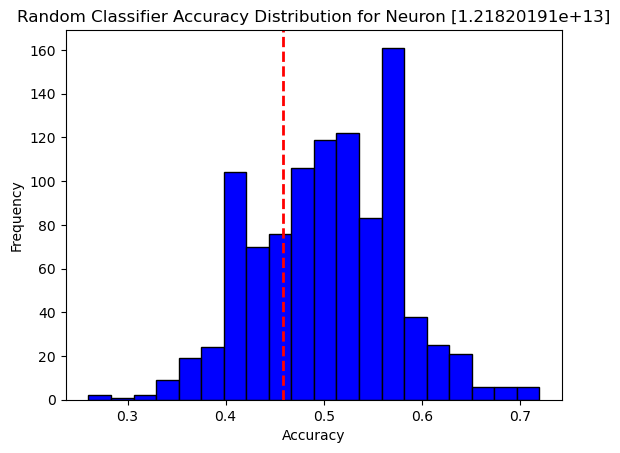


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.17%, p-value = 0.2770


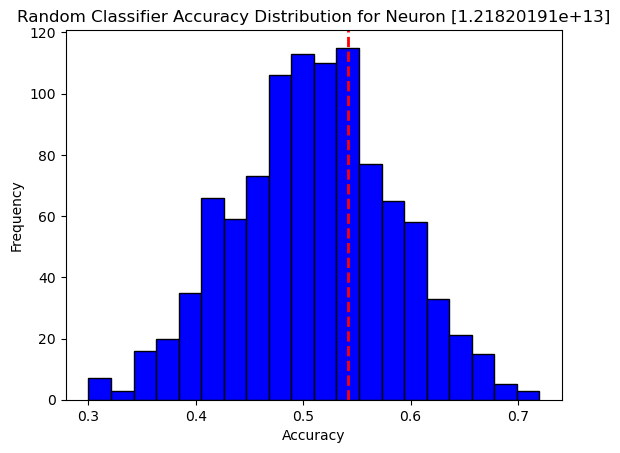


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 58.33%, p-value = 0.1220


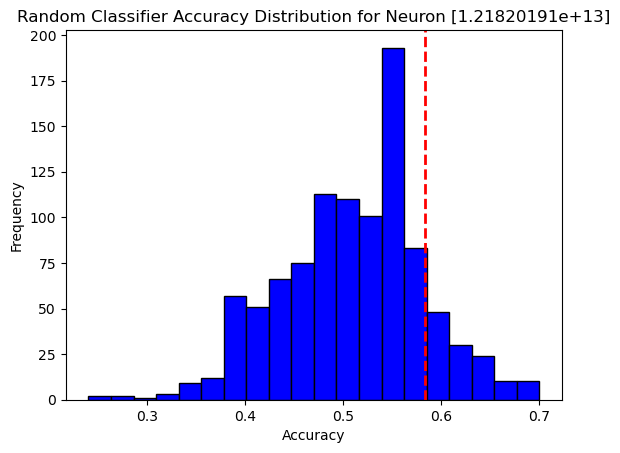


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9200


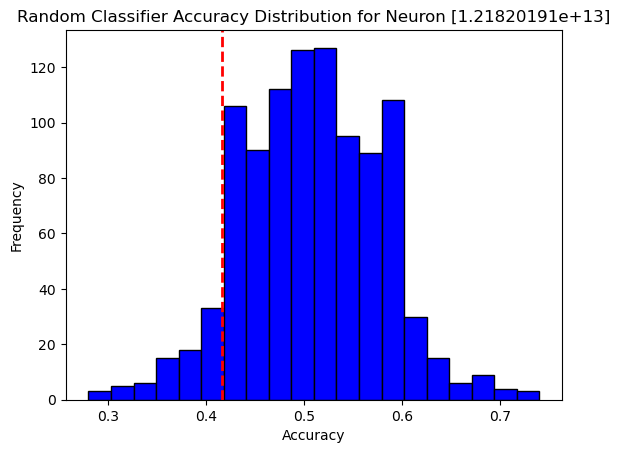


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 45.83%, p-value = 0.7900


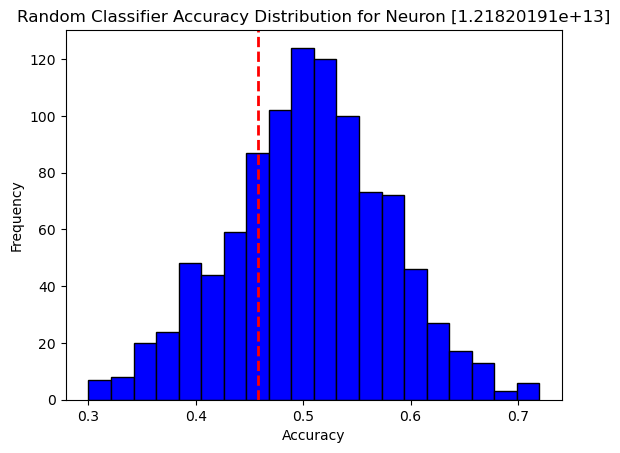


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9040


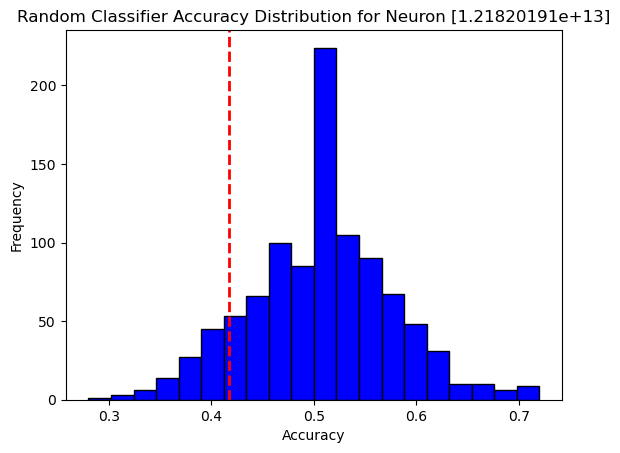


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.17%, p-value = 0.2610


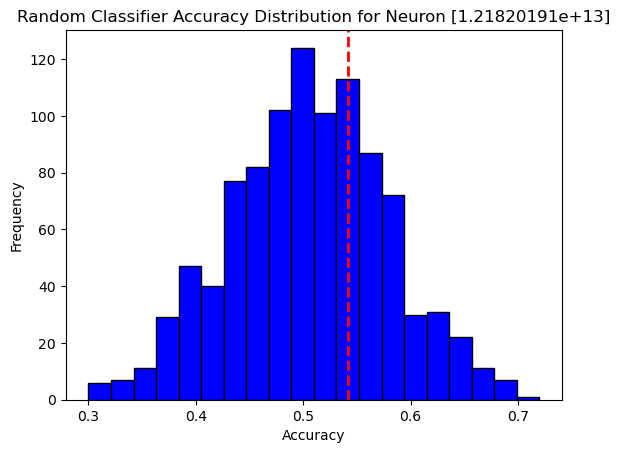


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 56.25%, p-value = 0.2060


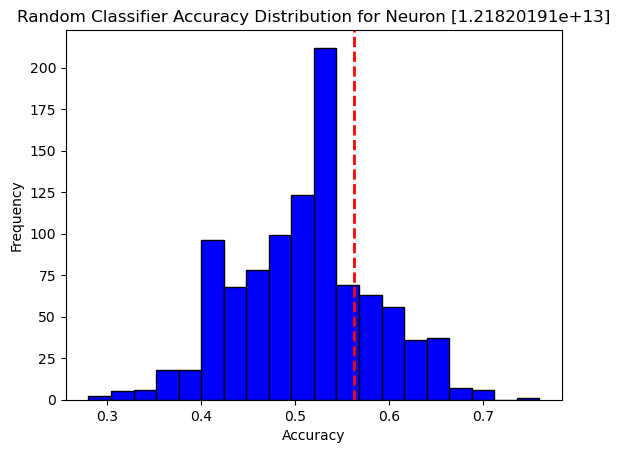


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9140


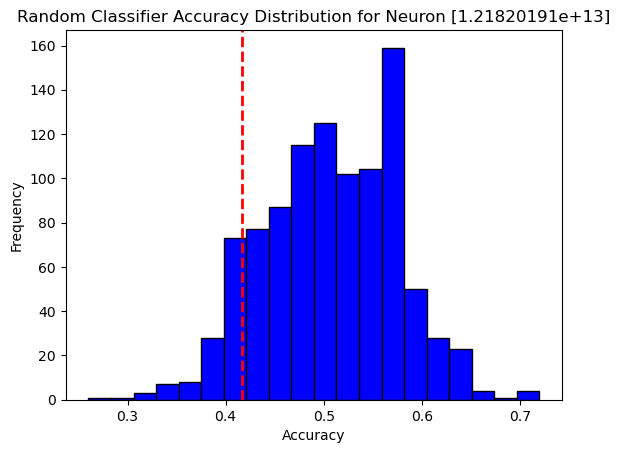


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 50.00%, p-value = 0.5760


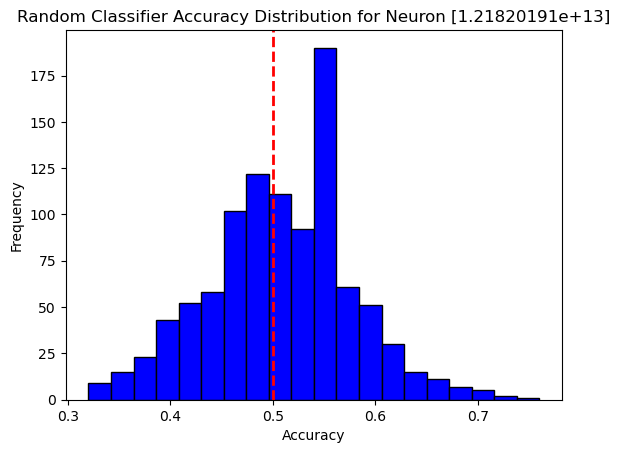


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.17%, p-value = 0.2430


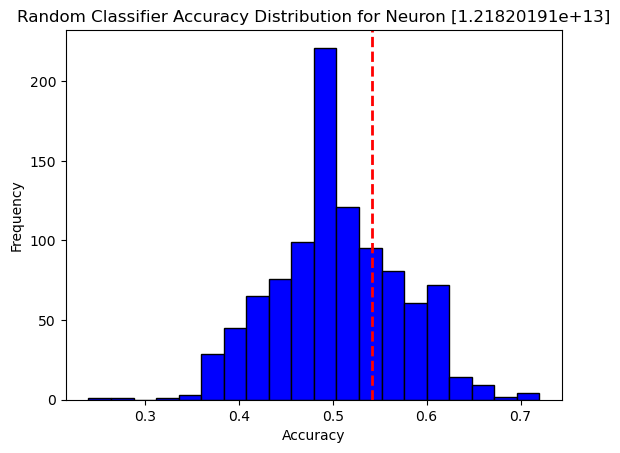


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9380


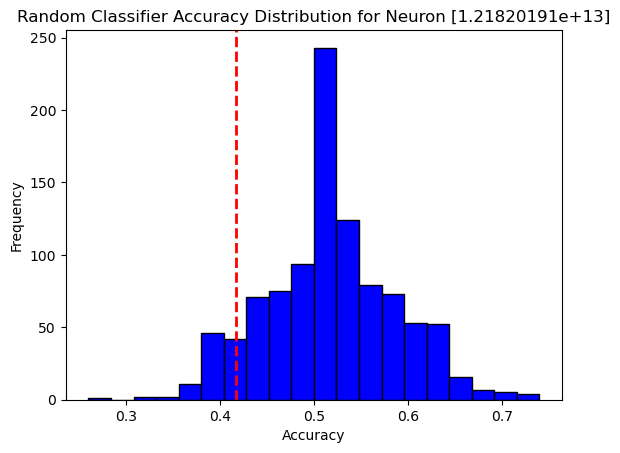


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 56.25%, p-value = 0.1870


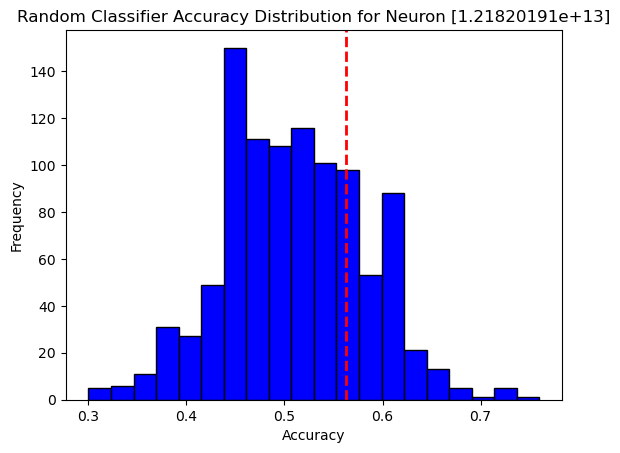


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9070


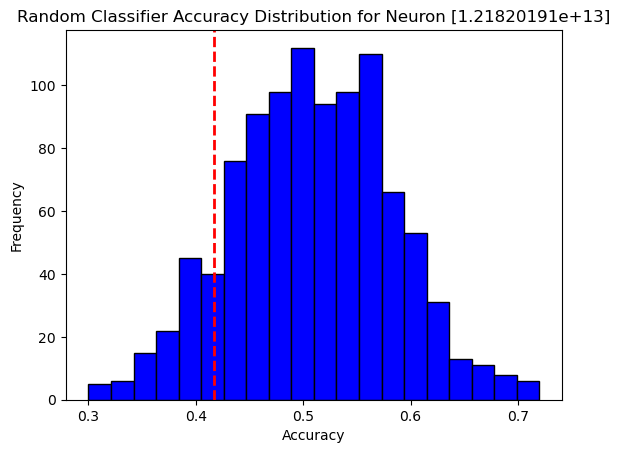


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 56.25%, p-value = 0.1860


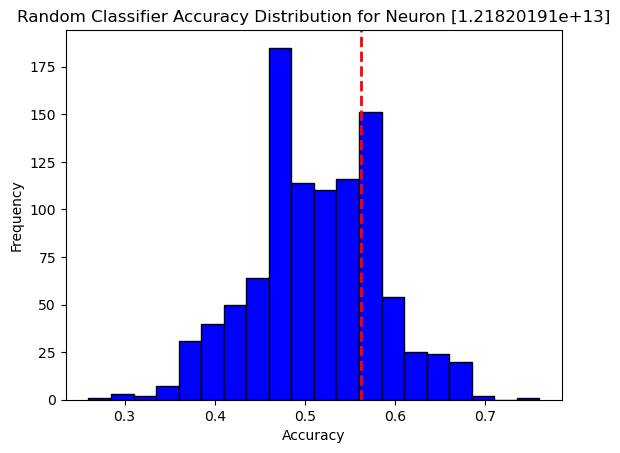


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 58.33%, p-value = 0.1440


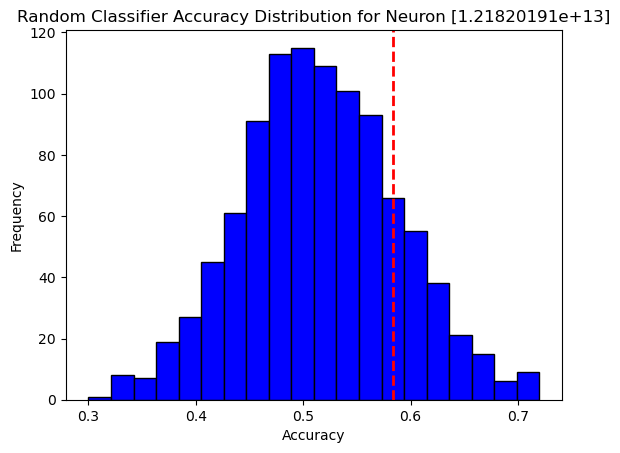


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9470


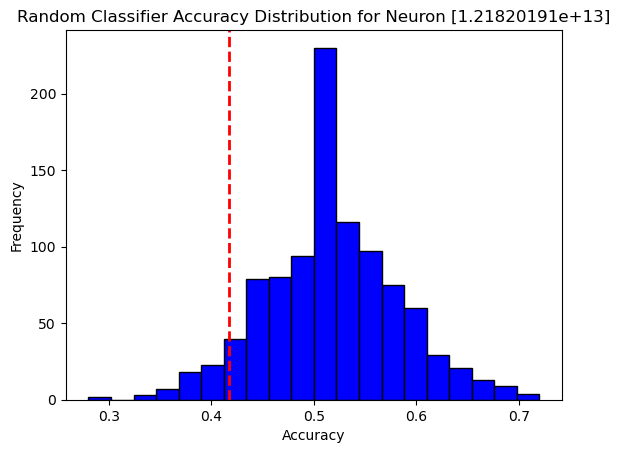


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 56.25%, p-value = 0.1930


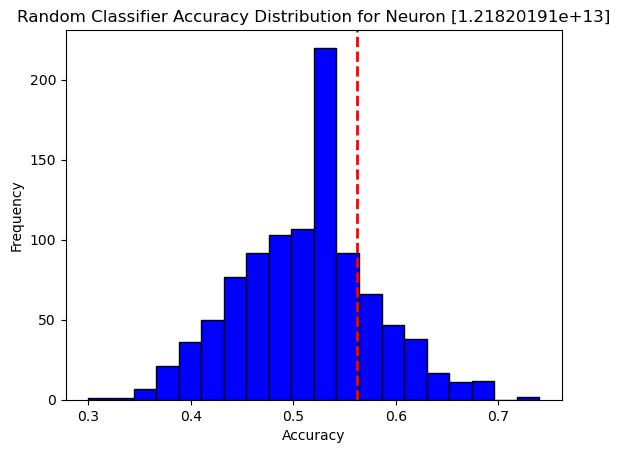


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 47.92%, p-value = 0.7620


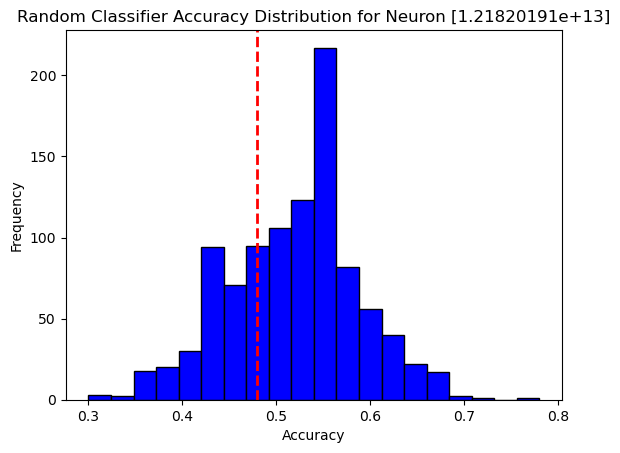


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 47.92%, p-value = 0.7260


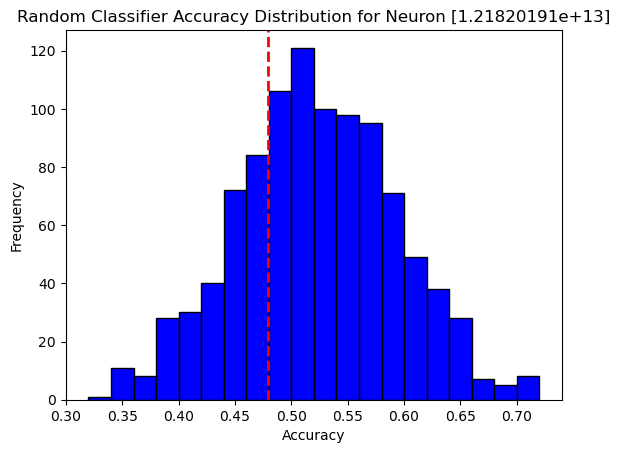


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9280


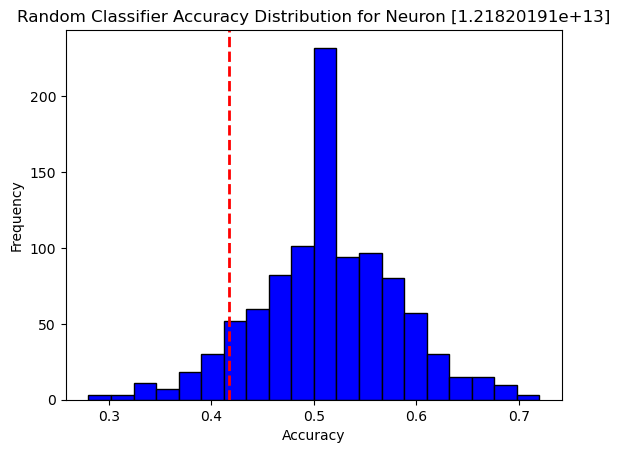


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 47.92%, p-value = 0.7250


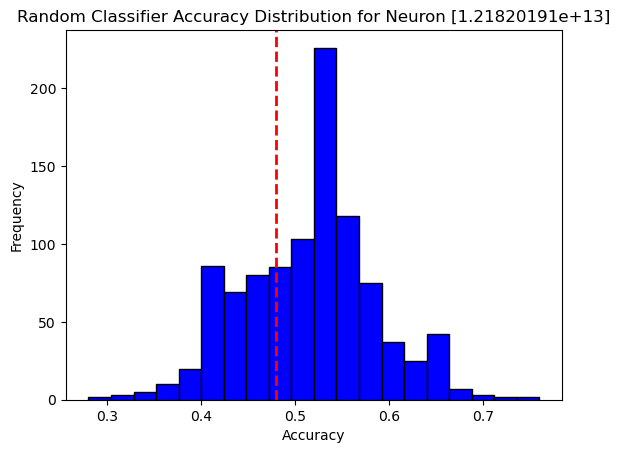


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 37.50%, p-value = 0.9860


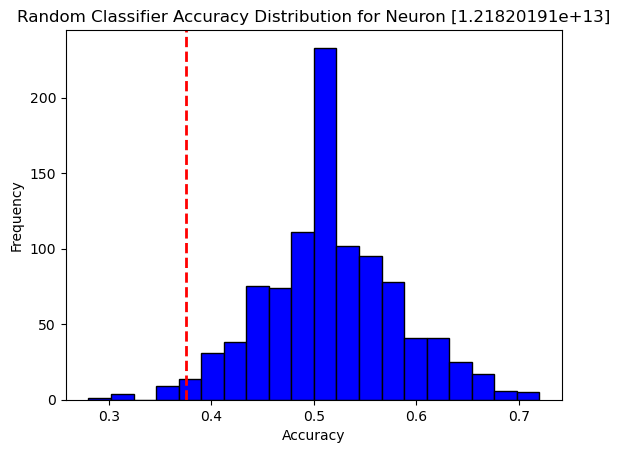


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 58.33%, p-value = 0.1260


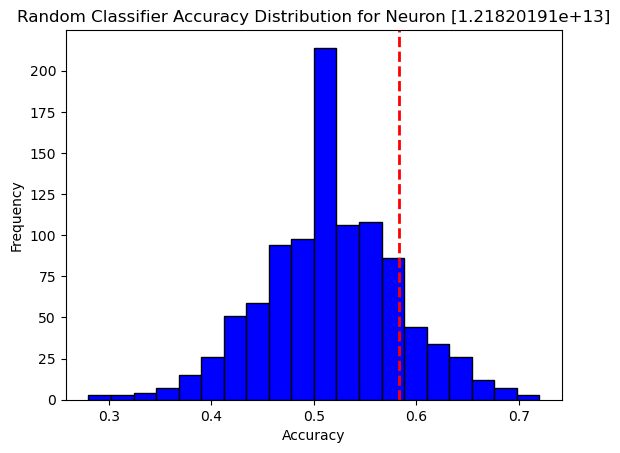


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 52.08%, p-value = 0.3880


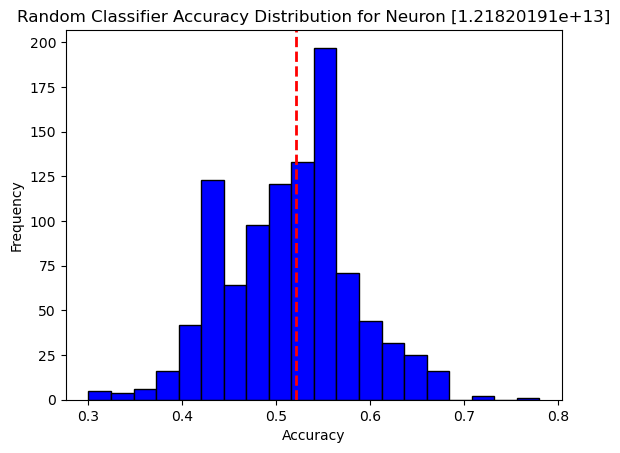


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9270


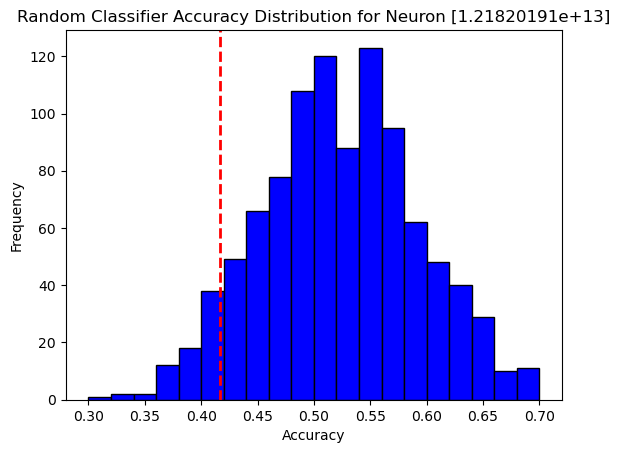


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 37.50%, p-value = 0.9750


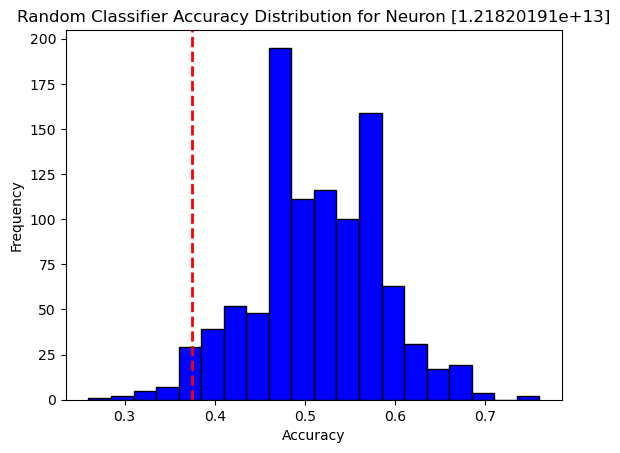


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 60.42%, p-value = 0.0830


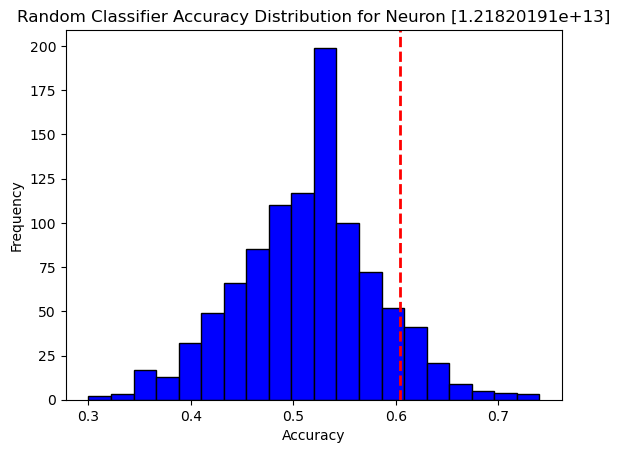


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 56.25%, p-value = 0.2100


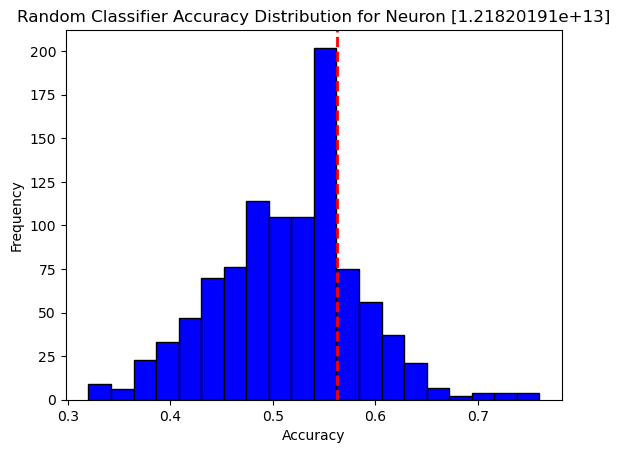


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.17%, p-value = 0.3230


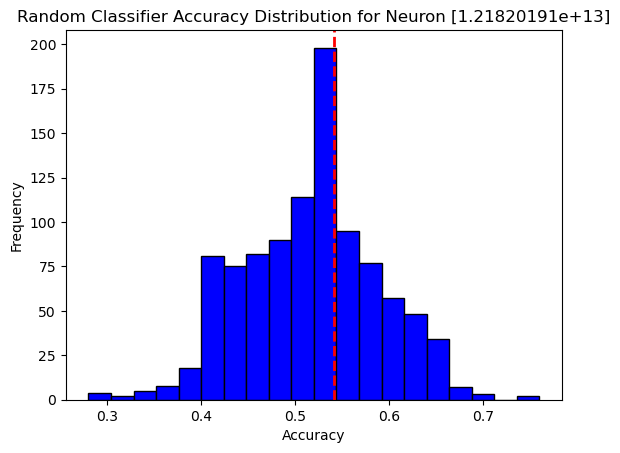


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 52.08%, p-value = 0.4200


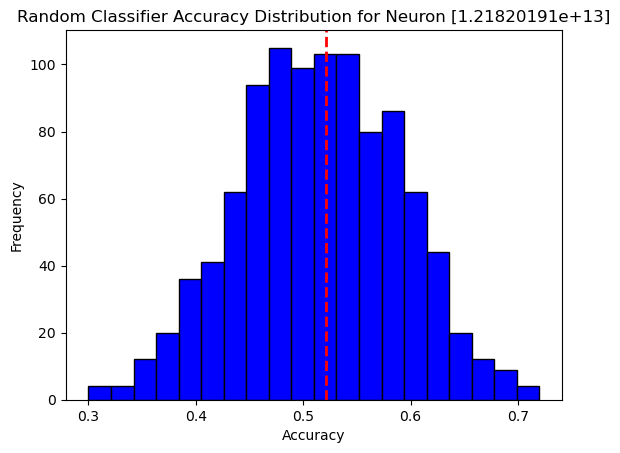


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 43.75%, p-value = 0.8870


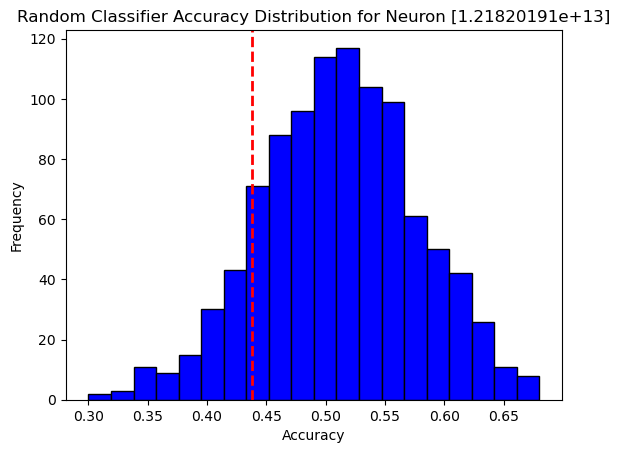


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 43.75%, p-value = 0.9010


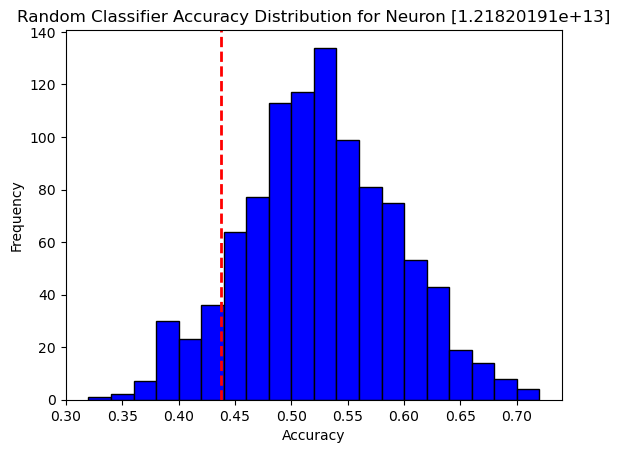


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 39.58%, p-value = 0.9550


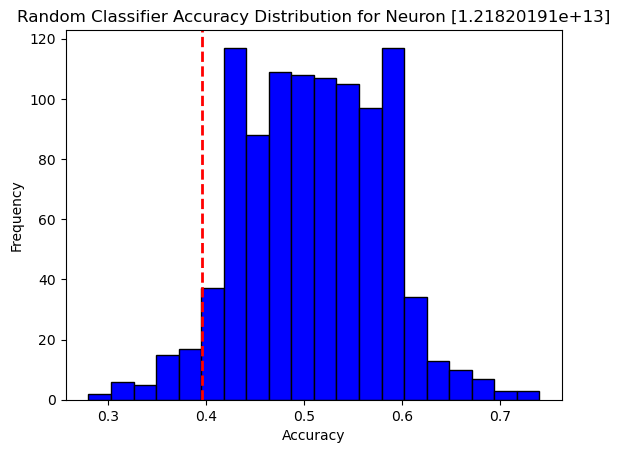


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9200


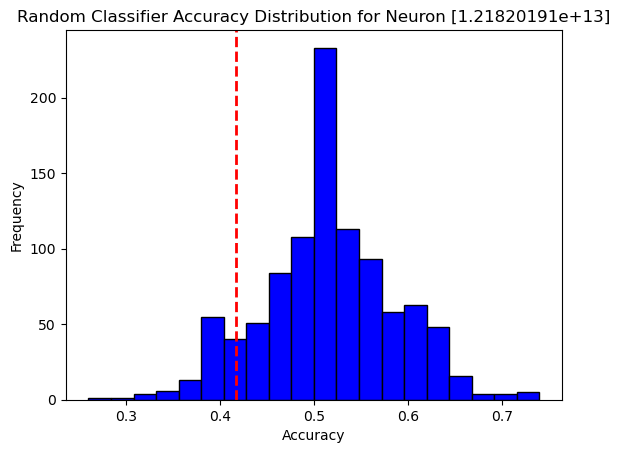


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 35.42%, p-value = 0.9940


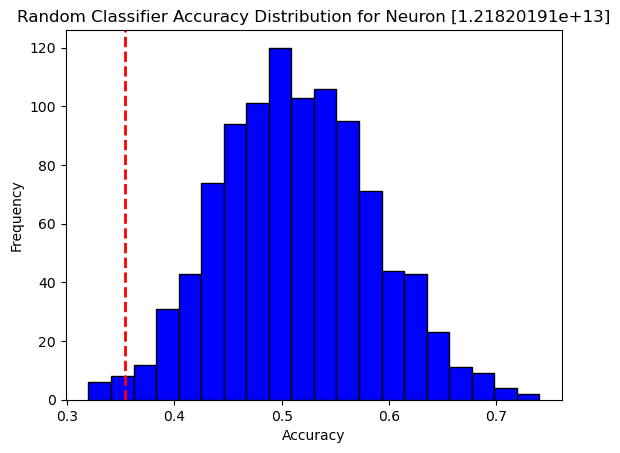


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 58.33%, p-value = 0.1390


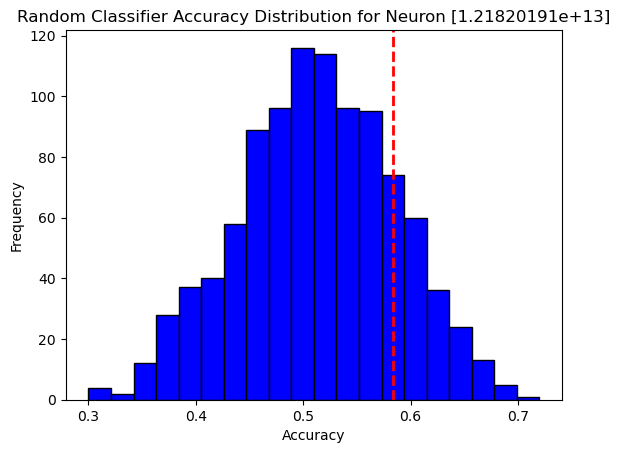


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 41.67%, p-value = 0.9210


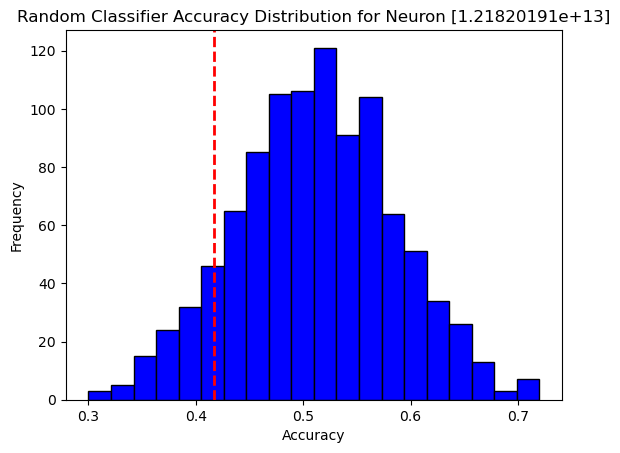


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 53.12%, p-value = 0.3580


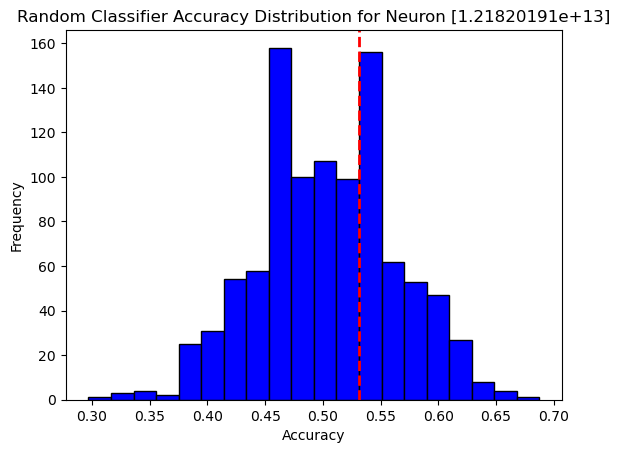


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.69%, p-value = 0.3090


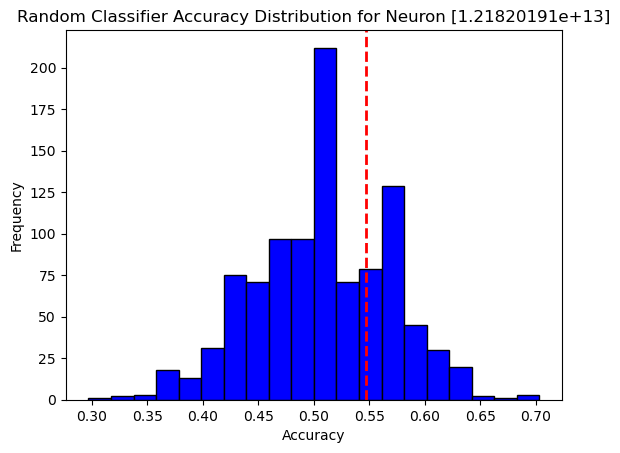


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 51.56%, p-value = 0.4510


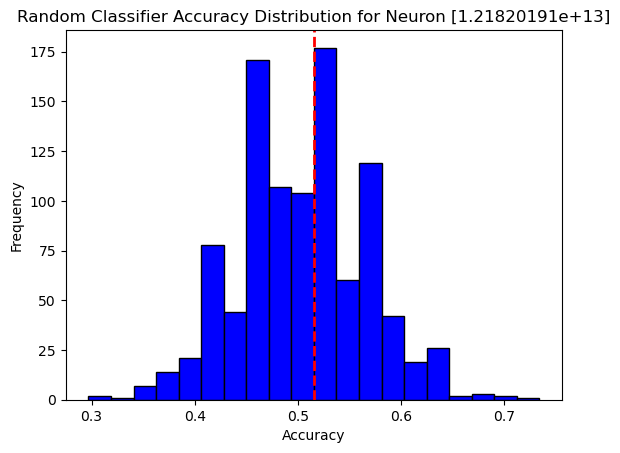


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 53.12%, p-value = 0.3670


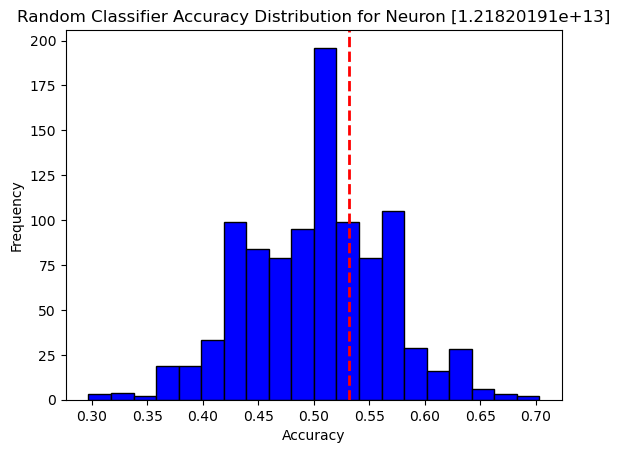


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 50.00%, p-value = 0.5710


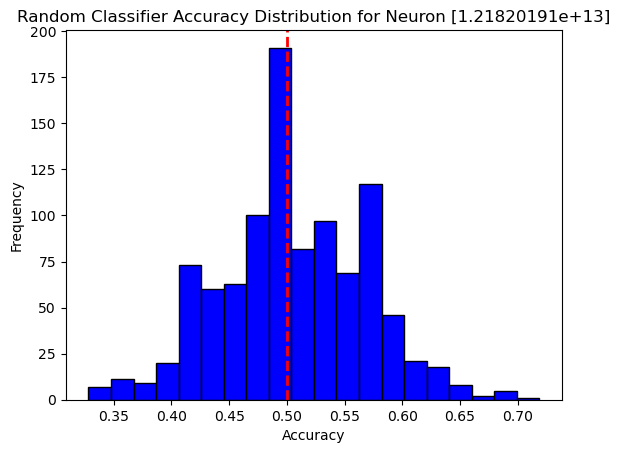


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 51.56%, p-value = 0.4710


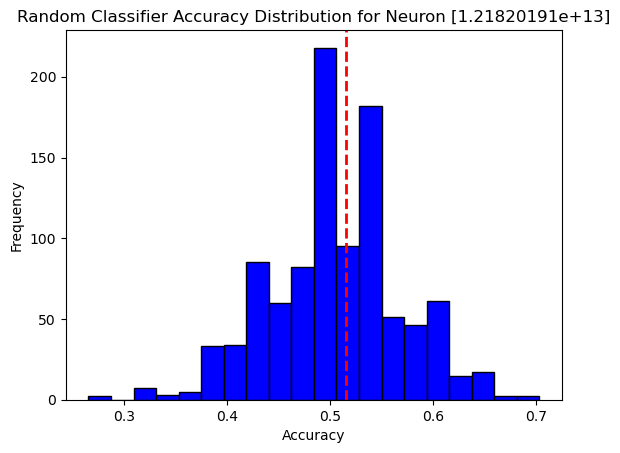


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 45.31%, p-value = 0.8250


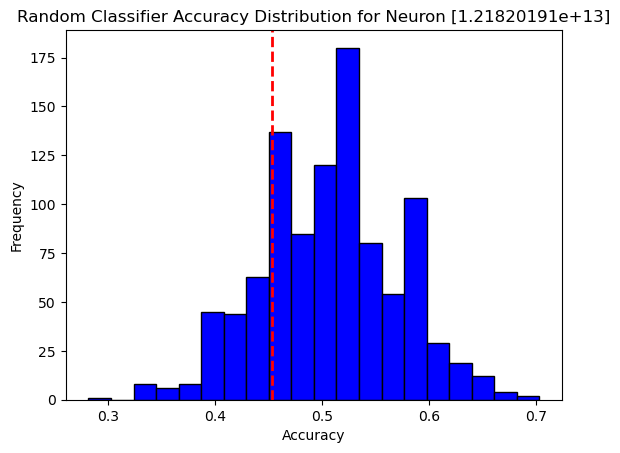


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 54.69%, p-value = 0.2850


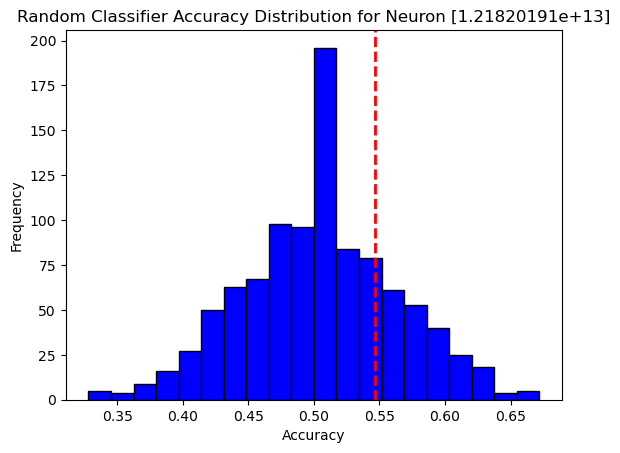


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 57.81%, p-value = 0.1240


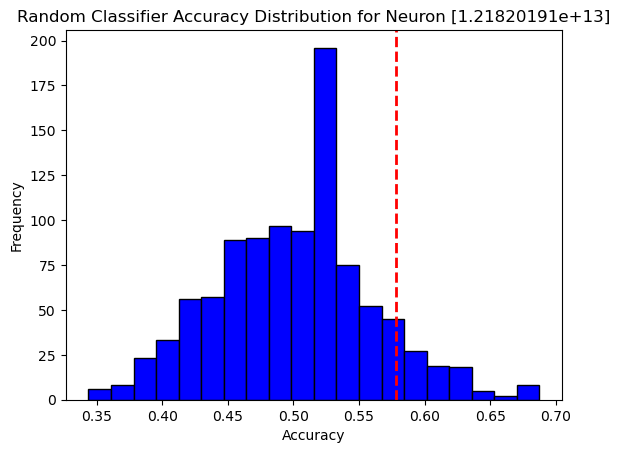


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 46.88%, p-value = 0.7390


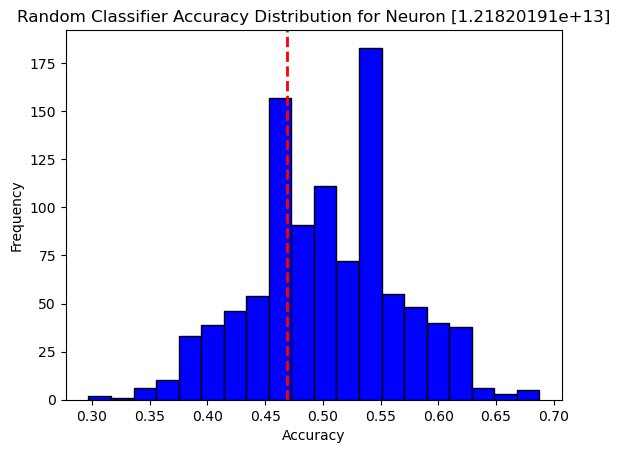


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [1.21820191e+13]: Test Accuracy = 51.56%, p-value = 0.4270


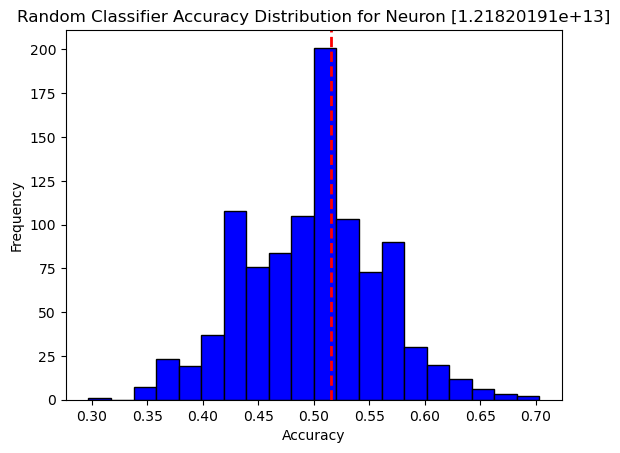


 [1.21820191e+13] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 56.25%, p-value = 0.1530


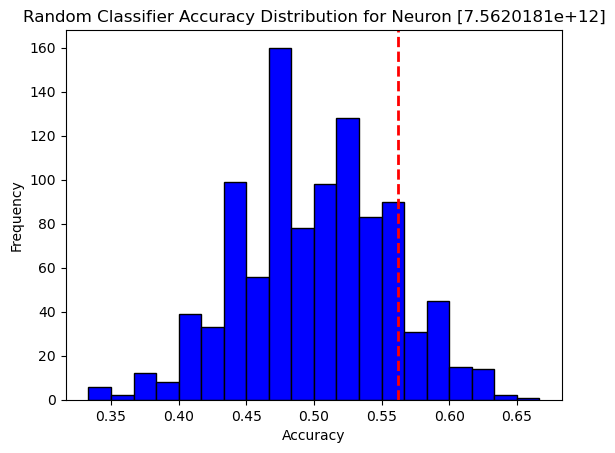


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 53.75%, p-value = 0.2450


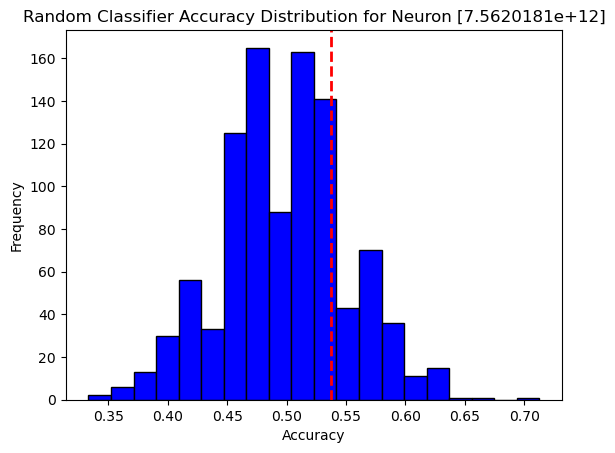


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 0.8520


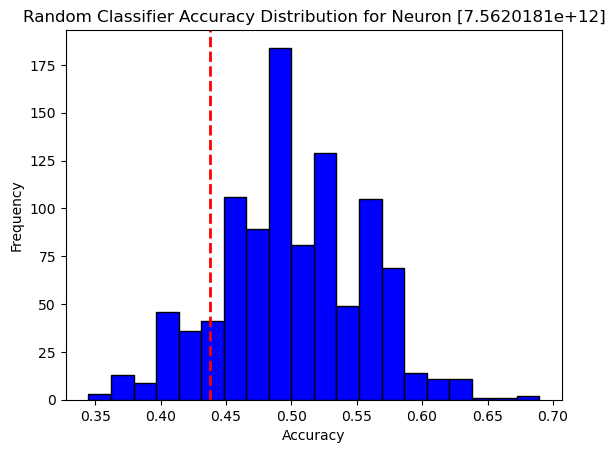


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.00%, p-value = 0.5010


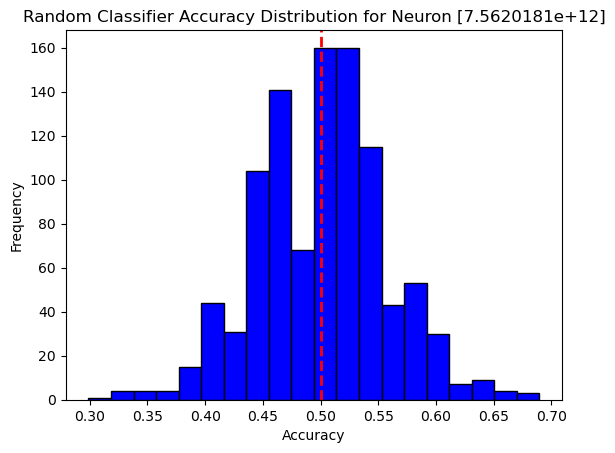


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 56.25%, p-value = 0.1640


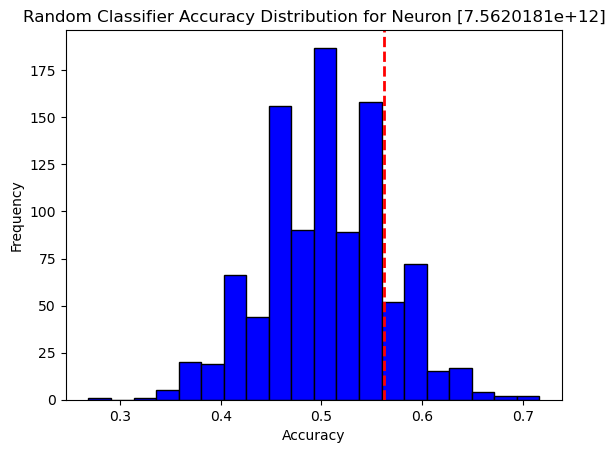


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.08%, p-value = 0.4280


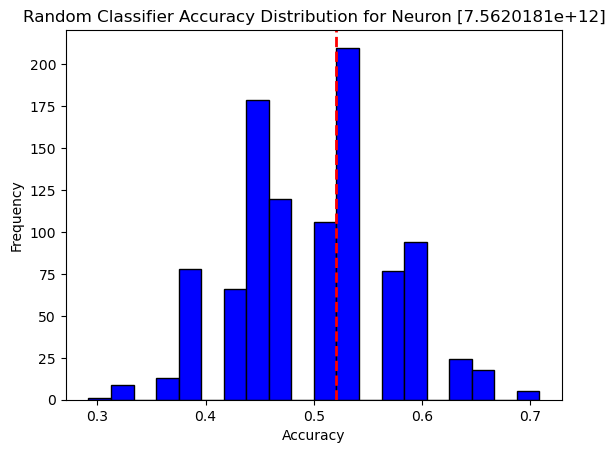


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 45.83%, p-value = 0.6550


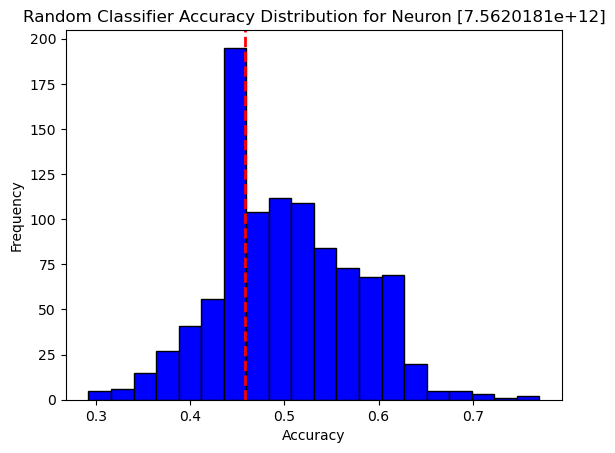


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 41.67%, p-value = 0.9100


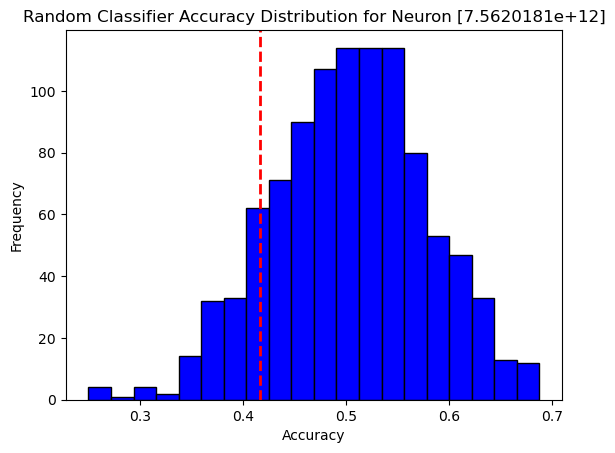


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6740


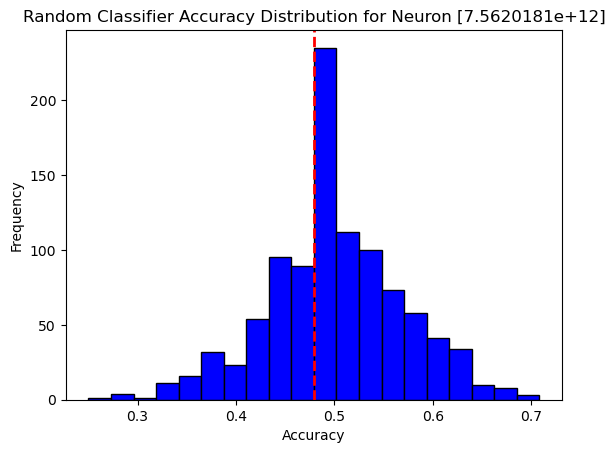


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6450


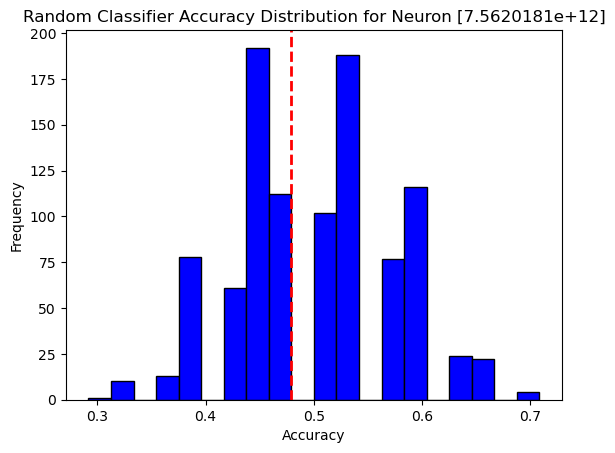


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6870


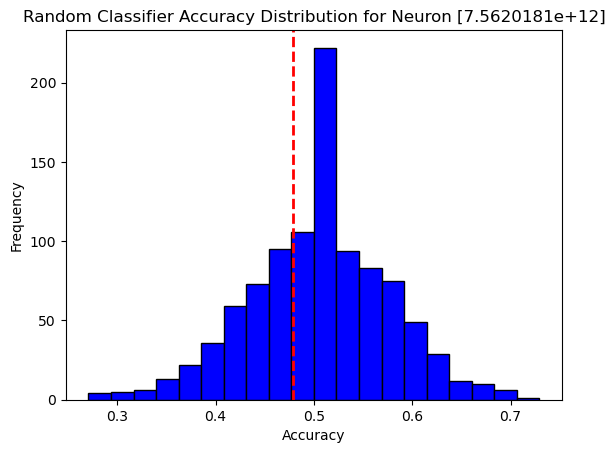


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 55.21%, p-value = 0.1920


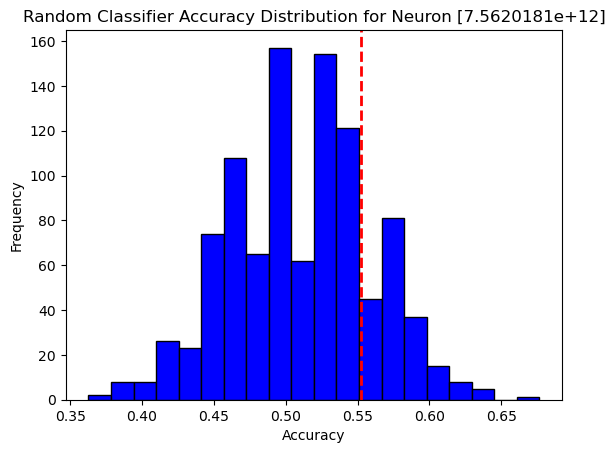


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 57.29%, p-value = 0.0910


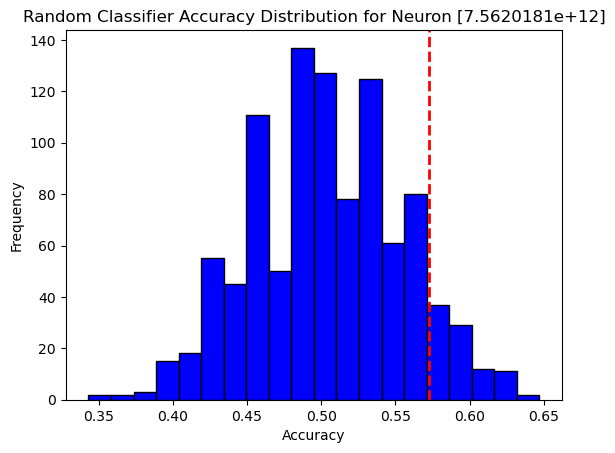


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 41.67%, p-value = 0.9700


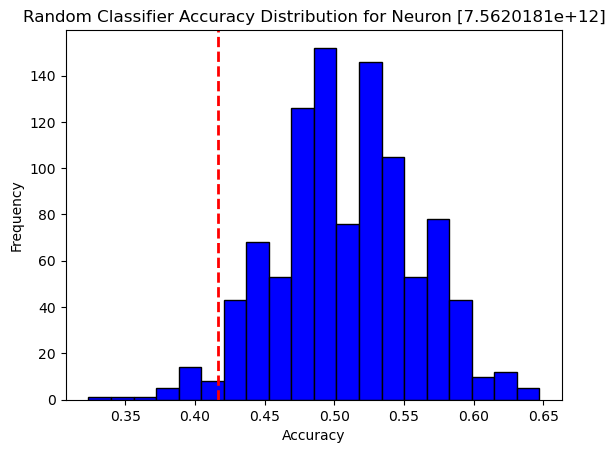


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 42.71%, p-value = 0.9590


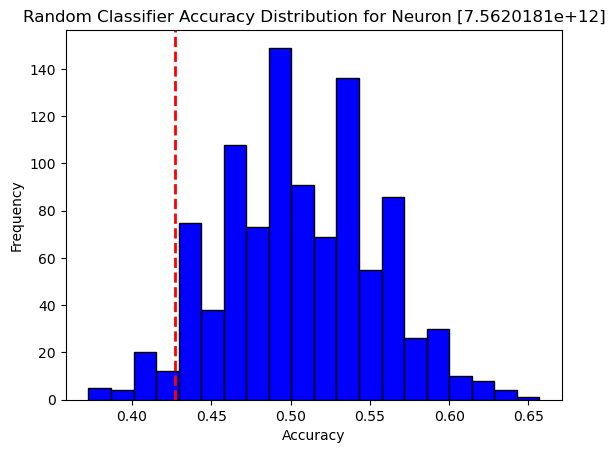


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.00%, p-value = 0.5470


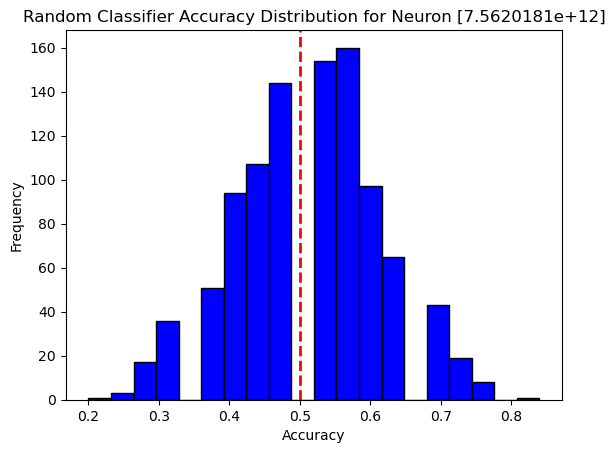


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 37.50%, p-value = 0.9100


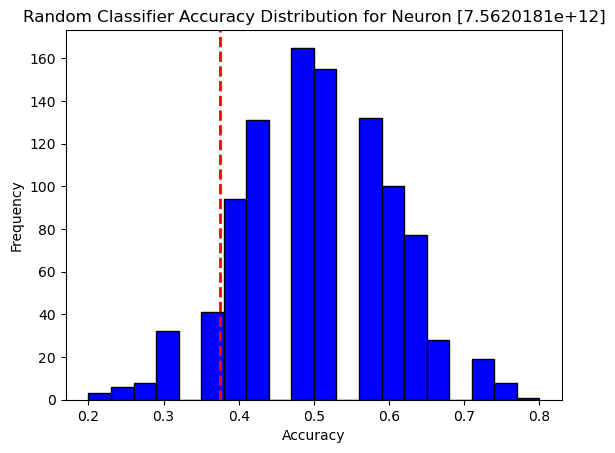


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 0.8150


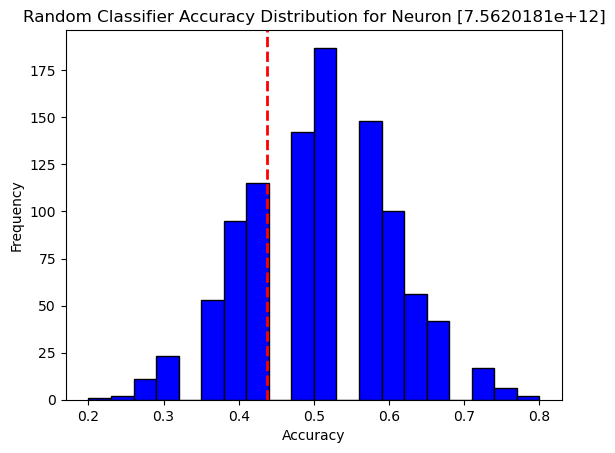


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 56.25%, p-value = 0.2260


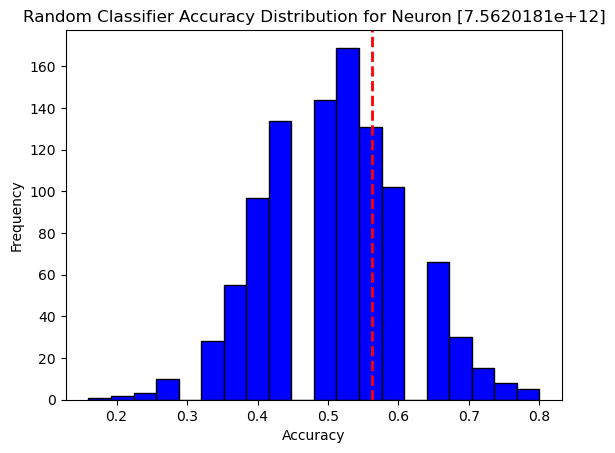


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.00%, p-value = 0.5310


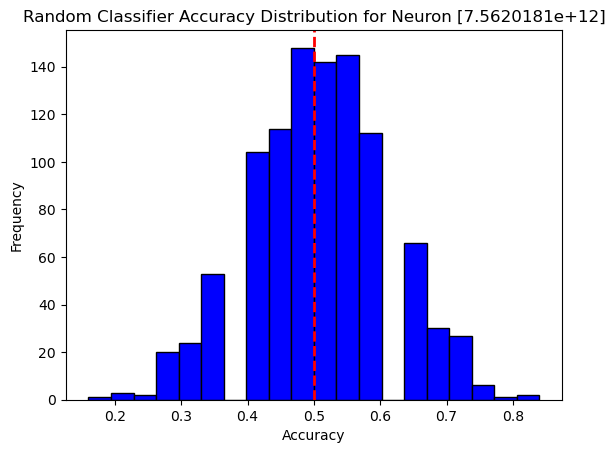


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 43.75%, p-value = 0.8100


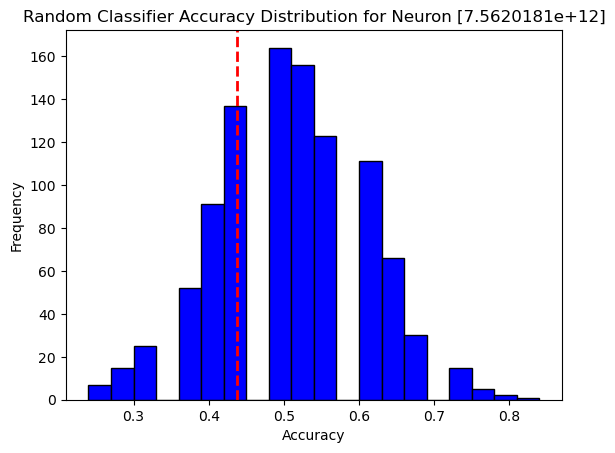


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 62.50%, p-value = 0.1450


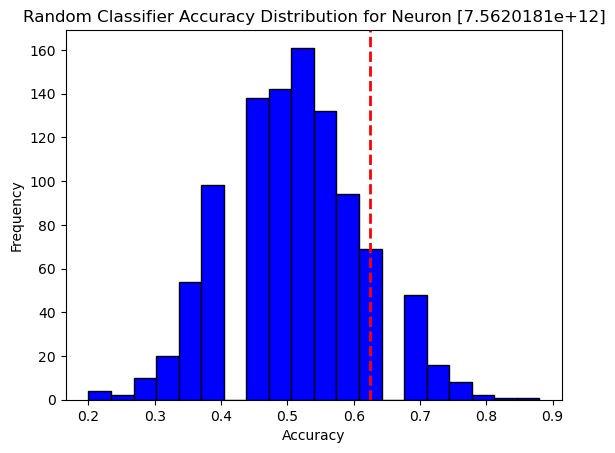


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 40.62%, p-value = 0.9310


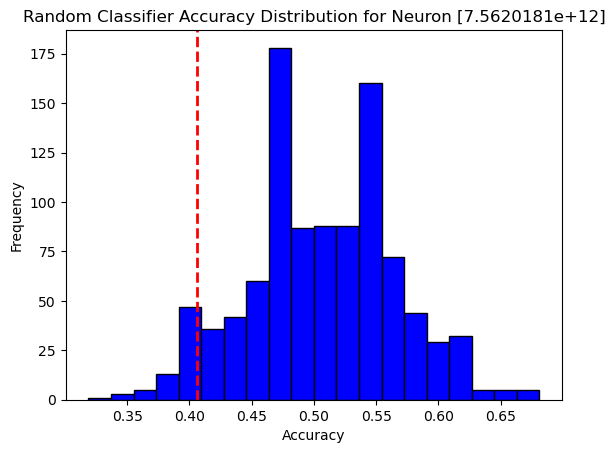


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 46.88%, p-value = 0.6670


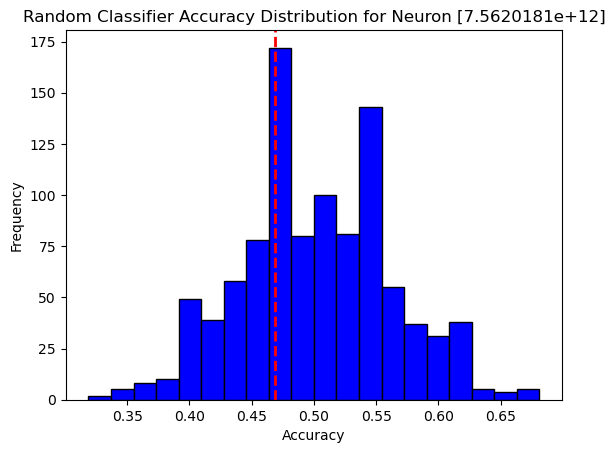


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 51.56%, p-value = 0.3900


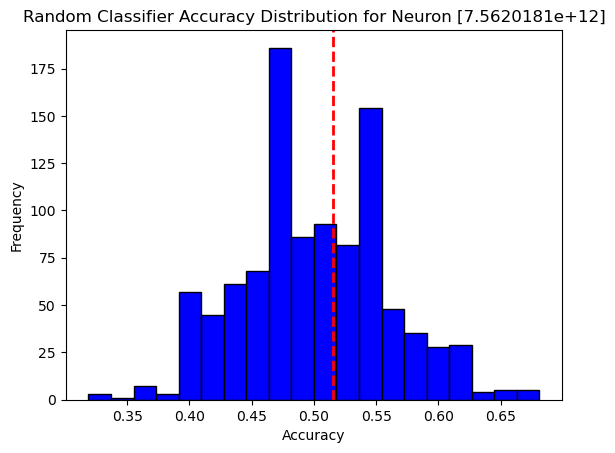


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.50%, p-value = 0.7310


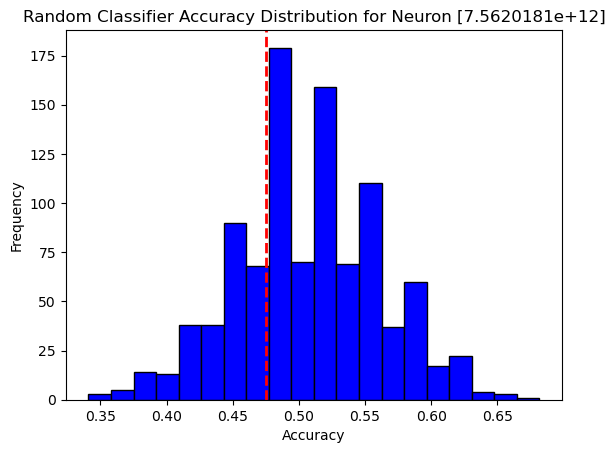


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 57.50%, p-value = 0.0600


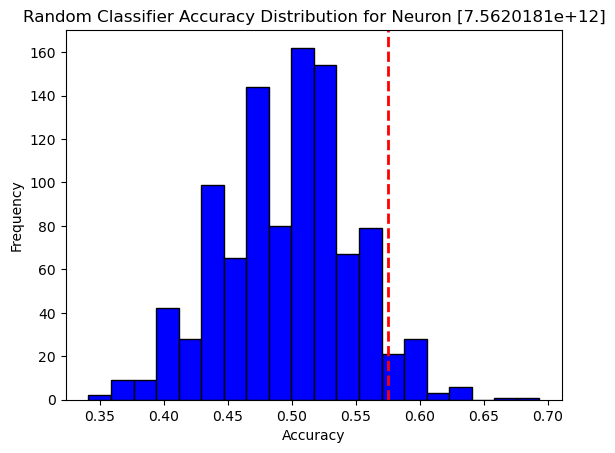


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.50%, p-value = 0.3210


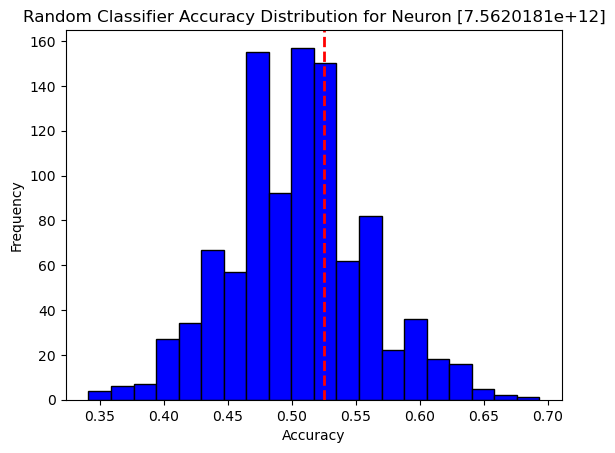


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 45.00%, p-value = 0.8520


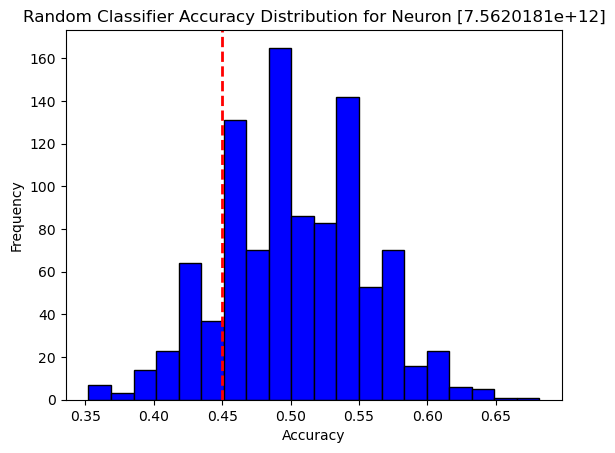


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 46.25%, p-value = 0.7740


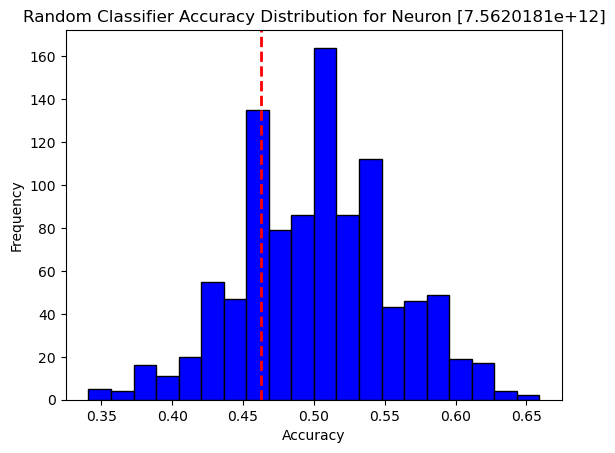


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.50%, p-value = 0.3130


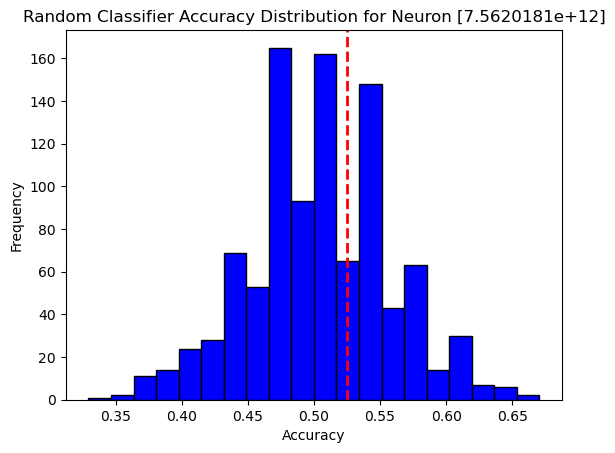


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 48.75%, p-value = 0.6270


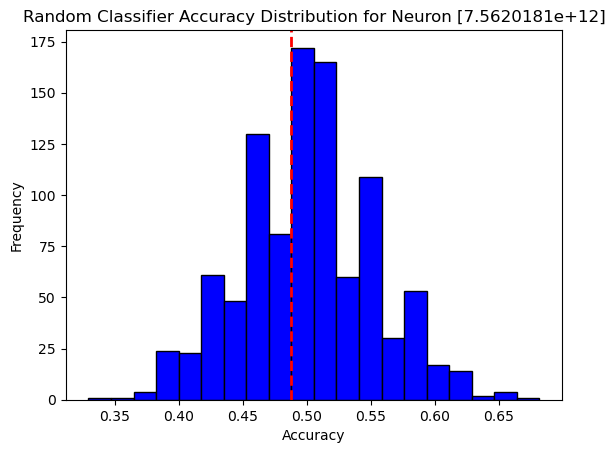


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 47.92%, p-value = 0.6000


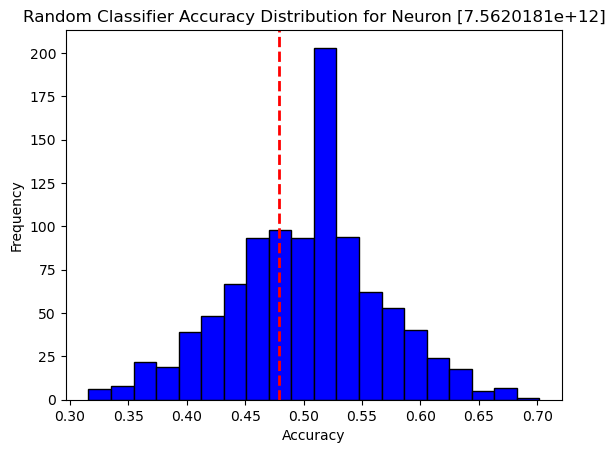


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 58.33%, p-value = 0.0910


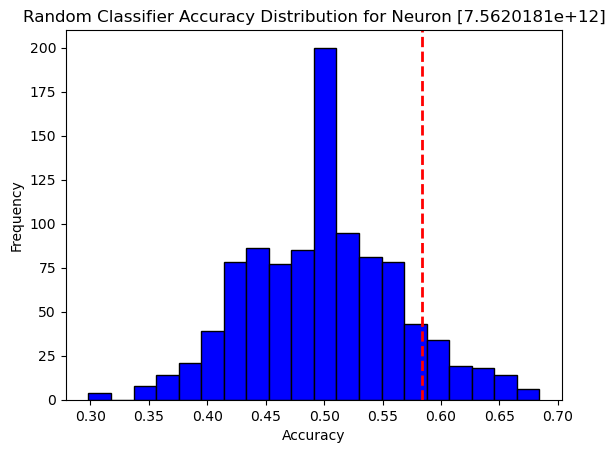


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 54.17%, p-value = 0.3020


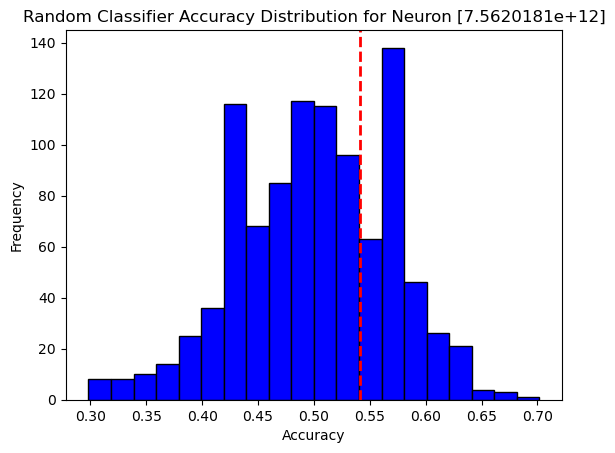


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 54.17%, p-value = 0.3110


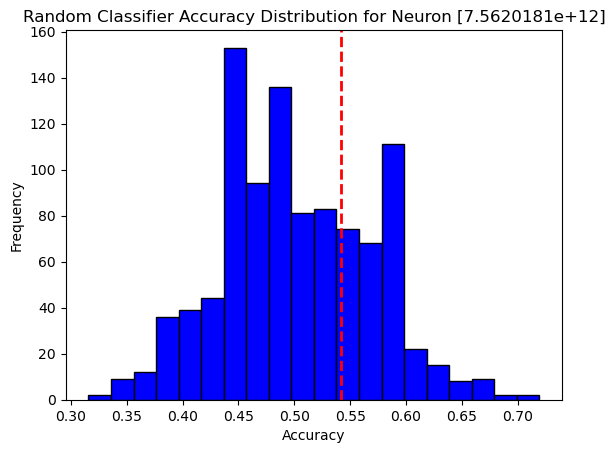


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.00%, p-value = 0.5210


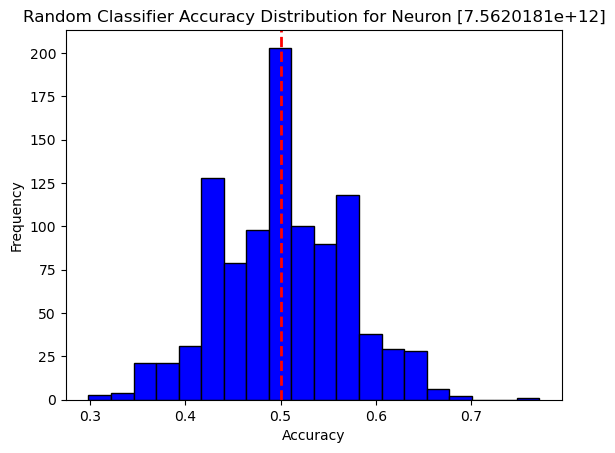


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 52.08%, p-value = 0.4140


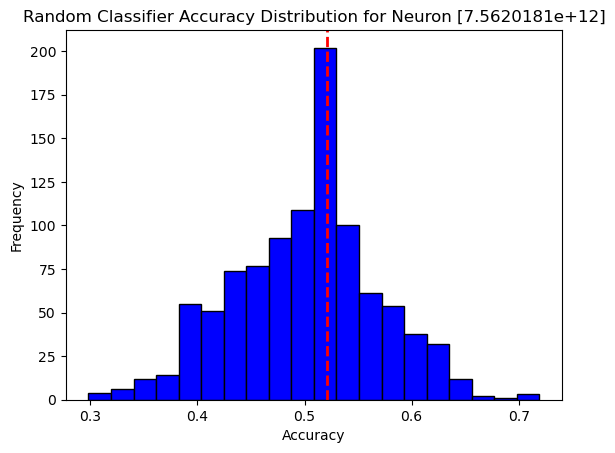


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 50.00%, p-value = 0.4900


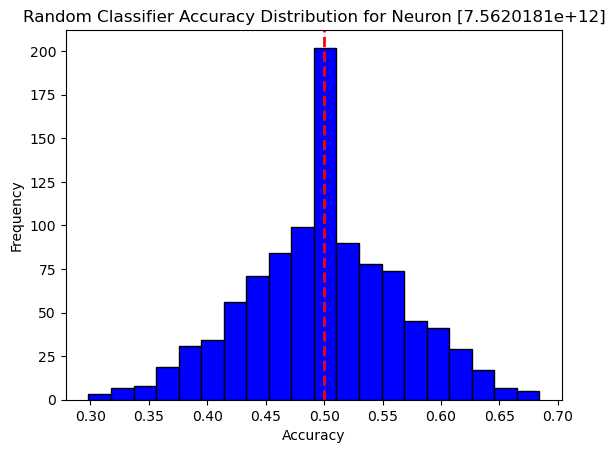


 [7.5620181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+12]: Test Accuracy = 45.83%, p-value = 0.7120


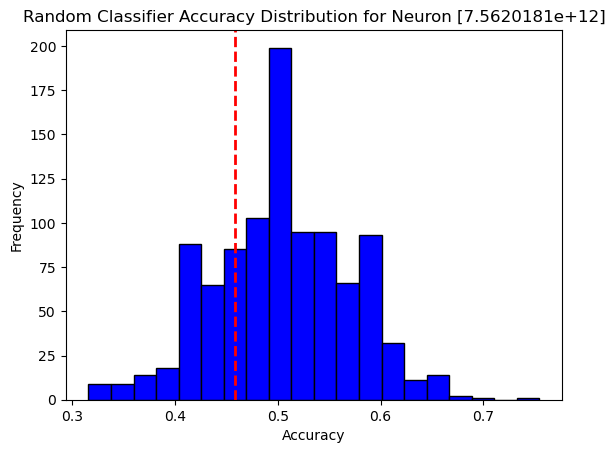

Brain Area: PPC, Analysis Type: LICK
Num of neurons before filter= 129

 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 51.04%, p-value = 1.0000


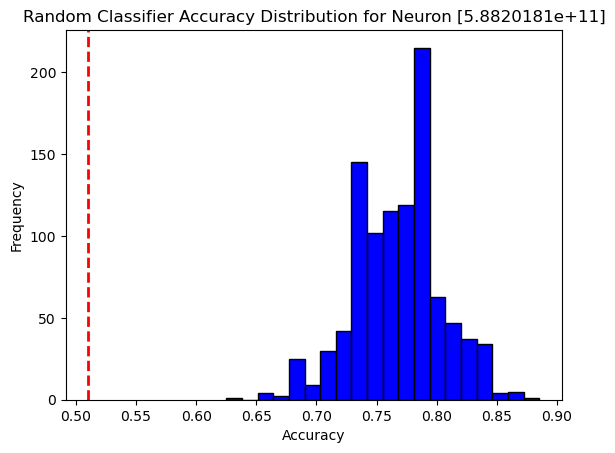


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 59.38%, p-value = 1.0000


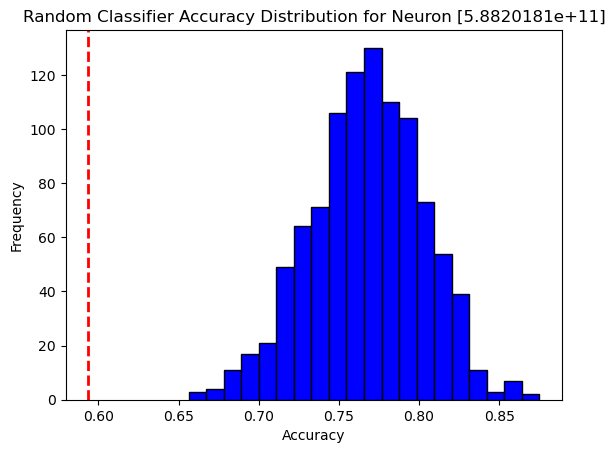


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 63.54%, p-value = 1.0000


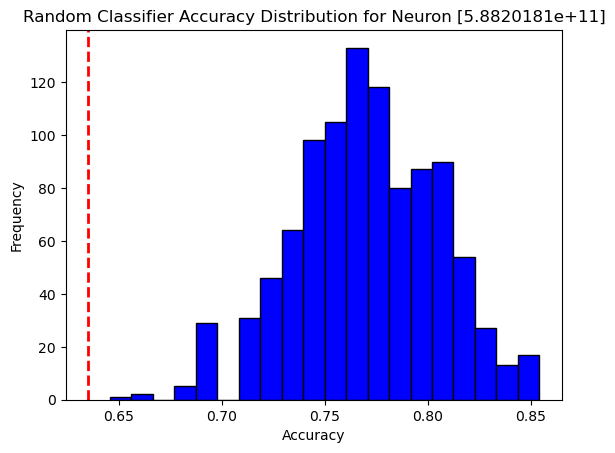


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 36.46%, p-value = 1.0000


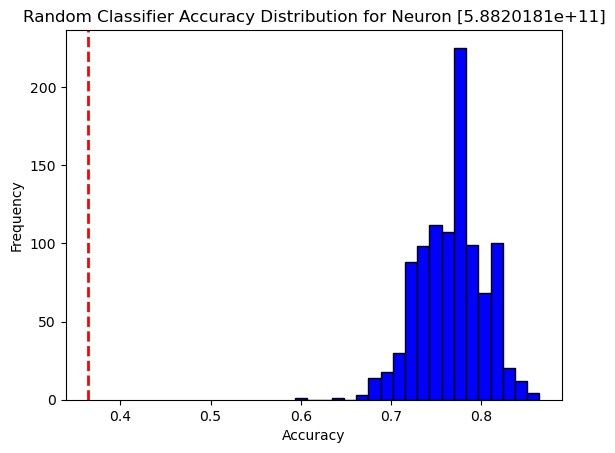


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 12.50%, p-value = 1.0000


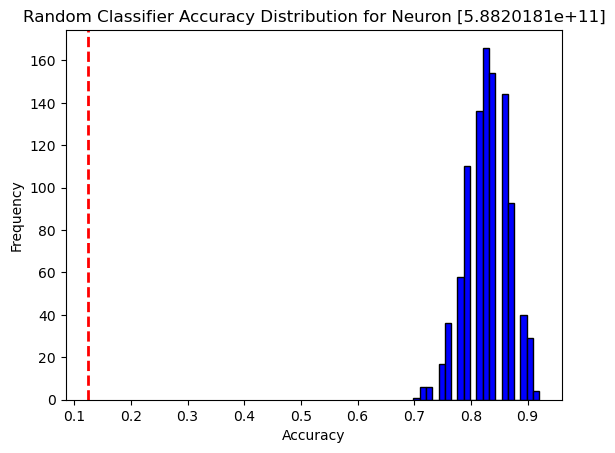


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 70.83%, p-value = 0.9990


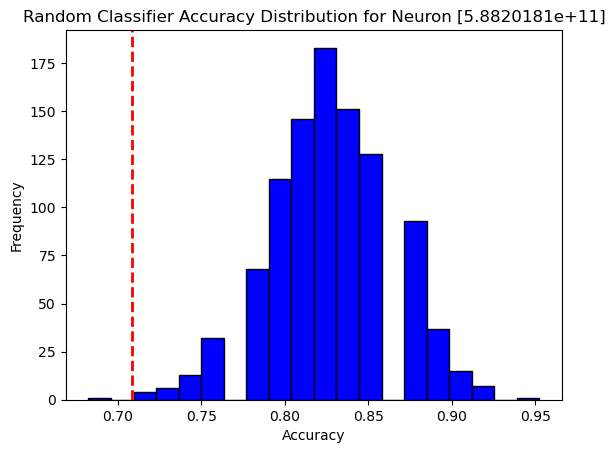


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+11]: Test Accuracy = 61.46%, p-value = 0.9140


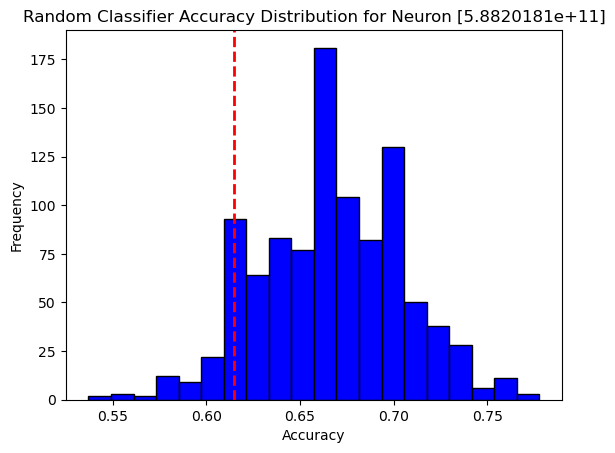


 [5.8820181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 31.25%, p-value = 1.0000


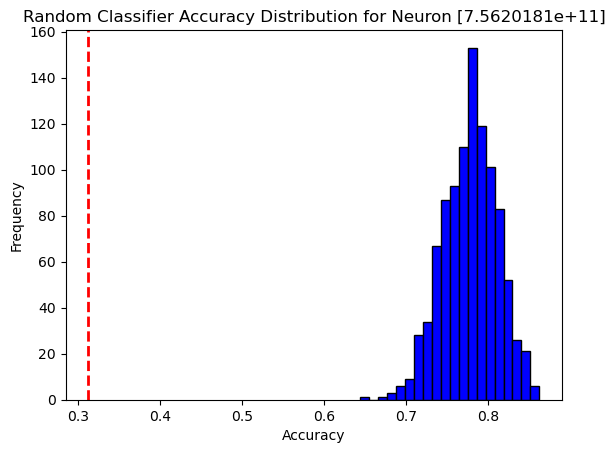


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 33.75%, p-value = 1.0000


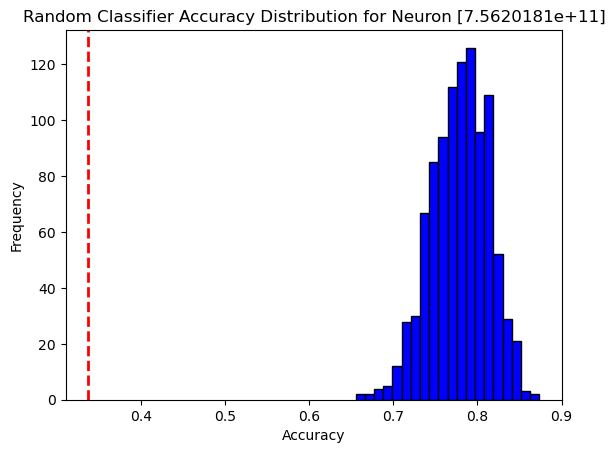


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 28.75%, p-value = 1.0000


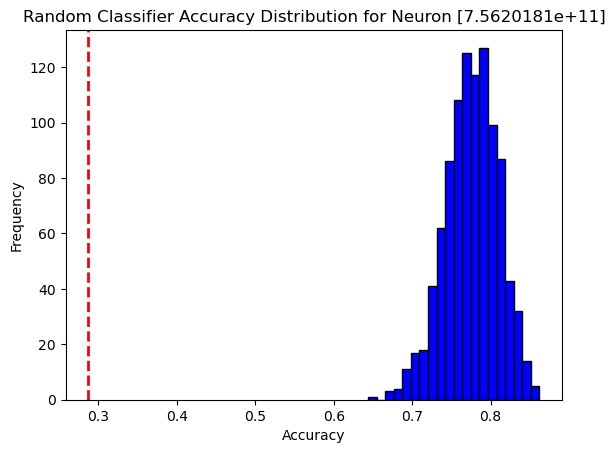


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 53.75%, p-value = 1.0000


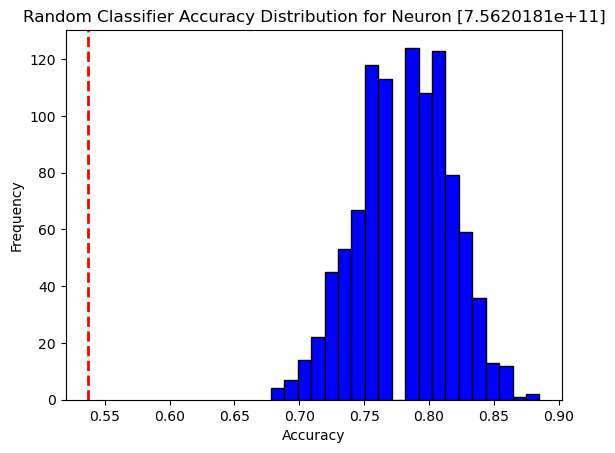


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 51.25%, p-value = 1.0000


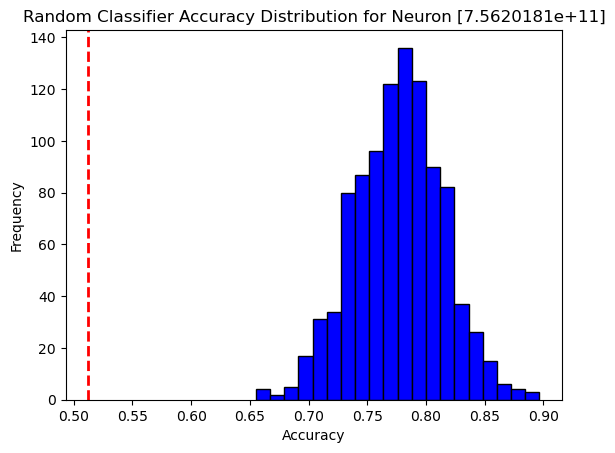


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.31%, p-value = 1.0000


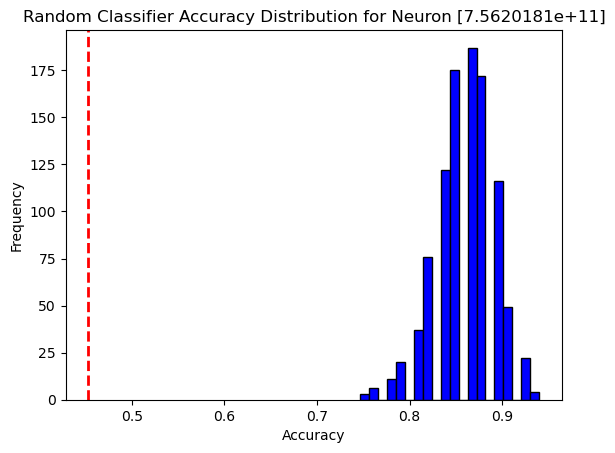


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 46.88%, p-value = 1.0000


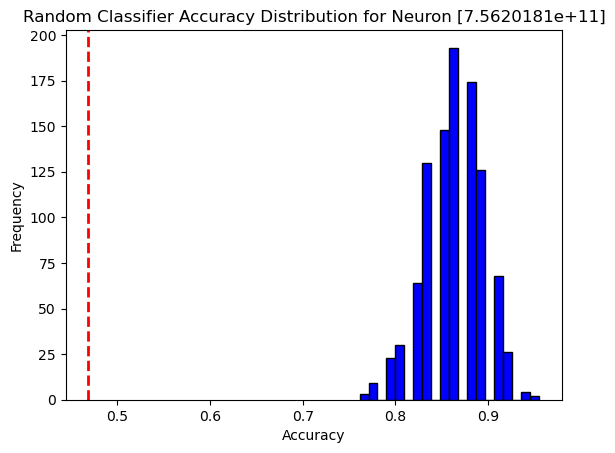


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.83%, p-value = 1.0000


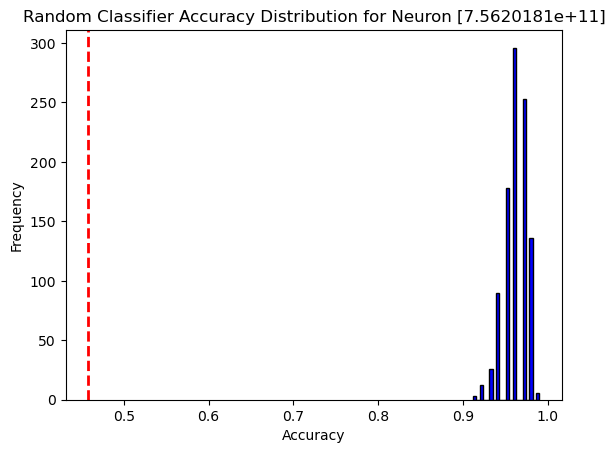


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 100.00%, p-value = 0.0090


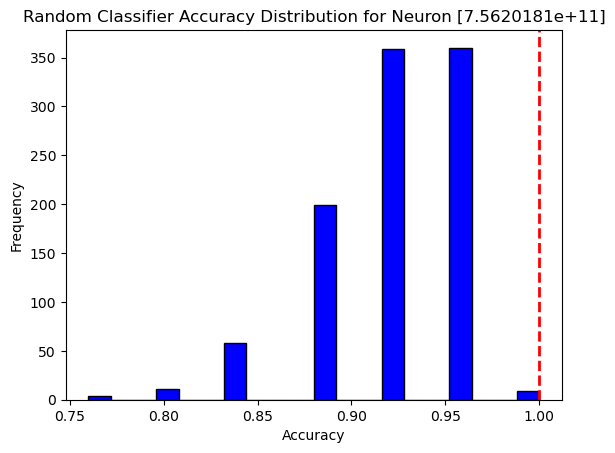


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 100.00%, p-value = 0.0140


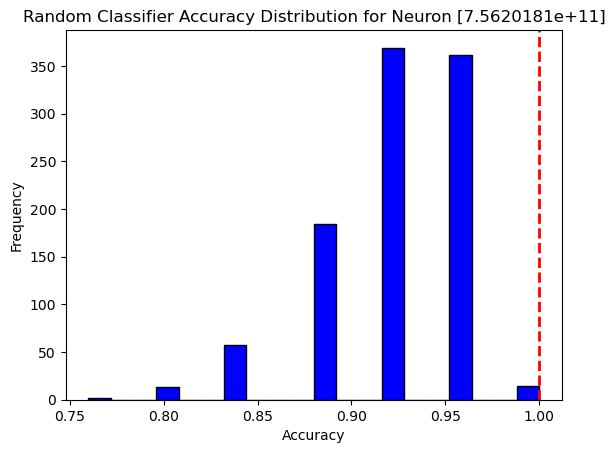


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 87.50%, p-value = 0.9310


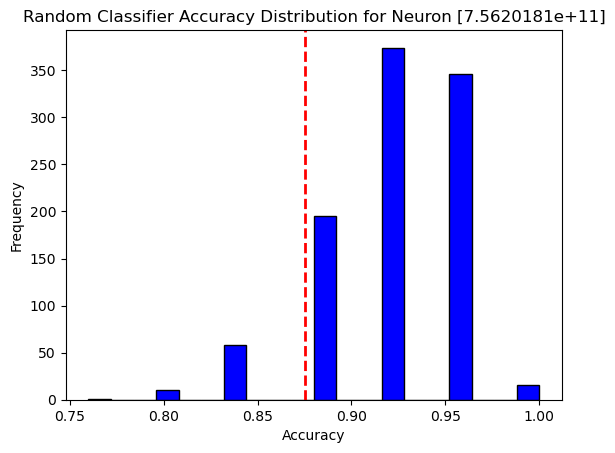


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 57.81%, p-value = 1.0000


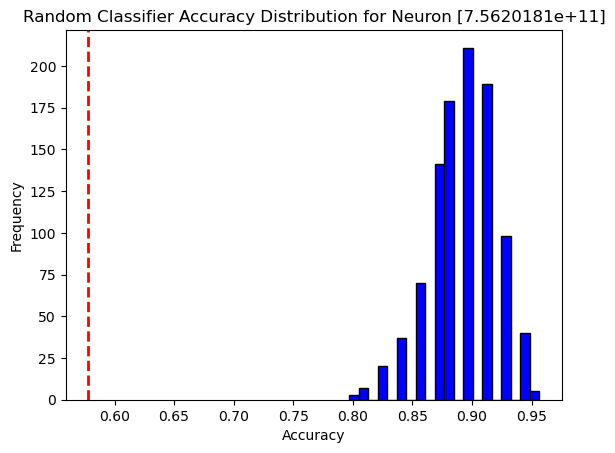


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 3.12%, p-value = 1.0000


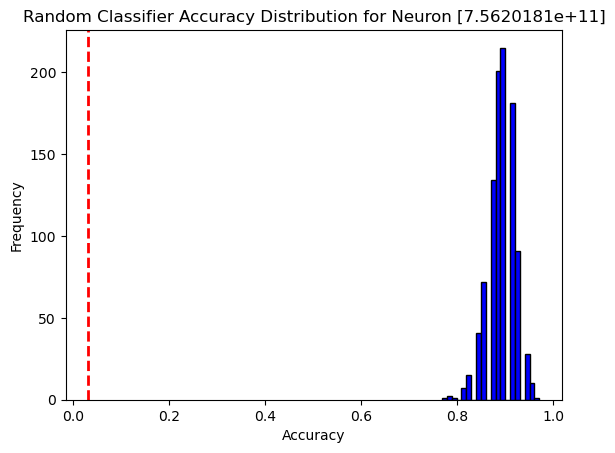


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 9.38%, p-value = 1.0000


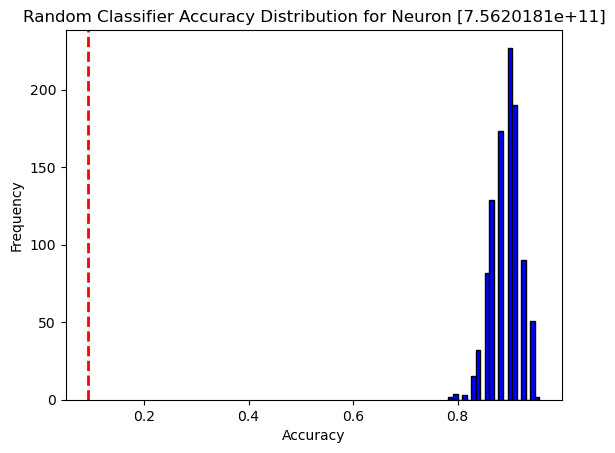


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 17.50%, p-value = 1.0000


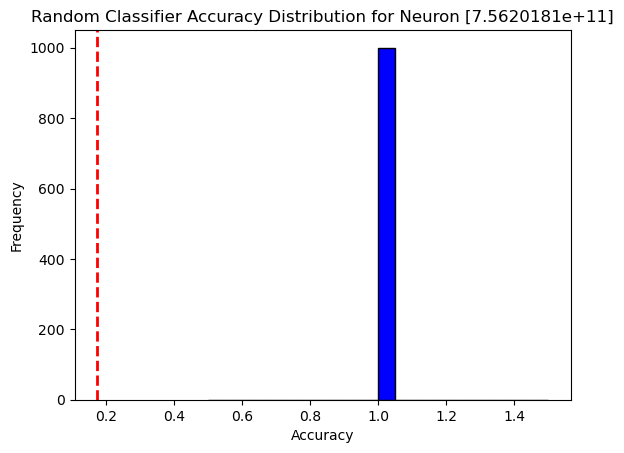


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 47.50%, p-value = 1.0000


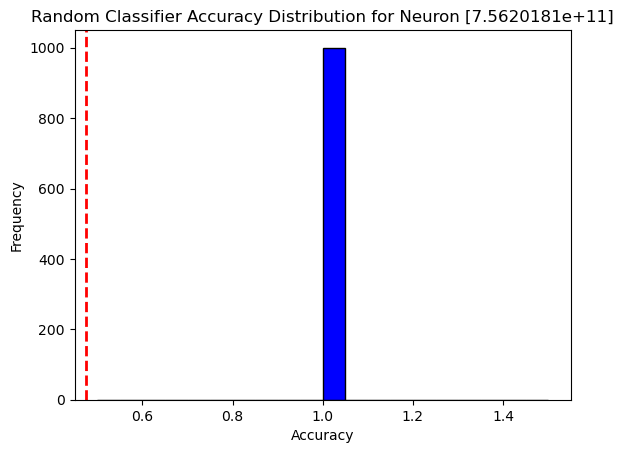


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 60.00%, p-value = 1.0000


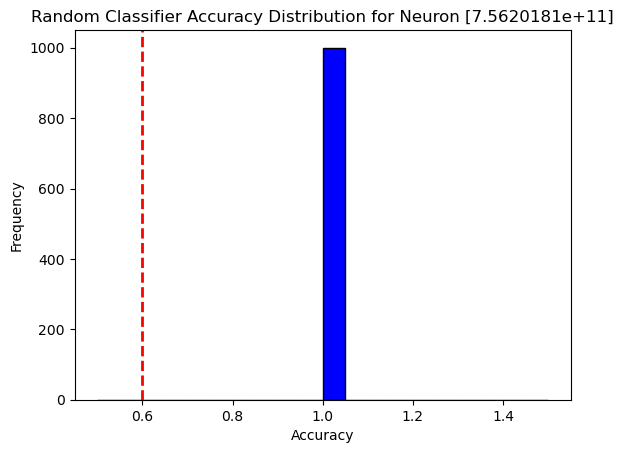


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 56.25%, p-value = 1.0000


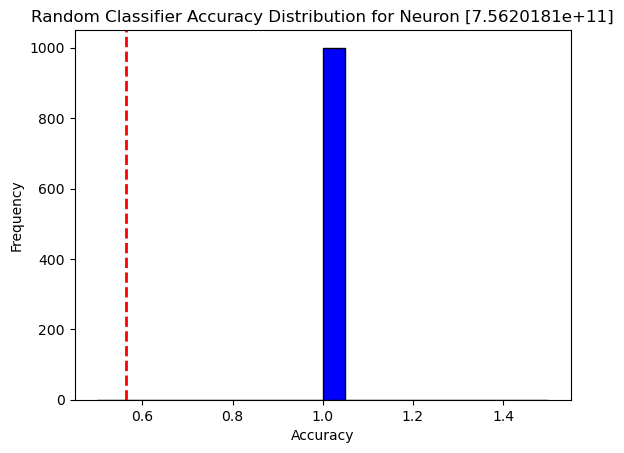


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 56.25%, p-value = 1.0000


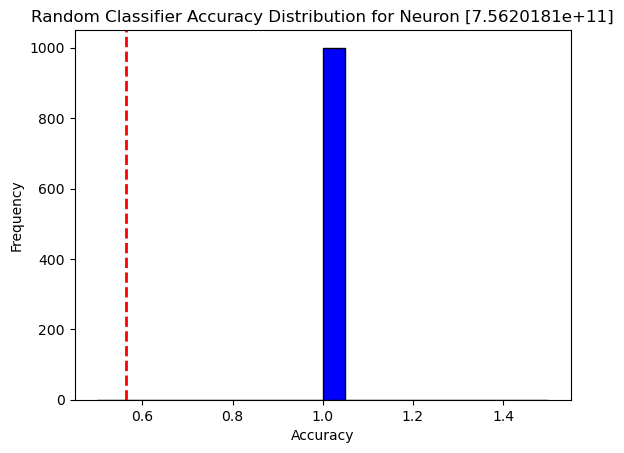


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.83%, p-value = 1.0000


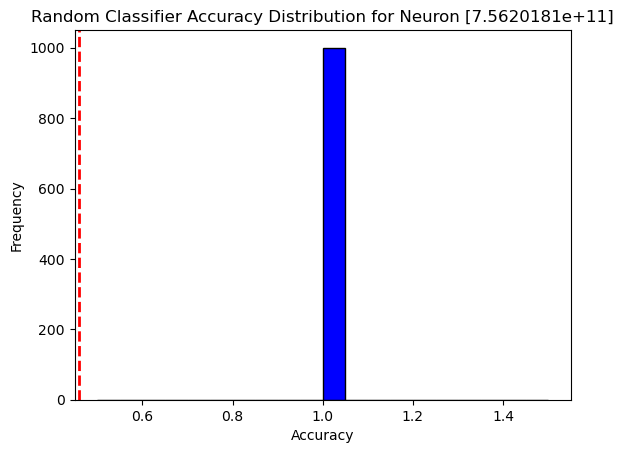


 [7.5620181e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [7.5620181e+11]: Test Accuracy = 45.83%, p-value = 1.0000


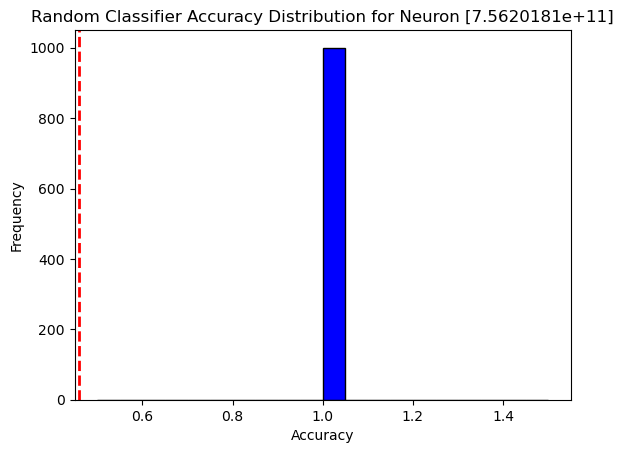


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 61.46%, p-value = 1.0000


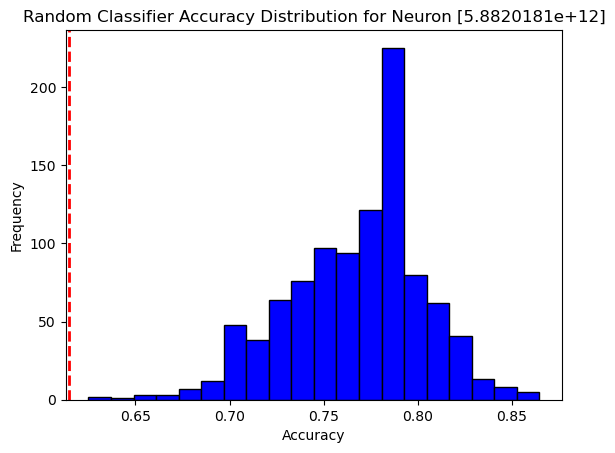


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 38.54%, p-value = 1.0000


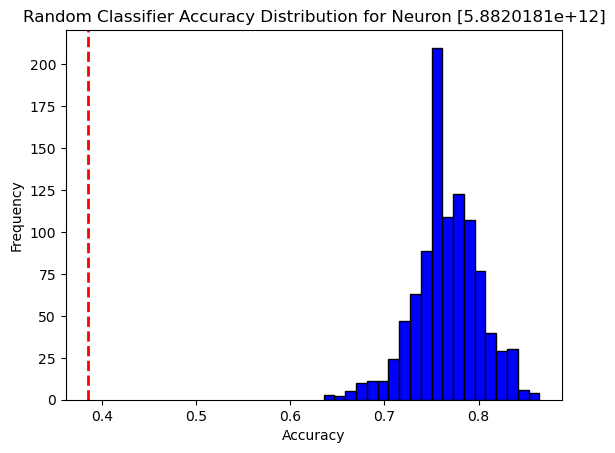


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 57.29%, p-value = 1.0000


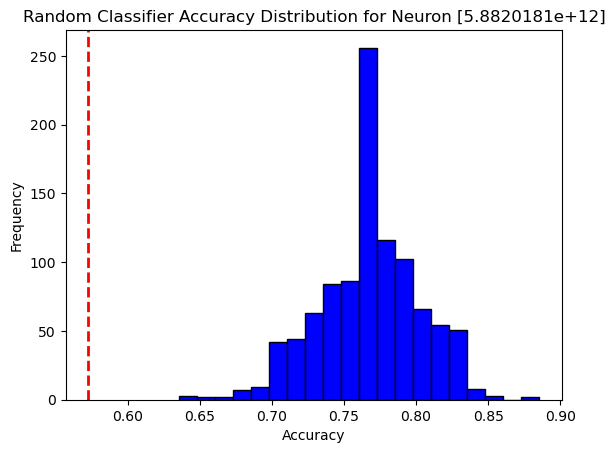


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 25.00%, p-value = 1.0000


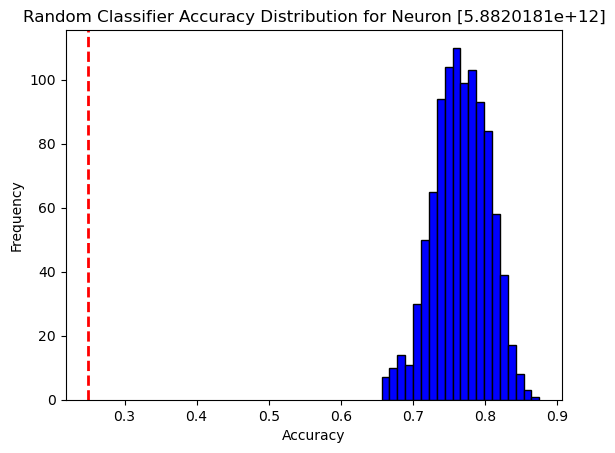


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 65.62%, p-value = 0.9990


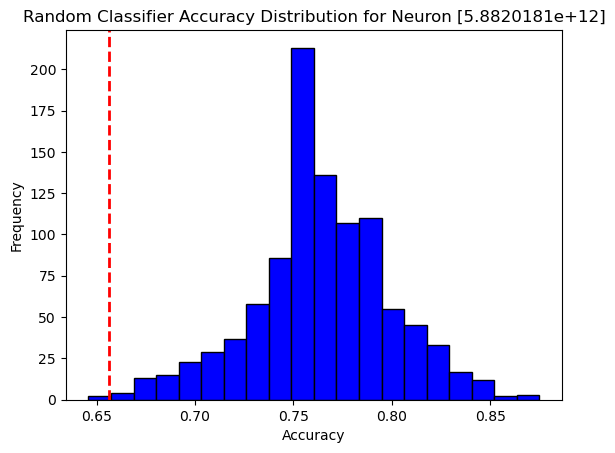


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 32.29%, p-value = 1.0000


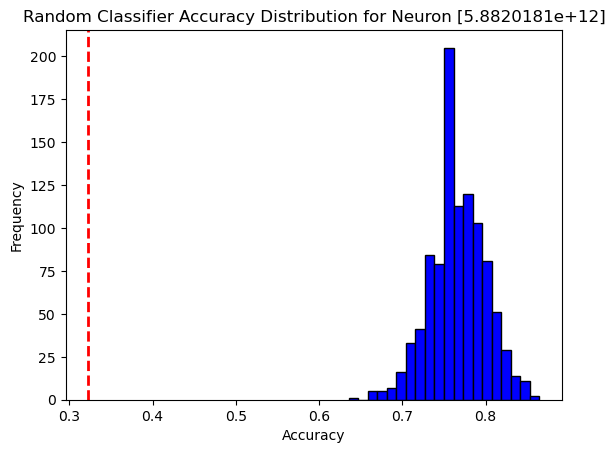


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 84.38%, p-value = 0.0140


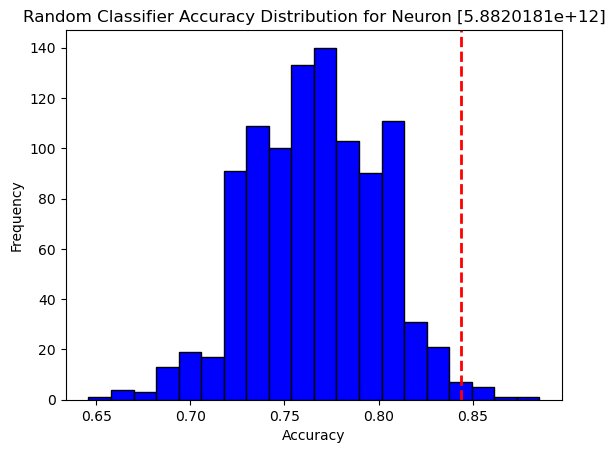


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 54.17%, p-value = 1.0000


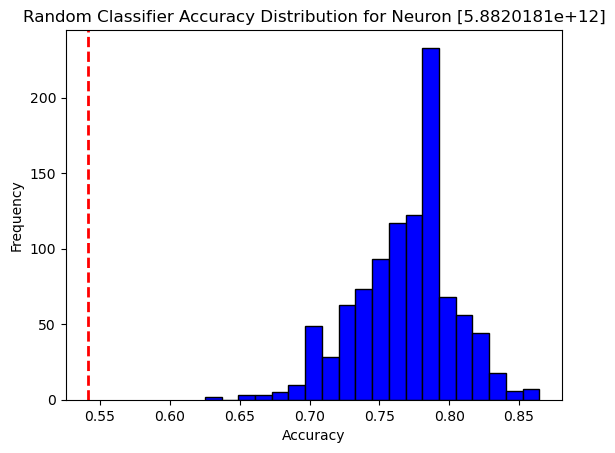


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 87.50%, p-value = 0.0000


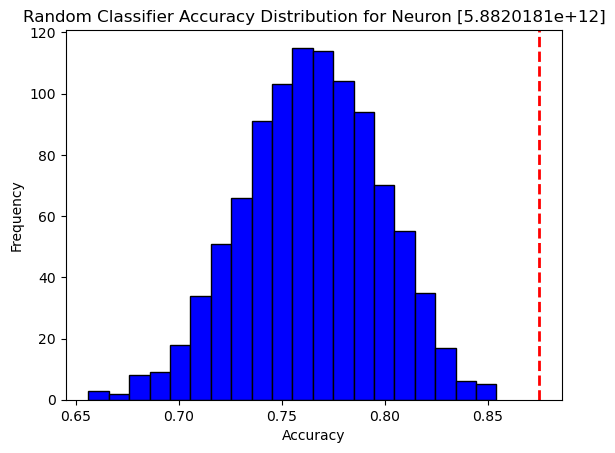


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 56.25%, p-value = 1.0000


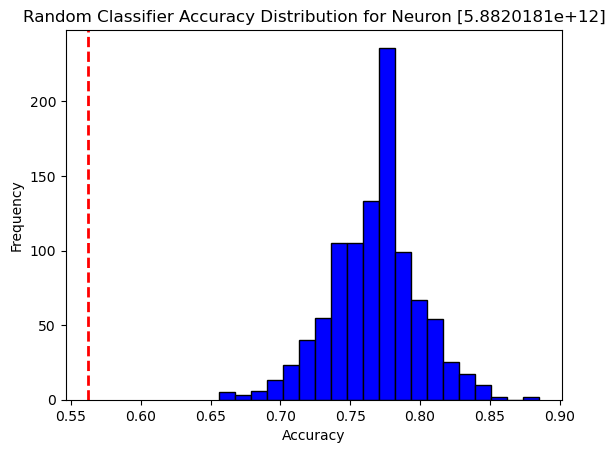


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 58.33%, p-value = 1.0000


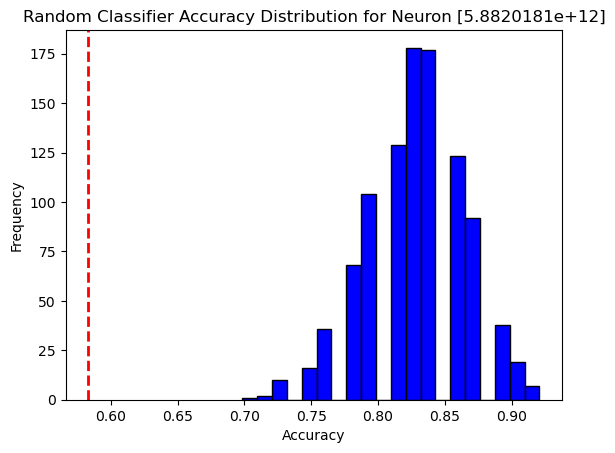


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 36.46%, p-value = 1.0000


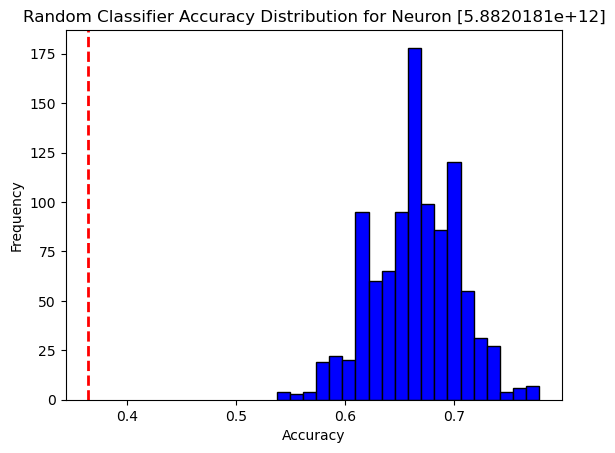


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 31.25%, p-value = 1.0000


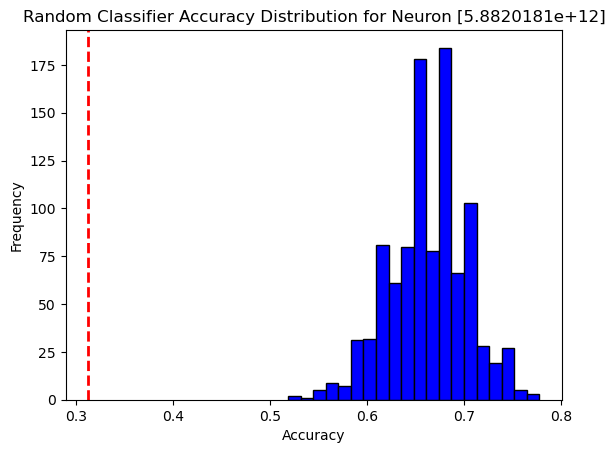


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 85.94%, p-value = 0.1080


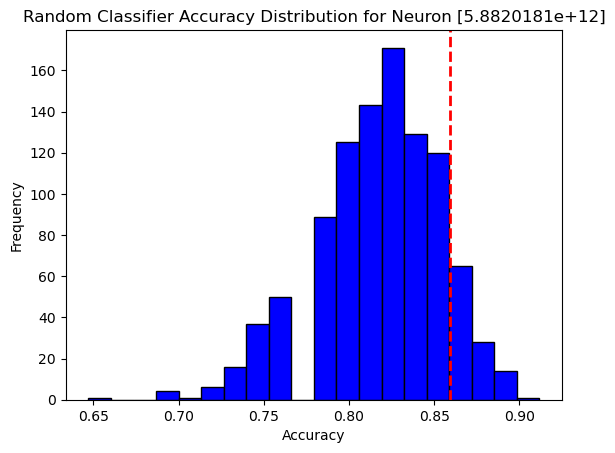


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 89.06%, p-value = 0.0130


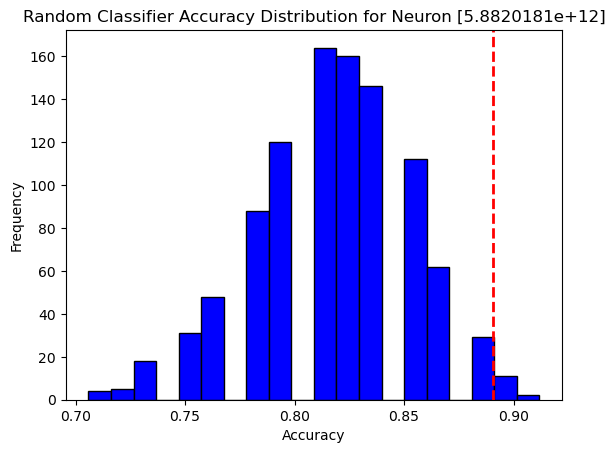


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 51.56%, p-value = 1.0000


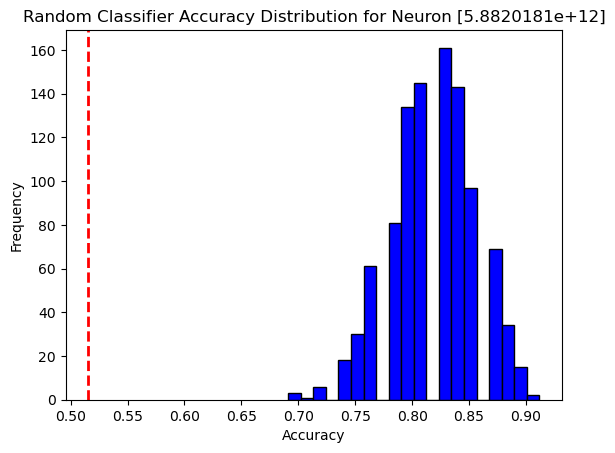


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 51.56%, p-value = 1.0000


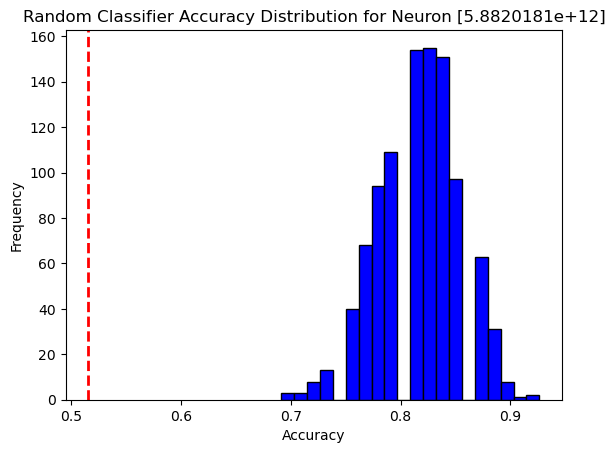


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 20.31%, p-value = 1.0000


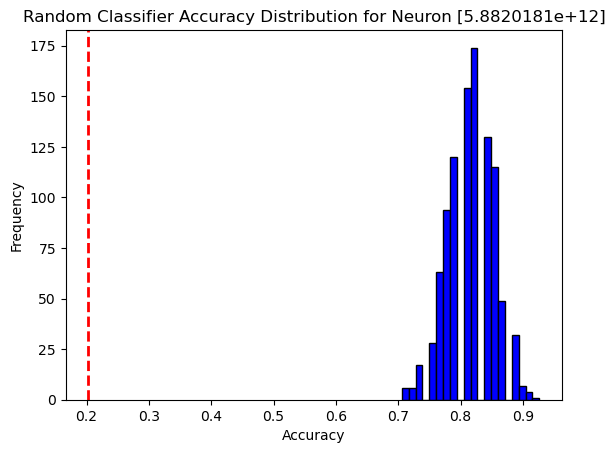


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 46.88%, p-value = 1.0000


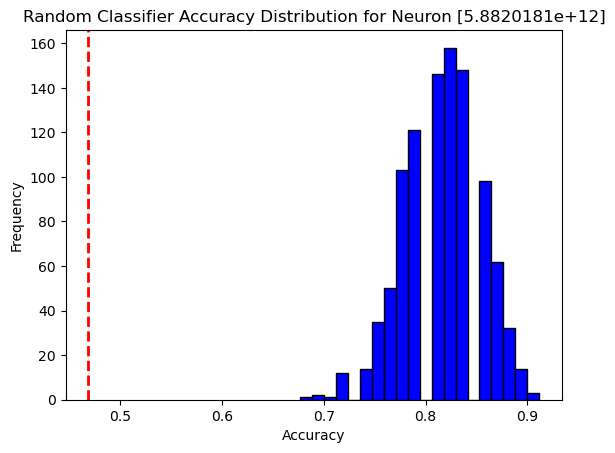


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 35.94%, p-value = 1.0000


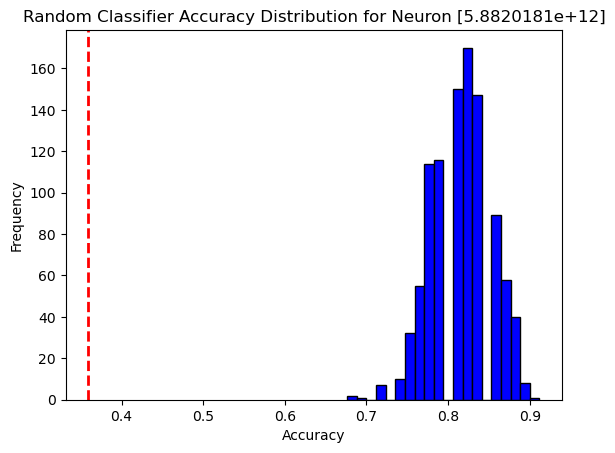


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX
Neuron [5.8820181e+12]: Test Accuracy = 43.75%, p-value = 1.0000


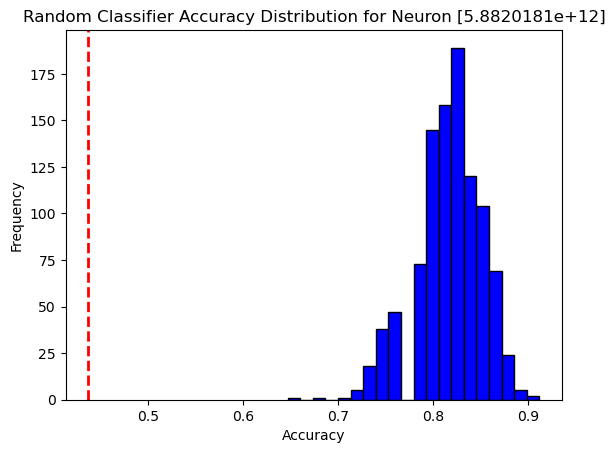


 [5.8820181e+12] XXXXXXXXXXXXXXXXXXXX


In [ ]:
from imblearn.over_sampling import RandomOverSampler

# Number of random classifiers (null hypothesis testing)
num_permutations = 1000

# Brain areas and analysis types
results_oversampled = []
brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"]

combinations = [('S1', 'GO'), ('S1', 'LICK'), ('S1naive', 'GO'), ('S1naive', 'LICK'), ('PPC', 'GO'), ('PPC', 'LICK')]

# Iterate through each combination
for comb in combinations:
    brain_area = comb[0]
    type_of_analysis = comb[1]
    print(f"Brain Area: {brain_area}, Analysis Type: {type_of_analysis}")
    trial_list, trial_dff = get_data_ready(brain_area, type_of_analysis)

    neuron_list = np.unique(trial_list[:, 0]).reshape(-1, 1)
    print("Num of neurons before filter=", neuron_list.shape[0])

    for neuron in neuron_list:
        print("\n", neuron, "XXXXXXXXXXXXXXXXXXXX")
        
        # Extract neuron-specific data
        neuron_data_list = trial_list[trial_list[:, 0] == neuron].copy()
        neuron_data_dff = trial_dff[trial_list[:, 0] == neuron].copy()

        X = neuron_data_dff.copy()
        y = neuron_data_list[:, 1]

        # Ensure there are at least two unique classes
        unique_classes = np.unique(y)
        if len(unique_classes) < 2:
            print(f"Skipping neuron {neuron} due to insufficient class diversity")
            continue 

        # Reshape X
        X = X.reshape(X.shape[0], X.shape[1], 1)

        #### Train-test split
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # **Apply Oversampling to deal with class imbalance in training data**
        oversampler = RandomOverSampler(random_state=42)
        X_train_flat = X_train.reshape((X_train.shape[0], -1))  # Flatten the data for oversampling
        X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train_flat, y_train)

        # Reshape the oversampled X_train back to original shape
        X_train_resampled = X_train_resampled.reshape((X_train_resampled.shape[0], X_train.shape[1], 1))

        # Convert to tensors
        Xtrain = torch.from_numpy(X_train_resampled).float()
        ytrain = torch.from_numpy(y_train_resampled).long()
        Xtest = torch.from_numpy(X_test).float()
        ytest = torch.from_numpy(y_test).long()

        # Batch size, epochs, and iterations
        batch_size = 16
        n_iters = 1000
        num_epochs = int(n_iters // (len(X_train_resampled) // batch_size))

        train = TensorDataset(Xtrain, ytrain)
        test = TensorDataset(Xtest, ytest)

        train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test, batch_size=batch_size, shuffle=True, drop_last=True)

        # Create the RNN model
        input_dim = X.shape[-1]
        hidden_dim = 4
        layer_dim = 1
        output_dim = 1

        model = RNNModel(input_dim, hidden_dim, layer_dim, output_dim)

        # Loss function and optimizer
        error = nn.BCEWithLogitsLoss()  # No class weights, since oversampling handles imbalance
        learning_rate = 0.001
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

        # Training loop for the original model
        train_accuracy_list = []
        test_accuracy_list = []
        test_loss_list = []

        for epoch in range(num_epochs):
            model.train()
            total_train, correct_train = 0, 0

            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                outputs = model(X_batch).squeeze()
                loss = error(outputs, y_batch.float())
                loss.backward()
                optimizer.step()

                probabilities = torch.sigmoid(outputs)
                predicted = (probabilities > 0.5).long()
                correct_train += (predicted.squeeze() == y_batch).sum().item()
                total_train += y_batch.size(0)

            train_accuracy = 100 * correct_train / total_train
            train_accuracy_list.append(train_accuracy)
            scheduler.step()

            # Evaluate on test set
            model.eval()
            total_test, correct_test = 0, 0
            with torch.no_grad():
                for X_test_batch, y_test_batch in test_loader:
                    outputs = model(X_test_batch).squeeze()
                    probabilities = torch.sigmoid(outputs)
                    predicted = (probabilities > 0.5).long()
                    correct_test += (predicted == y_test_batch).sum().item()
                    total_test += y_test_batch.size(0)
                    loss_test = error(outputs, y_test_batch.float())
                    test_loss_list.append(loss_test)

            test_accuracy = 100 * correct_test / float(total_test)
            test_accuracy_list.append(test_accuracy)

        # Save the original model's test accuracy
        original_test_accuracy = test_accuracy

        # Random classifier: Match class distribution in the test set
        class_distribution = np.mean(y_test)  # proportion of class 1

        random_accuracies = []
        for _ in range(num_permutations):
            y_random = np.random.choice([0, 1], size=len(y_test), p=[1 - class_distribution, class_distribution])
            random_accuracy = accuracy_score(y_test, y_random)
            random_accuracies.append(random_accuracy)

        # Calculate p-value using a t-test (testing original model vs. random classifiers)
        random_accuracies = np.array(random_accuracies)
        p_value = np.mean(random_accuracies >= original_test_accuracy/100)

        # Store results
        results_oversampled.append({
            'Brain Area': brain_area,
            'Analysis Type': type_of_analysis,
            'Neuron': neuron,
            'Train Accuracy': train_accuracy_list,
            'Test Accuracy': original_test_accuracy,
            'p value': p_value
        })

        print(f"Neuron {neuron}: Test Accuracy = {original_test_accuracy:.2f}%, p-value = {p_value:.4f}")

        # Visualize random classifier accuracy distribution
        plt.hist(random_accuracies, bins=20, color='blue', edgecolor='black')
        plt.axvline(original_test_accuracy/100, color='red', linestyle='dashed', linewidth=2)
        plt.title(f'Random Classifier Accuracy Distribution for Neuron {neuron}')
        plt.xlabel('Accuracy')
        plt.ylabel('Frequency')
        plt.show()


     # Plot training vs test accuracy to examine potential overfitting or bias
        plt.plot(train_accuracy_list, label='Training Accuracy')
        plt.plot(test_accuracy_list, label='Test Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy (%)')
        plt.title('Training vs Test Accuracy')
        plt.legend()
        plt.show()
        
        # Check class-specific accuracy on the test set
        
        # Predict on the test set and calculate confusion matrix
        model.eval()
        with torch.no_grad():
            outputs = model(Xtest).squeeze()
            probabilities = torch.sigmoid(outputs)
            predictions = (probabilities > 0.5).long()
            
        conf_matrix = confusion_matrix(ytest, predictions)
        print("Confusion Matrix:\n", conf_matrix)
        
        # Calculate class-specific accuracy
        class_accuracy = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
        print("Class-specific Accuracy:", class_accuracy)



Brain Area: S1, Analysis Type: GO
Num of neurons before filter= 289

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 40.62%, p-value = 0.9590


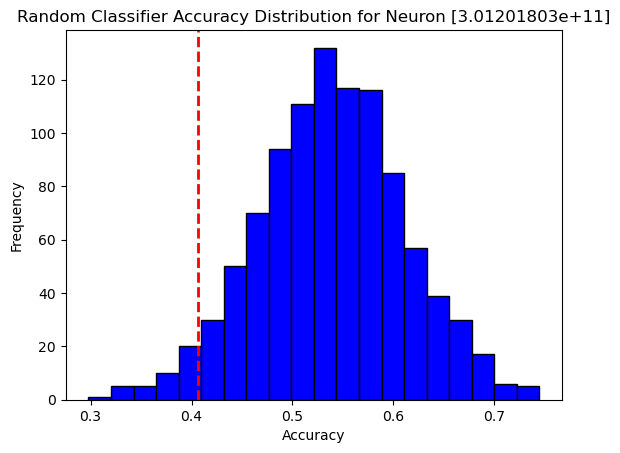

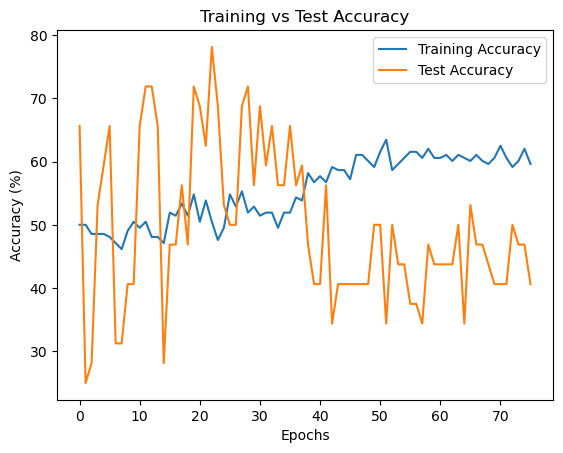

Confusion Matrix:
 [[14 16]
 [11  6]]
Class-specific Accuracy: [0.46666667 0.35294118]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 62.50%, p-value = 0.0880


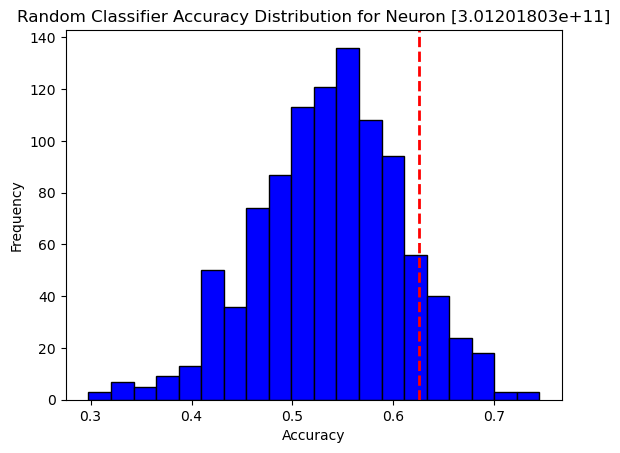

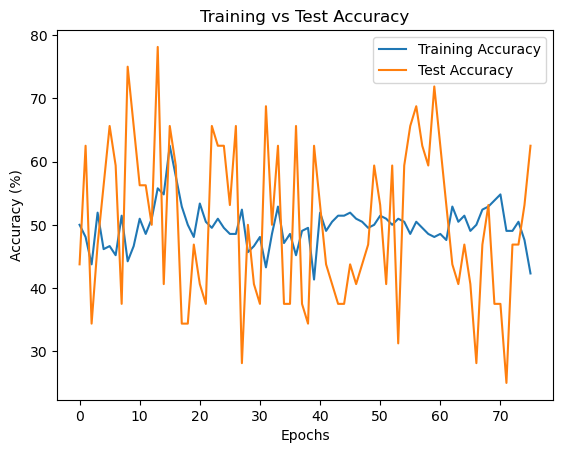

Confusion Matrix:
 [[25  5]
 [13  4]]
Class-specific Accuracy: [0.83333333 0.23529412]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 46.88%, p-value = 0.7950


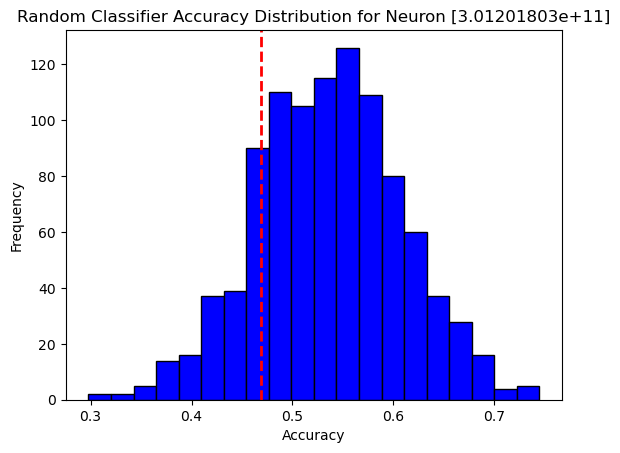

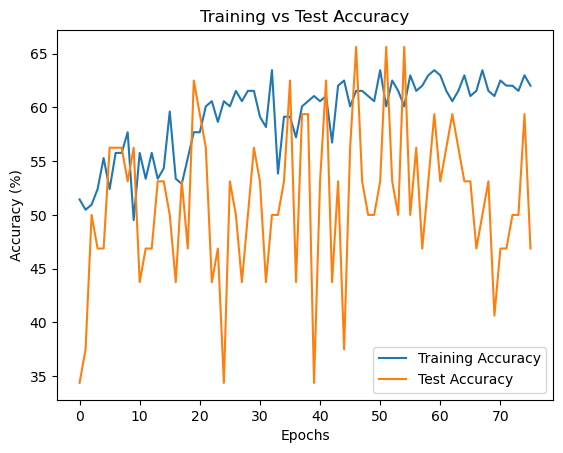

Confusion Matrix:
 [[17 13]
 [10  7]]
Class-specific Accuracy: [0.56666667 0.41176471]

 [3.01201803e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [3.01201803e+11]: Test Accuracy = 50.00%, p-value = 0.7310


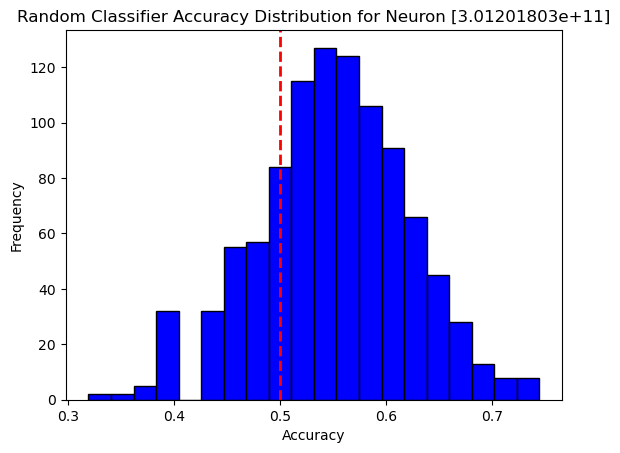

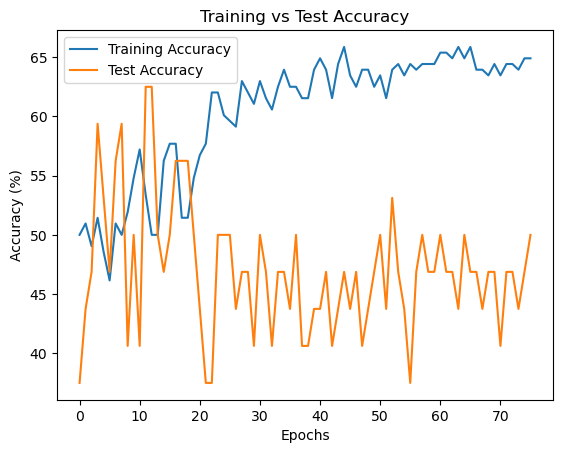

Confusion Matrix:
 [[17 13]
 [13  4]]
Class-specific Accuracy: [0.56666667 0.23529412]

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Skipping neuron [4.06201804e+11] due to class imbalance: {0.0: 23, 1.0: 74}

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Skipping neuron [4.06201804e+11] due to class imbalance: {0.0: 23, 1.0: 74}

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Skipping neuron [4.06201804e+11] due to class imbalance: {0.0: 23, 1.0: 74}

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Skipping neuron [4.06201804e+11] due to class imbalance: {0.0: 23, 1.0: 74}

 [4.06201804e+11] XXXXXXXXXXXXXXXXXXXX
Skipping neuron [4.06201804e+11] due to class imbalance: {0.0: 23, 1.0: 74}

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 45.00%, p-value = 0.8510


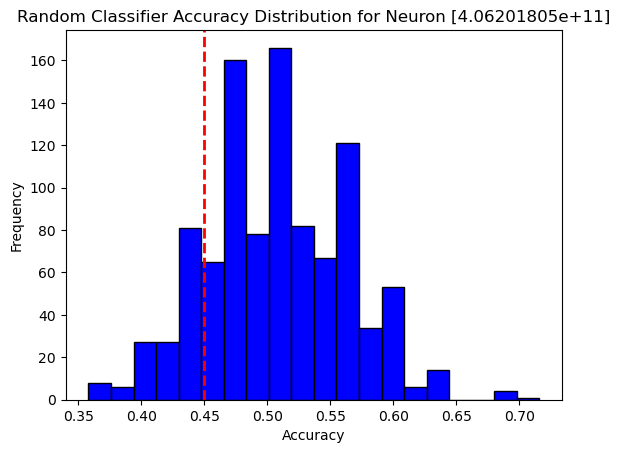

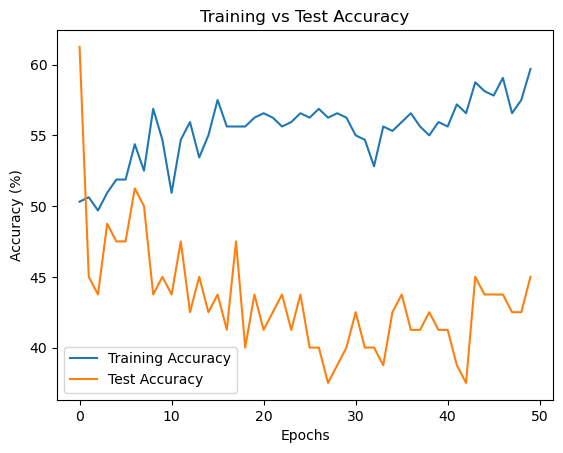

Confusion Matrix:
 [[13 23]
 [22 23]]
Class-specific Accuracy: [0.36111111 0.51111111]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 56.25%, p-value = 0.1600


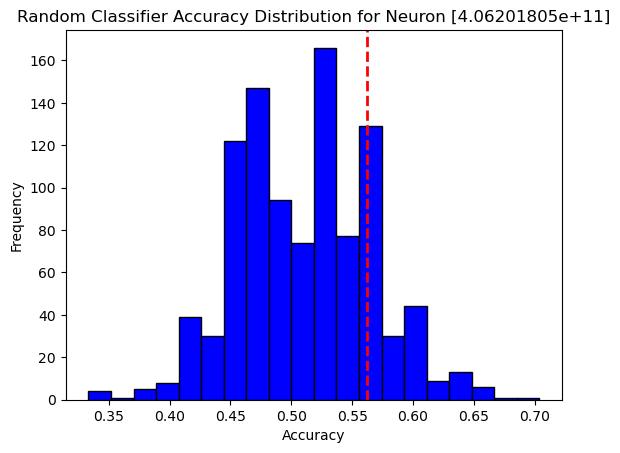

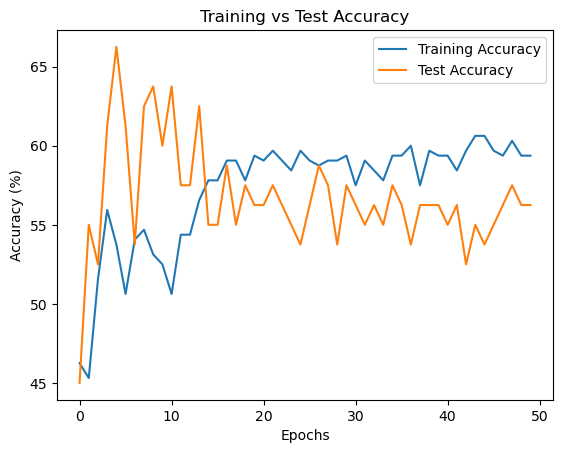

Confusion Matrix:
 [[19 17]
 [19 26]]
Class-specific Accuracy: [0.52777778 0.57777778]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 60.00%, p-value = 0.0450


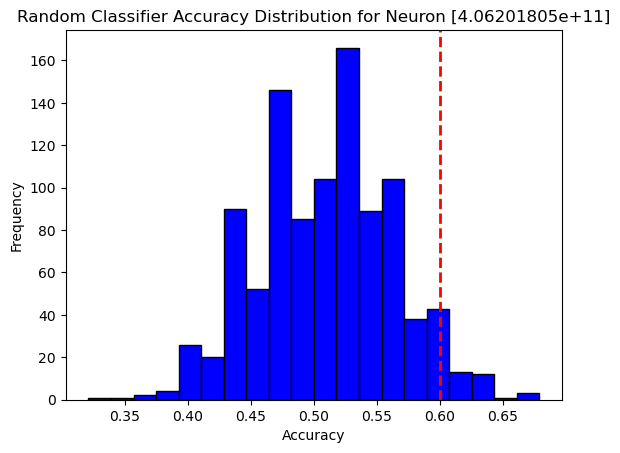

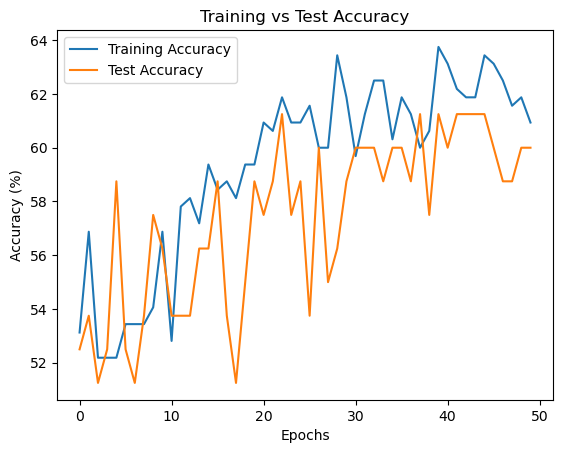

Confusion Matrix:
 [[24 12]
 [21 24]]
Class-specific Accuracy: [0.66666667 0.53333333]

 [4.06201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201805e+11]: Test Accuracy = 36.25%, p-value = 0.9940


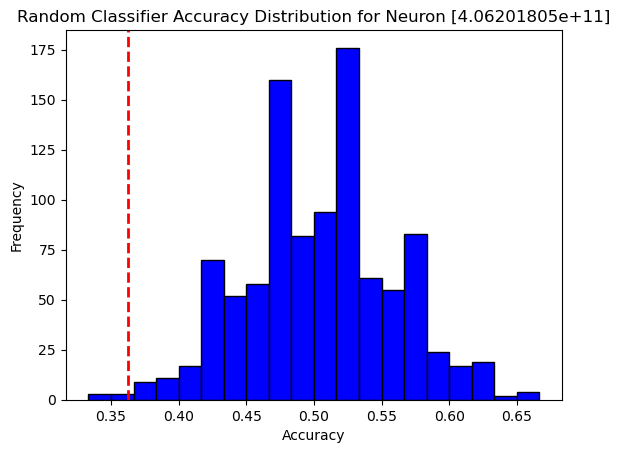

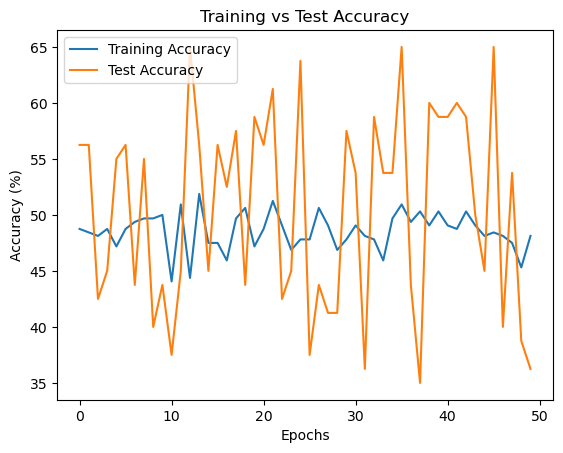

Confusion Matrix:
 [[28  8]
 [44  1]]
Class-specific Accuracy: [0.77777778 0.02222222]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 34.38%, p-value = 0.9860


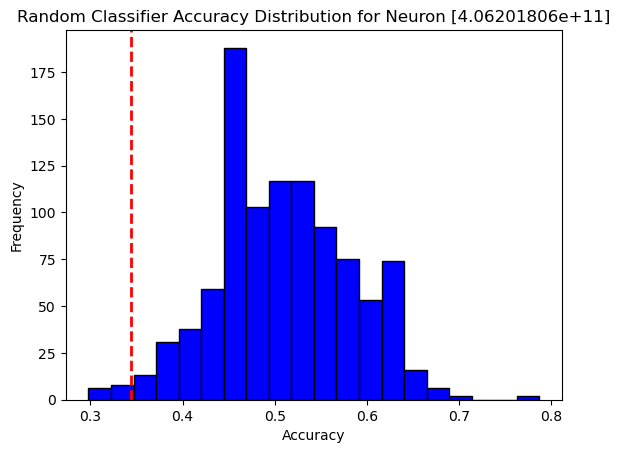

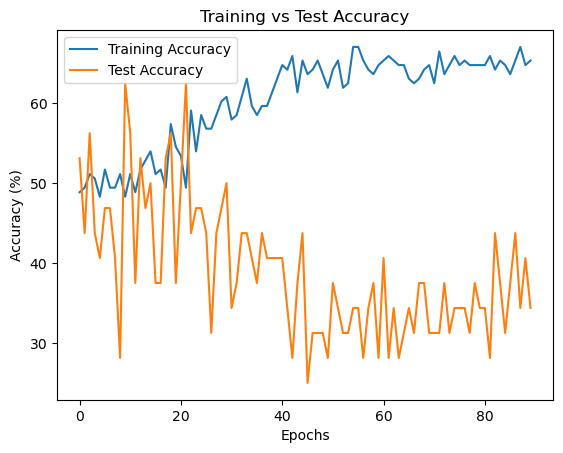

Confusion Matrix:
 [[ 4 17]
 [14 12]]
Class-specific Accuracy: [0.19047619 0.46153846]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 40.62%, p-value = 0.8940


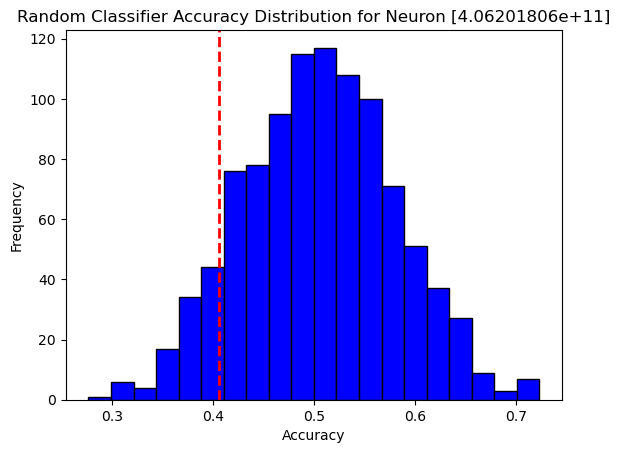

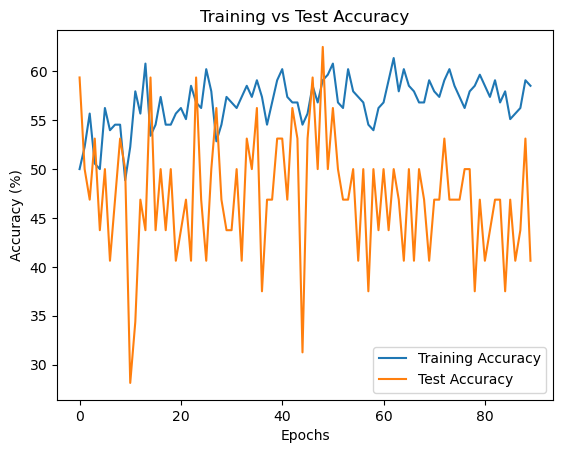

Confusion Matrix:
 [[12  9]
 [16 10]]
Class-specific Accuracy: [0.57142857 0.38461538]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 40.62%, p-value = 0.8770


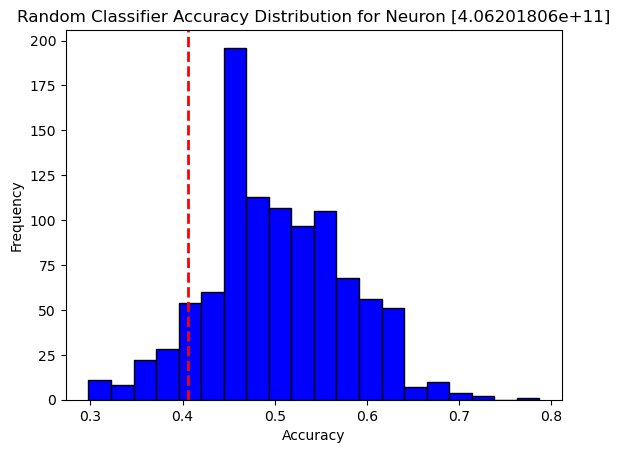

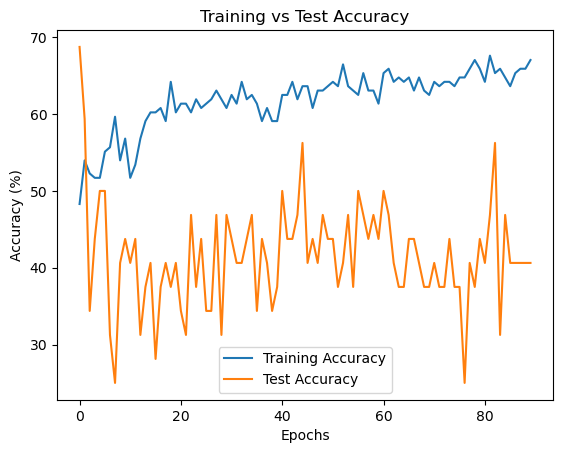

Confusion Matrix:
 [[ 9 12]
 [15 11]]
Class-specific Accuracy: [0.42857143 0.42307692]

 [4.06201806e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.06201806e+11]: Test Accuracy = 62.50%, p-value = 0.0400


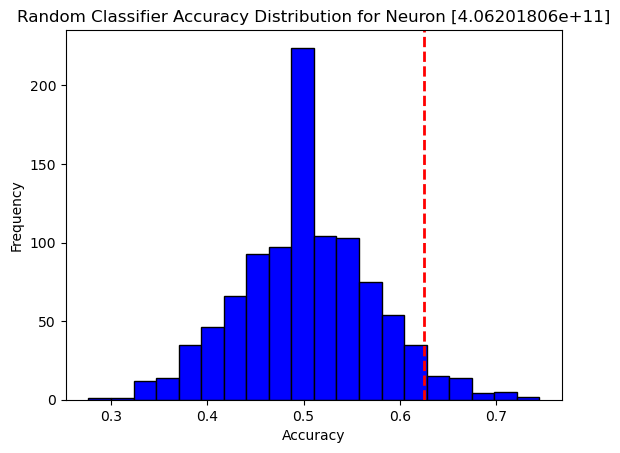

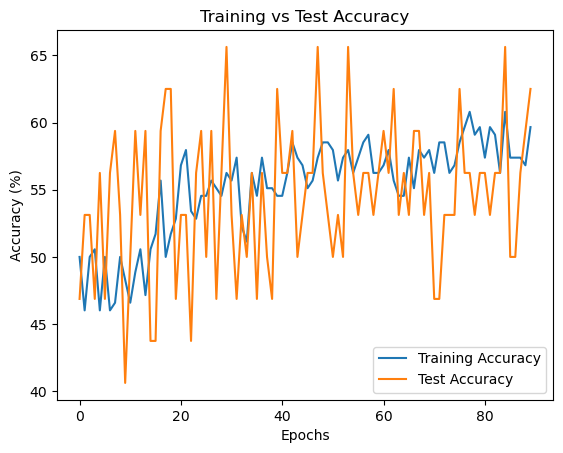

Confusion Matrix:
 [[13  8]
 [12 14]]
Class-specific Accuracy: [0.61904762 0.53846154]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 53.12%, p-value = 0.2380


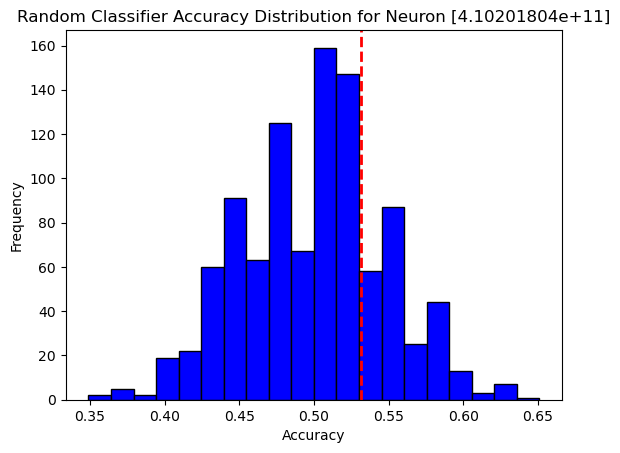

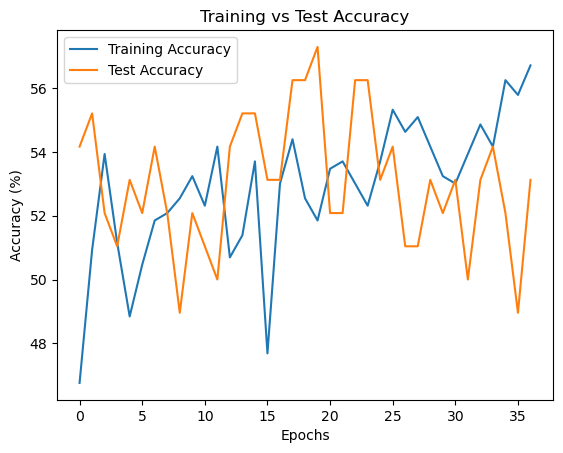

Confusion Matrix:
 [[22 30]
 [23 31]]
Class-specific Accuracy: [0.42307692 0.57407407]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 55.21%, p-value = 0.1450


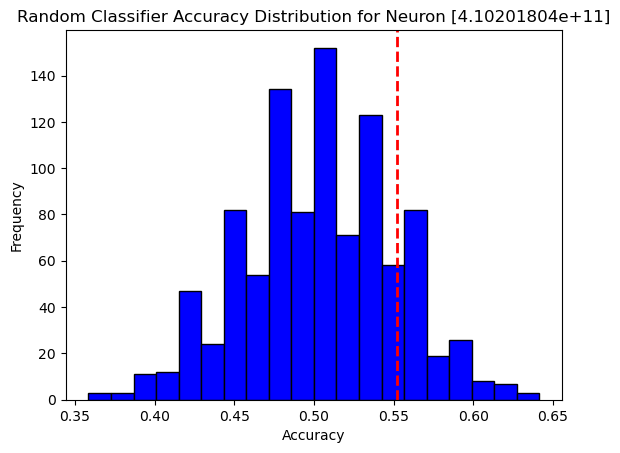

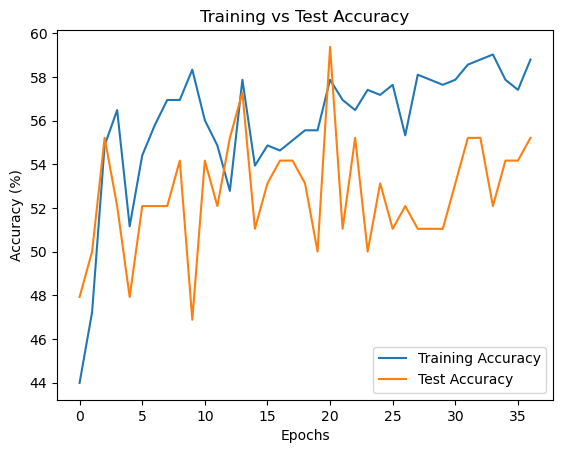

Confusion Matrix:
 [[36 16]
 [34 20]]
Class-specific Accuracy: [0.69230769 0.37037037]

 [4.10201804e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201804e+11]: Test Accuracy = 52.08%, p-value = 0.3040


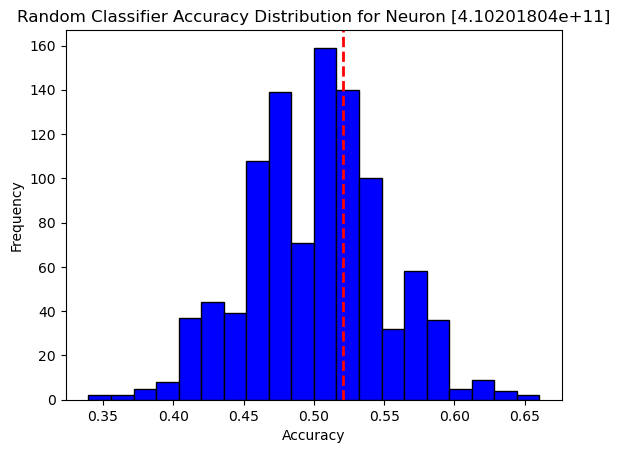

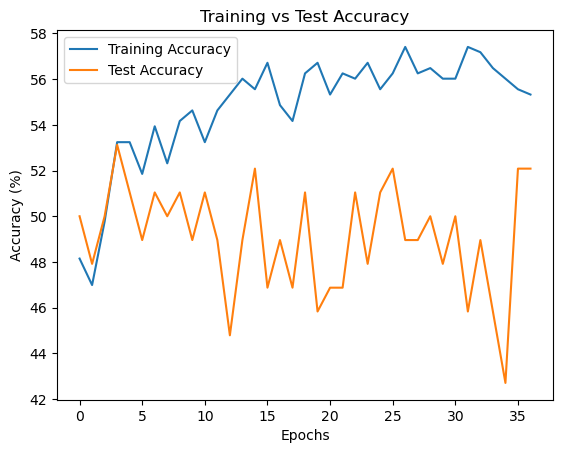

Confusion Matrix:
 [[36 16]
 [32 22]]
Class-specific Accuracy: [0.69230769 0.40740741]

 [4.10201805e+11] XXXXXXXXXXXXXXXXXXXX
Neuron [4.10201805e+11]: Test Accuracy = 60.00%, p-value = 0.0470


In [ ]:
### gonna use SMOTE and skip neurons with too much of an imbalance 

from imblearn.over_sampling import RandomOverSampler

# Number of random classifiers (null hypothesis testing)
num_permutations = 1000

# Brain areas and analysis types
results_oversampled = []
brain_areas = ["S1", "S1naive", "PPC"]
type_of_analysis = ["GO", "LICK"]

combinations = [('S1', 'GO'), ('S1', 'LICK'), ('S1naive', 'GO'), ('S1naive', 'LICK'), ('PPC', 'GO'), ('PPC', 'LICK')]

# Iterate through each combination
for comb in combinations:
    brain_area = comb[0]
    type_of_analysis = comb[1]
    print(f"Brain Area: {brain_area}, Analysis Type: {type_of_analysis}")
    trial_list, trial_dff = get_data_ready(brain_area, type_of_analysis)

    neuron_list = np.unique(trial_list[:, 0]).reshape(-1, 1)
    print("Num of neurons before filter=", neuron_list.shape[0])

    for neuron in neuron_list:
        print("\n", neuron, "XXXXXXXXXXXXXXXXXXXX")
        
        # Extract neuron-specific data
        neuron_data_list = trial_list[trial_list[:, 0] == neuron].copy()
        neuron_data_dff = trial_dff[trial_list[:, 0] == neuron].copy()

        X = neuron_data_dff.copy()
        y = neuron_data_list[:, 1]

        # Ensure there are at least two unique classes
        unique_classes = np.unique(y)
        if len(unique_classes) < 2:
            print(f"Skipping neuron {neuron} due to insufficient class diversity")
            continue 
        # We have to reshape to use SMOTE
        
        # Reshape X to have a singleton dimension for compatibility with RNN
        X = X.reshape(X.shape[0], X.shape[1], 1)  # New shape: (231, 41, 1)
        original_shape = X.shape  # Store this new 3D shape
        
        # Flatten X to 2D for SMOTE
        X_flat = X.reshape(X.shape[0], -1)  # Flatten to shape: (231, 41)
        
        # Train-test split
        X_train, X_test, y_train, y_test = train_test_split(X_flat, y, test_size=0.2, random_state=42)
        
        # Apply SMOTE on flattened training data
        over = SMOTE(sampling_strategy='auto', k_neighbors=3, random_state=0)
        under = RandomUnderSampler(sampling_strategy='auto')
        #make over and inder into a pipeline 
        steps = [('o', over), ('u', under)]
        pipeline = Pipeline(steps=steps)

        #apply the pipeline to the data 
        X_train_smote, y_train_smote = pipeline.fit_resample(X_train, y_train)
        
        # Reshape X_train_smote back to 3D format for RNN input
        X_train_smote = X_train_smote.reshape(-1, original_shape[1], original_shape[2])  # Shape: (new_samples, 41, 1)
        
        # Also reshape X_test to 3D for consistency
        X_test = X_test.reshape(-1, original_shape[1], original_shape[2])

        #check the classes are balanced enough now: 
        unique, counts = np.unique(y_train, return_counts=True)
        class_distribution = dict(zip(unique, counts))
    
        # Calculate class balance ratio
        if 0 in class_distribution and 1 in class_distribution:
            class_0_ratio = class_distribution[0] / len(y_train)
            class_1_ratio = class_distribution[1] / len(y_train)
    
            # Ensure that the balance is at least 65/35 for both classes
            if not (0.35 <= class_0_ratio <= 0.65) or not (0.35 <= class_1_ratio <= 0.65):
                print(f"Skipping neuron {neuron} due to class imbalance: {class_distribution}")
                continue  # Skip to the next neuron

        
        # Convert to PyTorch tensors
        Xtrain = torch.from_numpy(X_train_smote).float()
        ytrain = torch.from_numpy(y_train_smote).long()
        Xtest = torch.from_numpy(X_test).float()
        ytest = torch.from_numpy(y_test).long()
        
        # Batch size, epochs, and iterations
        batch_size = 16
        n_iters = 1000
        num_epochs = int(n_iters // (len(X_train_smote) // batch_size))

        train = TensorDataset(Xtrain, ytrain)
        test = TensorDataset(Xtest, ytest)

        train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test, batch_size=batch_size, shuffle=True, drop_last=True)

        # Create the RNN model
        input_dim = X.shape[-1]
        hidden_dim = 4
        layer_dim = 1
        output_dim = 1

        model = RNNModel(input_dim, hidden_dim, layer_dim, output_dim)

        # Loss function and optimizer
        error = nn.BCEWithLogitsLoss()  # No class weights, since oversampling handles imbalance
        learning_rate = 0.01
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.5)

        # Training loop for the original model
        train_accuracy_list = []
        test_accuracy_list = []
        test_loss_list = []

        for epoch in range(num_epochs):
            model.train()
            total_train, correct_train = 0, 0

            for X_batch, y_batch in train_loader:
                optimizer.zero_grad()
                outputs = model(X_batch).squeeze()
                loss = error(outputs, y_batch.float())
                loss.backward()
                optimizer.step()

                probabilities = torch.sigmoid(outputs)
                predicted = (probabilities > 0.5).long()
                correct_train += (predicted.squeeze() == y_batch).sum().item()
                total_train += y_batch.size(0)

            train_accuracy = 100 * correct_train / total_train
            train_accuracy_list.append(train_accuracy)
            scheduler.step()

            # Evaluate on test set
            model.eval()
            total_test, correct_test = 0, 0
            with torch.no_grad():
                for X_test_batch, y_test_batch in test_loader:
                    outputs = model(X_test_batch).squeeze()
                    probabilities = torch.sigmoid(outputs)
                    predicted = (probabilities > 0.5).long()
                    correct_test += (predicted == y_test_batch).sum().item()
                    total_test += y_test_batch.size(0)
                    loss_test = error(outputs, y_test_batch.float())
                    test_loss_list.append(loss_test)

            test_accuracy = 100 * correct_test / float(total_test)
            test_accuracy_list.append(test_accuracy)

        # Save the original model's test accuracy
        original_test_accuracy = test_accuracy

        # Random classifier: Match class distribution in the test set
        class_distribution = np.mean(y_test)  # proportion of class 1

        random_accuracies = []
        for _ in range(num_permutations):
            y_random = np.random.choice([0, 1], size=len(y_test), p=[1 - class_distribution, class_distribution])
            random_accuracy = accuracy_score(y_test, y_random)
            random_accuracies.append(random_accuracy)

        # Calculate p-value using a t-test (testing original model vs. random classifiers)
        random_accuracies = np.array(random_accuracies)
        p_value = np.mean(random_accuracies >= original_test_accuracy/100)

        # Store results
        results_oversampled.append({
            'Brain Area': brain_area,
            'Analysis Type': type_of_analysis,
            'Neuron': neuron,
            'Train Accuracy': train_accuracy_list,
            'Test Accuracy': original_test_accuracy,
            'p value': p_value
        })

        print(f"Neuron {neuron}: Test Accuracy = {original_test_accuracy:.2f}%, p-value = {p_value:.4f}")

        # Visualize random classifier accuracy distribution
        plt.hist(random_accuracies, bins=20, color='blue', edgecolor='black')
        plt.axvline(original_test_accuracy/100, color='red', linestyle='dashed', linewidth=2)
        plt.title(f'Random Classifier Accuracy Distribution for Neuron {neuron}')
        plt.xlabel('Accuracy')
        plt.ylabel('Frequency')
        plt.show()


     # Plot training vs test accuracy to examine potential overfitting or bias
        plt.plot(train_accuracy_list, label='Training Accuracy')
        plt.plot(test_accuracy_list, label='Test Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy (%)')
        plt.title('Training vs Test Accuracy')
        plt.legend()
        plt.show()
        
        # Check class-specific accuracy on the test set
        
        # Predict on the test set and calculate confusion matrix
        model.eval()
        with torch.no_grad():
            outputs = model(Xtest).squeeze()
            probabilities = torch.sigmoid(outputs)
            predictions = (probabilities > 0.5).long()
            
        conf_matrix = confusion_matrix(ytest, predictions)
        print("Confusion Matrix:\n", conf_matrix)
        
        # Calculate class-specific accuracy
        class_accuracy = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
        print("Class-specific Accuracy:", class_accuracy)



/tmp/ipykernel_126/2337534559.py:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas


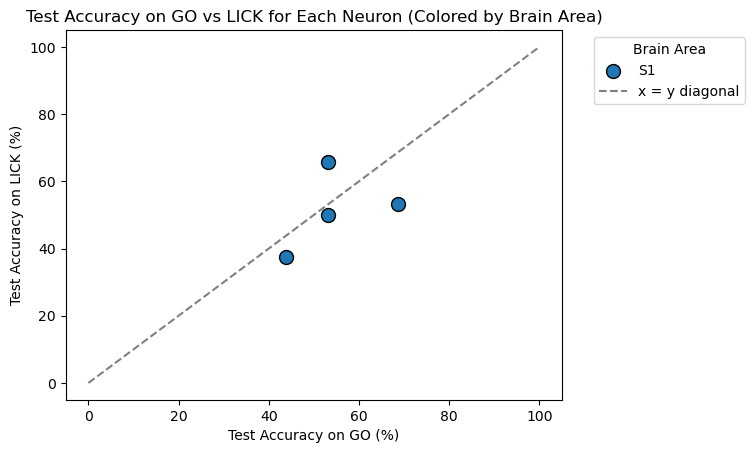

In [19]:
# Plot the results after oversampling
# Dictionaries to store test accuracies, brain areas, and p-values by neuron
go_accuracies = {}
lick_accuracies = {}
brain_areas = {}

# Populate dictionaries with test accuracies and brain area
for result in results_oversampled:
    neuron = result['Neuron']
    if isinstance(neuron, np.ndarray):  # If neuron is a NumPy array, convert to a scalar value
        neuron = neuron.item()  # Extract the value from the NumPy array
    
    # Store test accuracy for "GO" and "LICK"
    if result['Analysis Type'] == 'GO':
        go_accuracies[neuron] = result['Test Accuracy']
    elif result['Analysis Type'] == 'LICK':
        lick_accuracies[neuron] = result['Test Accuracy']
    
    # Store brain area information
    if neuron not in brain_areas:
        brain_areas[neuron] = result['Brain Area']

# Now only include neurons that have both "GO" and "LICK" test accuracies
go_test_accuracies = []
lick_test_accuracies = []
neuron_brain_areas = []

for neuron in go_accuracies:
    if neuron in lick_accuracies:  # Only include neurons with both GO and LICK data
        go_test_accuracies.append(go_accuracies[neuron])
        lick_test_accuracies.append(lick_accuracies[neuron])
        neuron_brain_areas.append(brain_areas[neuron])  # Track brain area for each neuron

# Convert lists to numpy arrays for compatibility with plotting
go_test_accuracies = np.array(go_test_accuracies)
lick_test_accuracies = np.array(lick_test_accuracies)
neuron_brain_areas = np.array(neuron_brain_areas)

# Define unique brain areas for color coding
unique_brain_areas = np.unique(neuron_brain_areas)
colors = plt.cm.get_cmap('tab10', len(unique_brain_areas))  # Use tab10 colormap for up to 10 areas

for i, brain_area in enumerate(unique_brain_areas):
    mask = neuron_brain_areas == brain_area
    plt.scatter(go_test_accuracies[mask], lick_test_accuracies[mask], label=brain_area,
                color=colors(i), s=100, edgecolor='k')

# Adding x=y diagonal line
plt.plot([0, 100], [0, 100], linestyle='--', color='gray', label='x = y diagonal')

# Adding labels and title
plt.xlabel('Test Accuracy on GO (%)')
plt.ylabel('Test Accuracy on LICK (%)')
plt.title('Test Accuracy on GO vs LICK for Each Neuron (Colored by Brain Area)')

# Adding legend for brain areas
plt.legend(title="Brain Area", bbox_to_anchor=(1.05, 1), loc='upper left')

# Show plot
plt.show()

In [20]:
results_oversampled

[{'Brain Area': 'S1',
  'Analysis Type': 'GO',
  'Neuron': array([3.01201803e+11]),
  'Train Accuracy': [51.041666666666664,
   47.395833333333336,
   48.958333333333336,
   49.479166666666664,
   47.916666666666664,
   51.041666666666664,
   51.041666666666664,
   49.479166666666664,
   51.5625,
   50.520833333333336,
   49.479166666666664,
   54.6875,
   55.208333333333336,
   53.645833333333336,
   50.520833333333336,
   46.354166666666664,
   50.520833333333336,
   50.0,
   50.0,
   56.770833333333336,
   59.375,
   56.25,
   57.8125,
   55.208333333333336,
   54.6875,
   54.6875,
   57.291666666666664,
   58.333333333333336,
   61.458333333333336,
   59.895833333333336,
   62.5,
   57.8125,
   60.9375,
   63.020833333333336,
   64.0625,
   59.375,
   59.895833333333336,
   61.979166666666664,
   56.770833333333336,
   58.854166666666664,
   60.9375,
   61.458333333333336,
   60.9375,
   58.854166666666664,
   61.458333333333336,
   58.854166666666664,
   60.9375,
   58.33333333333

In [17]:
#import pandas as pd
# Convert the results to a Pandas DataFrame
df_results = pd.DataFrame(results_oversampled)

# Save the DataFrame to a CSV file
df_results.to_csv('test_accuracies_oversampled.csv', index=False)

S1


/tmp/ipykernel_157/1946043981.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area],


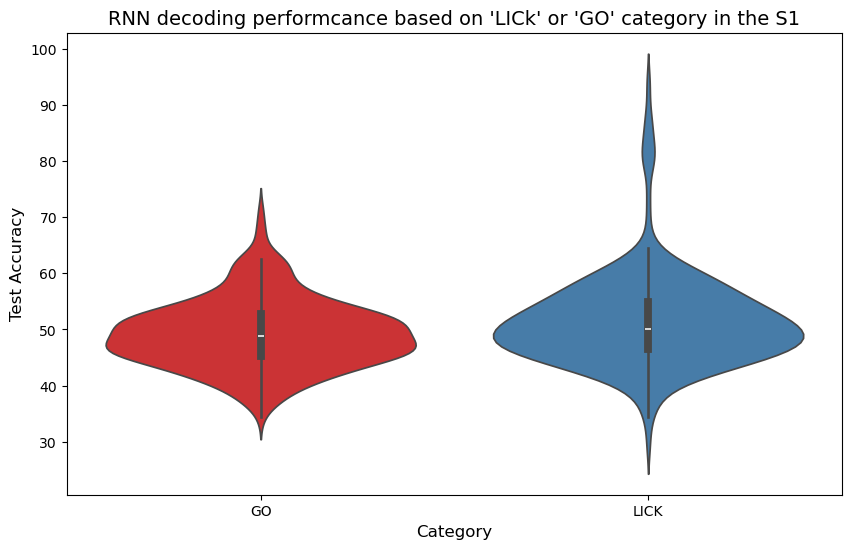

S1naive


/tmp/ipykernel_157/1946043981.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area],


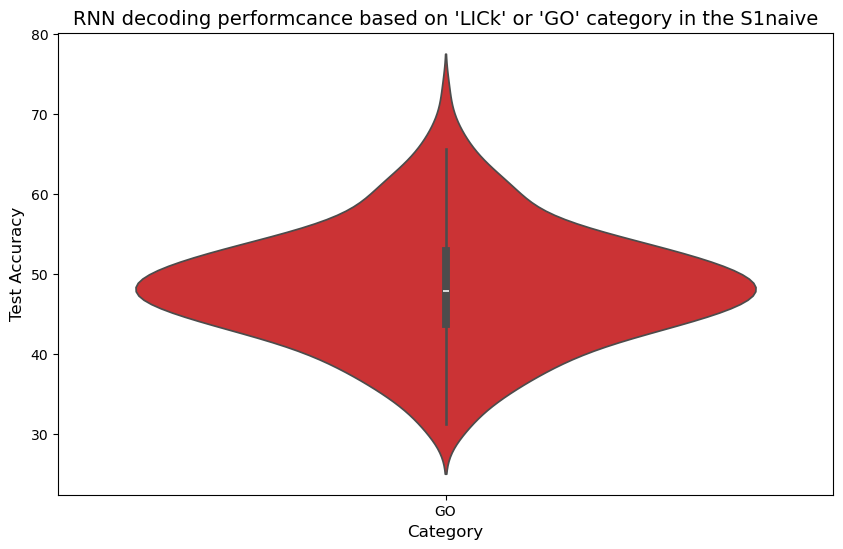

PPC


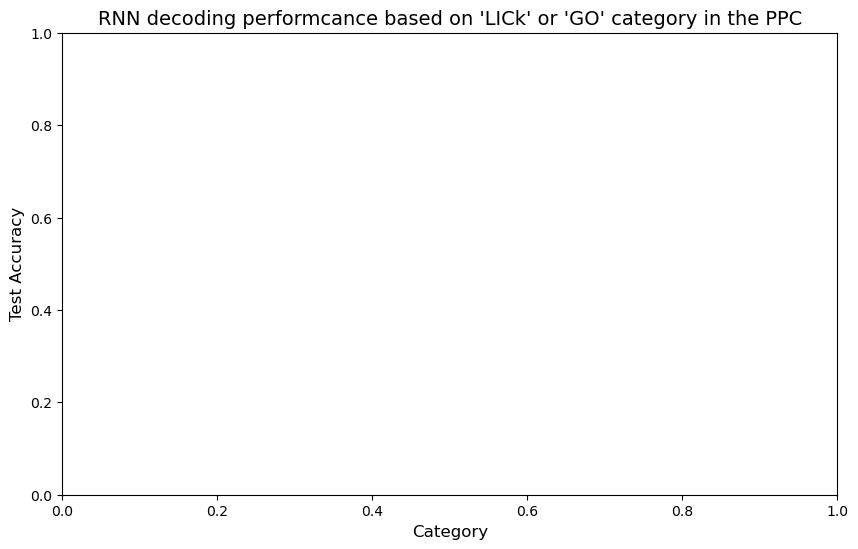

In [34]:
# Create the plot
 
for brain_area in brain_areas:
    print(brain_area)
        
    plt.figure(figsize=(10, 6))
    
    # Use Seaborn scatterplot
    sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area], 
                   x='Analysis Type', 
                   y='Test Accuracy', 
                   palette='Set1')
    
    
    
    # Add title and labels
    title= f"RNN decoding performcance based on 'LICk' or 'GO' category in the {brain_area}"
    plt.title(title, fontsize=14)
    plt.xlabel('Category', fontsize=12)
    plt.ylabel('Test Accuracy', fontsize=12)
    
   
    # Save the plot using the title as the filename
    filename = title.replace(" ", "_").replace("(", "").replace(")", "") + ".png"
    plt.savefig(filename)
    # Display the plot
    plt.show()

S1


/tmp/ipykernel_142/1946043981.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area],


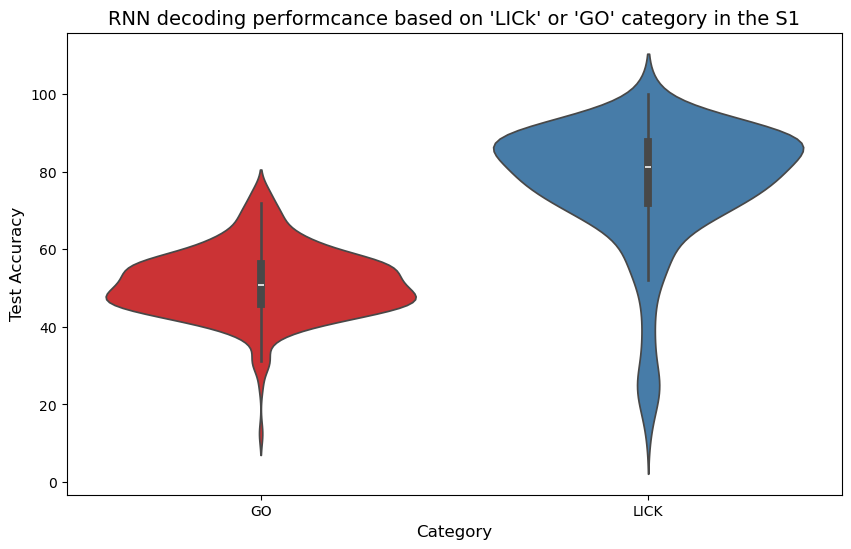

S1naive


/tmp/ipykernel_142/1946043981.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area],


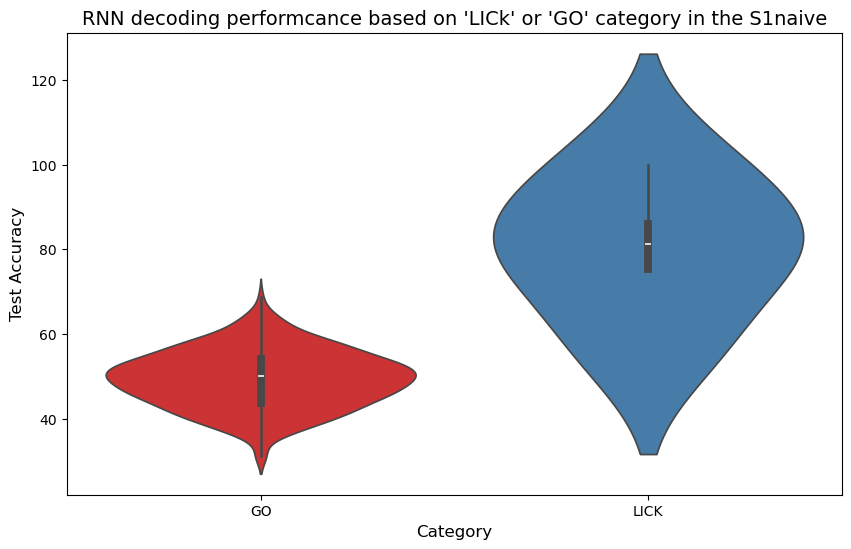

PPC


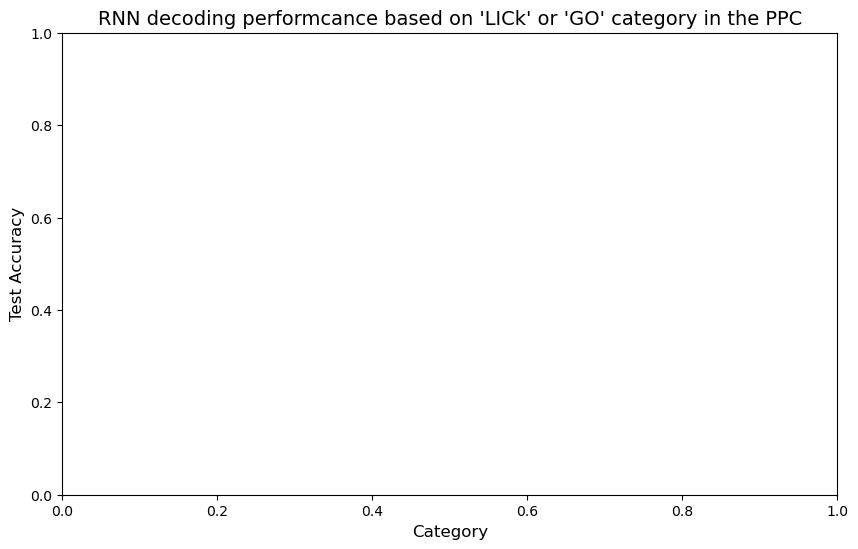

In [11]:
# Create the plot
 
for brain_area in brain_areas:
    print(brain_area)
        
    plt.figure(figsize=(10, 6))
    
    # Use Seaborn scatterplot
    sns.violinplot(data=df_results[df_results['Brain Area'] == brain_area], 
                   x='Analysis Type', 
                   y='Test Accuracy', 
                   palette='Set1')
    
    
    
    # Add title and labels
    title= f"RNN decoding performcance based on 'LICk' or 'GO' category in the {brain_area}"
    plt.title(title, fontsize=14)
    plt.xlabel('Category', fontsize=12)
    plt.ylabel('Test Accuracy', fontsize=12)
    
   
    # Save the plot using the title as the filename
    filename = title.replace(" ", "_").replace("(", "").replace(")", "") + ".png"
    plt.savefig(filename)
    # Display the plot
    plt.show()